In [1]:
# libraries

import os
from tqdm import tqdm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt  # Import Matplotlib for plotting
from scipy.io import wavfile
from python_speech_features import mfcc, logfbank
import librosa

from tensorflow.keras.layers import (
    Conv2D,
    MaxPool2D,
    Flatten,
    LSTM,
    TimeDistributed,
    LayerNormalization,
    Dense,
    Dropout,
)
from tensorflow.keras.models import Sequential
from tensorflow.keras.utils import to_categorical
from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras.regularizers import l2
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.models import load_model
from sklearn.metrics import accuracy_score
import pickle
import tensorflow as tf



In [11]:
def envelope(y , rate , threshold):
    mask = []
    y = pd.Series(y).apply(np.abs)
    y_mean = y.rolling(window = int(rate/10) , min_periods = 1, center = True ).mean() #rolling window
    for mean in y_mean:
        if mean > threshold:
            mask.append(True)
        else:
            mask.append(False)
    return mask
if len(os.listdir('clean')) == 0:
    for f in tqdm(training.fname):
        signal , rate = librosa.load('wavfiles/' +f , sr =16000)
        mask = envelope(signal , rate , 0.0005)
        wavfile.write(filename = 'clean/'+f , rate = rate , data = signal[mask] )

100%|██████████| 141/141 [00:09<00:00, 14.19it/s]


In [22]:
    for f in tqdm(training.fname):
        signal , rate = librosa.load('wavfiles/' +f , sr =16000)
        print(signal.shape)

  4%|▍         | 6/141 [00:00<00:02, 51.49it/s]

(244052,)
(243820,)
(233603,)
(240105,)
(240569,)
(240569,)
(236854,)
(242659,)
(241266,)
(238711,)


 12%|█▏        | 17/141 [00:00<00:02, 49.13it/s]

(242194,)
(242659,)
(226173,)
(226173,)
(240569,)
(241266,)
(244052,)
(233835,)
(239640,)
(241266,)
(242891,)
(242891,)


 22%|██▏       | 31/141 [00:00<00:01, 58.18it/s]

(238944,)
(233371,)
(243588,)
(231978,)
(231978,)
(242194,)
(239640,)
(239872,)
(239872,)
(239640,)
(240105,)
(240569,)
(240569,)
(233603,)


 32%|███▏      | 45/141 [00:00<00:01, 62.13it/s]

(240569,)
(239640,)
(236622,)
(239640,)
(240105,)
(240569,)
(241498,)
(241266,)
(243820,)
(238711,)
(233835,)
(242659,)
(235693,)
(241498,)


 42%|████▏     | 59/141 [00:00<00:01, 63.05it/s]

(238015,)
(237318,)
(235461,)
(241266,)
(239176,)
(242891,)
(239640,)
(241266,)
(240569,)
(241266,)
(236622,)
(239640,)
(240105,)


 52%|█████▏    | 73/141 [00:01<00:01, 62.26it/s]

(240569,)
(241498,)
(239640,)
(249625,)
(246374,)
(242194,)
(234764,)
(241266,)
(250497,)
(247432,)
(252541,)
(254872,)
(261550,)
(253191,)


 62%|██████▏   | 87/141 [00:01<00:00, 60.36it/s]

(277525,)
(249104,)
(257835,)
(240569,)
(239640,)
(247804,)
(254305,)
(252912,)
(258681,)
(279811,)
(244052,)
(239872,)
(240569,)


 72%|███████▏  | 101/141 [00:01<00:00, 61.15it/s]

(239640,)
(239640,)
(233371,)
(249393,)
(241266,)
(245910,)
(241266,)
(240105,)
(238479,)
(239640,)
(238479,)
(241033,)
(225708,)
(239640,)


 82%|████████▏ | 116/141 [00:01<00:00, 65.73it/s]

(241033,)
(238479,)
(241266,)
(240105,)
(237550,)
(240105,)
(238479,)
(241033,)
(238711,)
(245677,)
(234300,)
(255198,)
(182287,)
(241033,)
(241033,)


 92%|█████████▏| 130/141 [00:02<00:00, 67.16it/s]

(245677,)
(245677,)
(238711,)
(238711,)
(241266,)
(240105,)
(238479,)
(225708,)
(239640,)
(238479,)
(241033,)
(241033,)
(238711,)
(245677,)
(237086,)


100%|██████████| 141/141 [00:02<00:00, 62.23it/s]

(237086,)
(239640,)
(236157,)
(241498,)
(229656,)
(241033,)
(232906,)


In [2]:
class Config:
    def __init__(self , mode = 'conv' , nfilt = 26 , nfeat = 13 , nfft = 512 , rate = 16000 ):
        self.mode = mode
        self.nfilt = nfilt
        self.nfeat = nfeat
        self.nfft  =  nfft
        self.rate  =  rate
        self.step = int(rate/10)##how much data we compute when the window size is created
config = Config()

training = pd.read_csv('training.csv')
test = pd.read_csv('test.csv')

x = training['fname'].values
y = training['label'].values

from sklearn.model_selection import train_test_split
x_train, x_test , y_train , y_test = train_test_split(x , y ,test_size = 0.2 ,random_state  =  0)


def downsample_audio(audio_path, target_sr=22050):
    y, sr = librosa.load(audio_path)
    return librosa.resample(y, orig_sr=sr, target_sr=target_sr)

def extract_mfcc_features(audio, sr, n_mfcc=20):
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=n_mfcc)
    return mfccs.T

def preprocess_audio(audio_path, target_sr=22050, n_mfcc=20):
    audio = downsample_audio(audio_path, target_sr)
    sr = target_sr
    mfccs = extract_mfcc_features(audio, sr, n_mfcc)
    return mfccs.reshape(mfccs.shape[0], mfccs.shape[1], 1)

def pad_or_truncate_mfccs(mfccs, target_length):
    if len(mfccs) > target_length:
        return mfccs[:target_length, :]
    else:
        return np.pad(mfccs, ((0, target_length - len(mfccs)), (0, 0)), mode='constant')
    
    
classes = list(np.unique(training.label))


X = []  # Store MFCC features
Y = []  # Store class labels


for index, row in training.iterrows():
        audio_path = row['fname']
        class_label = row['label']
        audio_path = 'wavfiles/' + audio_path
        mfccs = preprocess_audio(audio_path)
        print(len(mfccs))
        mfccs = pad_or_truncate_mfccs(mfccs, target_length=141)  # Adjust target_length as needed
        X.append(mfccs)
        Y.append(class_label)
    

X = np.array(X)
Y = np.array(Y)


#convering grade to numbers 0 1 2 3 
class_mapping = {'grade1': 0, 'grade2': 1, 'grade3': 2 ,'grade4': 3 }
Y = [class_mapping[label] for label in Y]

Y = to_categorical(Y)  # One-hot encode labels

# Split data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X, Y, test_size=0.2, random_state=42)


print("x train",X_train)
print("x_val",X_val)
print("y_train",y_train)
print("y_val",y_val)

print(y_train.shape)
print(y_val.shape)
print(X_train.shape)

#model.add(tf.keras.layers.BatchNormalization())
#model.add(tf.keras.layers.Dropout(0.25))


from tensorflow.keras import regularizers

num_classes = 4
model = tf.keras.models.Sequential()
model.add(tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=(mfccs.shape[0], mfccs.shape[1], 1)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.25))

model.add(tf.keras.layers.MaxPooling2D((2, 2)))

model.add(tf.keras.layers.Conv2D(64, (3, 3), activation='relu'))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.25))

model.add(tf.keras.layers.MaxPooling2D((2, 2)))

model.add(tf.keras.layers.Flatten())
model.add(tf.keras.layers.Dense(64, activation='relu' , kernel_regularizer=regularizers.l2(0.01)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.25))

model.add(tf.keras.layers.Dense(num_classes, activation='softmax'))
model.summary()
# Output layer for 4 classes


model.summary()

last_layer_output_shape = model.layers[-1].output_shape
print("Last layer output shape:", last_layer_output_shape)

model.compile(loss='categorical_crossentropy', optimizer = 'adam', metrics=['accuracy'])

model.fit(X_train, y_train, epochs=200, batch_size=32, validation_data=(X_val, y_val))

file = str(input("enter the file name :"))

def downsample_audio(audio_path, target_sr=22050):
    y, sr = librosa.load(audio_path)
    return librosa.resample(y, orig_sr=sr, target_sr=target_sr)

def extract_mfcc_features(audio, sr, n_mfcc=20):
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=n_mfcc)
    return mfccs.T
def pad_or_truncate_mfccs(mfccs, target_length):
    if len(mfccs) > target_length:
        return mfccs[:target_length, :]
    else:
        return np.pad(mfccs, ((0, target_length - len(mfccs)), (0, 0)), mode='constant')
def preprocess_audio(audio_path, target_sr=22050, n_mfcc=20):
    audio, sr = librosa.load(audio_path, sr=target_sr)  # Load audio and sample rate
    audio = downsample_audio(audio_path, target_sr)
    sr = target_sr
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=20).T
    mfccs = pad_or_truncate_mfccs(mfccs, target_length=141)  # Adjust target_length to match the expected input shape
    return mfccs.reshape(1, mfccs.shape[0], mfccs.shape[1], 1)  # Reshape for prediction
  # Reshape for prediction




# Predict the class
audio_path = 'test/'+file+'.wav'  # Replace with the actual path
mfccs_test = preprocess_audio(audio_path)

mfccs_test.shape

prediction = model.predict(mfccs_test)
predicted_class = np.argmax(prediction)  # Get the index of the predicted class

# Map the index back to the class label (if applicable)
class_mapping = {0: 'grade1', 1: 'grade2', 2: 'grade3', 3: 'grade4'}  # Adjust accordingly
predicted_label = class_mapping[predicted_class]

print("Predicted class:", predicted_class)
print("Predicted label:", predicted_label)

657
657
629
647
648
648
638
654
650
643
652
654
609
609
648
650
657
630
646
650
654
654
644
629
656
625
625
652
646
646
646
646
647
648
648
629
648
646
637
646
647
648
651
650
657
643
630
654
635
651
641
639
634
650
644
654
646
650
648
650
637
646
647
648
651
646
672
664
652
632
650
675
667
680
687
705
682
748
671
695
648
646
668
685
681
697
754
657
646
648
646
646
629
672
650
662
650
647
642
646
642
649
608
646
649
642
650
647
640
647
642
649
643
662
631
687
491
649
649
662
662
643
643
650
647
642
608
646
642
649
649
643
662
639
639
646
636
651
619
649
627
x train [[[[-3.44916779e+02]
   [ 1.20849670e+02]
   [ 2.90913849e+01]
   ...
   [ 2.28166223e+00]
   [ 1.21408141e+00]
   [ 2.06844473e+00]]

  [[-3.85543488e+02]
   [ 1.14219116e+02]
   [ 5.64424591e+01]
   ...
   [ 1.52587914e+00]
   [ 1.72884393e+00]
   [ 1.95891643e+00]]

  [[-4.32303894e+02]
   [ 8.13811646e+01]
   [ 7.53269653e+01]
   ...
   [ 3.39658439e-01]
   [ 1.16129518e+00]
   [ 2.07467699e+00]]

  ...

  [[-4.42522552e



Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 139, 48, 32)       320       
                                                                 
 batch_normalization (Batch  (None, 139, 48, 32)       128       
 Normalization)                                                  
                                                                 
 dropout (Dropout)           (None, 139, 48, 32)       0         
                                                                 
 max_pooling2d (MaxPooling2  (None, 69, 24, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 67, 22, 64)        18496     
                                                                 
 batch_normalization_1 (Bat  (None, 67, 22, 64)       

Epoch 16/200
4/4 [==============================] - 1s 318ms/step - loss: 0.8277 - accuracy: 0.9554 - val_loss: 4.5518 - val_accuracy: 0.4828
Epoch 17/200
4/4 [==============================] - 1s 268ms/step - loss: 0.8878 - accuracy: 0.9464 - val_loss: 4.5478 - val_accuracy: 0.4483
Epoch 18/200
4/4 [==============================] - 1s 283ms/step - loss: 0.7507 - accuracy: 0.9554 - val_loss: 4.1774 - val_accuracy: 0.4138
Epoch 19/200
4/4 [==============================] - 1s 270ms/step - loss: 0.7388 - accuracy: 0.9732 - val_loss: 3.9778 - val_accuracy: 0.4138
Epoch 20/200
4/4 [==============================] - 1s 275ms/step - loss: 0.7044 - accuracy: 0.9732 - val_loss: 4.1238 - val_accuracy: 0.4828
Epoch 21/200
4/4 [==============================] - 1s 281ms/step - loss: 0.7260 - accuracy: 0.9643 - val_loss: 4.0577 - val_accuracy: 0.4828
Epoch 22/200
4/4 [==============================] - 1s 291ms/step - loss: 0.7111 - accuracy: 0.9643 - val_loss: 3.5195 - val_accuracy: 0.4828
Epoch 

Epoch 74/200
4/4 [==============================] - 1s 328ms/step - loss: 0.2493 - accuracy: 0.9732 - val_loss: 1.1850 - val_accuracy: 0.7931
Epoch 75/200
4/4 [==============================] - 1s 290ms/step - loss: 0.3183 - accuracy: 0.9464 - val_loss: 1.1557 - val_accuracy: 0.7586
Epoch 76/200
4/4 [==============================] - 1s 297ms/step - loss: 0.3190 - accuracy: 0.9464 - val_loss: 1.1523 - val_accuracy: 0.7586
Epoch 77/200
4/4 [==============================] - 1s 279ms/step - loss: 0.2598 - accuracy: 0.9554 - val_loss: 1.1958 - val_accuracy: 0.7586
Epoch 78/200
4/4 [==============================] - 1s 281ms/step - loss: 0.2605 - accuracy: 0.9732 - val_loss: 1.2459 - val_accuracy: 0.7241
Epoch 79/200
4/4 [==============================] - 1s 285ms/step - loss: 0.2990 - accuracy: 0.9464 - val_loss: 1.3290 - val_accuracy: 0.6897
Epoch 80/200
4/4 [==============================] - 1s 286ms/step - loss: 0.2594 - accuracy: 0.9643 - val_loss: 1.4151 - val_accuracy: 0.6897
Epoch 

KeyboardInterrupt: 

In [17]:
class Config:
    def __init__(self , mode = 'conv' , nfilt = 26 , nfeat = 13 , nfft = 512 , rate = 16000 ):
        self.mode = mode
        self.nfilt = nfilt
        self.nfeat = nfeat
        self.nfft  =  nfft
        self.rate  =  rate
        self.step = int(rate/10)##how much data we compute when the window size is created
config = Config()

training = pd.read_csv('training.csv')
test = pd.read_csv('test.csv')

x = training['fname'].values
y = training['label'].values

from sklearn.model_selection import train_test_split
x_train, x_test , y_train , y_test = train_test_split(x , y ,test_size = 0.2 ,random_state  =  0)



def downsample_audio(audio_path, target_sr=22050):
    y, sr = librosa.load(audio_path)
    return librosa.resample(y, orig_sr=sr, target_sr=target_sr)

def extract_mfcc_features(audio, sr, n_mfcc=20):
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=n_mfcc)
    return mfccs.T

def preprocess_audio(audio_path, target_sr=22050, n_mfcc=20):
    audio = downsample_audio(audio_path, target_sr)
    sr = target_sr
    mfccs = extract_mfcc_features(audio, sr, n_mfcc)
    return mfccs.reshape(mfccs.shape[0], mfccs.shape[1], 1)

def pad_or_truncate_mfccs(mfccs, target_length):
    if len(mfccs) > target_length:
        return mfccs[:target_length, :]
    else:
        return np.pad(mfccs, ((0, target_length - len(mfccs)), (0, 0)), mode='constant')
    
    
classes = list(np.unique(training.label))


X = []  # Store MFCC features
Y = []  # Store class labels


for index, row in training.iterrows():
        audio_path = row['fname']
        class_label = row['label']
        audio_path = 'wavfiles/' + audio_path
        mfccs = preprocess_audio(audio_path)
        print(len(mfccs))
        mfccs = pad_or_truncate_mfccs(mfccs, target_length=200)  # Adjust target_length as needed
        X.append(mfccs)
        Y.append(class_label)
    

X = np.array(X)
Y = np.array(Y)


#convering grade to numbers 0 1 2 3 
class_mapping = {'grade1': 0, 'grade2': 1, 'grade3': 2 ,'grade4': 3 }
Y = [class_mapping[label] for label in Y]

Y = to_categorical(Y)  # One-hot encode labels

# Split data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X, Y, test_size=0.2, random_state=42)


print("x train",X_train)
print("x_val",X_val)
print("y_train",y_train)
print("y_val",y_val)

print(y_train.shape)
print(y_val.shape)
print(X_train.shape)

#model.add(tf.keras.layers.BatchNormalization())
#model.add(tf.keras.layers.Dropout(0.25))


from tensorflow.keras import regularizers

num_classes = 4
model = tf.keras.models.Sequential()
model.add(tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=(mfccs.shape[0], mfccs.shape[1], 1)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.25))

model.add(tf.keras.layers.MaxPooling2D((2, 2)))

model.add(tf.keras.layers.Conv2D(64, (3, 3), activation='relu'))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.25))

model.add(tf.keras.layers.MaxPooling2D((2, 2)))

model.add(tf.keras.layers.Flatten())
model.add(tf.keras.layers.Dense(64, activation='relu' , kernel_regularizer=regularizers.l2(0.01)))


model.add(tf.keras.layers.Dense(num_classes, activation='softmax'))
model.summary()
# Output layer for 4 classes


model.summary()

last_layer_output_shape = model.layers[-1].output_shape
print("Last layer output shape:", last_layer_output_shape)

model.compile(loss='categorical_crossentropy', optimizer = tf.keras.optimizers.Adam(learning_rate=0.001), metrics=['accuracy'])

model.fit(X_train, y_train, epochs=200, batch_size=32, validation_data=(X_val, y_val))

file = str(input("enter the file name :"))

def downsample_audio(audio_path, target_sr=22050):
    y, sr = librosa.load(audio_path)
    return librosa.resample(y, orig_sr=sr, target_sr=target_sr)

def extract_mfcc_features(audio, sr, n_mfcc=20):
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=n_mfcc)
    return mfccs.T
def pad_or_truncate_mfccs(mfccs, target_length):
    if len(mfccs) > target_length:
        return mfccs[:target_length, :]
    else:
        return np.pad(mfccs, ((0, target_length - len(mfccs)), (0, 0)), mode='constant')
def preprocess_audio(audio_path, target_sr=22050, n_mfcc=20):
    audio, sr = librosa.load(audio_path, sr=target_sr)  # Load audio and sample rate
    audio = downsample_audio(audio_path, target_sr)
    sr = target_sr
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=20).T
    mfccs = pad_or_truncate_mfccs(mfccs, target_length=200)  # Adjust target_length to match the expected input shape
    return mfccs.reshape(1, mfccs.shape[0], mfccs.shape[1], 1)  # Reshape for prediction
  # Reshape for prediction




# Predict the class
audio_path = 'test/'+file+'.wav'  # Replace with the actual path
mfccs_test = preprocess_audio(audio_path)

mfccs_test.shape

prediction = model.predict(mfccs_test)
predicted_class = np.argmax(prediction)  # Get the index of the predicted class

# Map the index back to the class label (if applicable)
class_mapping = {0: 'grade1', 1: 'grade2', 2: 'grade3', 3: 'grade4'}  # Adjust accordingly
predicted_label = class_mapping[predicted_class]

print("Predicted class:", predicted_class)
print("Predicted label:", predicted_label)

657
657
629
647
648
648
638
654
650
643
652
654
609
609
648
650
657
630
646
650
654
654
644
629
656
625
625
652
646
646
646
646
647
648
648
629
648
646
637
646
647
648
651
650
657
643
630
654
635
651
641
639
634
650
644
654
646
650
648
650
637
646
647
648
651
646
672
664
652
632
650
675
667
680
687
705
682
748
671
695
648
646
668
685
681
697
754
657
646
648
646
646
629
672
650
662
650
647
642
646
642
649
608
646
649
642
650
647
640
647
642
649
643
662
631
687
491
649
649
662
662
643
643
650
647
642
608
646
642
649
649
643
662
639
639
646
636
651
619
649
627
x train [[[[-3.44916779e+02]
   [ 1.20849670e+02]
   [ 2.90913849e+01]
   ...
   [ 3.10516310e+00]
   [ 3.68634081e+00]
   [ 2.54430771e+00]]

  [[-3.85543488e+02]
   [ 1.14219116e+02]
   [ 5.64424591e+01]
   ...
   [-1.47866935e-01]
   [ 2.62742788e-01]
   [ 2.44927675e-01]]

  [[-4.32303894e+02]
   [ 8.13811646e+01]
   [ 7.53269653e+01]
   ...
   [ 1.67679477e+00]
   [ 9.62981105e-01]
   [-3.70560586e-02]]

  ...

  [[-4.38100433e

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_26 (Conv2D)          (None, 198, 18, 32)       320       
                                                                 
 batch_normalization_37 (Ba  (None, 198, 18, 32)       128       
 tchNormalization)                                               
                                                                 
 dropout_33 (Dropout)        (None, 198, 18, 32)       0         
                                                                 
 max_pooling2d_22 (MaxPooli  (None, 99, 9, 32)         0         
 ng2D)                                                           
                                                                 
 conv2d_27 (Conv2D)          (None, 97, 7, 64)         18496     
                                                                 
 batch_normalization_38 (Ba  (None, 97, 7, 64)        

Epoch 28/200
4/4 [==============================] - 1s 180ms/step - loss: 0.7177 - accuracy: 0.9464 - val_loss: 1.5311 - val_accuracy: 0.6552
Epoch 29/200
4/4 [==============================] - 1s 170ms/step - loss: 0.6980 - accuracy: 0.9464 - val_loss: 1.8682 - val_accuracy: 0.6207
Epoch 30/200
4/4 [==============================] - 1s 168ms/step - loss: 0.7182 - accuracy: 0.9464 - val_loss: 1.8185 - val_accuracy: 0.6207
Epoch 31/200
4/4 [==============================] - 1s 167ms/step - loss: 0.6653 - accuracy: 0.9643 - val_loss: 1.3393 - val_accuracy: 0.6552
Epoch 32/200
4/4 [==============================] - 1s 163ms/step - loss: 0.6456 - accuracy: 0.9554 - val_loss: 1.4768 - val_accuracy: 0.6552
Epoch 33/200
4/4 [==============================] - 1s 161ms/step - loss: 0.6163 - accuracy: 0.9643 - val_loss: 1.5711 - val_accuracy: 0.6552
Epoch 34/200
4/4 [==============================] - 1s 174ms/step - loss: 0.6274 - accuracy: 0.9375 - val_loss: 1.4684 - val_accuracy: 0.6207
Epoch 

Epoch 86/200
4/4 [==============================] - 1s 161ms/step - loss: 0.2387 - accuracy: 0.9821 - val_loss: 1.4902 - val_accuracy: 0.6552
Epoch 87/200
4/4 [==============================] - 1s 164ms/step - loss: 0.2609 - accuracy: 0.9643 - val_loss: 1.3960 - val_accuracy: 0.6897
Epoch 88/200
4/4 [==============================] - 1s 167ms/step - loss: 0.2453 - accuracy: 0.9732 - val_loss: 1.3504 - val_accuracy: 0.7241
Epoch 89/200
4/4 [==============================] - 1s 162ms/step - loss: 0.2593 - accuracy: 0.9554 - val_loss: 1.3223 - val_accuracy: 0.7586
Epoch 90/200
4/4 [==============================] - 1s 162ms/step - loss: 0.2765 - accuracy: 0.9375 - val_loss: 1.3470 - val_accuracy: 0.7586
Epoch 91/200
4/4 [==============================] - 1s 163ms/step - loss: 0.2541 - accuracy: 0.9554 - val_loss: 1.3631 - val_accuracy: 0.7586
Epoch 92/200
4/4 [==============================] - 1s 167ms/step - loss: 0.2496 - accuracy: 0.9732 - val_loss: 1.2319 - val_accuracy: 0.7586
Epoch 

4/4 [==============================] - 1s 168ms/step - loss: 0.1648 - accuracy: 0.9643 - val_loss: 1.2081 - val_accuracy: 0.7586
enter the file name :test (13)
1/1 [==============================] - 0s 88ms/step
Predicted class: 0
Predicted label: grade1


In [6]:
def downsample_audio(audio_path, target_sr=22050):
    y, sr = librosa.load(audio_path)
    return librosa.resample(y, orig_sr=sr, target_sr=target_sr)

def extract_mfcc_features(audio, sr, n_mfcc=20):
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=n_mfcc)
    return mfccs.T
def pad_or_truncate_mfccs(mfccs, target_length):
    if len(mfccs) > target_length:
        return mfccs[:target_length, :]
    else:
        return np.pad(mfccs, ((0, target_length - len(mfccs)), (0, 0)), mode='constant')
def preprocess_audio(audio_path, target_sr=22050, n_mfcc=20):
    audio, sr = librosa.load(audio_path, sr=target_sr)  # Load audio and sample rate
    audio = downsample_audio(audio_path, target_sr)
    sr = target_sr
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=20).T
    mfccs = pad_or_truncate_mfccs(mfccs, target_length=141)  # Adjust target_length to match the expected input shape
    return mfccs.reshape(1, mfccs.shape[0], mfccs.shape[1], 1)  # Reshape for prediction
  # Reshape for prediction


#making prediction of the signals in "test"

directory_path = 'test'

for file in tqdm(os.listdir(directory_path)):
    # Predict the class
    audio_path = 'test/'+file  # Replace with the actual path
    mfccs_test = preprocess_audio(audio_path)
    prediction = model.predict(mfccs_test)
    predicted_class = np.argmax(prediction)  # Get the index of the predicted class

    # Map the index back to the class label (if applicable)
    class_mapping = {0: 'grade1', 1: 'grade2', 2: 'grade3', 3: 'grade4'}  # Adjust accordingly
    predicted_label = class_mapping[predicted_class]

    print("Predicted class for "+file +":", predicted_class)
    print("Predicted label"+file +":", predicted_label)
    
    
#making prediction of the signals in "wavfile" 
    
directory_path = 'wavfiles'

# Initialize an empty DataFrame
train = pd.DataFrame(columns=['File', 'Predicted_Class'])

for file in tqdm(os.listdir(directory_path)):
        # Predict the class
        audio_path = os.path.join(directory_path, file)
        mfccs_test = preprocess_audio(audio_path)  # Assuming you have a function preprocess_audio
        prediction = model.predict(mfccs_test)
        predicted_class = np.argmax(prediction)

        # Map the index back to the class label (if applicable)
        class_mapping = {0: 'grade1', 1: 'grade2', 2: 'grade3', 3: 'grade4'}  # Adjust accordingly
        predicted_label = class_mapping[predicted_class]

        # Append the result to the DataFrame
        train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

        
test = test.to_csv('test_audio_validation.csv', index =False)
train = train.to_csv('train_audio_validation.csv', index =False)


predicted_test = pd.read_csv('test_audio_validation.csv')
predicted_train = pd.read_csv('traing_audio_validation.csv')

#re-initializing the dataframes
training = pd.read_csv('training.csv')
test = pd.read_csv('test.csv')


y_predicted_train = predicted_train.iloc[:,-1].values
y_true_train = training.iloc[:,-1].values
y_predicted_test = predicted_test.iloc[:,-1].values
y_true_test = test.iloc[:,-1].values




  0%|          | 0/19 [00:00<?, ?it/s]

1/1 [==============================] - 0s 26ms/step



  5%|▌         | 1/19 [00:00<00:02,  7.80it/s]

Predicted class for grade4.wav: 1
Predicted labelgrade4.wav: grade2
1/1 [==============================] - 0s 22ms/step



 11%|█         | 2/19 [00:00<00:02,  7.30it/s]

Predicted class for test (10).wav: 1
Predicted labeltest (10).wav: grade2
1/1 [==============================] - 0s 28ms/step



 16%|█▌        | 3/19 [00:00<00:01,  8.22it/s]

Predicted class for test (11).wav: 0
Predicted labeltest (11).wav: grade1
1/1 [==============================] - 0s 26ms/step
Predicted class for test (12).wav: 0
Predicted labeltest (12).wav: grade1
1/1 [==============================] - 0s 24ms/step



 26%|██▋       | 5/19 [00:00<00:01,  9.19it/s]

Predicted class for test (13).wav: 0
Predicted labeltest (13).wav: grade1
1/1 [==============================] - 0s 20ms/step
Predicted class for test (14).wav: 0
Predicted labeltest (14).wav: grade1
1/1 [==============================] - 0s 22ms/step



 37%|███▋      | 7/19 [00:00<00:01,  9.70it/s]

Predicted class for test (15).wav: 0
Predicted labeltest (15).wav: grade1
1/1 [==============================] - 0s 28ms/step



 42%|████▏     | 8/19 [00:00<00:01,  9.38it/s]

Predicted class for test (16).wav: 2
Predicted labeltest (16).wav: grade3
1/1 [==============================] - 0s 27ms/step



 47%|████▋     | 9/19 [00:00<00:01,  9.50it/s]

Predicted class for test (17).wav: 1
Predicted labeltest (17).wav: grade2
1/1 [==============================] - 0s 23ms/step



 53%|█████▎    | 10/19 [00:01<00:01,  8.22it/s]

Predicted class for test (2).wav: 1
Predicted labeltest (2).wav: grade2
1/1 [==============================] - 0s 24ms/step



 58%|█████▊    | 11/19 [00:01<00:01,  7.71it/s]

Predicted class for test (3).wav: 1
Predicted labeltest (3).wav: grade2
1/1 [==============================] - 0s 24ms/step



 63%|██████▎   | 12/19 [00:01<00:00,  7.37it/s]

Predicted class for test (4).wav: 1
Predicted labeltest (4).wav: grade2
1/1 [==============================] - 0s 21ms/step



 68%|██████▊   | 13/19 [00:01<00:00,  7.23it/s]

Predicted class for test (5).wav: 1
Predicted labeltest (5).wav: grade2
1/1 [==============================] - 0s 25ms/step



 74%|███████▎  | 14/19 [00:01<00:00,  7.10it/s]

Predicted class for test (6).wav: 1
Predicted labeltest (6).wav: grade2
1/1 [==============================] - 0s 24ms/step



 79%|███████▉  | 15/19 [00:01<00:00,  7.17it/s]

Predicted class for test (7).wav: 1
Predicted labeltest (7).wav: grade2
1/1 [==============================] - 0s 26ms/step



 84%|████████▍ | 16/19 [00:02<00:00,  7.00it/s]

Predicted class for test (8).wav: 1
Predicted labeltest (8).wav: grade2
1/1 [==============================] - 0s 31ms/step



 89%|████████▉ | 17/19 [00:02<00:00,  6.84it/s]

Predicted class for test (9).wav: 1
Predicted labeltest (9).wav: grade2
1/1 [==============================] - 0s 28ms/step



 95%|█████████▍| 18/19 [00:02<00:00,  6.74it/s]

Predicted class for test_1.wav: 1
Predicted labeltest_1.wav: grade2
1/1 [==============================] - 0s 27ms/step


100%|██████████| 19/19 [00:02<00:00,  7.63it/s]


Predicted class for test_online.wav: 1
Predicted labeltest_online.wav: grade2



  0%|          | 0/141 [00:00<?, ?it/s]

1/1 [==============================] - 0s 23ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  1%|          | 1/141 [00:00<00:18,  7.46it/s]

1/1 [==============================] - 0s 28ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  1%|▏         | 2/141 [00:00<00:21,  6.58it/s]

1/1 [==============================] - 0s 26ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  2%|▏         | 3/141 [00:00<00:20,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  3%|▎         | 4/141 [00:00<00:19,  7.12it/s]

1/1 [==============================] - 0s 22ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  4%|▎         | 5/141 [00:00<00:18,  7.48it/s]

1/1 [==============================] - 0s 24ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  4%|▍         | 6/141 [00:00<00:18,  7.43it/s]

1/1 [==============================] - 0s 28ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  5%|▍         | 7/141 [00:00<00:18,  7.26it/s]

1/1 [==============================] - 0s 30ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  6%|▌         | 8/141 [00:01<00:18,  7.15it/s]

1/1 [==============================] - 0s 23ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  6%|▋         | 9/141 [00:01<00:18,  7.16it/s]

1/1 [==============================] - 0s 28ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  7%|▋         | 10/141 [00:01<00:18,  7.27it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  8%|▊         | 11/141 [00:01<00:19,  6.75it/s]

1/1 [==============================] - 0s 29ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  9%|▊         | 12/141 [00:01<00:19,  6.57it/s]

1/1 [==============================] - 0s 26ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  9%|▉         | 13/141 [00:01<00:20,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 10%|▉         | 14/141 [00:02<00:20,  6.28it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 11%|█         | 15/141 [00:02<00:20,  6.22it/s]

1/1 [==============================] - 0s 32ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 11%|█▏        | 16/141 [00:02<00:20,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 12%|█▏        | 17/141 [00:02<00:19,  6.27it/s]

1/1 [==============================] - 0s 39ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 13%|█▎        | 18/141 [00:02<00:20,  6.07it/s]

1/1 [==============================] - 0s 30ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 13%|█▎        | 19/141 [00:02<00:19,  6.18it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 14%|█▍        | 20/141 [00:03<00:21,  5.56it/s]

1/1 [==============================] - 0s 66ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 15%|█▍        | 21/141 [00:03<00:25,  4.71it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 16%|█▌        | 22/141 [00:03<00:28,  4.20it/s]

1/1 [==============================] - 0s 73ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 16%|█▋        | 23/141 [00:04<00:32,  3.67it/s]

1/1 [==============================] - 0s 75ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 17%|█▋        | 24/141 [00:04<00:35,  3.28it/s]

1/1 [==============================] - 0s 66ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 18%|█▊        | 25/141 [00:04<00:37,  3.09it/s]

1/1 [==============================] - 0s 75ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 18%|█▊        | 26/141 [00:05<00:38,  2.99it/s]

1/1 [==============================] - 0s 66ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 19%|█▉        | 27/141 [00:05<00:38,  2.95it/s]

1/1 [==============================] - 0s 71ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 20%|█▉        | 28/141 [00:05<00:39,  2.83it/s]

1/1 [==============================] - 0s 79ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 21%|██        | 29/141 [00:06<00:40,  2.76it/s]

1/1 [==============================] - 0s 81ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 21%|██▏       | 30/141 [00:06<00:41,  2.70it/s]

1/1 [==============================] - 0s 67ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 22%|██▏       | 31/141 [00:06<00:40,  2.75it/s]

1/1 [==============================] - 0s 71ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 23%|██▎       | 32/141 [00:07<00:39,  2.79it/s]

1/1 [==============================] - 0s 61ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 23%|██▎       | 33/141 [00:07<00:37,  2.91it/s]

1/1 [==============================] - 0s 64ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 24%|██▍       | 34/141 [00:07<00:35,  3.01it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 25%|██▍       | 35/141 [00:08<00:34,  3.11it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 26%|██▌       | 36/141 [00:08<00:33,  3.13it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 26%|██▌       | 37/141 [00:08<00:31,  3.26it/s]

1/1 [==============================] - 0s 60ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 27%|██▋       | 38/141 [00:09<00:31,  3.30it/s]

1/1 [==============================] - 0s 52ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 28%|██▊       | 39/141 [00:09<00:30,  3.37it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 28%|██▊       | 40/141 [00:09<00:29,  3.45it/s]

1/1 [==============================] - 0s 81ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 29%|██▉       | 41/141 [00:10<00:29,  3.39it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 30%|██▉       | 42/141 [00:10<00:28,  3.47it/s]

1/1 [==============================] - 0s 56ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 30%|███       | 43/141 [00:10<00:27,  3.50it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 31%|███       | 44/141 [00:10<00:27,  3.56it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 32%|███▏      | 45/141 [00:11<00:26,  3.65it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 33%|███▎      | 46/141 [00:11<00:25,  3.66it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 33%|███▎      | 47/141 [00:11<00:25,  3.64it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 34%|███▍      | 48/141 [00:11<00:25,  3.64it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 35%|███▍      | 49/141 [00:12<00:25,  3.64it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 35%|███▌      | 50/141 [00:12<00:24,  3.66it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 36%|███▌      | 51/141 [00:12<00:24,  3.69it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 37%|███▋      | 52/141 [00:12<00:24,  3.71it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 38%|███▊      | 53/141 [00:13<00:23,  3.78it/s]

1/1 [==============================] - 0s 54ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 38%|███▊      | 54/141 [00:13<00:23,  3.66it/s]

1/1 [==============================] - 0s 54ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 39%|███▉      | 55/141 [00:13<00:23,  3.71it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 40%|███▉      | 56/141 [00:14<00:22,  3.74it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 40%|████      | 57/141 [00:14<00:22,  3.72it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 41%|████      | 58/141 [00:14<00:22,  3.74it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 42%|████▏     | 59/141 [00:14<00:21,  3.84it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 43%|████▎     | 60/141 [00:15<00:20,  3.88it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 43%|████▎     | 61/141 [00:15<00:20,  3.91it/s]

1/1 [==============================] - 0s 43ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 44%|████▍     | 62/141 [00:15<00:20,  3.94it/s]

1/1 [==============================] - 0s 44ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 45%|████▍     | 63/141 [00:15<00:19,  3.90it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 45%|████▌     | 64/141 [00:16<00:19,  3.89it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 46%|████▌     | 65/141 [00:16<00:19,  3.93it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 47%|████▋     | 66/141 [00:16<00:18,  3.95it/s]

1/1 [==============================] - 0s 44ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 48%|████▊     | 67/141 [00:16<00:18,  4.01it/s]

1/1 [==============================] - 0s 40ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 48%|████▊     | 68/141 [00:17<00:17,  4.07it/s]

1/1 [==============================] - 0s 44ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 49%|████▉     | 69/141 [00:17<00:18,  3.99it/s]

1/1 [==============================] - 0s 43ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 50%|████▉     | 70/141 [00:17<00:17,  3.99it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 50%|█████     | 71/141 [00:17<00:18,  3.81it/s]

1/1 [==============================] - 0s 56ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 51%|█████     | 72/141 [00:18<00:18,  3.78it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 52%|█████▏    | 73/141 [00:18<00:18,  3.69it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 52%|█████▏    | 74/141 [00:18<00:18,  3.65it/s]

1/1 [==============================] - 0s 58ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 53%|█████▎    | 75/141 [00:19<00:18,  3.61it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 54%|█████▍    | 76/141 [00:19<00:18,  3.57it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 55%|█████▍    | 77/141 [00:19<00:18,  3.48it/s]

1/1 [==============================] - 0s 61ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 55%|█████▌    | 78/141 [00:19<00:18,  3.43it/s]

1/1 [==============================] - 0s 63ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 56%|█████▌    | 79/141 [00:20<00:18,  3.27it/s]

1/1 [==============================] - 0s 64ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 57%|█████▋    | 80/141 [00:20<00:18,  3.21it/s]

1/1 [==============================] - 0s 60ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 57%|█████▋    | 81/141 [00:20<00:18,  3.26it/s]

1/1 [==============================] - 0s 58ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 58%|█████▊    | 82/141 [00:21<00:18,  3.27it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 59%|█████▉    | 83/141 [00:21<00:18,  3.18it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 60%|█████▉    | 84/141 [00:21<00:17,  3.25it/s]

1/1 [==============================] - 0s 64ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 60%|██████    | 85/141 [00:22<00:17,  3.22it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 61%|██████    | 86/141 [00:22<00:16,  3.24it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 62%|██████▏   | 87/141 [00:22<00:16,  3.33it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 62%|██████▏   | 88/141 [00:22<00:15,  3.33it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 63%|██████▎   | 89/141 [00:23<00:15,  3.38it/s]

1/1 [==============================] - 0s 46ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 64%|██████▍   | 90/141 [00:23<00:15,  3.35it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 65%|██████▍   | 91/141 [00:23<00:14,  3.46it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 65%|██████▌   | 92/141 [00:24<00:13,  3.64it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 66%|██████▌   | 93/141 [00:24<00:12,  3.75it/s]

1/1 [==============================] - 0s 44ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 67%|██████▋   | 94/141 [00:24<00:12,  3.87it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 67%|██████▋   | 95/141 [00:24<00:11,  3.98it/s]

1/1 [==============================] - 0s 41ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 68%|██████▊   | 96/141 [00:25<00:10,  4.11it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 69%|██████▉   | 97/141 [00:25<00:10,  4.20it/s]

1/1 [==============================] - 0s 38ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 70%|██████▉   | 98/141 [00:25<00:10,  4.28it/s]

1/1 [==============================] - 0s 41ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 70%|███████   | 99/141 [00:25<00:09,  4.36it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 71%|███████   | 100/141 [00:25<00:09,  4.37it/s]

1/1 [==============================] - 0s 39ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 72%|███████▏  | 101/141 [00:26<00:09,  4.44it/s]

1/1 [==============================] - 0s 43ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 72%|███████▏  | 102/141 [00:26<00:08,  4.44it/s]

1/1 [==============================] - 0s 38ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 73%|███████▎  | 103/141 [00:26<00:08,  4.47it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 74%|███████▍  | 104/141 [00:26<00:08,  4.42it/s]

1/1 [==============================] - 0s 38ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 74%|███████▍  | 105/141 [00:27<00:07,  4.50it/s]

1/1 [==============================] - 0s 38ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 75%|███████▌  | 106/141 [00:27<00:07,  4.53it/s]

1/1 [==============================] - 0s 44ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 76%|███████▌  | 107/141 [00:27<00:07,  4.51it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 77%|███████▋  | 108/141 [00:27<00:07,  4.46it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 77%|███████▋  | 109/141 [00:27<00:07,  4.49it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 78%|███████▊  | 110/141 [00:28<00:06,  4.47it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 79%|███████▊  | 111/141 [00:28<00:06,  4.42it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 79%|███████▉  | 112/141 [00:28<00:06,  4.38it/s]

1/1 [==============================] - 0s 38ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 80%|████████  | 113/141 [00:28<00:06,  4.41it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 81%|████████  | 114/141 [00:29<00:06,  4.35it/s]

1/1 [==============================] - 0s 39ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 82%|████████▏ | 115/141 [00:29<00:05,  4.38it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 82%|████████▏ | 116/141 [00:29<00:05,  4.33it/s]

1/1 [==============================] - 0s 39ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 83%|████████▎ | 117/141 [00:29<00:05,  4.40it/s]

1/1 [==============================] - 0s 44ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 84%|████████▎ | 118/141 [00:29<00:05,  4.35it/s]

1/1 [==============================] - 0s 41ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 84%|████████▍ | 119/141 [00:30<00:05,  4.29it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 85%|████████▌ | 120/141 [00:30<00:04,  4.26it/s]

1/1 [==============================] - 0s 41ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 86%|████████▌ | 121/141 [00:30<00:04,  4.37it/s]

1/1 [==============================] - 0s 40ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 87%|████████▋ | 122/141 [00:30<00:04,  4.41it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 87%|████████▋ | 123/141 [00:31<00:04,  4.28it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 88%|████████▊ | 124/141 [00:31<00:04,  4.15it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 89%|████████▊ | 125/141 [00:31<00:03,  4.14it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 89%|████████▉ | 126/141 [00:31<00:03,  4.15it/s]

1/1 [==============================] - 0s 43ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 90%|█████████ | 127/141 [00:32<00:03,  4.16it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 91%|█████████ | 128/141 [00:32<00:03,  4.08it/s]

1/1 [==============================] - 0s 52ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 91%|█████████▏| 129/141 [00:32<00:03,  3.99it/s]

1/1 [==============================] - 0s 46ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 92%|█████████▏| 130/141 [00:32<00:02,  4.01it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 93%|█████████▎| 131/141 [00:33<00:02,  4.03it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 94%|█████████▎| 132/141 [00:33<00:02,  4.02it/s]

1/1 [==============================] - 0s 54ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 94%|█████████▍| 133/141 [00:33<00:02,  3.86it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 95%|█████████▌| 134/141 [00:33<00:01,  3.70it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 96%|█████████▌| 135/141 [00:34<00:01,  3.59it/s]

1/1 [==============================] - 0s 56ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 96%|█████████▋| 136/141 [00:34<00:01,  3.53it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 97%|█████████▋| 137/141 [00:34<00:01,  3.53it/s]

1/1 [==============================] - 0s 56ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 98%|█████████▊| 138/141 [00:35<00:00,  3.48it/s]

1/1 [==============================] - 0s 61ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 99%|█████████▊| 139/141 [00:35<00:00,  3.43it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 99%|█████████▉| 140/141 [00:35<00:00,  3.46it/s]

1/1 [==============================] - 0s 58ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_13928\2821634213.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
100%|██████████| 141/141 [00:36<00:00,  3.91it/s]


[[32  4  0  0]
 [ 2 58  0  0]
 [ 1  0 36  0]
 [ 0  4  0  4]]


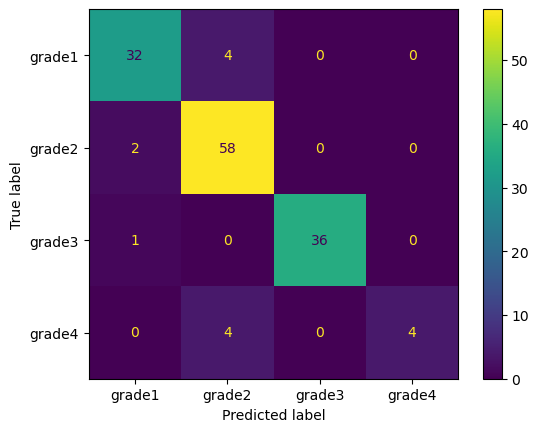

In [26]:
#confusion matrix
from sklearn.metrics import confusion_matrix , ConfusionMatrixDisplay 
cm_train=  confusion_matrix(y_true_train, y_predicted_train)
print(cm_train)


disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=classes)
disp.plot()
plt.show()



652
640
646
639
662
651
668
631
639
609
652
643
650
642
649
649
625
636
654
662
664
650
662
647
672
648
637
651
672
662
657
646
652
648
654
651
643
685
649
680
657
646
646
647
656
625
646
682
646
657
650
642
646
644
648
748
649
654
646
681
662
647
643
648
671
643
647
632
648
650
648
646
754
651
629
648
642
654
650
650
697
649
647
650
609
642
647
630
637
667
687
638
650
608
649
644
641
649
630
642
646
619
695
649
646
648
648
646
635
646
639
642
650
705
647
646
650
648
650
646
646
647
643
657
634
654
629
629
646
646
491
657
687
643
627
654
675
650
648
629
608
x train [[[[-2.20563492e+02]
   [ 1.14603943e+02]
   [ 1.61342297e+01]
   ...
   [ 5.43327427e+00]
   [ 6.51164651e-01]
   [ 5.09117508e+00]]

  [[-2.84624878e+02]
   [ 1.16393173e+02]
   [ 1.84336014e+01]
   ...
   [ 5.89107227e+00]
   [ 1.13985825e+00]
   [ 5.41102886e+00]]

  [[-5.10672333e+02]
   [ 1.20593536e+02]
   [ 9.00066986e+01]
   ...
   [ 1.36509097e+00]
   [-5.20772266e+00]
   [-3.33214855e+00]]

  ...

  [[-5.28131042e

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 198, 18, 32)       320       
                                                                 
 max_pooling2d_4 (MaxPoolin  (None, 99, 9, 32)         0         
 g2D)                                                            
                                                                 
 conv2d_5 (Conv2D)           (None, 97, 7, 64)         18496     
                                                                 
 dropout_2 (Dropout)         (None, 97, 7, 64)         0         
                                                                 
 max_pooling2d_5 (MaxPoolin  (None, 48, 3, 64)         0         
 g2D)                                                            
                                                                 
 flatten_2 (Flatten)         (None, 9216)             

4/4 [==============================] - 0s 94ms/step - loss: 0.5895 - accuracy: 0.9732 - val_loss: 1.7832 - val_accuracy: 0.7931
Epoch 94/200
4/4 [==============================] - 0s 91ms/step - loss: 0.5655 - accuracy: 0.9821 - val_loss: 1.6251 - val_accuracy: 0.7931
Epoch 95/200
4/4 [==============================] - 0s 90ms/step - loss: 0.5627 - accuracy: 0.9732 - val_loss: 1.5215 - val_accuracy: 0.7931
Epoch 96/200
4/4 [==============================] - 0s 92ms/step - loss: 0.5525 - accuracy: 0.9821 - val_loss: 1.4885 - val_accuracy: 0.7931
Epoch 97/200
4/4 [==============================] - 0s 92ms/step - loss: 0.5385 - accuracy: 0.9911 - val_loss: 1.4844 - val_accuracy: 0.7931
Epoch 98/200
4/4 [==============================] - 0s 92ms/step - loss: 0.5538 - accuracy: 0.9732 - val_loss: 1.4572 - val_accuracy: 0.7931
Epoch 99/200
4/4 [==============================] - 0s 92ms/step - loss: 0.5368 - accuracy: 0.9821 - val_loss: 1.5525 - val_accuracy: 0.7931
Epoch 100/200
4/4 [=======

Epoch 151/200
4/4 [==============================] - 0s 102ms/step - loss: 0.4382 - accuracy: 0.9732 - val_loss: 1.3477 - val_accuracy: 0.7931
Epoch 152/200
4/4 [==============================] - 0s 92ms/step - loss: 0.4440 - accuracy: 0.9732 - val_loss: 1.4085 - val_accuracy: 0.7931
Epoch 153/200
4/4 [==============================] - 0s 100ms/step - loss: 0.4214 - accuracy: 0.9821 - val_loss: 1.4293 - val_accuracy: 0.7931
Epoch 154/200
4/4 [==============================] - 0s 92ms/step - loss: 0.4343 - accuracy: 0.9732 - val_loss: 1.3901 - val_accuracy: 0.7931
Epoch 155/200
4/4 [==============================] - 0s 96ms/step - loss: 0.4144 - accuracy: 0.9821 - val_loss: 1.4042 - val_accuracy: 0.7931
Epoch 156/200
4/4 [==============================] - 0s 91ms/step - loss: 0.4290 - accuracy: 0.9732 - val_loss: 1.4786 - val_accuracy: 0.7931
Epoch 157/200
4/4 [==============================] - 0s 103ms/step - loss: 0.4113 - accuracy: 0.9821 - val_loss: 1.4740 - val_accuracy: 0.7931
Epo


  0%|          | 0/19 [00:00<?, ?it/s]

1/1 [==============================] - 0s 174ms/step



  5%|▌         | 1/19 [00:00<00:06,  2.70it/s]

Predicted class for grade4.wav: 3
Predicted labelgrade4.wav: grade4
1/1 [==============================] - 0s 52ms/step



 11%|█         | 2/19 [00:00<00:05,  3.04it/s]

Predicted class for test (10).wav: 1
Predicted labeltest (10).wav: grade2
1/1 [==============================] - 0s 60ms/step



 16%|█▌        | 3/19 [00:00<00:04,  3.60it/s]

Predicted class for test (11).wav: 0
Predicted labeltest (11).wav: grade1
1/1 [==============================] - 0s 73ms/step



 21%|██        | 4/19 [00:01<00:04,  3.64it/s]

Predicted class for test (12).wav: 0
Predicted labeltest (12).wav: grade1
1/1 [==============================] - 0s 53ms/step



 26%|██▋       | 5/19 [00:01<00:03,  3.75it/s]

Predicted class for test (13).wav: 0
Predicted labeltest (13).wav: grade1
1/1 [==============================] - 0s 65ms/step



 32%|███▏      | 6/19 [00:01<00:03,  3.81it/s]

Predicted class for test (14).wav: 0
Predicted labeltest (14).wav: grade1
1/1 [==============================] - 0s 66ms/step



 37%|███▋      | 7/19 [00:01<00:03,  3.92it/s]

Predicted class for test (15).wav: 0
Predicted labeltest (15).wav: grade1
1/1 [==============================] - 0s 64ms/step



 42%|████▏     | 8/19 [00:02<00:02,  3.75it/s]

Predicted class for test (16).wav: 2
Predicted labeltest (16).wav: grade3
1/1 [==============================] - 0s 83ms/step



 47%|████▋     | 9/19 [00:02<00:02,  3.88it/s]

Predicted class for test (17).wav: 1
Predicted labeltest (17).wav: grade2
1/1 [==============================] - 0s 71ms/step



 53%|█████▎    | 10/19 [00:02<00:02,  3.41it/s]

Predicted class for test (2).wav: 1
Predicted labeltest (2).wav: grade2
1/1 [==============================] - 0s 74ms/step



 58%|█████▊    | 11/19 [00:03<00:02,  3.06it/s]

Predicted class for test (3).wav: 1
Predicted labeltest (3).wav: grade2
1/1 [==============================] - 0s 58ms/step



 63%|██████▎   | 12/19 [00:03<00:02,  2.96it/s]

Predicted class for test (4).wav: 1
Predicted labeltest (4).wav: grade2
1/1 [==============================] - 0s 48ms/step



 68%|██████▊   | 13/19 [00:03<00:01,  3.15it/s]

Predicted class for test (5).wav: 1
Predicted labeltest (5).wav: grade2
1/1 [==============================] - 0s 46ms/step



 74%|███████▎  | 14/19 [00:04<00:01,  3.33it/s]

Predicted class for test (6).wav: 1
Predicted labeltest (6).wav: grade2
1/1 [==============================] - 0s 47ms/step



 79%|███████▉  | 15/19 [00:04<00:01,  3.45it/s]

Predicted class for test (7).wav: 1
Predicted labeltest (7).wav: grade2
1/1 [==============================] - 0s 56ms/step



 84%|████████▍ | 16/19 [00:04<00:00,  3.48it/s]

Predicted class for test (8).wav: 1
Predicted labeltest (8).wav: grade2
1/1 [==============================] - 0s 61ms/step



 89%|████████▉ | 17/19 [00:04<00:00,  3.28it/s]

Predicted class for test (9).wav: 1
Predicted labeltest (9).wav: grade2
1/1 [==============================] - 0s 48ms/step



 95%|█████████▍| 18/19 [00:05<00:00,  3.40it/s]

Predicted class for test_1.wav: 1
Predicted labeltest_1.wav: grade2
1/1 [==============================] - 0s 48ms/step


100%|██████████| 19/19 [00:05<00:00,  3.43it/s]


Predicted class for test_online.wav: 1
Predicted labeltest_online.wav: grade2



  0%|          | 0/141 [00:00<?, ?it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  1%|          | 1/141 [00:00<00:38,  3.64it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  1%|▏         | 2/141 [00:00<00:38,  3.66it/s]

1/1 [==============================] - 0s 61ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  2%|▏         | 3/141 [00:00<00:38,  3.57it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  3%|▎         | 4/141 [00:01<00:38,  3.56it/s]

1/1 [==============================] - 0s 66ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  4%|▎         | 5/141 [00:01<00:38,  3.51it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  4%|▍         | 6/141 [00:01<00:37,  3.60it/s]

1/1 [==============================] - 0s 65ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  5%|▍         | 7/141 [00:01<00:38,  3.48it/s]

1/1 [==============================] - 0s 44ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  6%|▌         | 8/141 [00:02<00:37,  3.55it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  6%|▋         | 9/141 [00:02<00:37,  3.52it/s]

1/1 [==============================] - 0s 46ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  7%|▋         | 10/141 [00:02<00:36,  3.59it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  8%|▊         | 11/141 [00:03<00:35,  3.66it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  9%|▊         | 12/141 [00:03<00:35,  3.65it/s]

1/1 [==============================] - 0s 52ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  9%|▉         | 13/141 [00:03<00:35,  3.61it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 10%|▉         | 14/141 [00:03<00:34,  3.64it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 11%|█         | 15/141 [00:04<00:35,  3.54it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 11%|█▏        | 16/141 [00:04<00:35,  3.56it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 12%|█▏        | 17/141 [00:04<00:34,  3.56it/s]

1/1 [==============================] - 0s 46ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 13%|█▎        | 18/141 [00:05<00:34,  3.52it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 13%|█▎        | 19/141 [00:05<00:34,  3.55it/s]

1/1 [==============================] - 0s 56ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 14%|█▍        | 20/141 [00:05<00:35,  3.45it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 15%|█▍        | 21/141 [00:05<00:34,  3.53it/s]

1/1 [==============================] - 0s 44ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 16%|█▌        | 22/141 [00:06<00:32,  3.69it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 16%|█▋        | 23/141 [00:06<00:31,  3.81it/s]

1/1 [==============================] - 0s 41ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 17%|█▋        | 24/141 [00:06<00:29,  3.92it/s]

1/1 [==============================] - 0s 43ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 18%|█▊        | 25/141 [00:06<00:28,  4.00it/s]

1/1 [==============================] - 0s 39ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 18%|█▊        | 26/141 [00:07<00:27,  4.15it/s]

1/1 [==============================] - 0s 41ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 19%|█▉        | 27/141 [00:07<00:26,  4.25it/s]

1/1 [==============================] - 0s 38ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 20%|█▉        | 28/141 [00:07<00:26,  4.30it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 21%|██        | 29/141 [00:07<00:25,  4.34it/s]

1/1 [==============================] - 0s 41ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 21%|██▏       | 30/141 [00:07<00:25,  4.42it/s]

1/1 [==============================] - 0s 39ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 22%|██▏       | 31/141 [00:08<00:24,  4.43it/s]

1/1 [==============================] - 0s 44ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 23%|██▎       | 32/141 [00:08<00:24,  4.46it/s]

1/1 [==============================] - 0s 41ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 23%|██▎       | 33/141 [00:08<00:24,  4.38it/s]

1/1 [==============================] - 0s 36ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 24%|██▍       | 34/141 [00:08<00:24,  4.42it/s]

1/1 [==============================] - 0s 43ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 25%|██▍       | 35/141 [00:09<00:24,  4.41it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 26%|██▌       | 36/141 [00:09<00:23,  4.41it/s]

1/1 [==============================] - 0s 43ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 26%|██▌       | 37/141 [00:09<00:23,  4.46it/s]

1/1 [==============================] - 0s 44ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 27%|██▋       | 38/141 [00:09<00:23,  4.46it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 28%|██▊       | 39/141 [00:09<00:22,  4.48it/s]

1/1 [==============================] - 0s 39ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 28%|██▊       | 40/141 [00:10<00:22,  4.42it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 29%|██▉       | 41/141 [00:10<00:22,  4.37it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 30%|██▉       | 42/141 [00:10<00:23,  4.27it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 30%|███       | 43/141 [00:10<00:23,  4.18it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 31%|███       | 44/141 [00:11<00:23,  4.11it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 32%|███▏      | 45/141 [00:11<00:23,  4.03it/s]

1/1 [==============================] - 0s 46ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 33%|███▎      | 46/141 [00:11<00:23,  3.99it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 33%|███▎      | 47/141 [00:11<00:23,  3.94it/s]

1/1 [==============================] - 0s 54ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 34%|███▍      | 48/141 [00:12<00:23,  3.97it/s]

1/1 [==============================] - 0s 43ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 35%|███▍      | 49/141 [00:12<00:23,  3.92it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 35%|███▌      | 50/141 [00:12<00:23,  3.92it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 36%|███▌      | 51/141 [00:13<00:23,  3.86it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 37%|███▋      | 52/141 [00:13<00:22,  3.93it/s]

1/1 [==============================] - 0s 43ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 38%|███▊      | 53/141 [00:13<00:21,  4.06it/s]

1/1 [==============================] - 0s 56ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 38%|███▊      | 54/141 [00:13<00:22,  3.95it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 39%|███▉      | 55/141 [00:14<00:22,  3.91it/s]

1/1 [==============================] - 0s 43ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 40%|███▉      | 56/141 [00:14<00:22,  3.85it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 40%|████      | 57/141 [00:14<00:21,  3.83it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 41%|████      | 58/141 [00:14<00:21,  3.84it/s]

1/1 [==============================] - 0s 41ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 42%|████▏     | 59/141 [00:15<00:21,  3.83it/s]

1/1 [==============================] - 0s 52ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 43%|████▎     | 60/141 [00:15<00:21,  3.77it/s]

1/1 [==============================] - 0s 52ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 43%|████▎     | 61/141 [00:15<00:21,  3.71it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 44%|████▍     | 62/141 [00:15<00:20,  3.80it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 45%|████▍     | 63/141 [00:16<00:21,  3.67it/s]

1/1 [==============================] - 0s 60ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 45%|████▌     | 64/141 [00:16<00:21,  3.64it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 46%|████▌     | 65/141 [00:16<00:20,  3.62it/s]

1/1 [==============================] - 0s 52ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 47%|████▋     | 66/141 [00:17<00:21,  3.48it/s]

1/1 [==============================] - 0s 63ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 48%|████▊     | 67/141 [00:17<00:22,  3.36it/s]

1/1 [==============================] - 0s 68ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 48%|████▊     | 68/141 [00:17<00:23,  3.12it/s]

1/1 [==============================] - 0s 62ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 49%|████▉     | 69/141 [00:18<00:23,  3.09it/s]

1/1 [==============================] - 0s 65ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 50%|████▉     | 70/141 [00:18<00:22,  3.11it/s]

1/1 [==============================] - 0s 63ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 50%|█████     | 71/141 [00:18<00:22,  3.14it/s]

1/1 [==============================] - 0s 64ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 51%|█████     | 72/141 [00:19<00:22,  3.12it/s]

1/1 [==============================] - 0s 61ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 52%|█████▏    | 73/141 [00:19<00:21,  3.13it/s]

1/1 [==============================] - 0s 63ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 52%|█████▏    | 74/141 [00:19<00:21,  3.16it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 53%|█████▎    | 75/141 [00:19<00:21,  3.14it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 54%|█████▍    | 76/141 [00:20<00:19,  3.26it/s]

1/1 [==============================] - 0s 54ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 55%|█████▍    | 77/141 [00:20<00:19,  3.30it/s]

1/1 [==============================] - 0s 62ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 55%|█████▌    | 78/141 [00:20<00:19,  3.31it/s]

1/1 [==============================] - 0s 54ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 56%|█████▌    | 79/141 [00:21<00:18,  3.27it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 57%|█████▋    | 80/141 [00:21<00:18,  3.26it/s]

1/1 [==============================] - 0s 60ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 57%|█████▋    | 81/141 [00:21<00:18,  3.26it/s]

1/1 [==============================] - 0s 71ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 58%|█████▊    | 82/141 [00:22<00:18,  3.19it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 59%|█████▉    | 83/141 [00:22<00:18,  3.19it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 60%|█████▉    | 84/141 [00:22<00:17,  3.33it/s]

1/1 [==============================] - 0s 52ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 60%|██████    | 85/141 [00:22<00:16,  3.35it/s]

1/1 [==============================] - 0s 52ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 61%|██████    | 86/141 [00:23<00:15,  3.46it/s]

1/1 [==============================] - 0s 41ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 62%|██████▏   | 87/141 [00:23<00:14,  3.64it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 62%|██████▏   | 88/141 [00:23<00:14,  3.65it/s]

1/1 [==============================] - 0s 54ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 63%|██████▎   | 89/141 [00:24<00:14,  3.70it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 64%|██████▍   | 90/141 [00:24<00:13,  3.65it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 65%|██████▍   | 91/141 [00:24<00:14,  3.53it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 65%|██████▌   | 92/141 [00:24<00:13,  3.54it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 66%|██████▌   | 93/141 [00:25<00:13,  3.55it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 67%|██████▋   | 94/141 [00:25<00:12,  3.64it/s]

1/1 [==============================] - 0s 44ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 67%|██████▋   | 95/141 [00:25<00:12,  3.77it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 68%|██████▊   | 96/141 [00:25<00:12,  3.66it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 69%|██████▉   | 97/141 [00:26<00:11,  3.71it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 70%|██████▉   | 98/141 [00:26<00:11,  3.82it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 70%|███████   | 99/141 [00:26<00:11,  3.80it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 71%|███████   | 100/141 [00:27<00:10,  3.81it/s]

1/1 [==============================] - 0s 54ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 72%|███████▏  | 101/141 [00:27<00:10,  3.82it/s]

1/1 [==============================] - 0s 44ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 72%|███████▏  | 102/141 [00:27<00:10,  3.89it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 73%|███████▎  | 103/141 [00:27<00:09,  3.88it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 74%|███████▍  | 104/141 [00:28<00:09,  3.85it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 74%|███████▍  | 105/141 [00:28<00:09,  3.84it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 75%|███████▌  | 106/141 [00:28<00:09,  3.88it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 76%|███████▌  | 107/141 [00:28<00:08,  3.79it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 77%|███████▋  | 108/141 [00:29<00:08,  3.81it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 77%|███████▋  | 109/141 [00:29<00:08,  3.83it/s]

1/1 [==============================] - 0s 54ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 78%|███████▊  | 110/141 [00:29<00:08,  3.82it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 79%|███████▊  | 111/141 [00:29<00:07,  3.81it/s]

1/1 [==============================] - 0s 54ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 79%|███████▉  | 112/141 [00:30<00:07,  3.81it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 80%|████████  | 113/141 [00:30<00:07,  3.80it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 81%|████████  | 114/141 [00:30<00:07,  3.79it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 82%|████████▏ | 115/141 [00:30<00:06,  3.80it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 82%|████████▏ | 116/141 [00:31<00:06,  3.93it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 83%|████████▎ | 117/141 [00:31<00:06,  3.90it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 84%|████████▎ | 118/141 [00:31<00:06,  3.62it/s]

1/1 [==============================] - 0s 43ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 84%|████████▍ | 119/141 [00:31<00:05,  3.78it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 85%|████████▌ | 120/141 [00:32<00:05,  3.73it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 86%|████████▌ | 121/141 [00:32<00:05,  3.62it/s]

1/1 [==============================] - 0s 64ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 87%|████████▋ | 122/141 [00:32<00:05,  3.54it/s]

1/1 [==============================] - 0s 65ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 87%|████████▋ | 123/141 [00:33<00:05,  3.43it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 88%|████████▊ | 124/141 [00:33<00:04,  3.42it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 89%|████████▊ | 125/141 [00:33<00:04,  3.48it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 89%|████████▉ | 126/141 [00:34<00:04,  3.54it/s]

1/1 [==============================] - 0s 60ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 90%|█████████ | 127/141 [00:34<00:04,  3.49it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 91%|█████████ | 128/141 [00:34<00:03,  3.53it/s]

1/1 [==============================] - 0s 60ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 91%|█████████▏| 129/141 [00:34<00:03,  3.45it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 92%|█████████▏| 130/141 [00:35<00:03,  3.51it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 93%|█████████▎| 131/141 [00:35<00:02,  3.59it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 94%|█████████▎| 132/141 [00:35<00:02,  3.53it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 94%|█████████▍| 133/141 [00:35<00:02,  3.58it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 95%|█████████▌| 134/141 [00:36<00:01,  3.60it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 96%|█████████▌| 135/141 [00:36<00:01,  3.57it/s]

1/1 [==============================] - 0s 60ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 96%|█████████▋| 136/141 [00:36<00:01,  3.45it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 97%|█████████▋| 137/141 [00:37<00:01,  3.44it/s]

1/1 [==============================] - 0s 56ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 98%|█████████▊| 138/141 [00:37<00:00,  3.36it/s]

1/1 [==============================] - 0s 63ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 99%|█████████▊| 139/141 [00:37<00:00,  3.30it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 99%|█████████▉| 140/141 [00:38<00:00,  3.22it/s]

1/1 [==============================] - 0s 70ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\1288221563.py:181: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
100%|██████████| 141/141 [00:38<00:00,  3.67it/s]


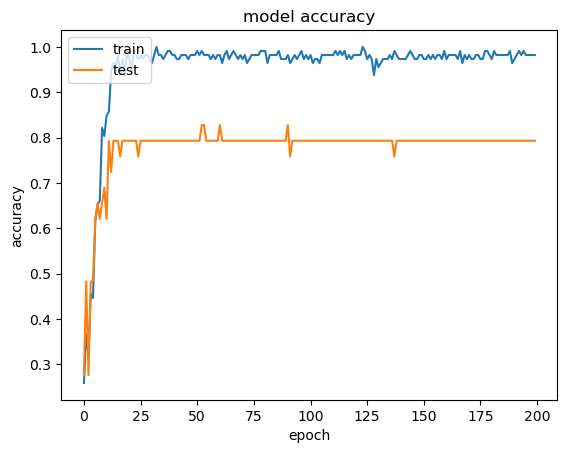

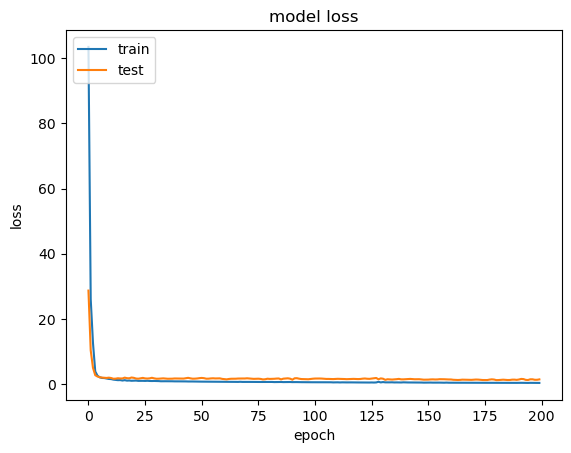

Original labels: ['grade1', 'grade2', 'grade3', 'grade4']
Encoded labels: [0 1 2 3]
One-hot encoded labels:
[[1. 0. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 0. 1.]]


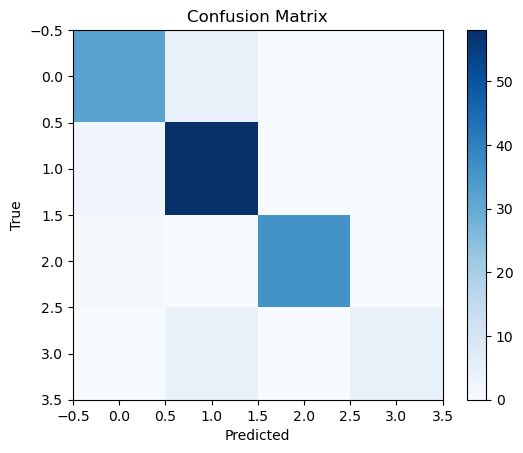

Classification Report:
               precision    recall  f1-score   support

           0       0.91      0.89      0.90        36
           1       0.88      0.97      0.92        60
           2       1.00      0.97      0.99        37
           3       1.00      0.50      0.67         8

    accuracy                           0.92       141
   macro avg       0.95      0.83      0.87       141
weighted avg       0.93      0.92      0.92       141

Weighted F1 Score: 0.9185481097993773
Maximum Training Accuracy: 1.0
Maximum Validation Accuracy: 0.8275862336158752


In [ ]:
#re-fitting the model for using .history 
training = pd.read_csv('training.csv')
test = pd.read_csv('test.csv')
training = training.sample(frac=1, random_state=42)  #shuffeling
test = test.sample(frac=1, random_state=42)
x = training['fname'].values
y = training['label'].values

from sklearn.model_selection import train_test_split
x_train, x_test , y_train , y_test = train_test_split(x , y ,test_size = 0.2 ,random_state  =  0)



def downsample_audio(audio_path, target_sr=22050):
    y, sr = librosa.load(audio_path)
    return librosa.resample(y, orig_sr=sr, target_sr=target_sr)

def extract_mfcc_features(audio, sr, n_mfcc=20):
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=n_mfcc)
    return mfccs.T

def preprocess_audio(audio_path, target_sr=22050, n_mfcc=20):
    audio = downsample_audio(audio_path, target_sr)
    sr = target_sr
    mfccs = extract_mfcc_features(audio, sr, n_mfcc)
    return mfccs.reshape(mfccs.shape[0], mfccs.shape[1], 1)

def pad_or_truncate_mfccs(mfccs, target_length):
    if len(mfccs) > target_length:
        return mfccs[:target_length, :]
    else:
        return np.pad(mfccs, ((0, target_length - len(mfccs)), (0, 0)), mode='constant')
    
    
classes = list(np.unique(training.label))


X = []  # Store MFCC features
Y = []  # Store class labels


for index, row in training.iterrows():
        audio_path = row['fname']
        class_label = row['label']
        audio_path = 'wavfiles/' + audio_path
        mfccs = preprocess_audio(audio_path)
        print(len(mfccs))
        mfccs = pad_or_truncate_mfccs(mfccs, target_length=200)  # Adjust target_length as needed
        X.append(mfccs)
        Y.append(class_label)
    

X = np.array(X)
Y = np.array(Y)


#convering grade to numbers 0 1 2 3 
class_mapping = {'grade1': 0, 'grade2': 1, 'grade3': 2 ,'grade4': 3 }
Y = [class_mapping[label] for label in Y]

Y = to_categorical(Y)  # One-hot encode labels

# Split data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X, Y, test_size=0.2, random_state=42)


print("x train",X_train)
print("x_val",X_val)
print("y_train",y_train)
print("y_val",y_val)

print(y_train.shape)
print(y_val.shape)
print(X_train.shape)

#model.add(tf.keras.layers.BatchNormalization())
#model.add(tf.keras.layers.Dropout(0.25))


from tensorflow.keras import regularizers

num_classes = 4
model = tf.keras.models.Sequential()
model.add(tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=(mfccs.shape[0], mfccs.shape[1], 1)))


model.add(tf.keras.layers.MaxPooling2D((2, 2)))

model.add(tf.keras.layers.Conv2D(64, (3, 3), activation='relu'))
model.add(tf.keras.layers.Dropout(0.5))

model.add(tf.keras.layers.MaxPooling2D((2, 2)))

model.add(tf.keras.layers.Flatten())
model.add(tf.keras.layers.Dense(64, activation='relu' , kernel_regularizer=regularizers.l2(0.01)))


model.add(tf.keras.layers.Dense(num_classes, activation='softmax'))
model.summary()
# Output layer for 4 classes

model.save_weights('/weights.h5')
model.summary()

last_layer_output_shape = model.layers[-1].output_shape
print("Last layer output shape:", last_layer_output_shape)

model.compile(loss='categorical_crossentropy', optimizer = tf.keras.optimizers.Adam(learning_rate=0.001), metrics=['accuracy'])


history = model.fit(X_train, y_train, epochs=200, batch_size=32, validation_data=(X_val, y_val))
model.load_weights('/weights.h5')

def downsample_audio(audio_path, target_sr=22050):
    y, sr = librosa.load(audio_path)
    return librosa.resample(y, orig_sr=sr, target_sr=target_sr)

def extract_mfcc_features(audio, sr, n_mfcc=20):
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=n_mfcc)
    return mfccs.T
def pad_or_truncate_mfccs(mfccs, target_length):
    if len(mfccs) > target_length:
        return mfccs[:target_length, :]
    else:
        return np.pad(mfccs, ((0, target_length - len(mfccs)), (0, 0)), mode='constant')
def preprocess_audio(audio_path, target_sr=22050, n_mfcc=20):
    audio, sr = librosa.load(audio_path, sr=target_sr)  # Load audio and sample rate
    audio = downsample_audio(audio_path, target_sr)
    sr = target_sr
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=20).T
    mfccs = pad_or_truncate_mfccs(mfccs, target_length=200)  # Adjust target_length to match the expected input shape
    return mfccs.reshape(1, mfccs.shape[0], mfccs.shape[1], 1)  # Reshape for prediction
  # Reshape for prediction

  
    
classes = list(np.unique(training.label))


X = []  # Store MFCC features
Y = []  # Store class labels


#making prediction of the signals in "test"

directory_path = 'test'

for file in tqdm(os.listdir(directory_path)):
    # Predict the class
    audio_path = 'test/'+file  # Replace with the actual path
    mfccs_test = preprocess_audio(audio_path)
    prediction = model.predict(mfccs_test)
    predicted_class = np.argmax(prediction)  # Get the index of the predicted class

    # Map the index back to the class label (if applicable)
    class_mapping = {0: 'grade1', 1: 'grade2', 2: 'grade3', 3: 'grade4'}  # Adjust accordingly
    predicted_label = class_mapping[predicted_class]

    print("Predicted class for "+file +":", predicted_class)
    print("Predicted label"+file +":", predicted_label)
    
    
#making prediction of the signals in "wavfile" 
    
directory_path = 'wavfiles'

# Initialize an empty DataFrame
train = pd.DataFrame(columns=['File', 'Predicted_Class'])

for file in tqdm(os.listdir(directory_path)):
        # Predict the class
        audio_path = os.path.join(directory_path, file)
        mfccs_test = preprocess_audio(audio_path)  # Assuming you have a function preprocess_audio
        prediction = model.predict(mfccs_test)
        predicted_class = np.argmax(prediction)

        # Map the index back to the class label (if applicable)
        class_mapping = {0: 'grade1', 1: 'grade2', 2: 'grade3', 3: 'grade4'}  # Adjust accordingly
        predicted_label = class_mapping[predicted_class]

        # Append the result to the DataFrame
        train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

        
test = test.to_csv('test_audio_validation.csv', index =False)
train = train.to_csv('train_audio_validation.csv', index =False)


predicted_test = pd.read_csv('test_audio_validation.csv')
predicted_train = pd.read_csv('traing_audio_validation.csv')

#re-initializing the dataframes
training = pd.read_csv('training.csv')
test = pd.read_csv('test.csv')


y_predicted_train = predicted_train.iloc[:,-1].values
y_true_train = training.iloc[:,-1].values
y_predicted_test = predicted_test.iloc[:,-1].values
y_true_test = test.iloc[:,-1].values


#plotting the accuracy 
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


#plotting the loss graph
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()



labels = np.array(classes)


from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelEncoder

# Assuming y_test contains string labels
y_test = classes

# Use LabelEncoder to convert string labels to integers
label_encoder = LabelEncoder()
y_test_encoded = label_encoder.fit_transform(y_test)

# One-hot encode y_test_encoded
y_test_onehot = to_categorical(y_test_encoded, num_classes=len(label_encoder.classes_))

# Display the original and one-hot encoded labels
print("Original labels:", y_test)
print("Encoded labels:", y_test_encoded)
print("One-hot encoded labels:")
print(y_test_onehot)



y_pred = predicted_train['Predicted_Class'].values
y_test_encoded = label_encoder.fit_transform(y_pred)
y_pred = y_test_encoded

y_true = training['label'].values
y_true_encoded = label_encoder.fit_transform(y_true)
y_true = y_true_encoded


#confusion matrix
from sklearn.metrics import f1_score, confusion_matrix, classification_report


# Calculate F1 score
f1 = f1_score(y_true, y_pred, average='weighted')

# Generate confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Plot confusion matrix
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_true, y_pred))

# Print F1 score
print("Weighted F1 Score:", f1)


train_accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']

# Find the maximum accuracy achieved during training
max_train_accuracy = max(train_accuracy)
max_val_accuracy = max(val_accuracy)

print(f"Maximum Training Accuracy: {max_train_accuracy}")
print(f"Maximum Validation Accuracy: {max_val_accuracy}")

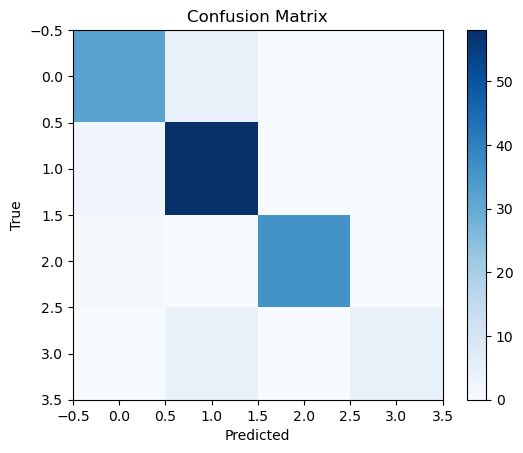

In [11]:
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

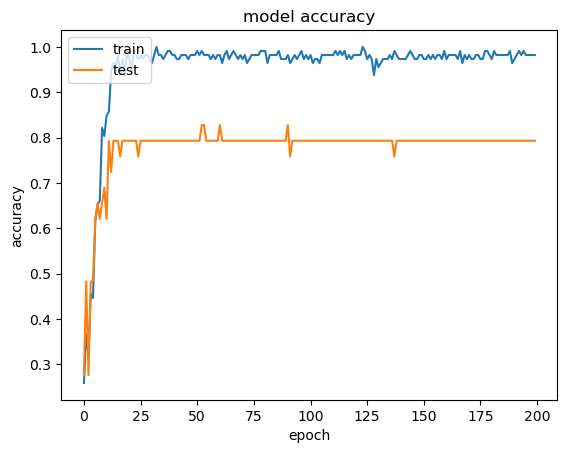

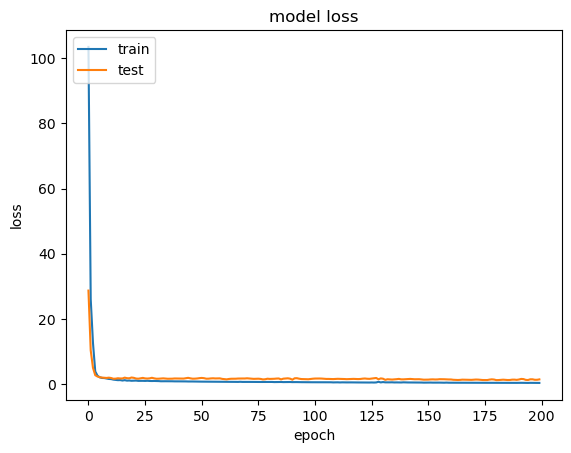

In [6]:

#plotting the accuracy 
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


#plotting the loss graph
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


In [19]:
model.save('model_1\conv2.h')

INFO:tensorflow:Assets written to: model_1\conv2.h\assets


INFO:tensorflow:Assets written to: model_1\conv2.h\assets



  0%|          | 0/141 [00:00<?, ?it/s]

1/1 [==============================] - 0s 35ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  1%|          | 1/141 [00:00<00:25,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  1%|▏         | 2/141 [00:00<00:24,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  2%|▏         | 3/141 [00:00<00:22,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  3%|▎         | 4/141 [00:00<00:20,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  4%|▎         | 5/141 [00:00<00:20,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  4%|▍         | 6/141 [00:00<00:20,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  5%|▍         | 7/141 [00:01<00:19,  6.81it/s]

1/1 [==============================] - 0s 25ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  6%|▌         | 8/141 [00:01<00:19,  6.93it/s]

1/1 [==============================] - 0s 21ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  6%|▋         | 9/141 [00:01<00:19,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  7%|▋         | 10/141 [00:01<00:19,  6.84it/s]

1/1 [==============================] - 0s 25ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  8%|▊         | 11/141 [00:01<00:19,  6.80it/s]

1/1 [==============================] - 0s 27ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  9%|▊         | 12/141 [00:01<00:18,  6.81it/s]

1/1 [==============================] - 0s 25ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

  9%|▉         | 13/141 [00:01<00:18,  6.93it/s]

1/1 [==============================] - 0s 32ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 10%|▉         | 14/141 [00:02<00:19,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 11%|█         | 15/141 [00:02<00:18,  6.69it/s]

1/1 [==============================] - 0s 32ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 11%|█▏        | 16/141 [00:02<00:19,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 12%|█▏        | 17/141 [00:02<00:19,  6.21it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 13%|█▎        | 18/141 [00:02<00:20,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 13%|█▎        | 19/141 [00:02<00:20,  6.05it/s]

1/1 [==============================] - 0s 30ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 14%|█▍        | 20/141 [00:03<00:20,  5.84it/s]

1/1 [==============================] - 0s 27ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 15%|█▍        | 21/141 [00:03<00:20,  5.93it/s]

1/1 [==============================] - 0s 34ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 16%|█▌        | 22/141 [00:03<00:20,  5.83it/s]

1/1 [==============================] - 0s 30ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 16%|█▋        | 23/141 [00:03<00:19,  5.94it/s]

1/1 [==============================] - 0s 27ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 17%|█▋        | 24/141 [00:03<00:19,  5.90it/s]

1/1 [==============================] - 0s 28ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 18%|█▊        | 25/141 [00:03<00:19,  5.91it/s]

1/1 [==============================] - 0s 30ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 18%|█▊        | 26/141 [00:04<00:19,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 19%|█▉        | 27/141 [00:04<00:18,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 20%|█▉        | 28/141 [00:04<00:18,  6.11it/s]

1/1 [==============================] - 0s 32ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 21%|██        | 29/141 [00:04<00:17,  6.23it/s]

1/1 [==============================] - 0s 29ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 21%|██▏       | 30/141 [00:04<00:18,  6.11it/s]

1/1 [==============================] - 0s 30ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 22%|██▏       | 31/141 [00:04<00:17,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 23%|██▎       | 32/141 [00:05<00:17,  6.24it/s]

1/1 [==============================] - 0s 27ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 23%|██▎       | 33/141 [00:05<00:17,  6.29it/s]

1/1 [==============================] - 0s 28ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 24%|██▍       | 34/141 [00:05<00:16,  6.31it/s]

1/1 [==============================] - 0s 33ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 25%|██▍       | 35/141 [00:05<00:17,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 26%|██▌       | 36/141 [00:05<00:17,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 26%|██▌       | 37/141 [00:05<00:15,  6.53it/s]

1/1 [==============================] - 0s 26ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 27%|██▋       | 38/141 [00:06<00:15,  6.76it/s]

1/1 [==============================] - 0s 25ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 28%|██▊       | 39/141 [00:06<00:14,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 28%|██▊       | 40/141 [00:06<00:14,  6.92it/s]

1/1 [==============================] - 0s 23ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 29%|██▉       | 41/141 [00:06<00:14,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 30%|██▉       | 42/141 [00:06<00:13,  7.22it/s]

1/1 [==============================] - 0s 29ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 30%|███       | 43/141 [00:06<00:14,  6.96it/s]

1/1 [==============================] - 0s 24ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 31%|███       | 44/141 [00:06<00:13,  7.19it/s]

1/1 [==============================] - 0s 29ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 32%|███▏      | 45/141 [00:06<00:13,  6.98it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 33%|███▎      | 46/141 [00:07<00:14,  6.59it/s]

1/1 [==============================] - 0s 29ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 33%|███▎      | 47/141 [00:07<00:14,  6.50it/s]

1/1 [==============================] - 0s 26ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 34%|███▍      | 48/141 [00:07<00:14,  6.63it/s]

1/1 [==============================] - 0s 34ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 35%|███▍      | 49/141 [00:07<00:14,  6.34it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 35%|███▌      | 50/141 [00:07<00:15,  5.80it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 36%|███▌      | 51/141 [00:08<00:18,  4.99it/s]

1/1 [==============================] - 0s 56ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 37%|███▋      | 52/141 [00:08<00:19,  4.48it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 38%|███▊      | 53/141 [00:08<00:21,  4.11it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 38%|███▊      | 54/141 [00:08<00:22,  3.81it/s]

1/1 [==============================] - 0s 58ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 39%|███▉      | 55/141 [00:09<00:24,  3.54it/s]

1/1 [==============================] - 0s 64ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 40%|███▉      | 56/141 [00:09<00:25,  3.40it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 40%|████      | 57/141 [00:09<00:25,  3.34it/s]

1/1 [==============================] - 0s 63ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 41%|████      | 58/141 [00:10<00:26,  3.17it/s]

1/1 [==============================] - 0s 63ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 42%|████▏     | 59/141 [00:10<00:25,  3.18it/s]

1/1 [==============================] - 0s 65ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 43%|████▎     | 60/141 [00:10<00:25,  3.16it/s]

1/1 [==============================] - 0s 58ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 43%|████▎     | 61/141 [00:11<00:25,  3.15it/s]

1/1 [==============================] - 0s 65ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 44%|████▍     | 62/141 [00:11<00:25,  3.14it/s]

1/1 [==============================] - 0s 56ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 45%|████▍     | 63/141 [00:11<00:24,  3.23it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 45%|████▌     | 64/141 [00:12<00:23,  3.30it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 46%|████▌     | 65/141 [00:12<00:22,  3.44it/s]

1/1 [==============================] - 0s 62ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 47%|████▋     | 66/141 [00:12<00:22,  3.38it/s]

1/1 [==============================] - 0s 56ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 48%|████▊     | 67/141 [00:13<00:21,  3.38it/s]

1/1 [==============================] - 0s 60ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 48%|████▊     | 68/141 [00:13<00:21,  3.38it/s]

1/1 [==============================] - 0s 59ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 49%|████▉     | 69/141 [00:13<00:21,  3.33it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 50%|████▉     | 70/141 [00:13<00:20,  3.38it/s]

1/1 [==============================] - 0s 59ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 50%|█████     | 71/141 [00:14<00:21,  3.28it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 51%|█████     | 72/141 [00:14<00:20,  3.30it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 52%|█████▏    | 73/141 [00:14<00:20,  3.27it/s]

1/1 [==============================] - 0s 54ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 52%|█████▏    | 74/141 [00:15<00:20,  3.32it/s]

1/1 [==============================] - 0s 59ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 53%|█████▎    | 75/141 [00:15<00:20,  3.26it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 54%|█████▍    | 76/141 [00:15<00:19,  3.36it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 55%|█████▍    | 77/141 [00:16<00:18,  3.44it/s]

1/1 [==============================] - 0s 63ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 55%|█████▌    | 78/141 [00:16<00:18,  3.38it/s]

1/1 [==============================] - 0s 59ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 56%|█████▌    | 79/141 [00:16<00:18,  3.36it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 57%|█████▋    | 80/141 [00:16<00:18,  3.30it/s]

1/1 [==============================] - 0s 59ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 57%|█████▋    | 81/141 [00:17<00:17,  3.34it/s]

1/1 [==============================] - 0s 61ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 58%|█████▊    | 82/141 [00:17<00:17,  3.32it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 59%|█████▉    | 83/141 [00:17<00:17,  3.34it/s]

1/1 [==============================] - 0s 54ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 60%|█████▉    | 84/141 [00:18<00:16,  3.36it/s]

1/1 [==============================] - 0s 59ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 60%|██████    | 85/141 [00:18<00:16,  3.34it/s]

1/1 [==============================] - 0s 61ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 61%|██████    | 86/141 [00:18<00:16,  3.28it/s]

1/1 [==============================] - 0s 60ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 62%|██████▏   | 87/141 [00:19<00:16,  3.20it/s]

1/1 [==============================] - 0s 65ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 62%|██████▏   | 88/141 [00:19<00:16,  3.18it/s]

1/1 [==============================] - 0s 65ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 63%|██████▎   | 89/141 [00:19<00:16,  3.09it/s]

1/1 [==============================] - 0s 62ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 64%|██████▍   | 90/141 [00:20<00:16,  3.01it/s]

1/1 [==============================] - 0s 73ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 65%|██████▍   | 91/141 [00:20<00:16,  2.96it/s]

1/1 [==============================] - 0s 63ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 65%|██████▌   | 92/141 [00:20<00:16,  2.96it/s]

1/1 [==============================] - 0s 73ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 66%|██████▌   | 93/141 [00:21<00:16,  2.94it/s]

1/1 [==============================] - 0s 62ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 67%|██████▋   | 94/141 [00:21<00:17,  2.76it/s]

1/1 [==============================] - 0s 71ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 67%|██████▋   | 95/141 [00:21<00:16,  2.75it/s]

1/1 [==============================] - 0s 66ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 68%|██████▊   | 96/141 [00:22<00:15,  2.82it/s]

1/1 [==============================] - 0s 64ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 69%|██████▉   | 97/141 [00:22<00:15,  2.84it/s]

1/1 [==============================] - 0s 68ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 70%|██████▉   | 98/141 [00:22<00:14,  2.90it/s]

1/1 [==============================] - 0s 57ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 70%|███████   | 99/141 [00:23<00:14,  2.95it/s]

1/1 [==============================] - 0s 59ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 71%|███████   | 100/141 [00:23<00:14,  2.92it/s]

1/1 [==============================] - 0s 60ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 72%|███████▏  | 101/141 [00:23<00:13,  2.92it/s]

1/1 [==============================] - 0s 60ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 72%|███████▏  | 102/141 [00:24<00:13,  2.89it/s]

1/1 [==============================] - 0s 62ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 73%|███████▎  | 103/141 [00:24<00:12,  2.98it/s]

1/1 [==============================] - 0s 62ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 74%|███████▍  | 104/141 [00:24<00:12,  3.00it/s]

1/1 [==============================] - 0s 70ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 74%|███████▍  | 105/141 [00:25<00:11,  3.01it/s]

1/1 [==============================] - 0s 61ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 75%|███████▌  | 106/141 [00:25<00:11,  3.09it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 76%|███████▌  | 107/141 [00:25<00:10,  3.21it/s]

1/1 [==============================] - 0s 58ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 77%|███████▋  | 108/141 [00:26<00:09,  3.34it/s]

1/1 [==============================] - 0s 61ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 77%|███████▋  | 109/141 [00:26<00:09,  3.36it/s]

1/1 [==============================] - 0s 46ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 78%|███████▊  | 110/141 [00:26<00:08,  3.53it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 79%|███████▊  | 111/141 [00:26<00:08,  3.58it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 79%|███████▉  | 112/141 [00:27<00:08,  3.61it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 80%|████████  | 113/141 [00:27<00:07,  3.57it/s]

1/1 [==============================] - 0s 52ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 81%|████████  | 114/141 [00:27<00:07,  3.62it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 82%|████████▏ | 115/141 [00:27<00:06,  3.76it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 82%|████████▏ | 116/141 [00:28<00:06,  3.80it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 83%|████████▎ | 117/141 [00:28<00:06,  3.84it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 84%|████████▎ | 118/141 [00:28<00:05,  3.90it/s]

1/1 [==============================] - 0s 41ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 84%|████████▍ | 119/141 [00:28<00:05,  3.94it/s]

1/1 [==============================] - 0s 45ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 85%|████████▌ | 120/141 [00:29<00:05,  3.99it/s]

1/1 [==============================] - 0s 41ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 86%|████████▌ | 121/141 [00:29<00:04,  4.04it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 87%|████████▋ | 122/141 [00:29<00:04,  4.06it/s]

1/1 [==============================] - 0s 43ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 87%|████████▋ | 123/141 [00:29<00:04,  4.15it/s]

1/1 [==============================] - 0s 46ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 88%|████████▊ | 124/141 [00:30<00:04,  4.18it/s]

1/1 [==============================] - 0s 38ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 89%|████████▊ | 125/141 [00:30<00:03,  4.25it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 89%|████████▉ | 126/141 [00:30<00:03,  4.28it/s]

1/1 [==============================] - 0s 39ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 90%|█████████ | 127/141 [00:30<00:03,  4.30it/s]

1/1 [==============================] - 0s 40ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 91%|█████████ | 128/141 [00:31<00:02,  4.34it/s]

1/1 [==============================] - 0s 40ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 91%|█████████▏| 129/141 [00:31<00:02,  4.40it/s]

1/1 [==============================] - 0s 44ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 92%|█████████▏| 130/141 [00:31<00:02,  4.32it/s]

1/1 [==============================] - 0s 39ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 93%|█████████▎| 131/141 [00:31<00:02,  4.34it/s]

1/1 [==============================] - 0s 40ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 94%|█████████▎| 132/141 [00:32<00:02,  4.33it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 94%|█████████▍| 133/141 [00:32<00:01,  4.39it/s]

1/1 [==============================] - 0s 40ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 95%|█████████▌| 134/141 [00:32<00:01,  4.33it/s]

1/1 [==============================] - 0s 43ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 96%|█████████▌| 135/141 [00:32<00:01,  4.23it/s]

1/1 [==============================] - 0s 44ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 96%|█████████▋| 136/141 [00:32<00:01,  4.27it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 97%|█████████▋| 137/141 [00:33<00:00,  4.27it/s]

1/1 [==============================] - 0s 40ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 98%|█████████▊| 138/141 [00:33<00:00,  4.32it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 99%|█████████▊| 139/141 [00:33<00:00,  4.30it/s]

1/1 [==============================] - 0s 39ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

 99%|█████████▉| 140/141 [00:33<00:00,  4.31it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_9124\751329604.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
100%|██████████| 141/141 [00:34<00:00,  4.13it/s]

Original labels: ['grade1', 'grade2', 'grade3', 'grade4']
Encoded labels: [0 1 2 3]
One-hot encoded labels:
[[1. 0. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 0. 1.]]


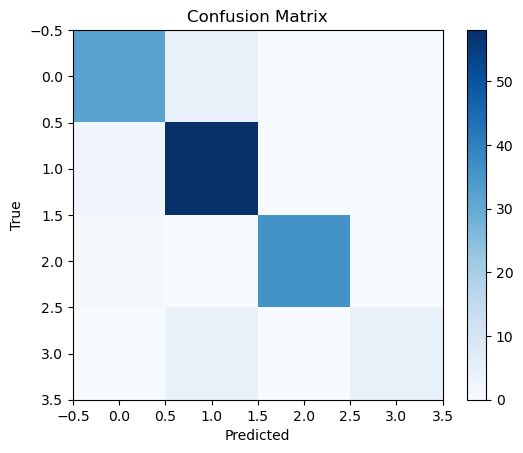

Classification Report:
               precision    recall  f1-score   support

           0       0.91      0.89      0.90        36
           1       0.88      0.97      0.92        60
           2       1.00      0.97      0.99        37
           3       1.00      0.50      0.67         8

    accuracy                           0.92       141
   macro avg       0.95      0.83      0.87       141
weighted avg       0.93      0.92      0.92       141

Weighted F1 Score: 0.9185481097993773
Maximum Training Accuracy: 1.0
Maximum Validation Accuracy: 0.8275862336158752


In [8]:


X = []  # Store MFCC features
Y = []  # Store class labels


#making prediction of the signals in "test"


#making prediction of the signals in "wavfile" 
    
directory_path = 'wavfiles'

# Initialize an empty DataFrame
train = pd.DataFrame(columns=['File', 'Predicted_Class'])

for file in tqdm(os.listdir(directory_path)):
        # Predict the class
        audio_path = os.path.join(directory_path, file)
        mfccs_test = preprocess_audio(audio_path)  # Assuming you have a function preprocess_audio
        prediction = model.predict(mfccs_test)
        predicted_class = np.argmax(prediction)

        # Map the index back to the class label (if applicable)
        class_mapping = {0: 'grade1', 1: 'grade2', 2: 'grade3', 3: 'grade4'}  # Adjust accordingly
        predicted_label = class_mapping[predicted_class]

        # Append the result to the DataFrame
        train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

        
train = train.to_csv('train_audio_validation.csv', index =False)


training = pd.read_csv('training.csv')
predicted_train = pd.read_csv('traing_audio_validation.csv')



#re-initializing the dataframes


y_predicted_train = predicted_train.iloc[:,-1].values
y_true_train = training.iloc[:,-1].values



labels = np.array(classes)


from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelEncoder

# Assuming y_test contains string labels
y_test = classes

# Use LabelEncoder to convert string labels to integers
label_encoder = LabelEncoder()
y_test_encoded = label_encoder.fit_transform(y_test)

# One-hot encode y_test_encoded
y_test_onehot = to_categorical(y_test_encoded, num_classes=4)

# Display the original and one-hot encoded labels
print("Original labels:", y_test)
print("Encoded labels:", y_test_encoded)
print("One-hot encoded labels:")
print(y_test_onehot)



y_pred = predicted_train['Predicted_Class'].values
y_test_encoded = label_encoder.fit_transform(y_pred)
y_pred = y_test_encoded

y_true = training['label'].values
y_true_encoded = label_encoder.fit_transform(y_true)
y_true = y_true_encoded


#confusion matrix
from sklearn.metrics import f1_score, confusion_matrix, classification_report


# Calculate F1 score
f1 = f1_score(y_true, y_pred, average='weighted')

# Generate confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Plot confusion matrix
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_true, y_pred))

# Print F1 score
print("Weighted F1 Score:", f1)


train_accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']

# Find the maximum accuracy achieved during training
max_train_accuracy = max(train_accuracy)
max_val_accuracy = max(val_accuracy)

print(f"Maximum Training Accuracy: {max_train_accuracy}")
print(f"Maximum Validation Accuracy: {max_val_accuracy}")

In [10]:
from sklearn.metrics import classification_report, confusion_matrix, cohen_kappa_score, matthews_corrcoef, precision_recall_curve, auc

# Assuming y_true and y_pred are the true and predicted labels
print("Classification Report:\n", classification_report(y_true, y_pred))
print("Confusion Matrix:\n", confusion_matrix(y_true, y_pred))
print("Cohen's Kappa:", cohen_kappa_score(y_true, y_pred))
print("Matthews Correlation Coefficient:", matthews_corrcoef(y_true, y_pred))


Classification Report:
               precision    recall  f1-score   support

           0       0.91      0.89      0.90        36
           1       0.88      0.97      0.92        60
           2       1.00      0.97      0.99        37
           3       1.00      0.50      0.67         8

    accuracy                           0.92       141
   macro avg       0.95      0.83      0.87       141
weighted avg       0.93      0.92      0.92       141

Confusion Matrix:
 [[32  4  0  0]
 [ 2 58  0  0]
 [ 1  0 36  0]
 [ 0  4  0  4]]
Cohen's Kappa: 0.8833571482289237
Matthews Correlation Coefficient: 0.8853544205238246


22050


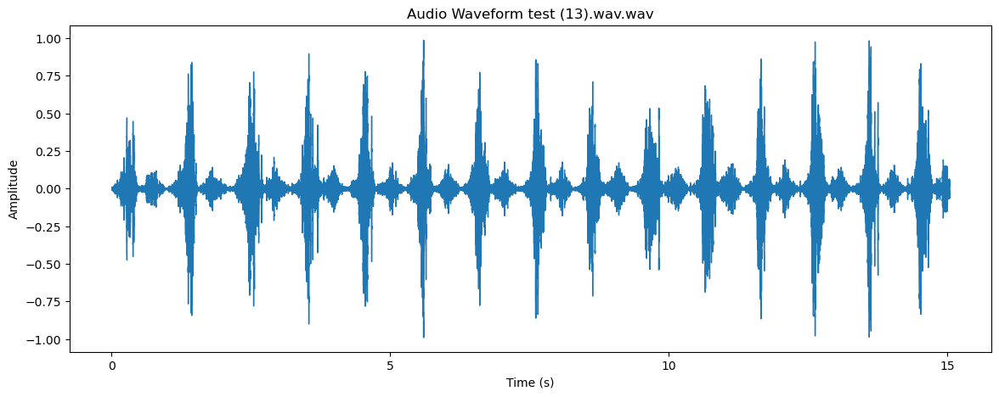

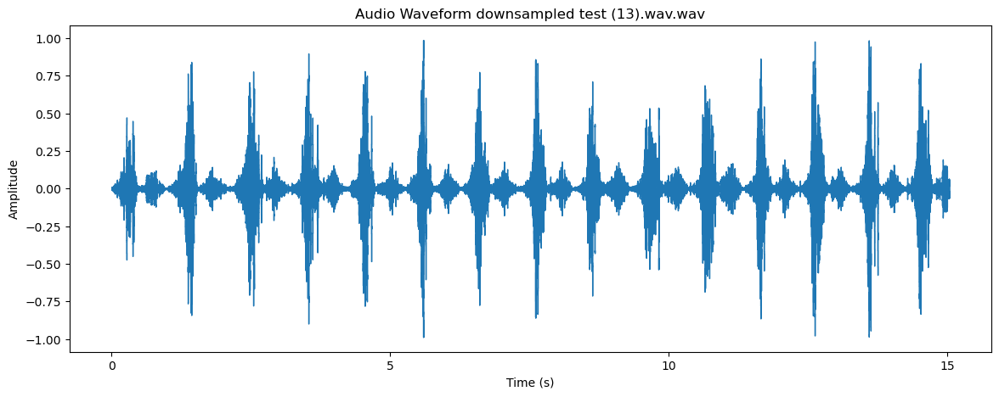

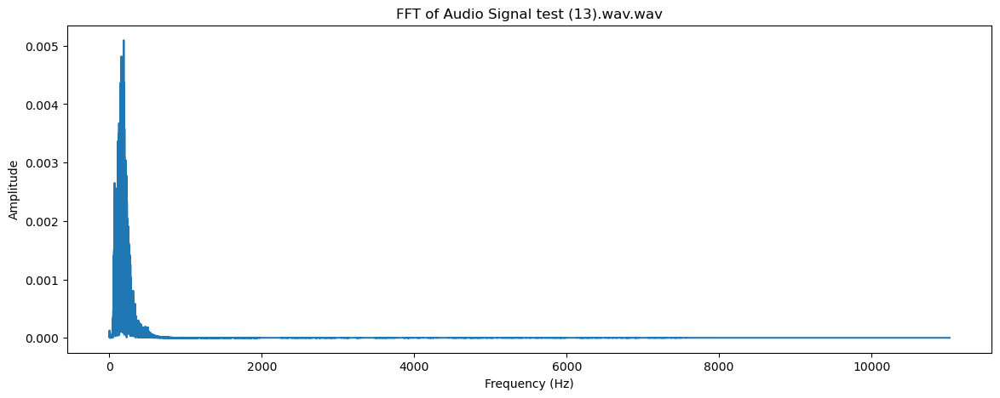

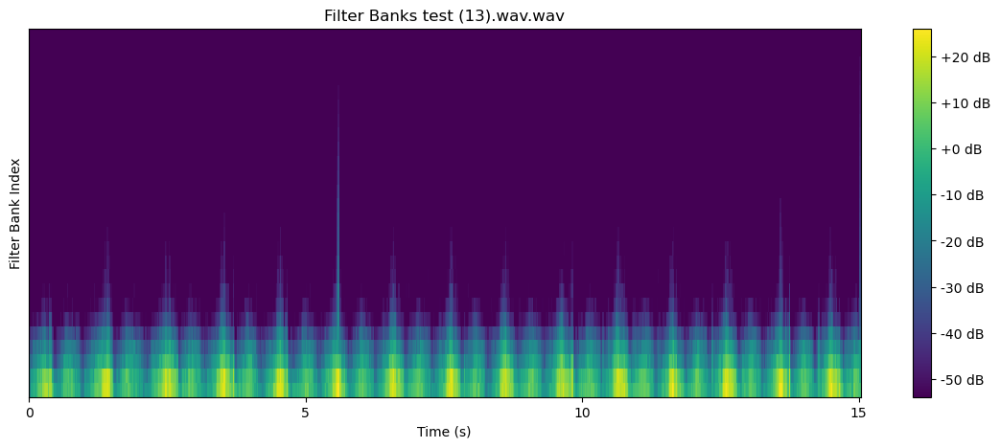

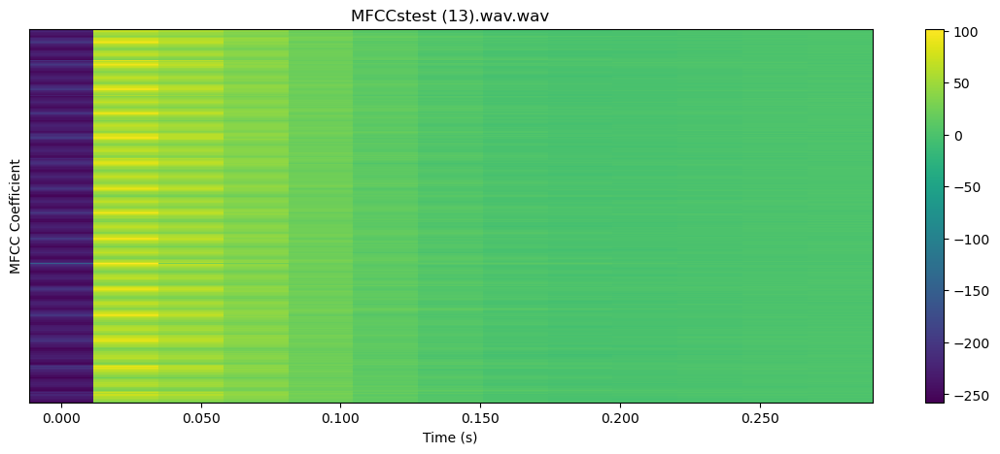

In [24]:
#plot input single audio file

file = "test (13).wav"
audio, sr = librosa.load('test/'+file, sr=22050)
target_sr=22050
librosa.resample(audio, orig_sr=sr, target_sr=target_sr)
print(sr)

def calc_fft(y , rate):
    n = len(y)
    
    freq = np.fft.rfftfreq( n , d = 1/rate )## calculates the frequencies corresponding to each bin in a Real-valued Fast Fourier Transform (RFFT).
    Y = abs(np.fft.rfft(y)/n)  ##magnitude (of a complex number) , /n is done to scale/normalise the length
    return (Y , freq)
Y , freq = calc_fft(audio , sr)

# Calculate filter banks
filter_banks = librosa.feature.melspectrogram(y=audio, sr=sr, n_fft=1200, hop_length=512, n_mels=26)

# Convert filter banks to log scale
log_filter_banks = librosa.power_to_db(filter_banks)

mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_fft=1200, hop_length=512, n_mfcc=13, n_mels=26)

# Transpose for better visualization
mfccs = mfccs.T
plt.figure(figsize=(14, 5))
librosa.display.waveshow(audio, sr=sr)
plt.title('Audio Waveform '+file+'.wav')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.show()
plt.figure(figsize=(14, 5))
librosa.display.waveshow(audio, sr=sr)
plt.title('Audio Waveform downsampled '+file+'.wav')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.show()

plt.figure(figsize=(14, 5))
plt.plot(freq, Y)
plt.title('FFT of Audio Signal '+file+'.wav')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude')
plt.show()


plt.figure(figsize=(14, 5))
librosa.display.specshow(log_filter_banks, sr=sr, hop_length=512, x_axis='time', cmap='viridis')
plt.colorbar(format='%+2.0f dB')
plt.title('Filter Banks '+file+'.wav')
plt.xlabel('Time (s)')
plt.ylabel('Filter Bank Index')
plt.show()


# Plot MFCCs
plt.figure(figsize=(14, 5))
librosa.display.specshow(mfccs, sr=sr, hop_length=512, x_axis='time', cmap='viridis')
plt.colorbar()
plt.title('MFCCs'+file+'.wav')
plt.xlabel('Time (s)')
plt.ylabel('MFCC Coefficient')
plt.show()



  0%|          | 0/19 [00:00<?, ?it/s]

22050


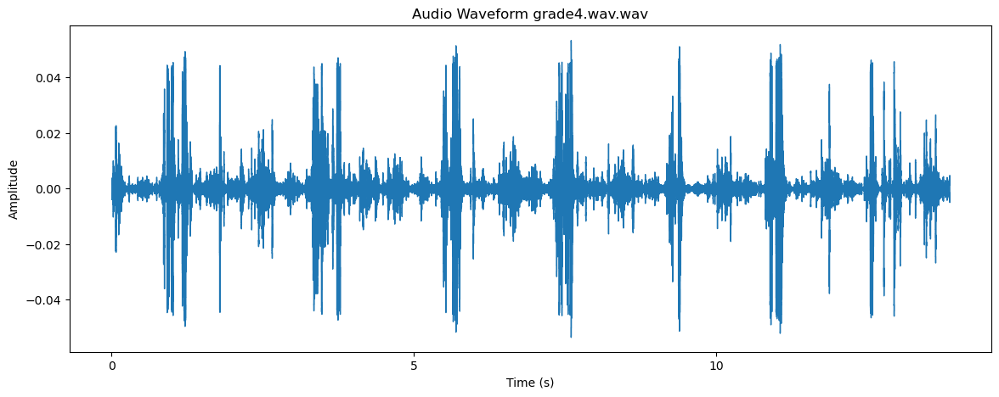

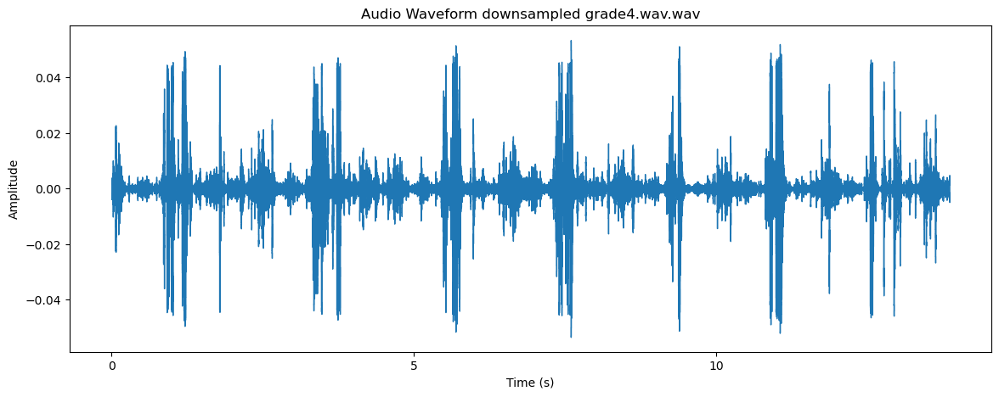

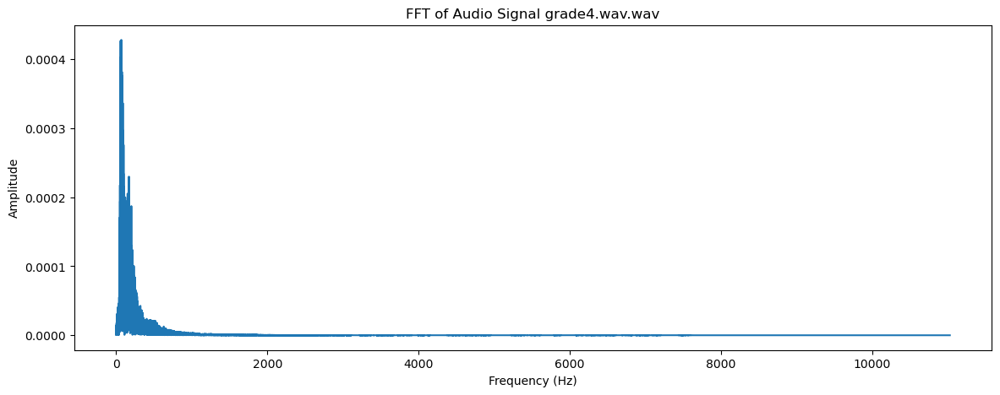

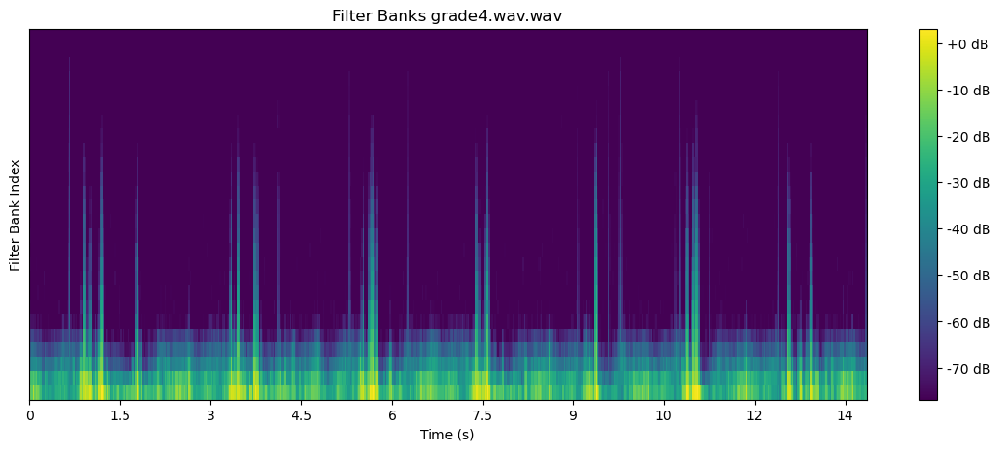

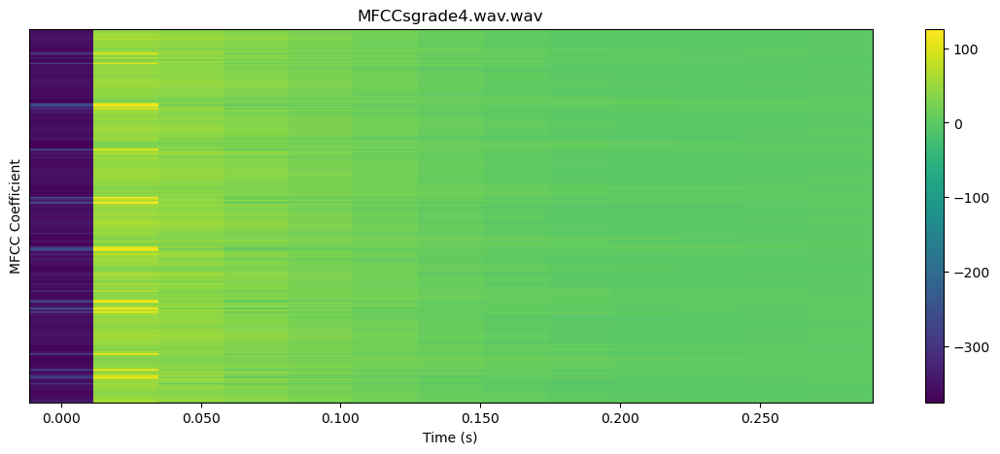


  5%|▌         | 1/19 [00:01<00:25,  1.44s/it]

22050


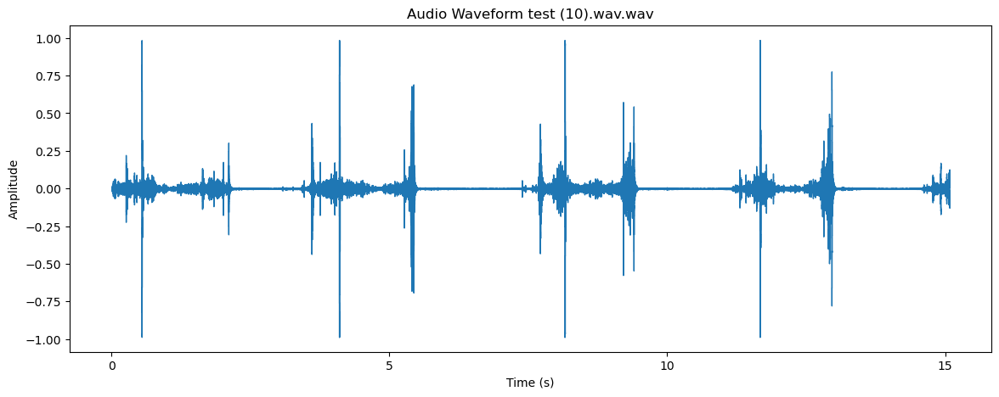

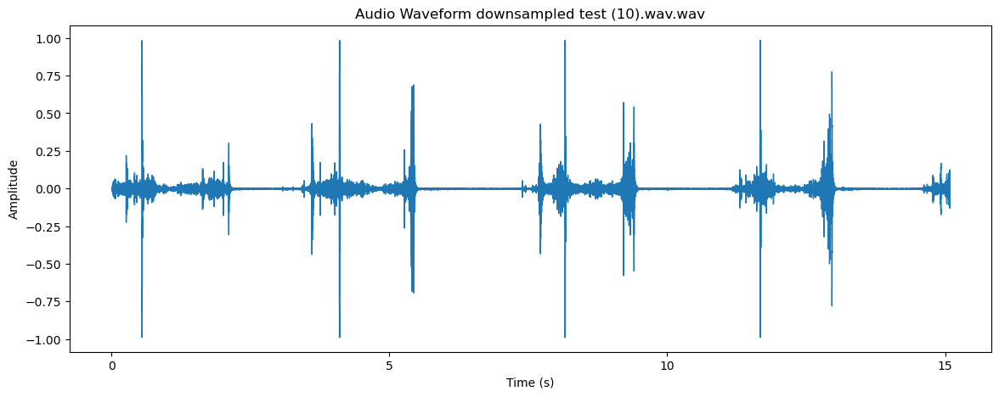

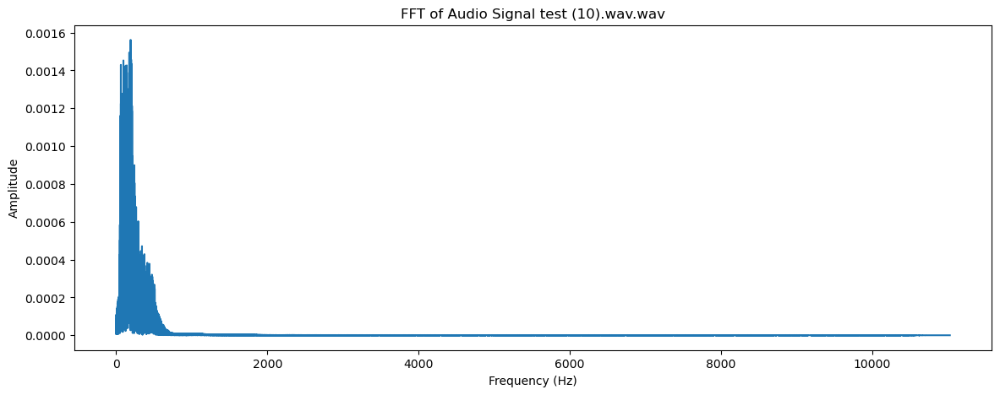

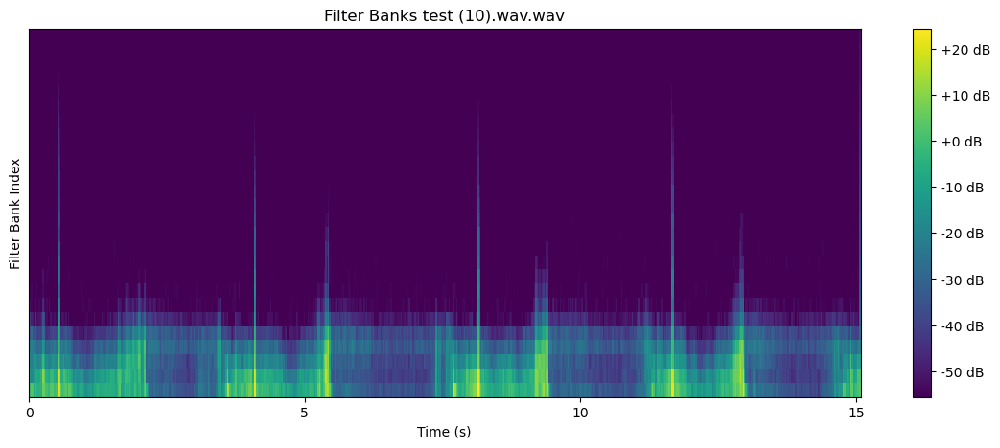

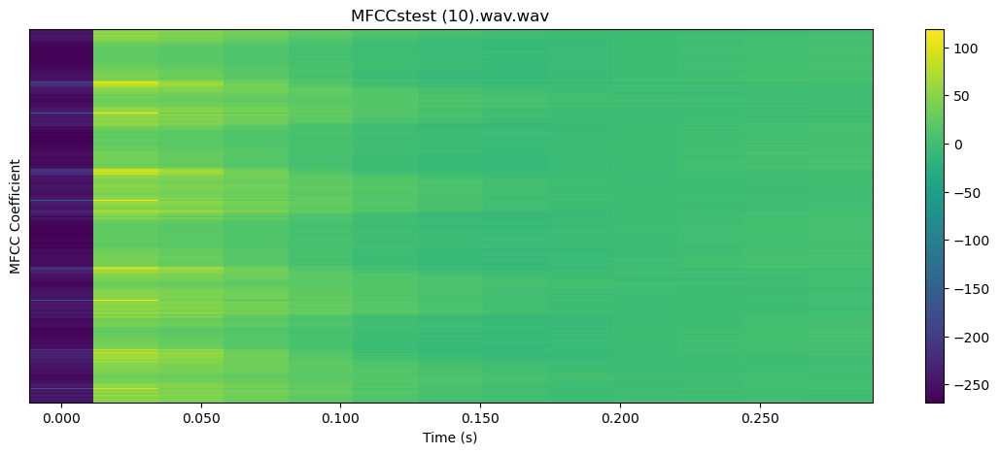


 11%|█         | 2/19 [00:02<00:21,  1.29s/it]

22050


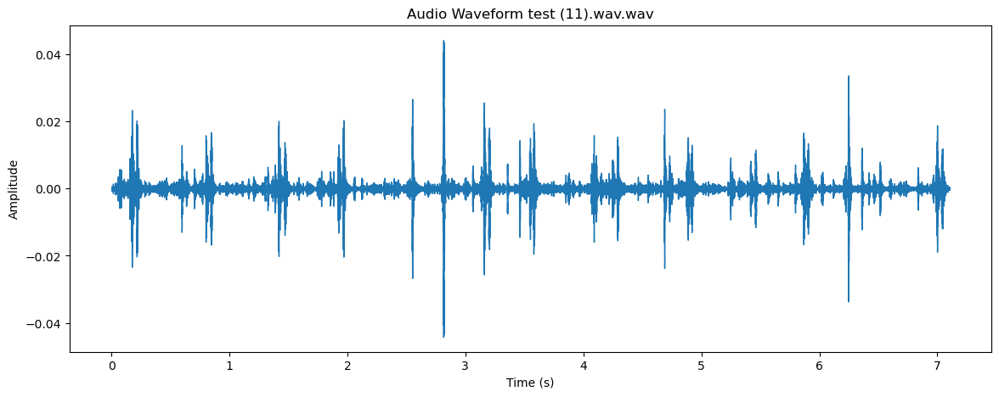

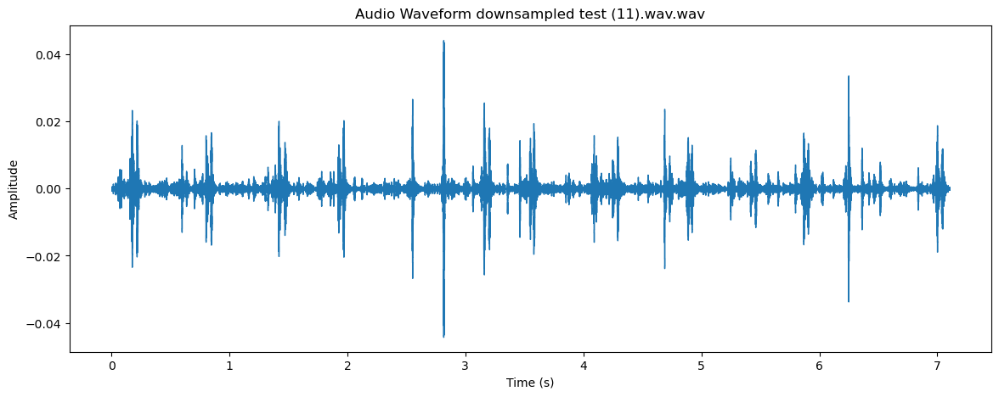

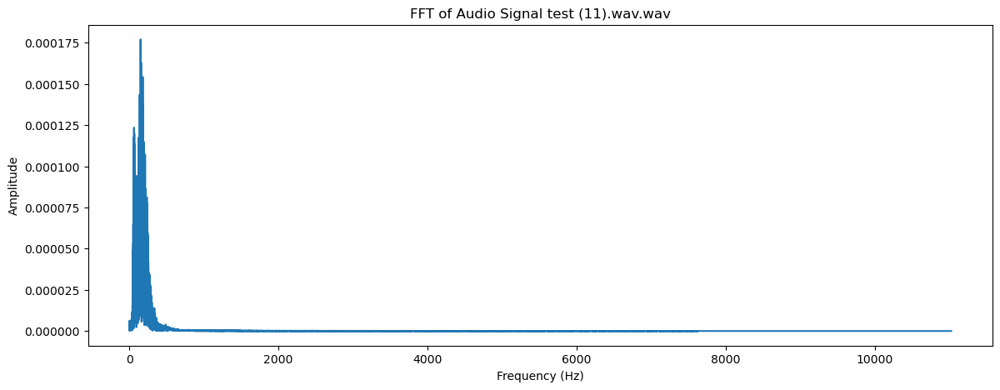

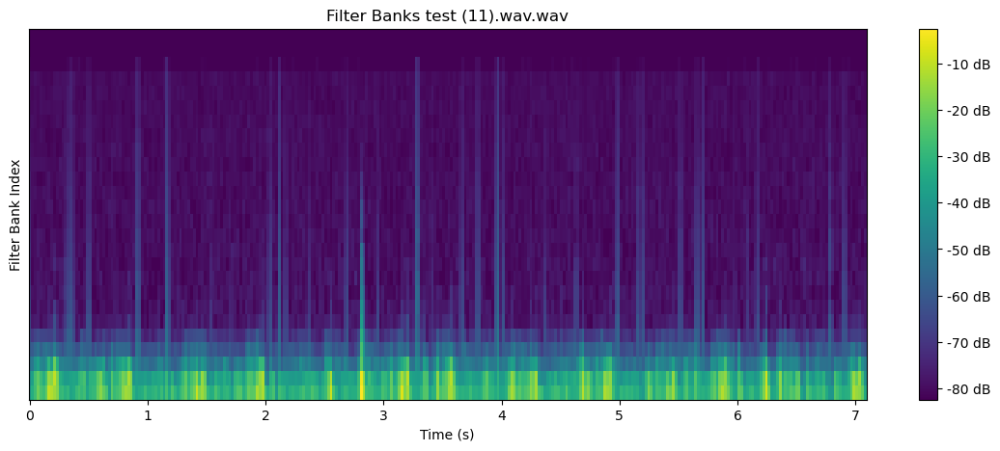

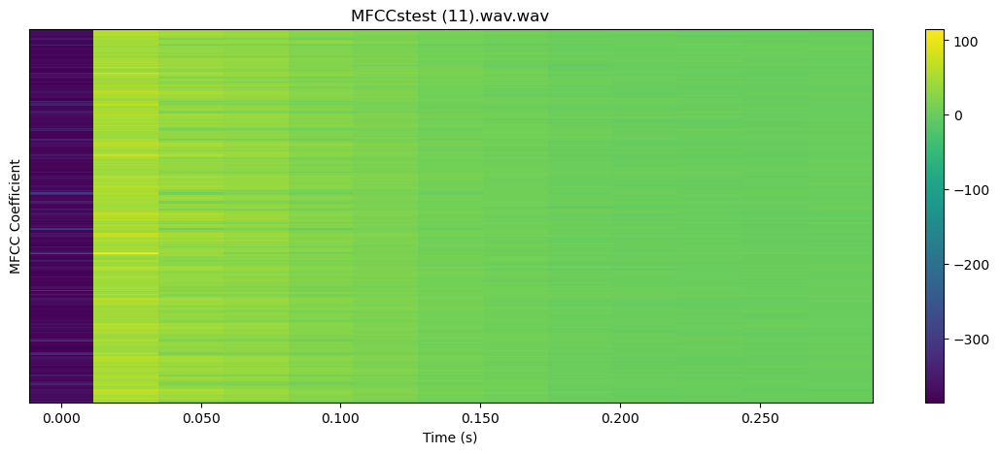


 16%|█▌        | 3/19 [00:03<00:18,  1.15s/it]

22050


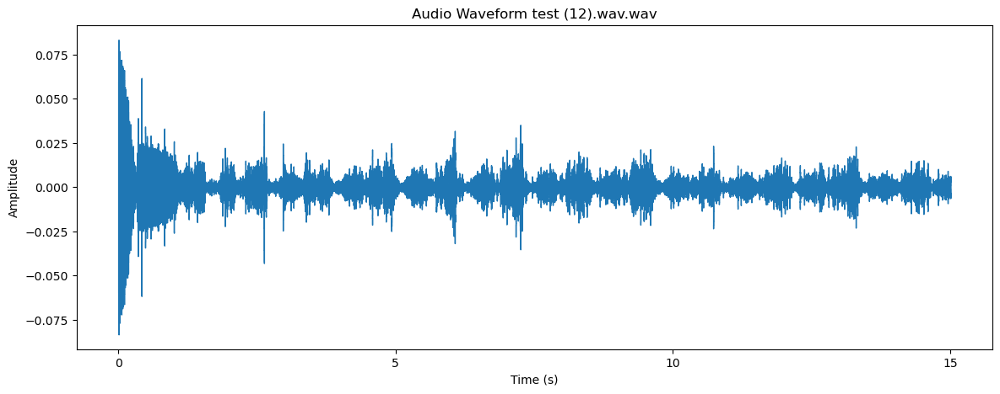

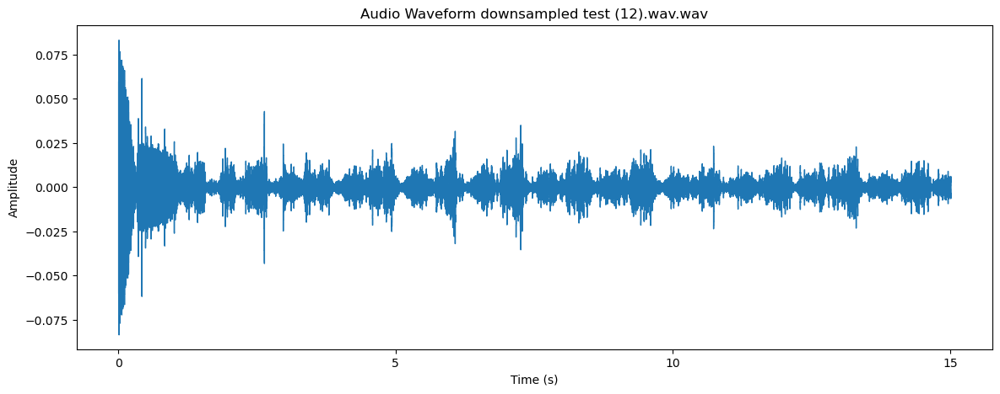

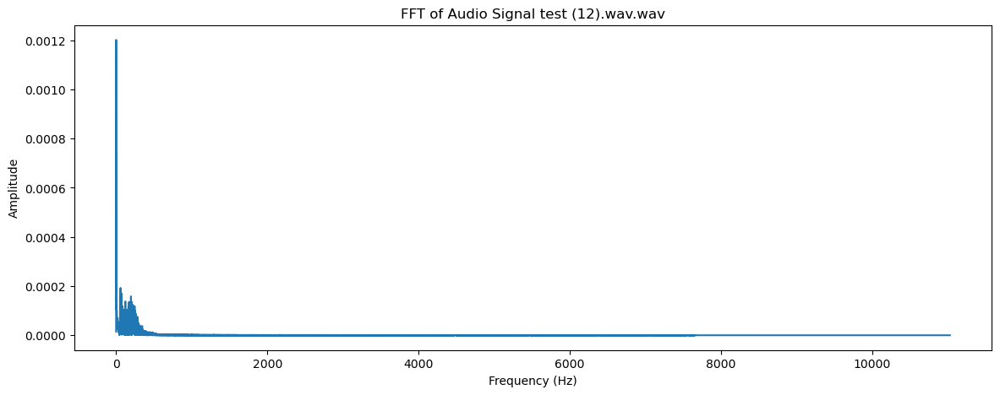

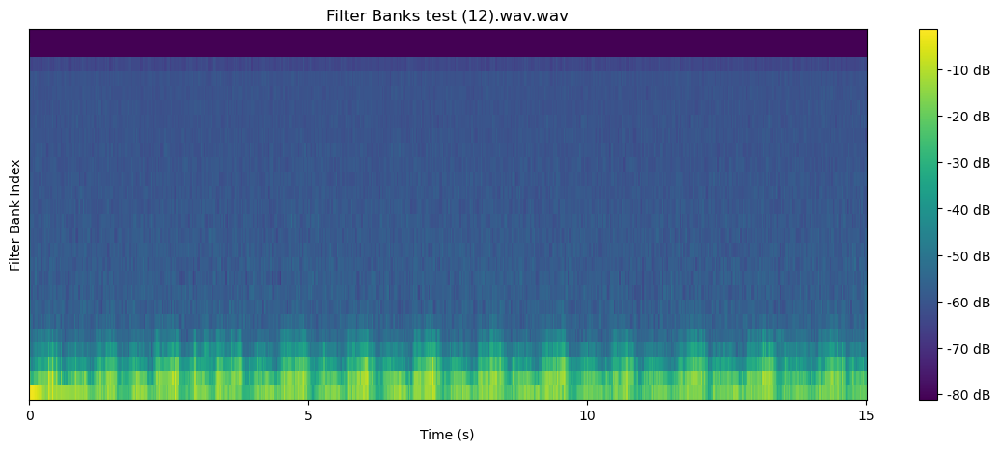

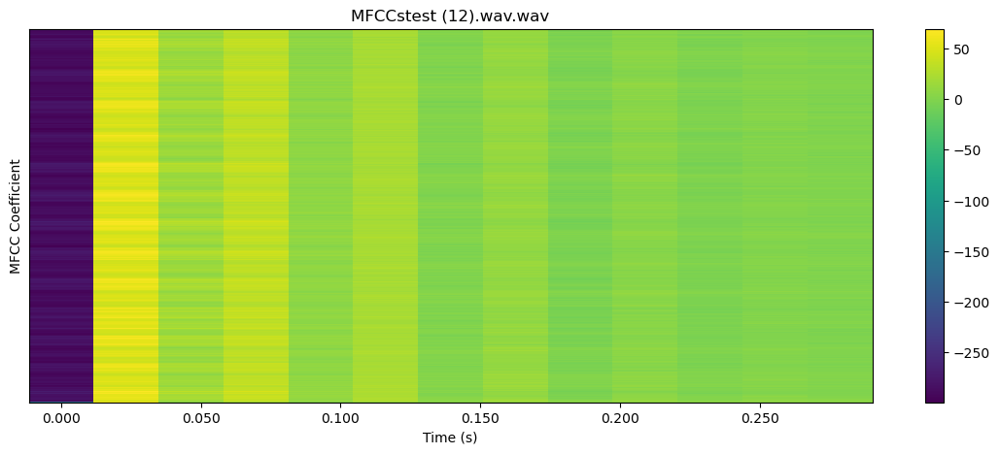


 21%|██        | 4/19 [00:04<00:18,  1.22s/it]

22050


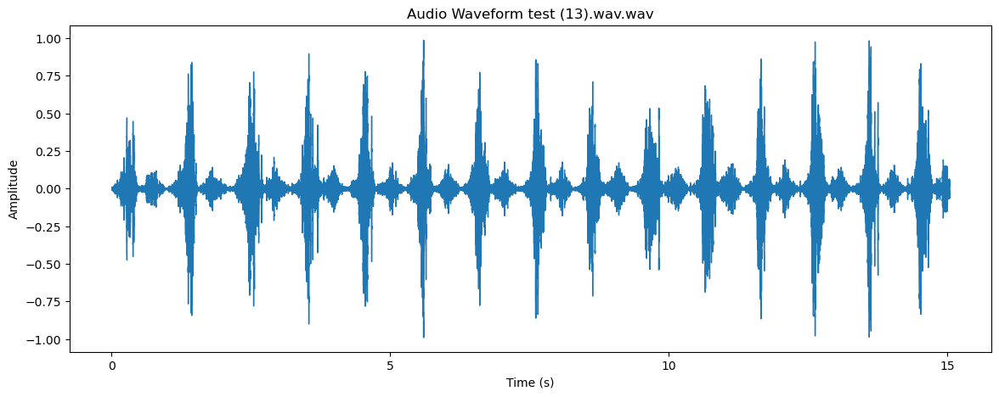

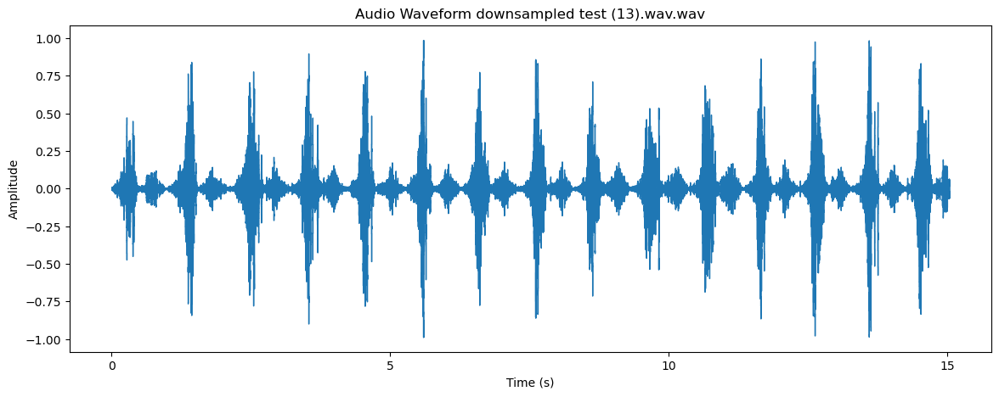

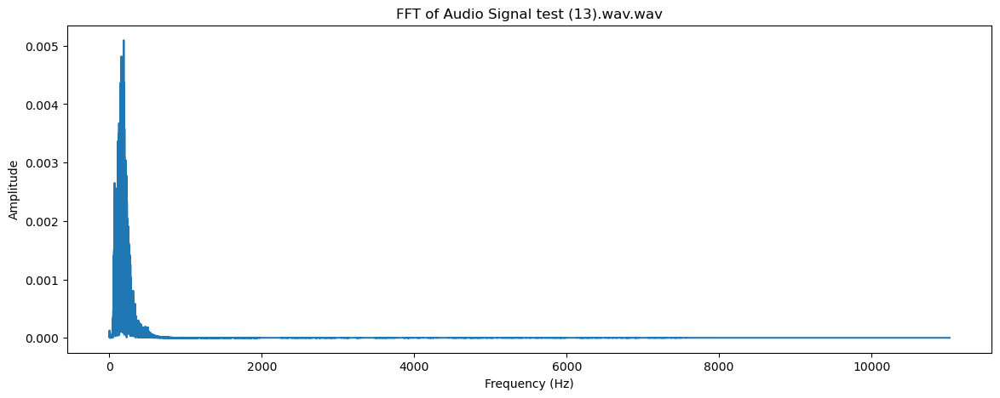

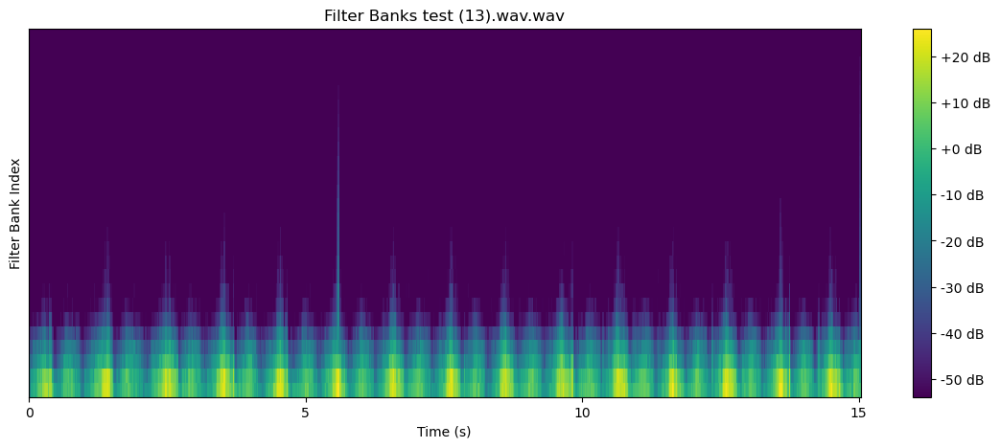

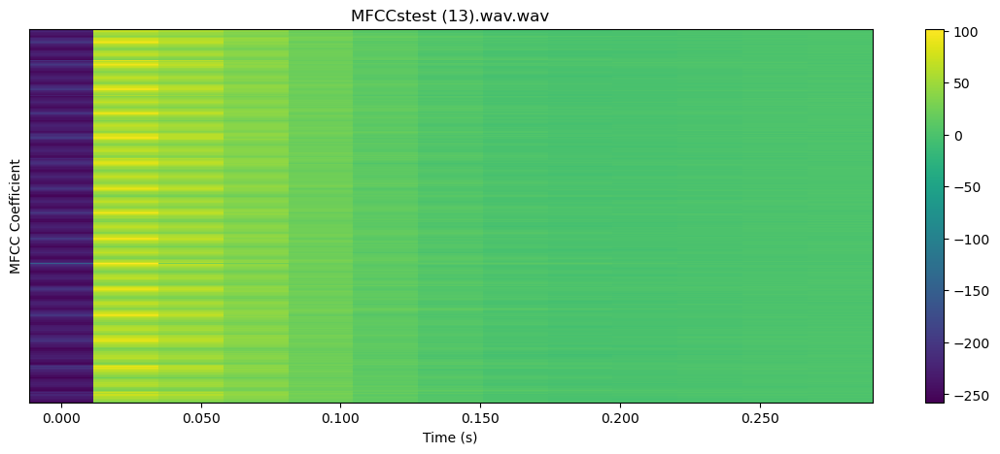


 26%|██▋       | 5/19 [00:07<00:23,  1.65s/it]

22050


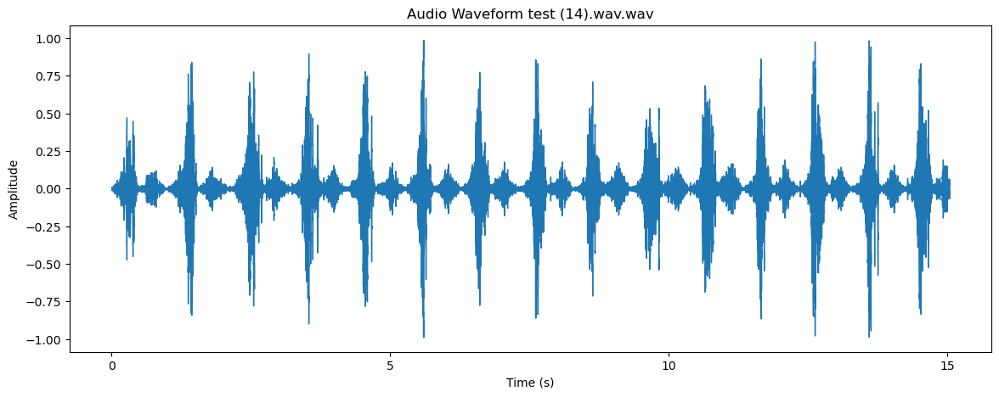

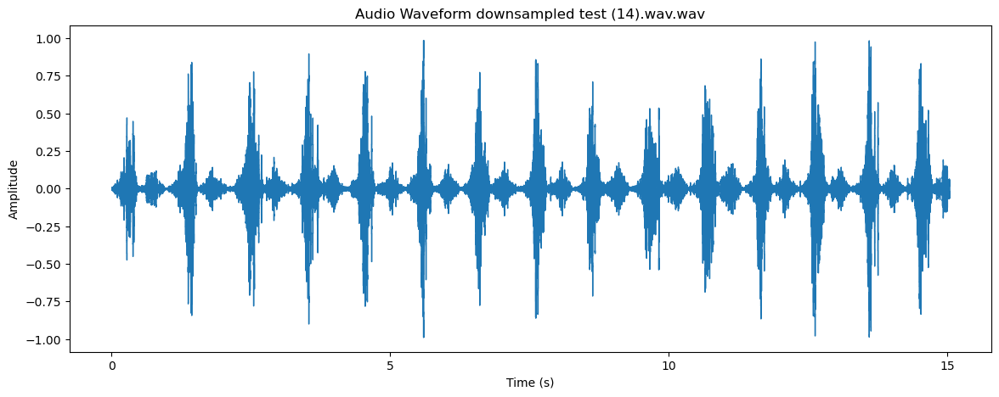

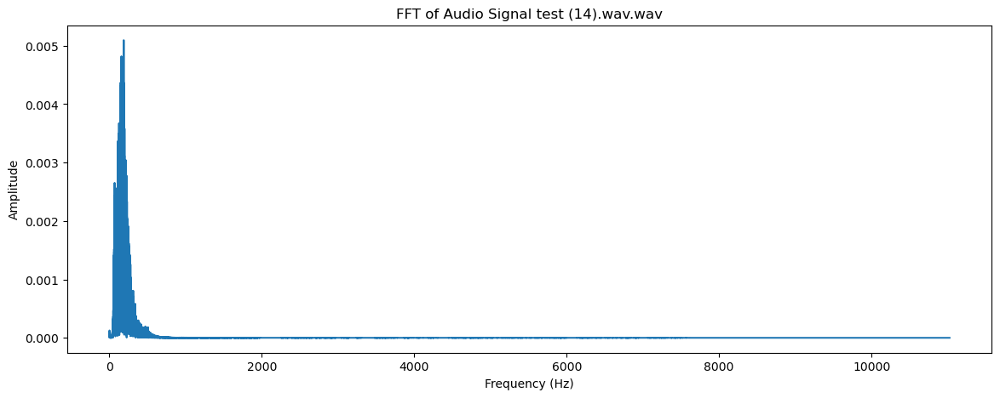

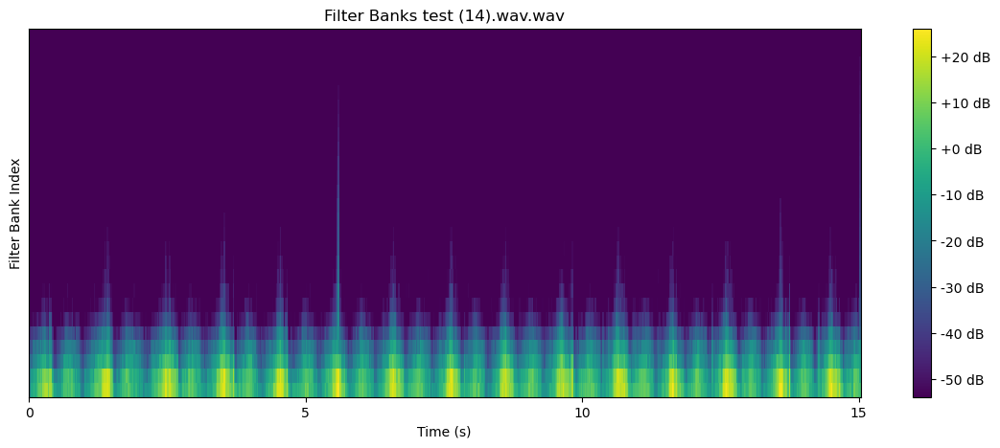

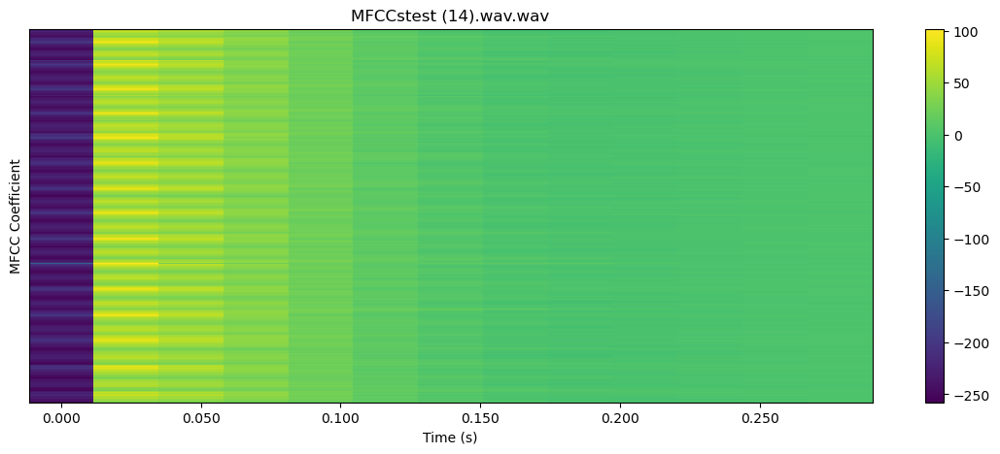


 32%|███▏      | 6/19 [00:09<00:23,  1.78s/it]

22050


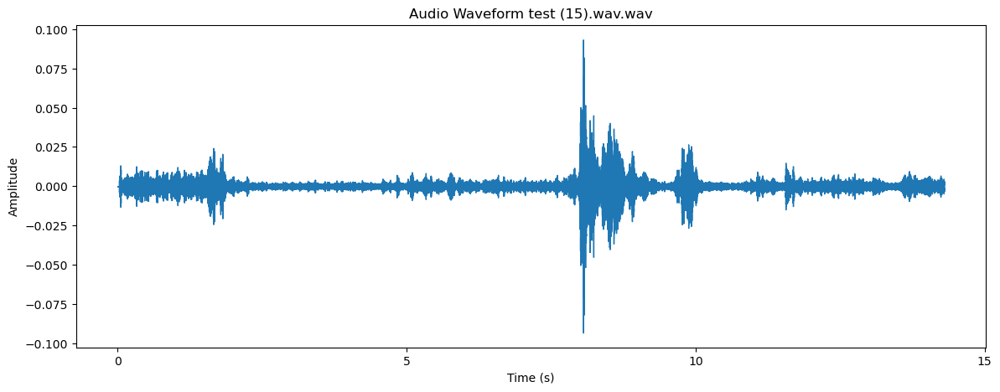

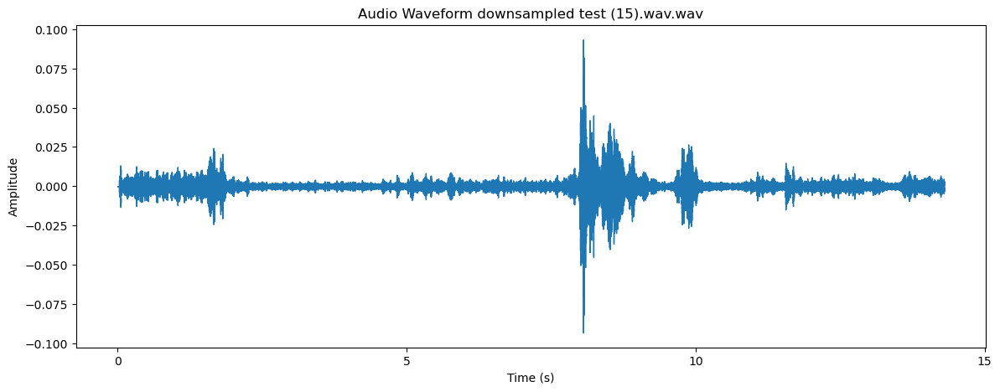

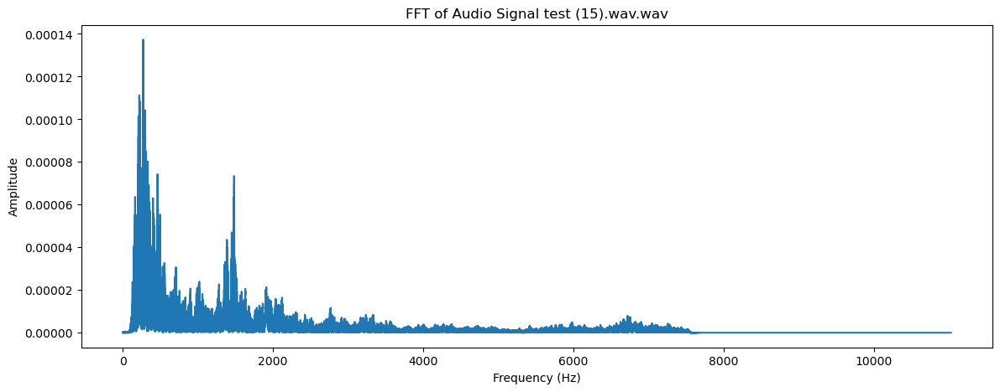

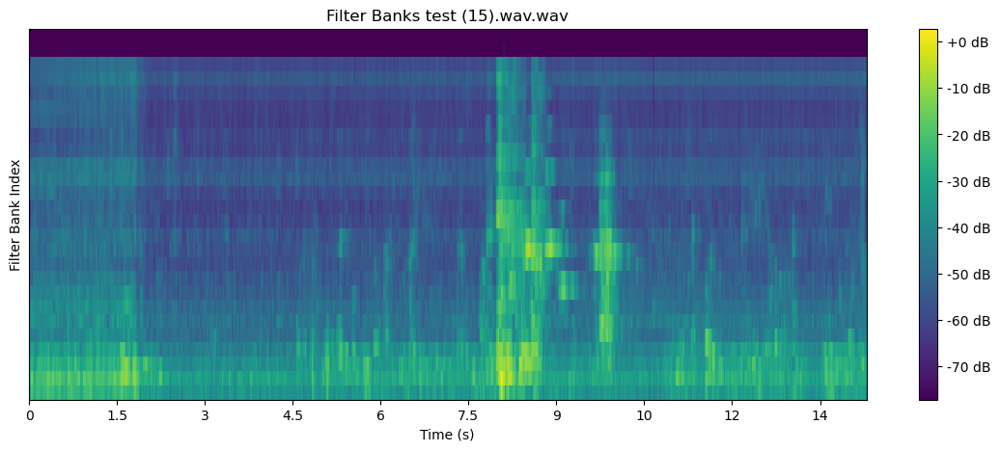

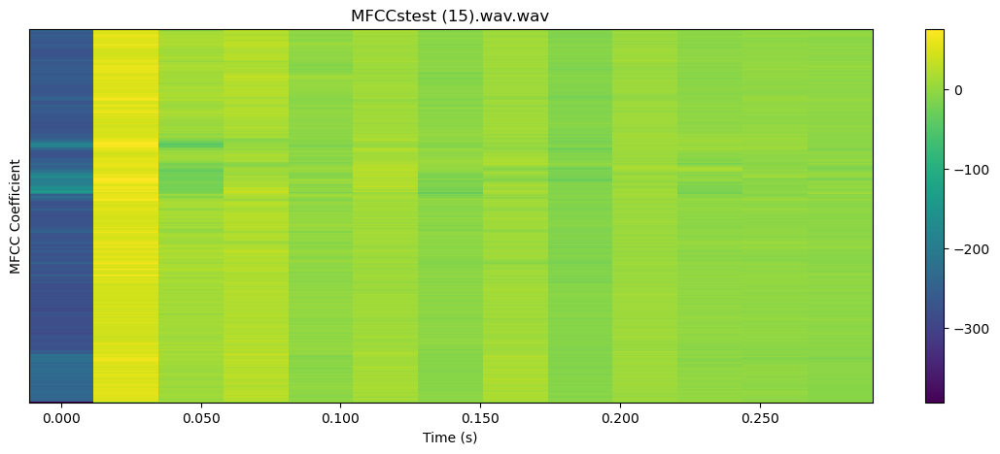


 37%|███▋      | 7/19 [00:11<00:21,  1.75s/it]

22050


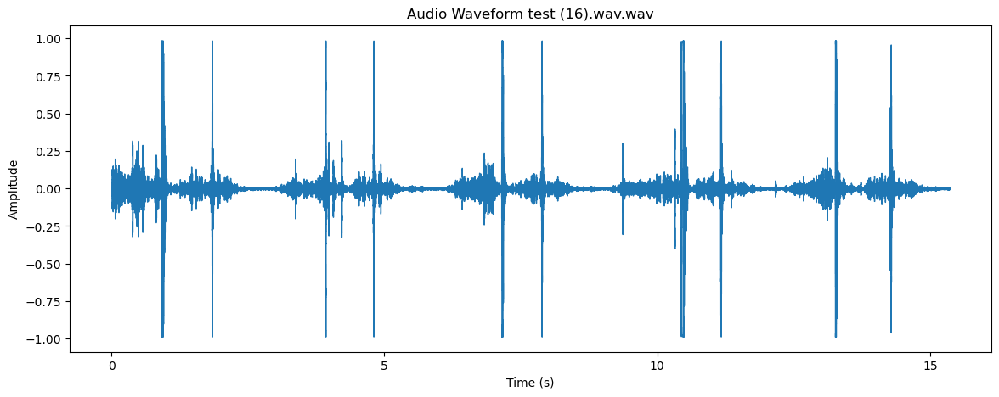

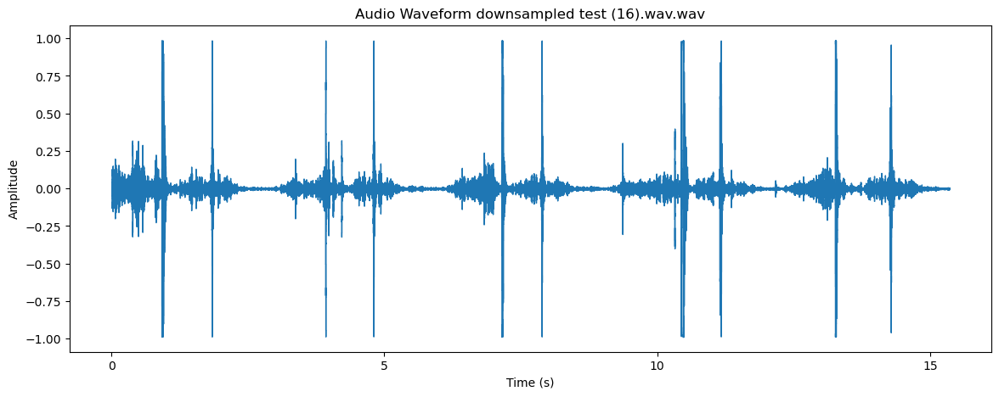

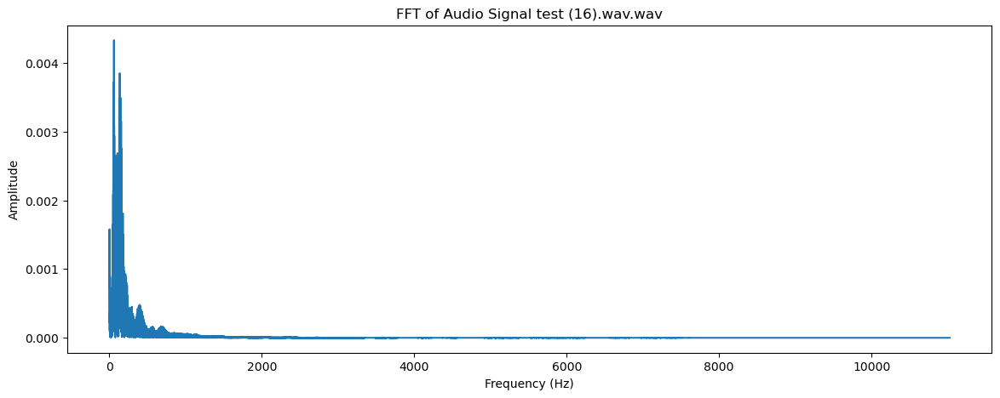

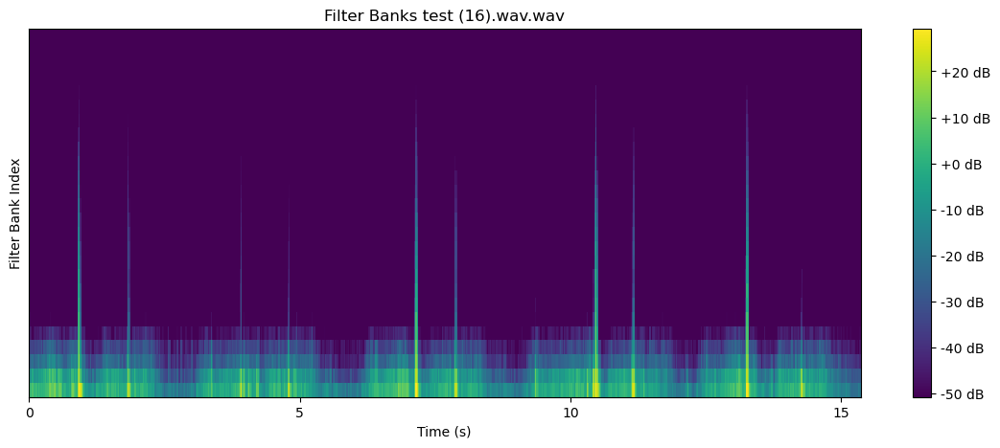

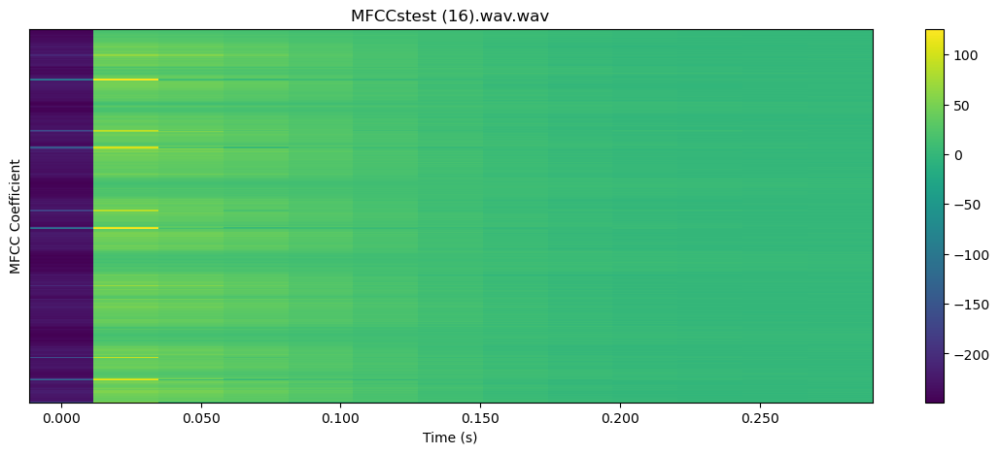


 42%|████▏     | 8/19 [00:12<00:18,  1.72s/it]

22050


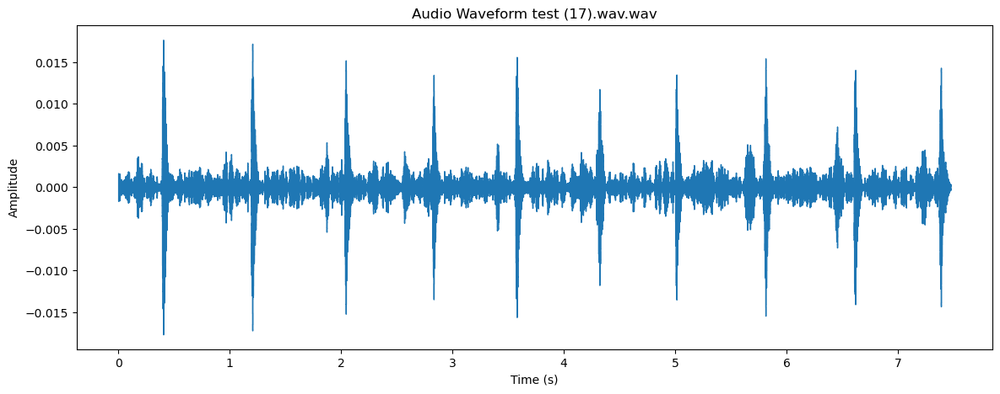

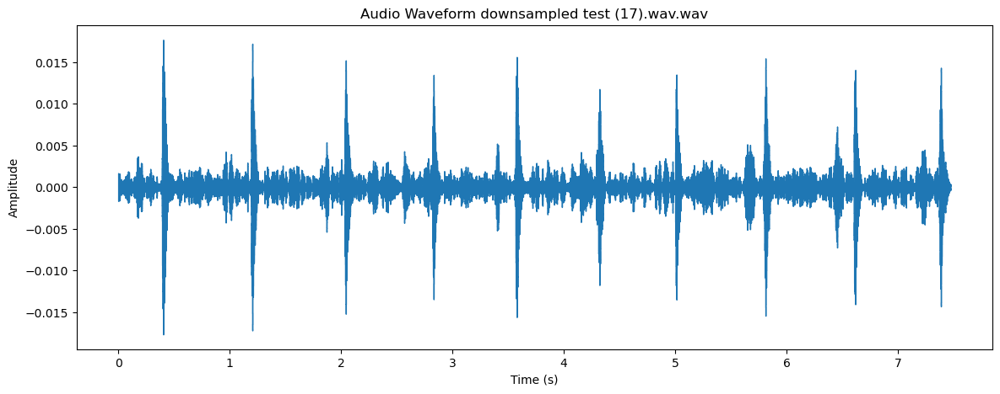

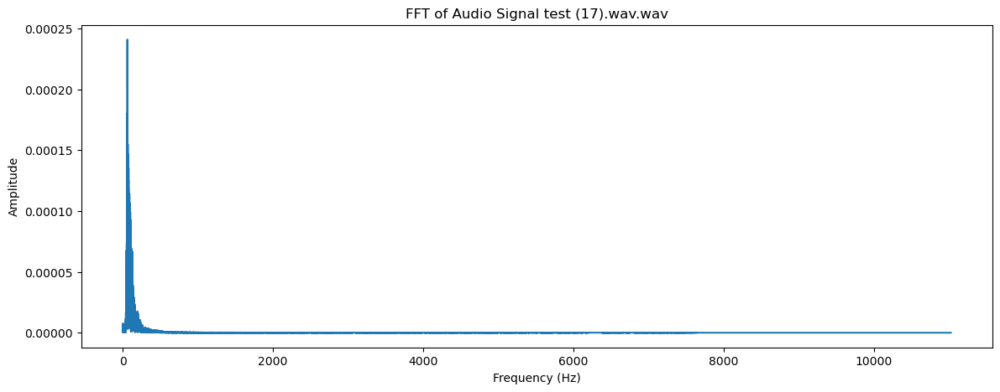

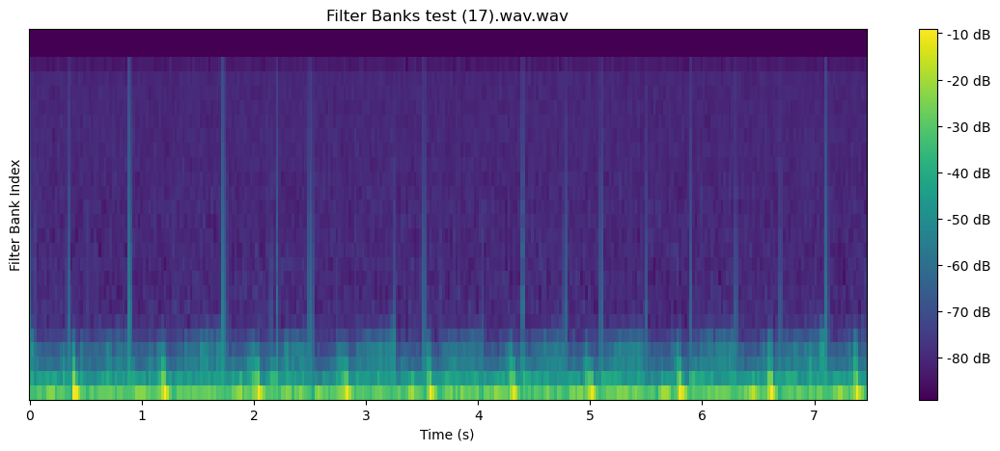

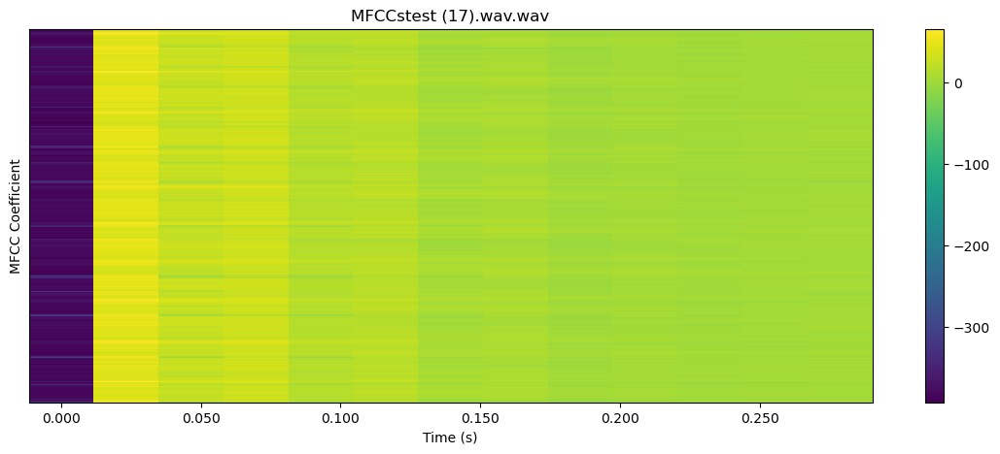


 47%|████▋     | 9/19 [00:14<00:16,  1.66s/it]

22050


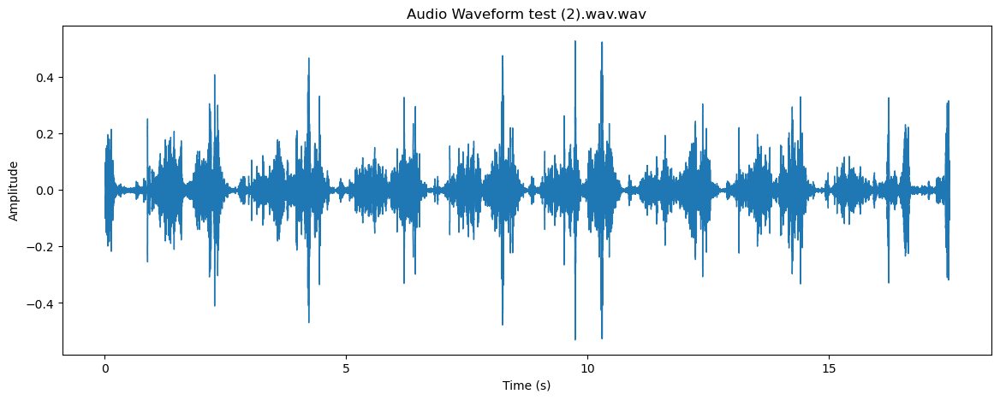

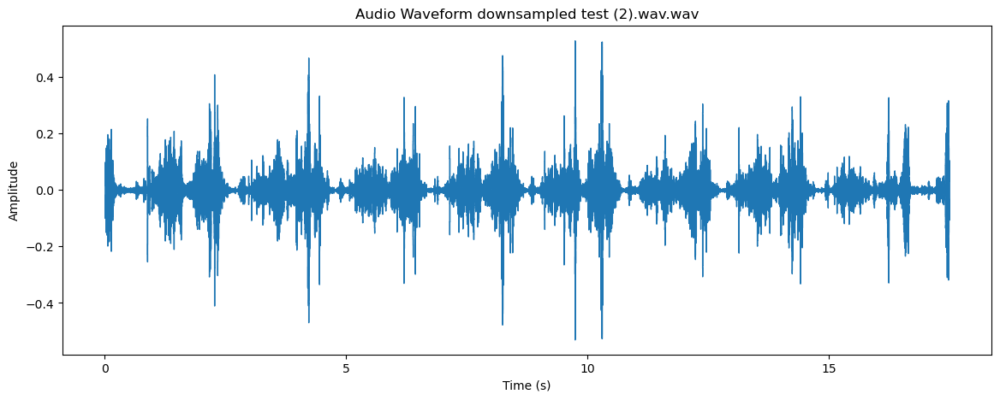

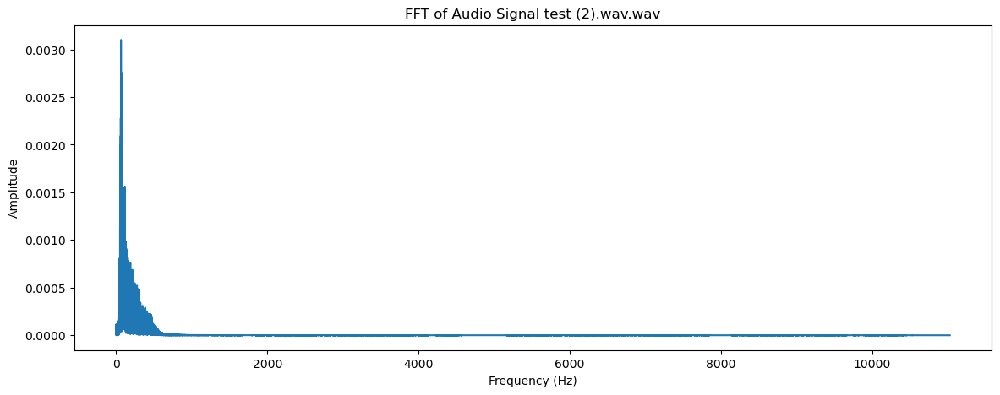

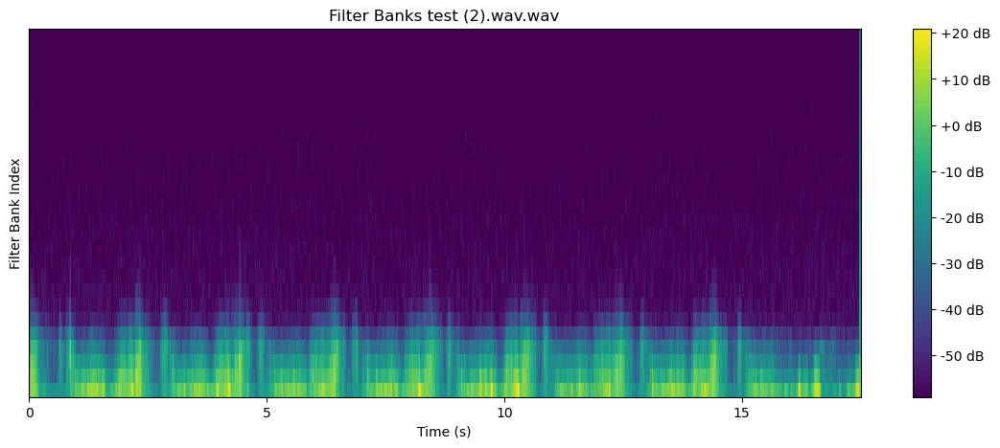

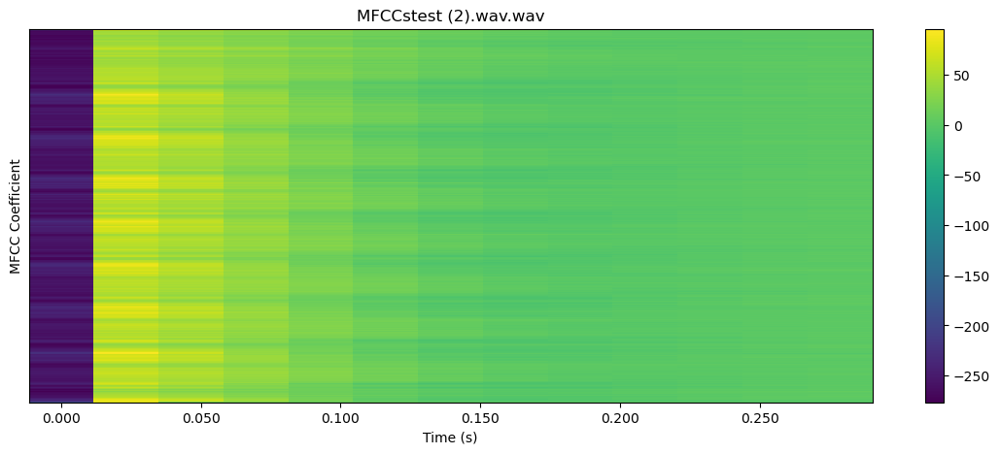


 53%|█████▎    | 10/19 [00:16<00:16,  1.86s/it]

22050


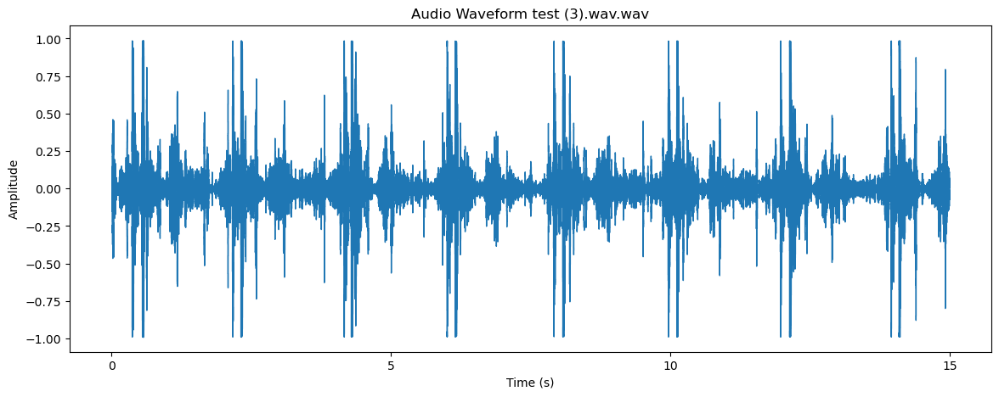

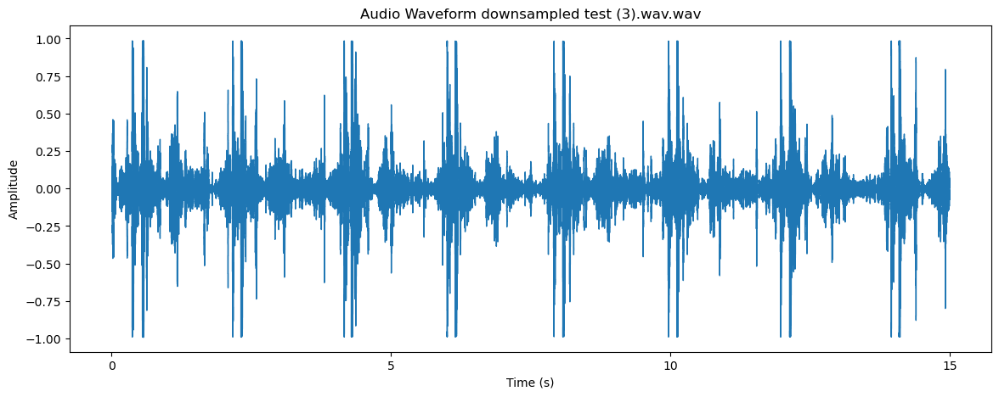

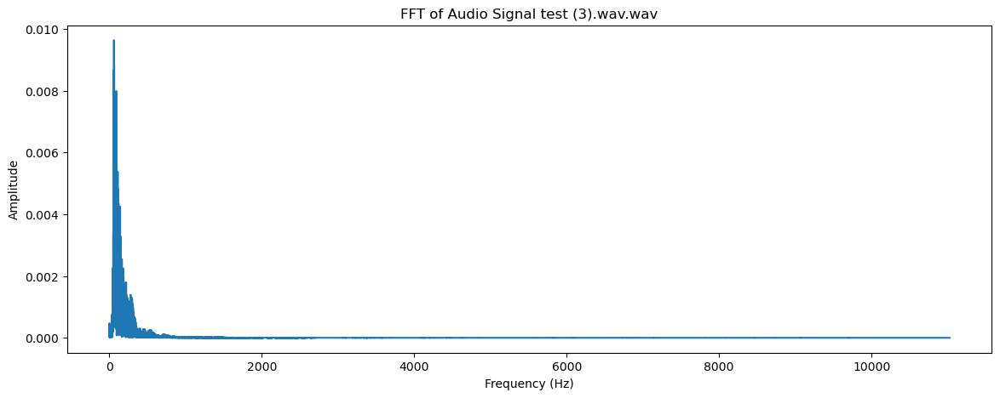

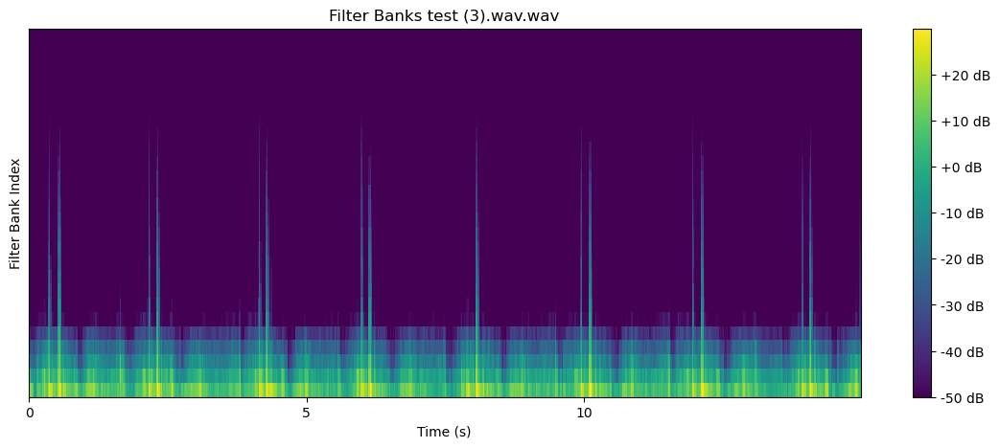

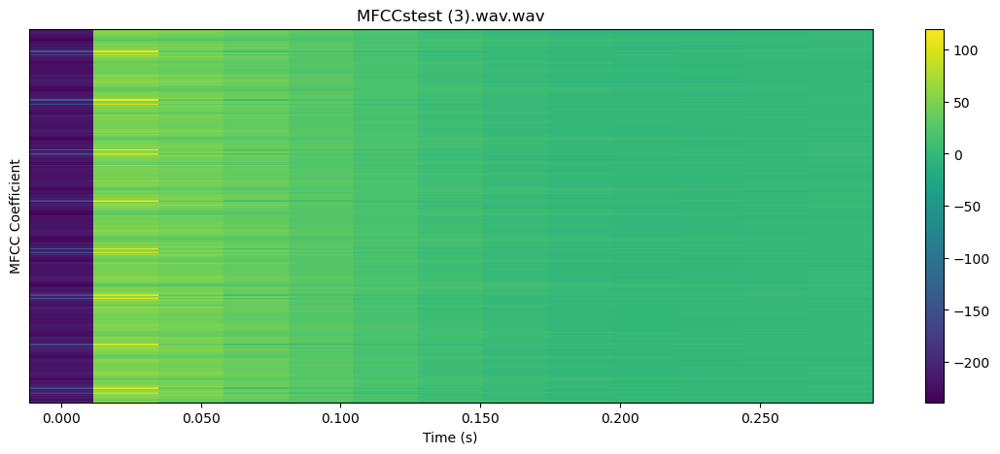


 58%|█████▊    | 11/19 [00:19<00:18,  2.30s/it]

22050


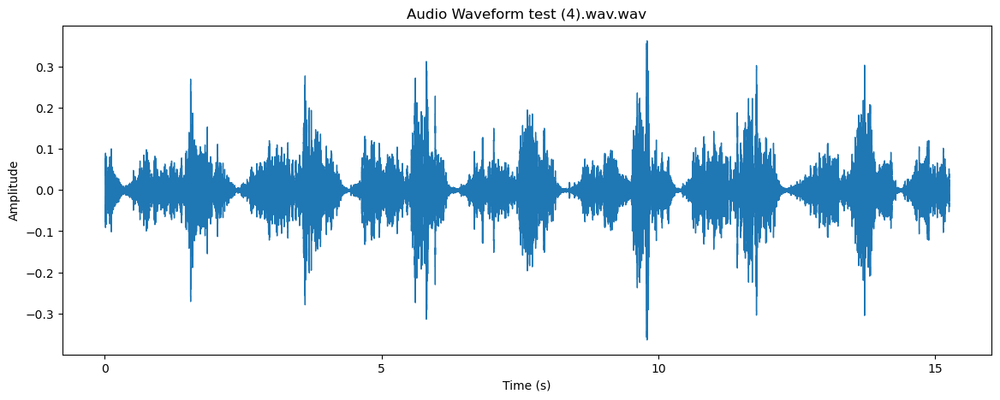

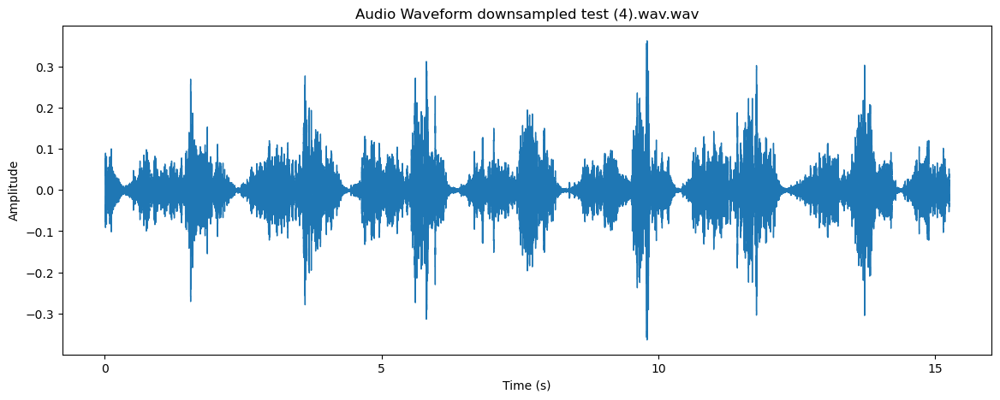

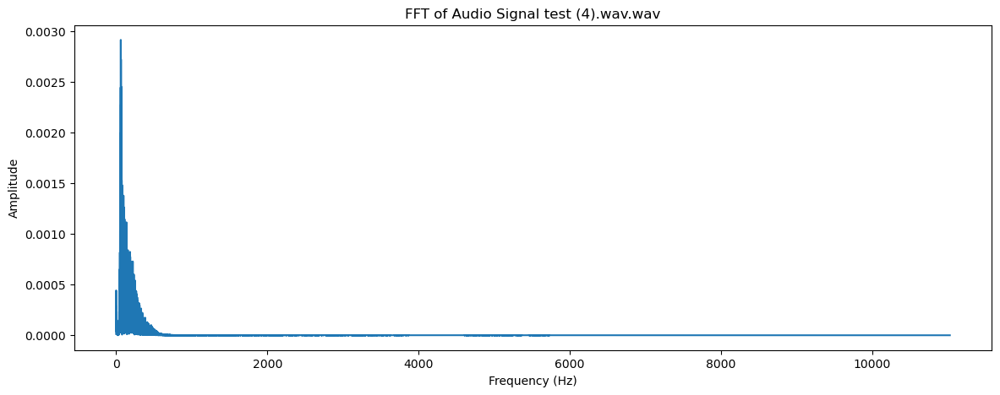

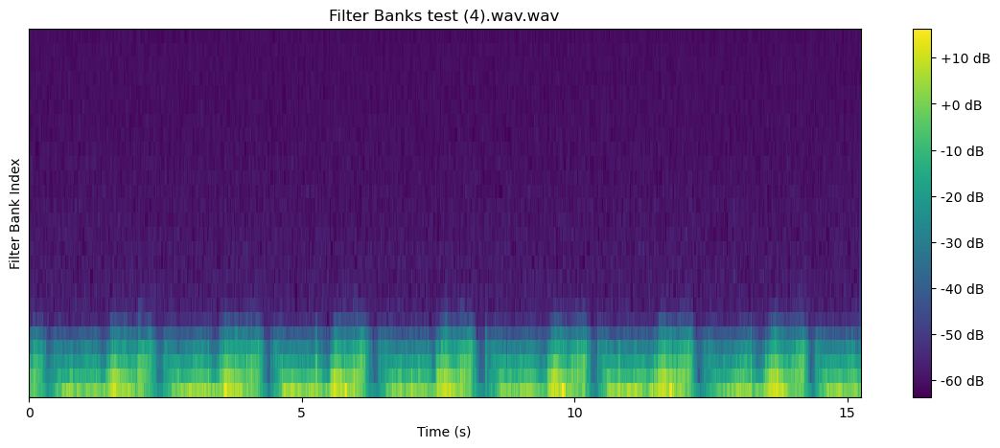

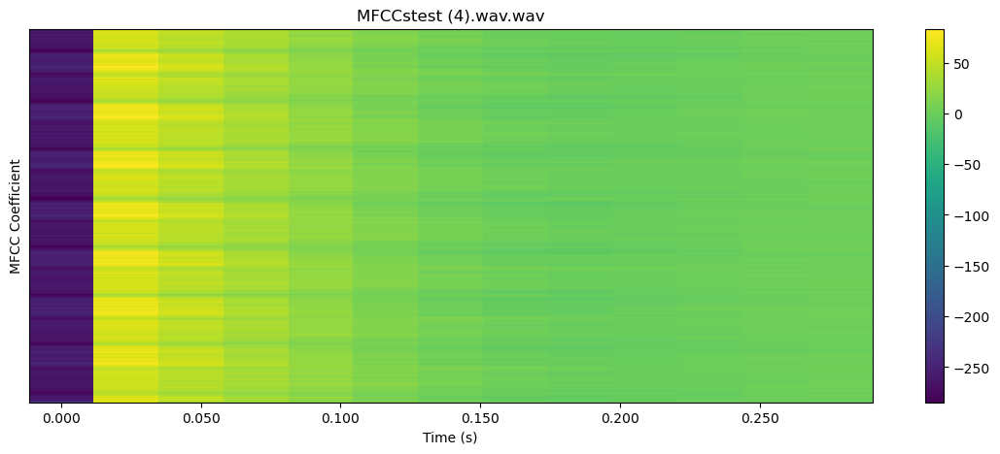


 63%|██████▎   | 12/19 [00:22<00:16,  2.39s/it]

22050


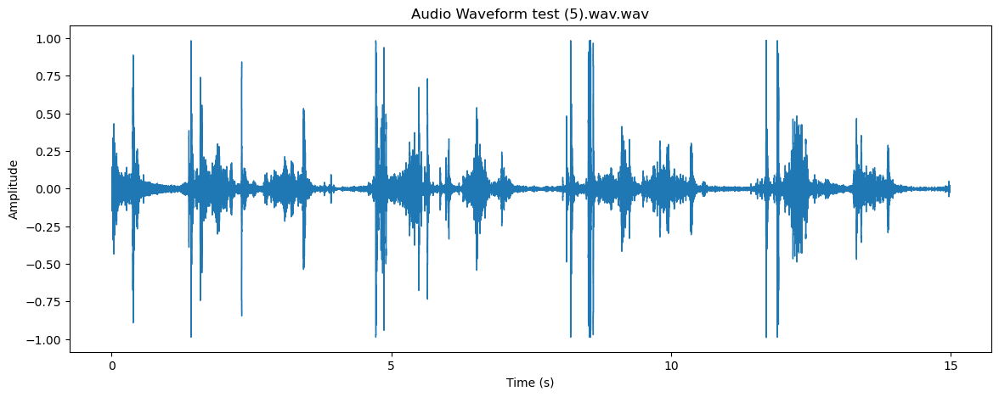

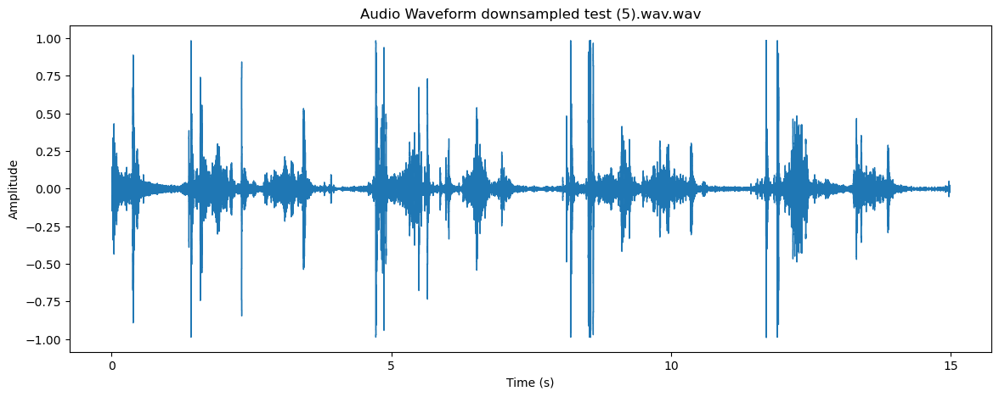

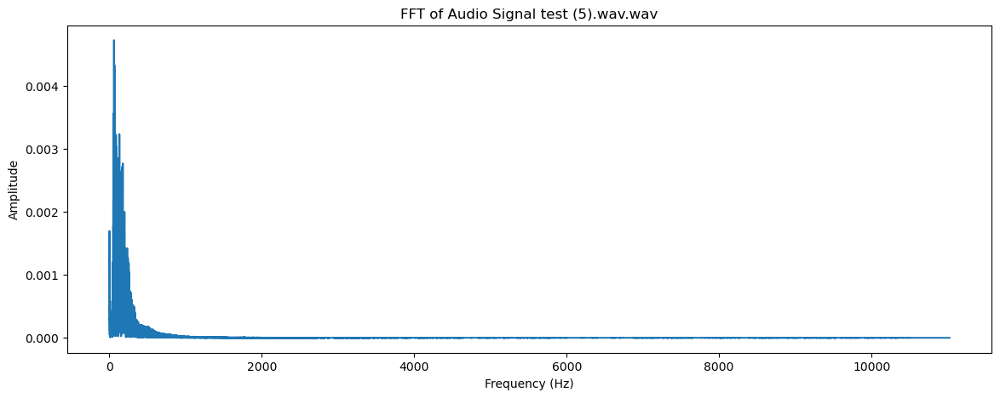

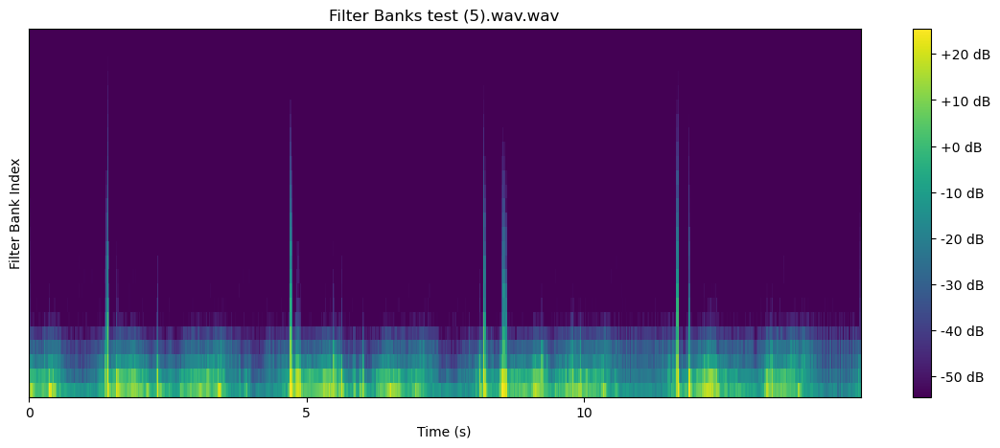

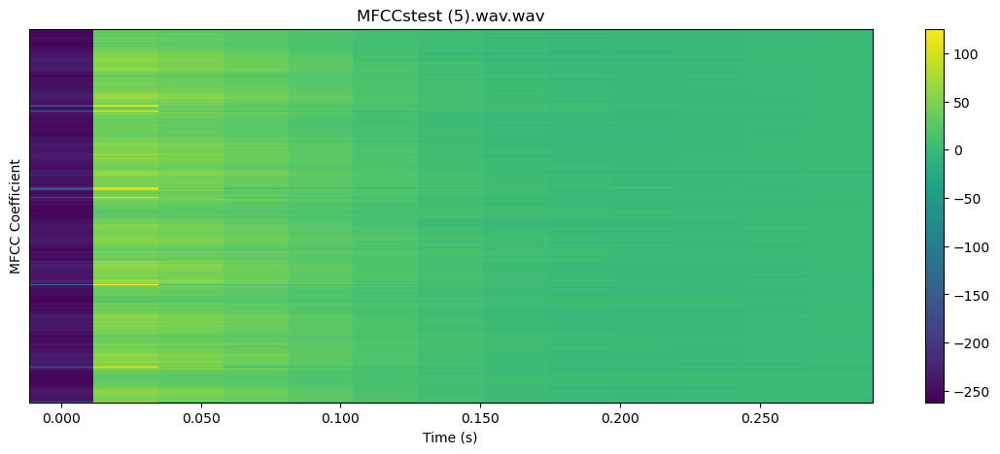


 68%|██████▊   | 13/19 [00:24<00:13,  2.27s/it]

22050


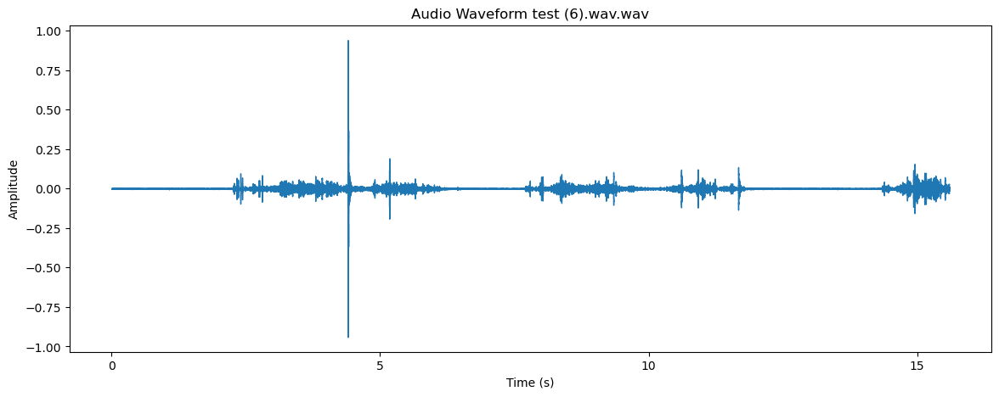

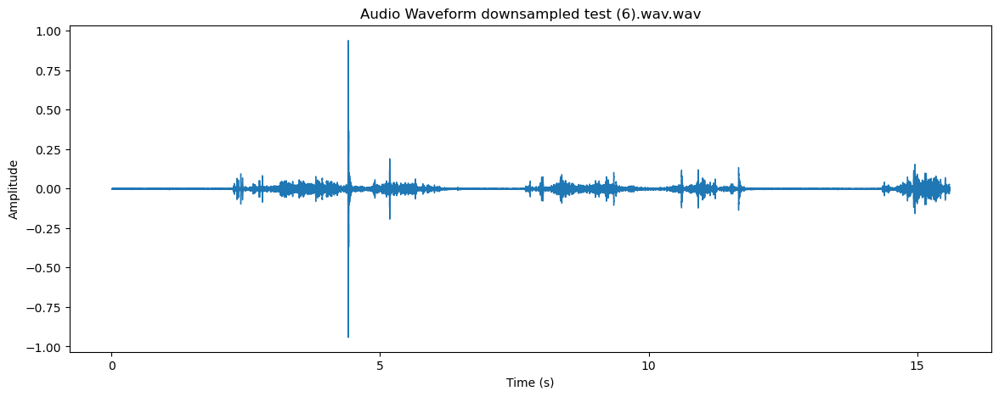

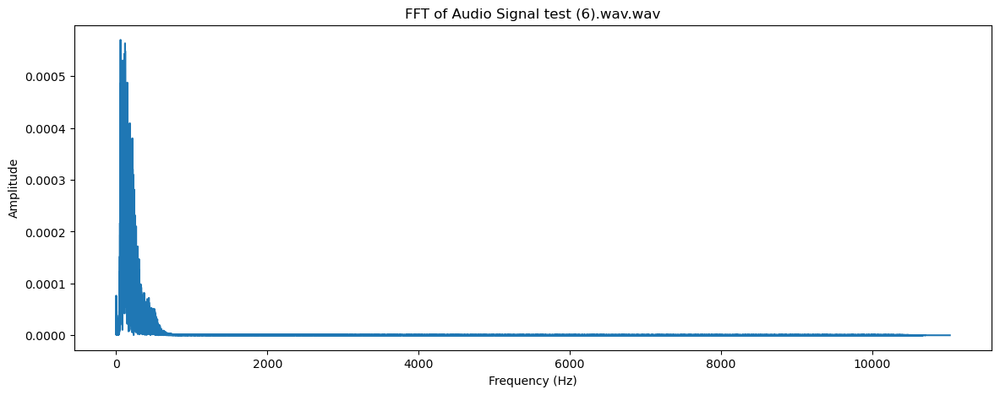

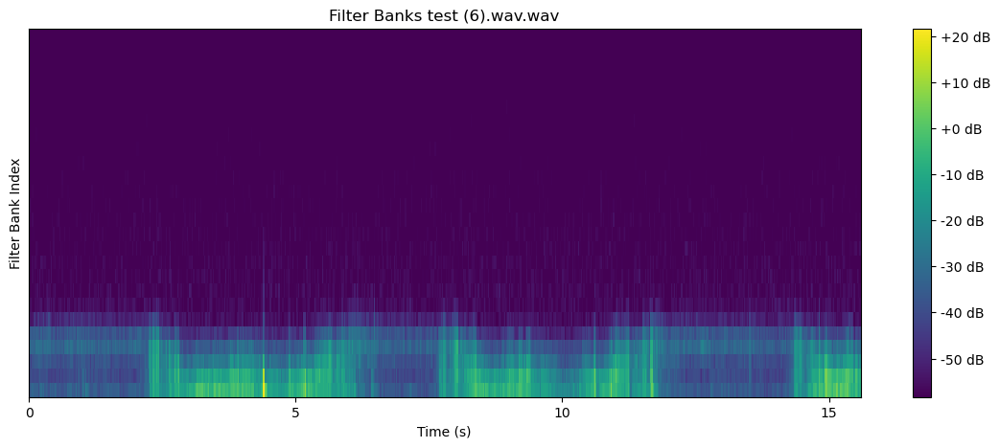

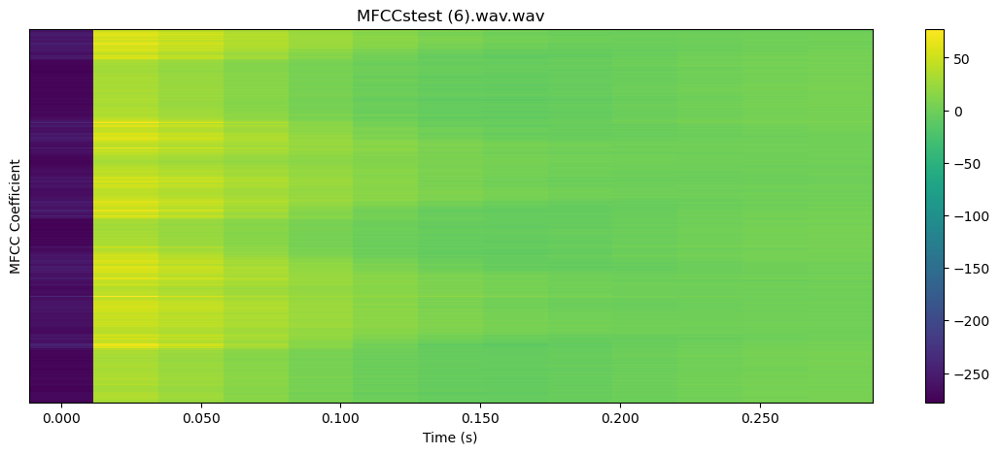


 74%|███████▎  | 14/19 [00:25<00:10,  2.01s/it]

22050


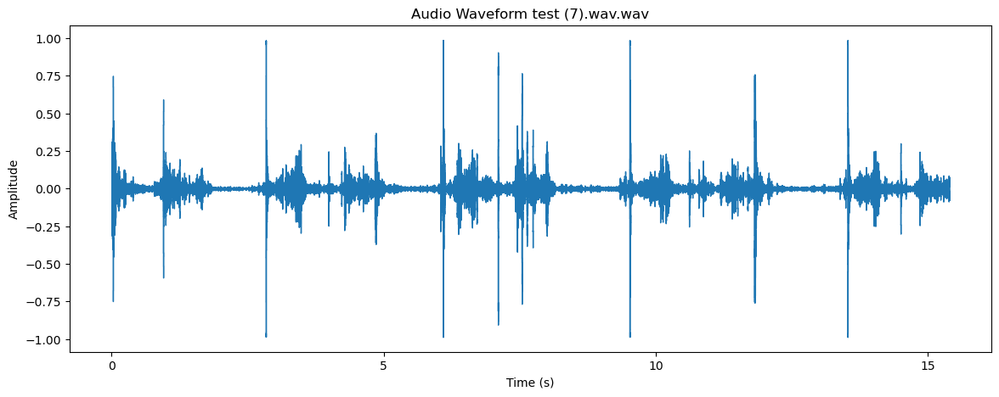

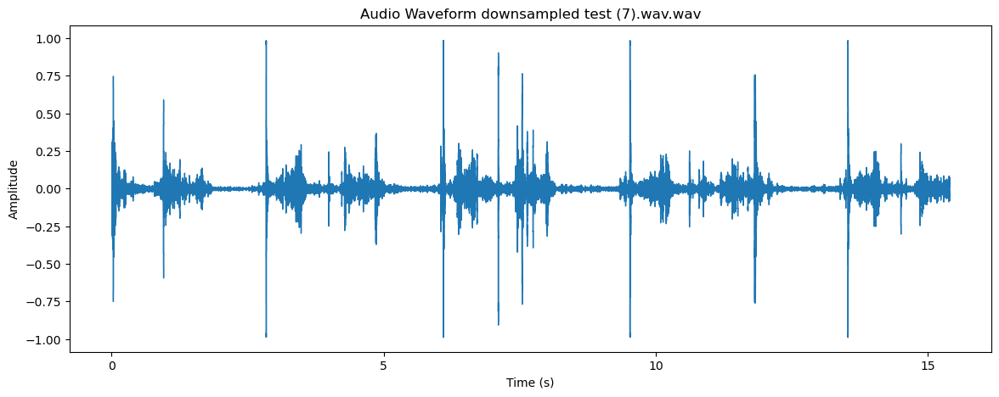

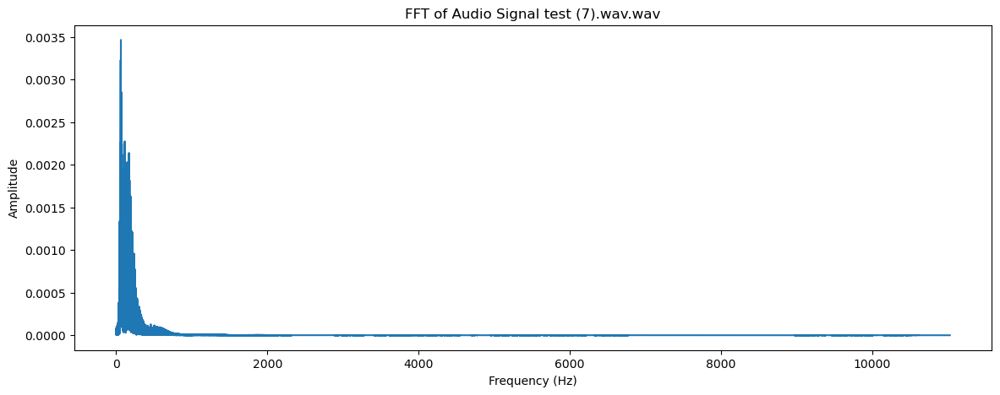

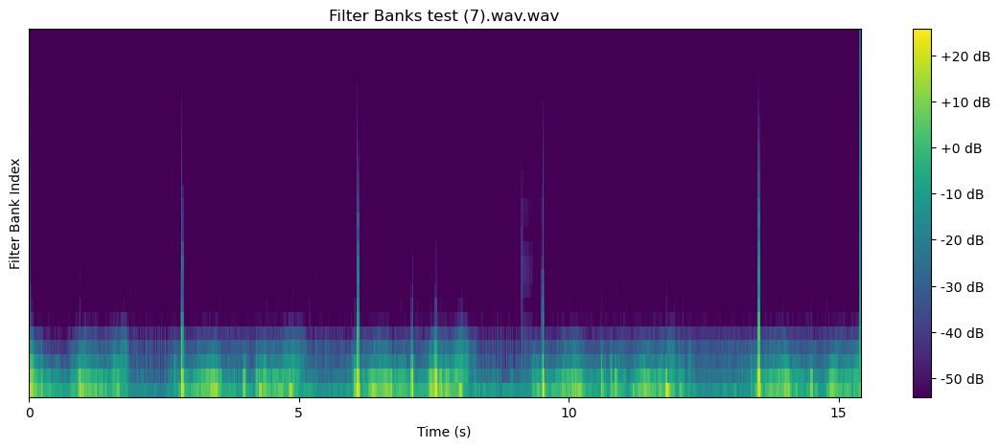

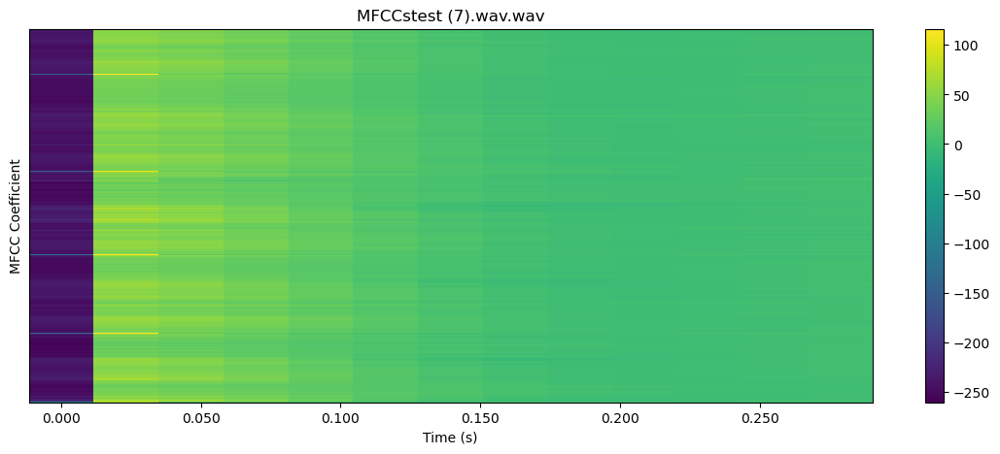


 79%|███████▉  | 15/19 [00:27<00:07,  1.85s/it]

22050


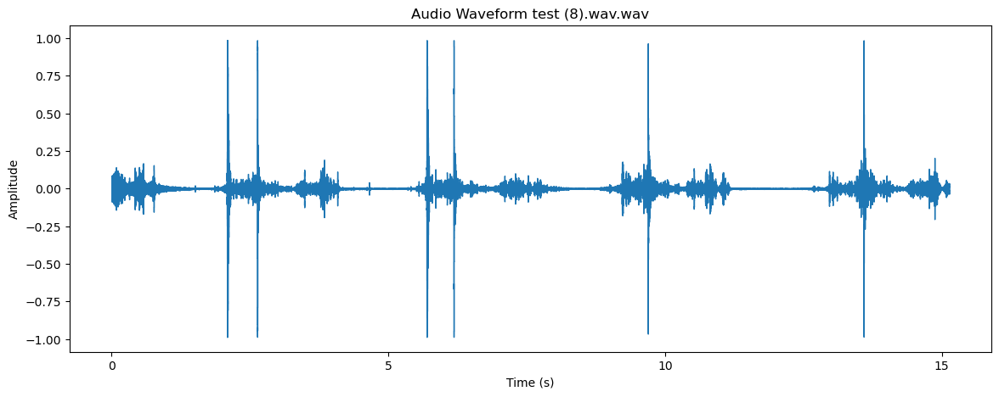

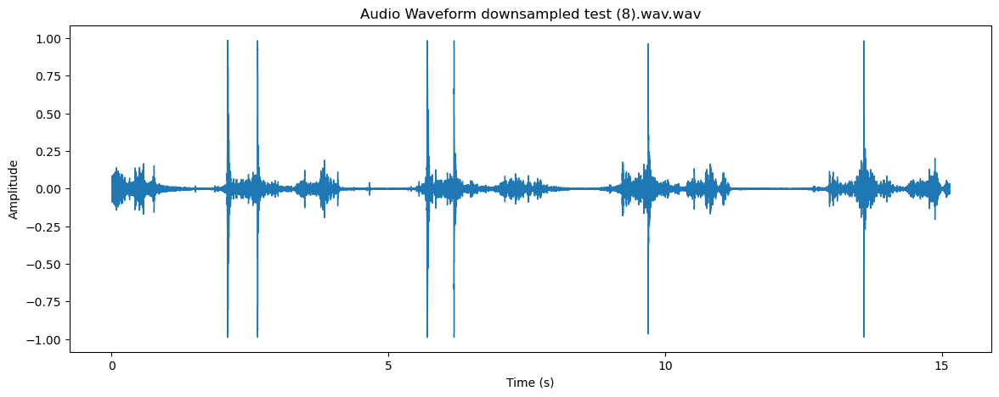

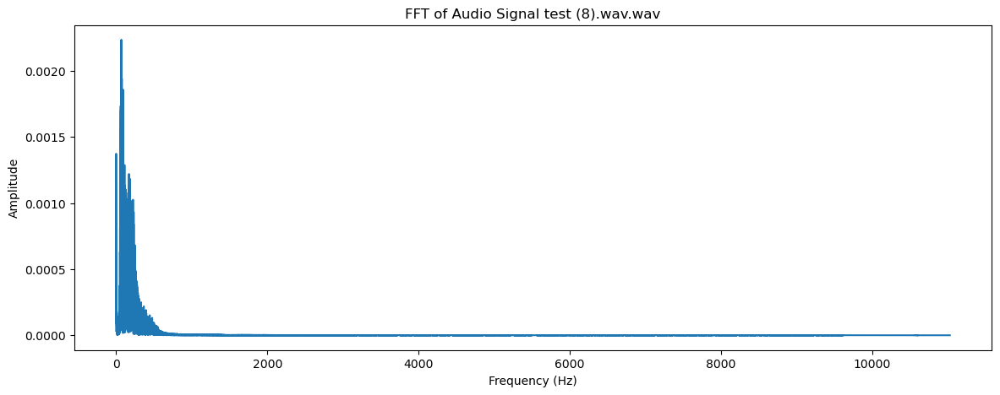

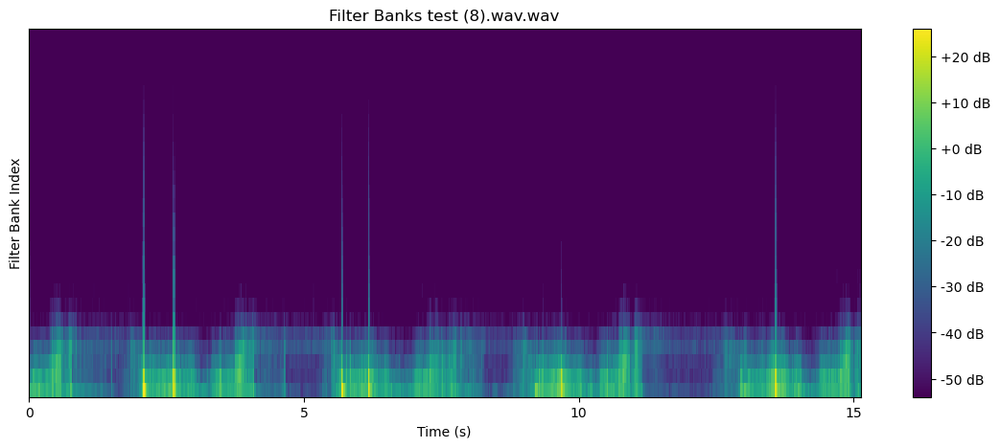

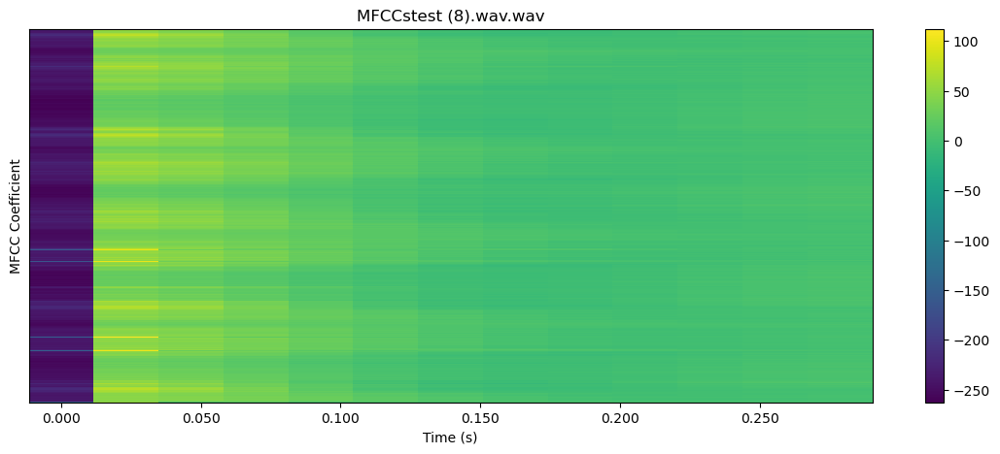


 84%|████████▍ | 16/19 [00:28<00:05,  1.73s/it]

22050


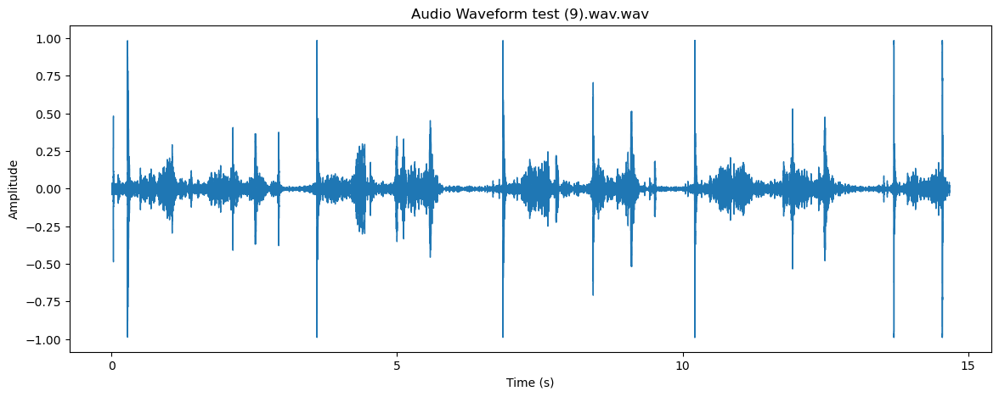

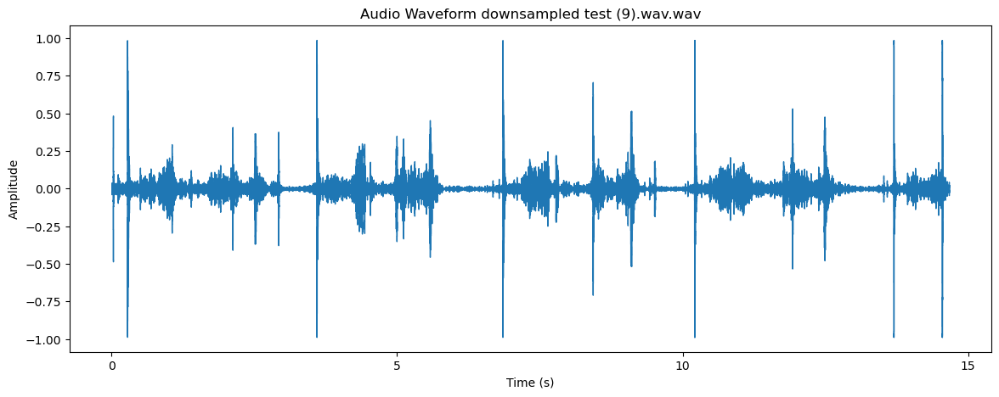

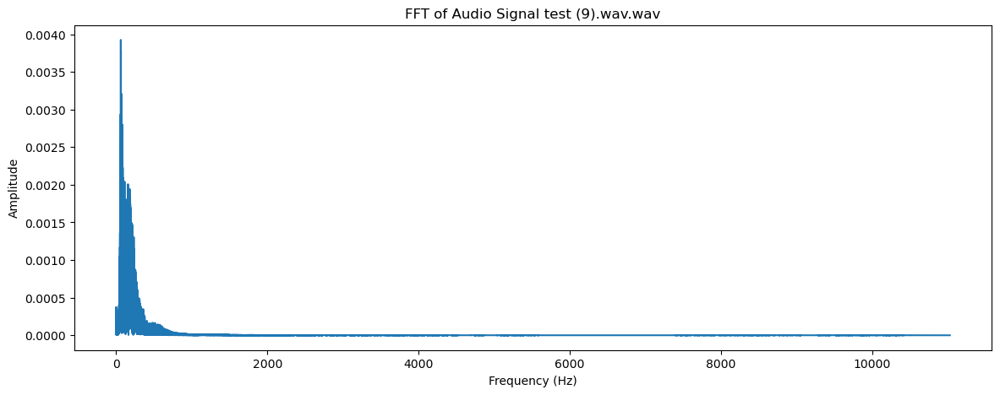

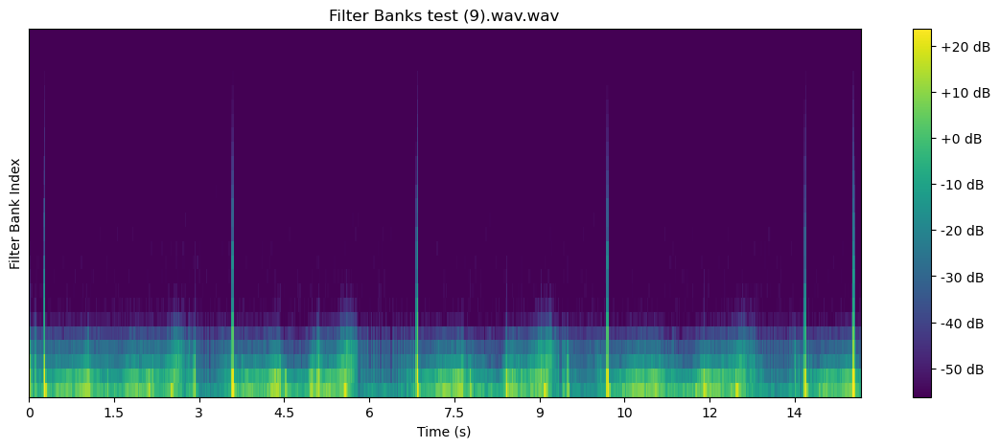

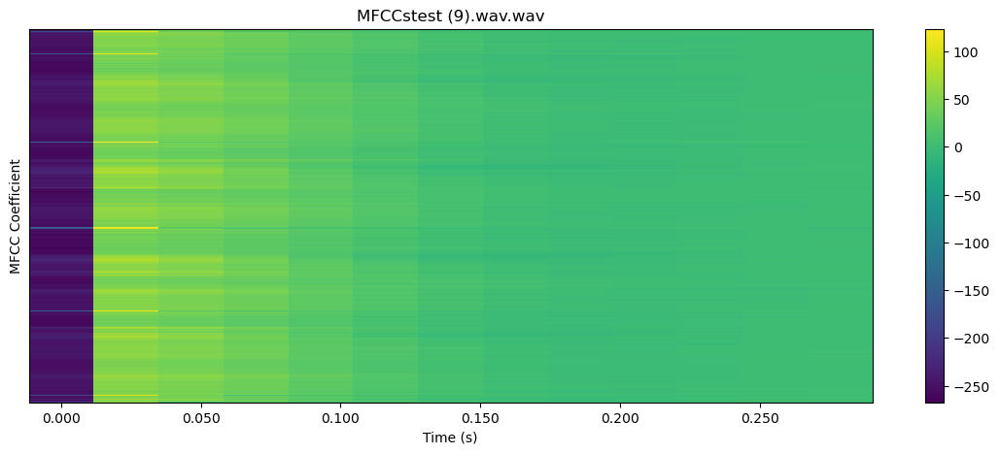


 89%|████████▉ | 17/19 [00:30<00:03,  1.66s/it]

22050


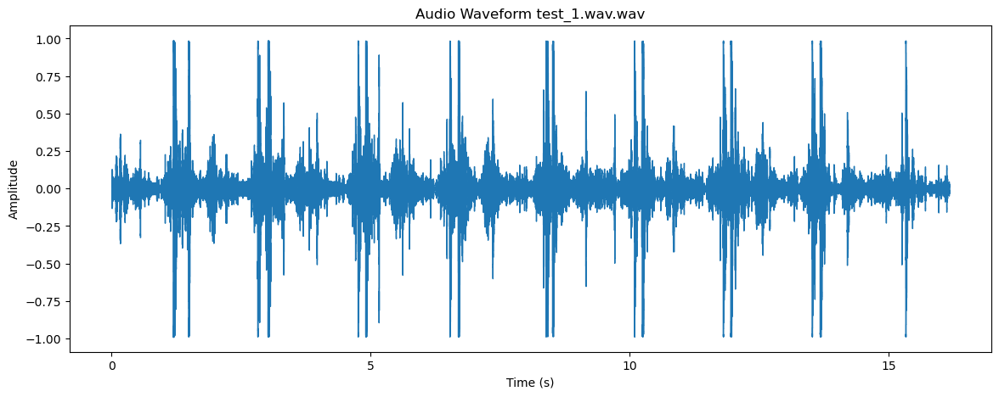

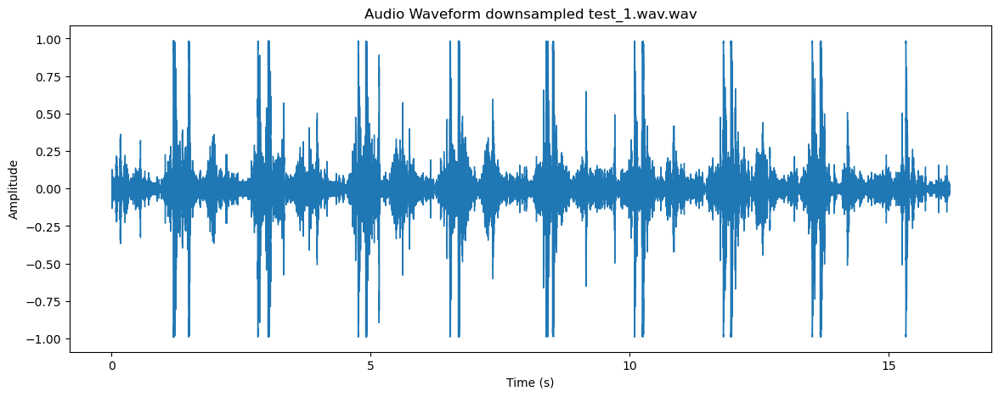

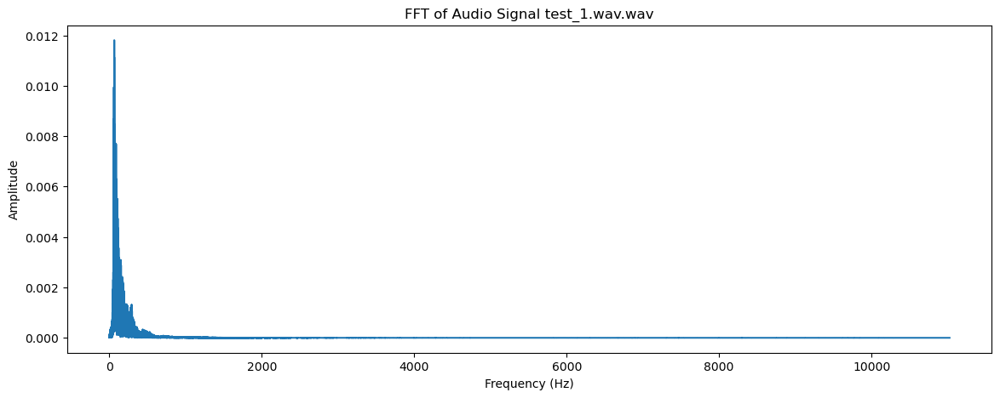

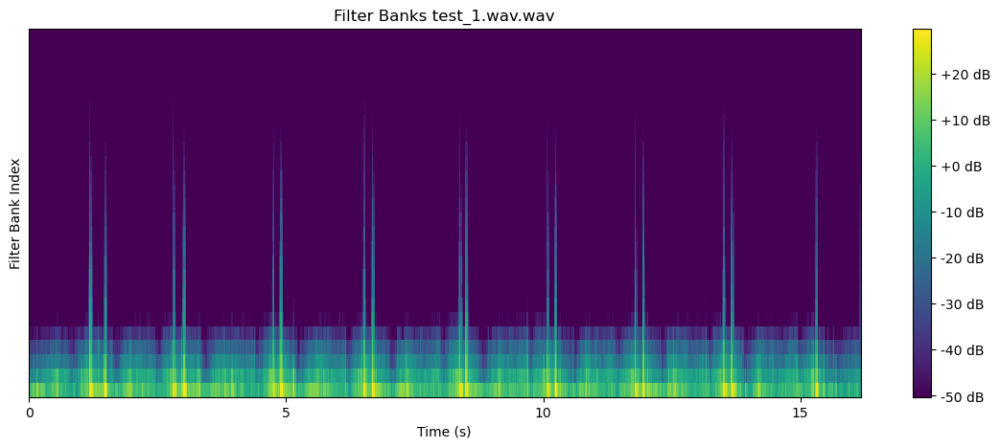

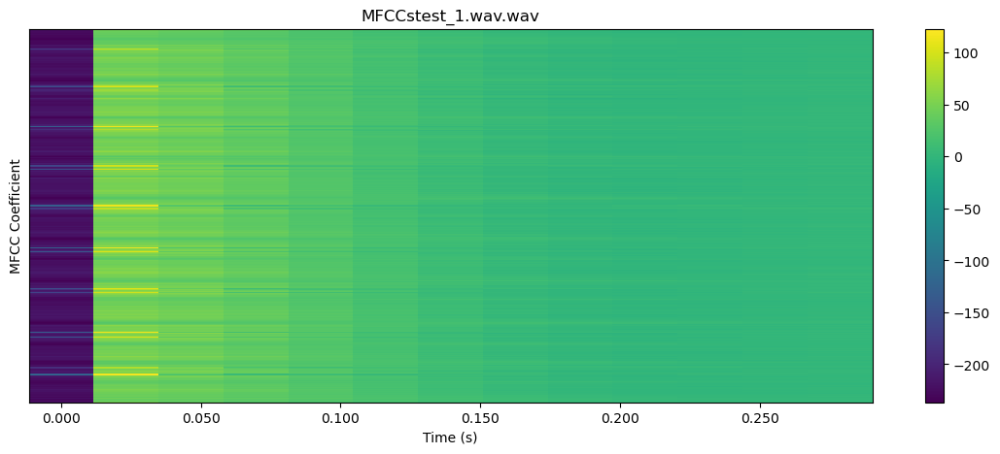


 95%|█████████▍| 18/19 [00:31<00:01,  1.66s/it]

22050


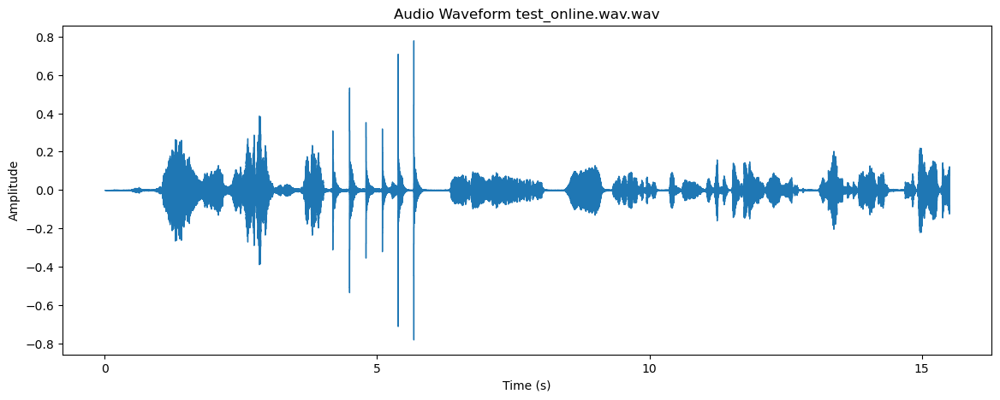

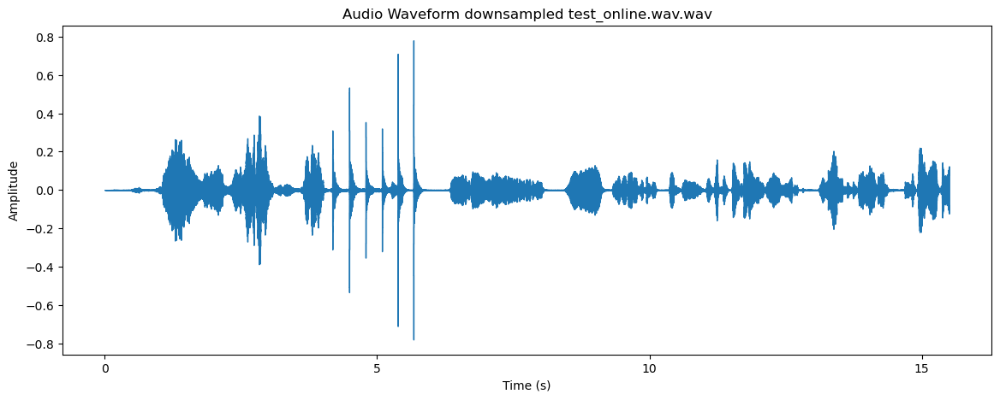

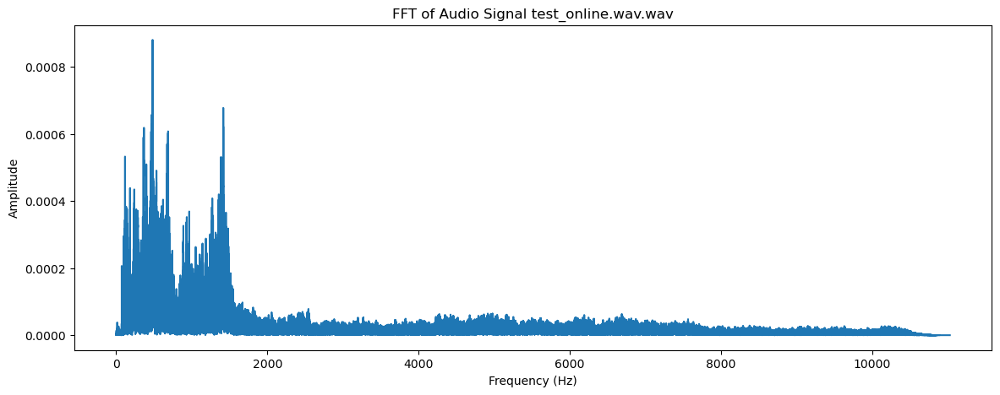

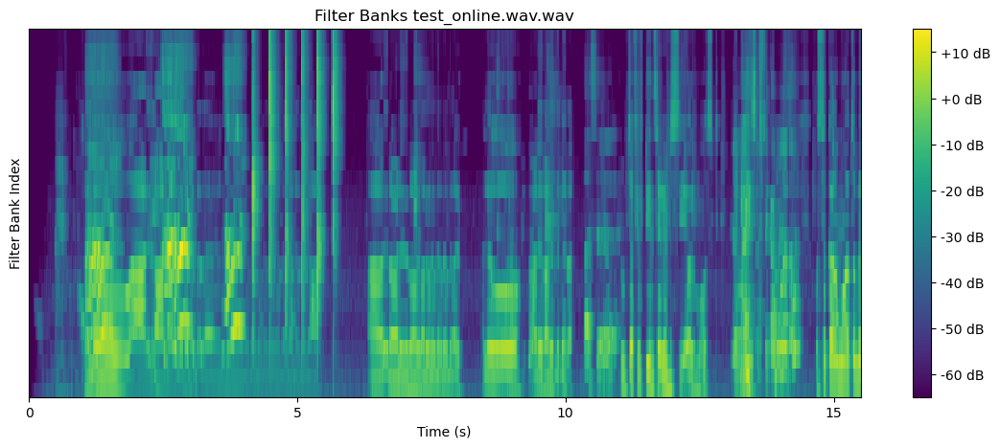

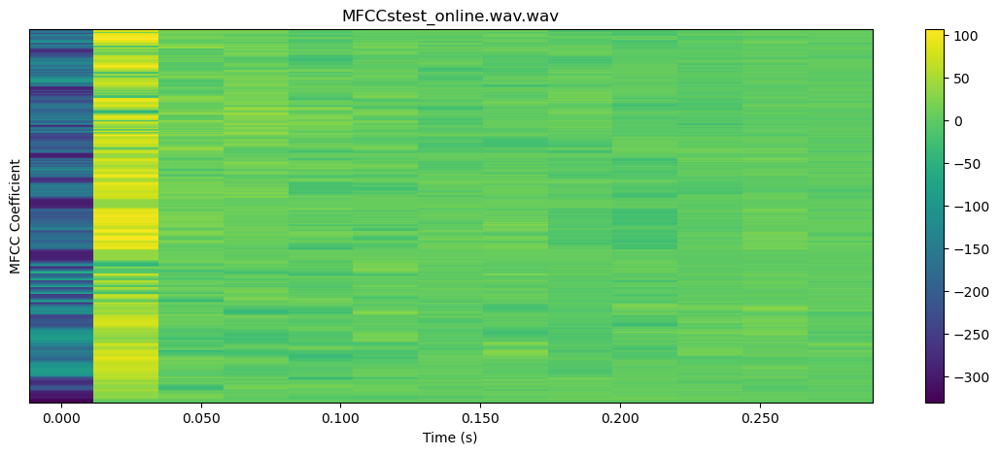

100%|██████████| 19/19 [00:33<00:00,  1.79s/it]


In [25]:
#plot all the files in wavfile
directory_path = 'test'

for file in tqdm(os.listdir(directory_path)):
    audio, sr = librosa.load('test/'+file, sr=22050)
    target_sr=22050
    librosa.resample(audio, orig_sr=sr, target_sr=target_sr)
    print(sr)

    def calc_fft(y , rate):
        n = len(y)

        freq = np.fft.rfftfreq( n , d = 1/rate )## calculates the frequencies corresponding to each bin in a Real-valued Fast Fourier Transform (RFFT).
        Y = abs(np.fft.rfft(y)/n)  ##magnitude (of a complex number) , /n is done to scale/normalise the length
        return (Y , freq)
    Y , freq = calc_fft(audio , sr)

    # Calculate filter banks
    filter_banks = librosa.feature.melspectrogram(y=audio, sr=sr, n_fft=1200, hop_length=512, n_mels=26)

    # Convert filter banks to log scale
    log_filter_banks = librosa.power_to_db(filter_banks)

    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_fft=1200, hop_length=512, n_mfcc=13, n_mels=26)

    # Transpose for better visualization
    mfccs = mfccs.T
    plt.figure(figsize=(14, 5))
    librosa.display.waveshow(audio, sr=sr)
    plt.title('Audio Waveform '+file+'.wav')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.show()
    plt.figure(figsize=(14, 5))
    librosa.display.waveshow(audio, sr=sr)
    plt.title('Audio Waveform downsampled '+file+'.wav')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.show()

    plt.figure(figsize=(14, 5))
    plt.plot(freq, Y)
    plt.title('FFT of Audio Signal '+file+'.wav')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Amplitude')
    plt.show()


    plt.figure(figsize=(14, 5))
    librosa.display.specshow(log_filter_banks, sr=sr, hop_length=512, x_axis='time', cmap='viridis')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Filter Banks '+file+'.wav')
    plt.xlabel('Time (s)')
    plt.ylabel('Filter Bank Index')
    plt.show()


    # Plot MFCCs
    plt.figure(figsize=(14, 5))
    librosa.display.specshow(mfccs, sr=sr, hop_length=512, x_axis='time', cmap='viridis')
    plt.colorbar()
    plt.title('MFCCs'+file+'.wav')
    plt.xlabel('Time (s)')
    plt.ylabel('MFCC Coefficient')
    plt.show()



  0%|          | 0/141 [00:00<?, ?it/s]

22050


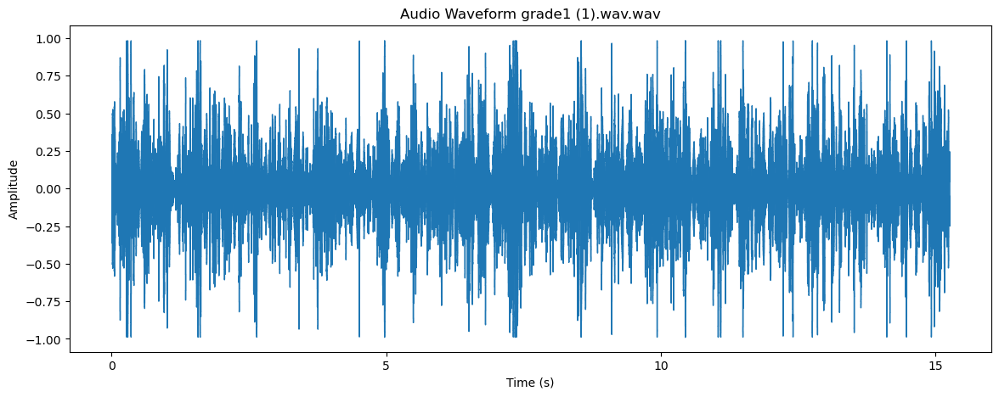

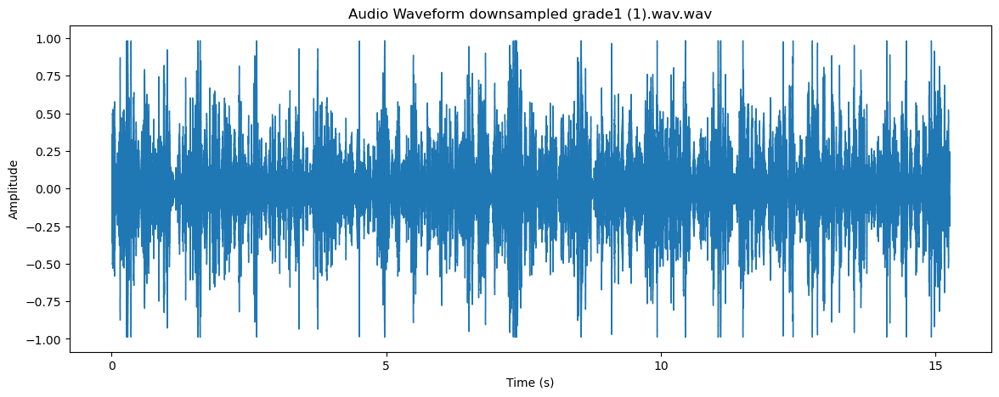

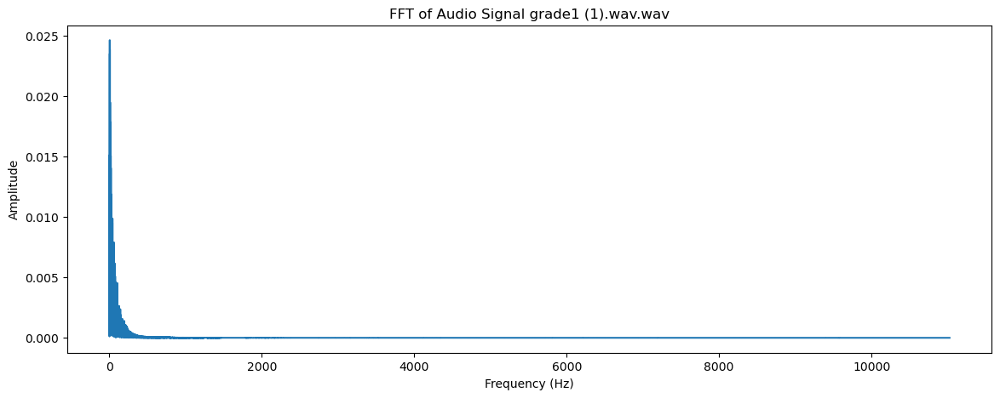

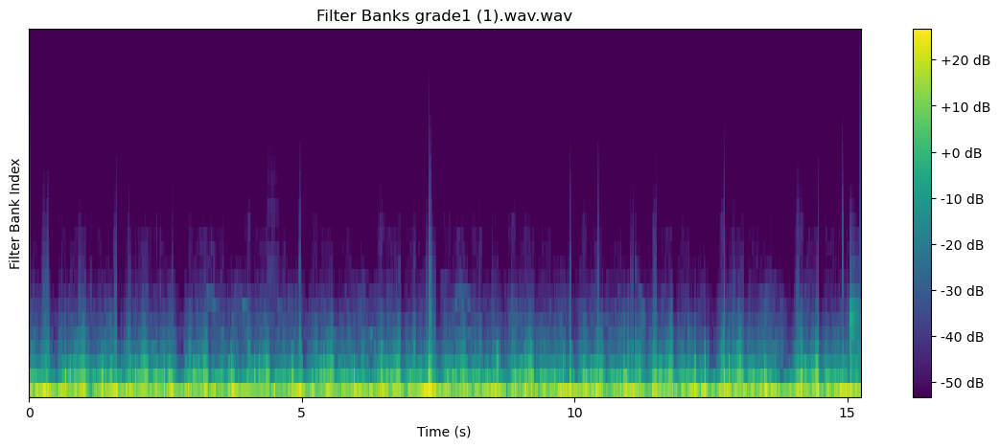

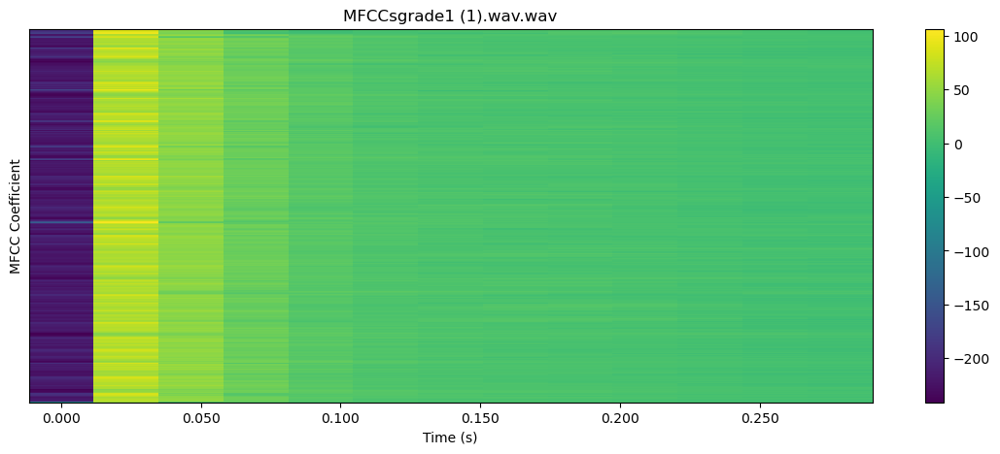


  1%|          | 1/141 [00:01<03:28,  1.49s/it]

22050


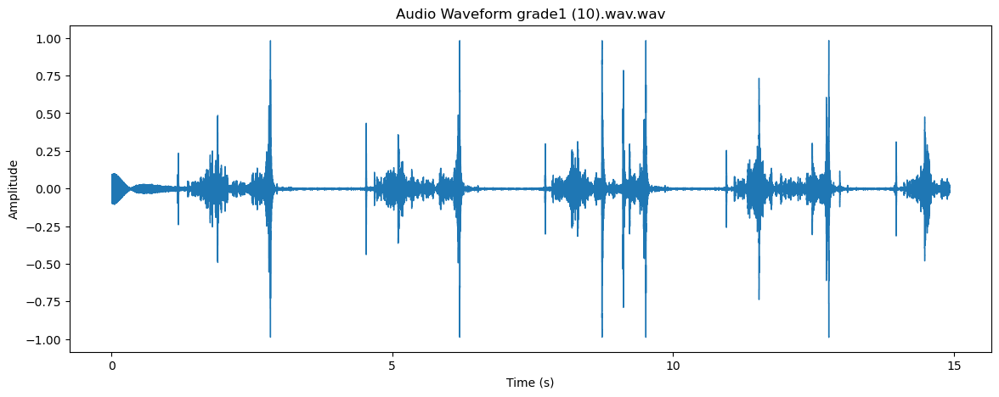

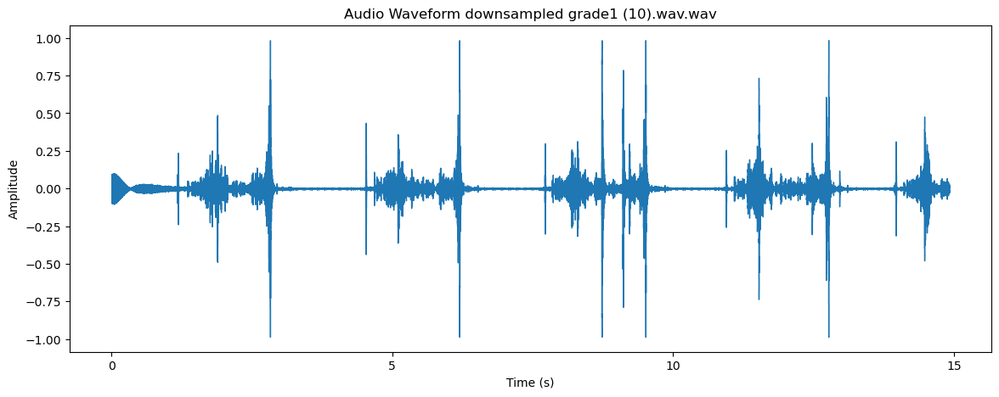

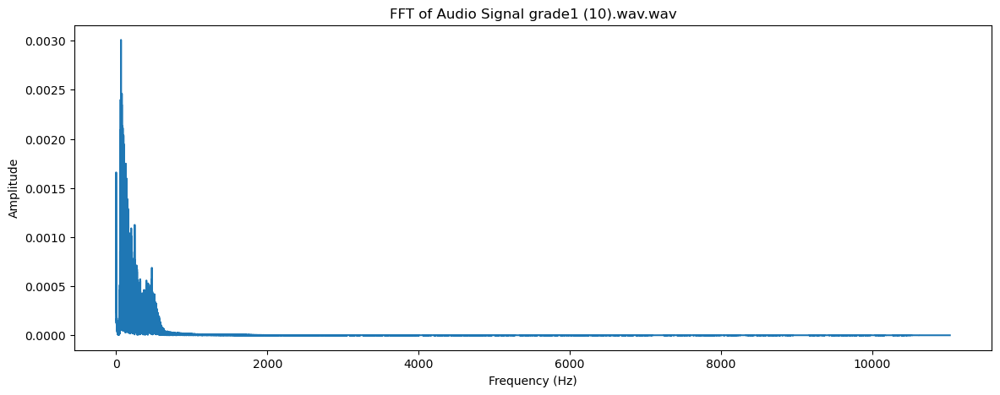

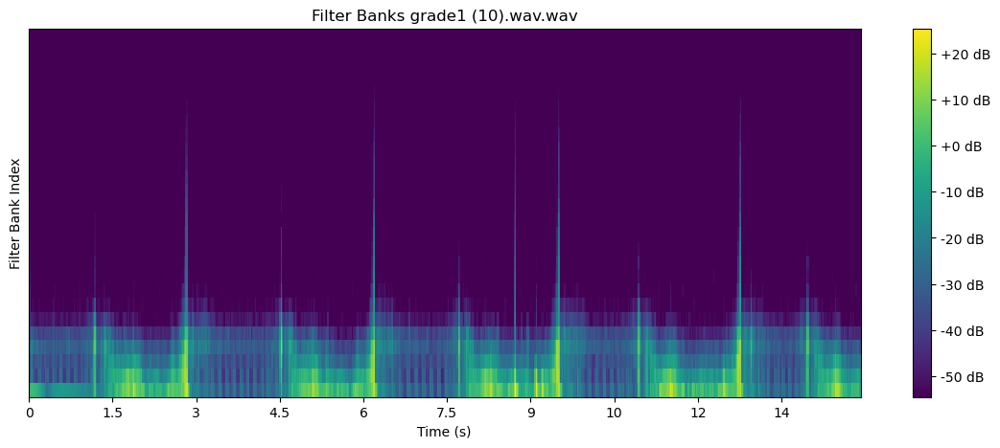

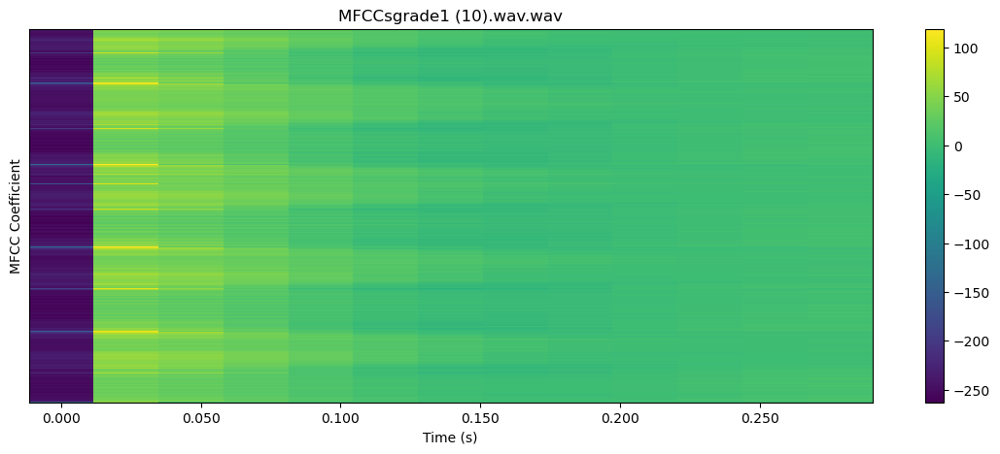


  1%|▏         | 2/141 [00:02<02:49,  1.22s/it]

22050


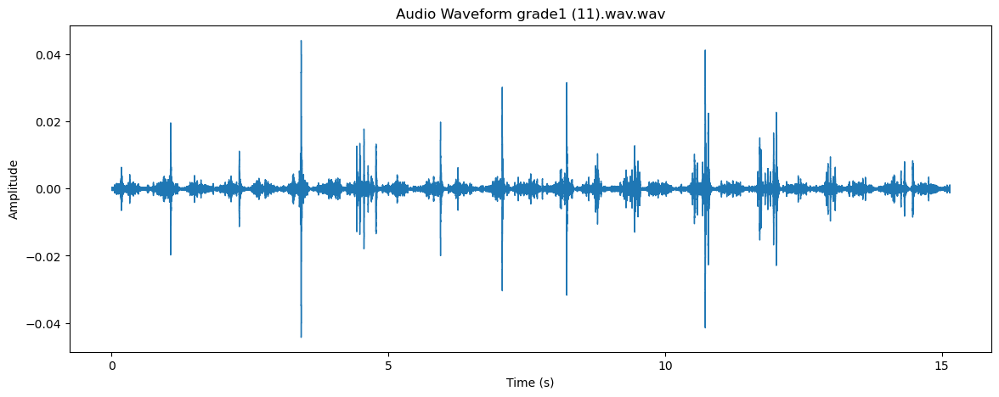

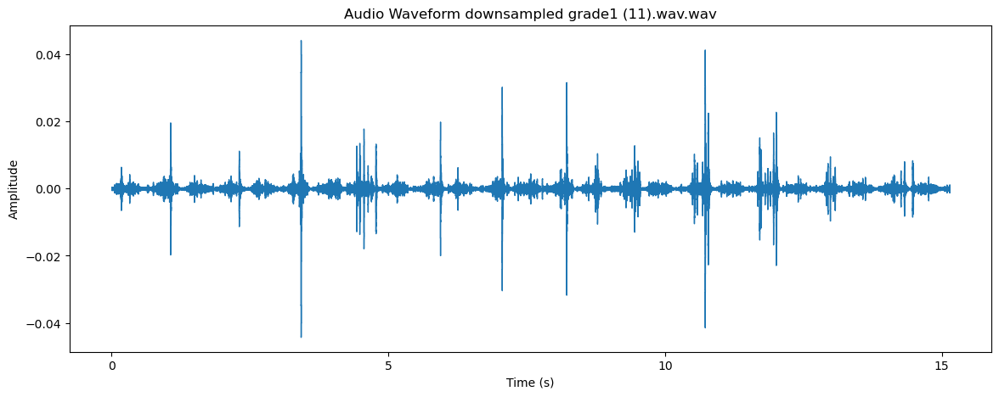

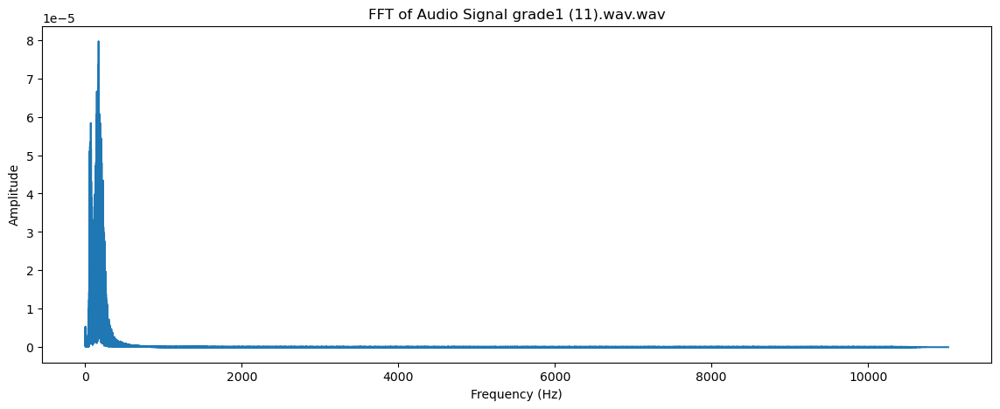

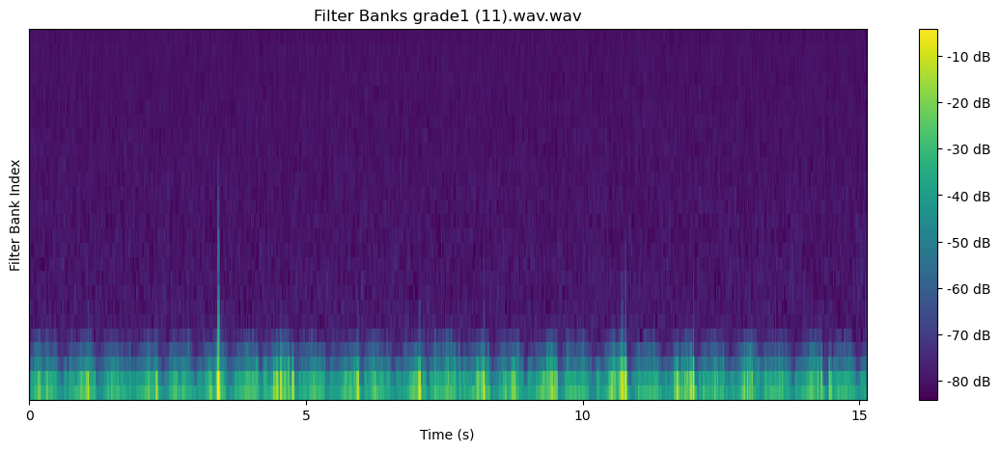

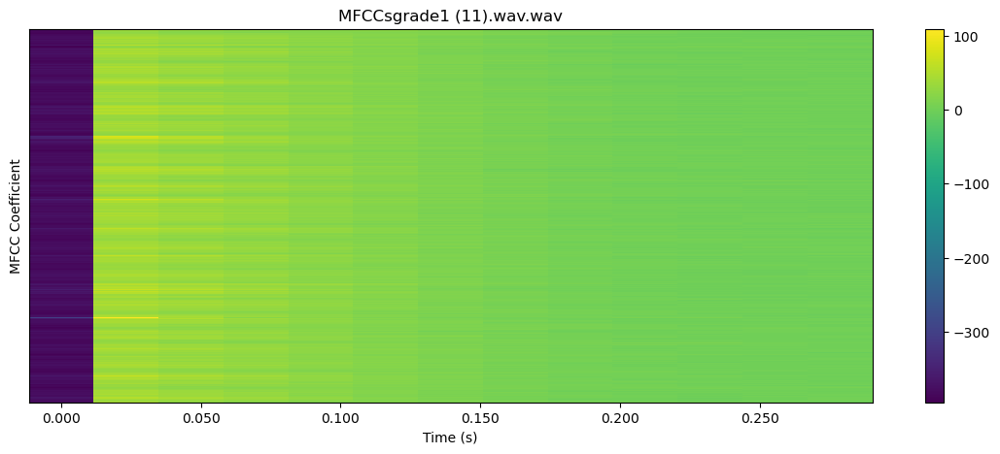


  2%|▏         | 3/141 [00:03<02:37,  1.14s/it]

22050


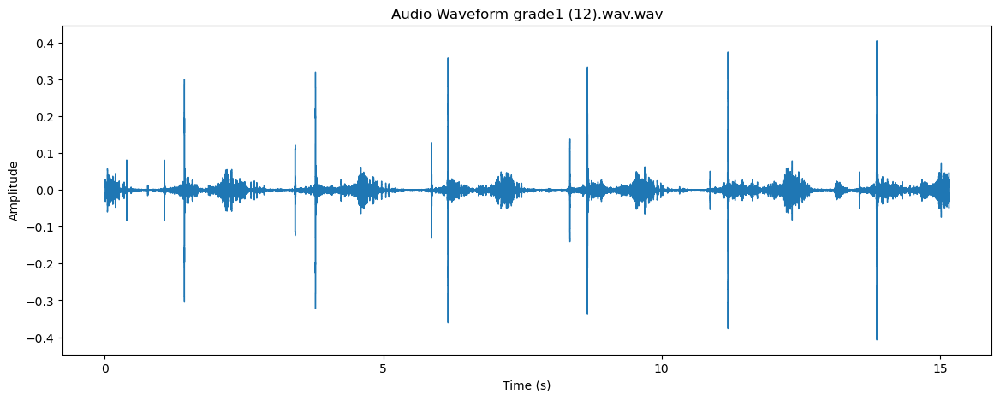

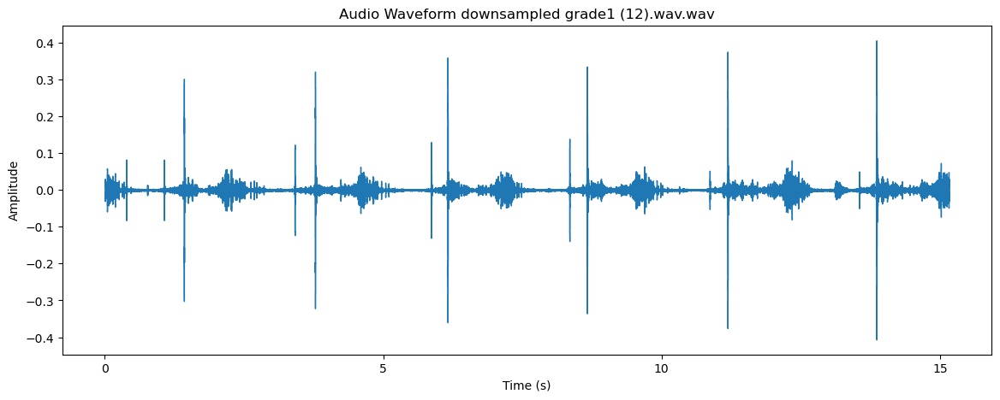

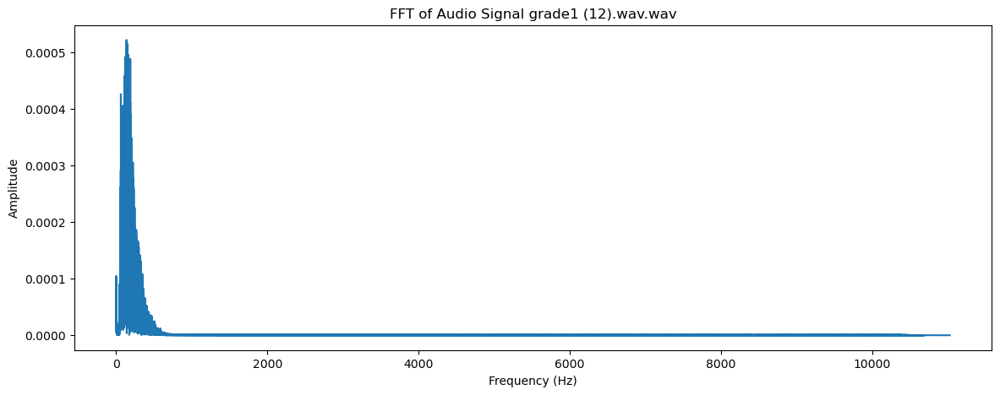

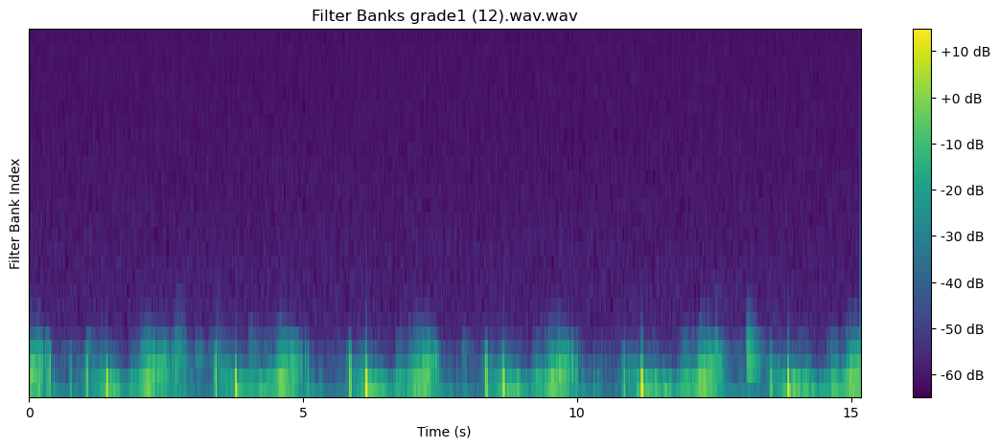

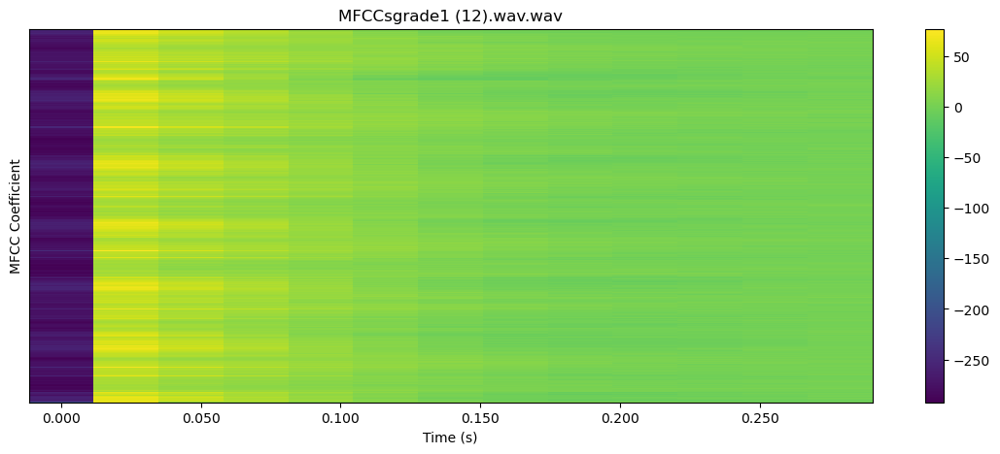


  3%|▎         | 4/141 [00:04<02:30,  1.10s/it]

22050


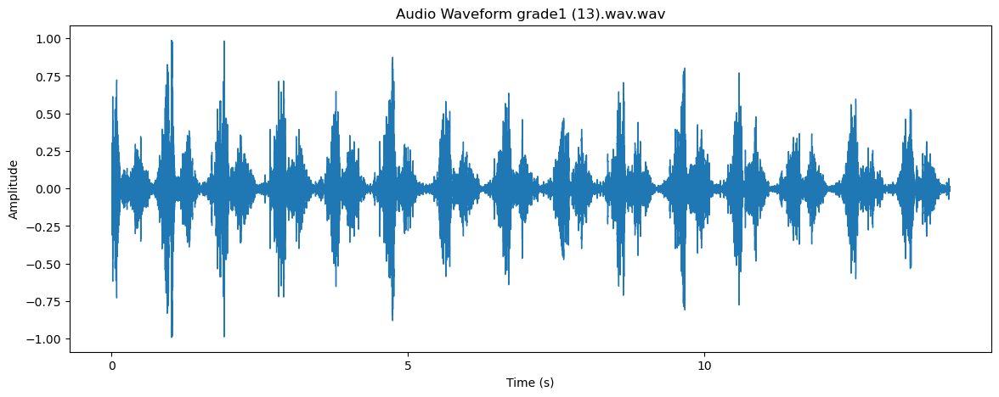

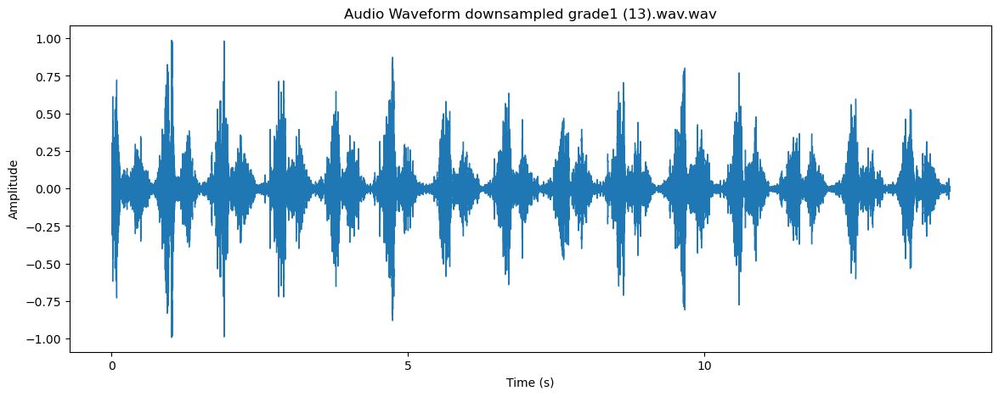

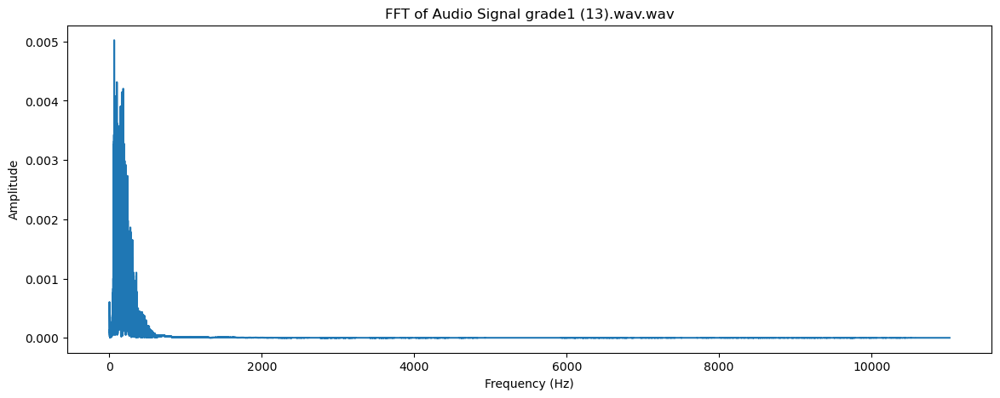

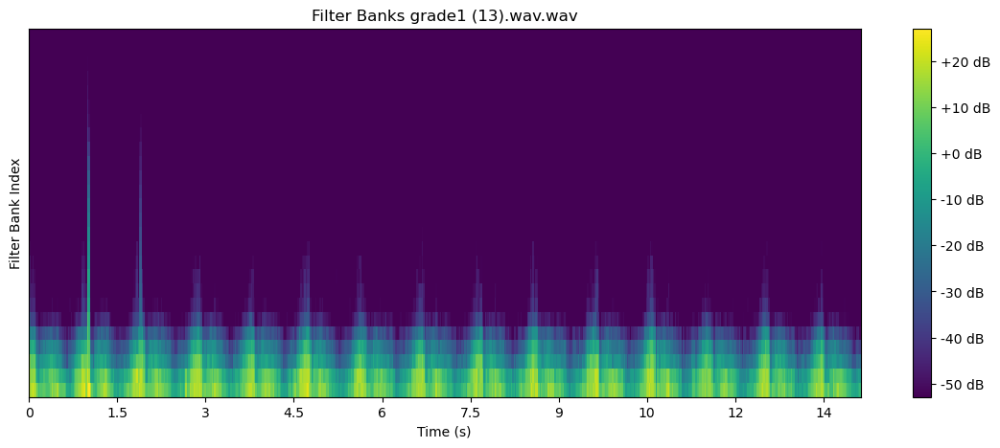

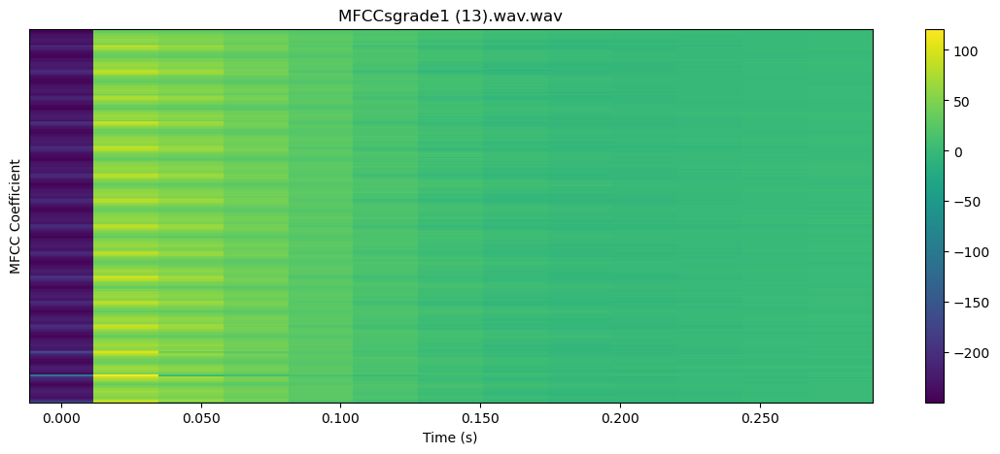


  4%|▎         | 5/141 [00:05<02:35,  1.15s/it]

22050


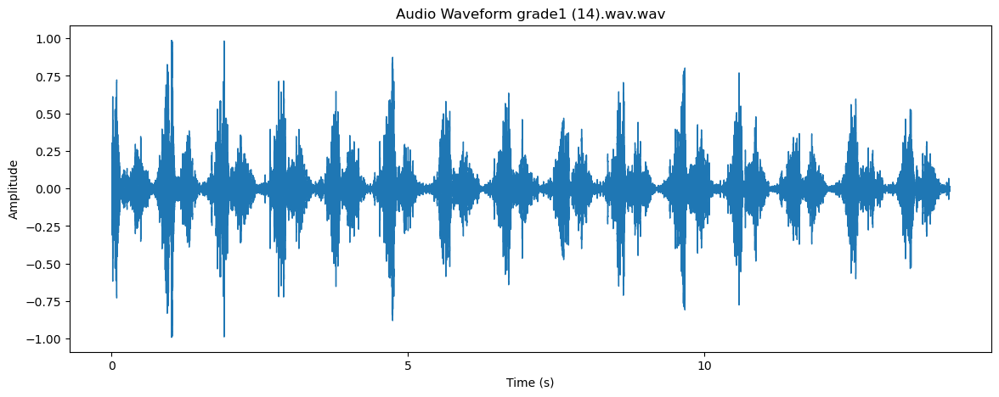

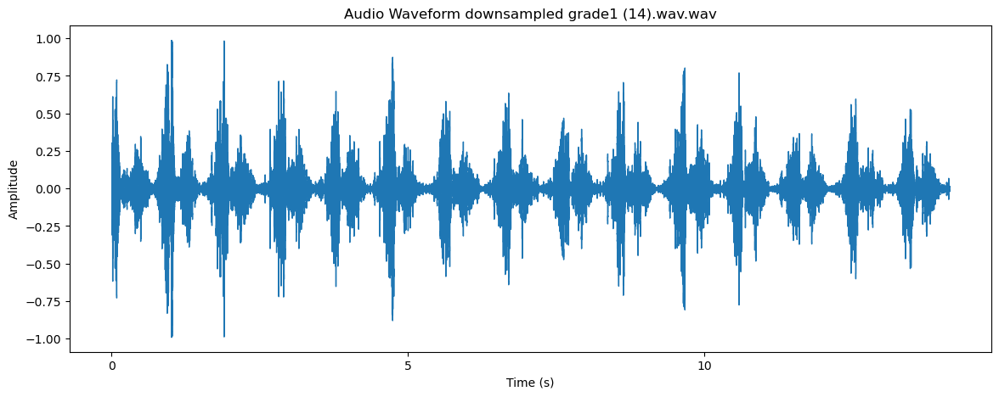

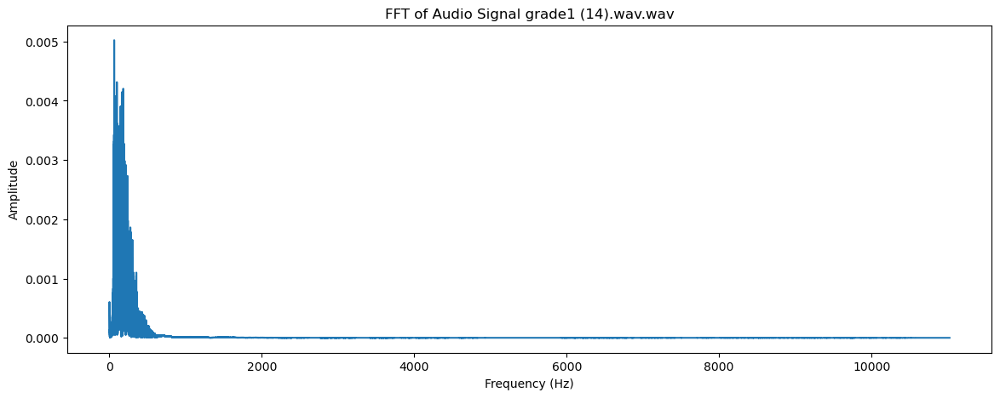

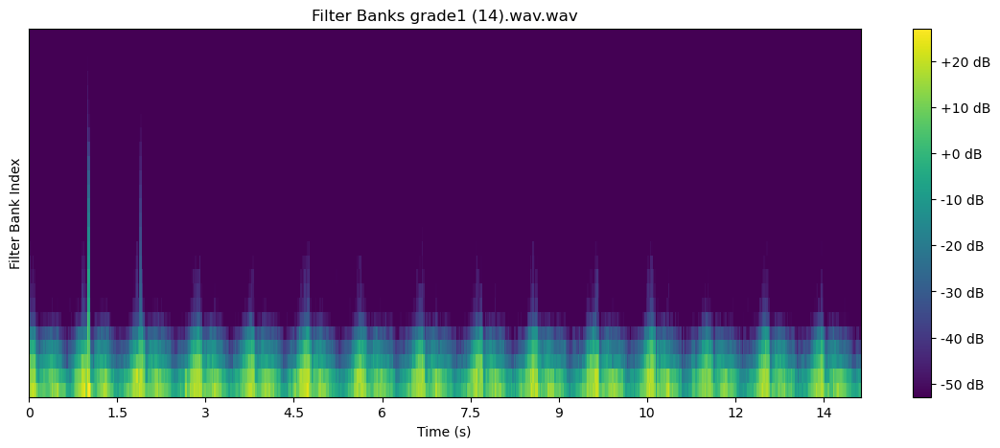

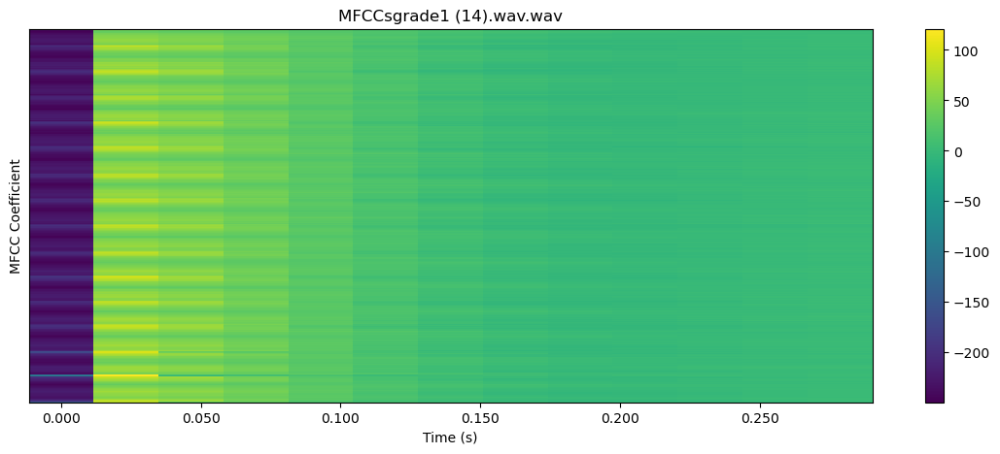


  4%|▍         | 6/141 [00:07<02:48,  1.25s/it]

22050


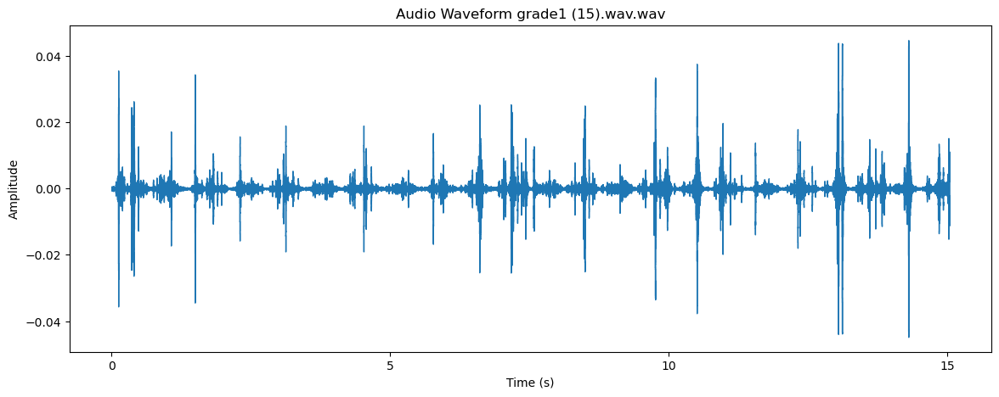

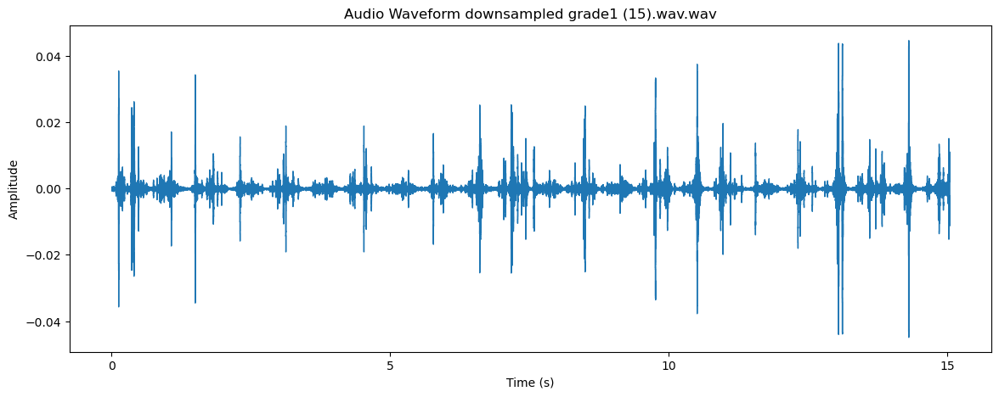

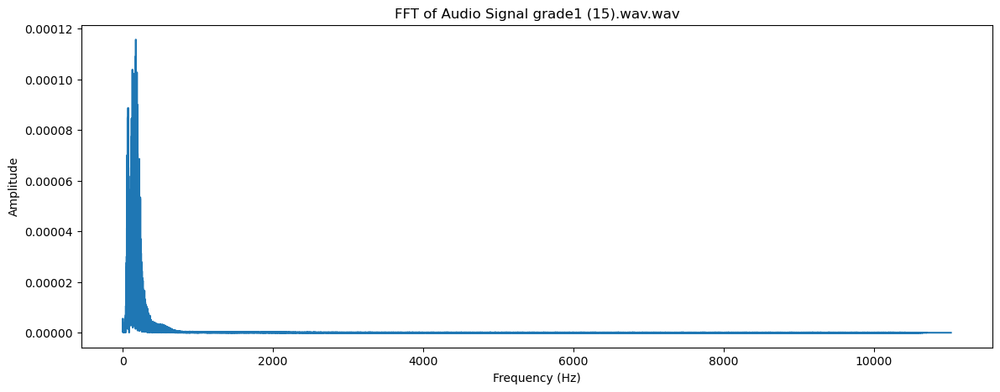

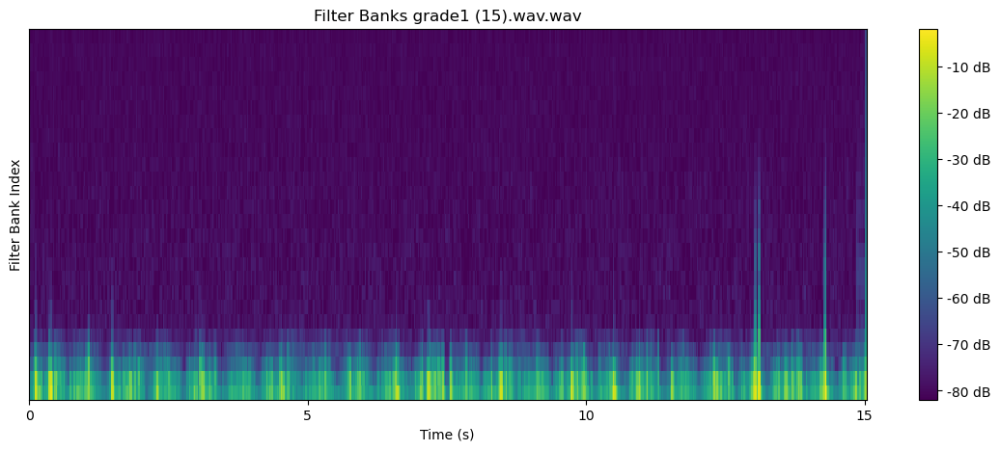

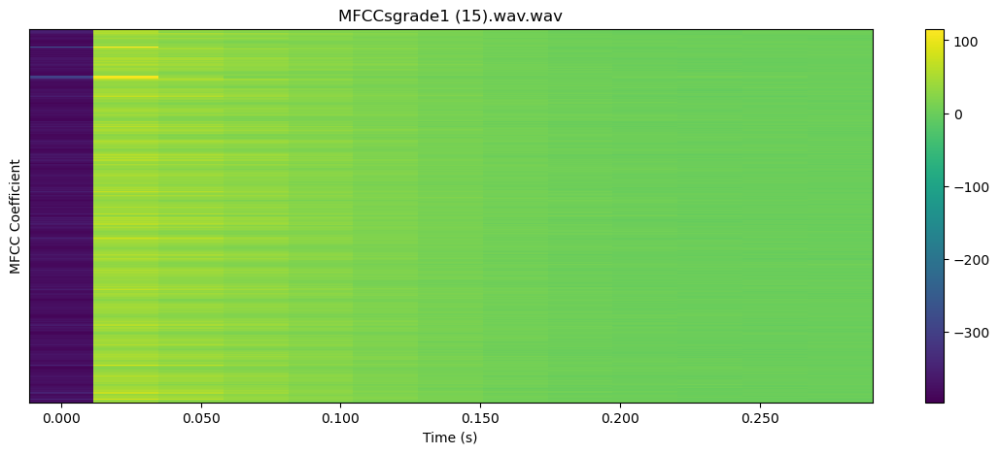


  5%|▍         | 7/141 [00:08<02:59,  1.34s/it]

22050


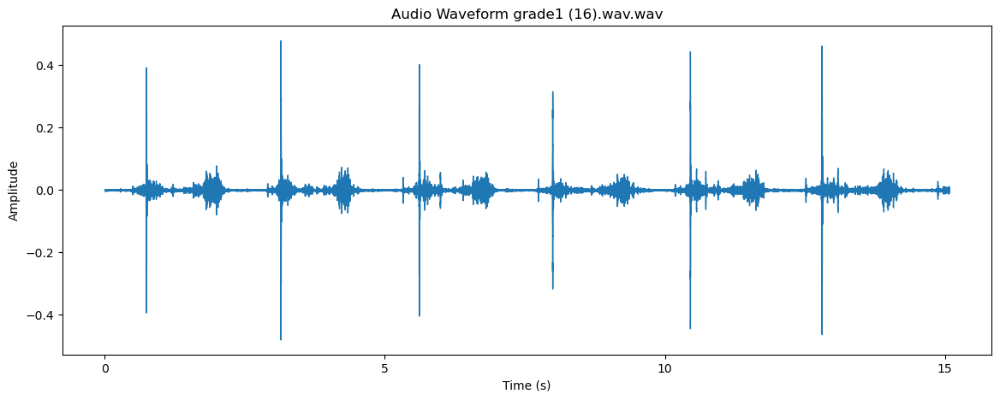

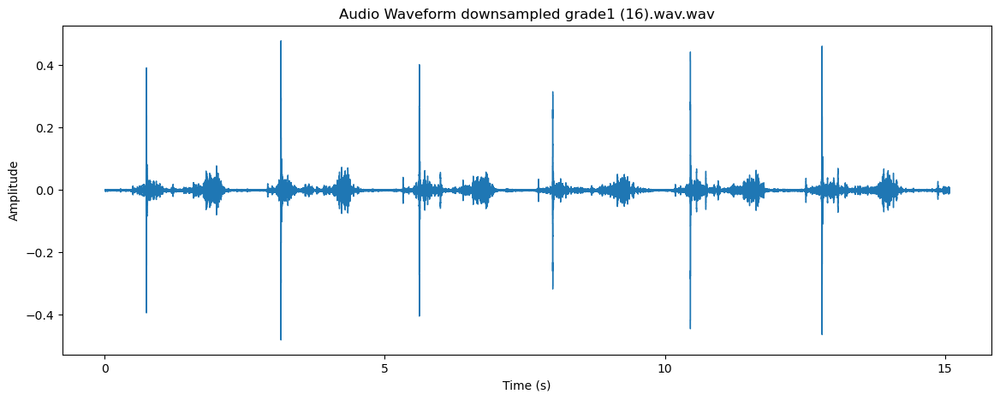

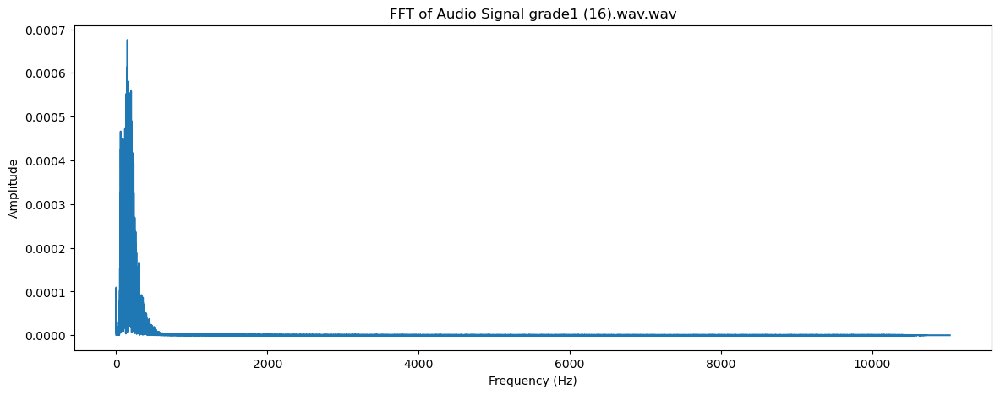

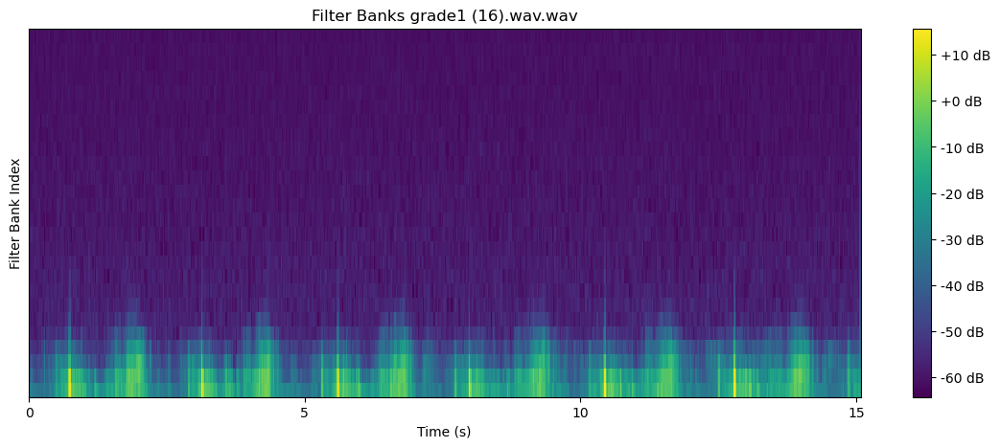

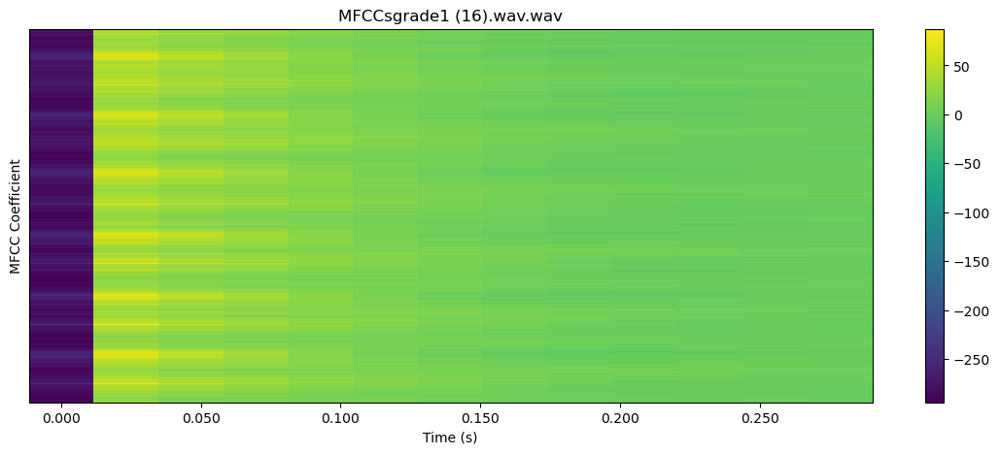


  6%|▌         | 8/141 [00:11<03:51,  1.74s/it]

22050


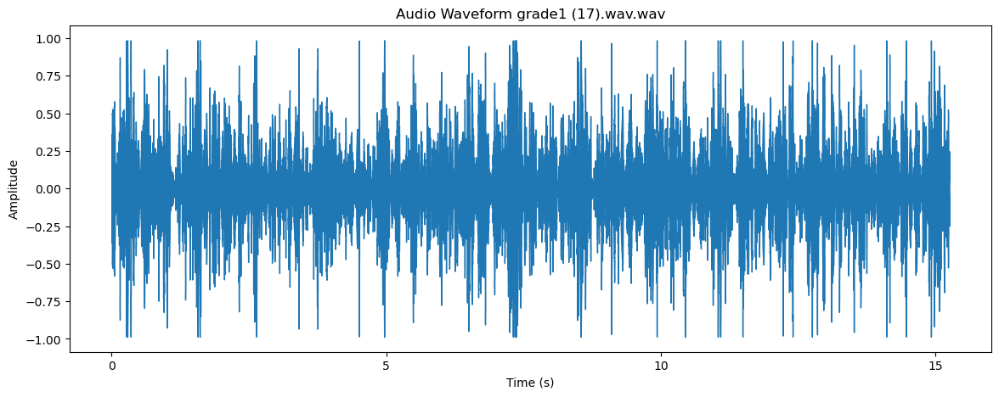

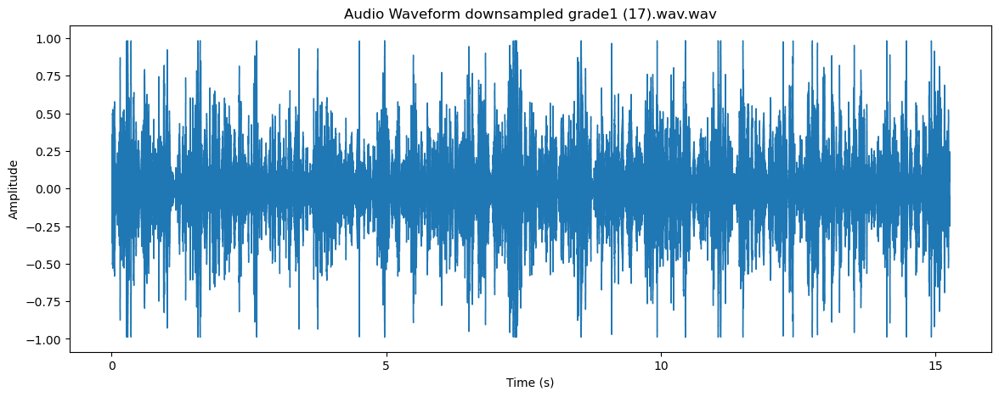

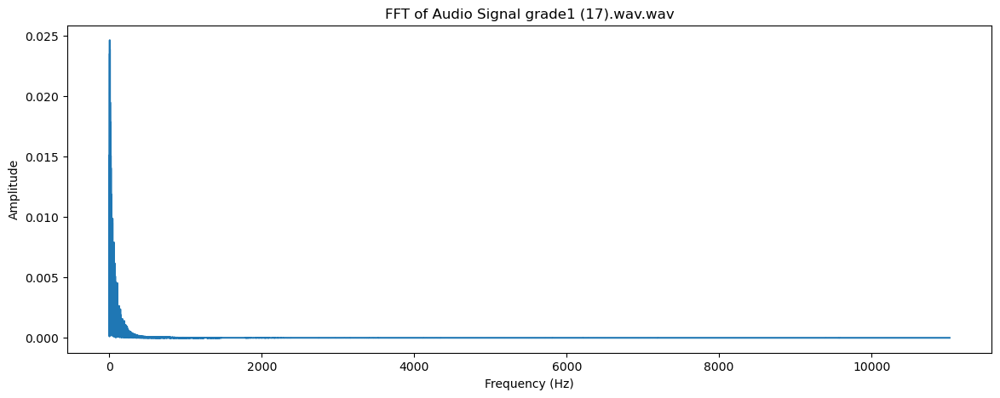

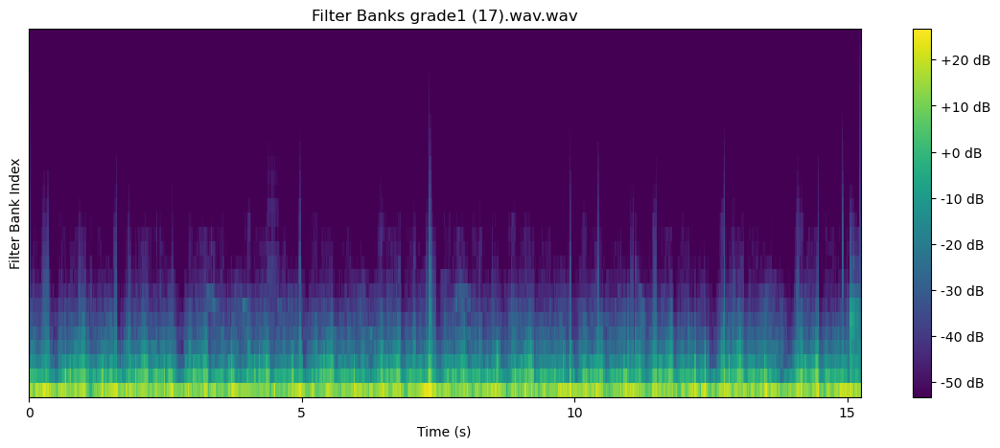

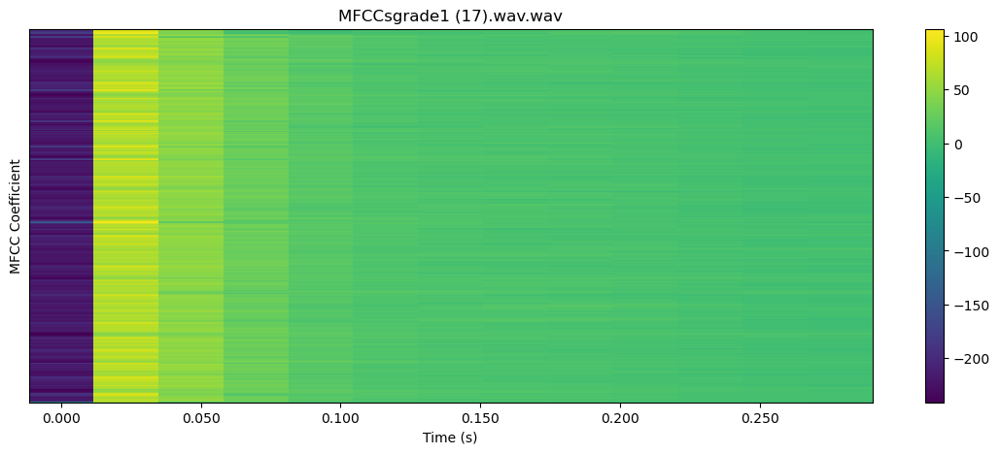


  6%|▋         | 9/141 [00:14<04:31,  2.06s/it]

22050


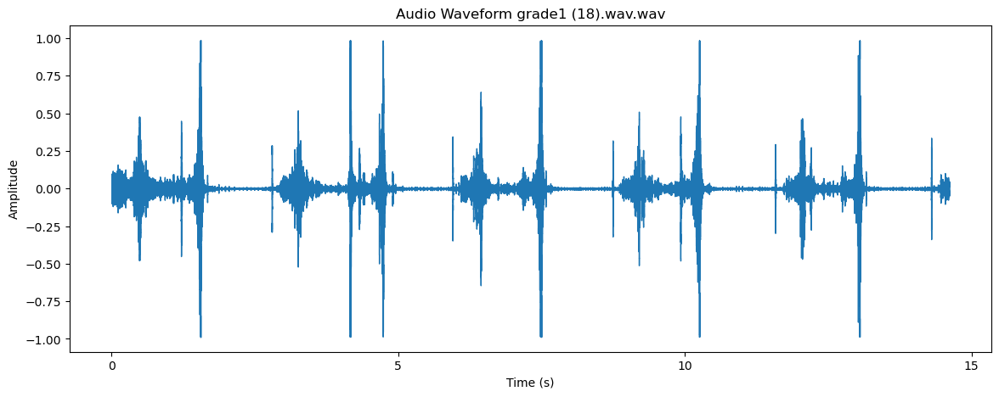

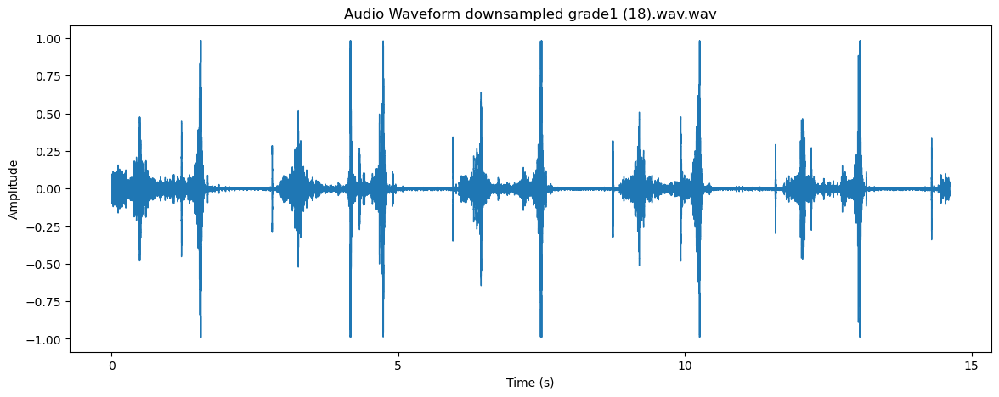

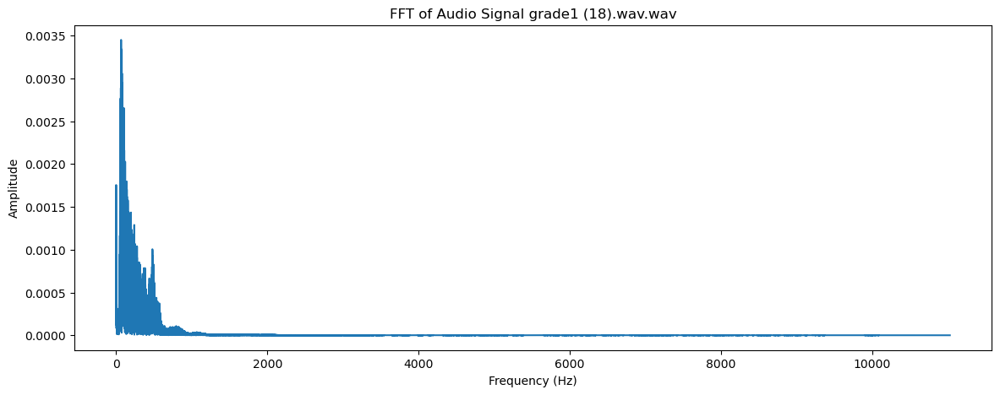

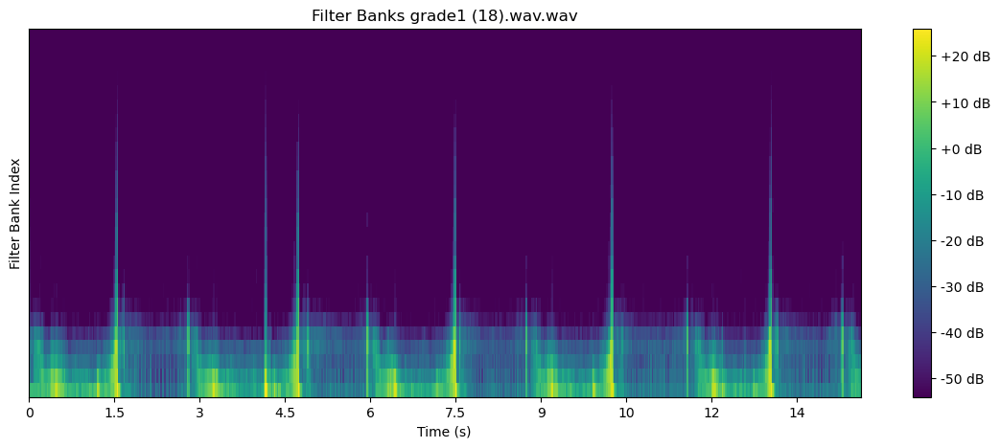

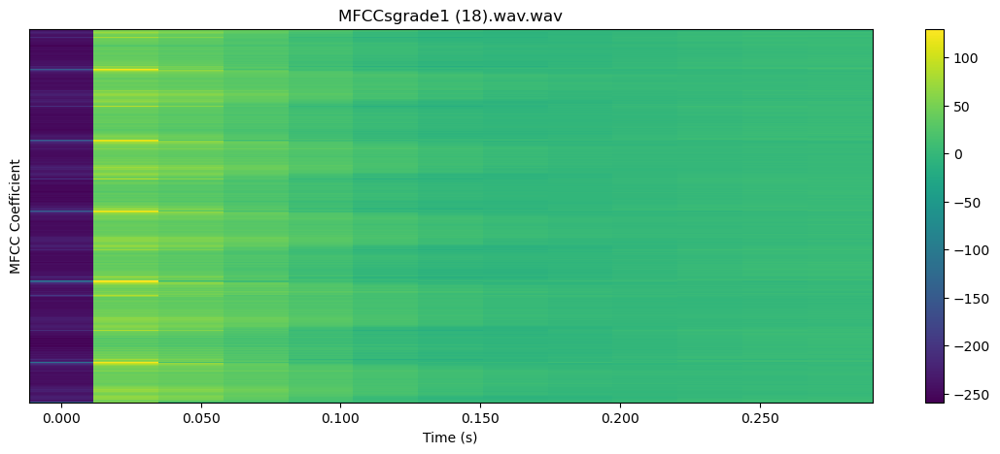


  7%|▋         | 10/141 [00:15<04:11,  1.92s/it]

22050


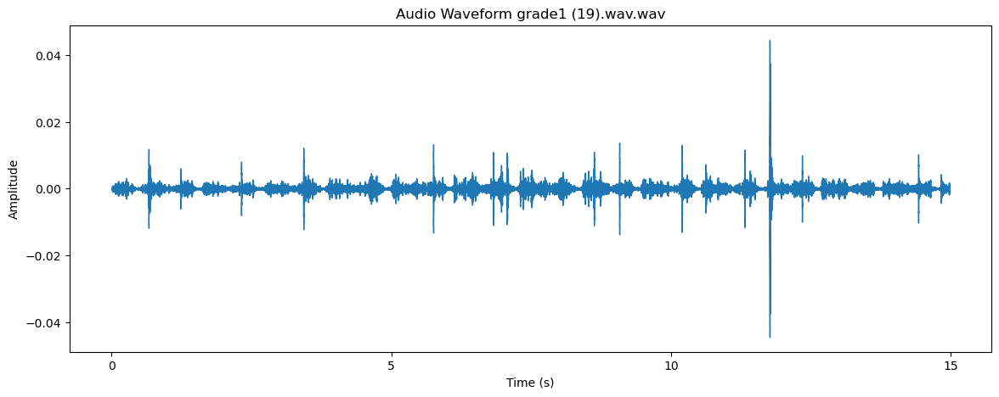

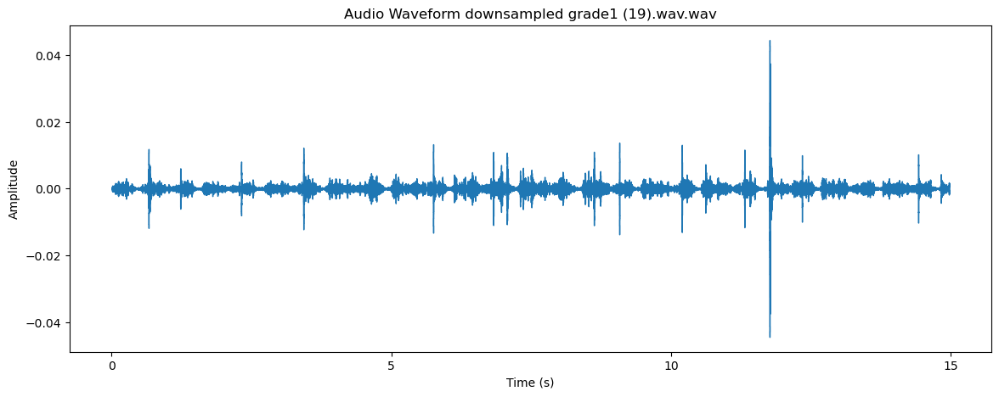

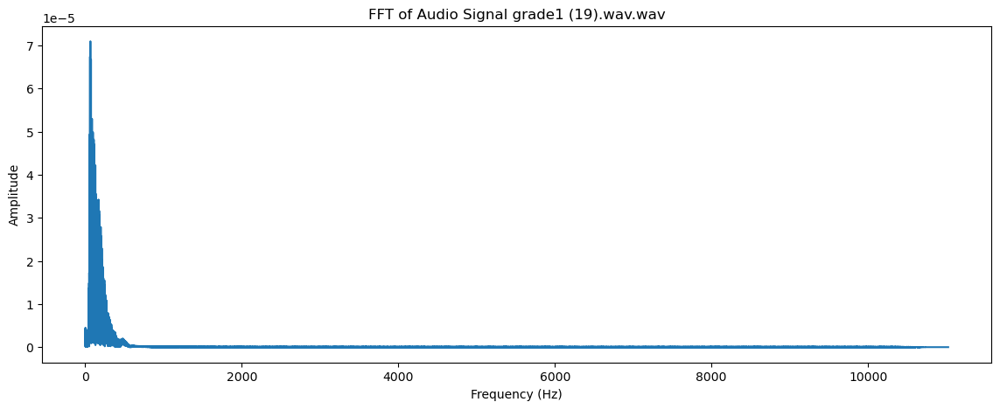

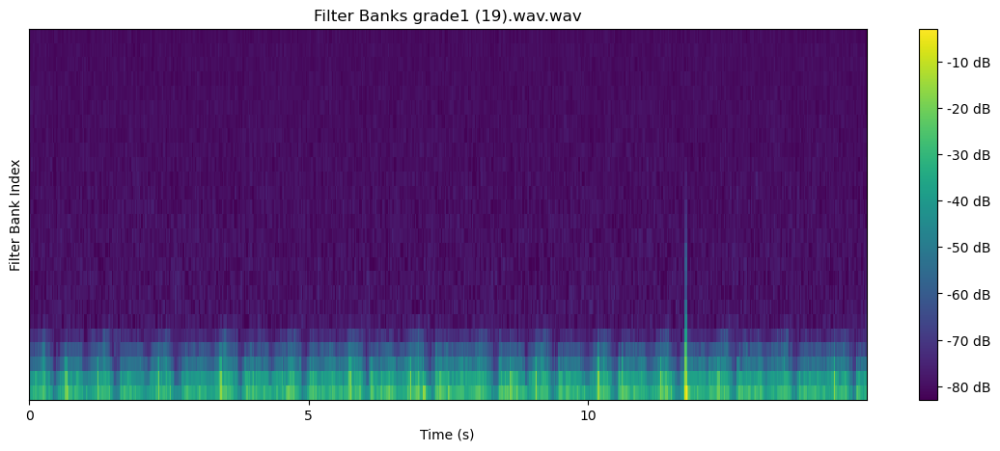

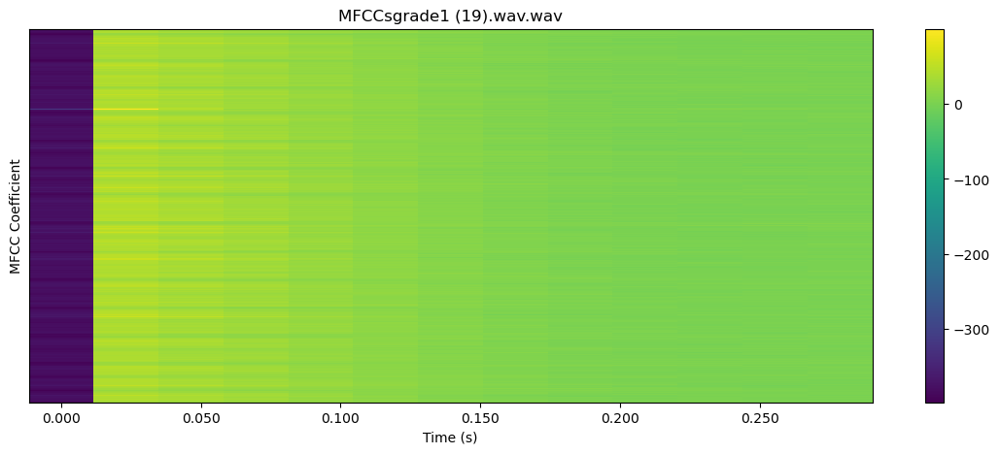


  8%|▊         | 11/141 [00:17<03:52,  1.79s/it]

22050


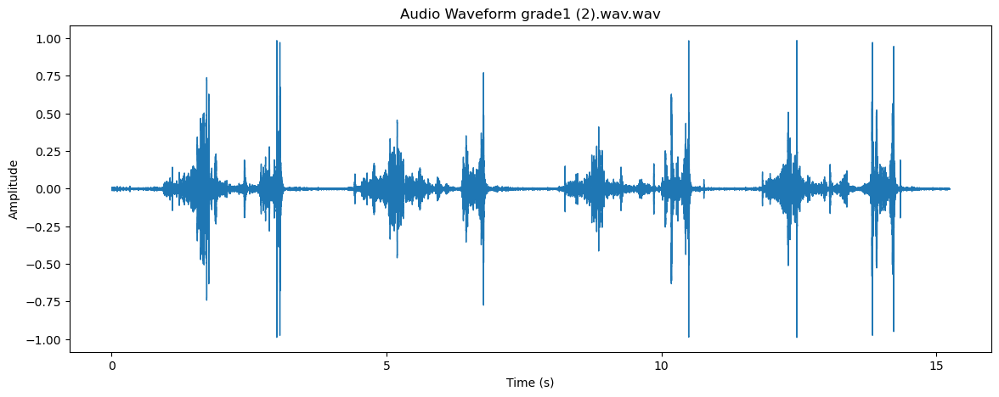

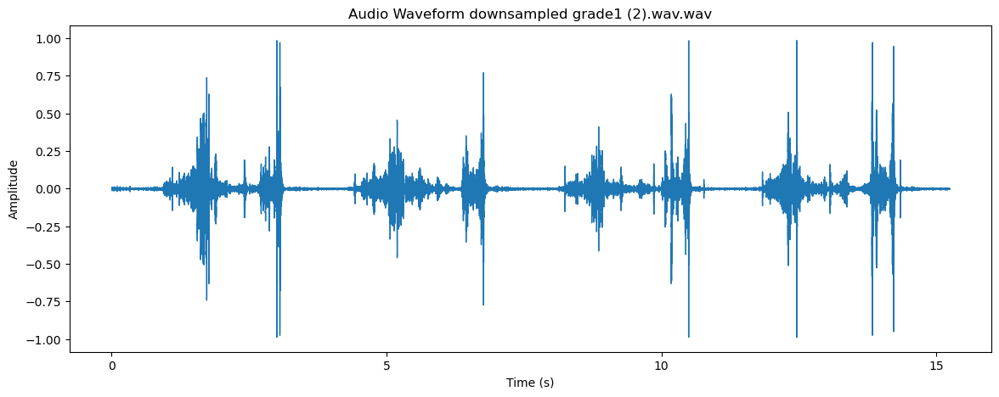

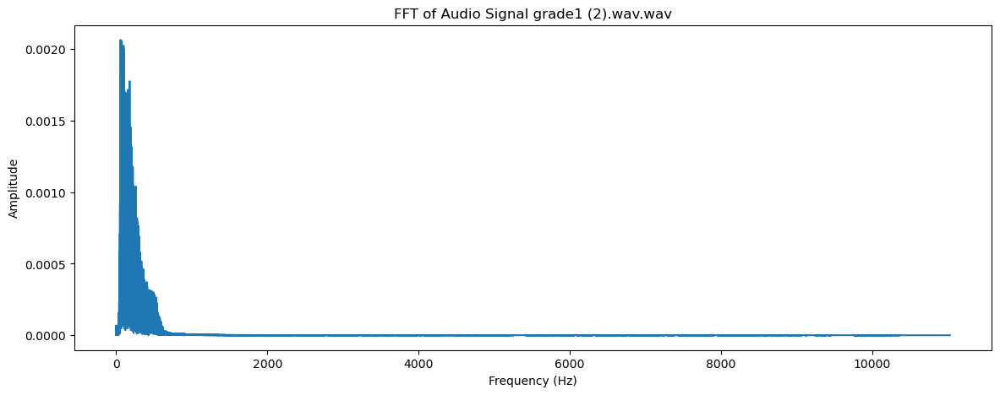

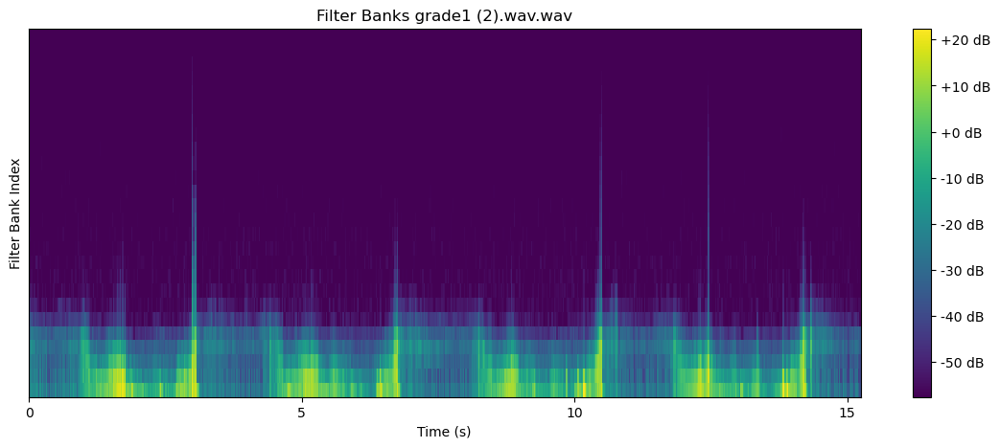

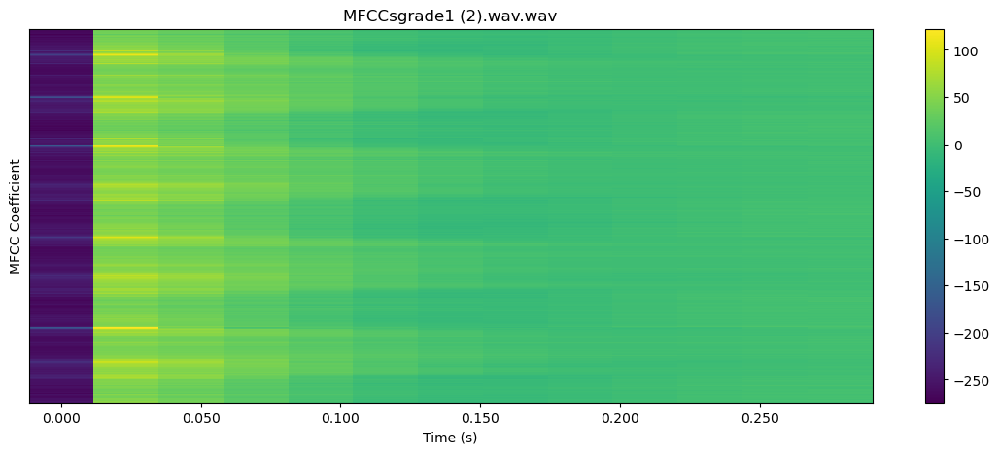


  9%|▊         | 12/141 [00:18<03:39,  1.70s/it]

22050


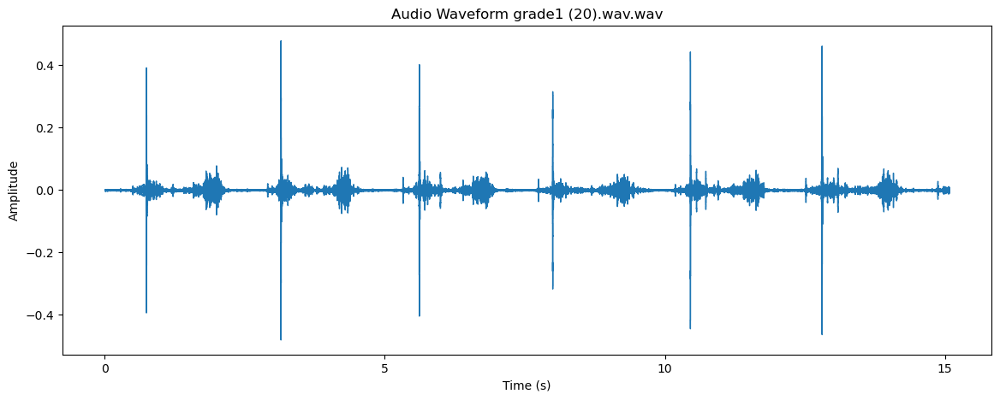

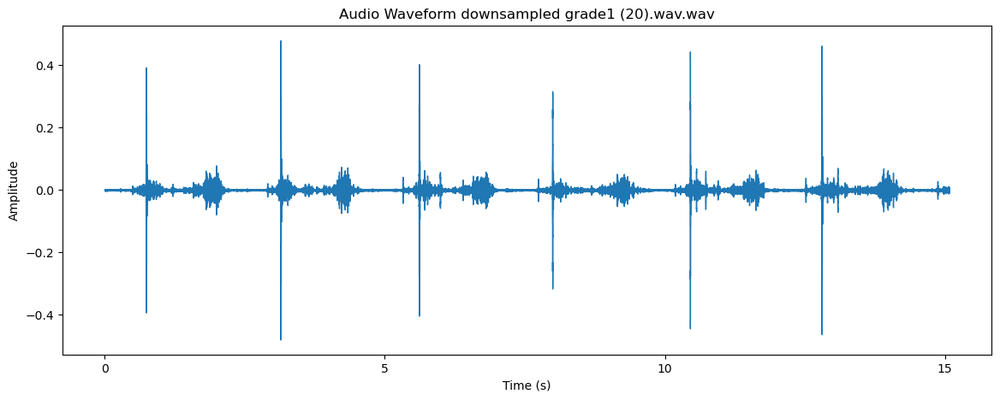

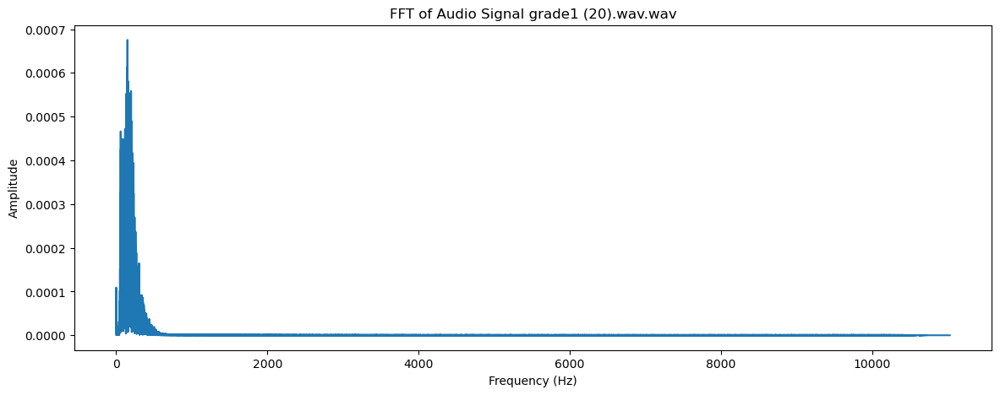

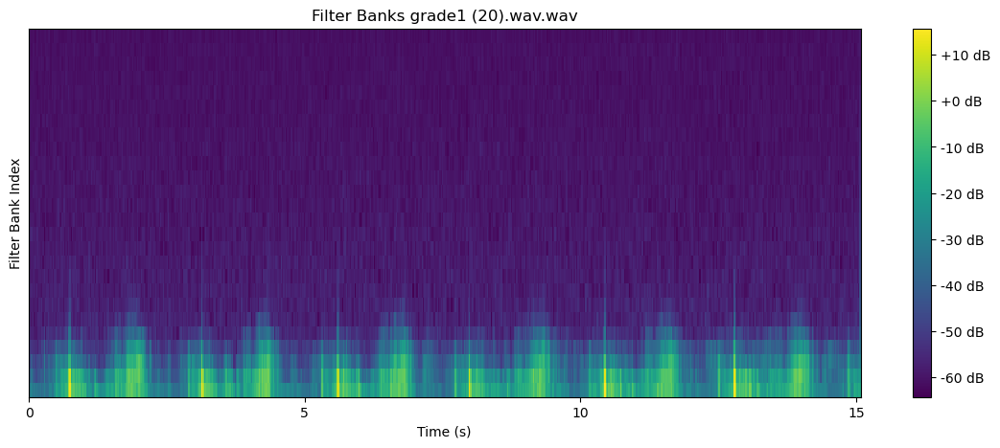

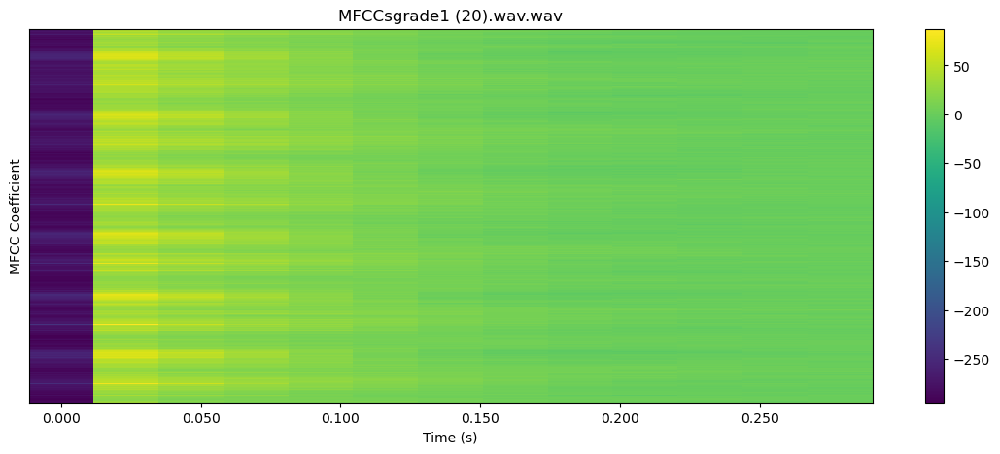


  9%|▉         | 13/141 [00:20<03:31,  1.65s/it]

22050


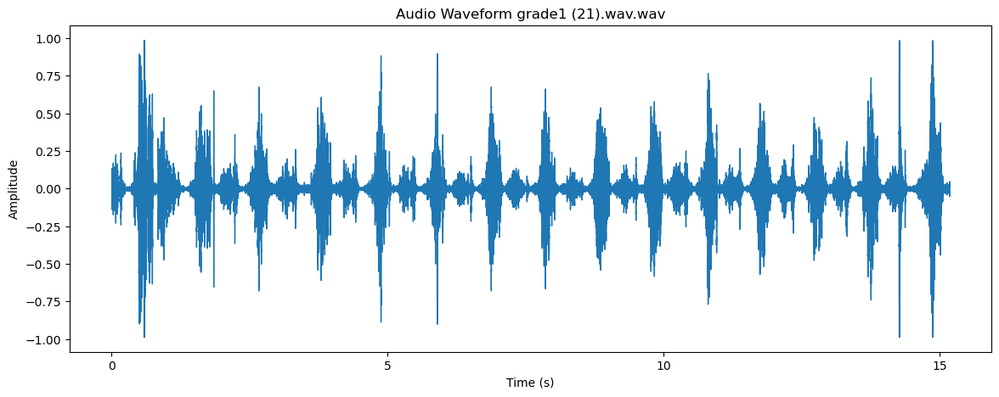

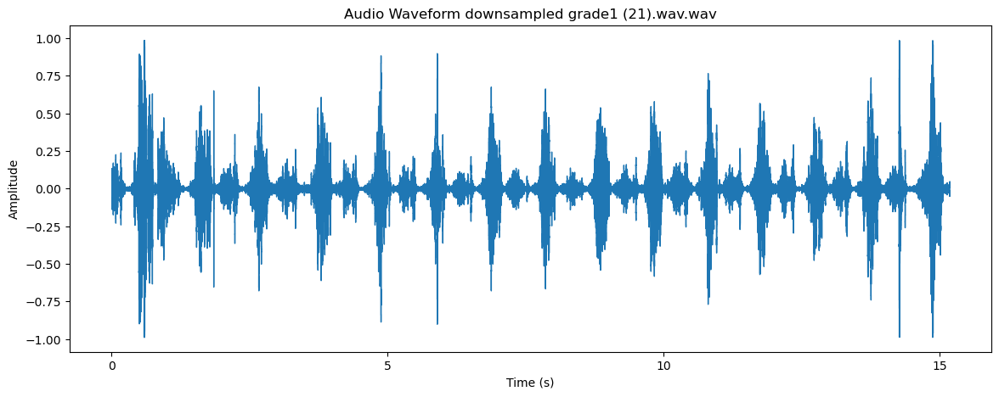

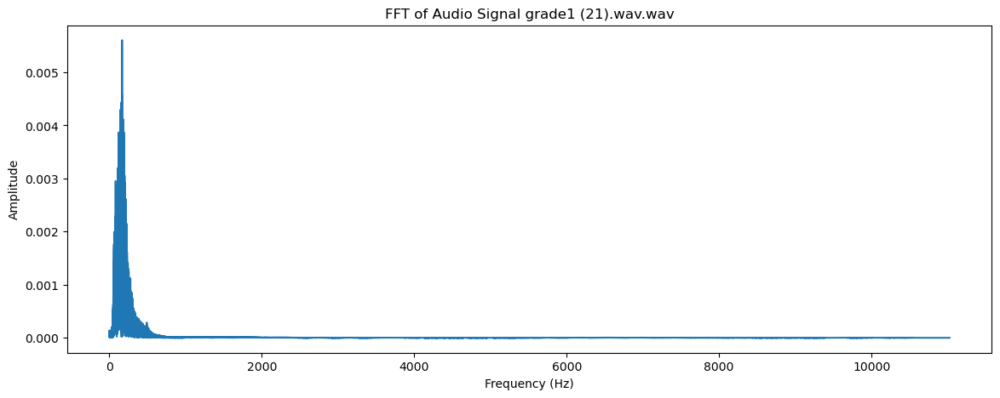

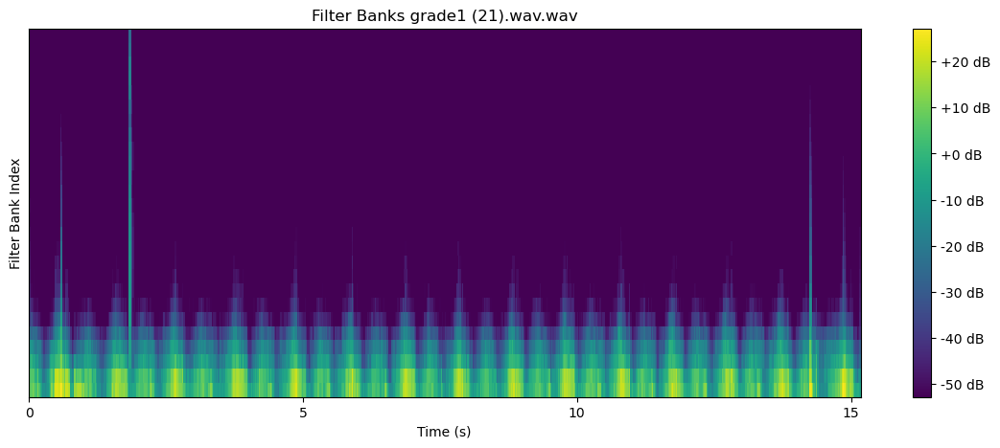

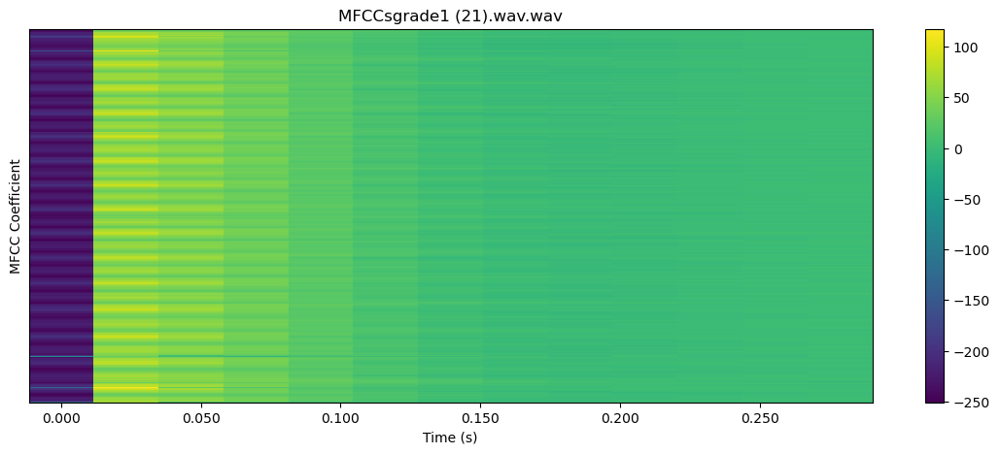


 10%|▉         | 14/141 [00:21<03:27,  1.63s/it]

22050


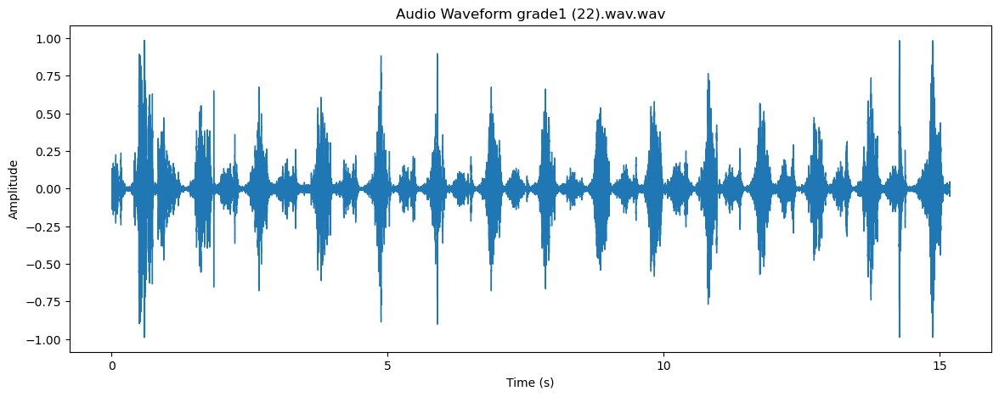

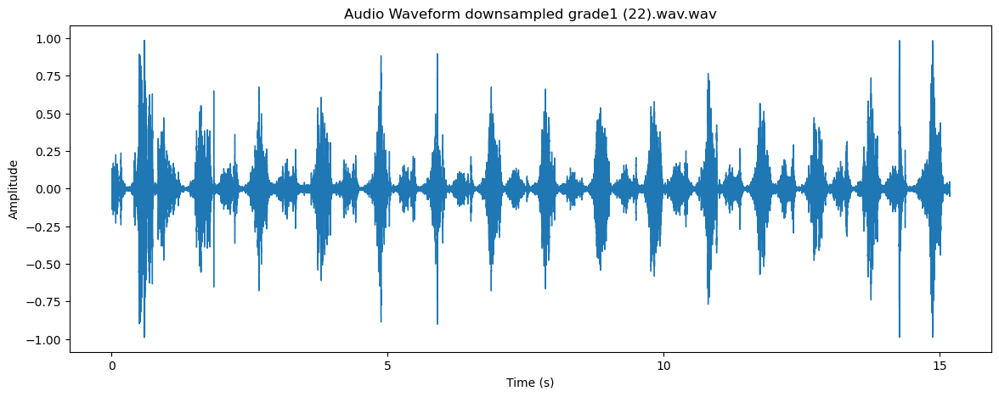

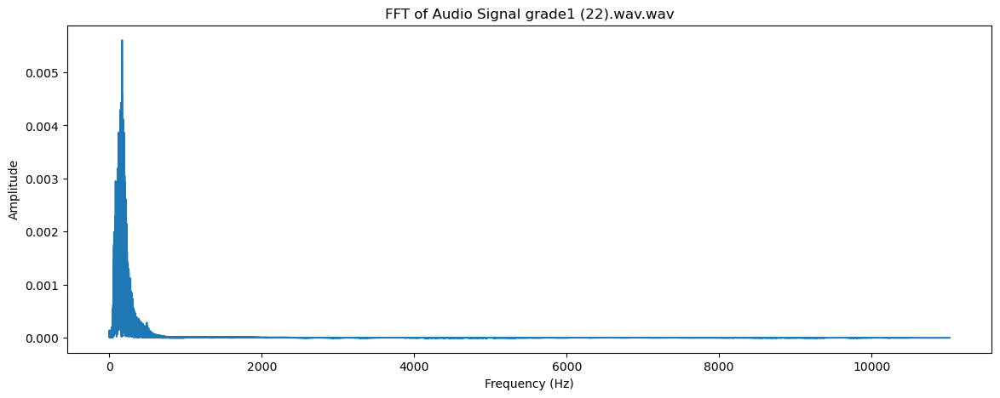

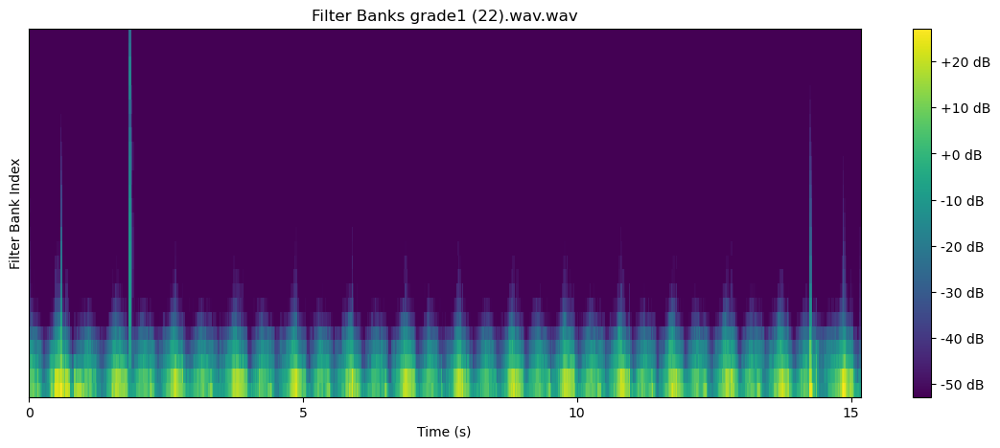

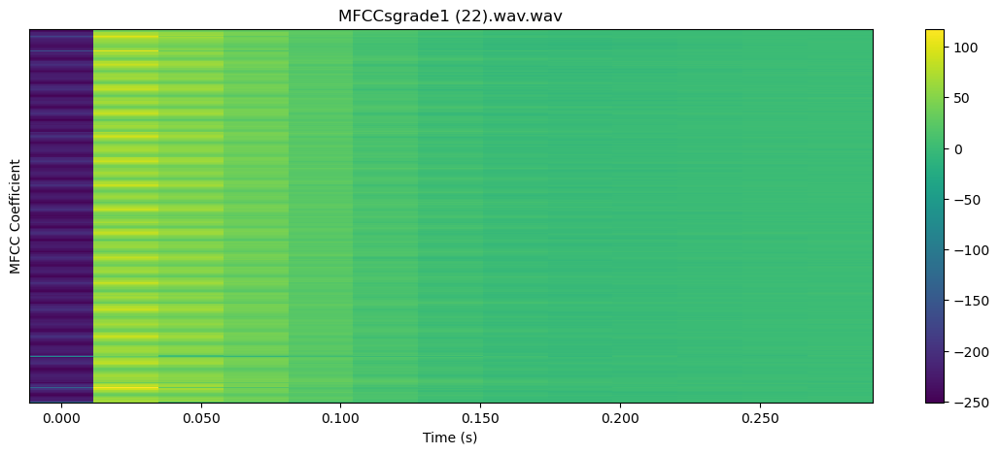


 11%|█         | 15/141 [00:23<03:23,  1.62s/it]

22050


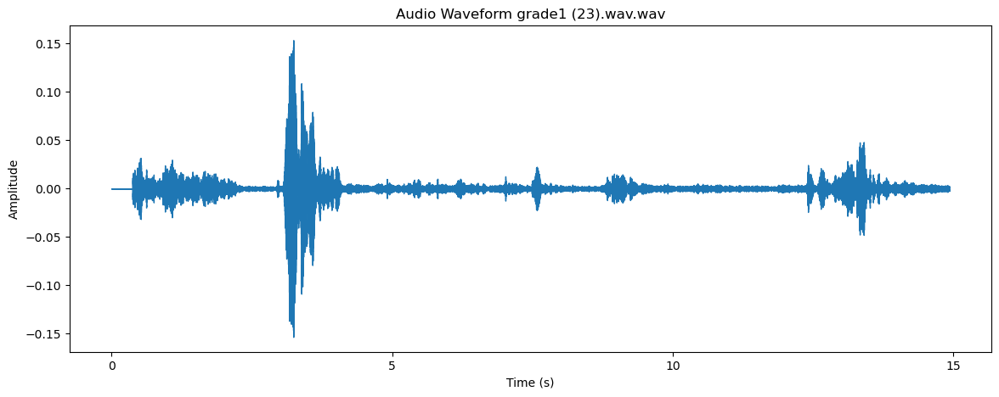

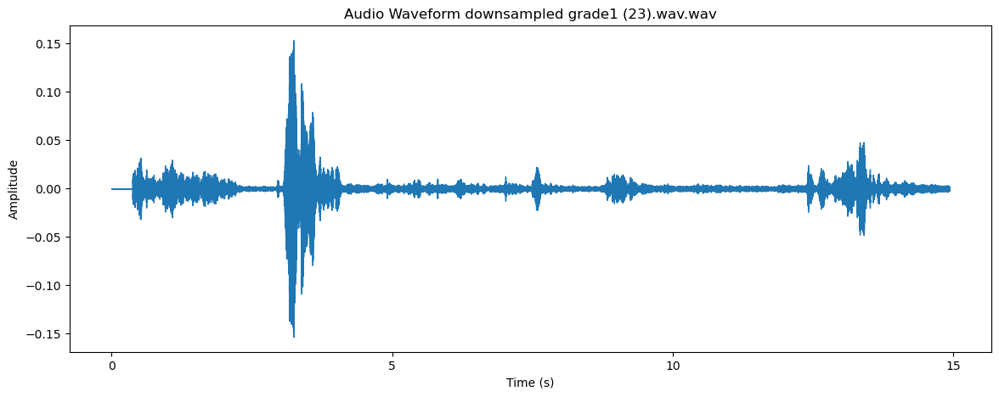

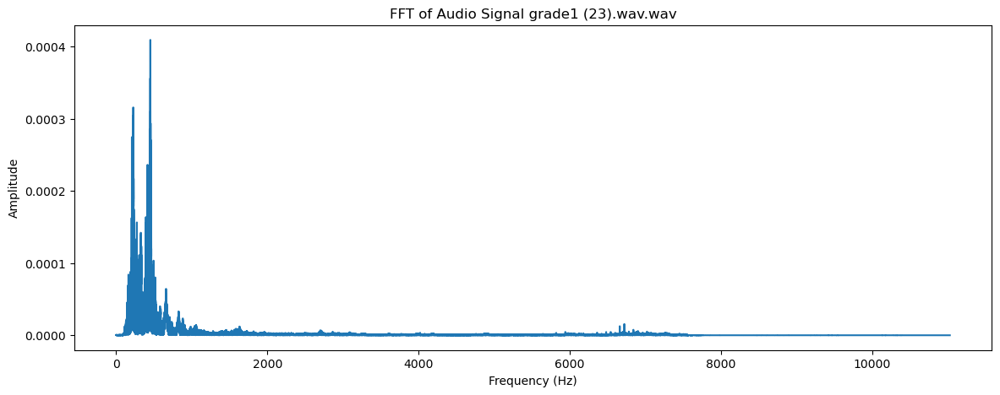

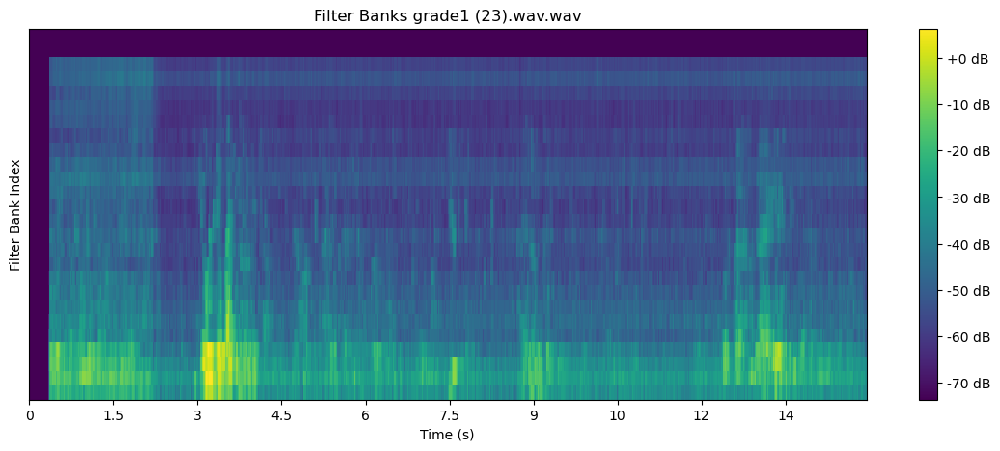

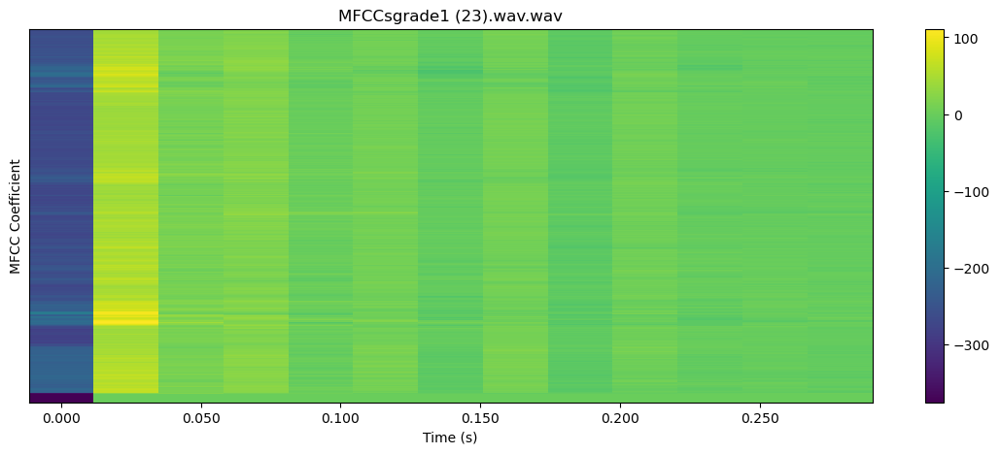


 11%|█▏        | 16/141 [00:25<03:22,  1.62s/it]

22050


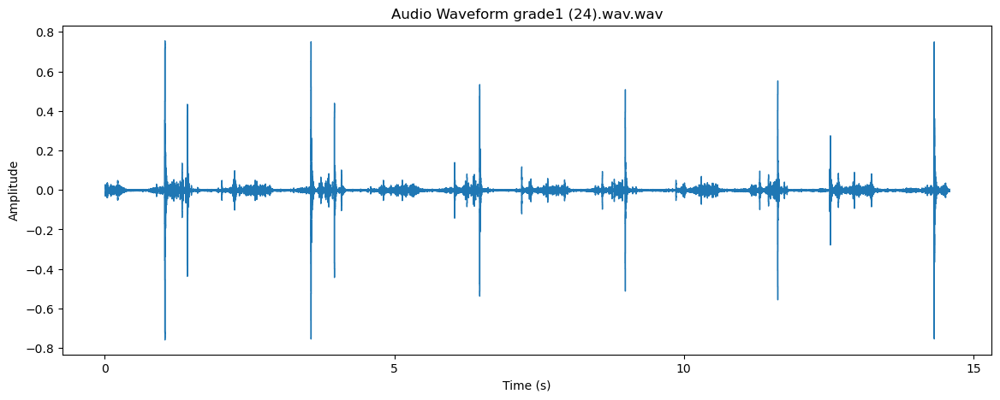

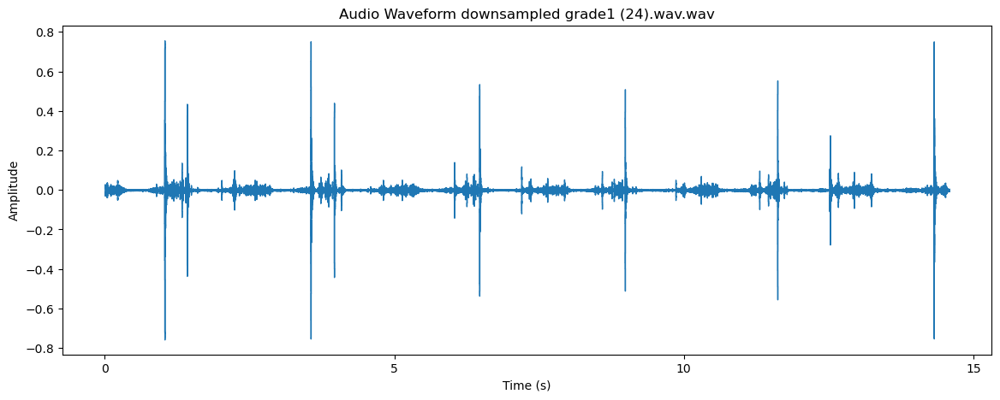

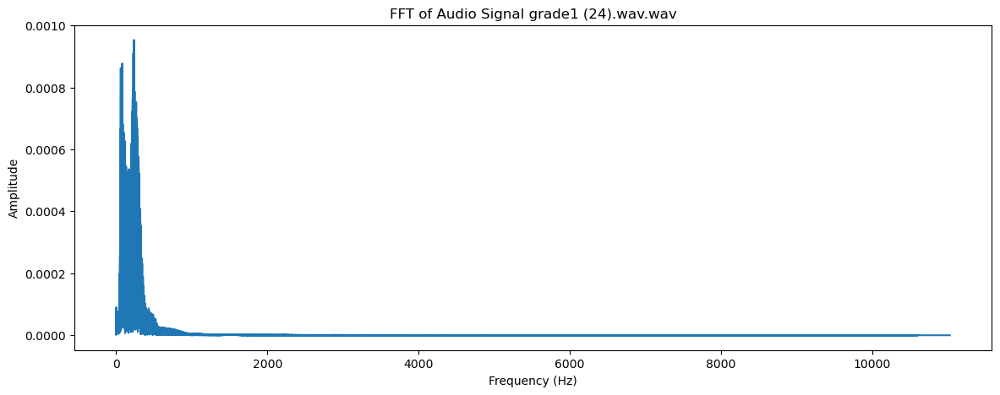

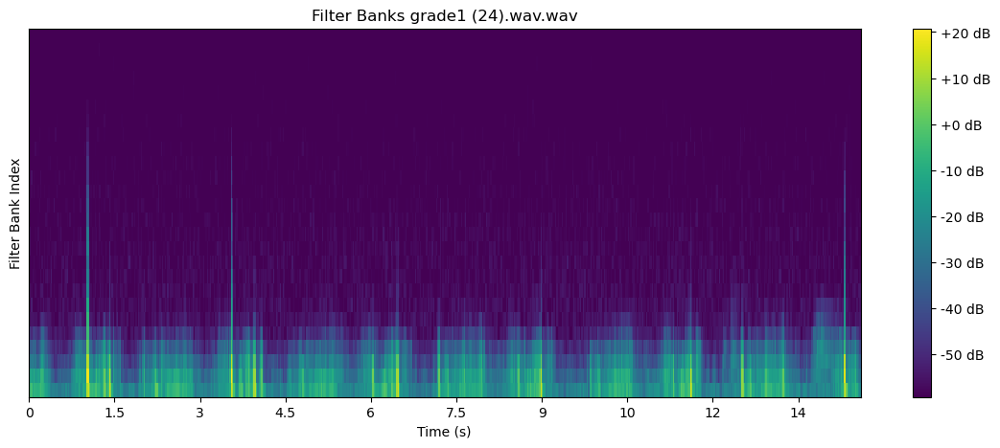

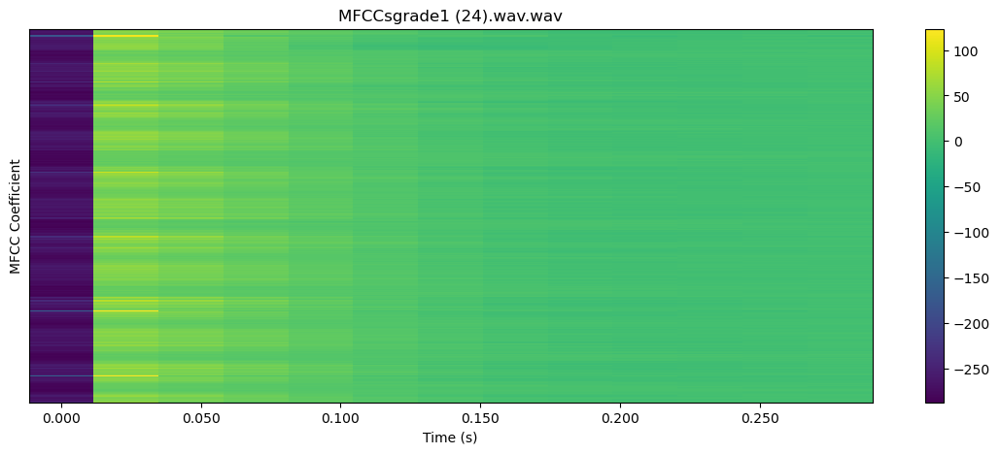


 12%|█▏        | 17/141 [00:27<03:42,  1.79s/it]

22050


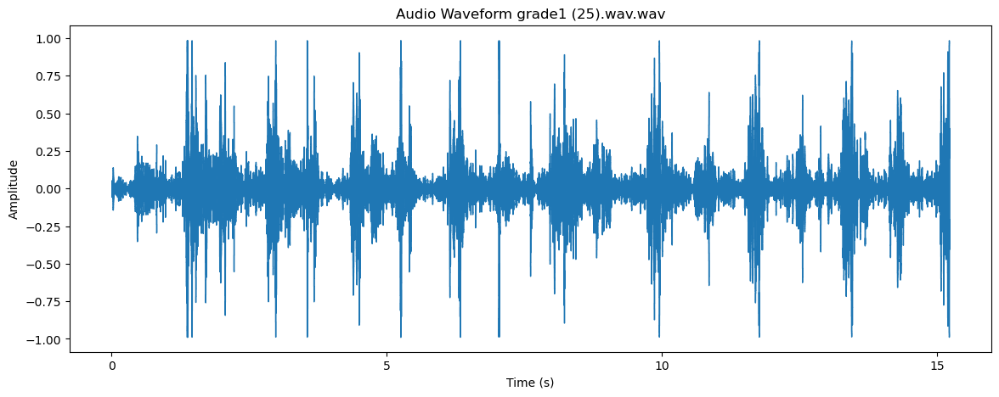

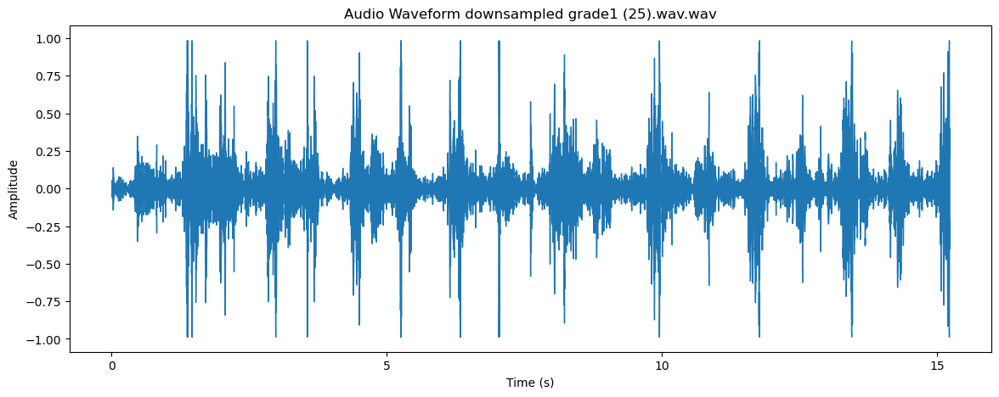

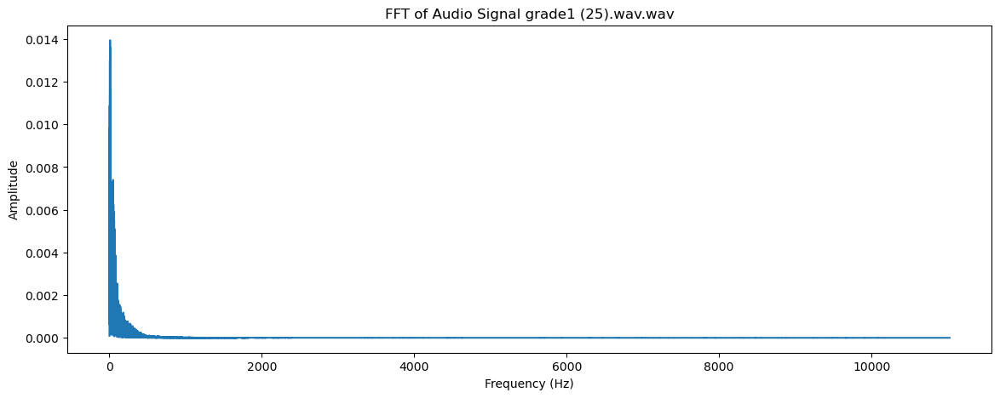

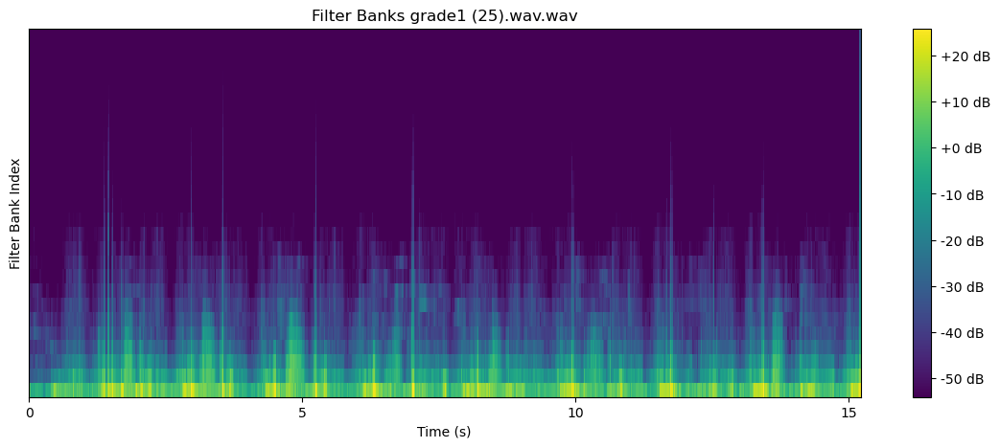

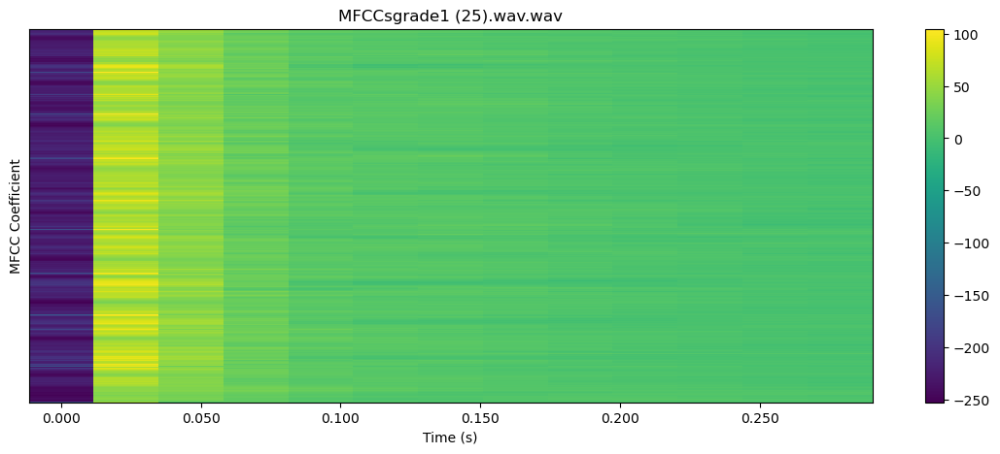


 13%|█▎        | 18/141 [00:29<04:03,  1.98s/it]

22050


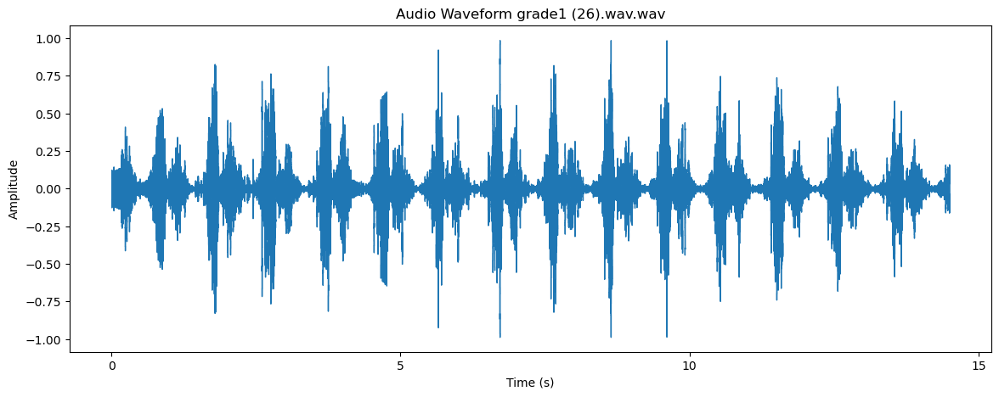

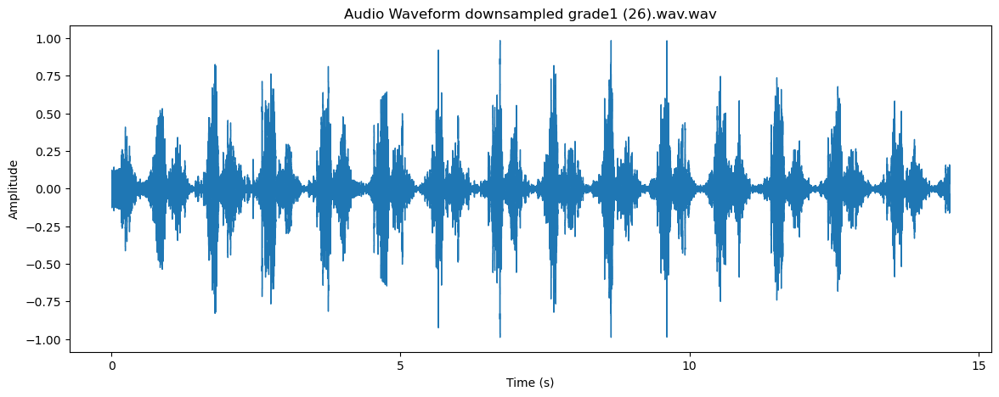

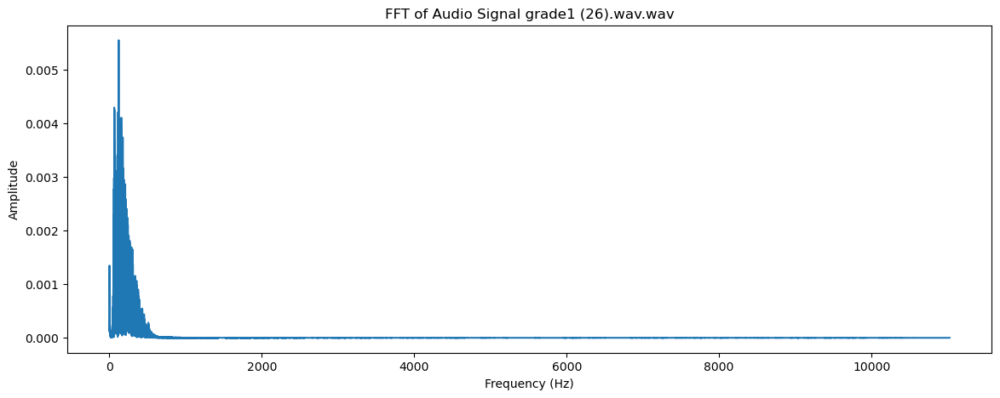

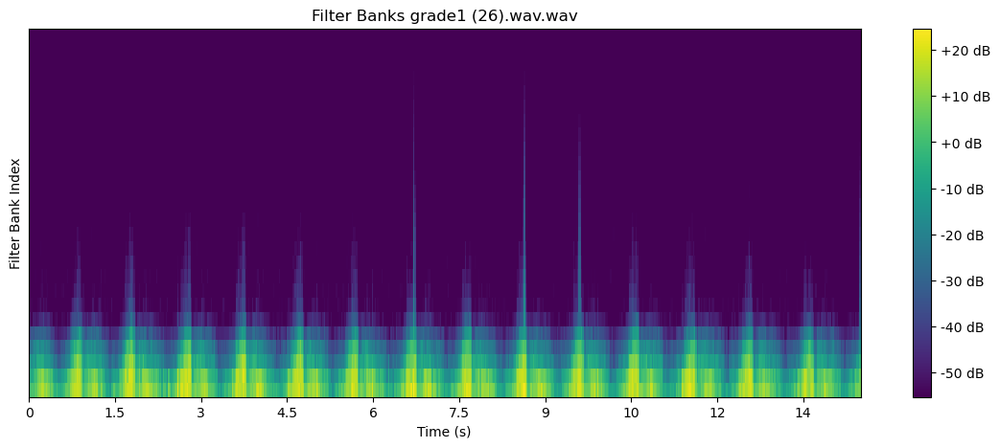

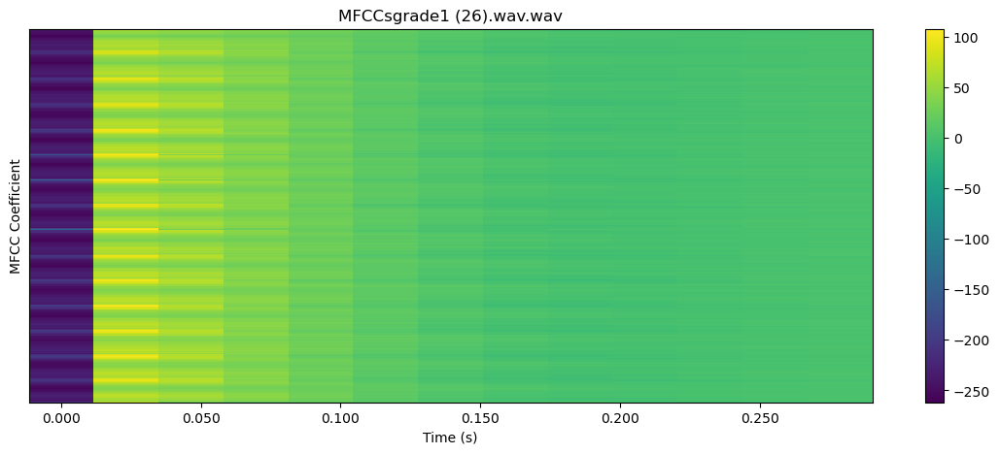


 13%|█▎        | 19/141 [00:31<03:43,  1.83s/it]

22050


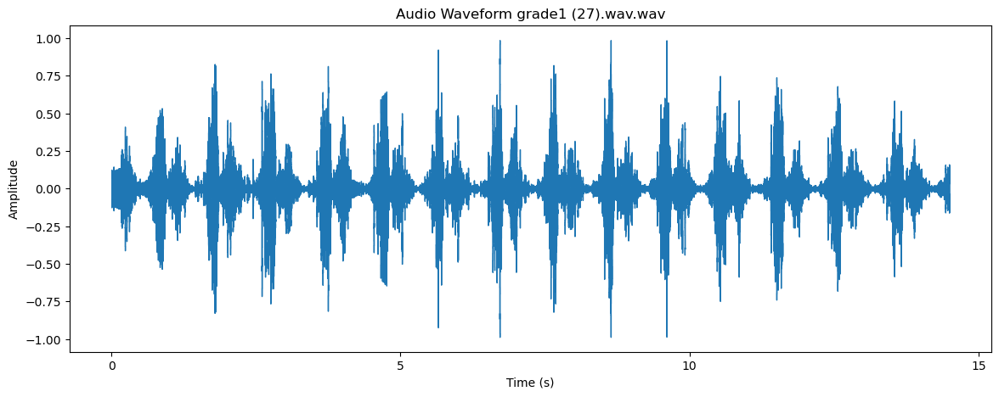

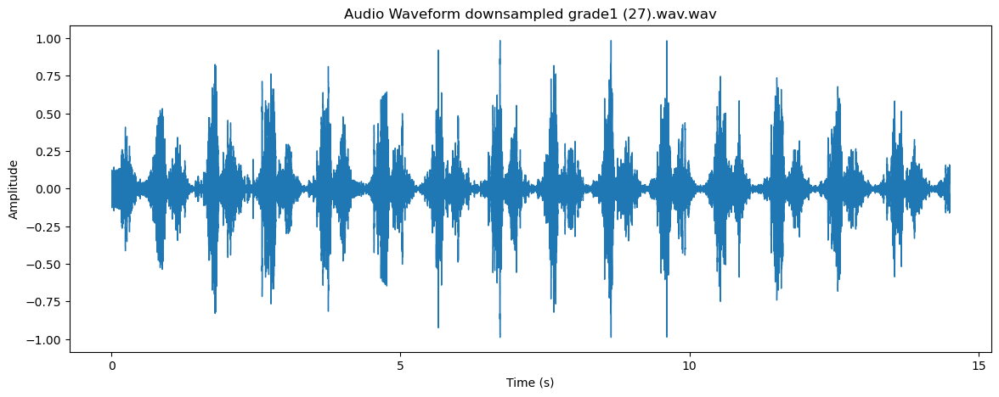

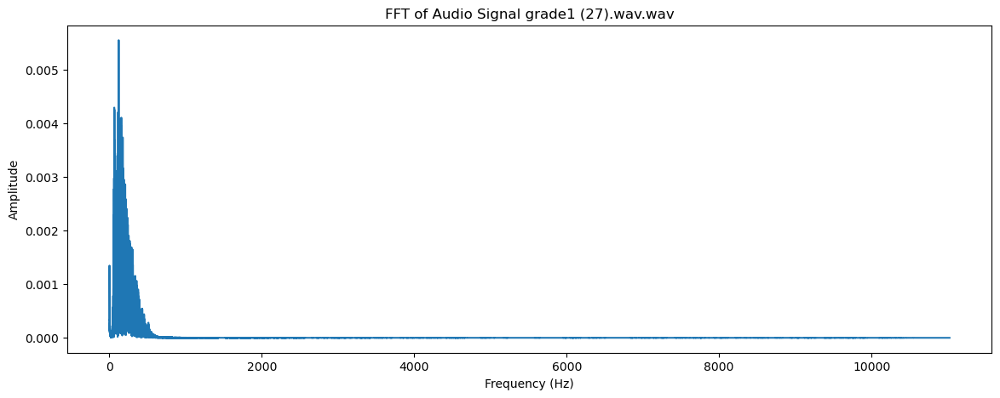

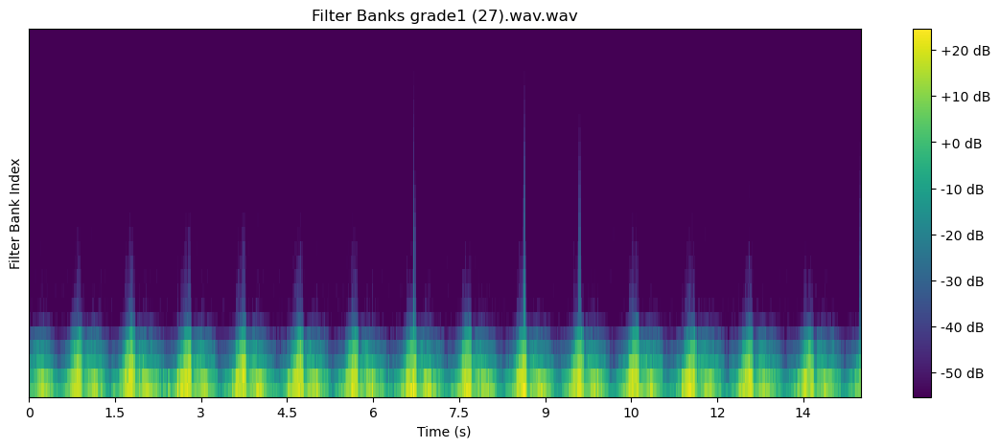

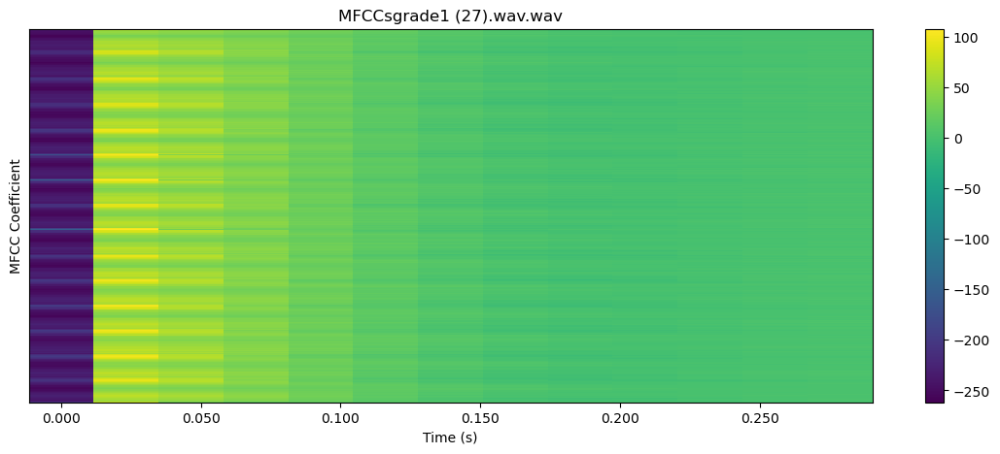


 14%|█▍        | 20/141 [00:32<03:28,  1.73s/it]

22050


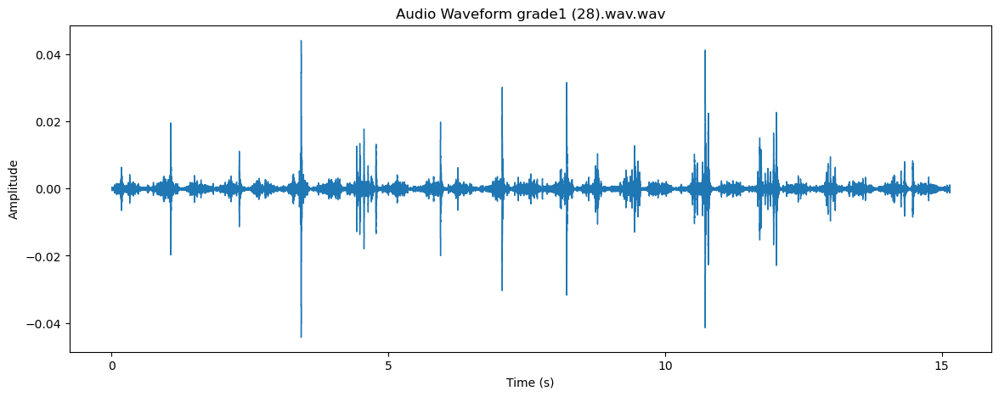

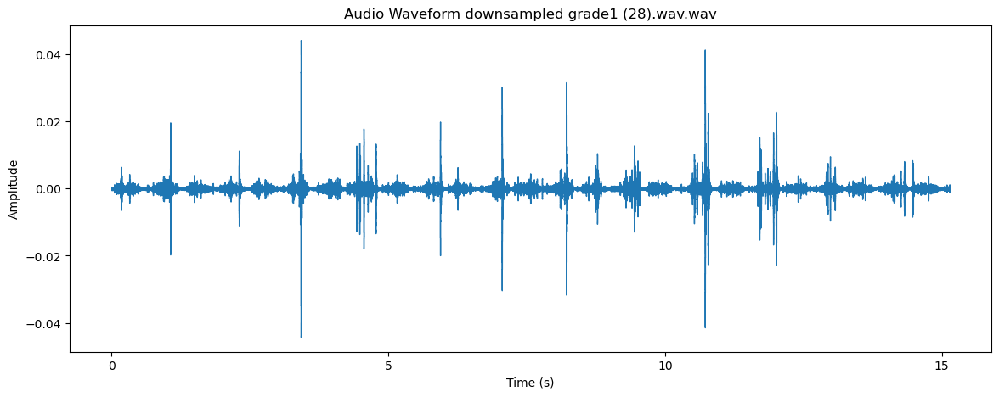

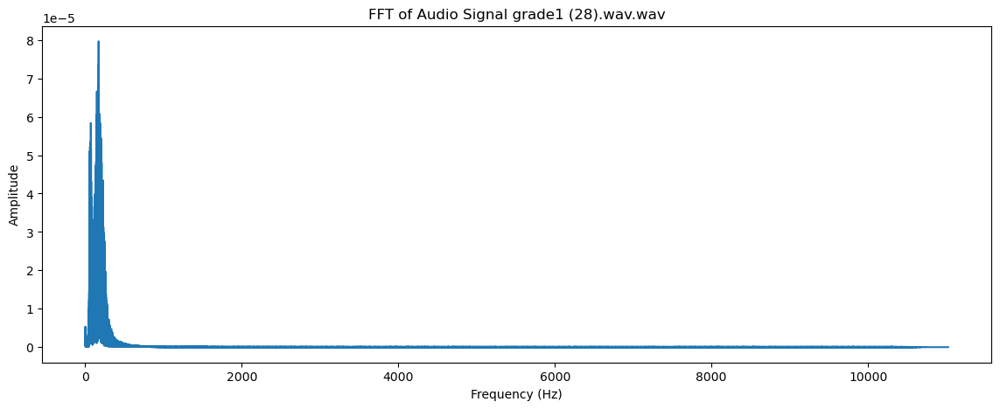

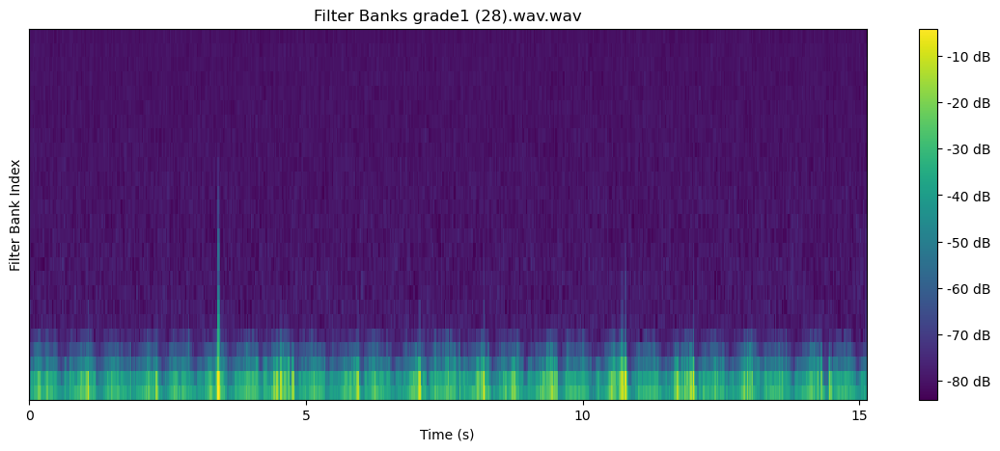

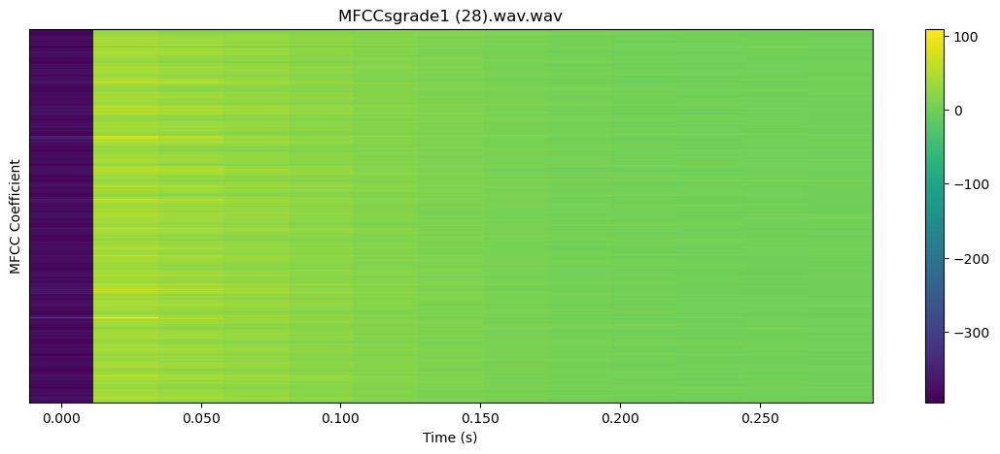


 15%|█▍        | 21/141 [00:34<03:31,  1.76s/it]

22050


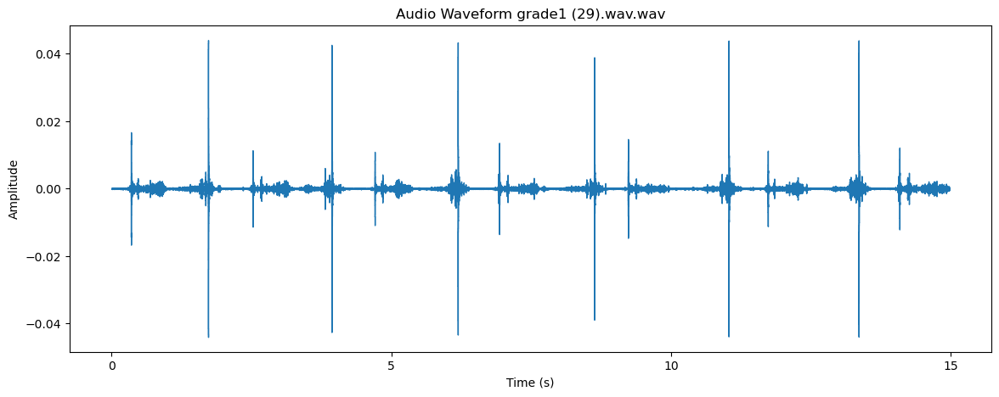

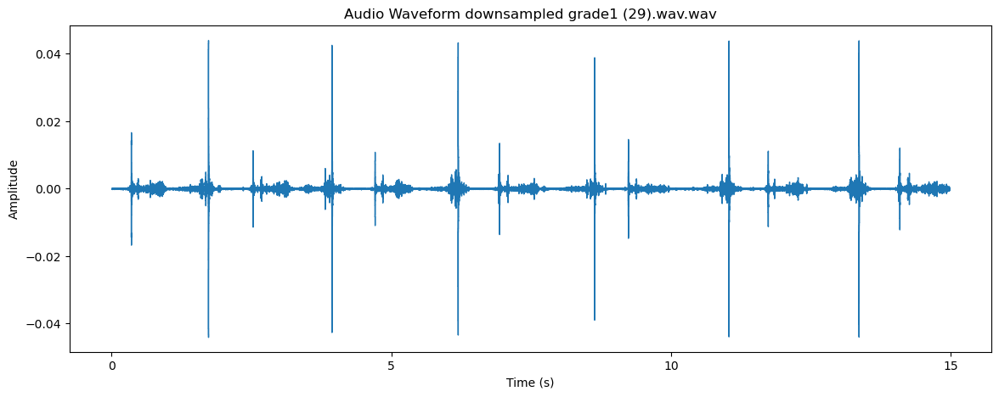

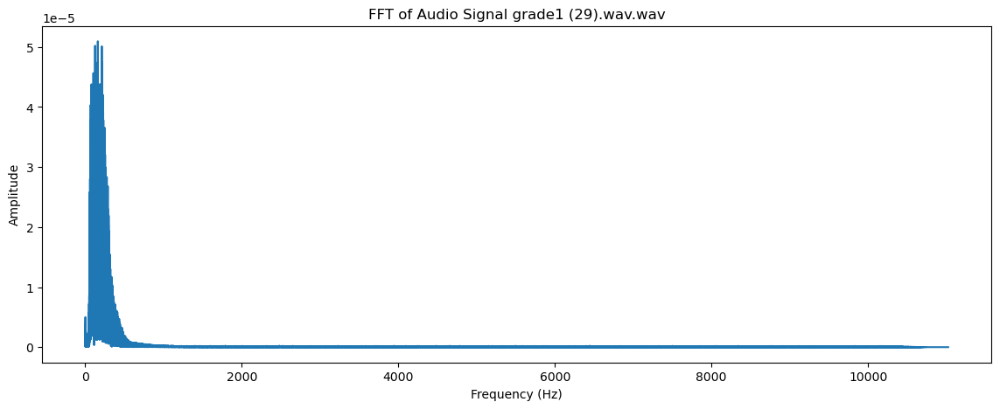

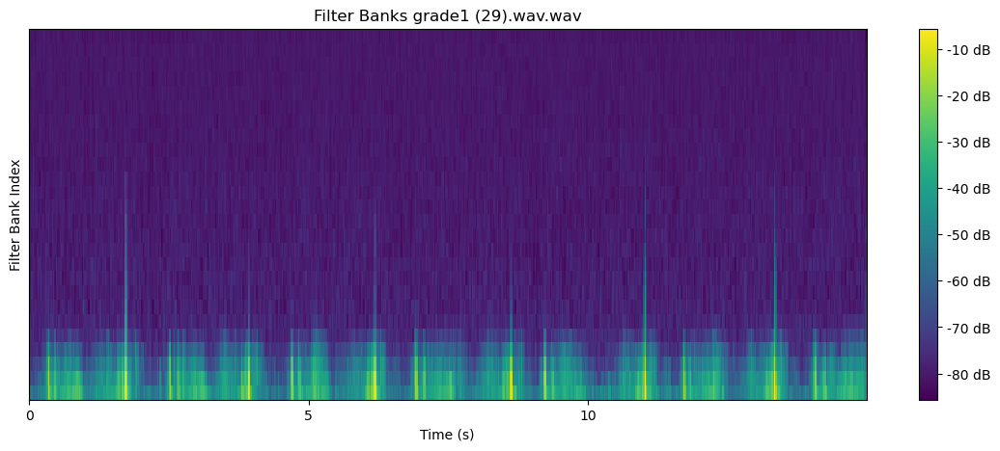

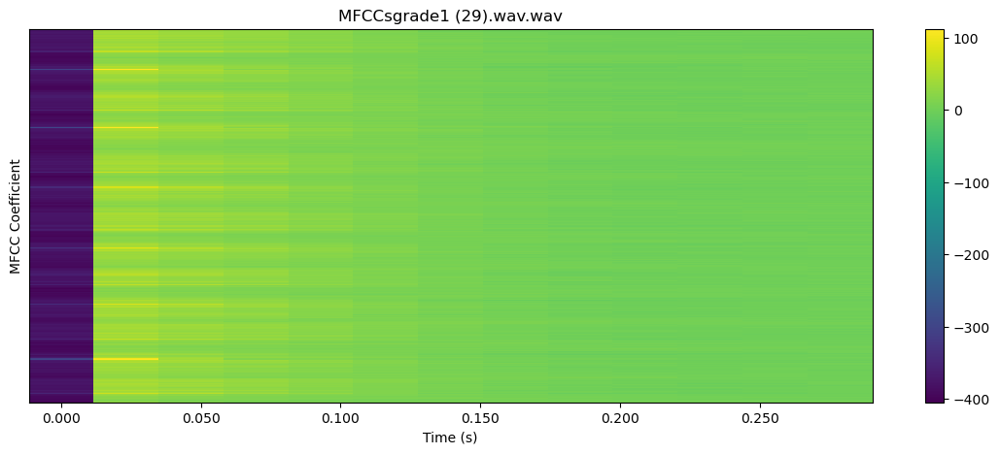


 16%|█▌        | 22/141 [00:35<03:14,  1.63s/it]

22050


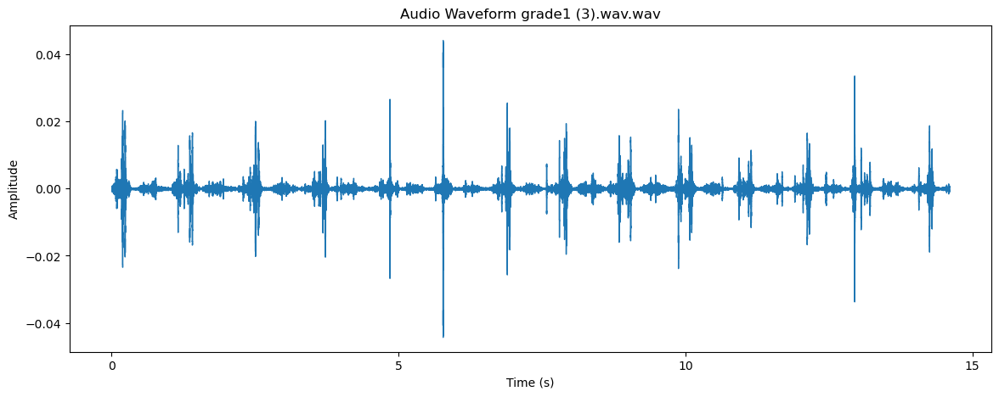

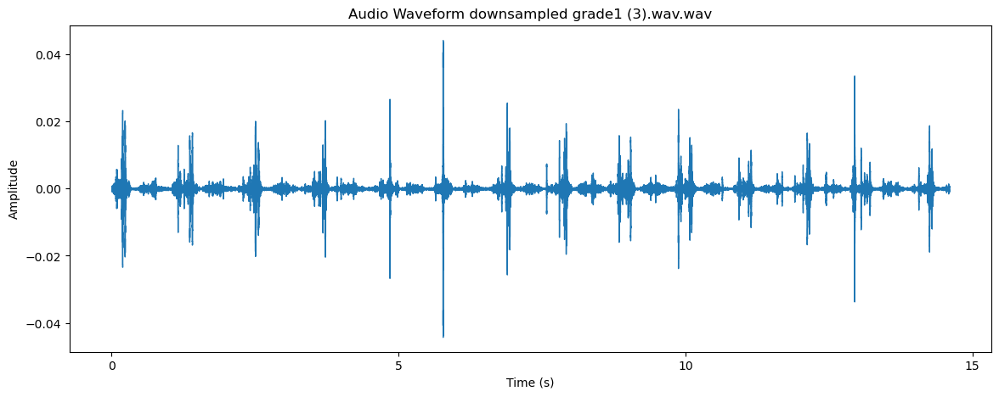

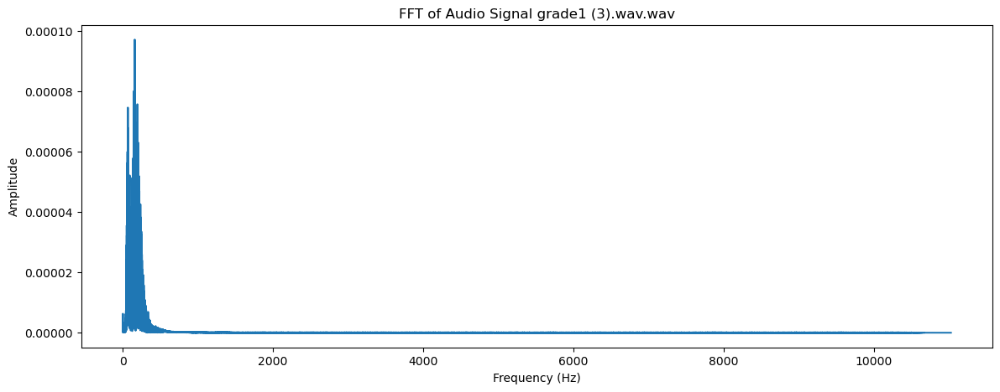

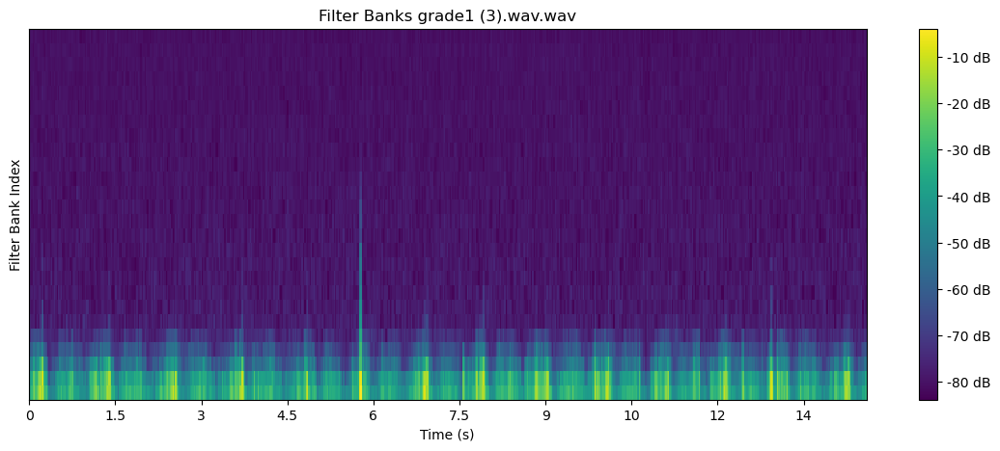

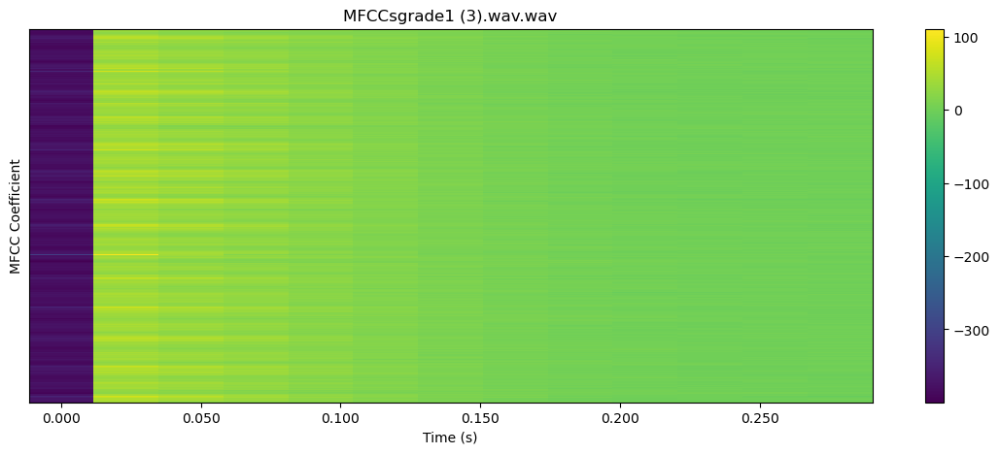


 16%|█▋        | 23/141 [00:37<03:04,  1.56s/it]

22050


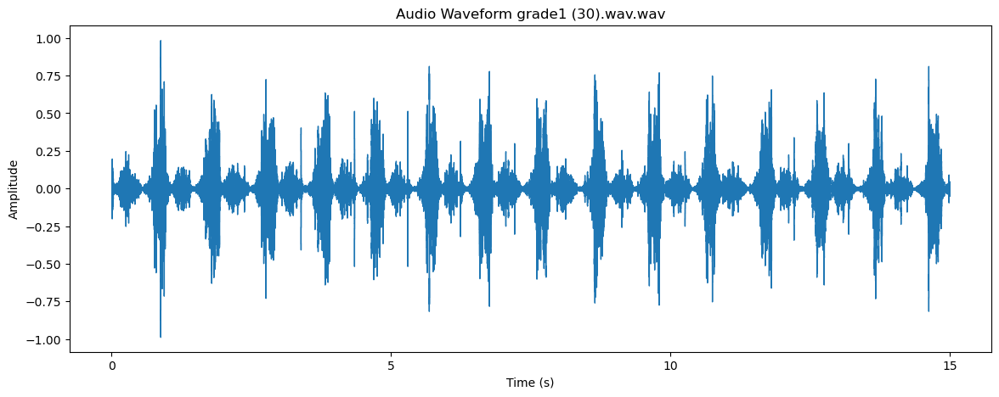

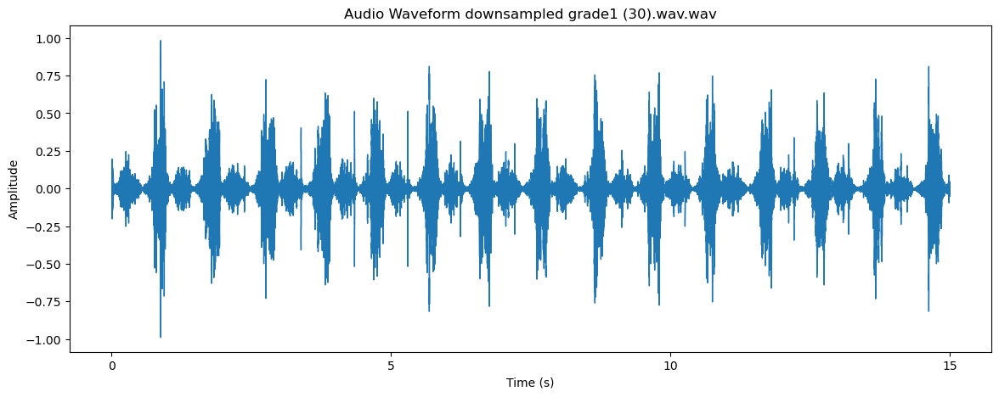

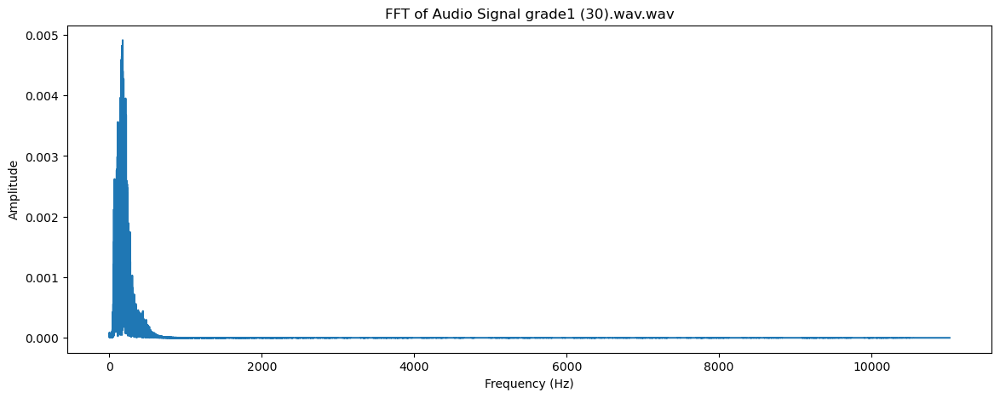

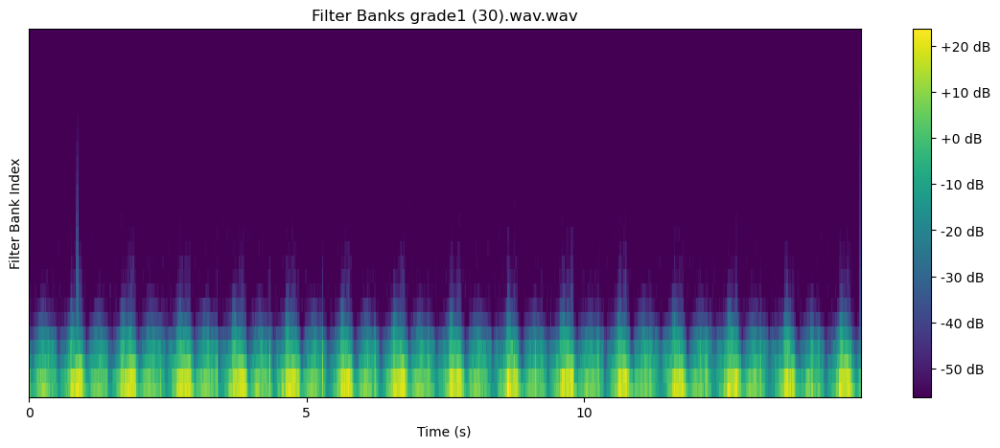

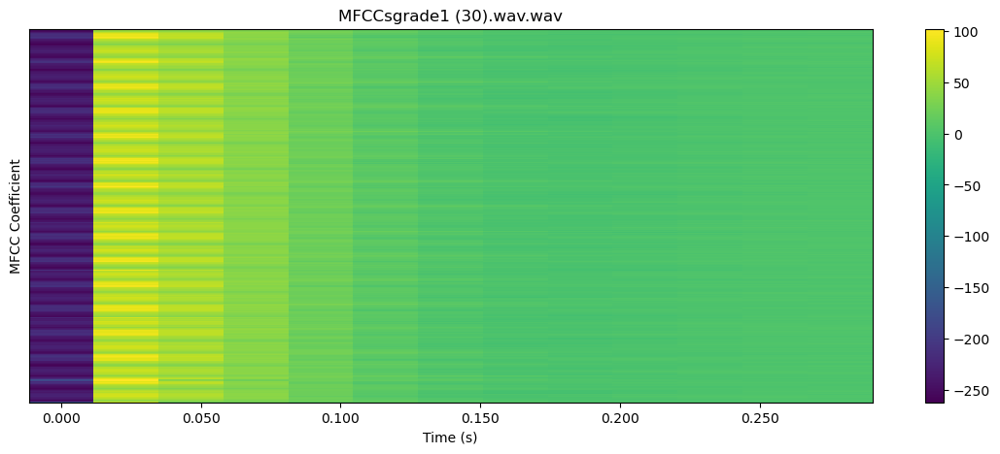


 17%|█▋        | 24/141 [00:38<03:00,  1.54s/it]

22050


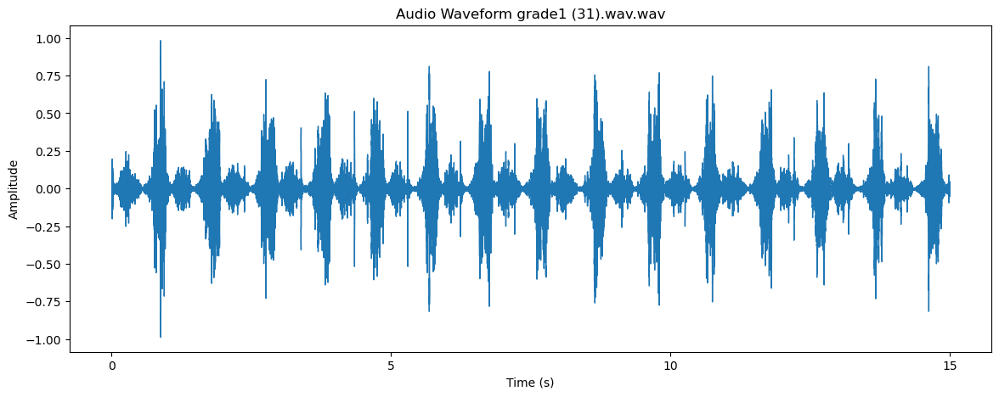

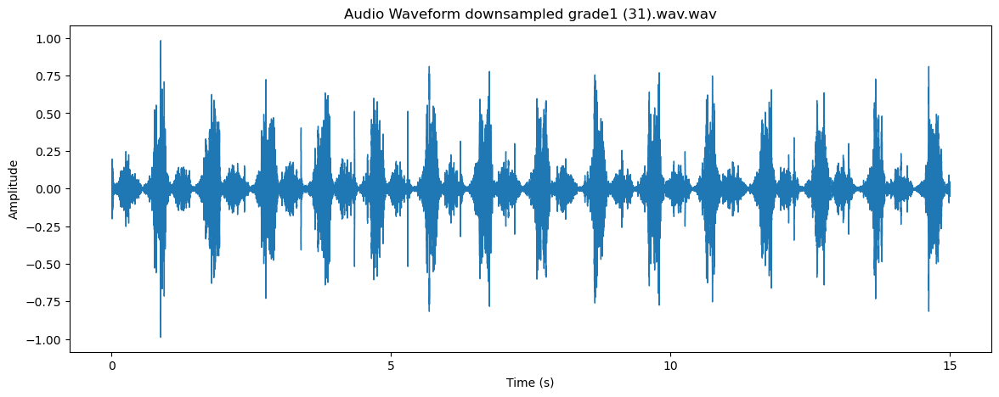

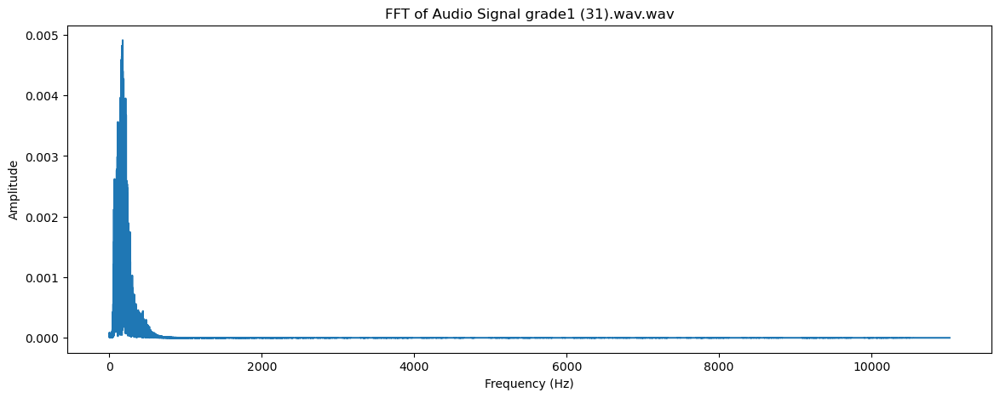

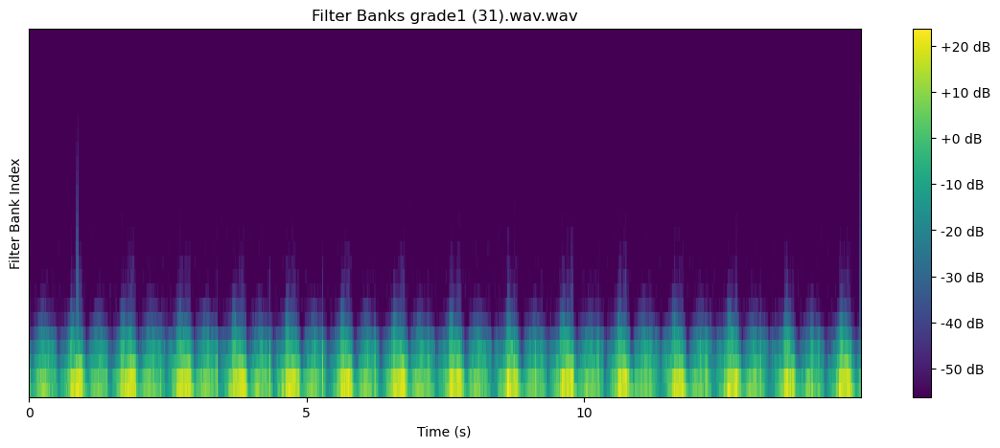

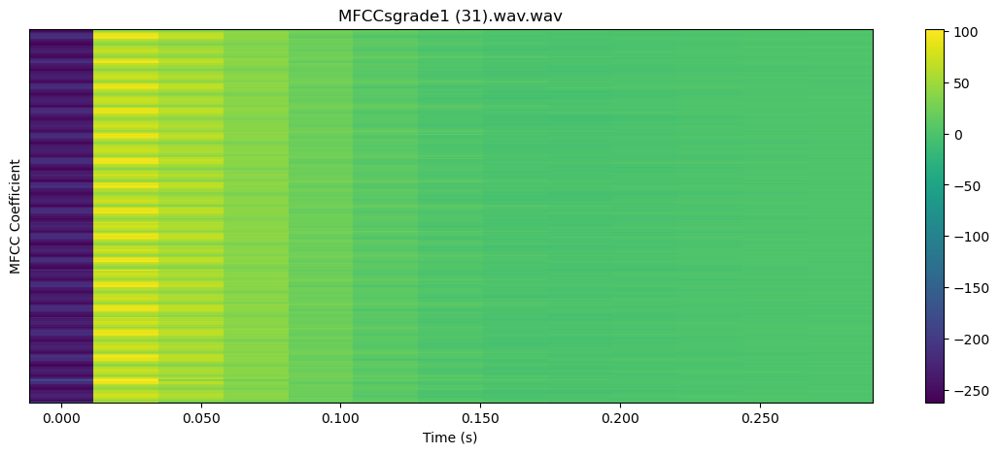


 18%|█▊        | 25/141 [00:40<02:58,  1.54s/it]

22050


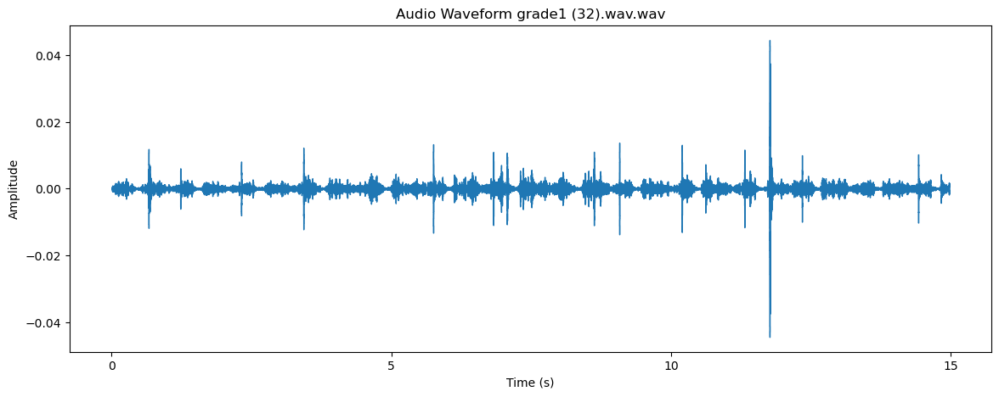

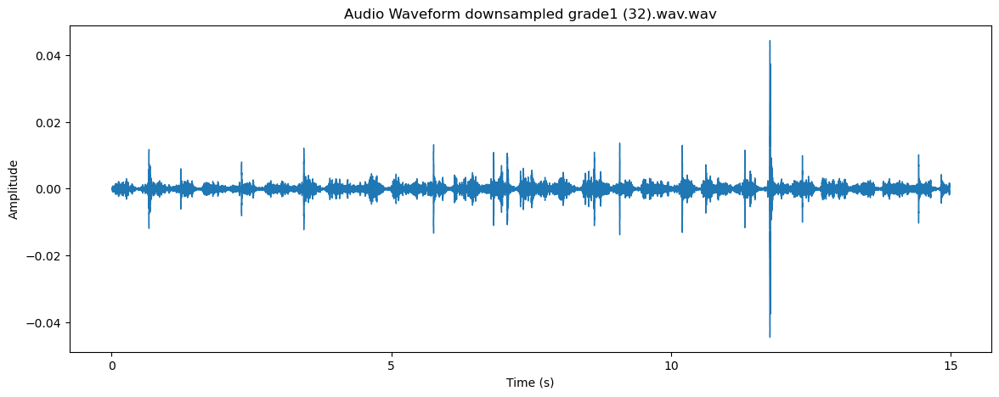

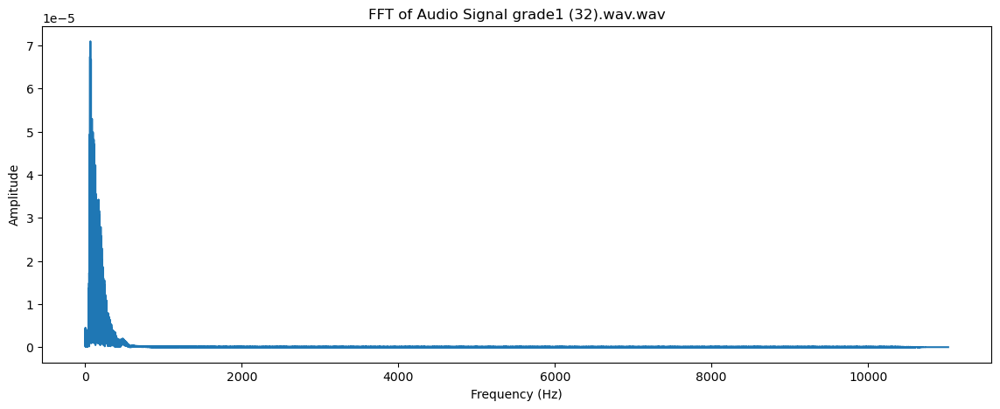

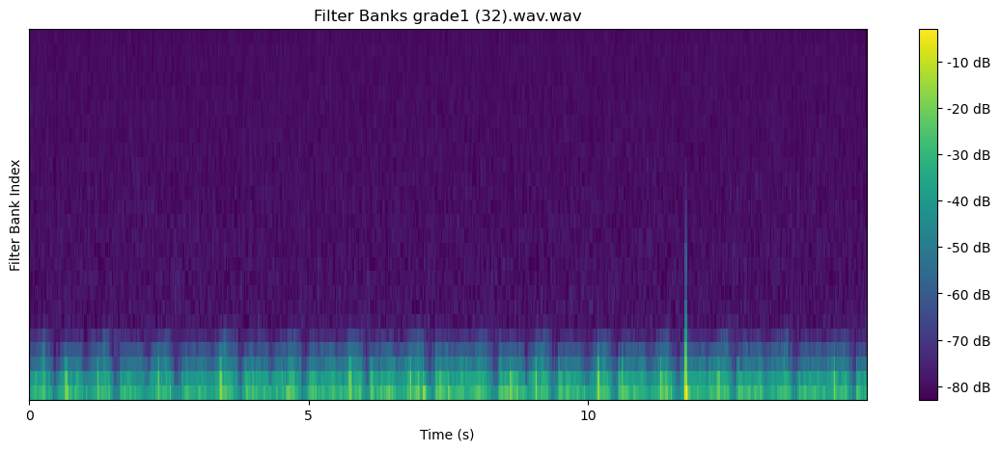

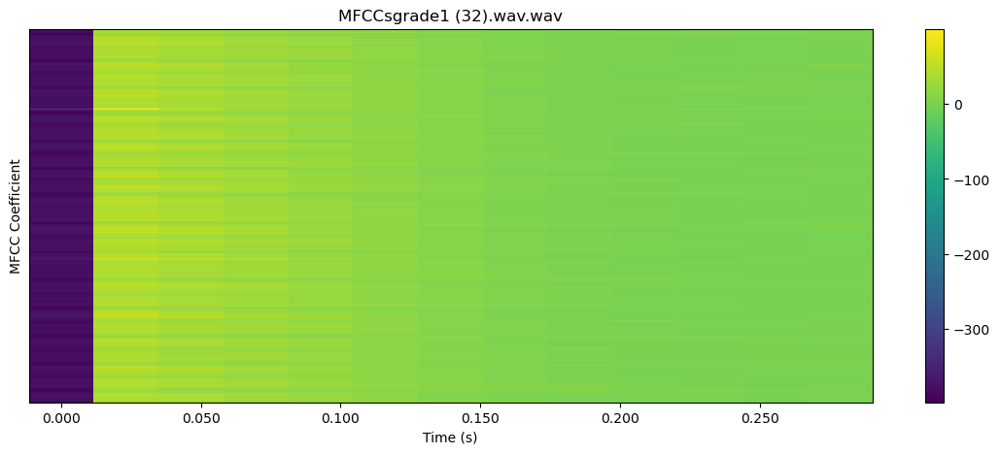


 18%|█▊        | 26/141 [00:42<03:04,  1.60s/it]

22050


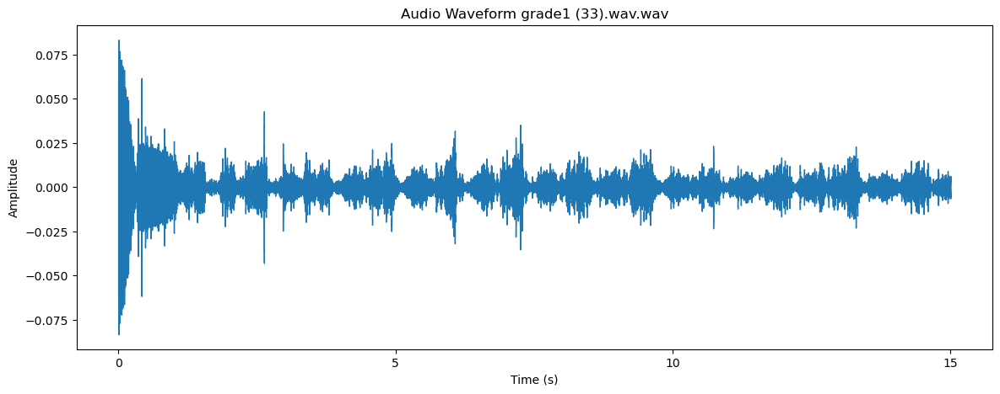

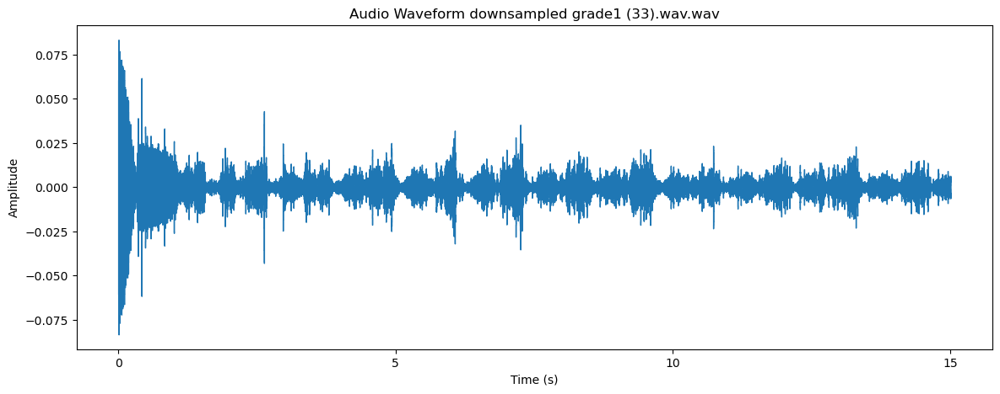

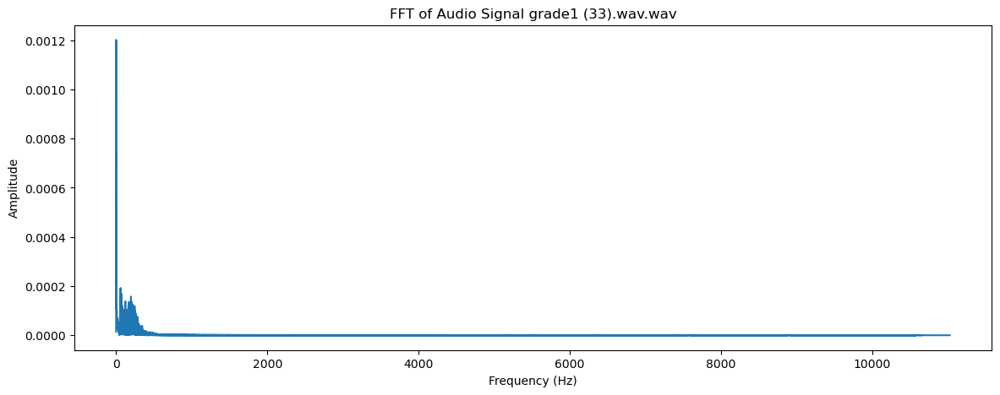

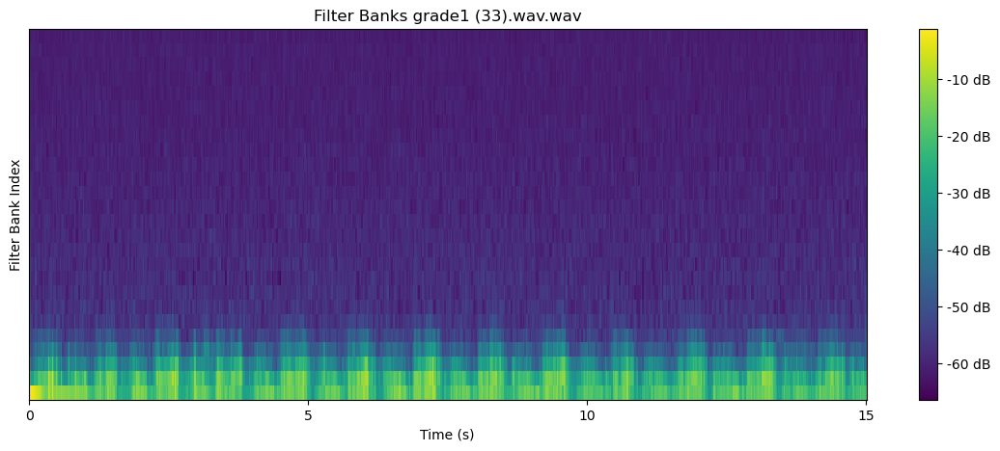

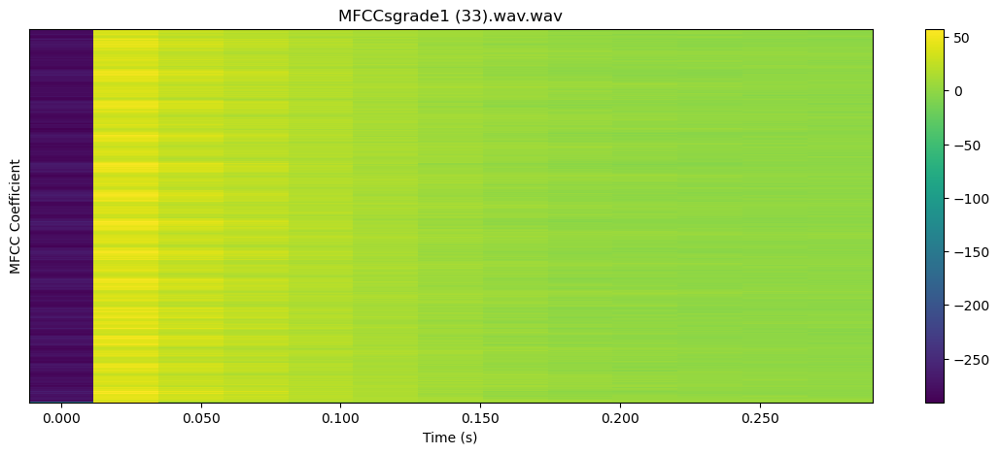


 19%|█▉        | 27/141 [00:43<03:13,  1.70s/it]

22050


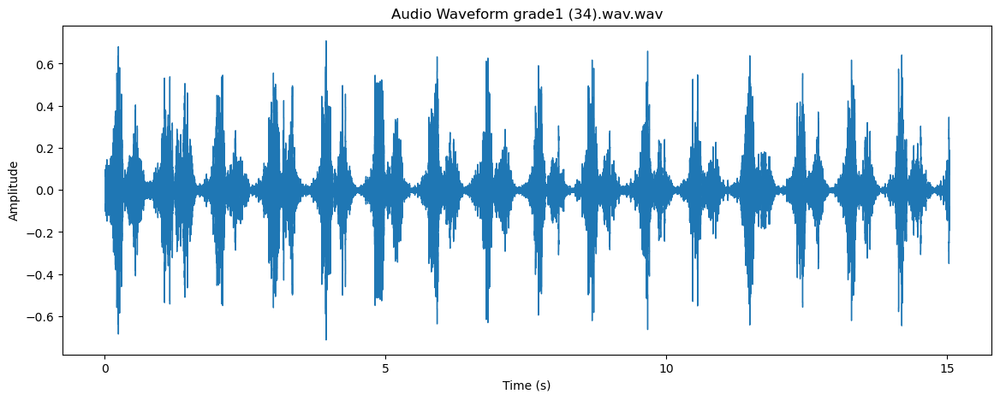

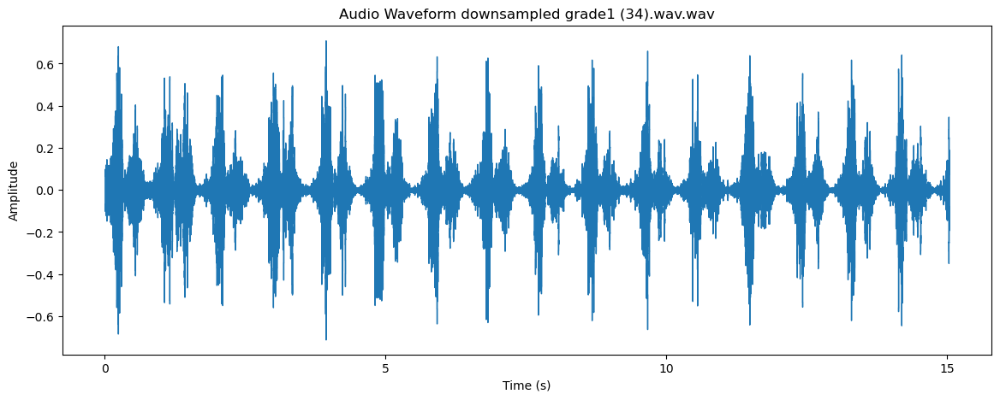

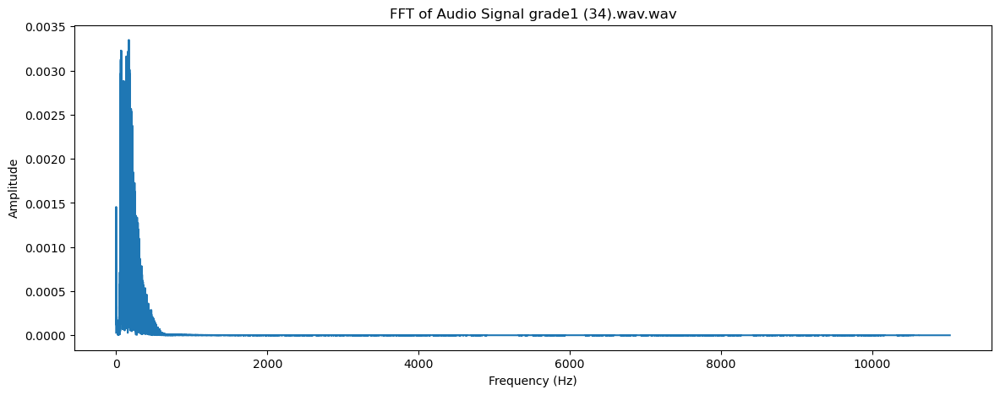

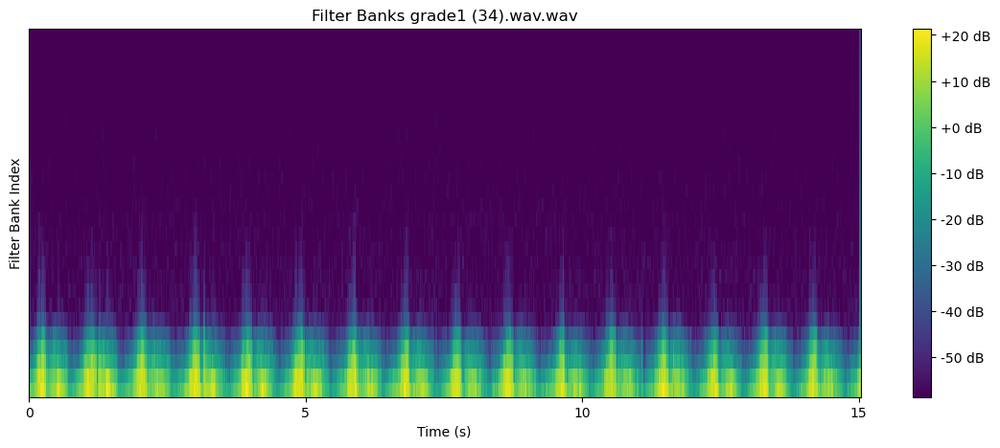

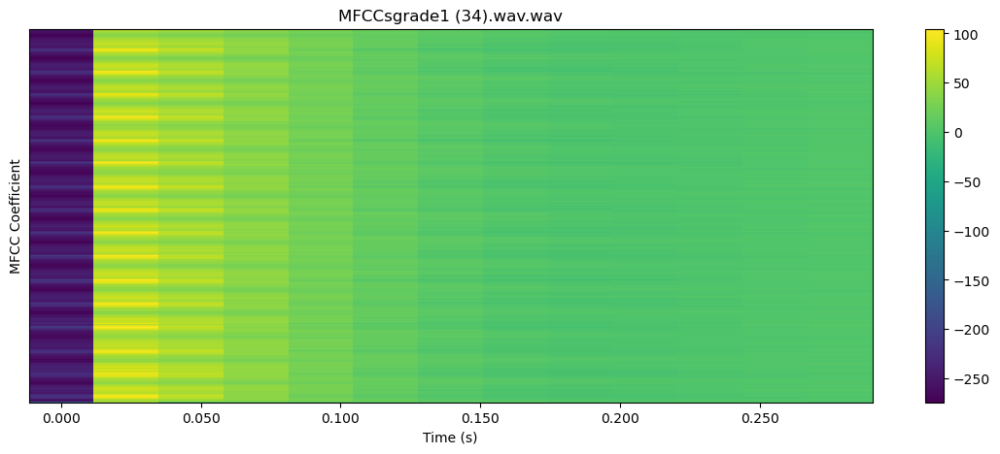


 20%|█▉        | 28/141 [00:45<03:05,  1.64s/it]

22050


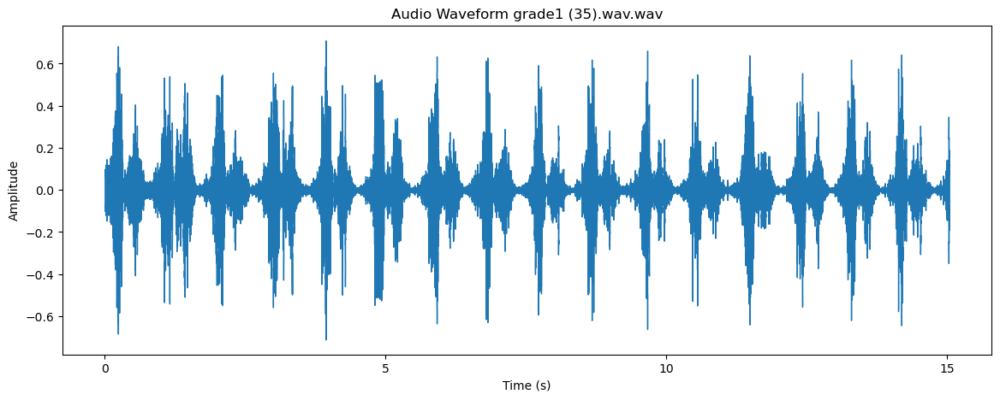

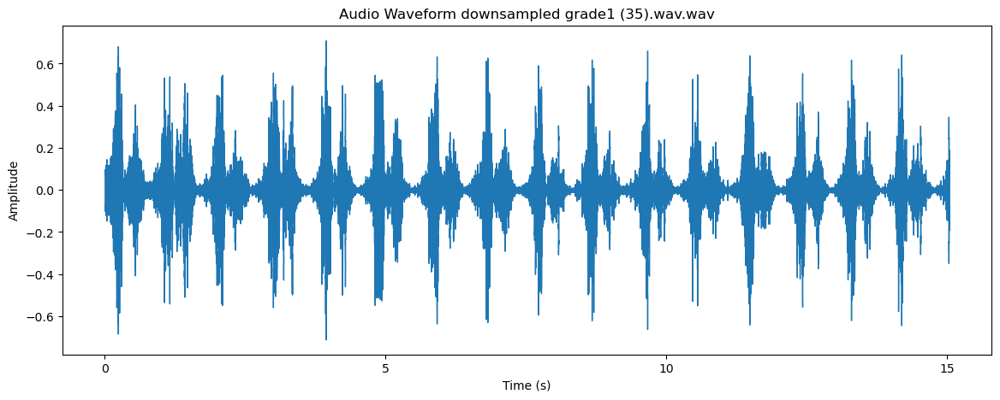

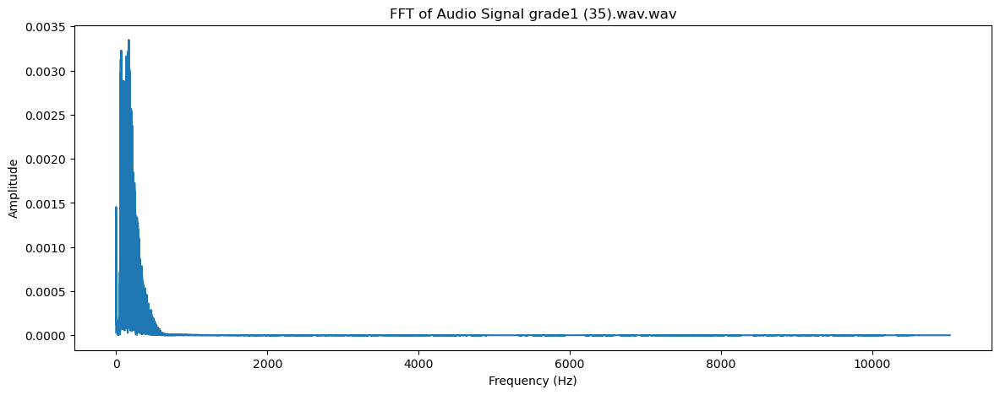

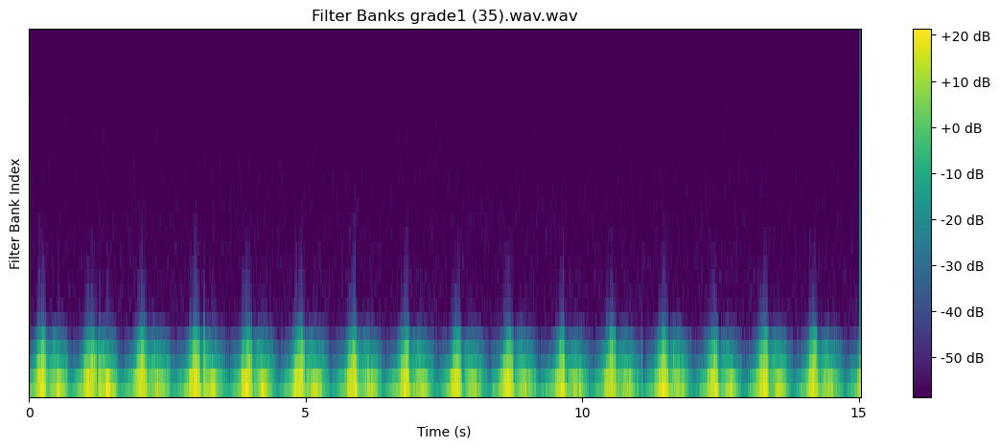

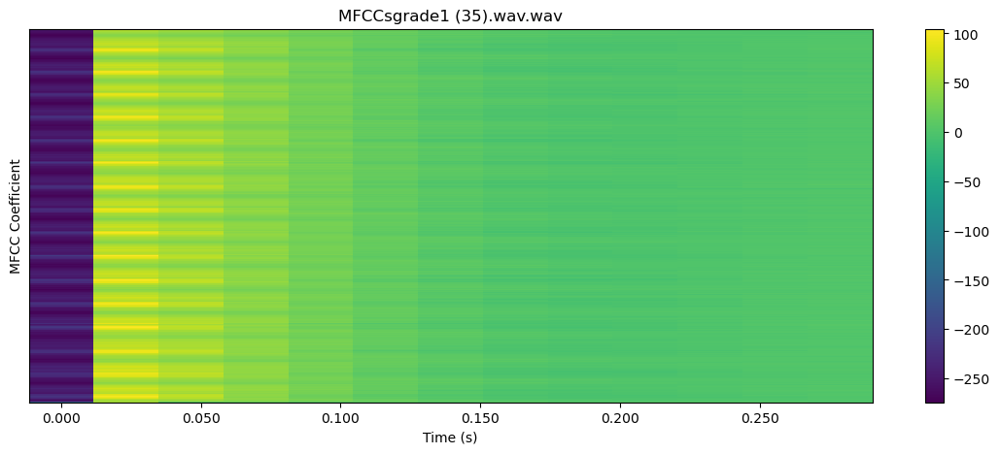


 21%|██        | 29/141 [00:47<03:01,  1.62s/it]

22050


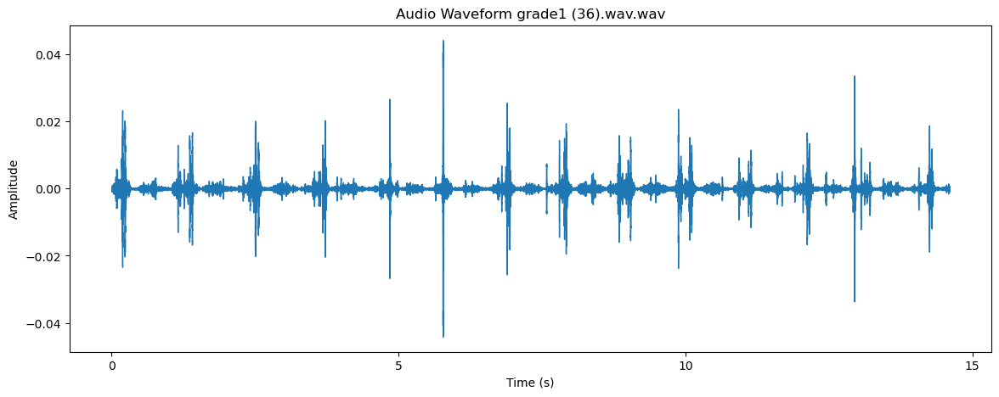

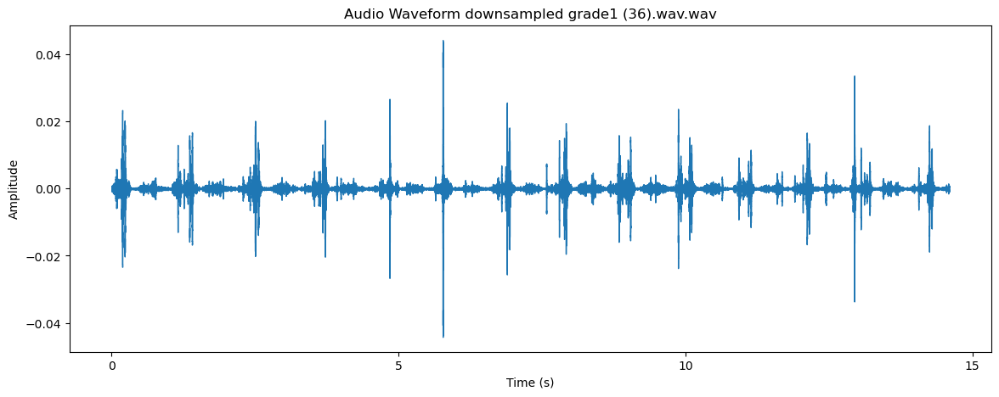

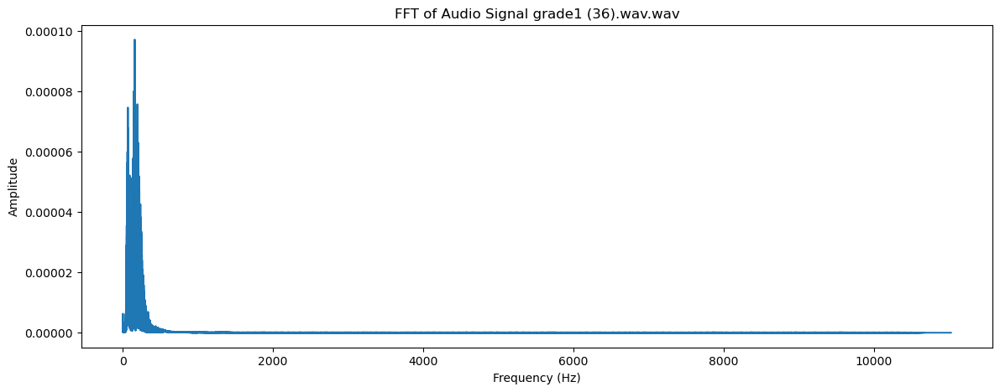

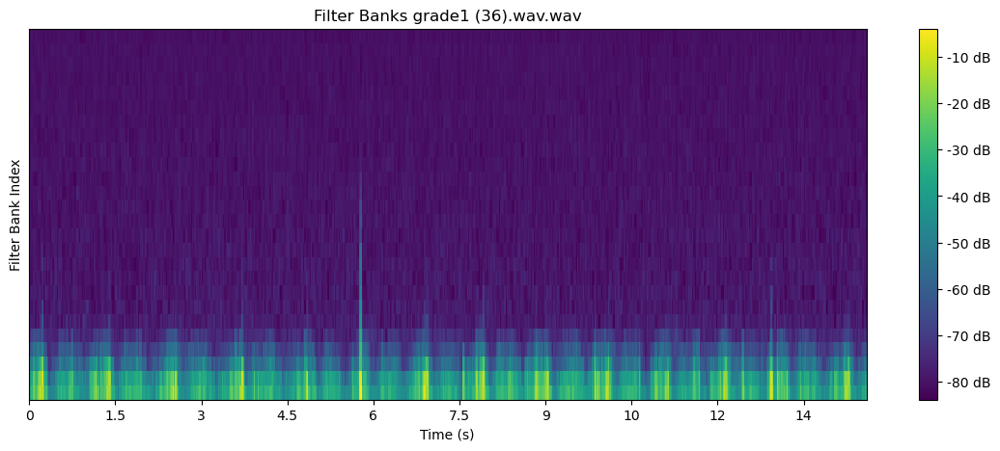

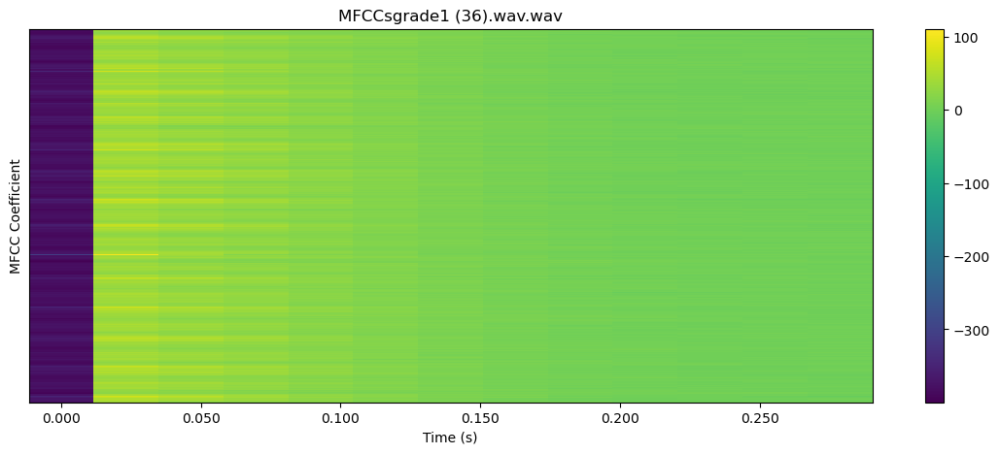


 21%|██▏       | 30/141 [00:48<03:02,  1.65s/it]

22050


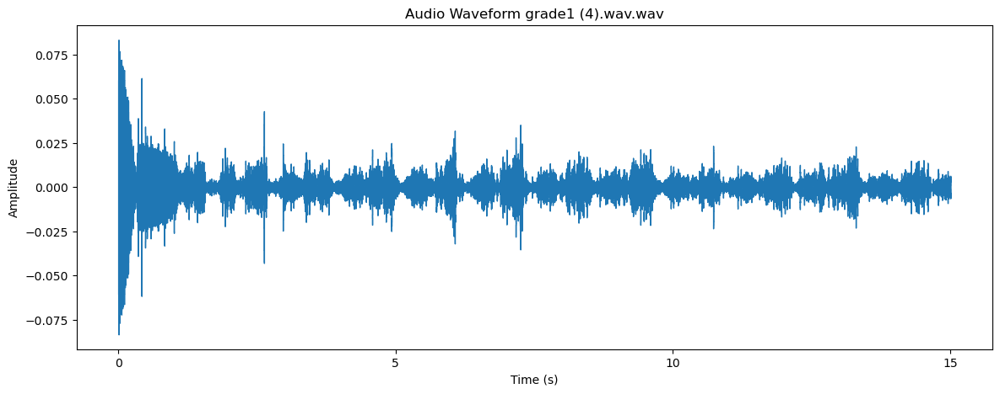

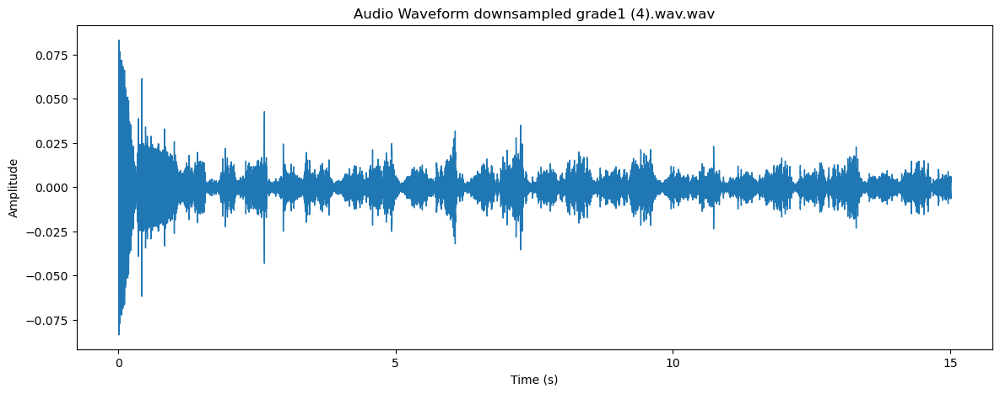

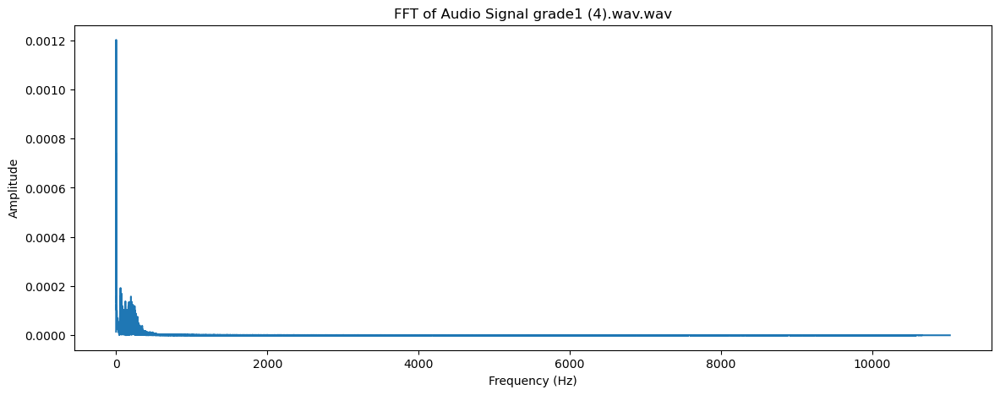

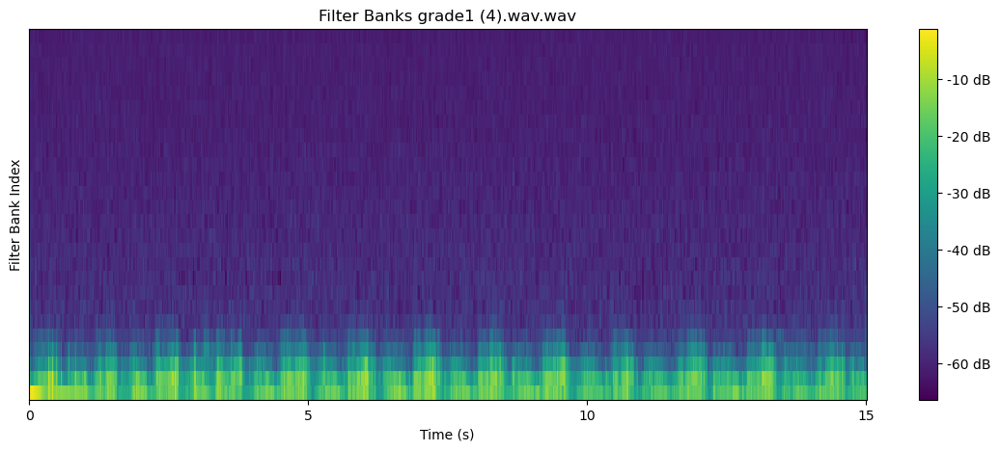

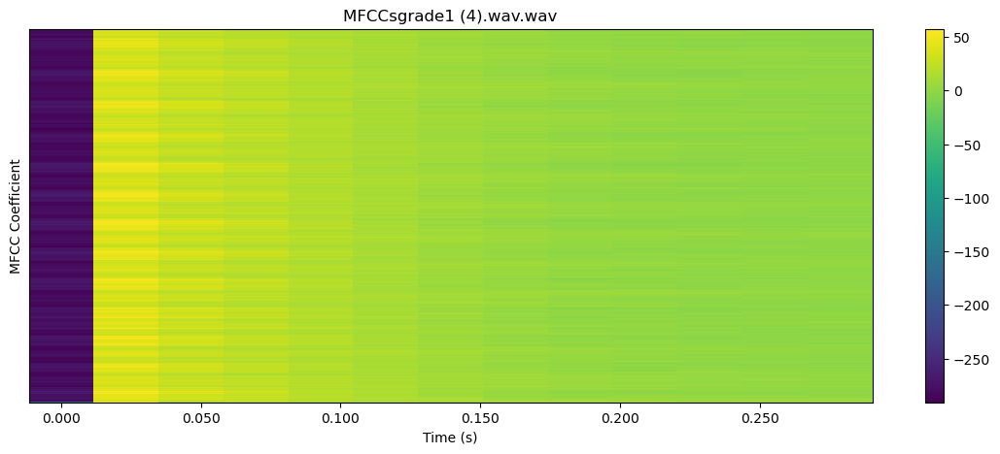


 22%|██▏       | 31/141 [00:50<02:53,  1.58s/it]

22050


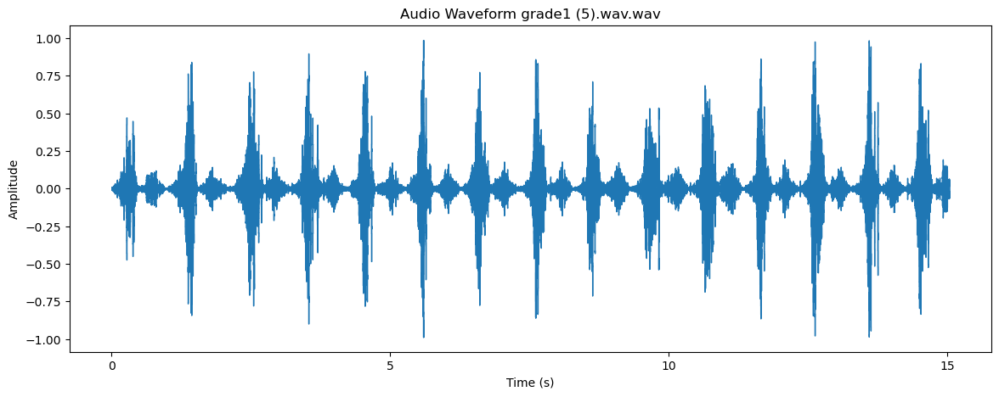

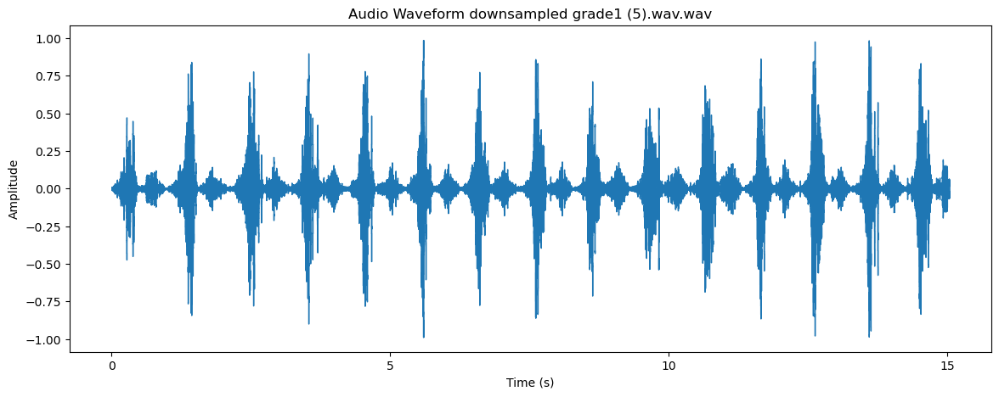

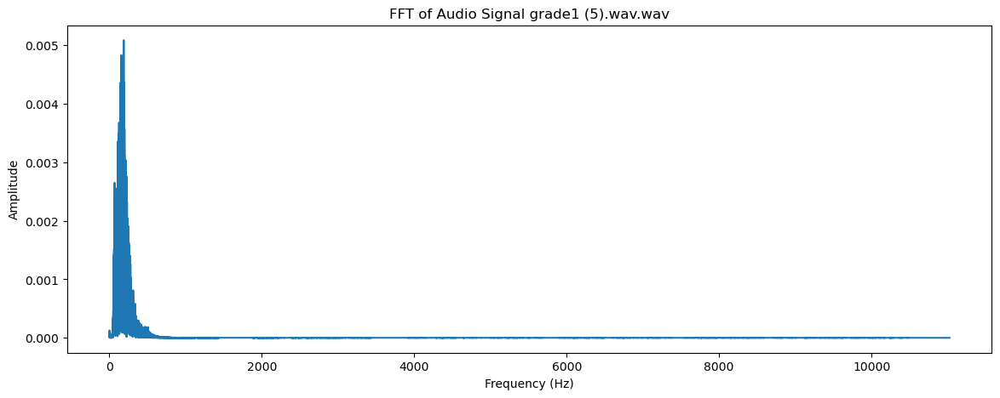

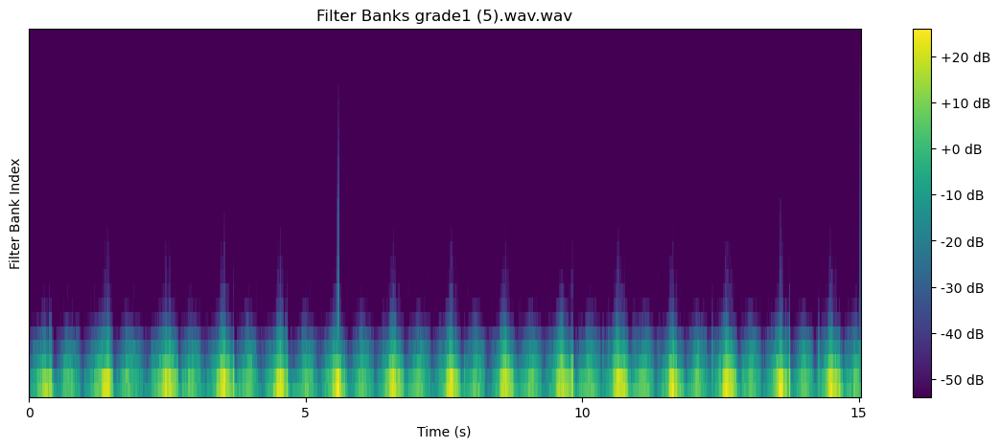

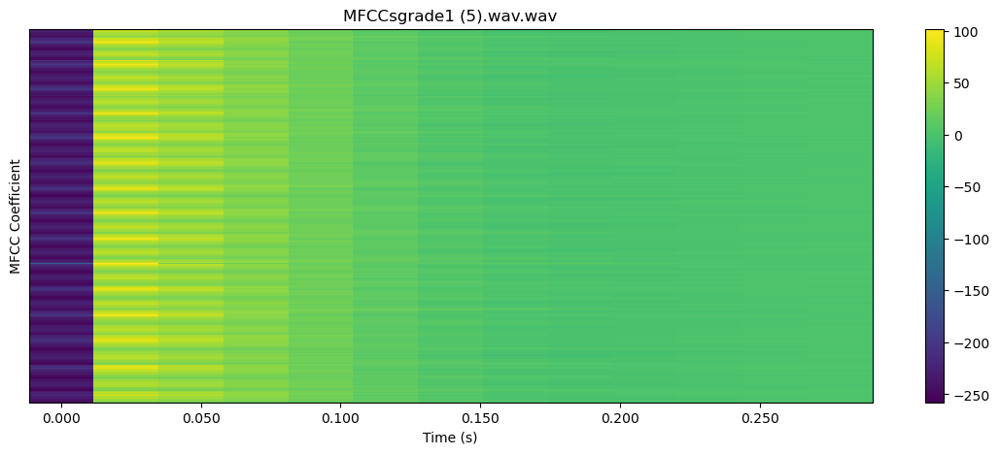


 23%|██▎       | 32/141 [00:51<02:47,  1.53s/it]

22050


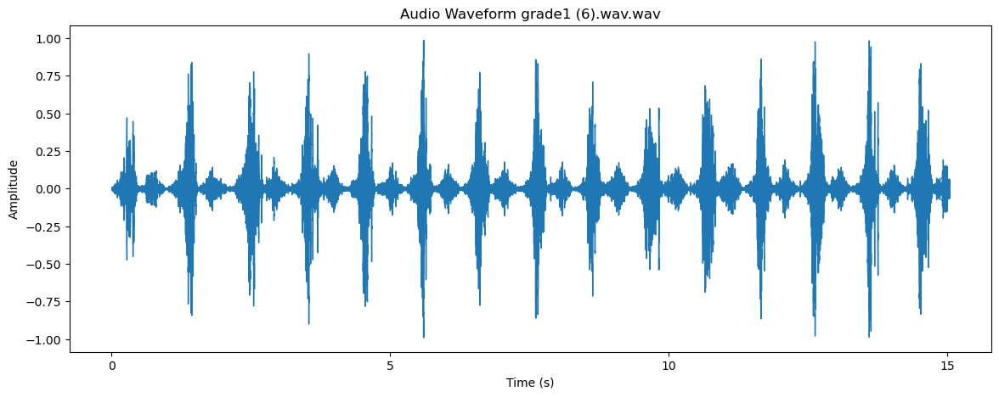

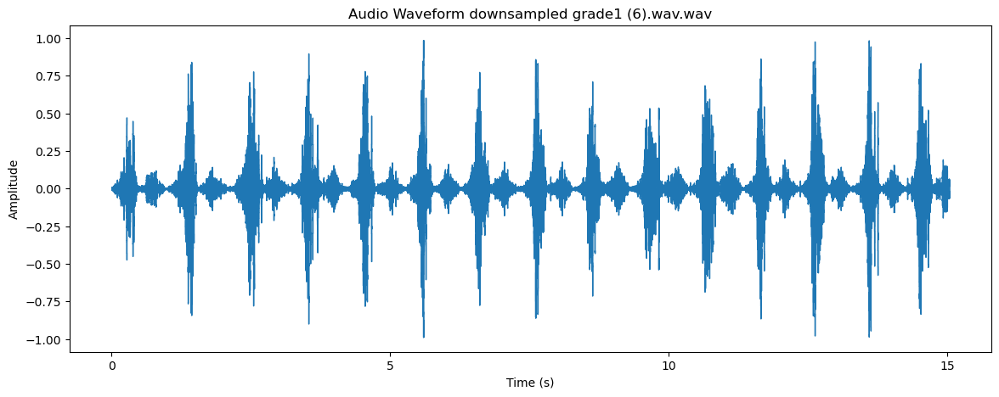

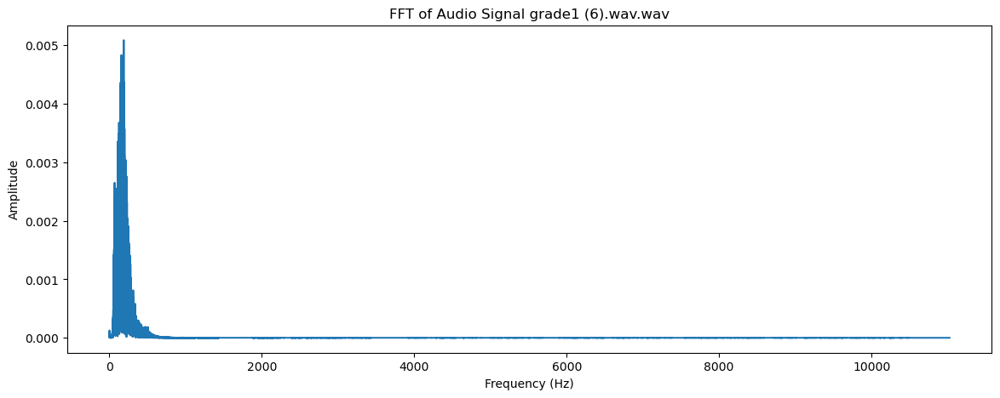

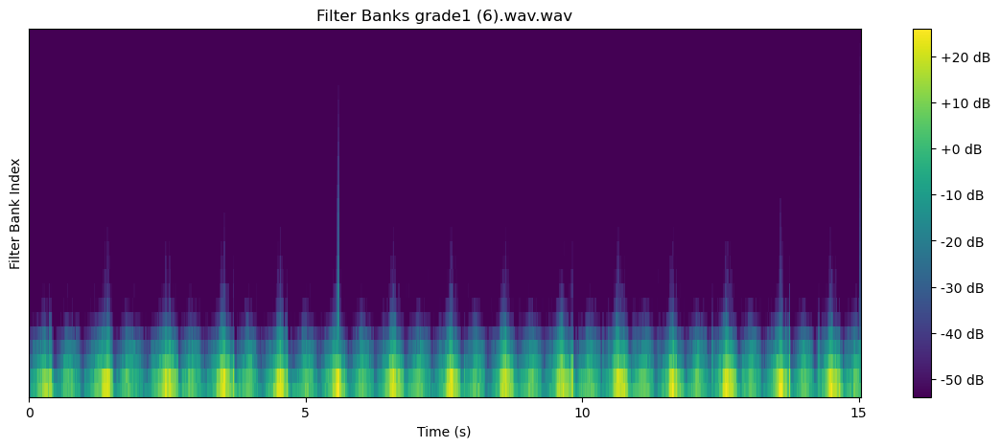

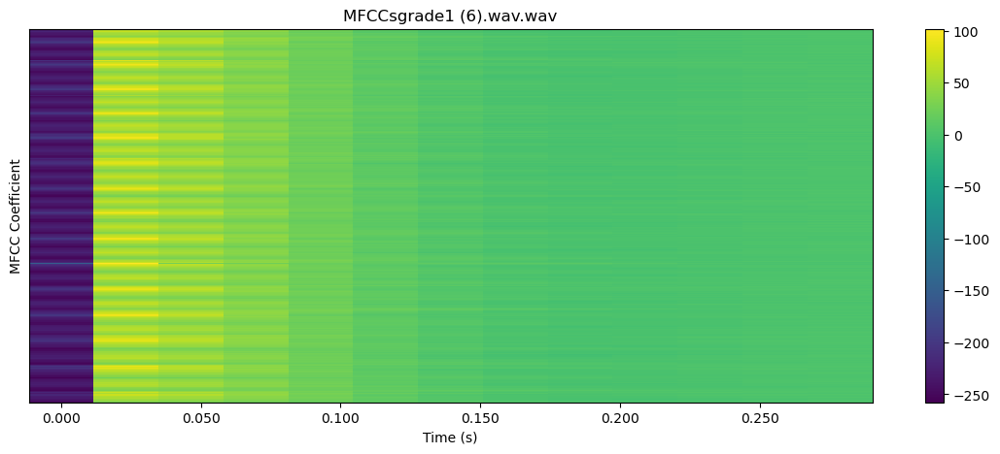


 23%|██▎       | 33/141 [00:52<02:41,  1.50s/it]

22050


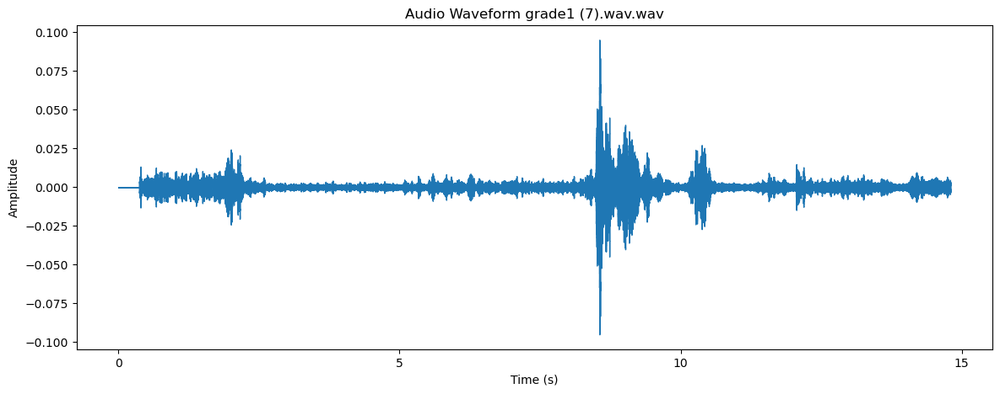

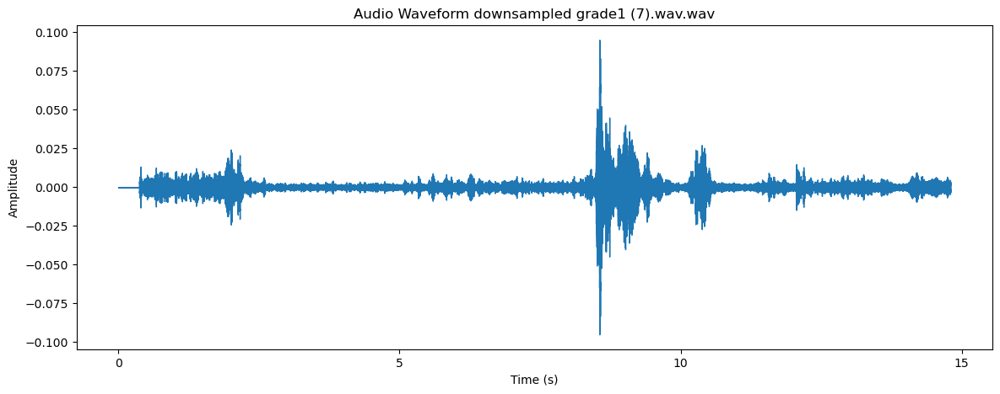

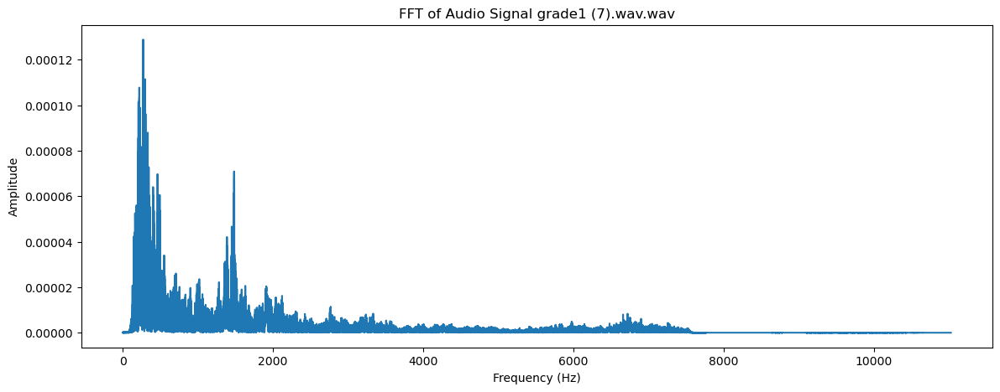

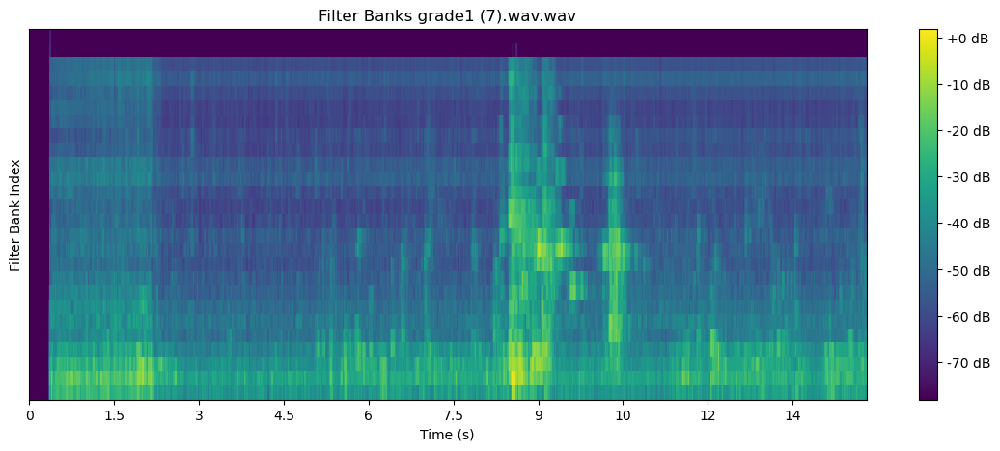

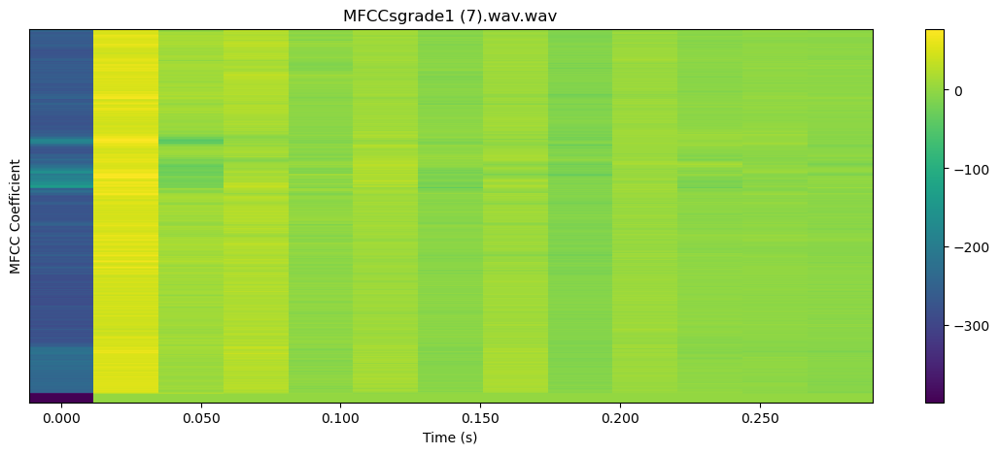


 24%|██▍       | 34/141 [00:54<02:38,  1.48s/it]

22050


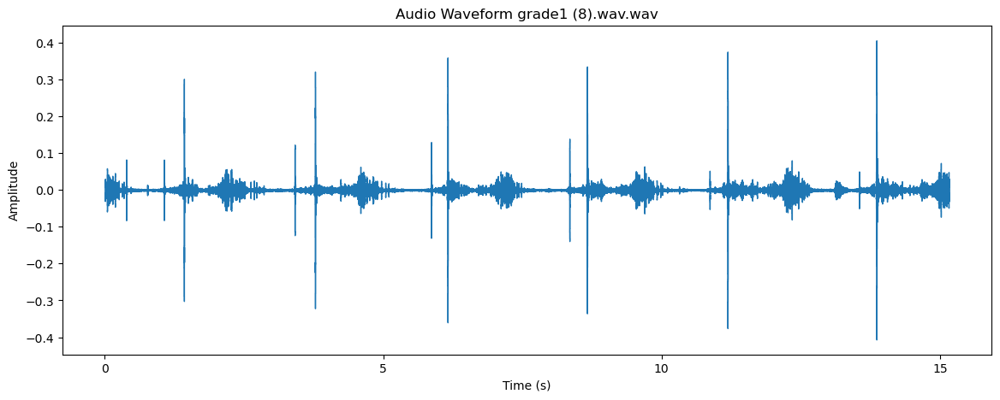

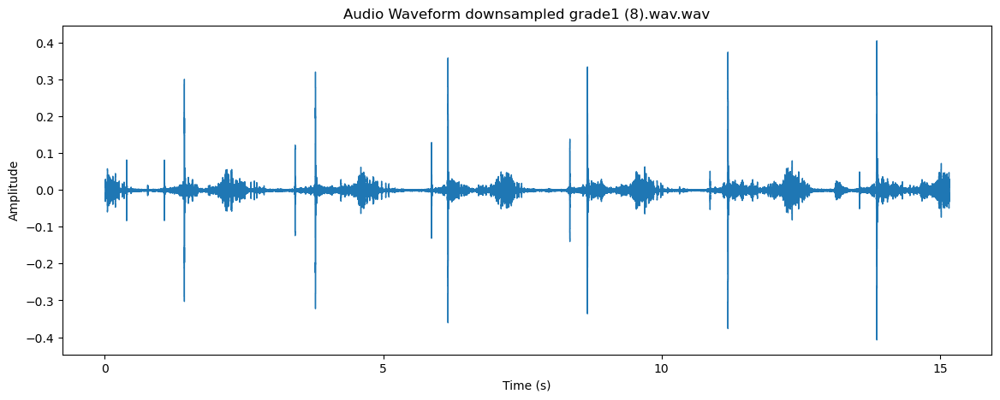

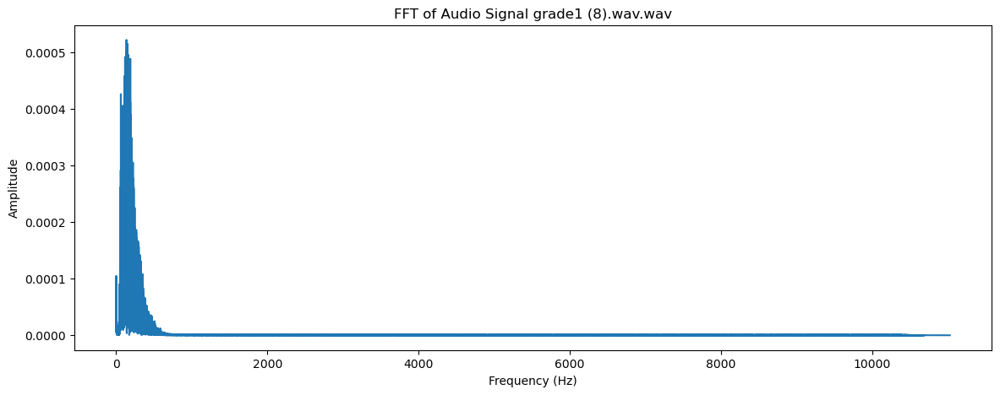

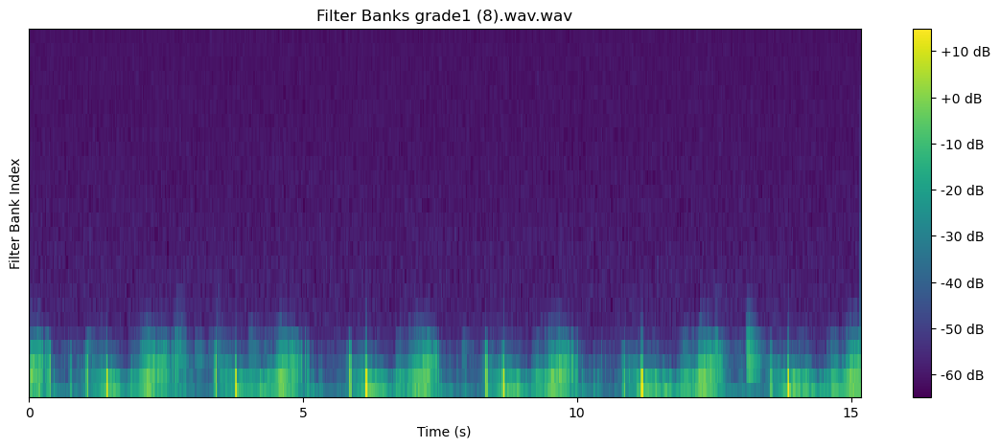

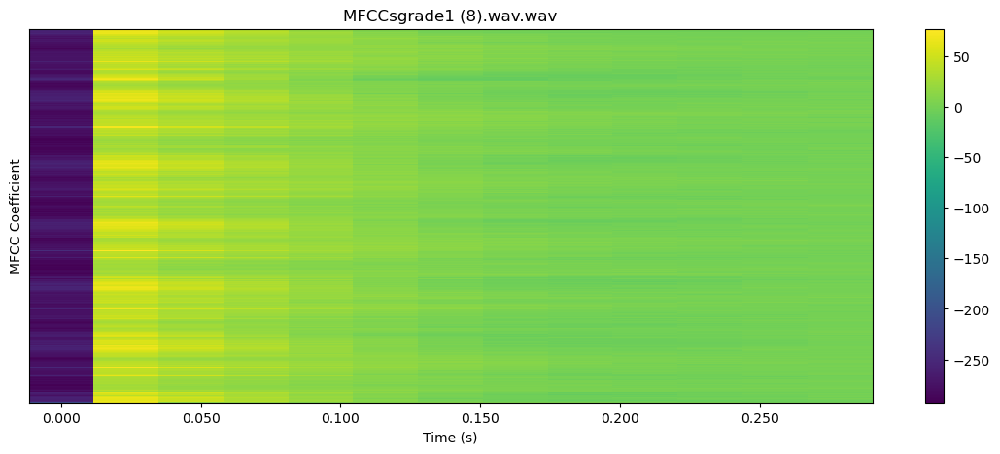


 25%|██▍       | 35/141 [00:55<02:36,  1.48s/it]

22050


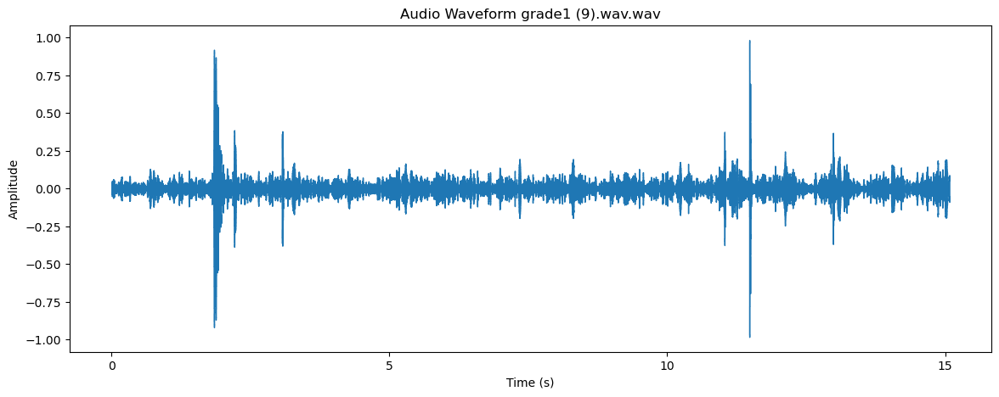

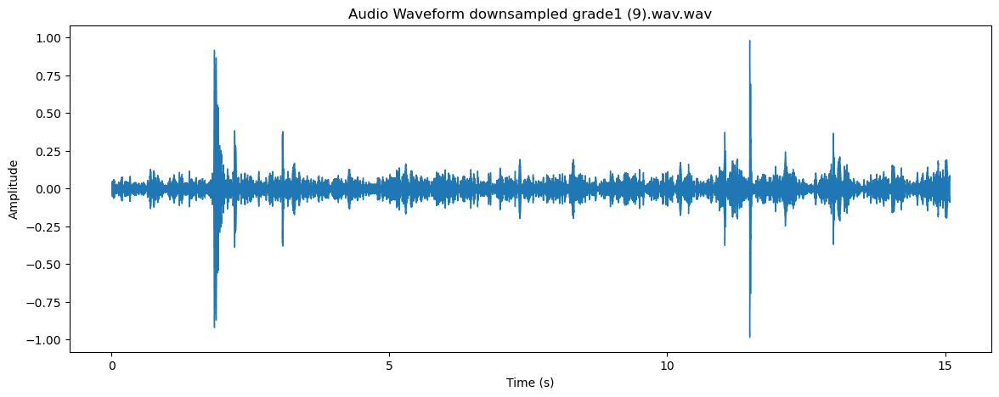

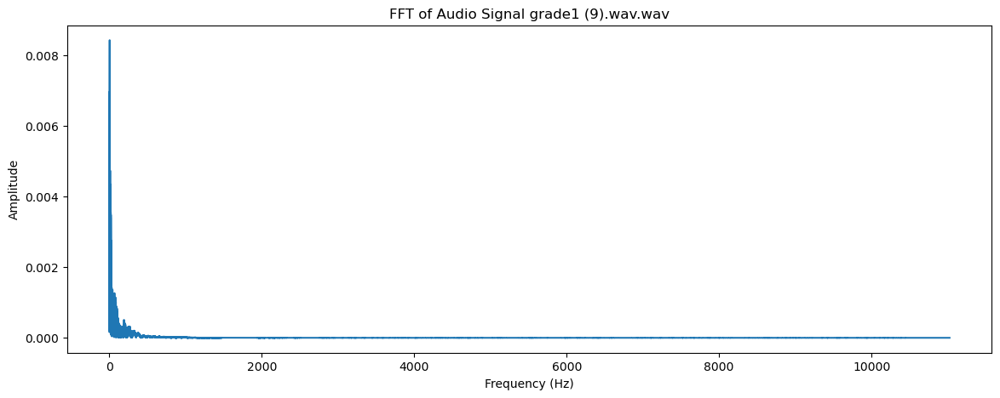

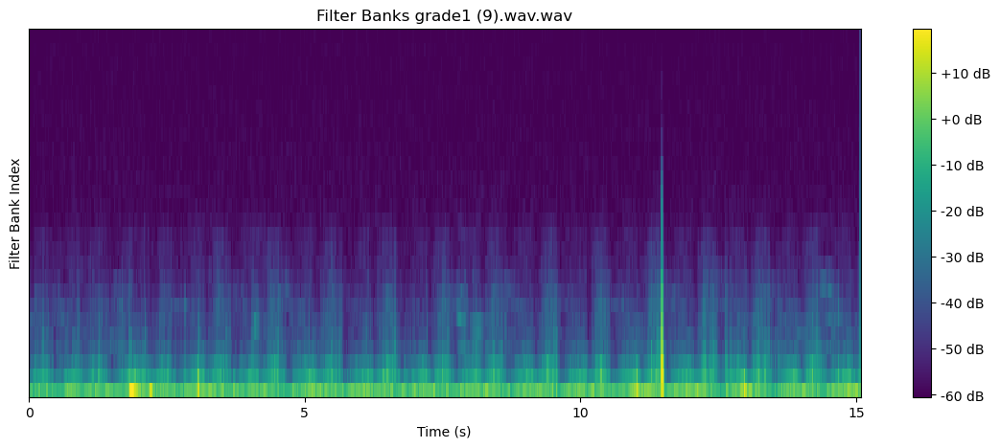

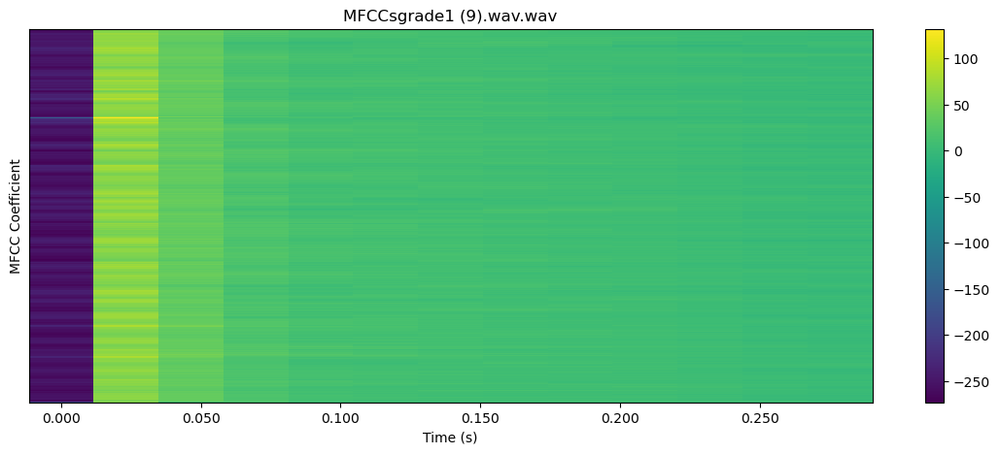


 26%|██▌       | 36/141 [00:57<02:42,  1.55s/it]

22050


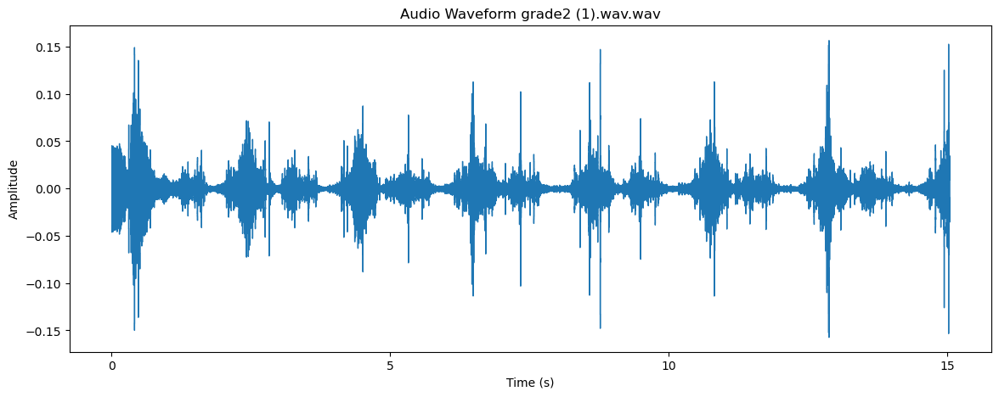

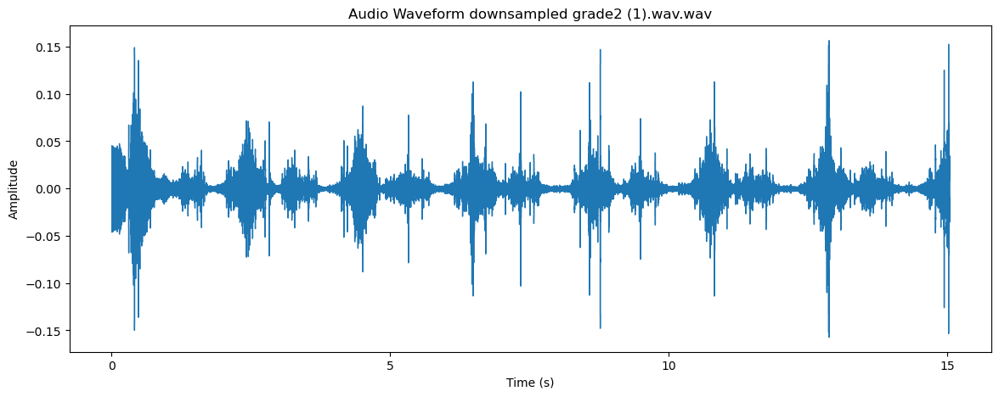

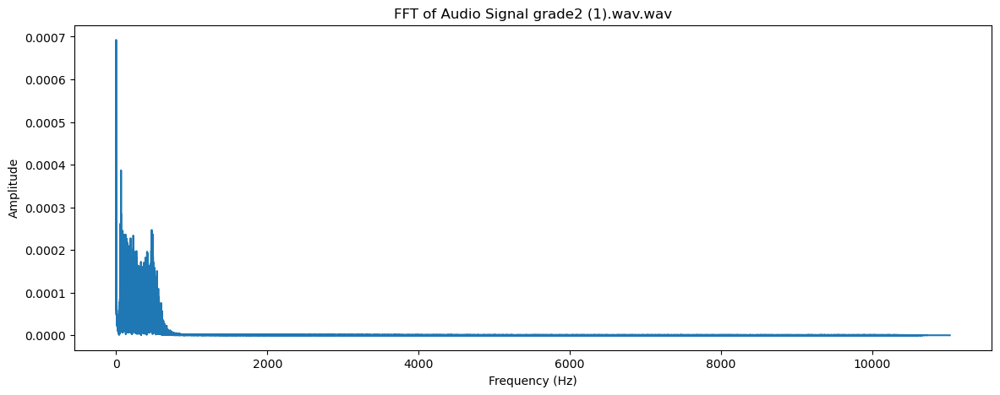

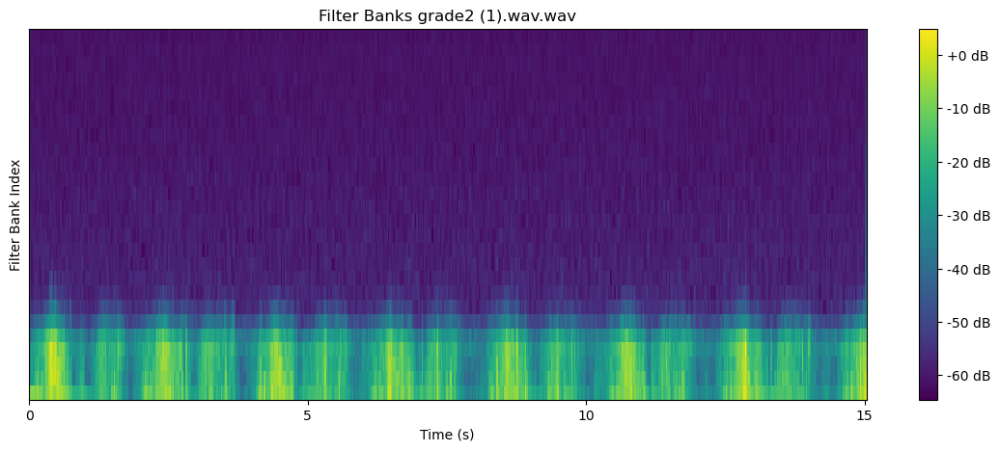

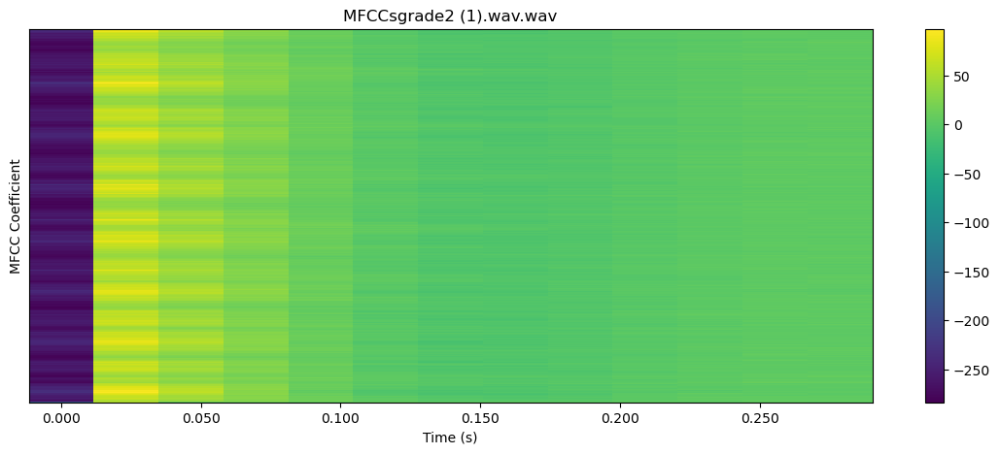


 26%|██▌       | 37/141 [00:59<02:52,  1.66s/it]

22050


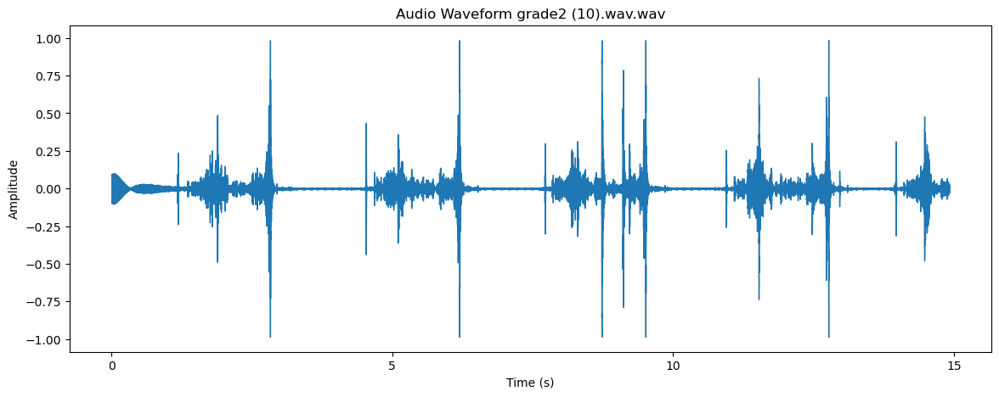

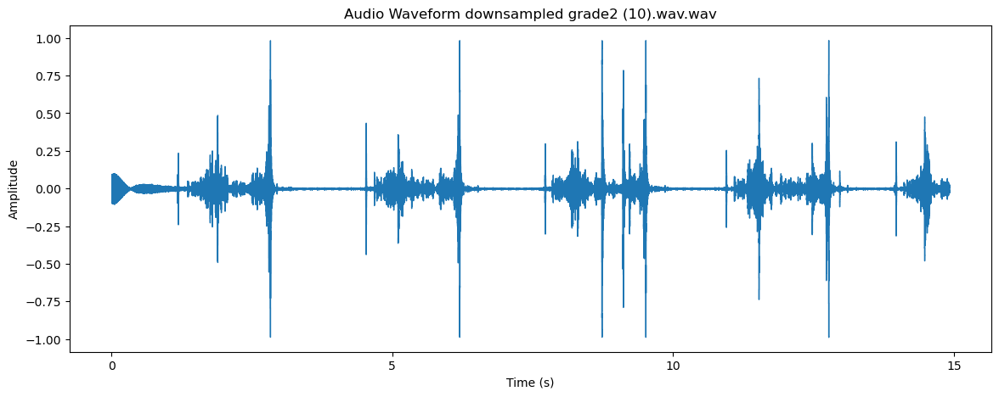

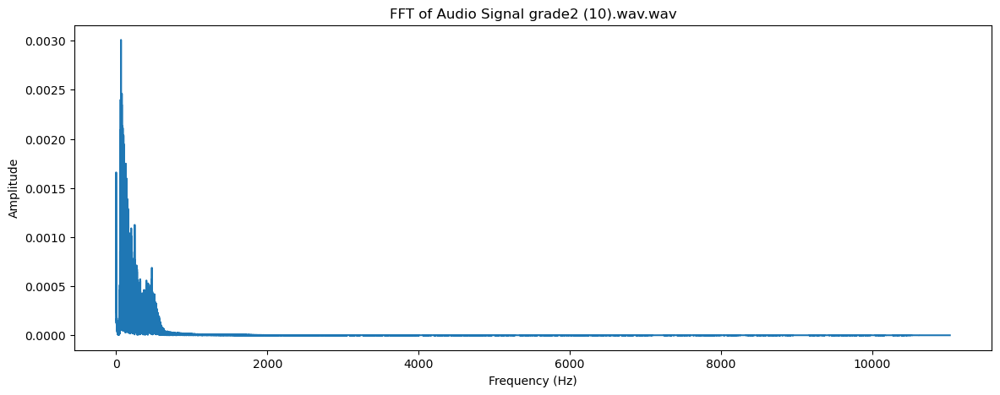

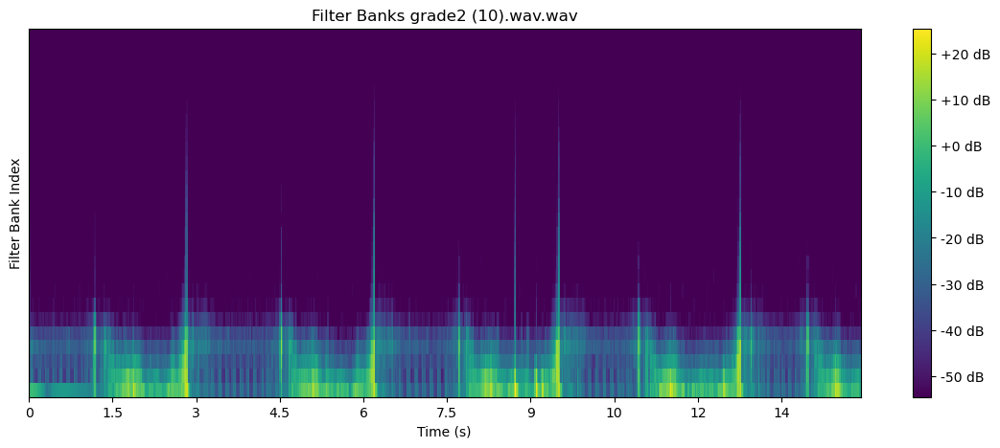

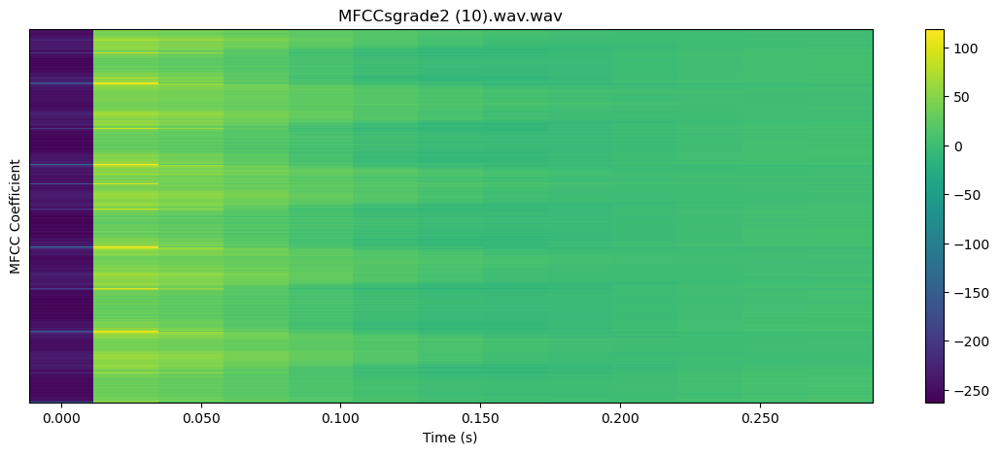


 27%|██▋       | 38/141 [01:01<02:47,  1.63s/it]

22050


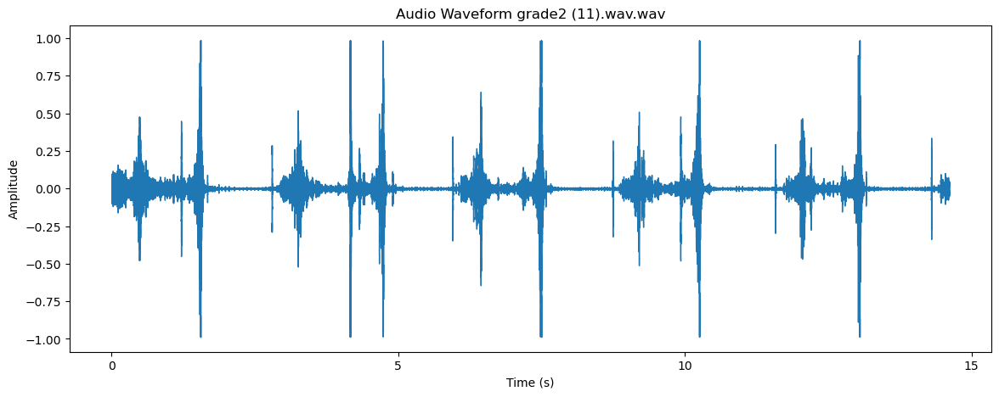

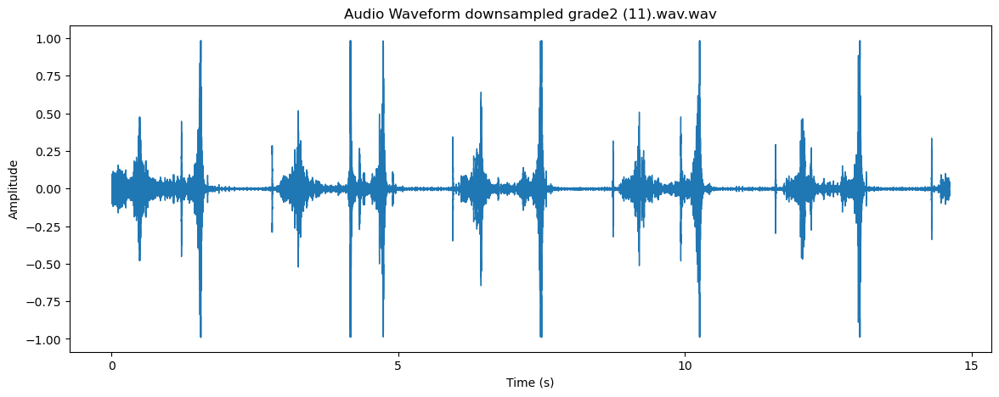

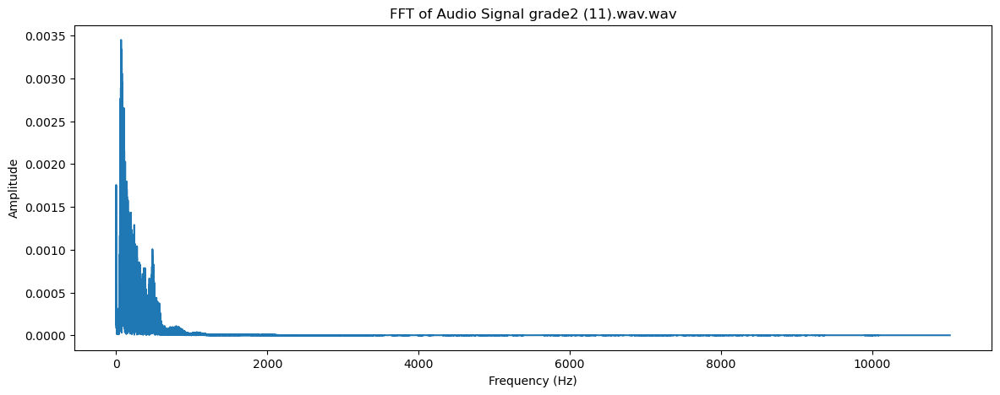

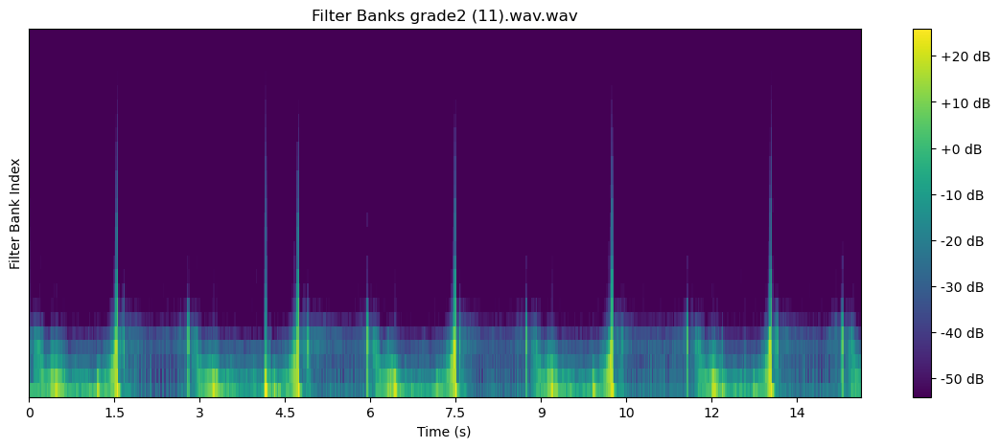

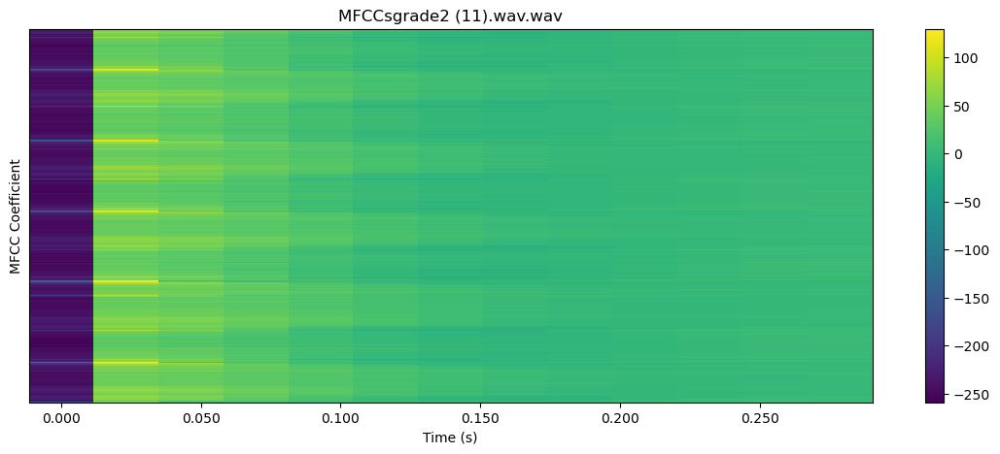


 28%|██▊       | 39/141 [01:02<02:40,  1.57s/it]

22050


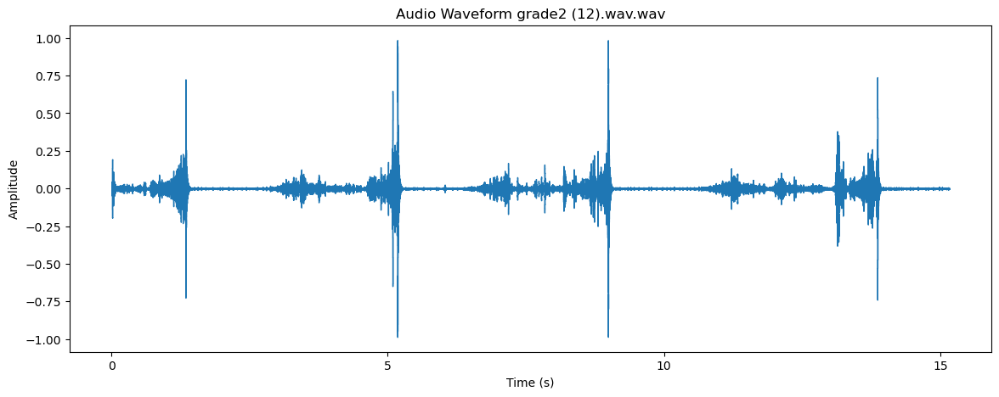

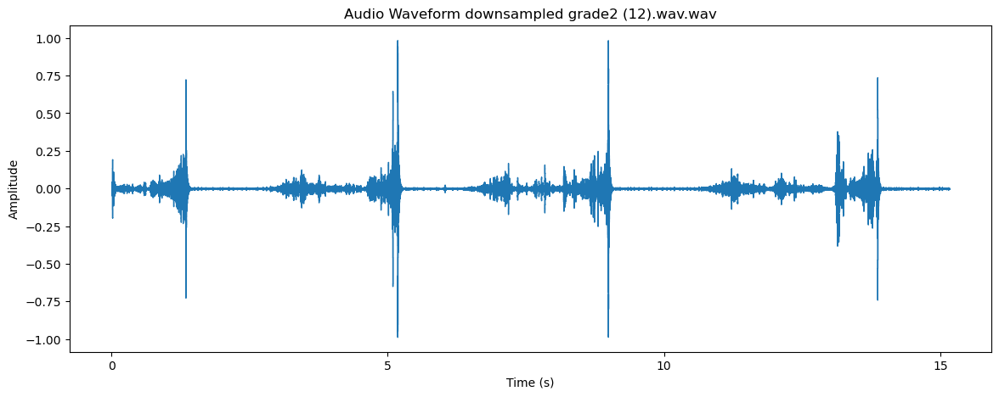

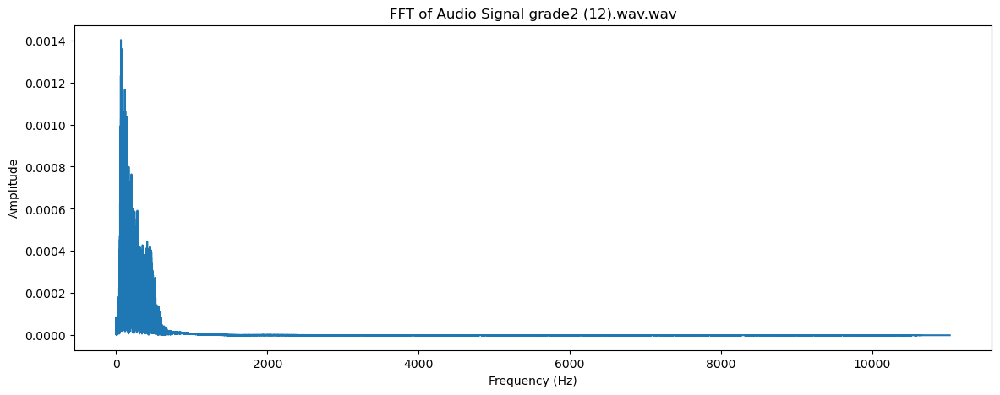

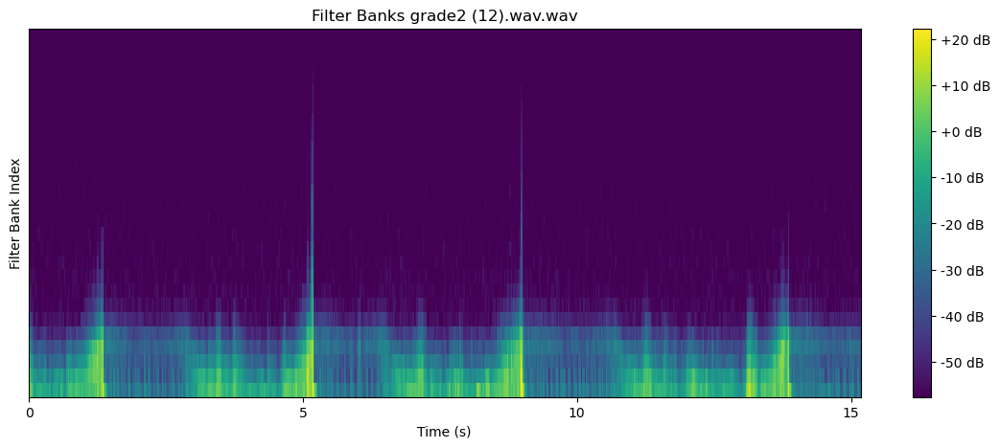

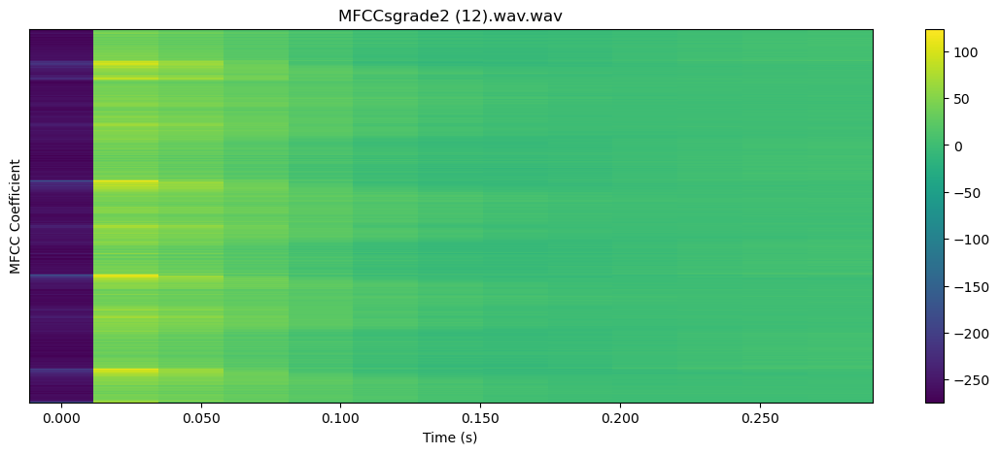


 28%|██▊       | 40/141 [01:03<02:32,  1.51s/it]

22050


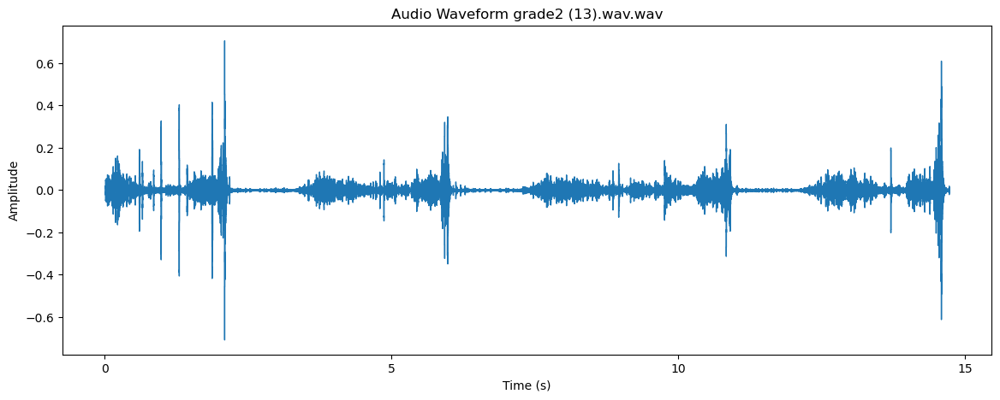

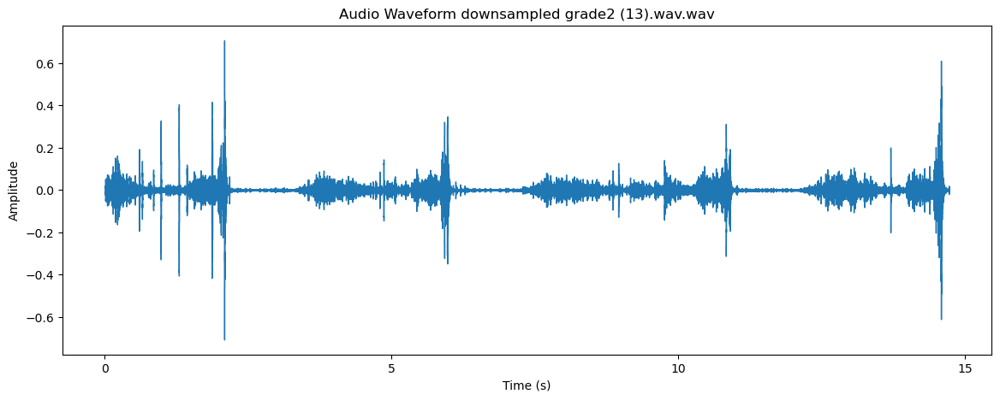

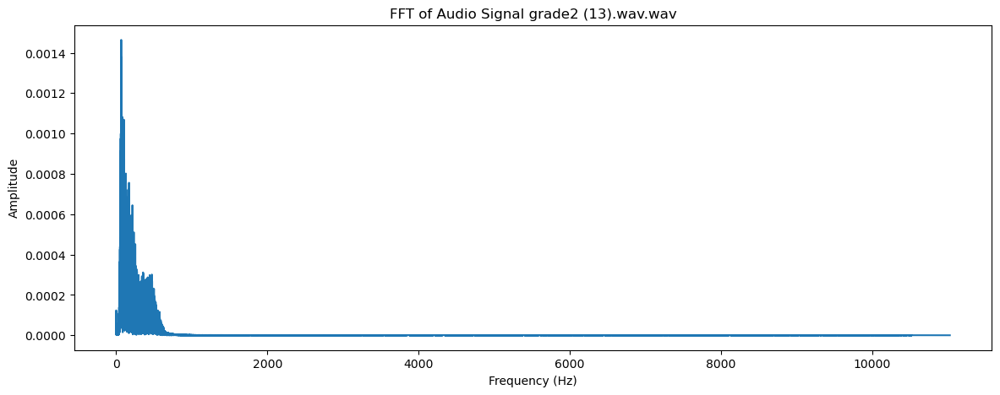

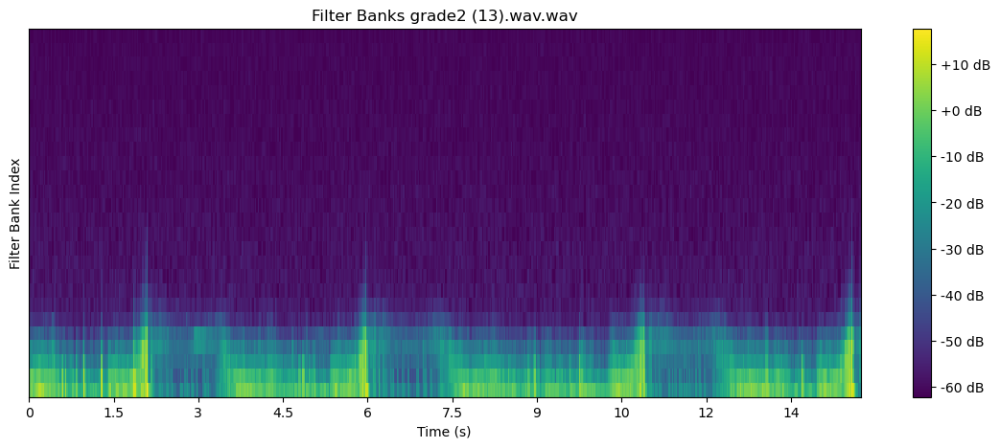

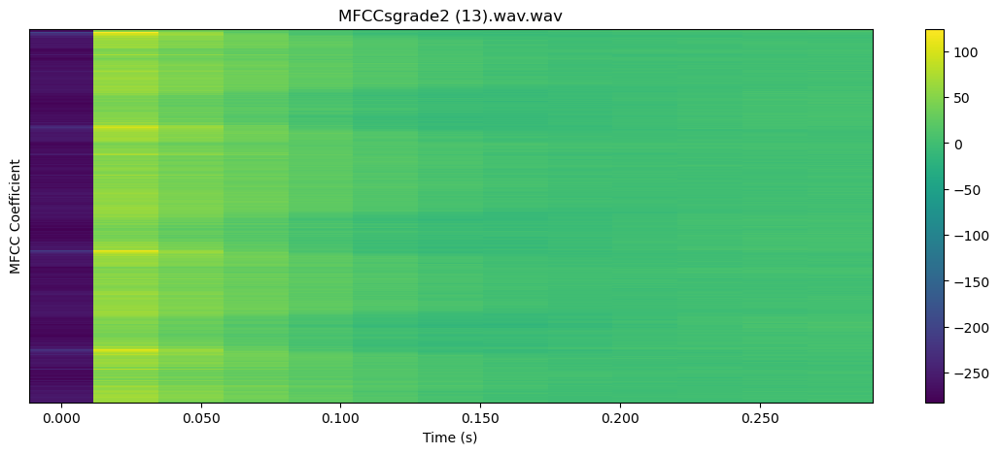


 29%|██▉       | 41/141 [01:05<02:27,  1.48s/it]

22050


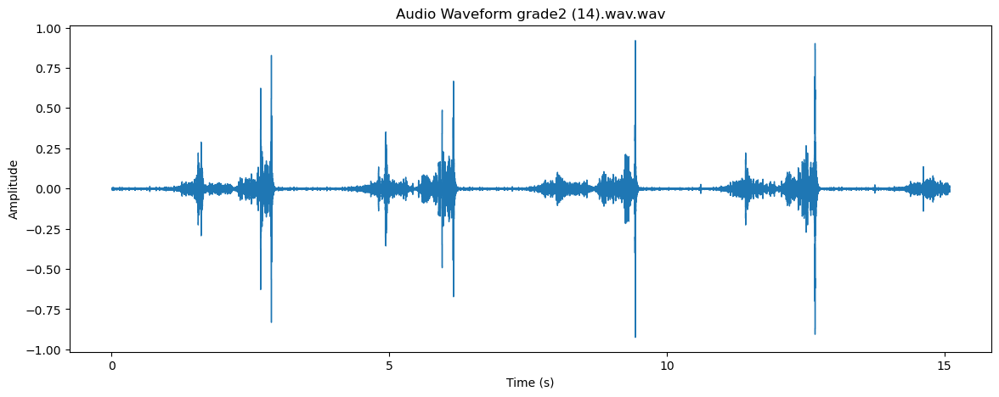

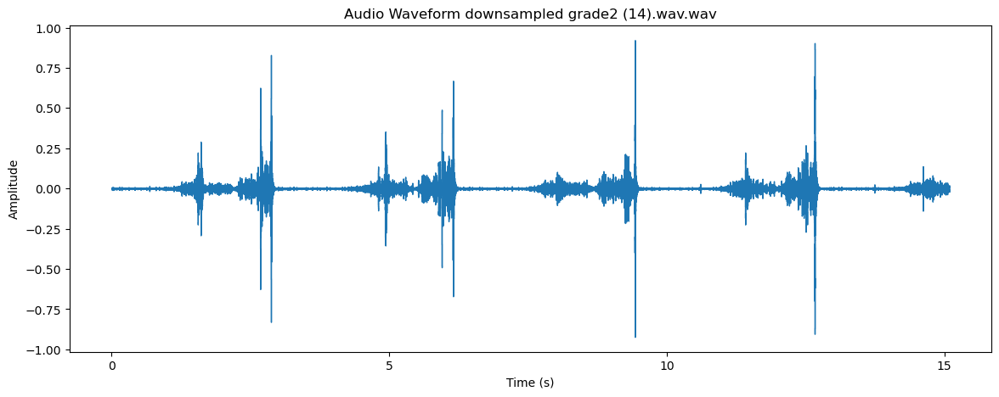

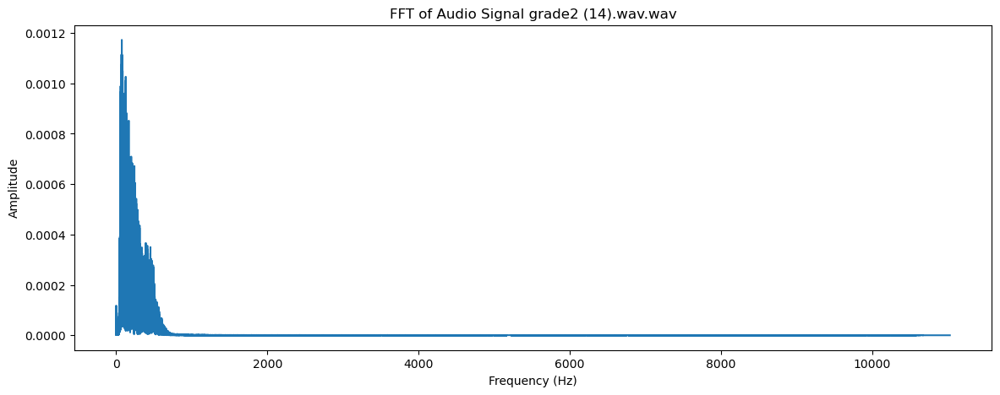

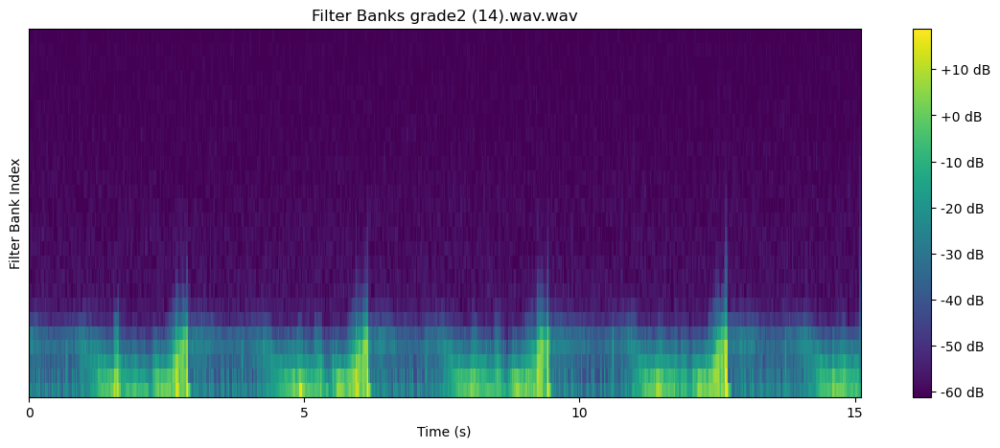

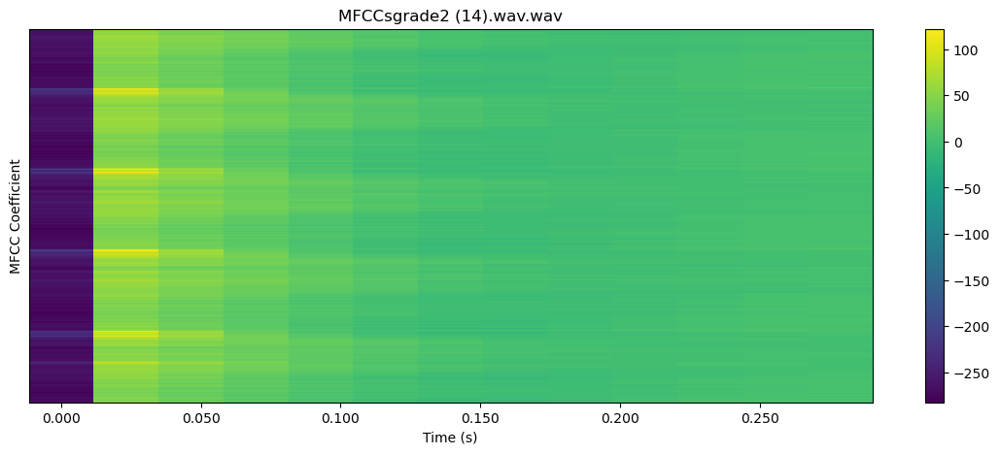


 30%|██▉       | 42/141 [01:07<02:39,  1.61s/it]

22050


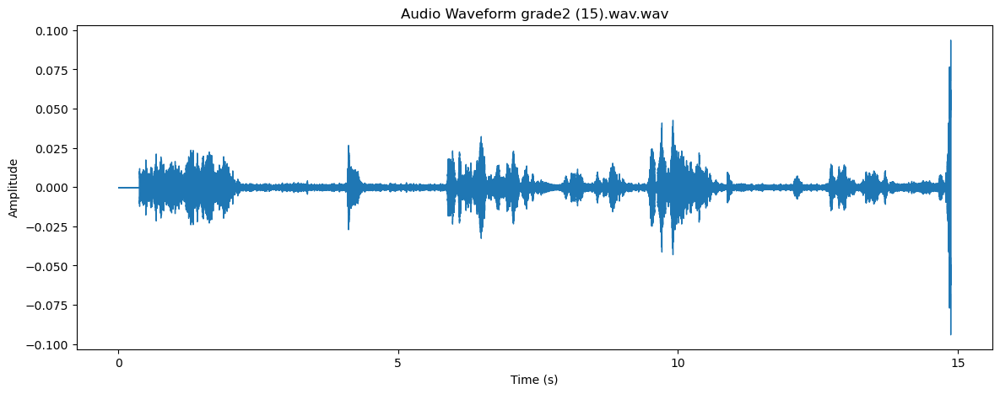

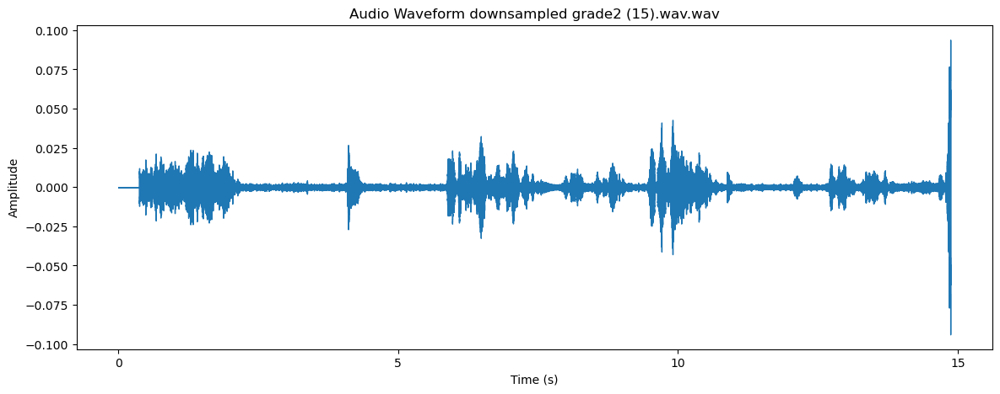

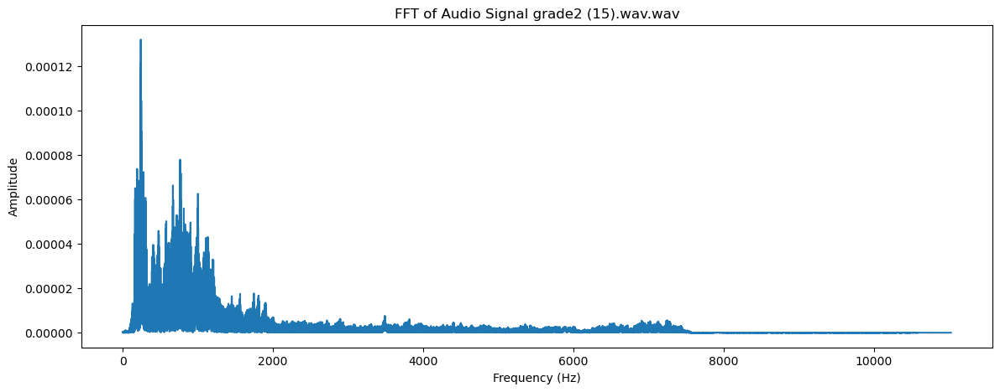

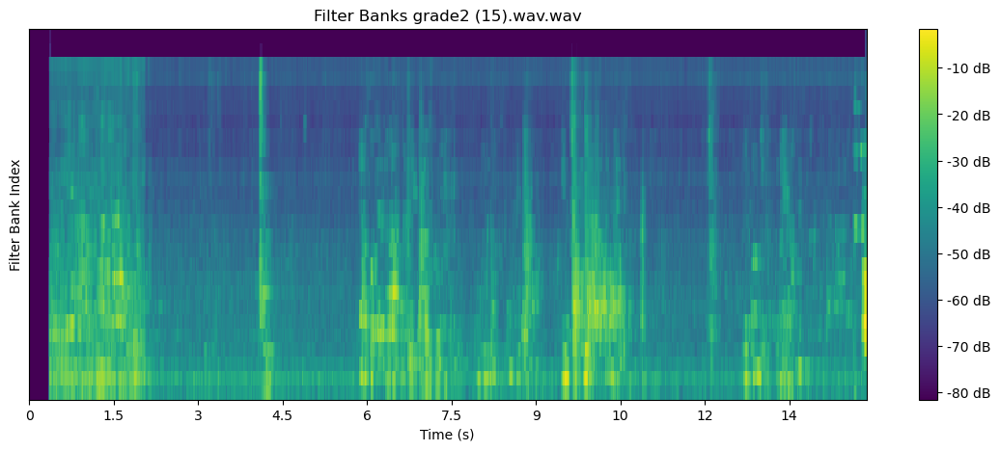

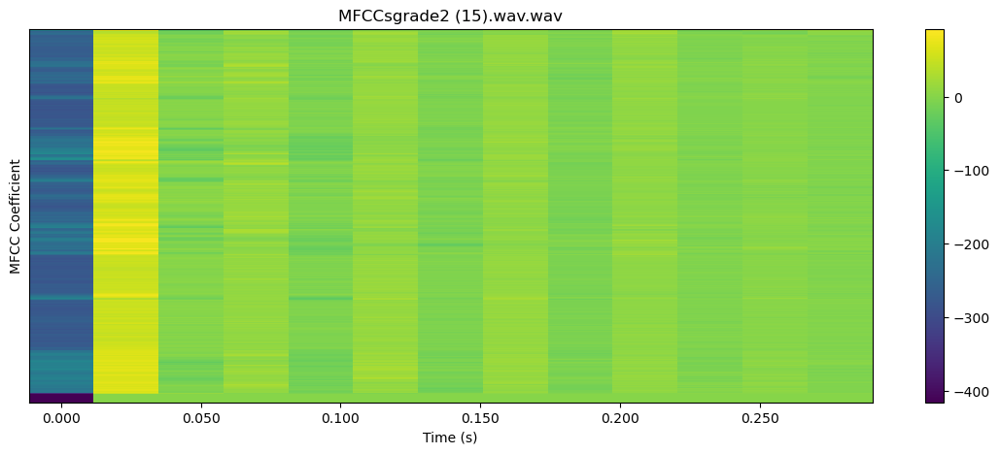


 30%|███       | 43/141 [01:08<02:33,  1.57s/it]

22050


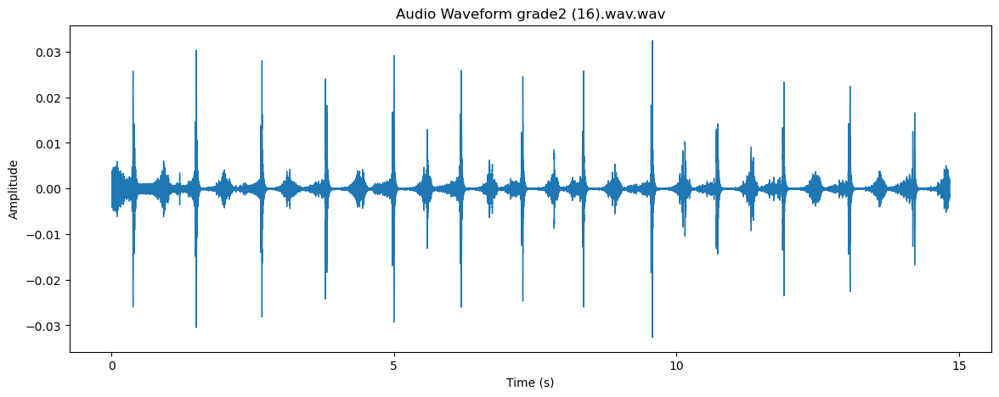

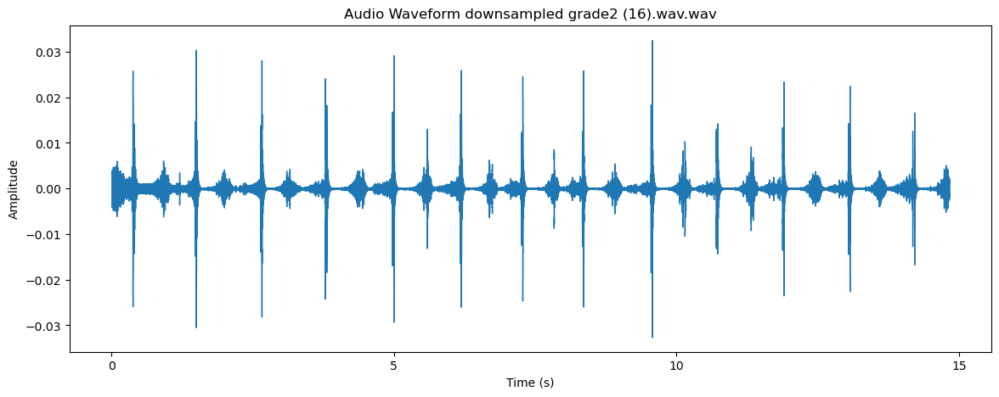

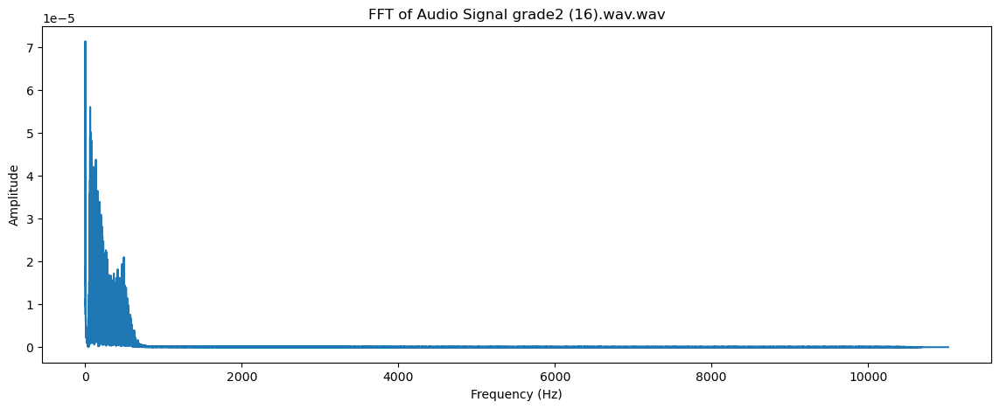

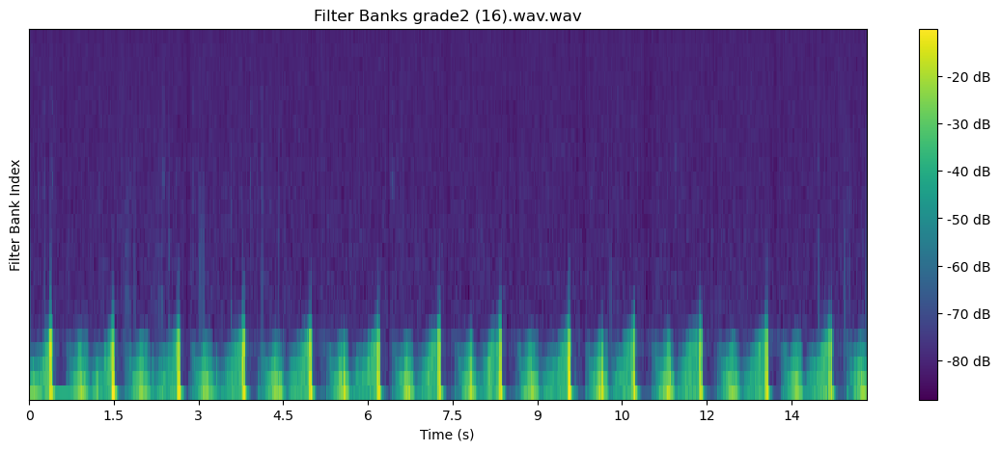

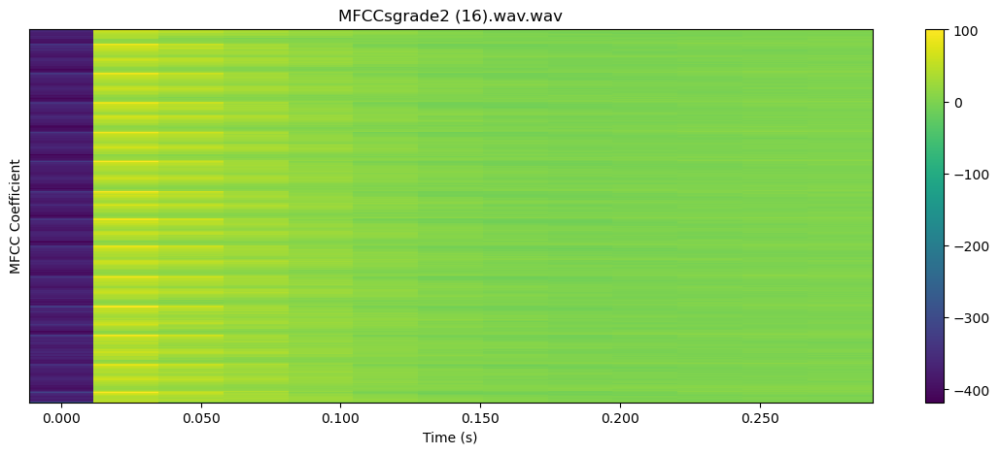


 31%|███       | 44/141 [01:10<02:32,  1.57s/it]

22050


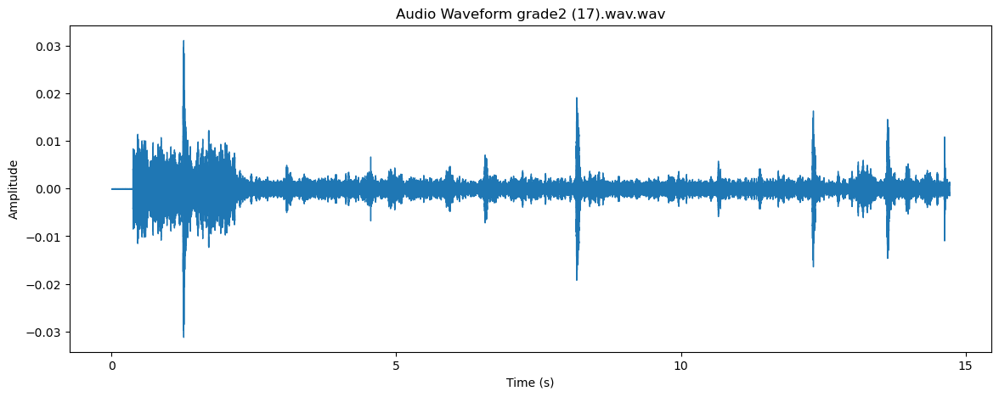

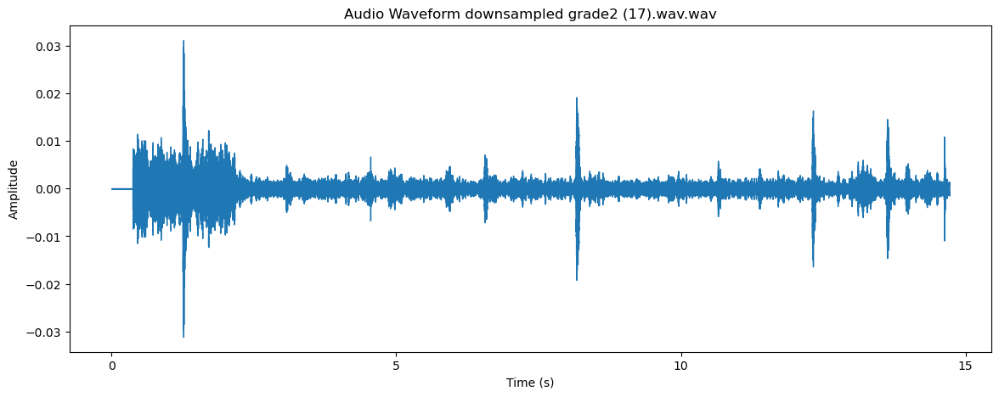

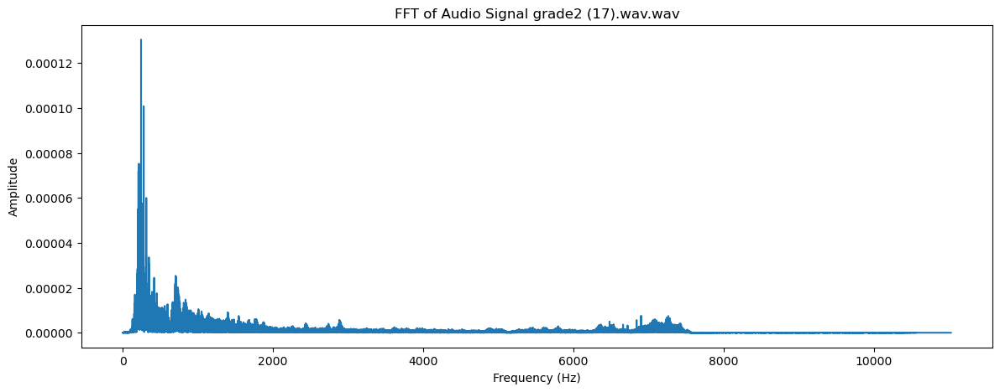

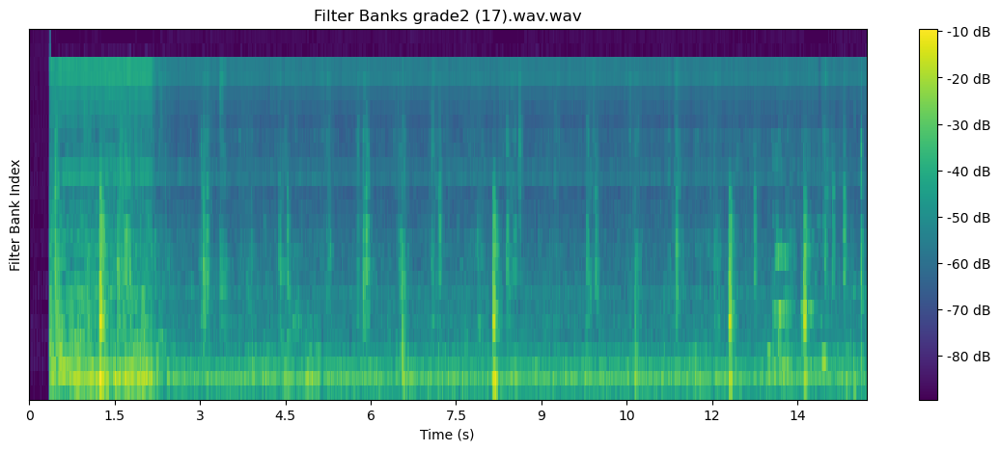

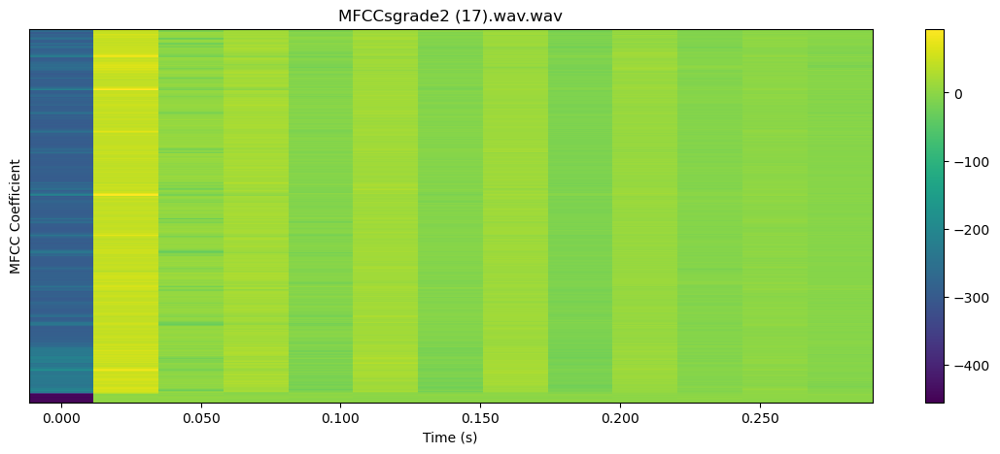


 32%|███▏      | 45/141 [01:11<02:29,  1.56s/it]

22050


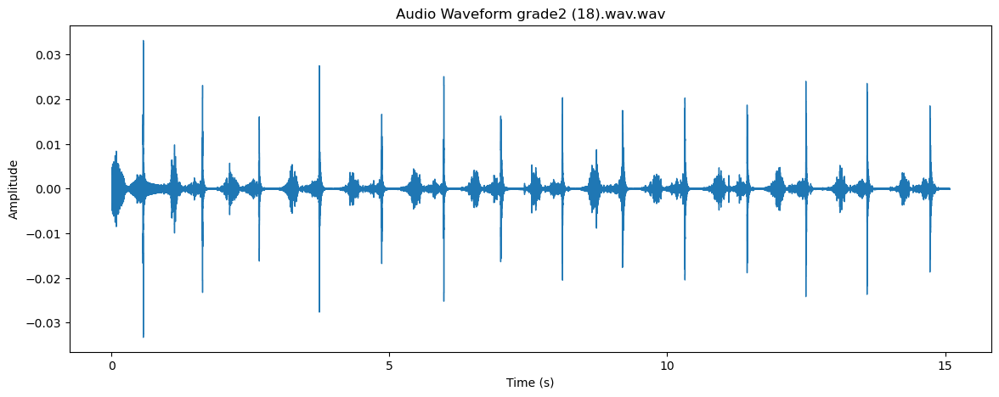

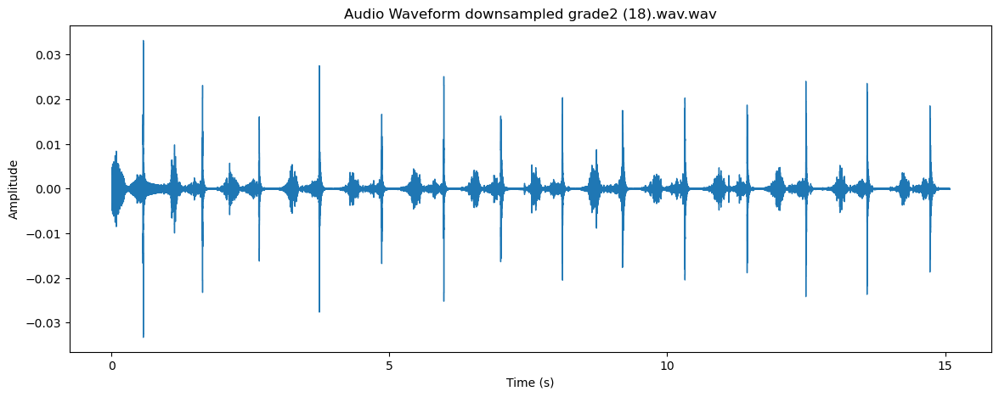

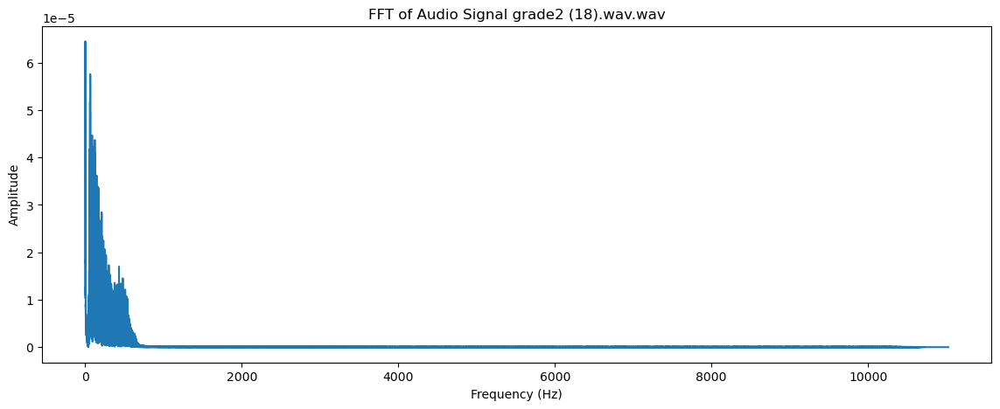

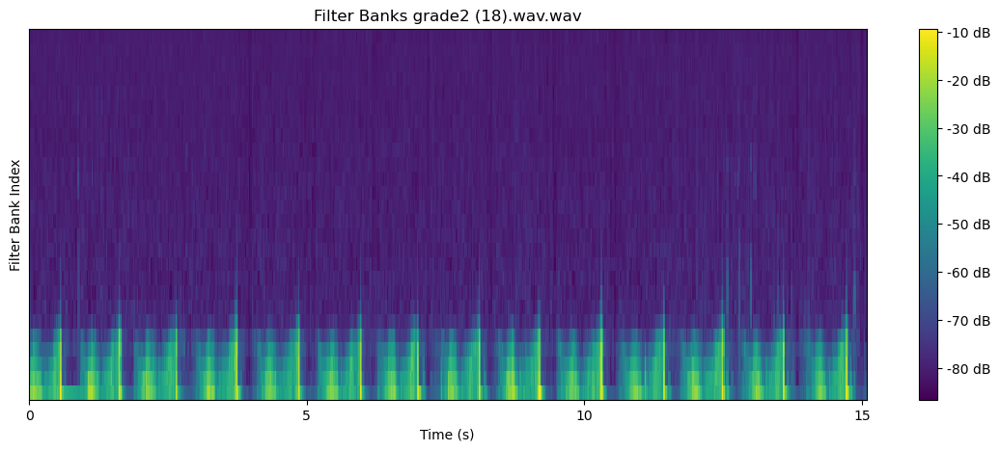

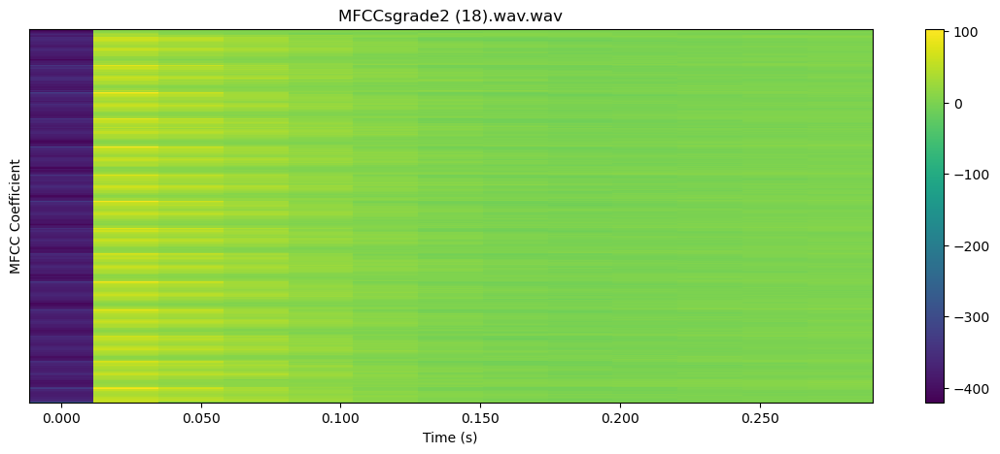


 33%|███▎      | 46/141 [01:13<02:32,  1.60s/it]

22050


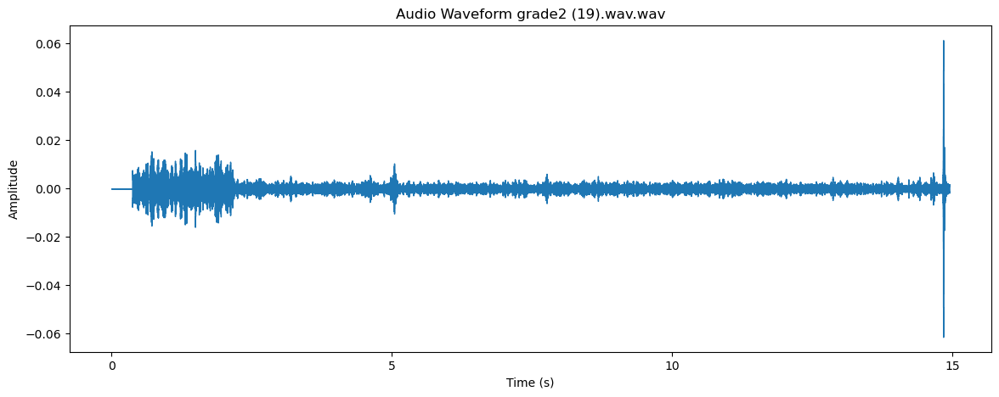

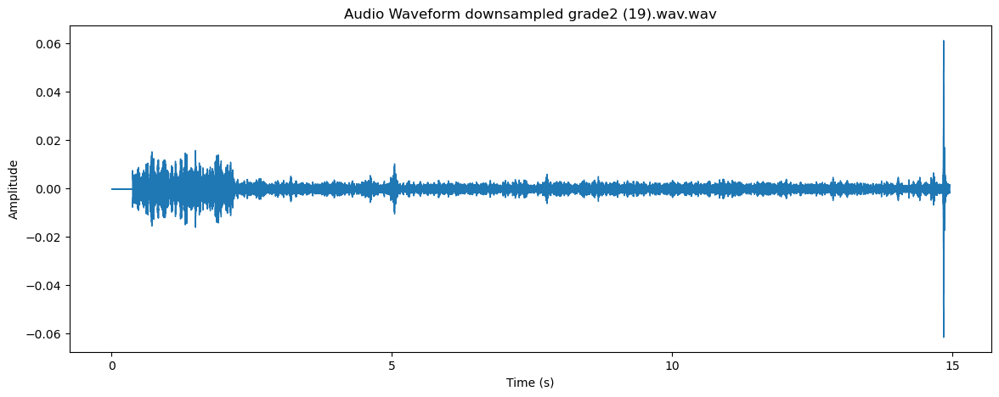

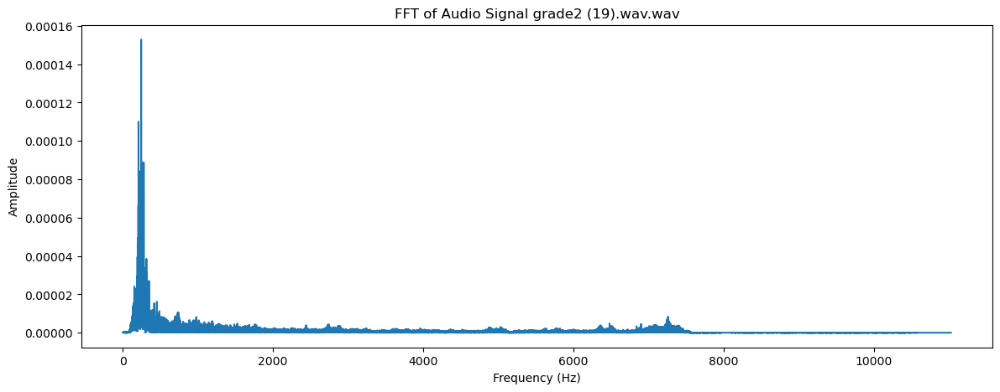

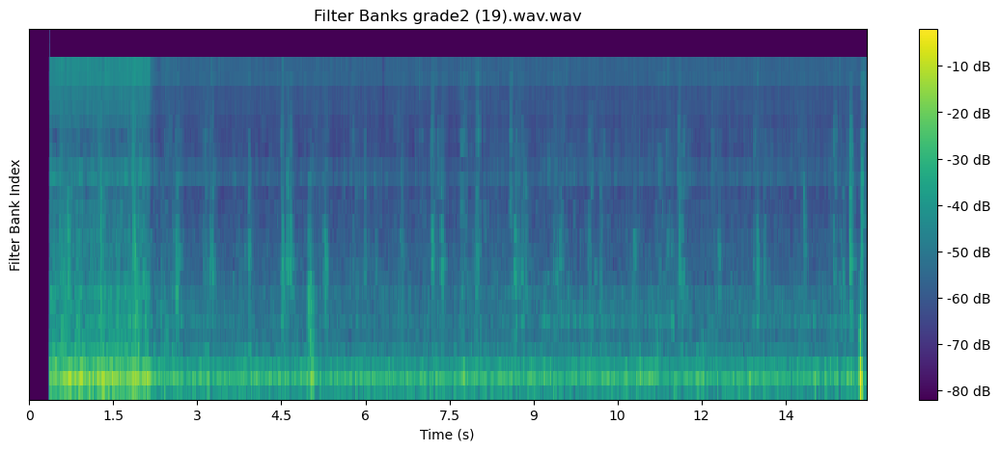

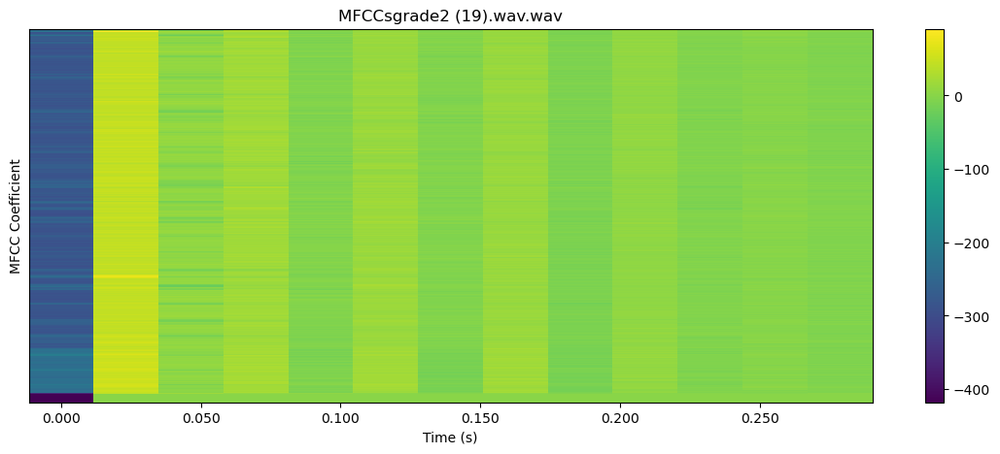


 33%|███▎      | 47/141 [01:15<02:42,  1.73s/it]

22050


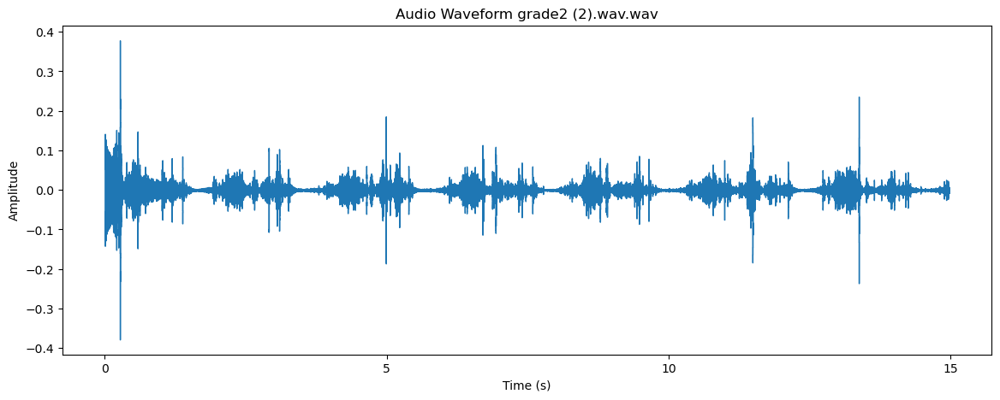

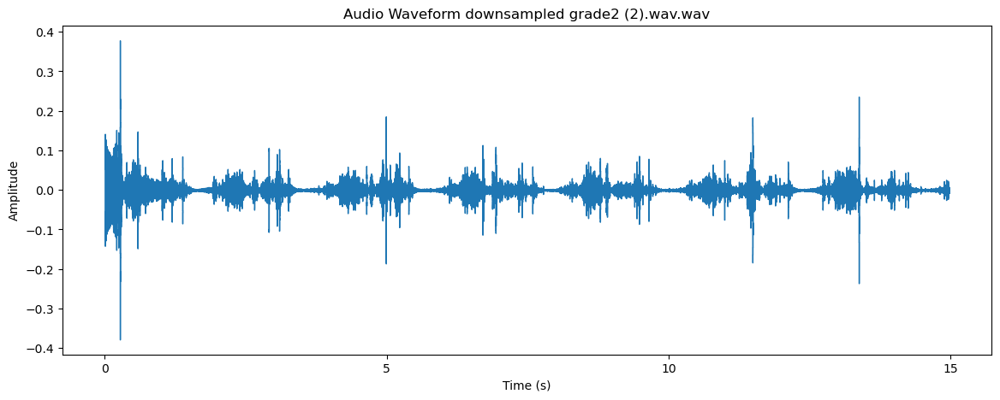

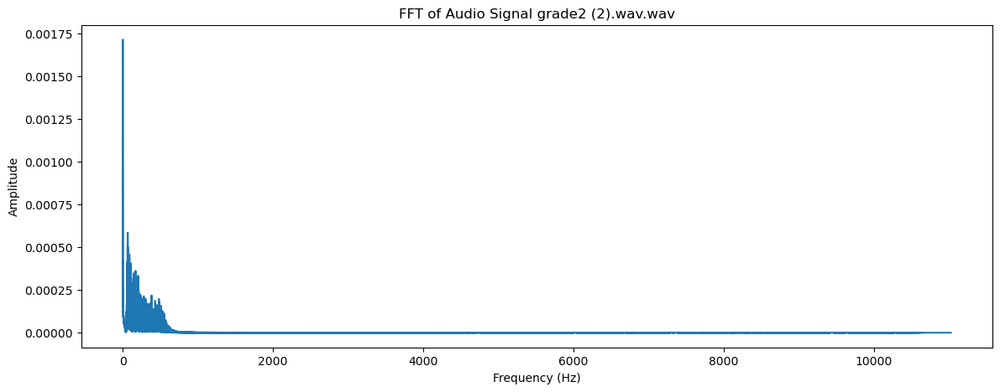

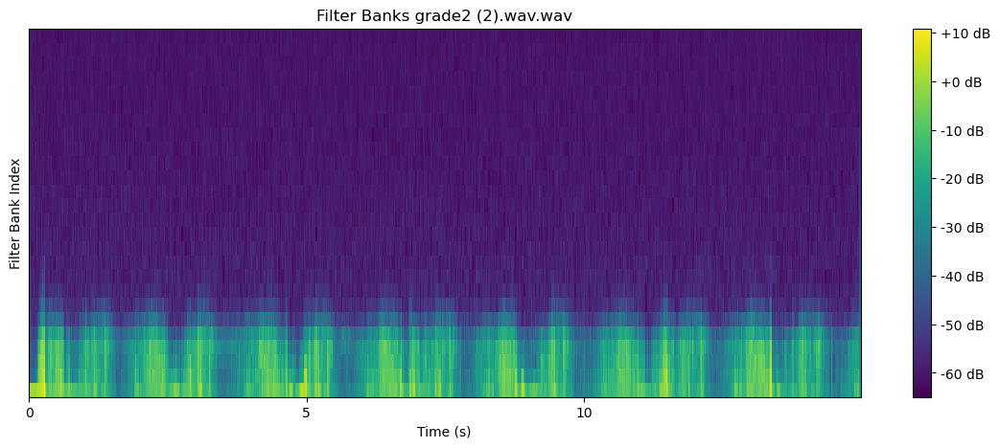

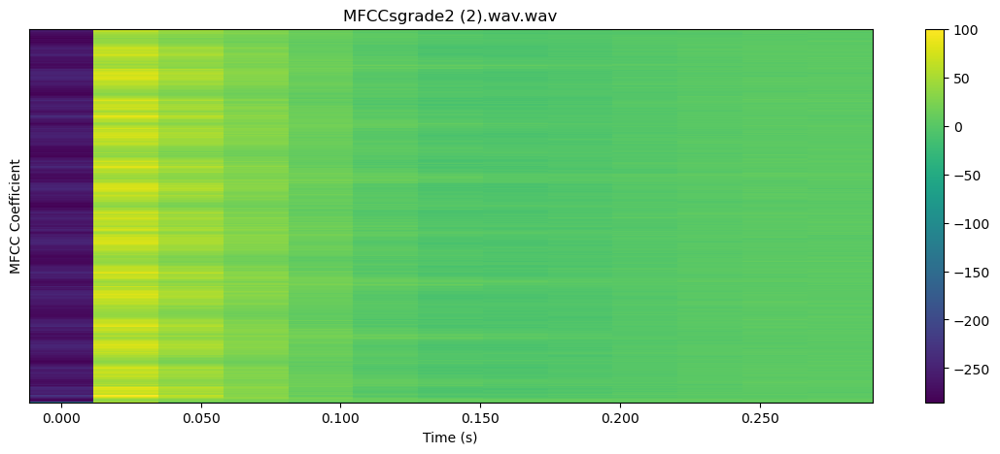


 34%|███▍      | 48/141 [01:17<02:39,  1.72s/it]

22050


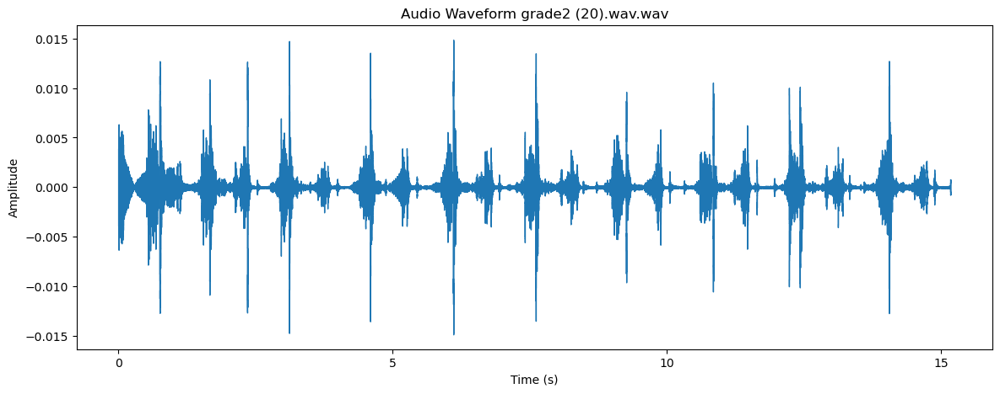

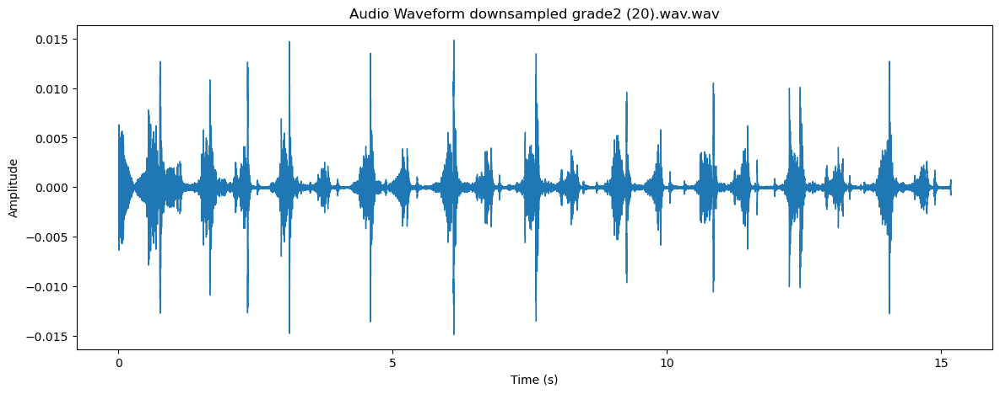

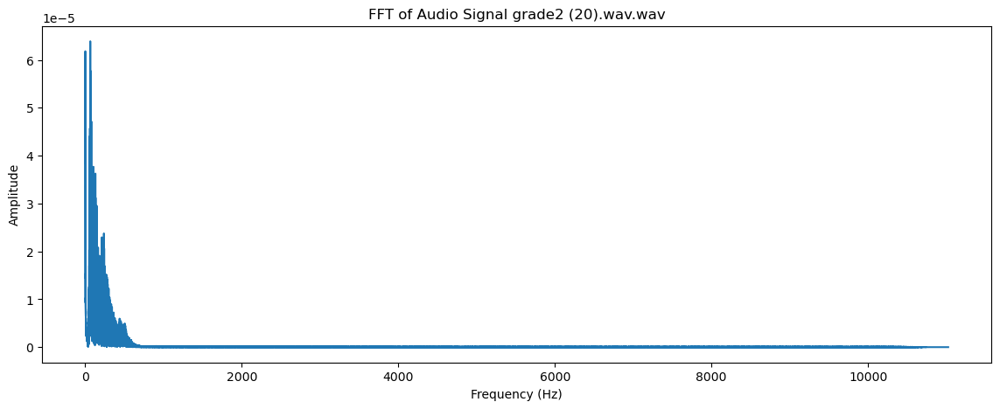

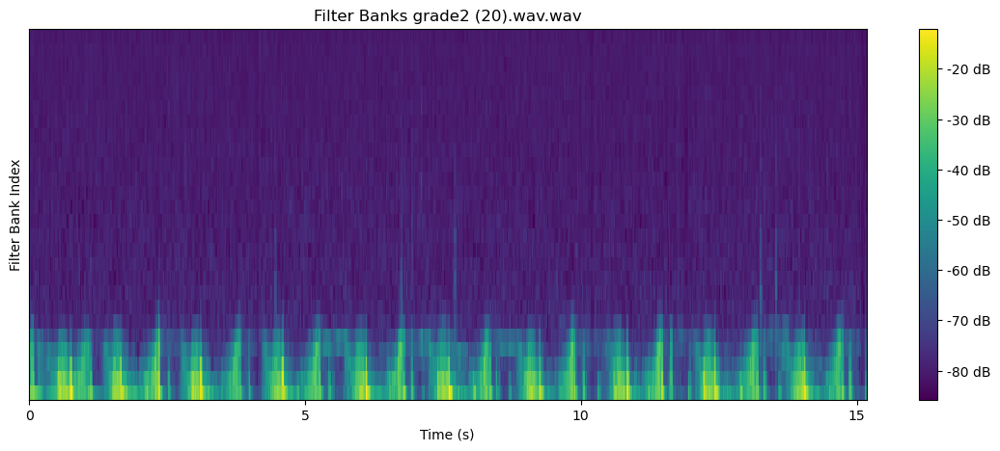

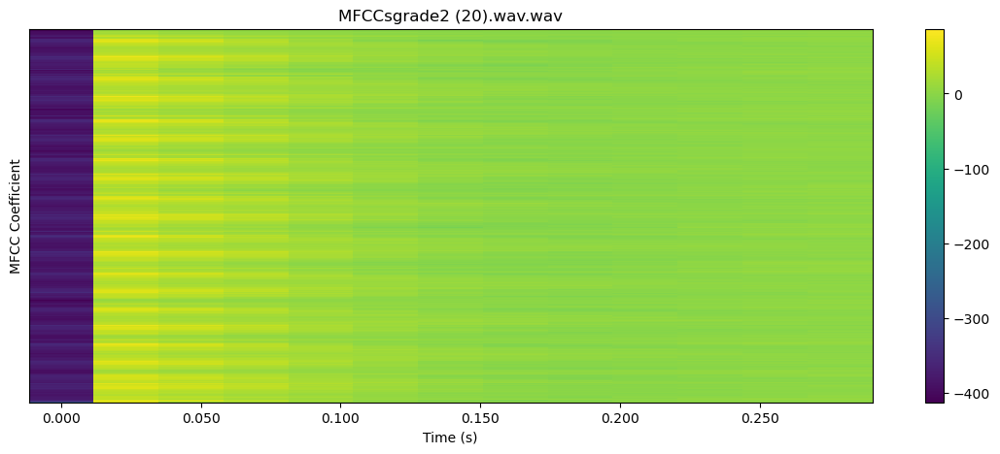


 35%|███▍      | 49/141 [01:18<02:30,  1.63s/it]

22050


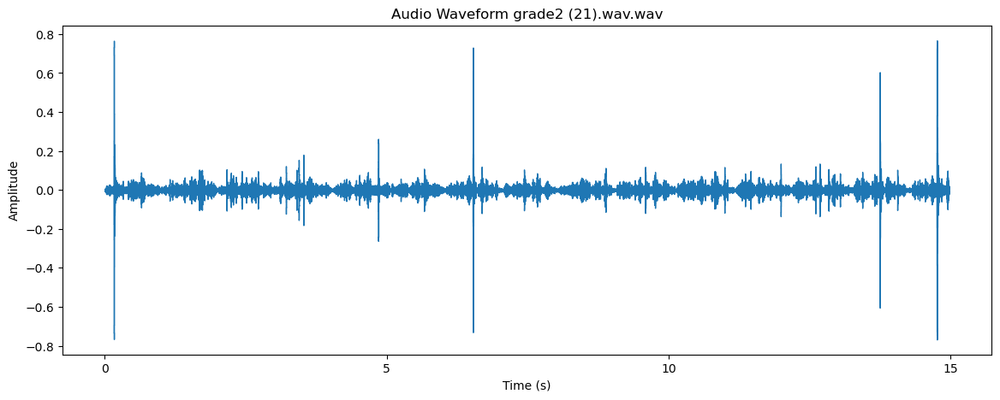

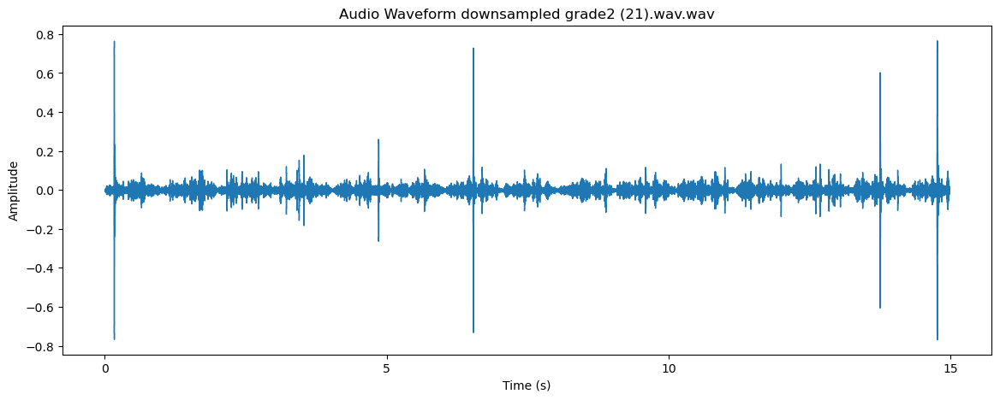

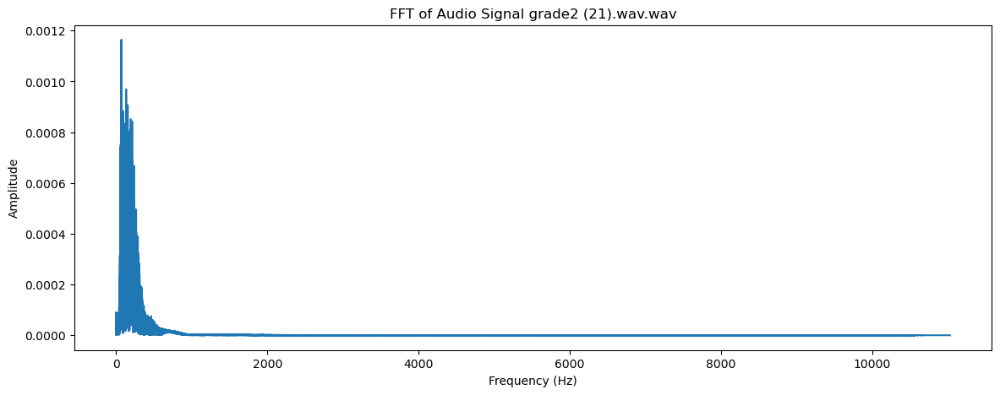

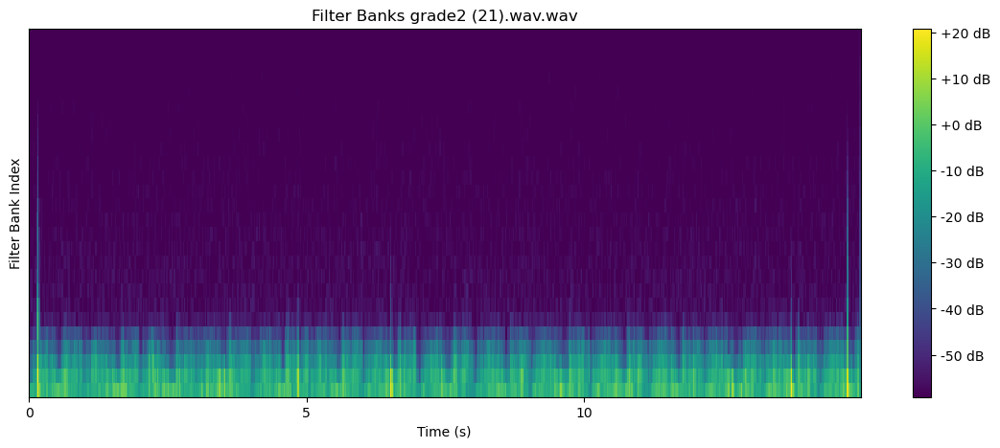

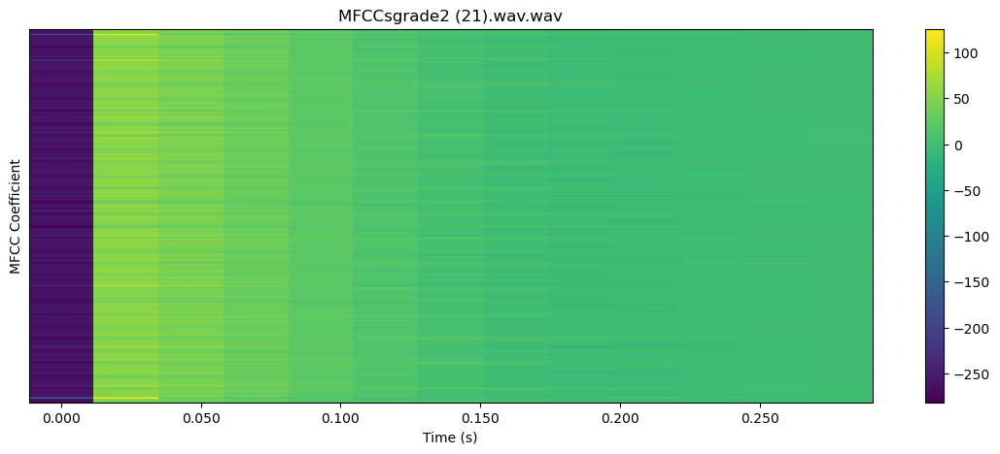


 35%|███▌      | 50/141 [01:20<02:22,  1.57s/it]

22050


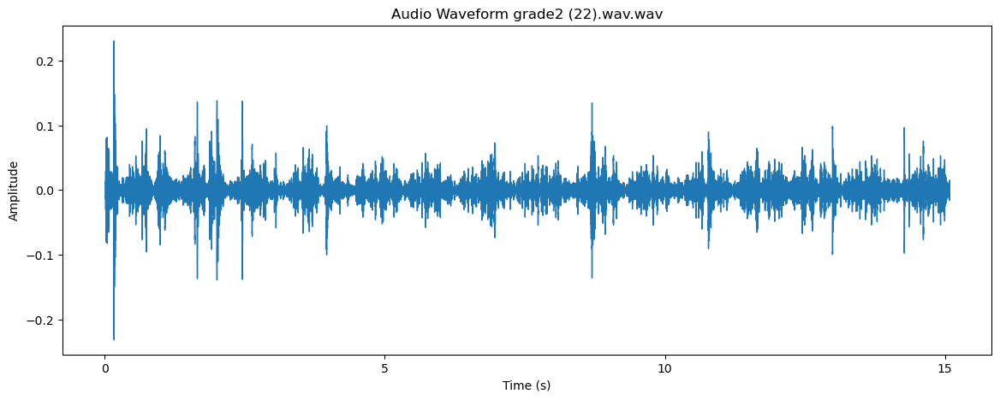

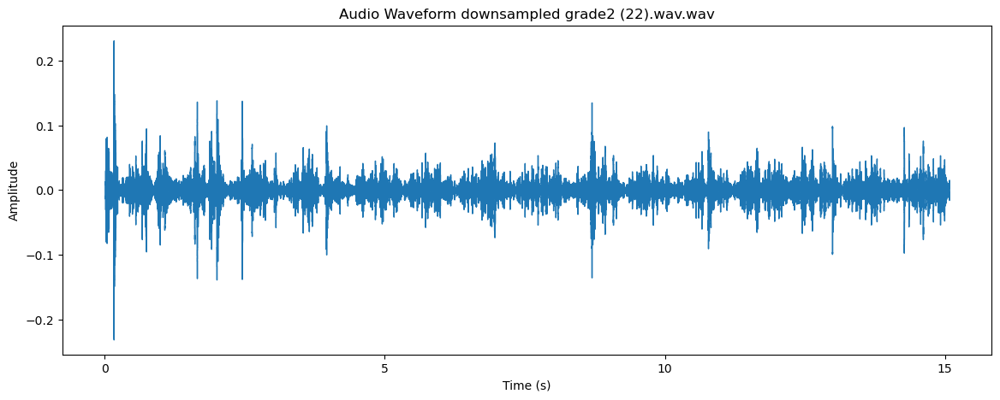

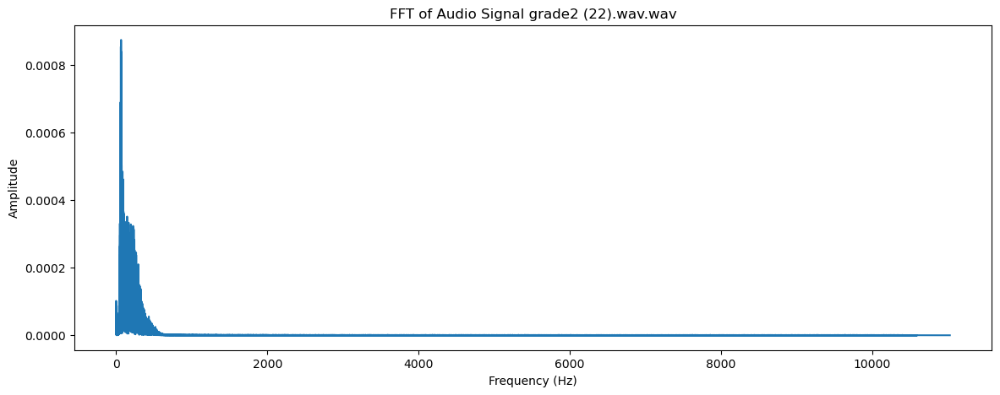

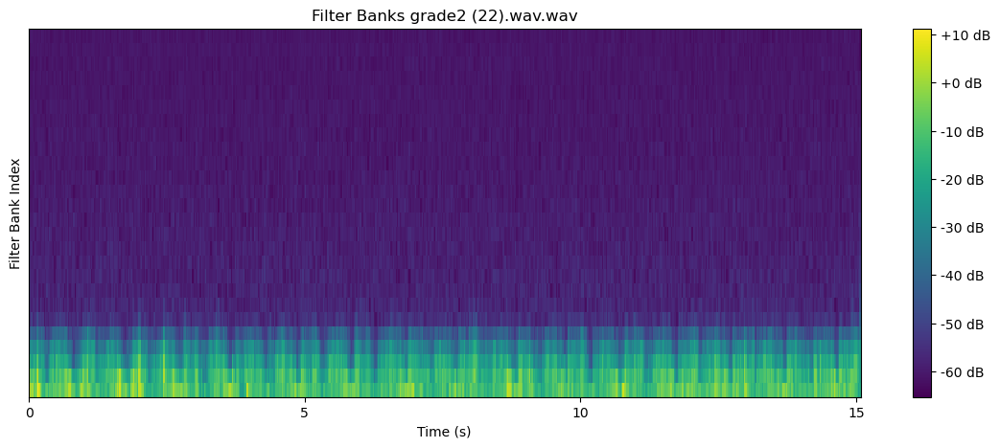

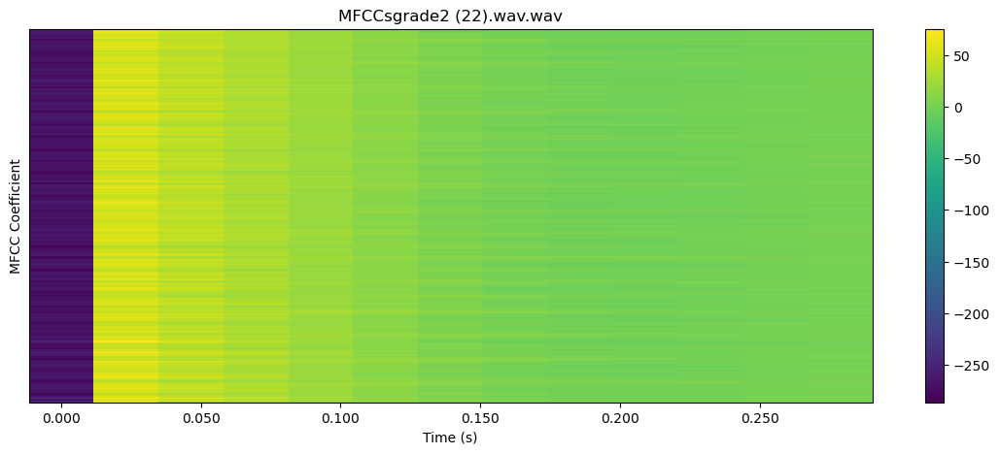


 36%|███▌      | 51/141 [01:21<02:17,  1.53s/it]

22050


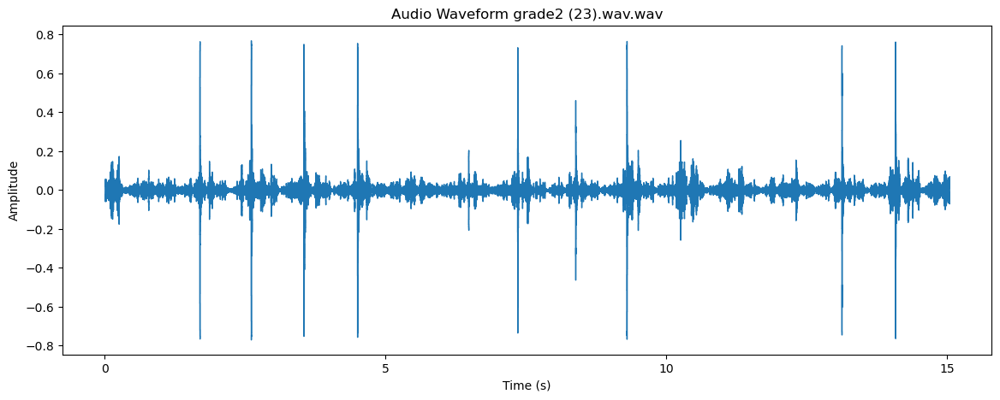

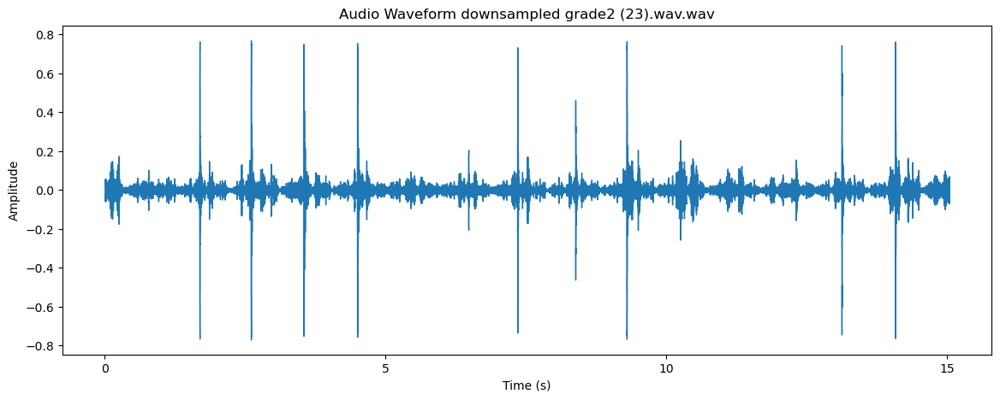

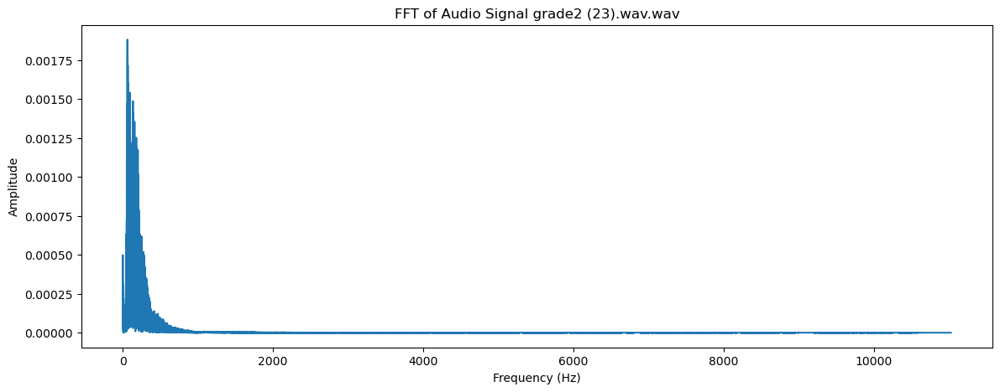

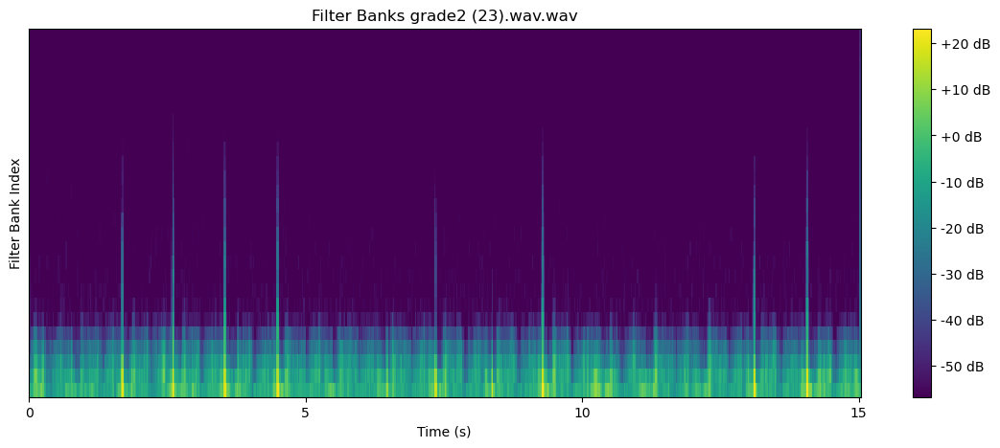

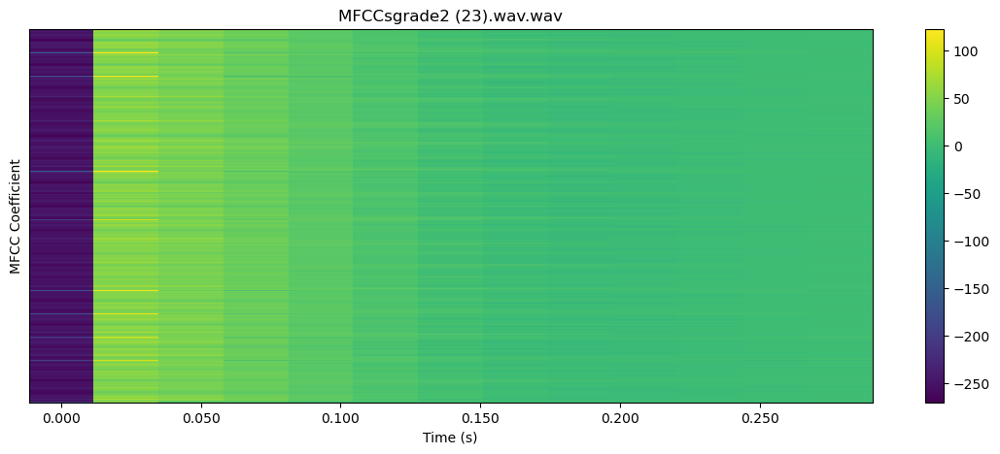


 37%|███▋      | 52/141 [01:22<02:13,  1.50s/it]

22050


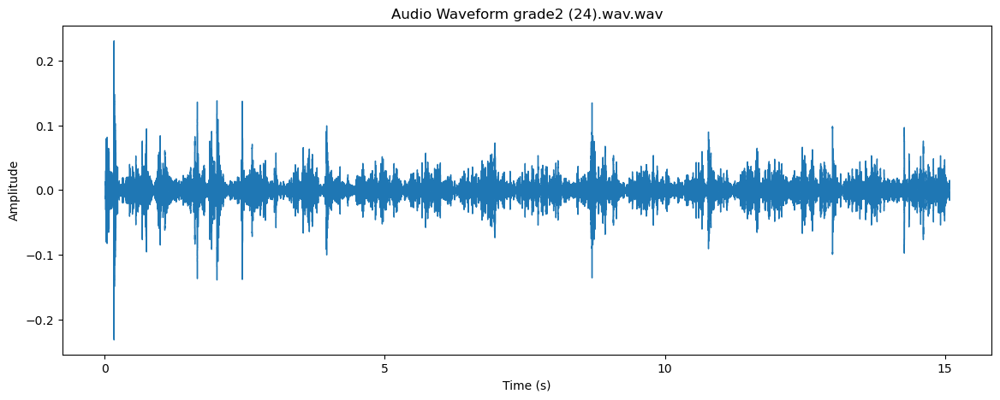

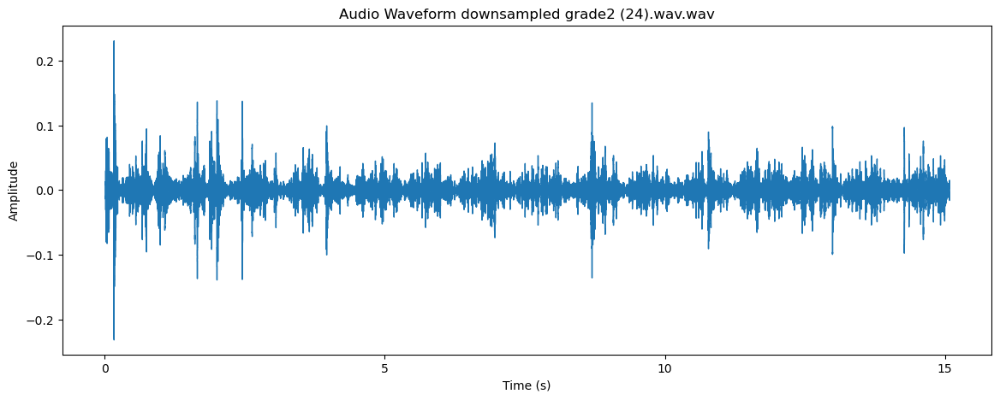

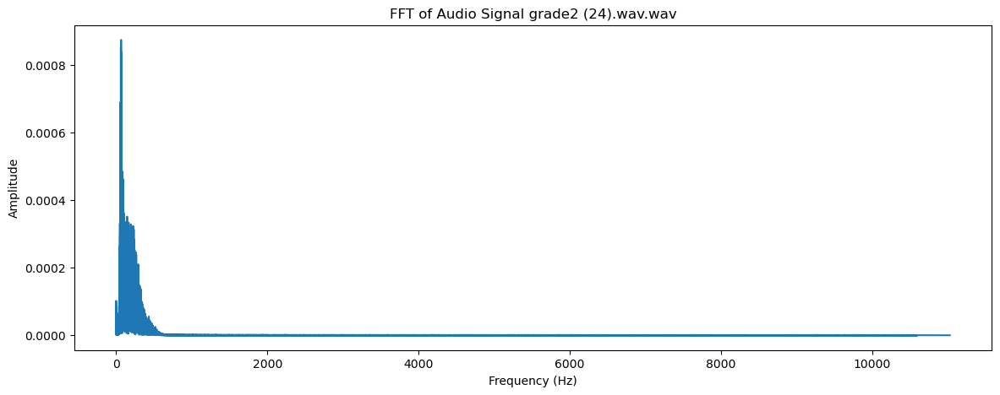

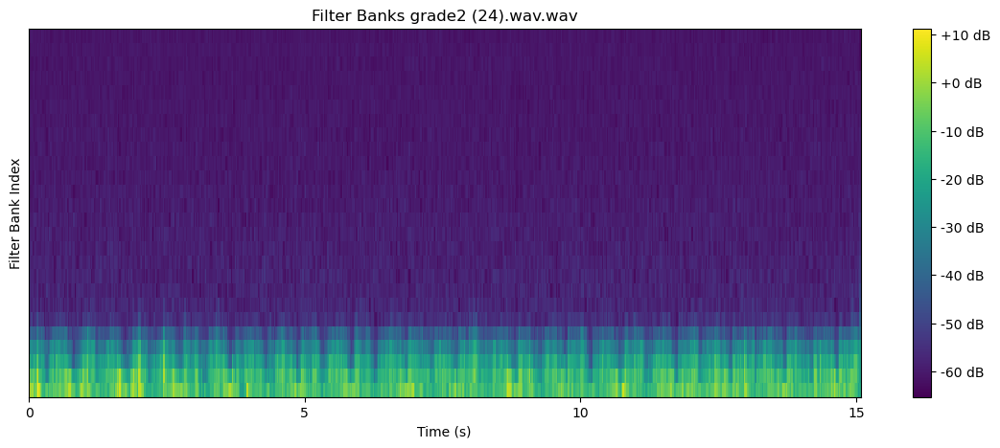

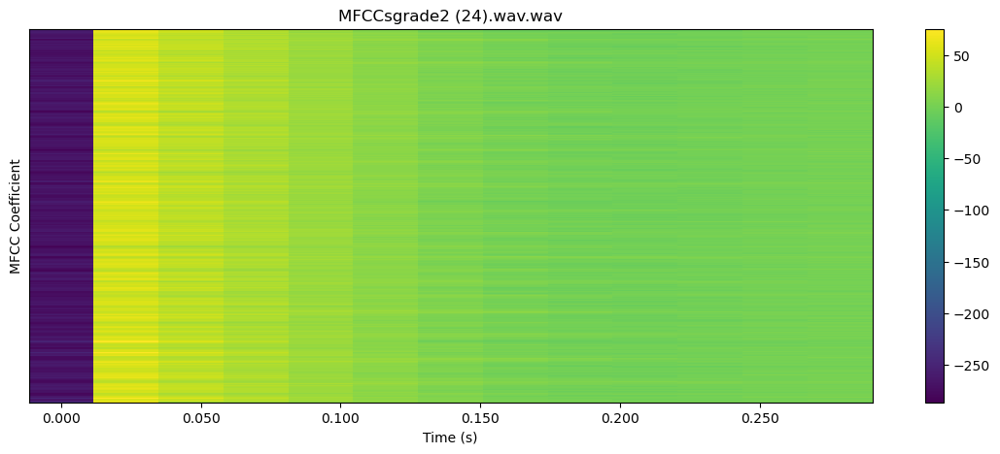


 38%|███▊      | 53/141 [01:24<02:11,  1.49s/it]

22050


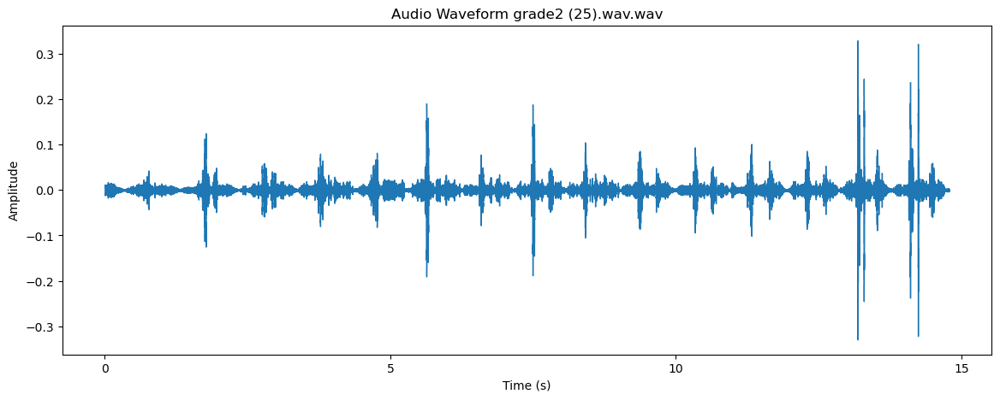

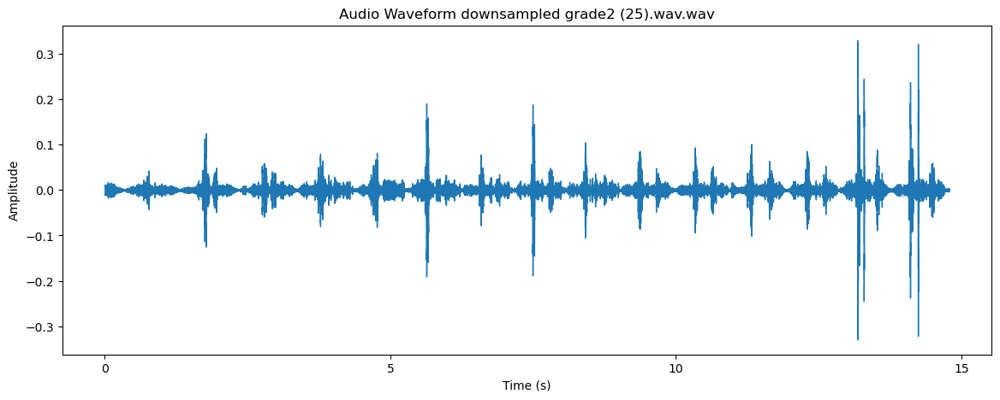

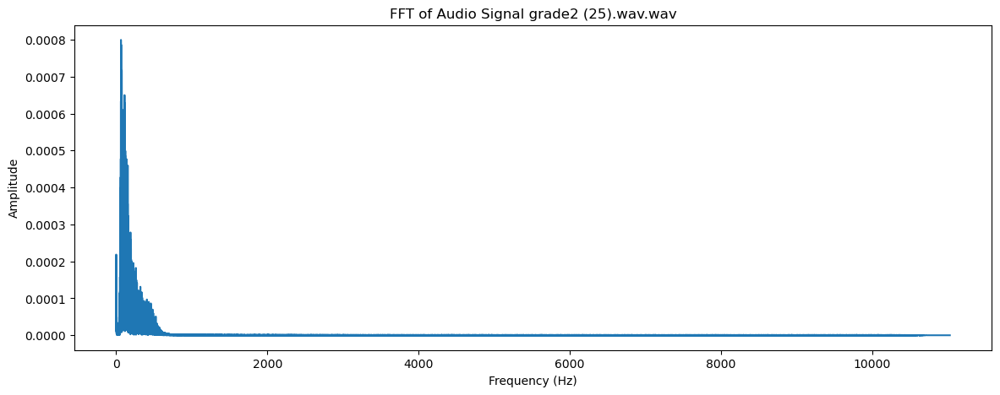

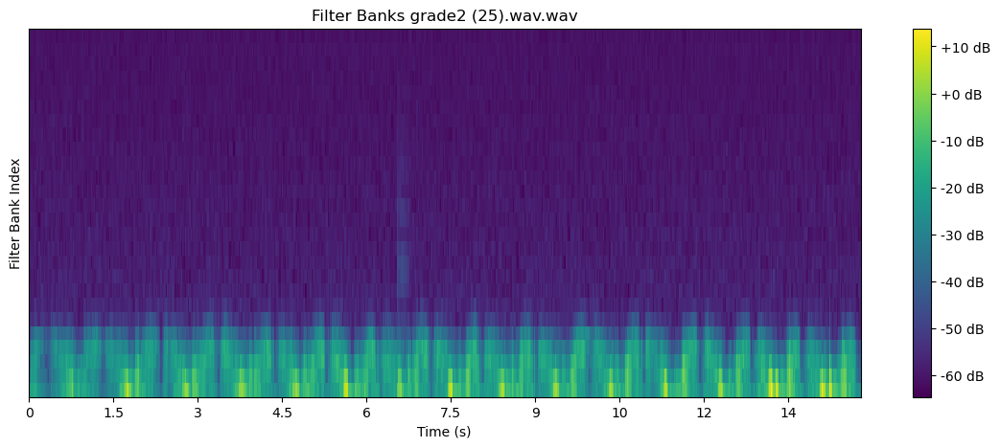

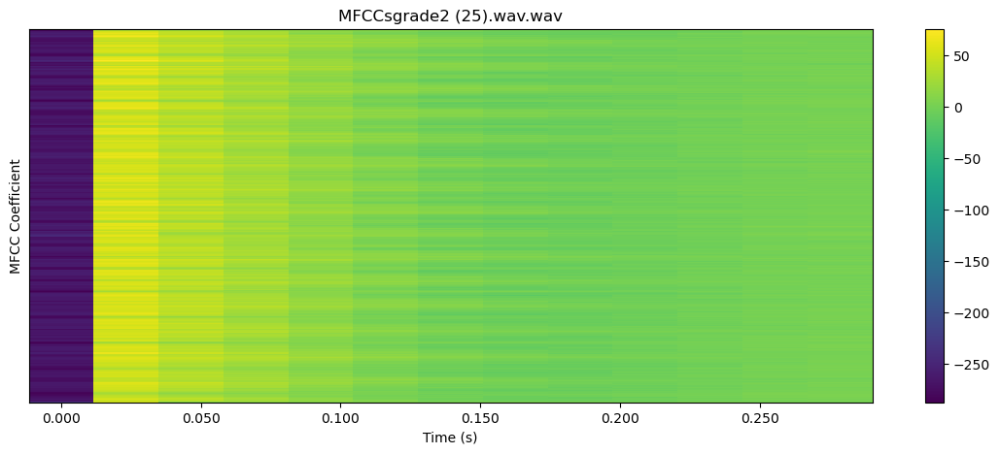


 38%|███▊      | 54/141 [01:25<02:07,  1.47s/it]

22050


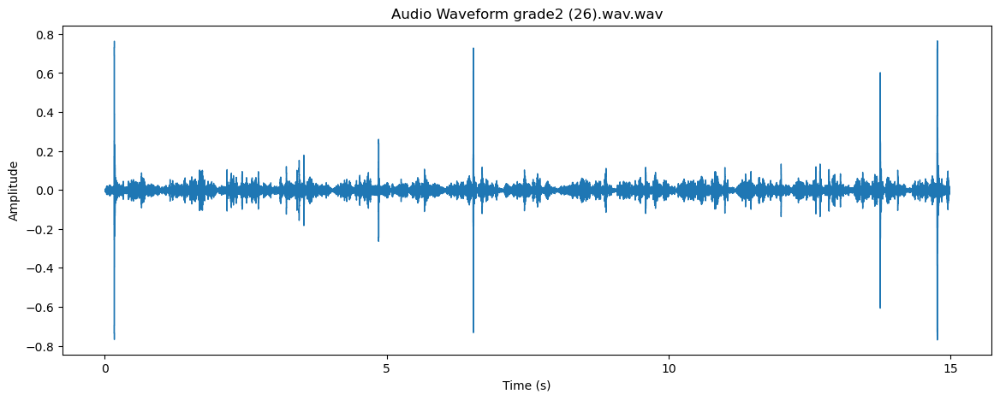

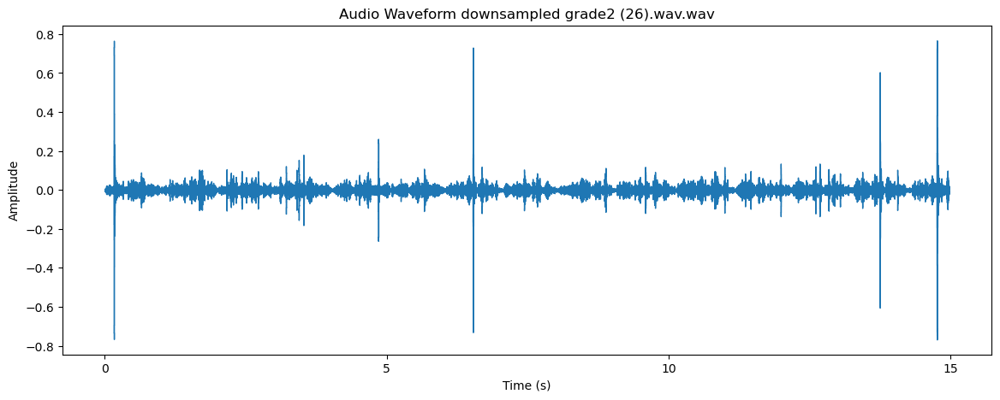

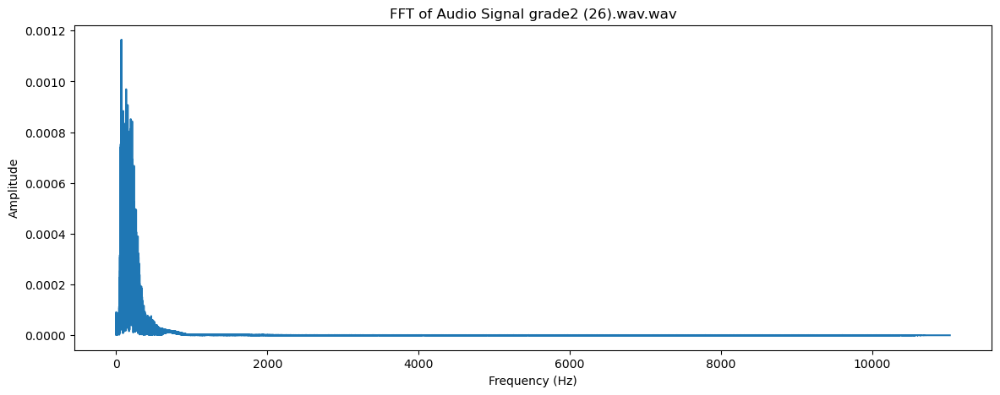

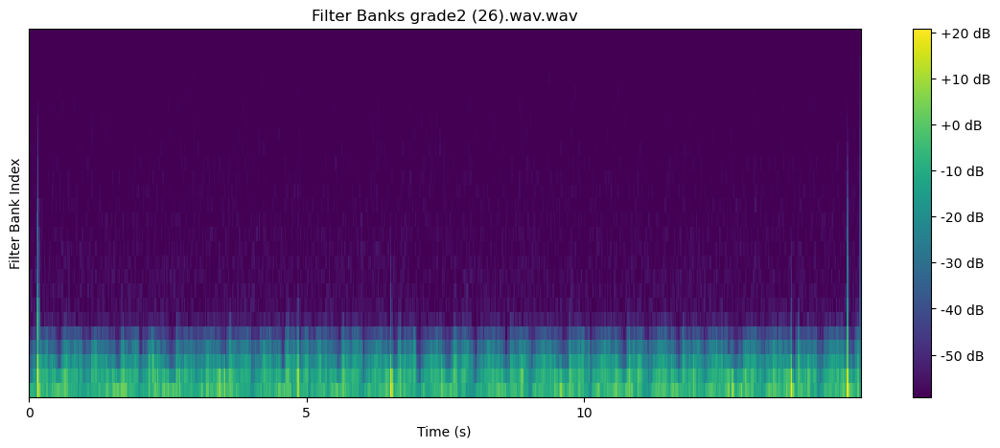

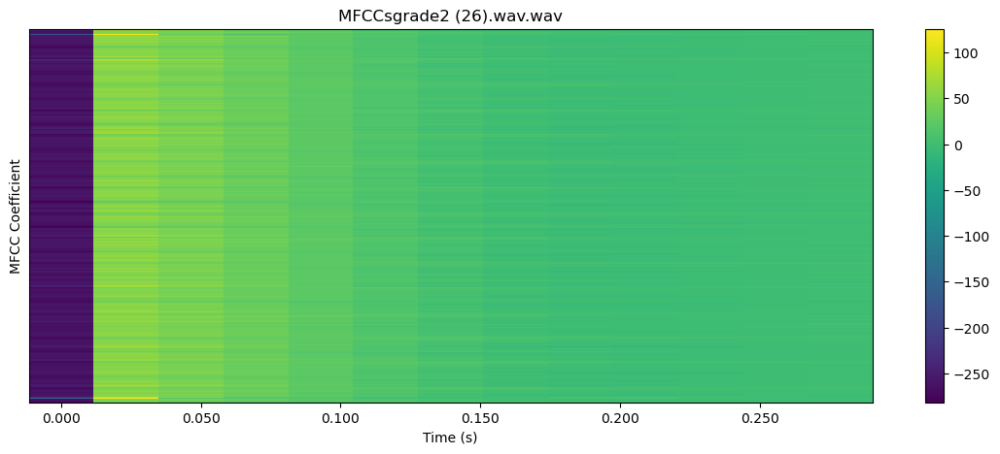


 39%|███▉      | 55/141 [01:27<02:05,  1.46s/it]

22050


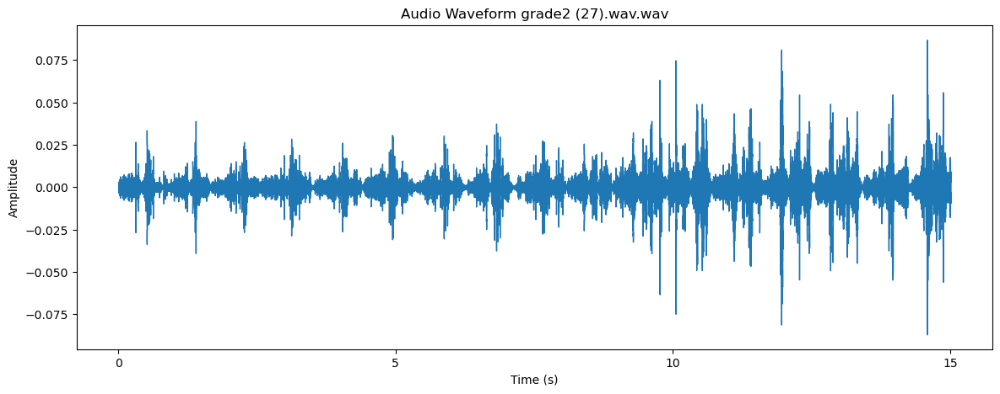

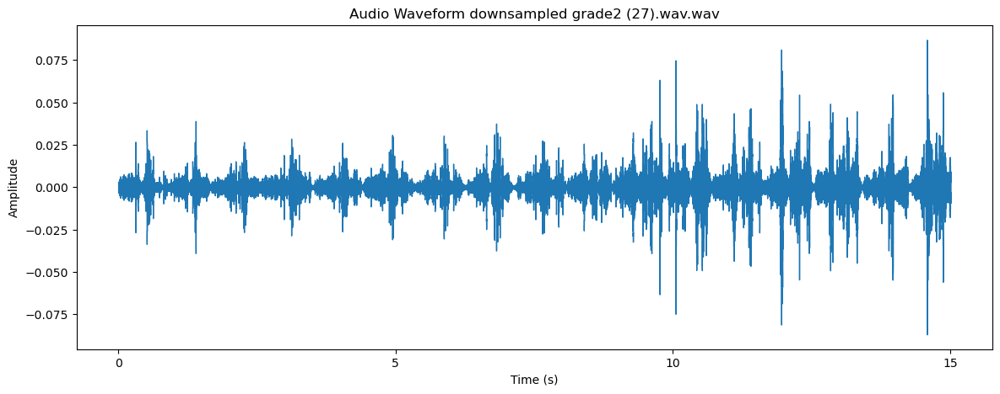

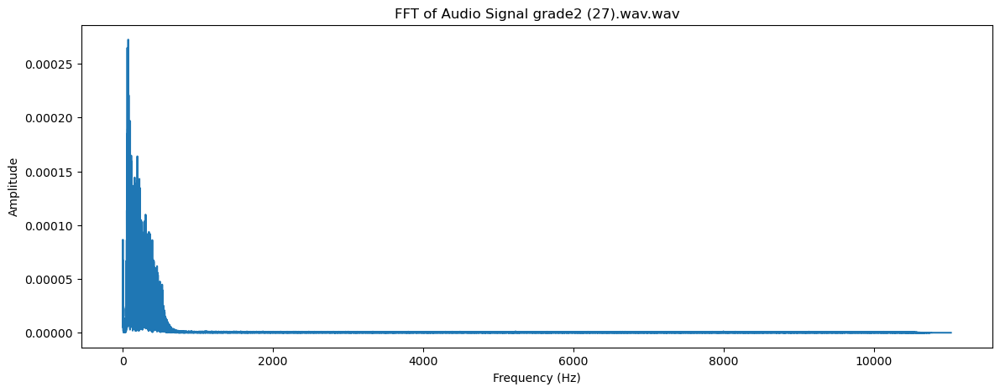

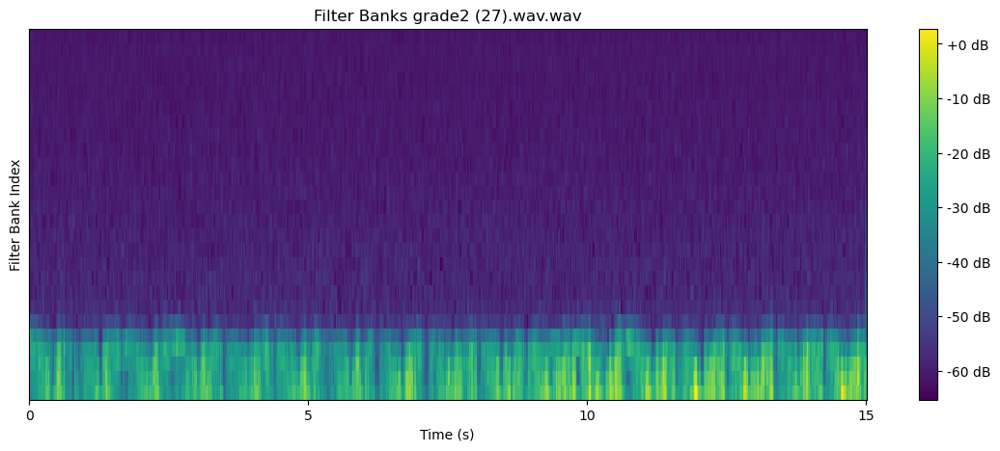

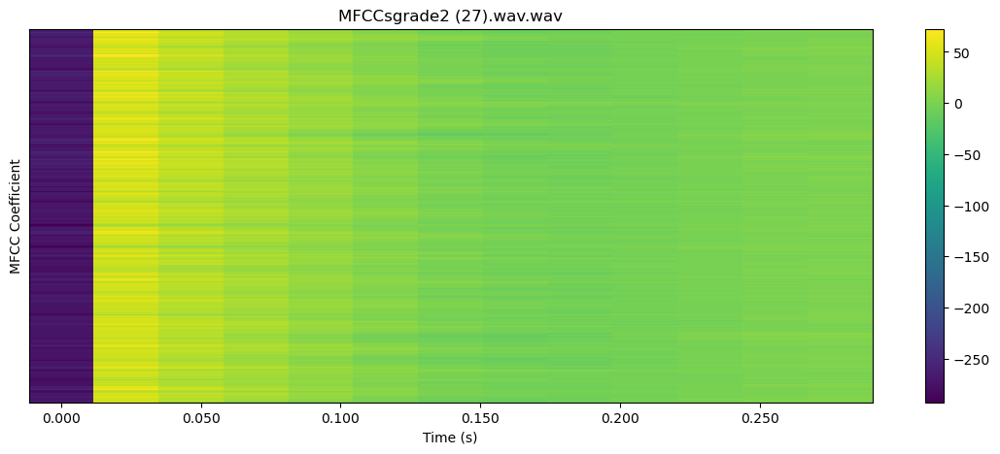


 40%|███▉      | 56/141 [01:28<02:09,  1.53s/it]

22050


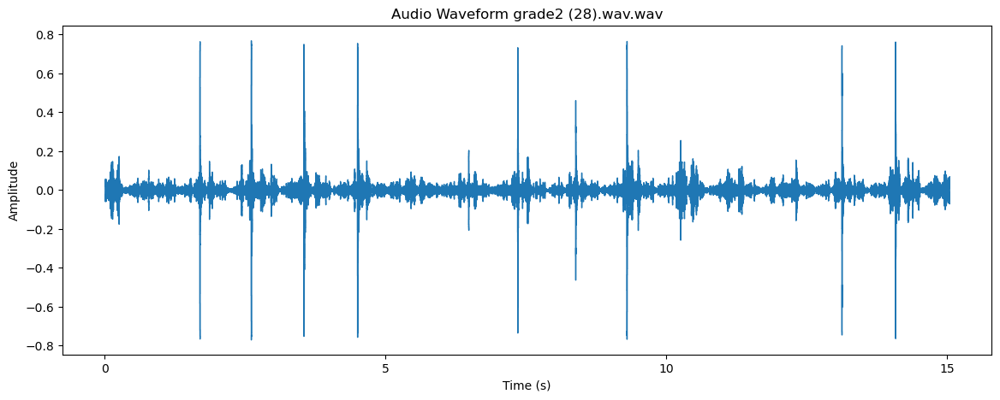

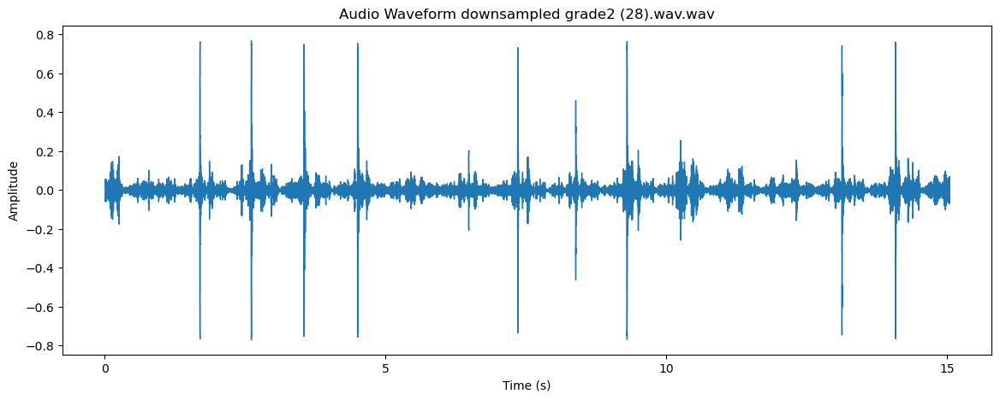

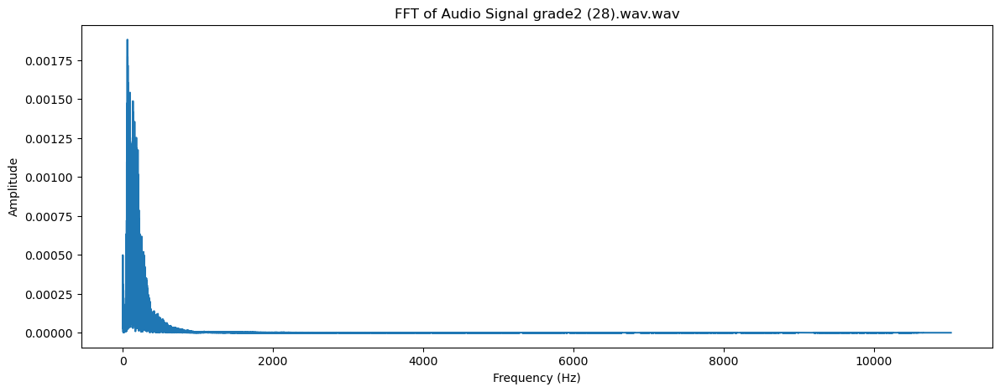

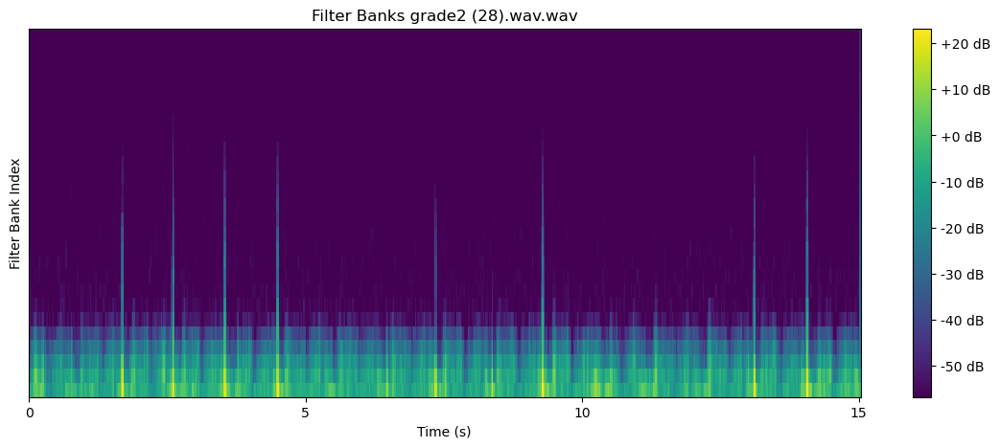

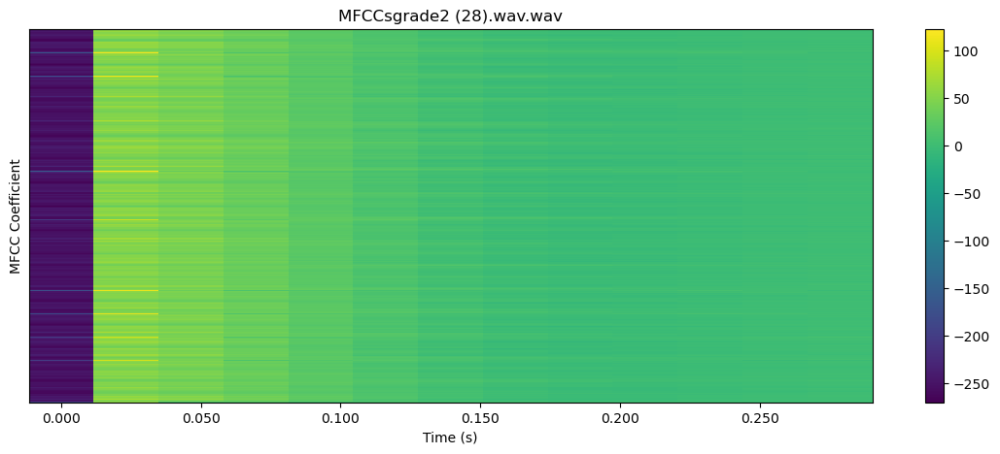


 40%|████      | 57/141 [01:30<02:21,  1.68s/it]

22050


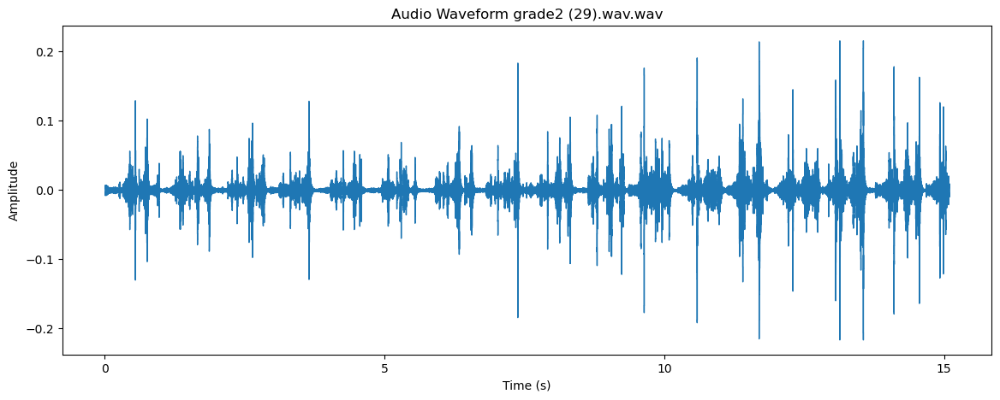

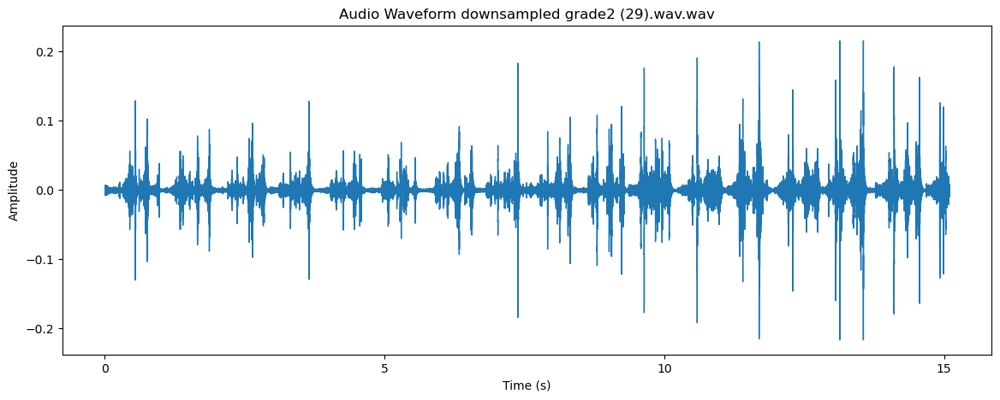

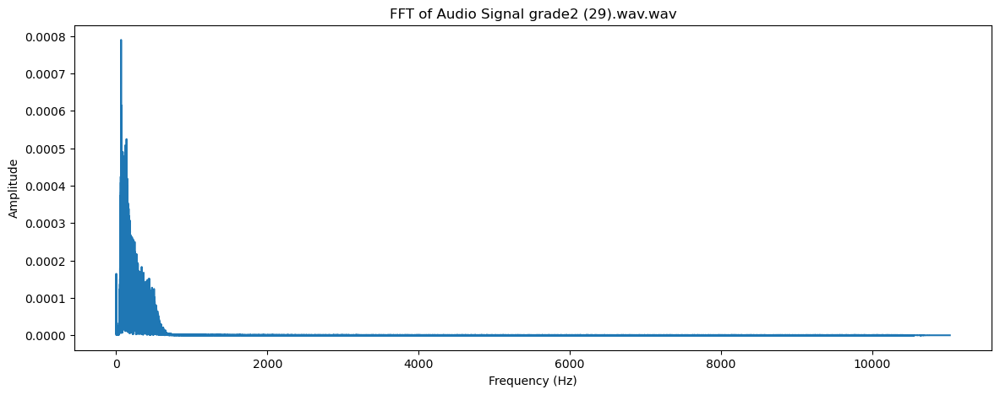

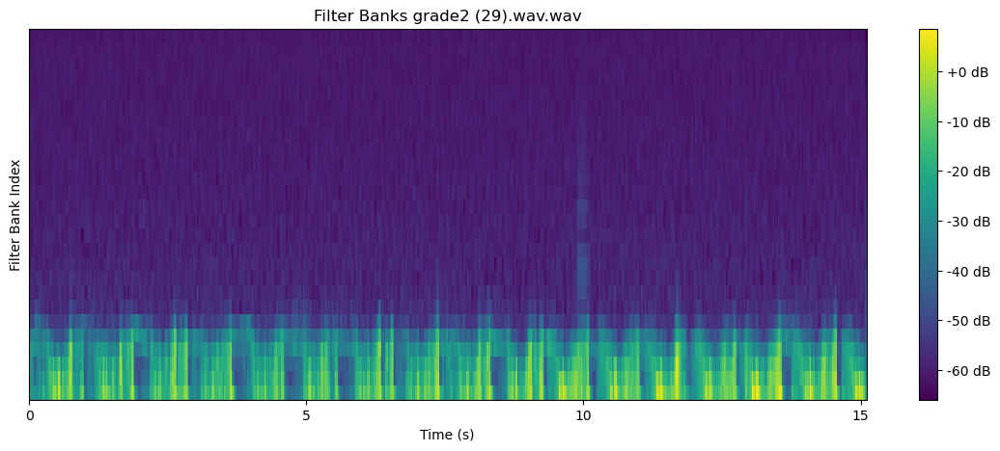

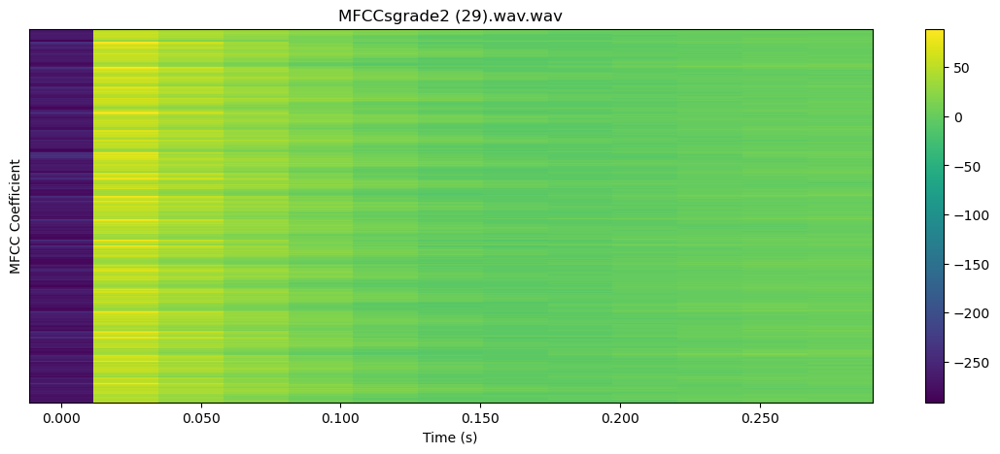


 41%|████      | 58/141 [01:33<02:28,  1.79s/it]

22050


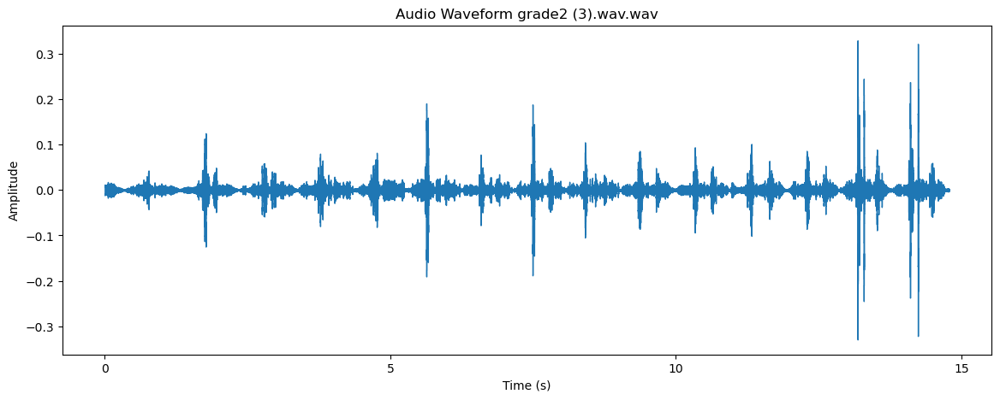

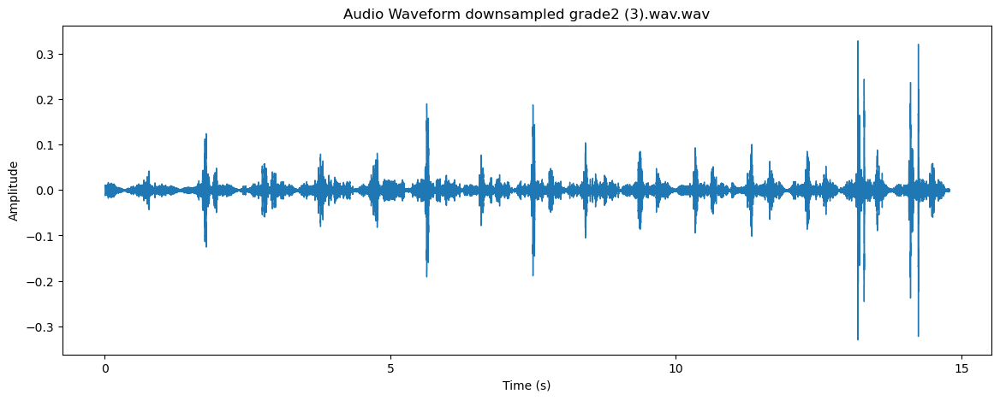

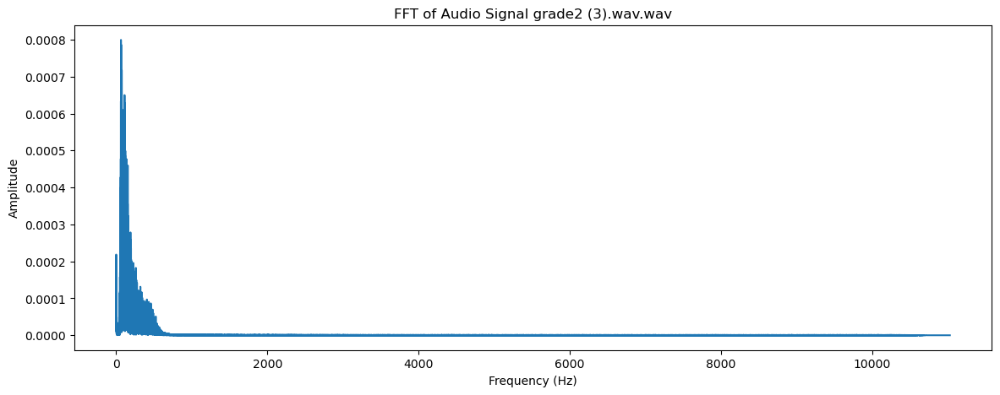

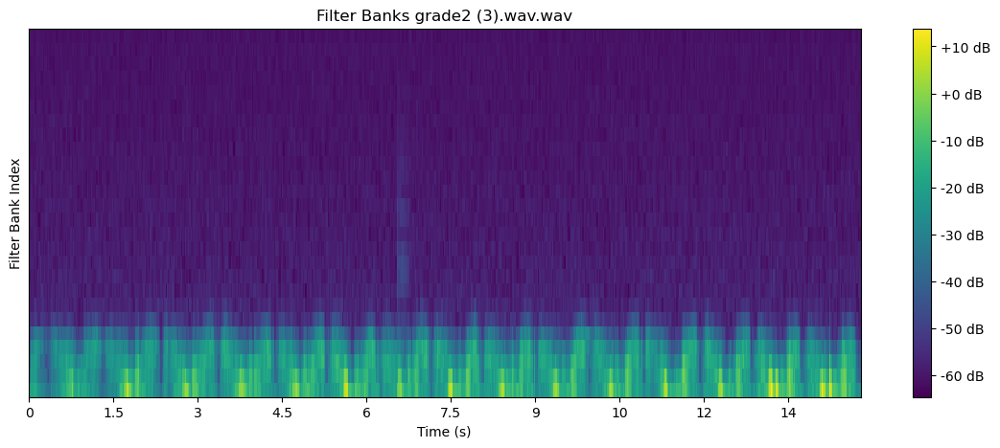

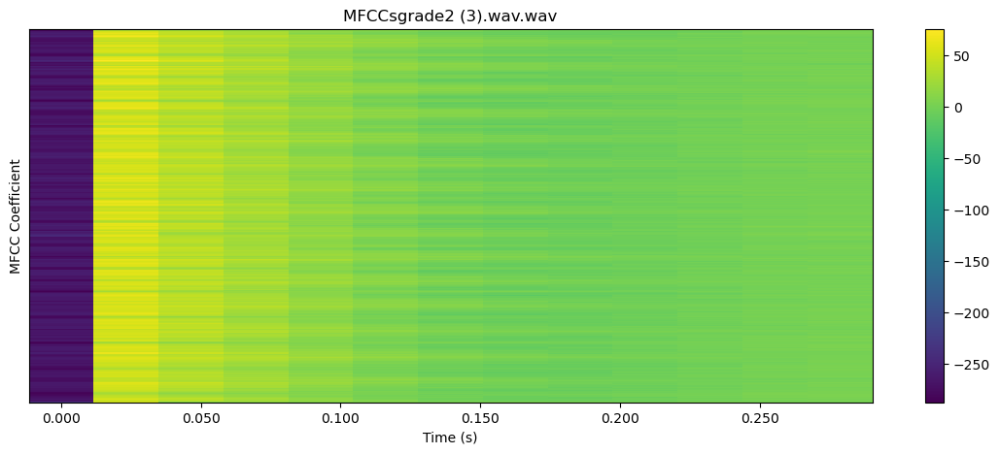


 42%|████▏     | 59/141 [01:34<02:17,  1.68s/it]

22050


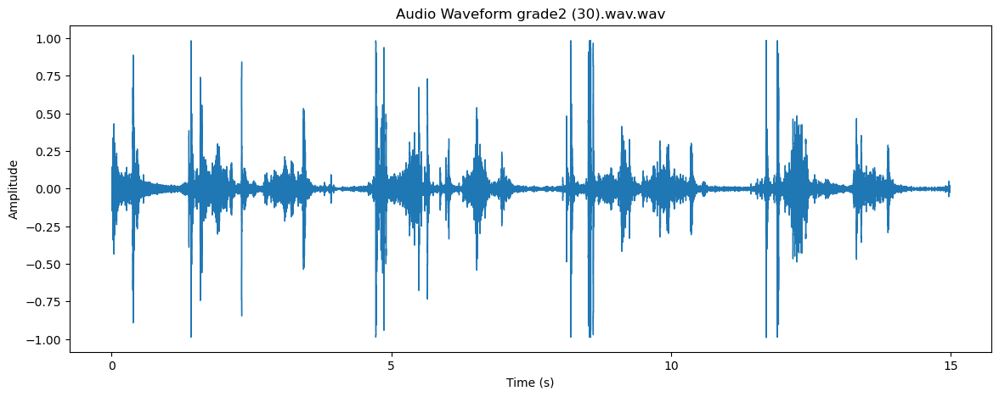

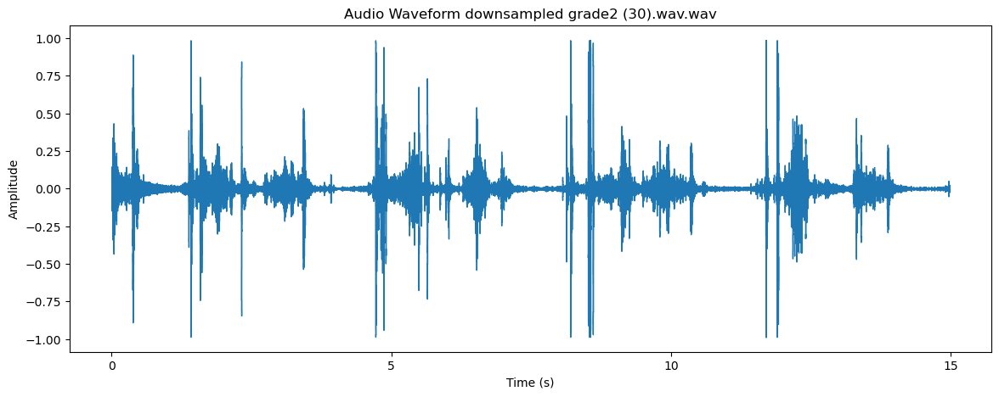

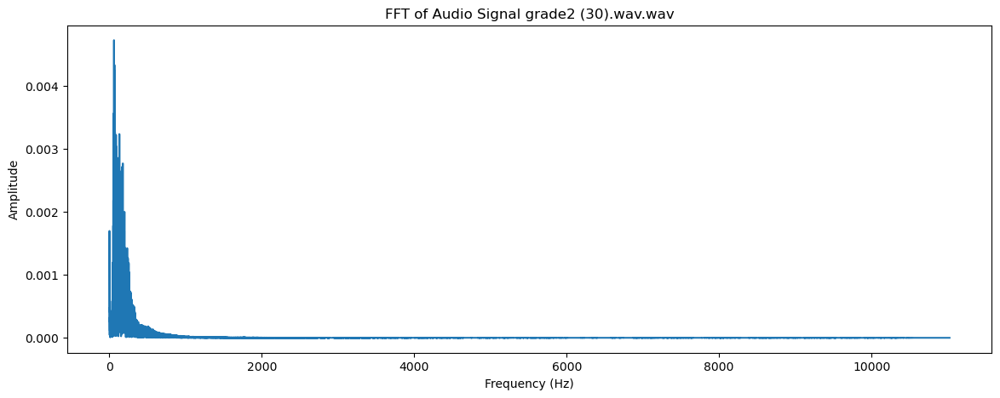

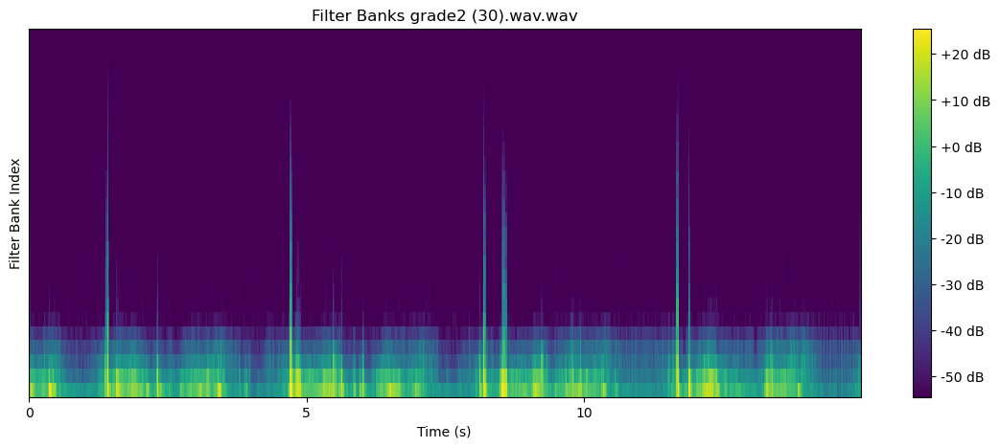

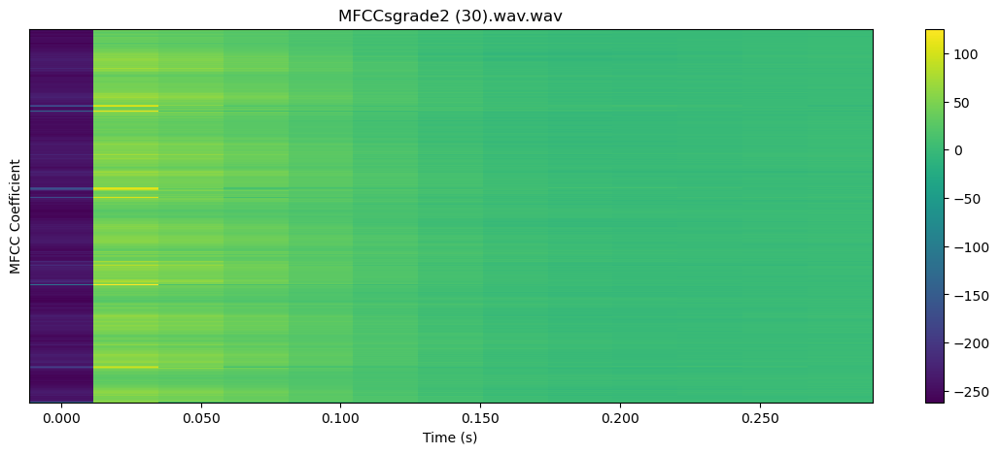


 43%|████▎     | 60/141 [01:36<02:13,  1.64s/it]

22050


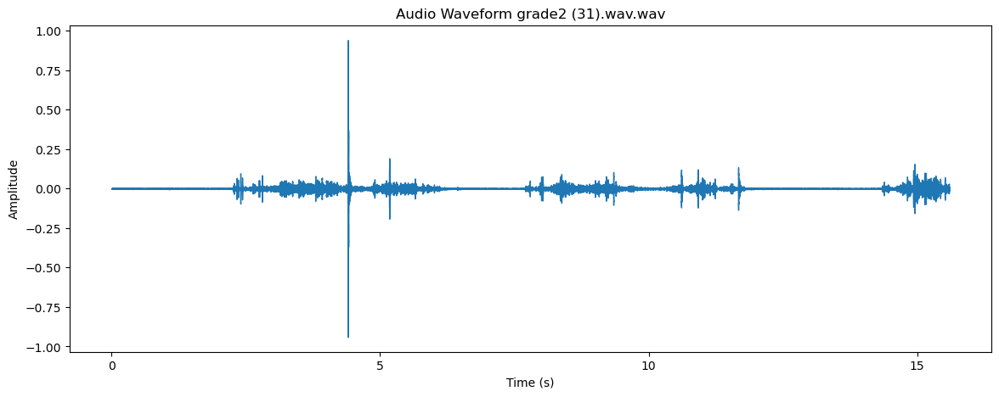

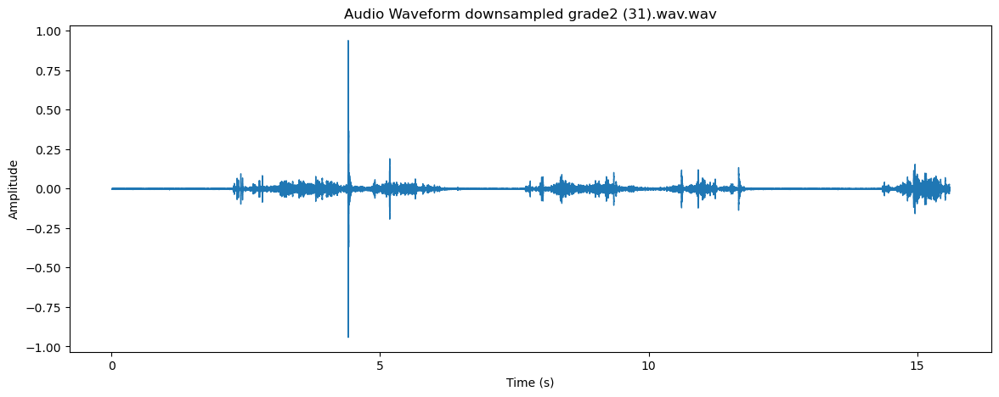

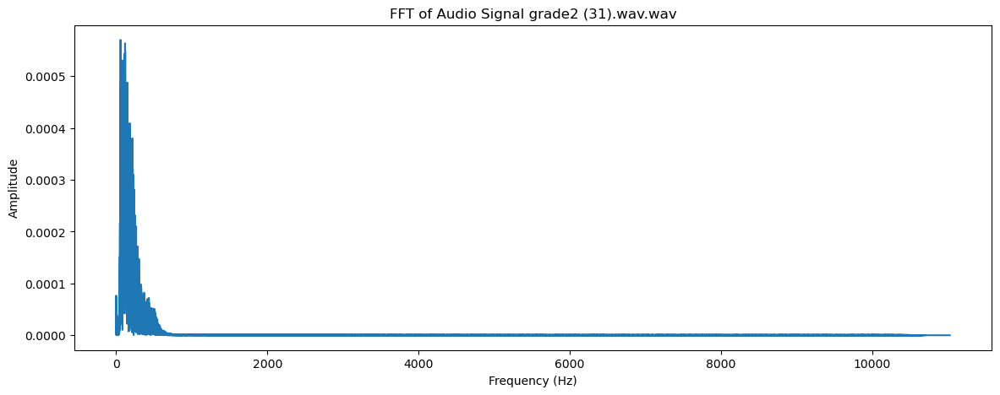

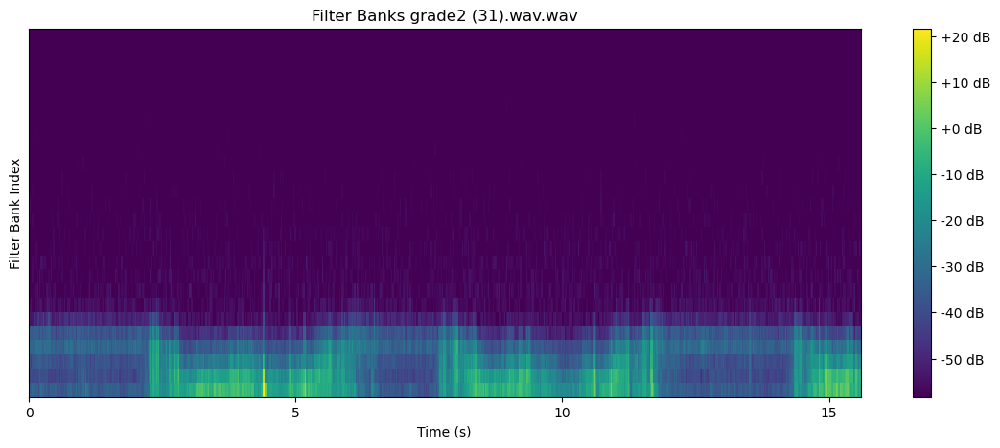

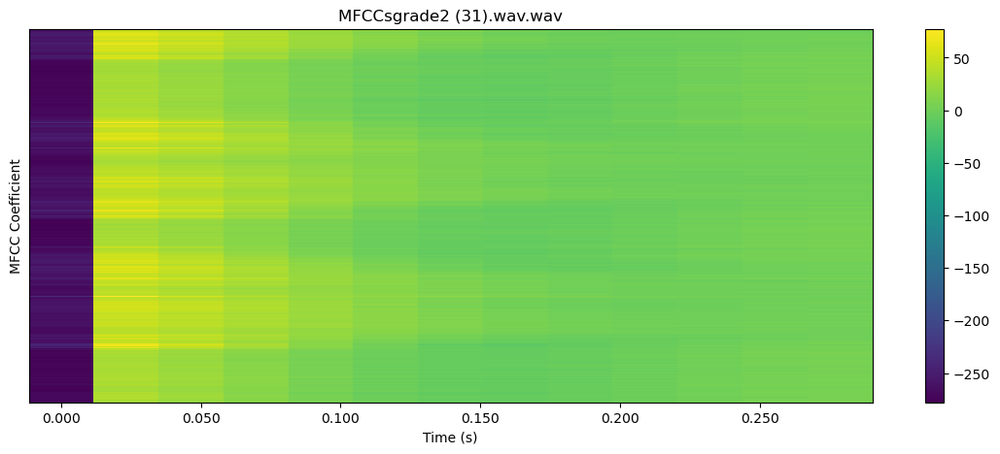


 43%|████▎     | 61/141 [01:37<02:08,  1.61s/it]

22050


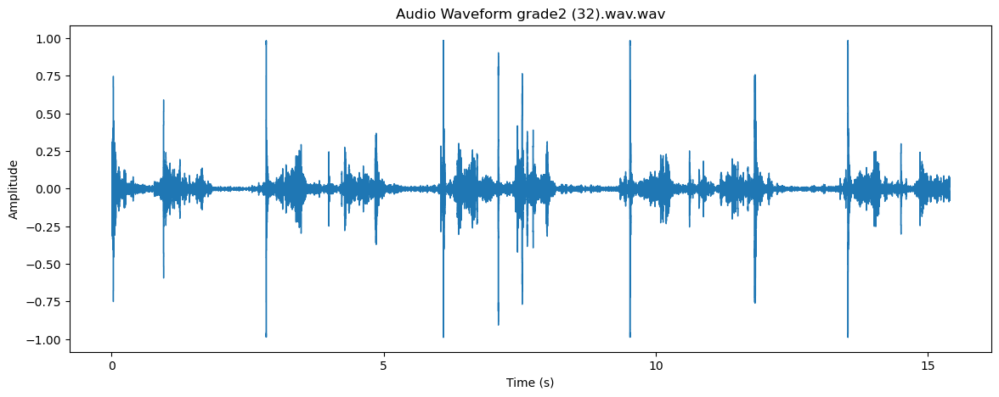

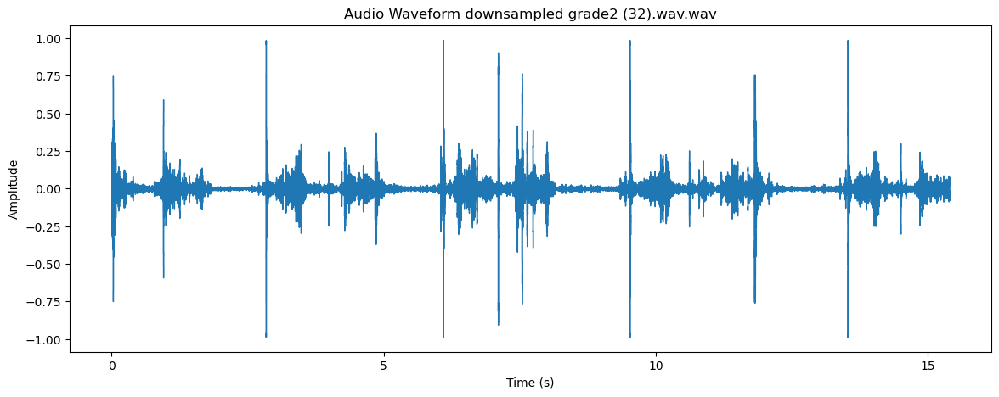

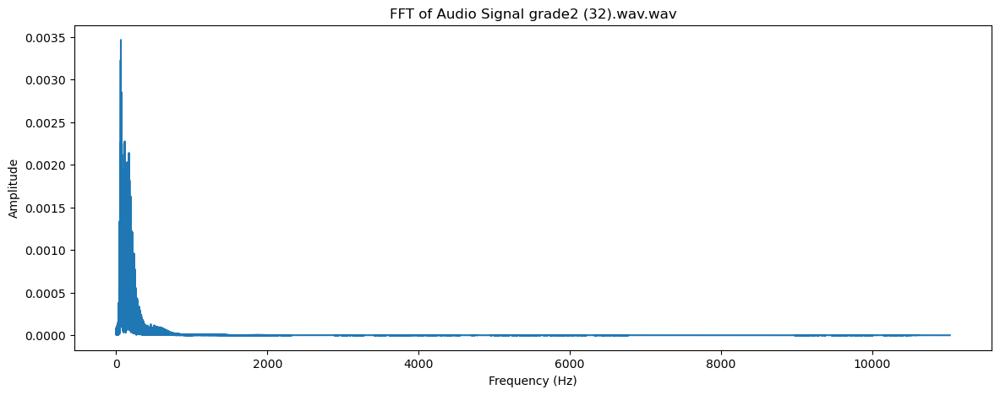

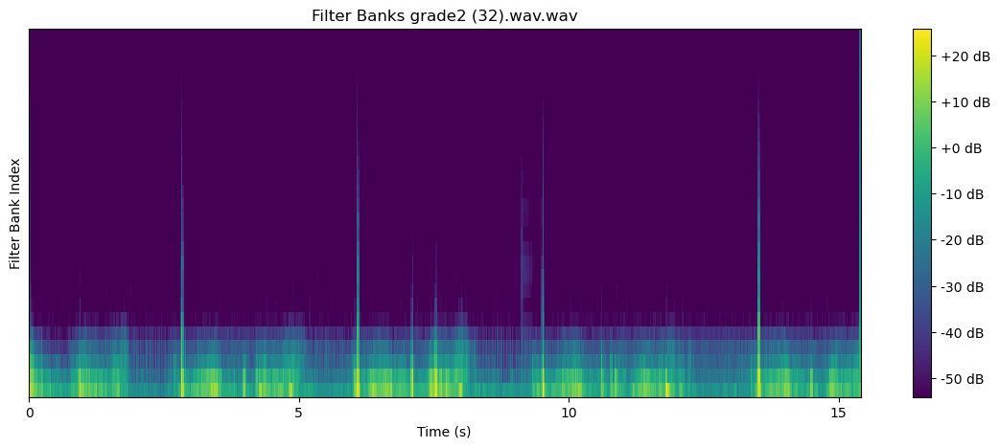

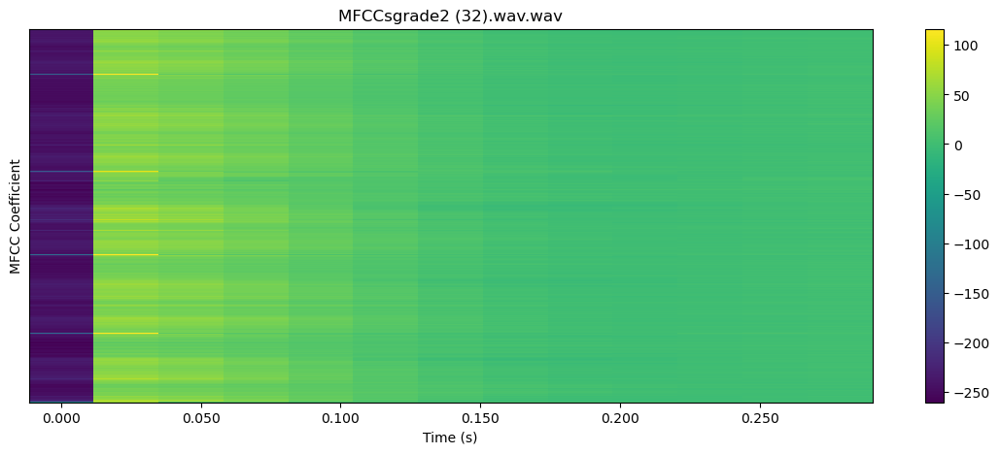


 44%|████▍     | 62/141 [01:39<02:15,  1.71s/it]

22050


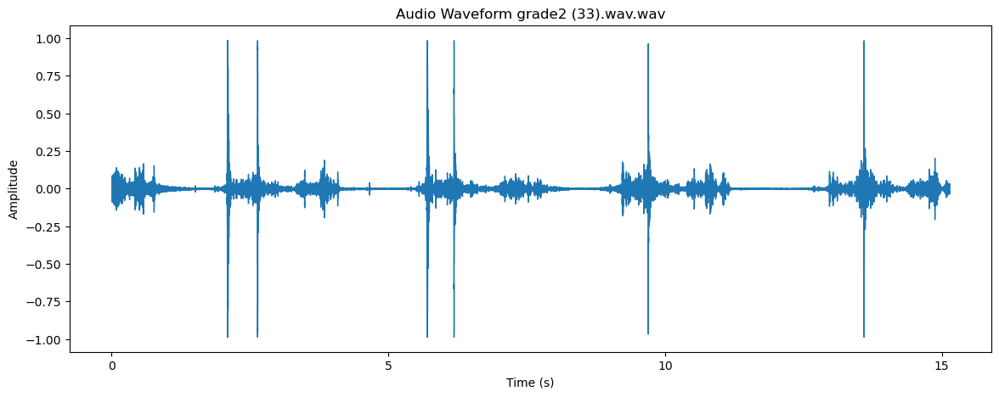

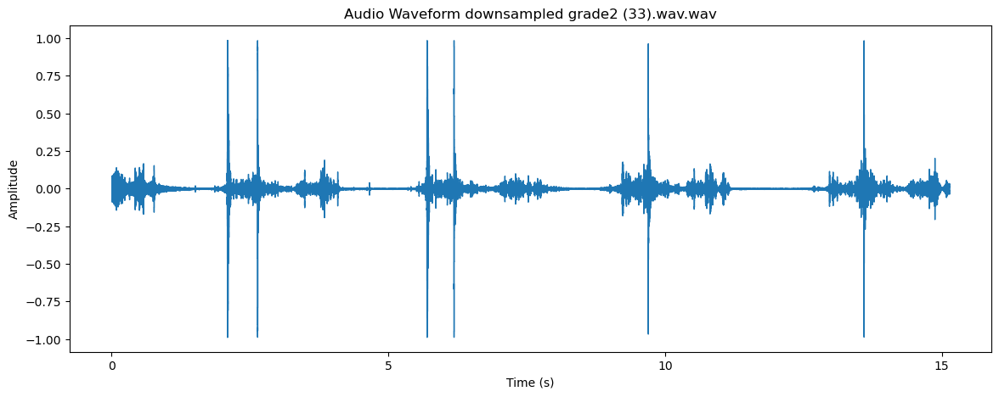

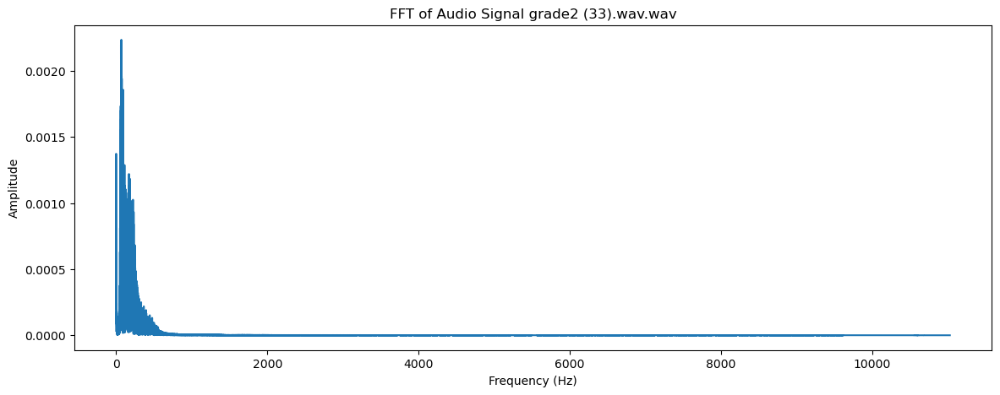

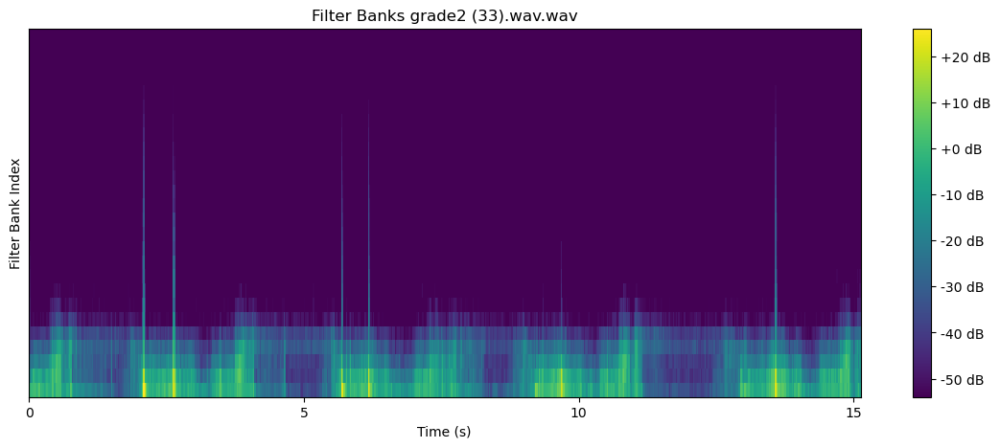

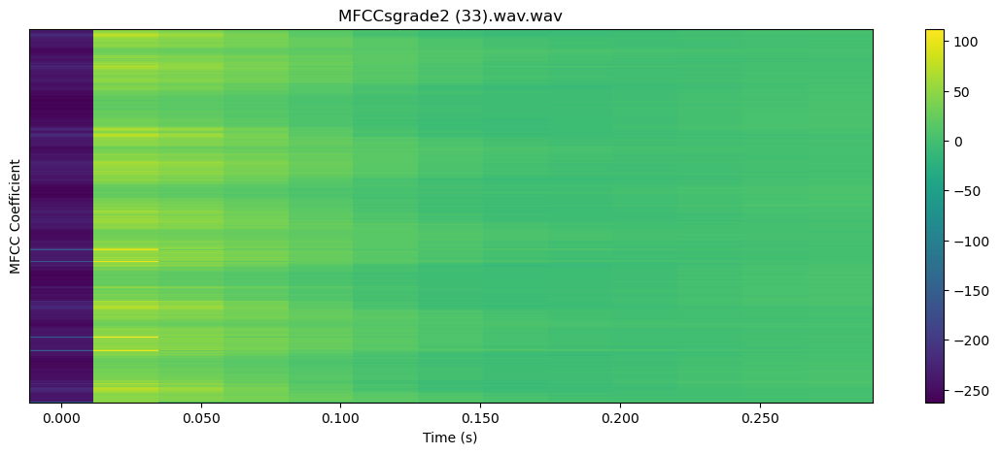


 45%|████▍     | 63/141 [01:41<02:21,  1.81s/it]

22050


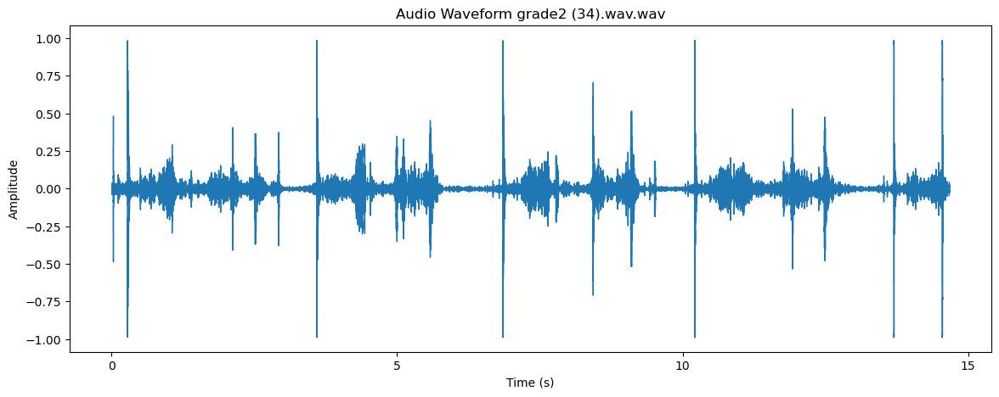

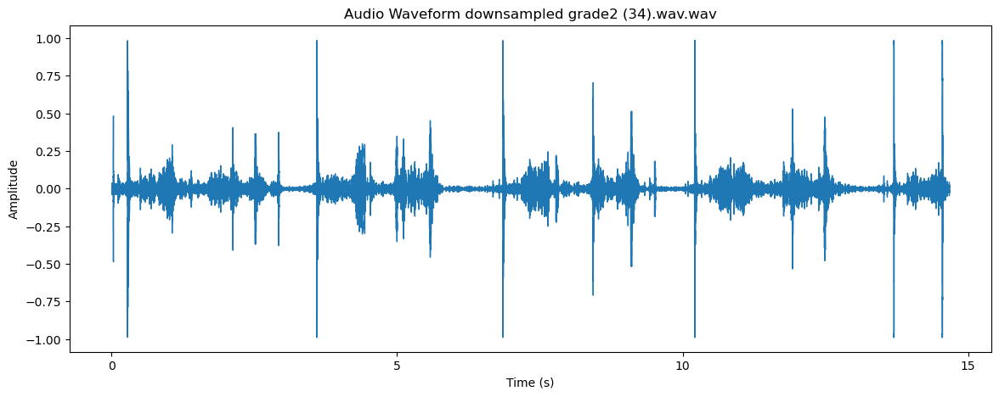

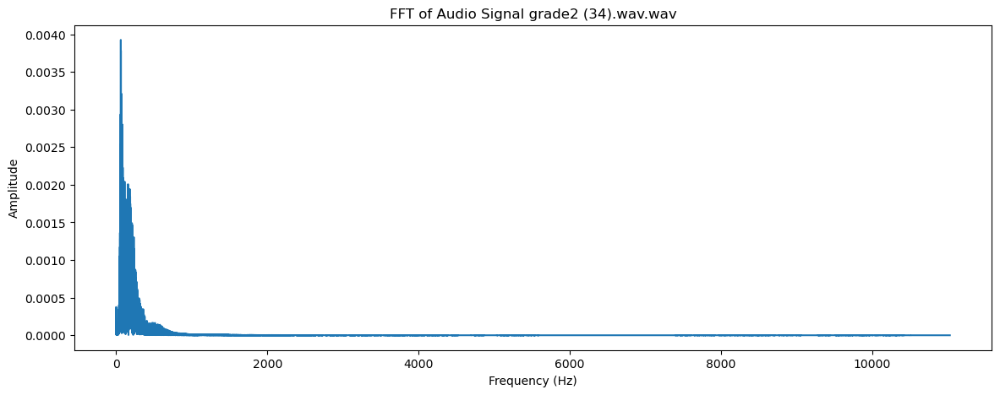

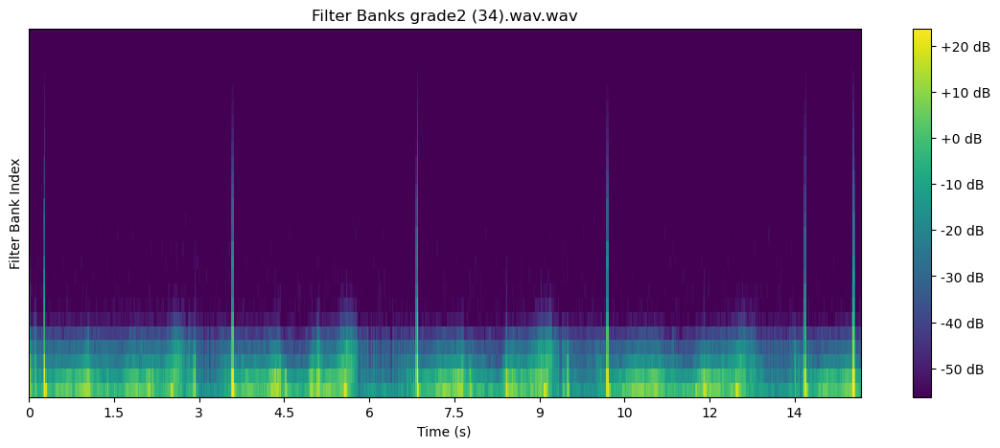

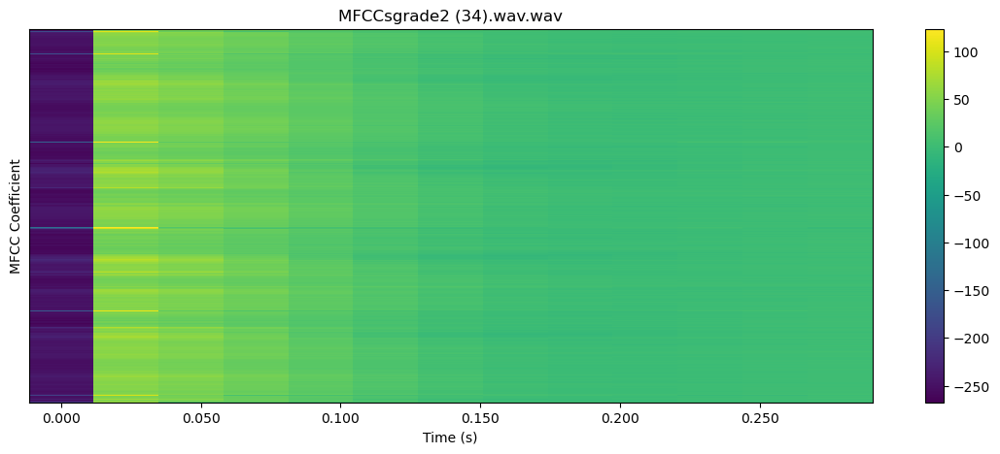


 45%|████▌     | 64/141 [01:43<02:12,  1.72s/it]

22050


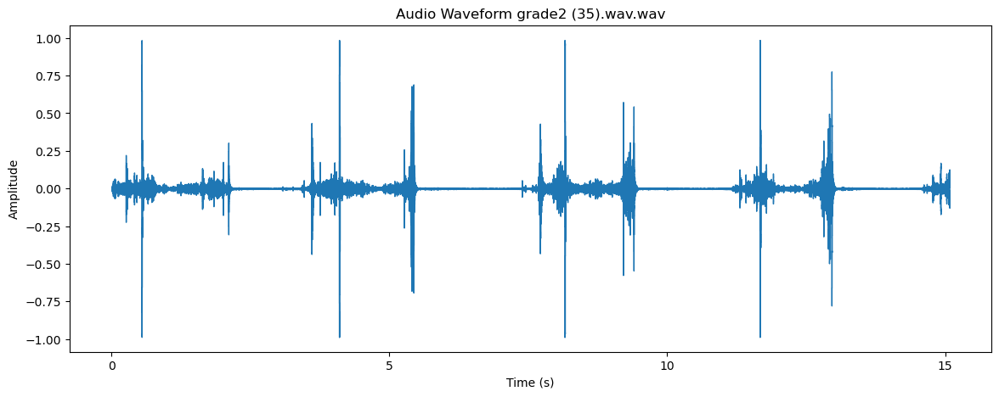

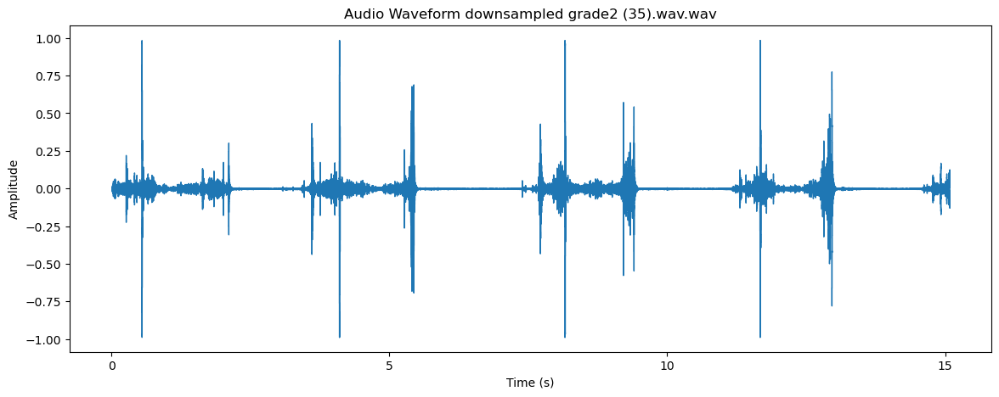

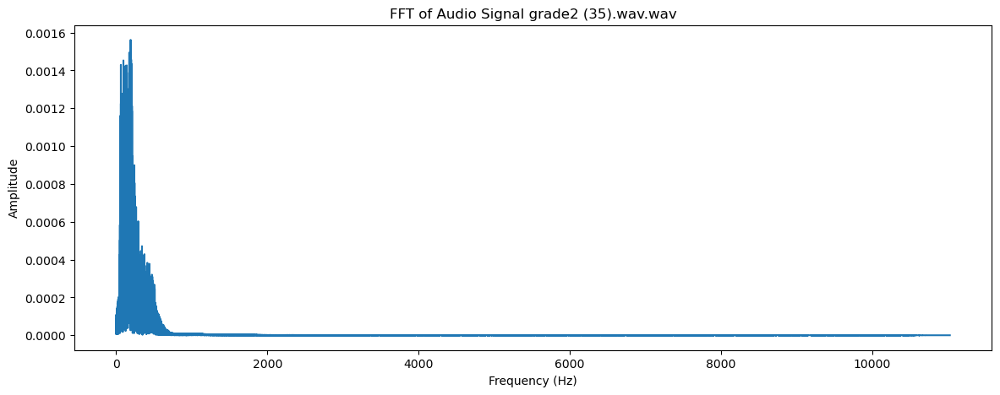

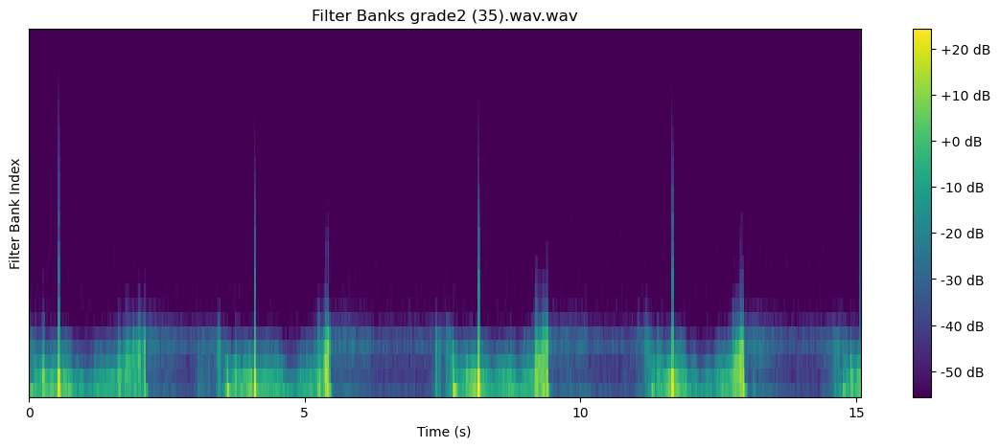

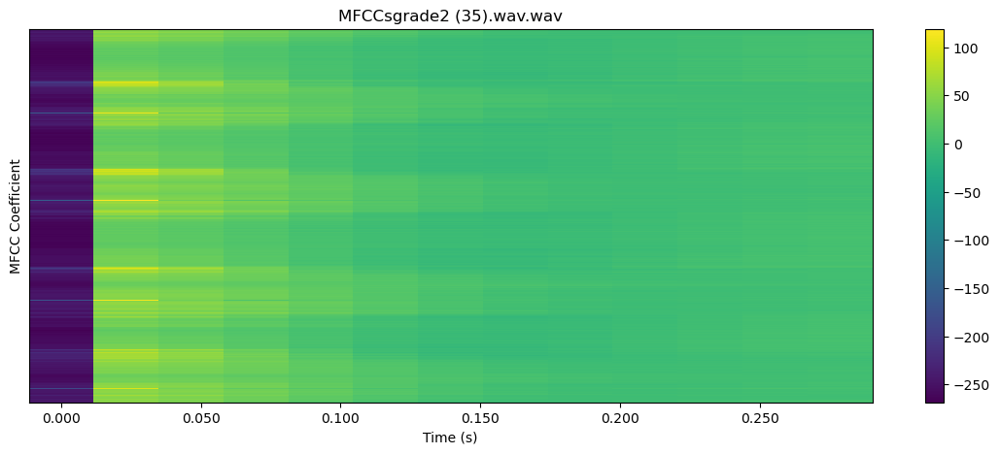


 46%|████▌     | 65/141 [01:44<02:08,  1.69s/it]

22050


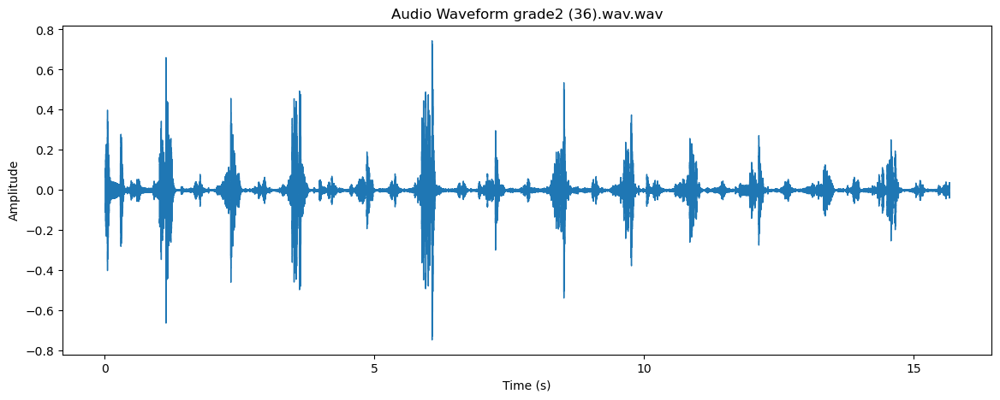

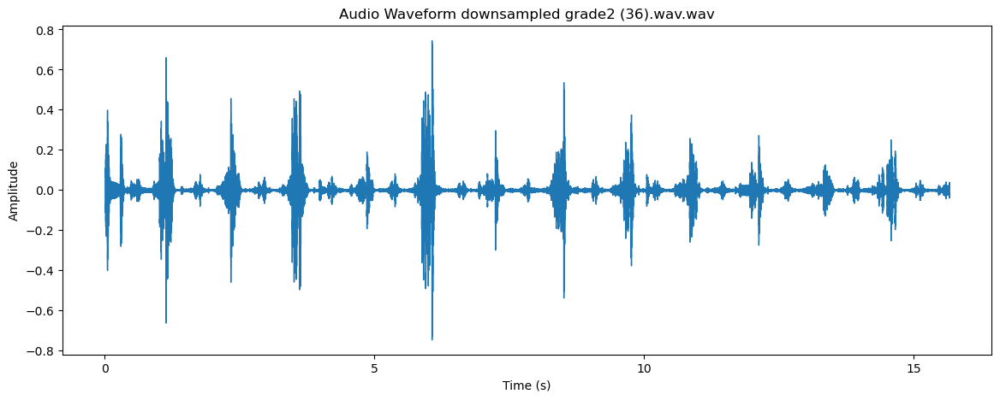

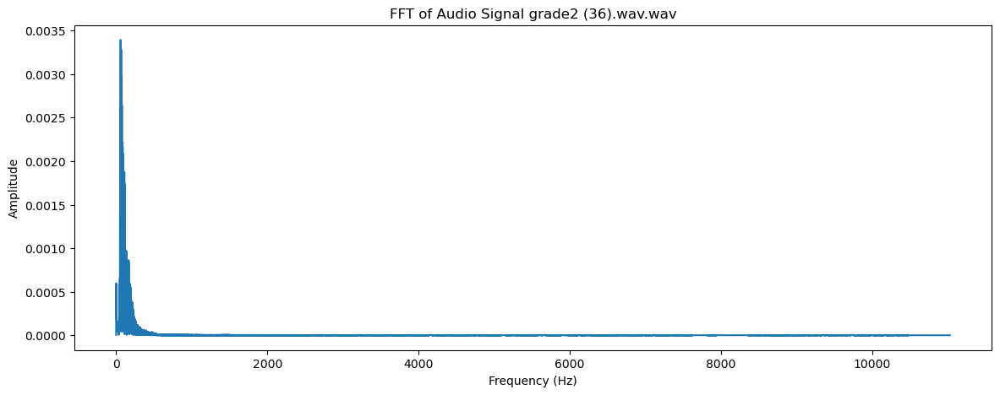

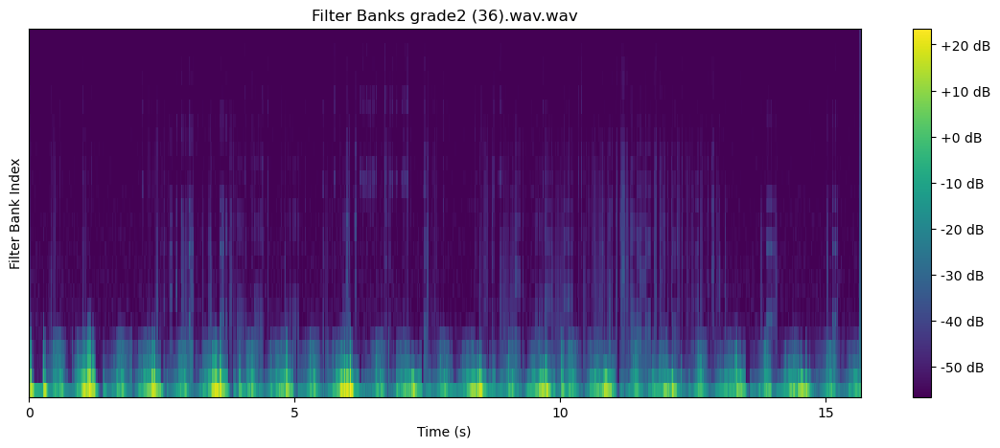

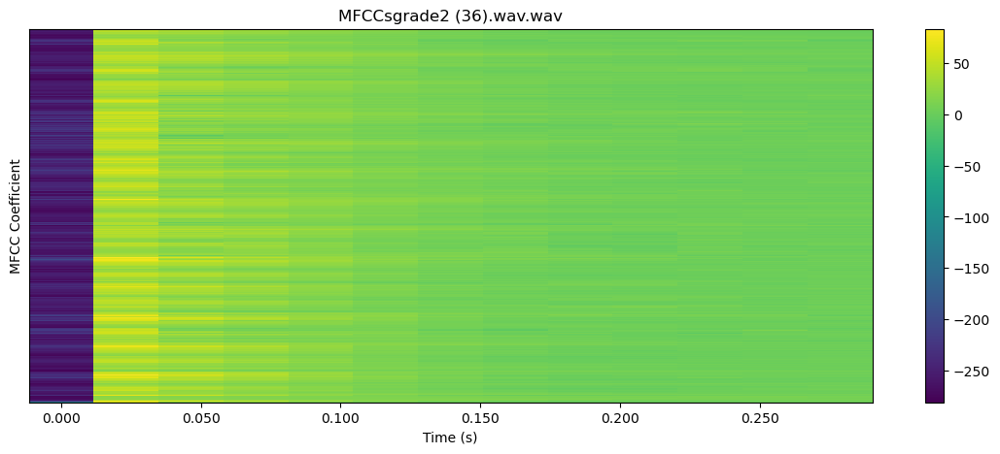


 47%|████▋     | 66/141 [01:46<02:11,  1.75s/it]

22050


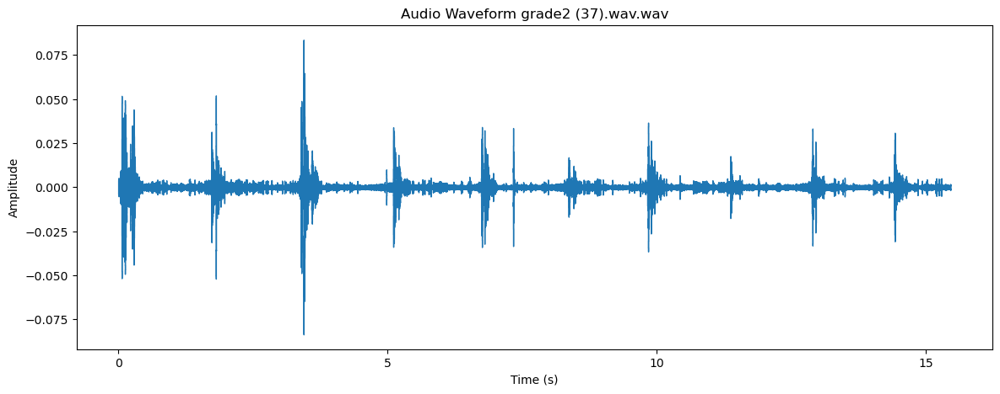

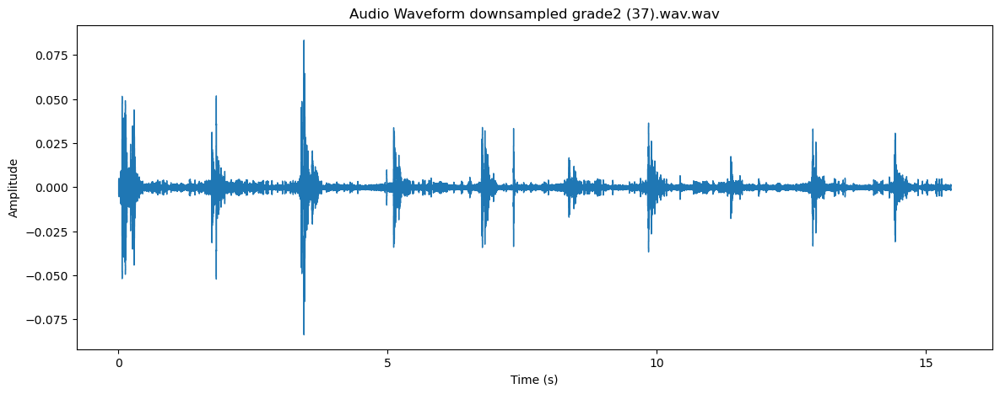

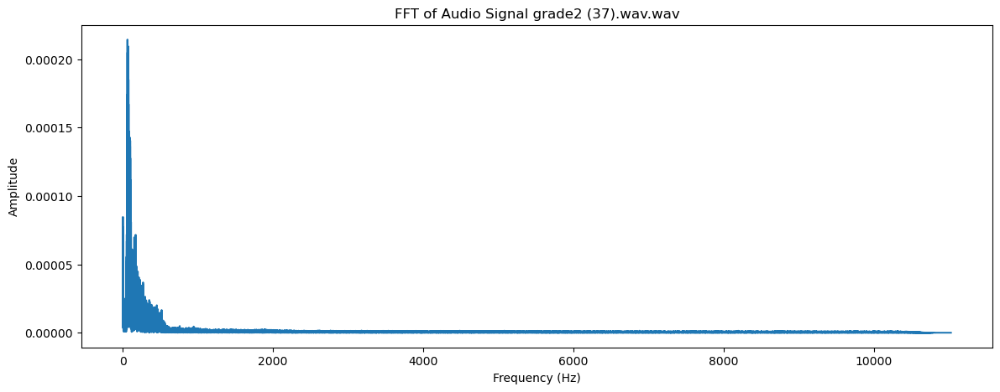

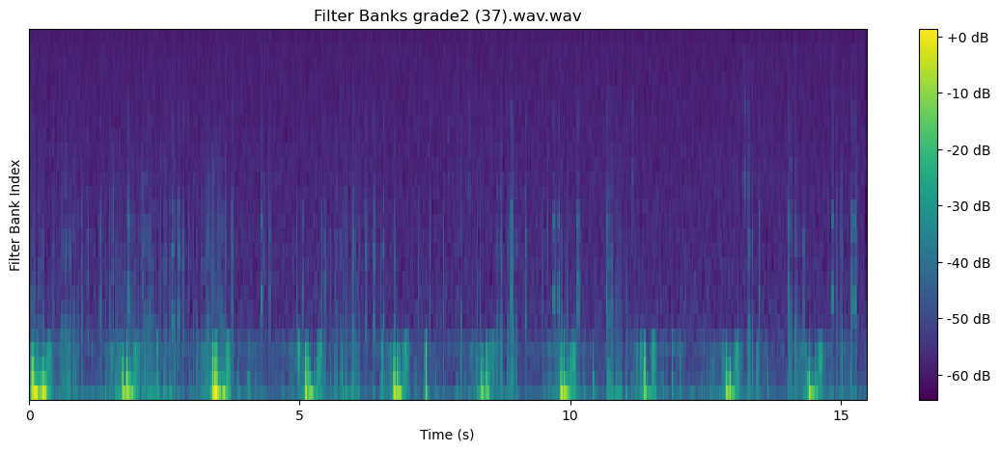

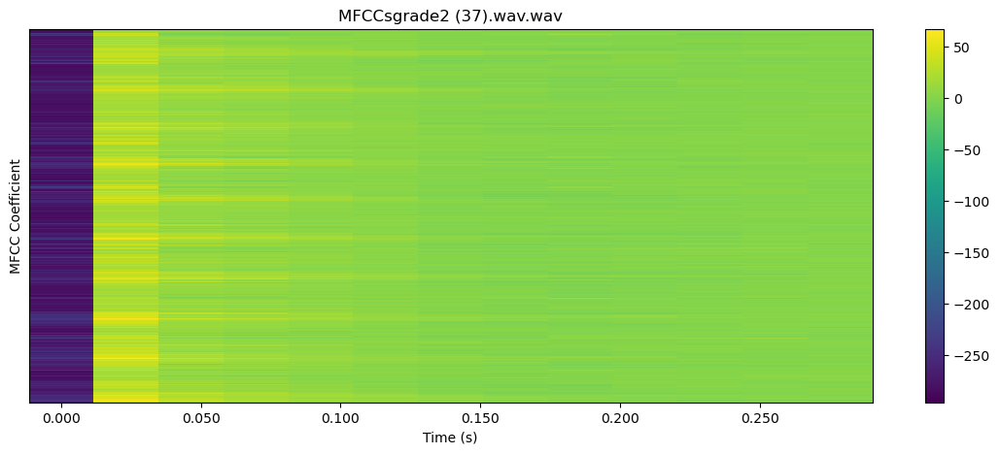


 48%|████▊     | 67/141 [01:48<02:09,  1.75s/it]

22050


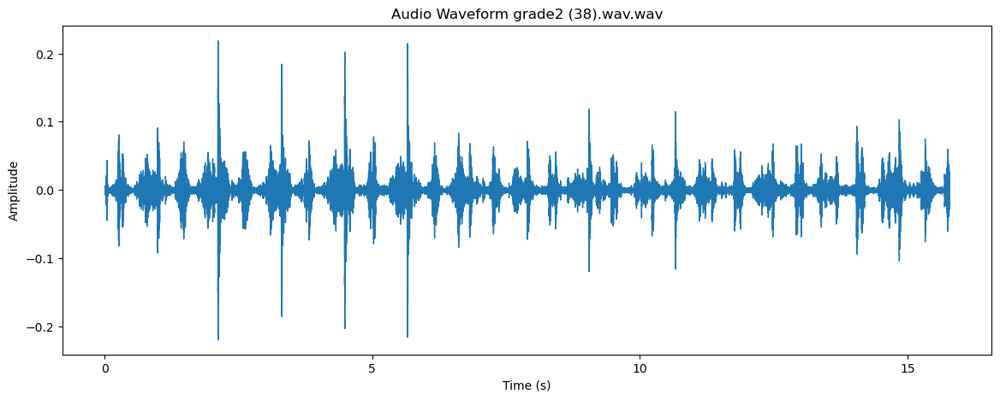

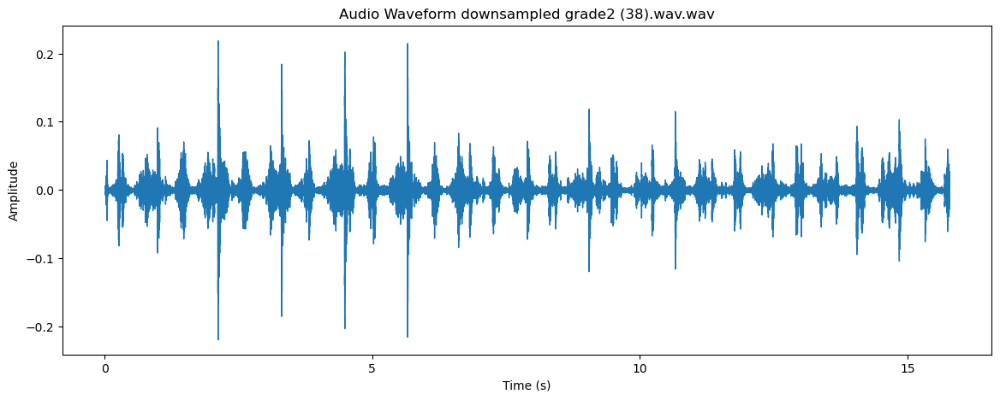

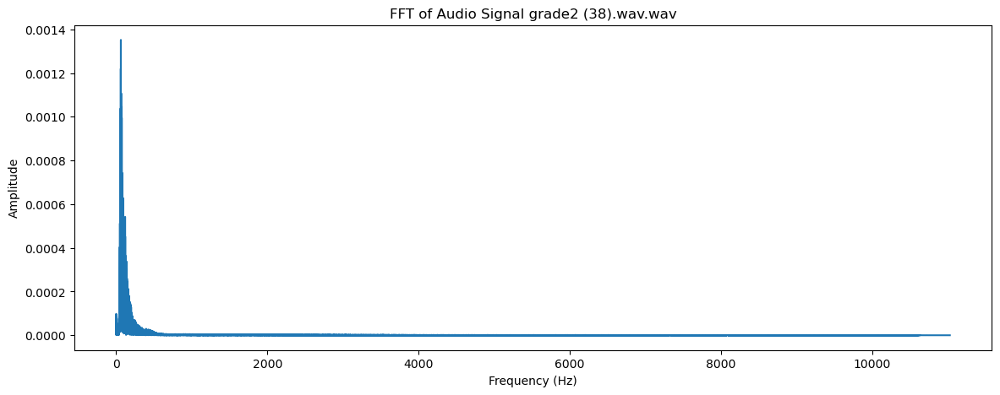

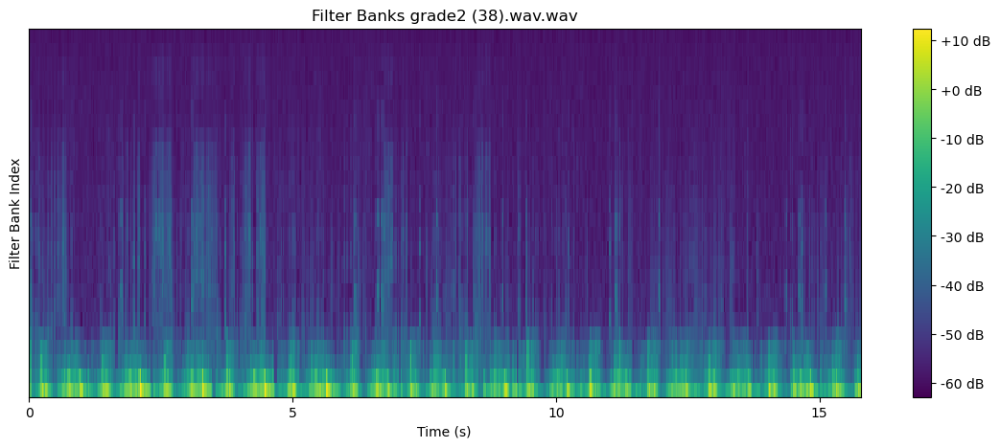

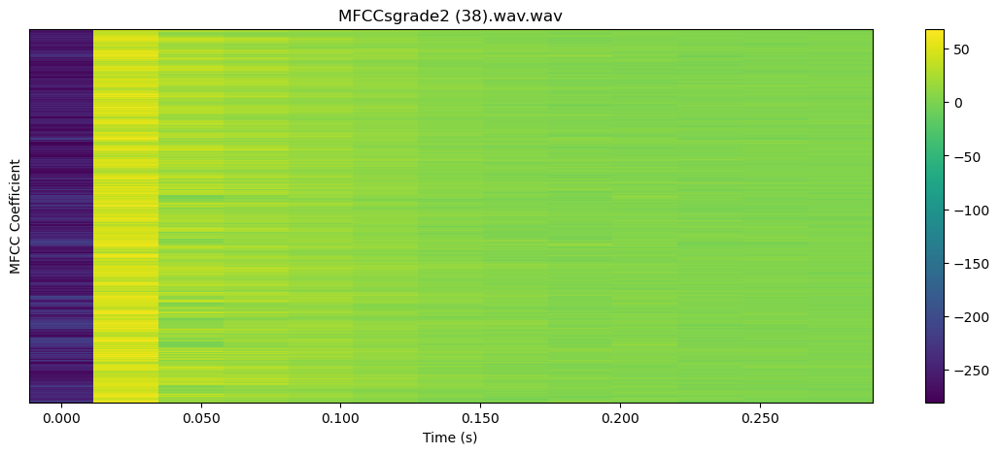


 48%|████▊     | 68/141 [01:49<02:00,  1.66s/it]

22050


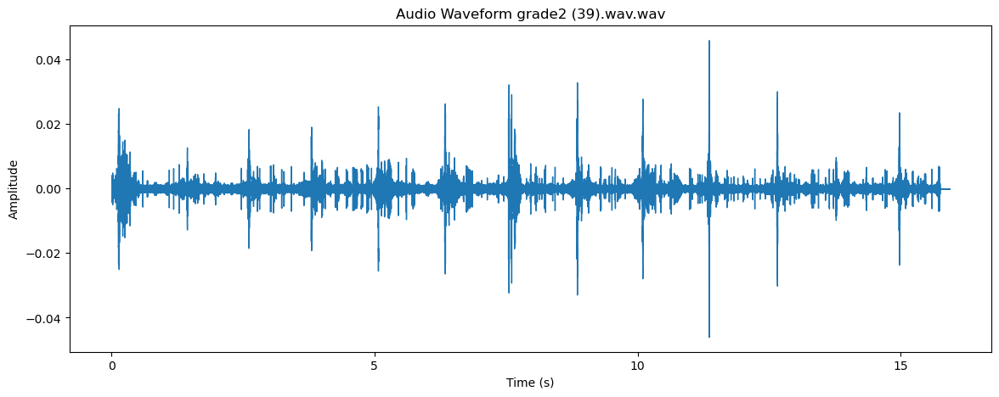

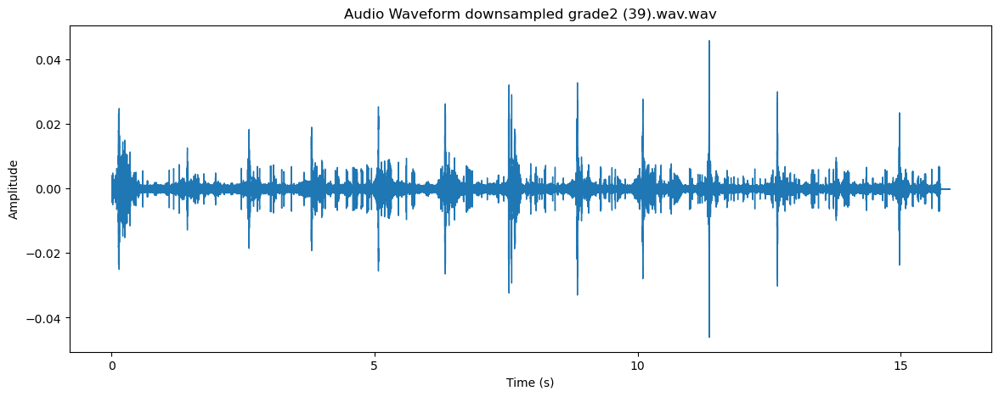

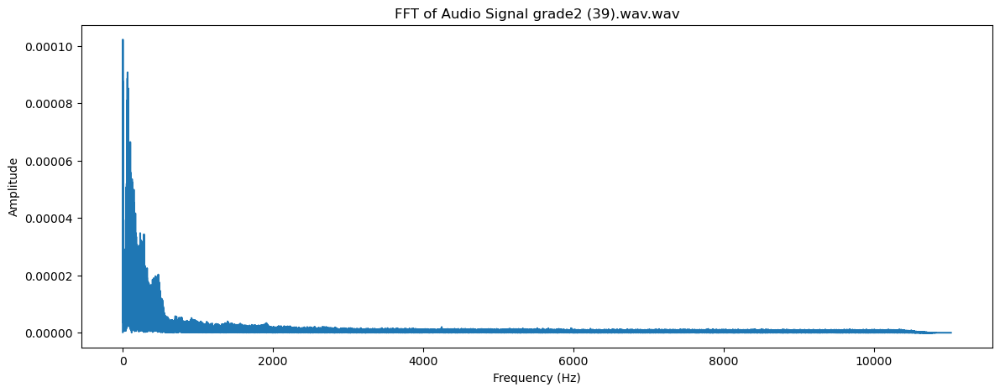

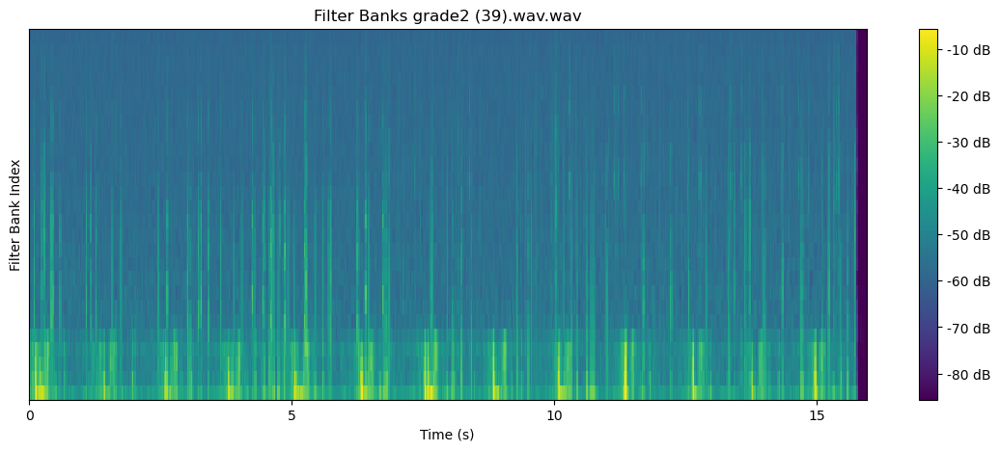

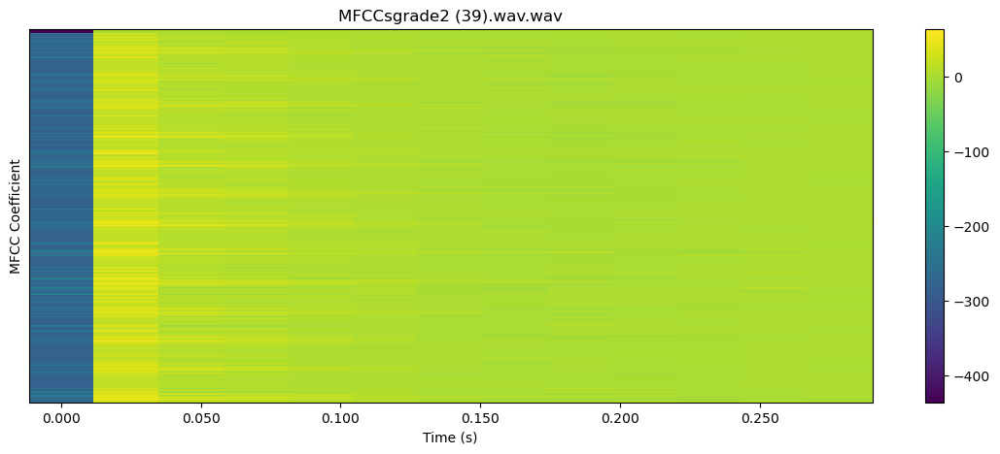


 49%|████▉     | 69/141 [01:51<01:53,  1.57s/it]

22050


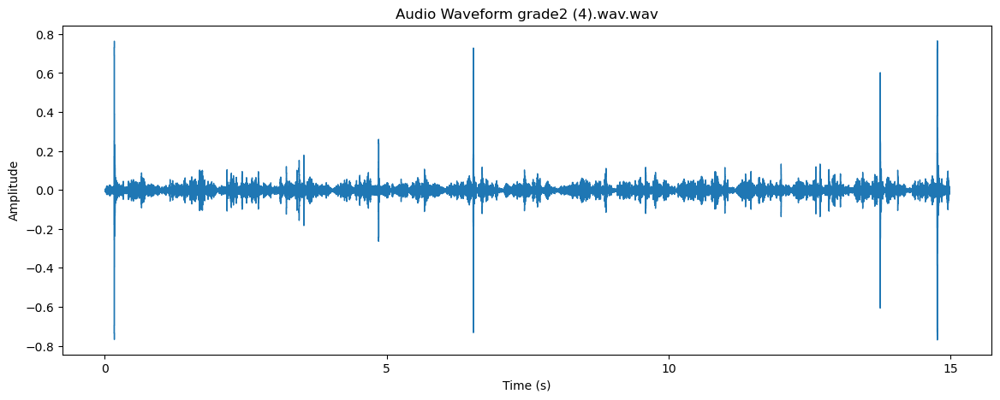

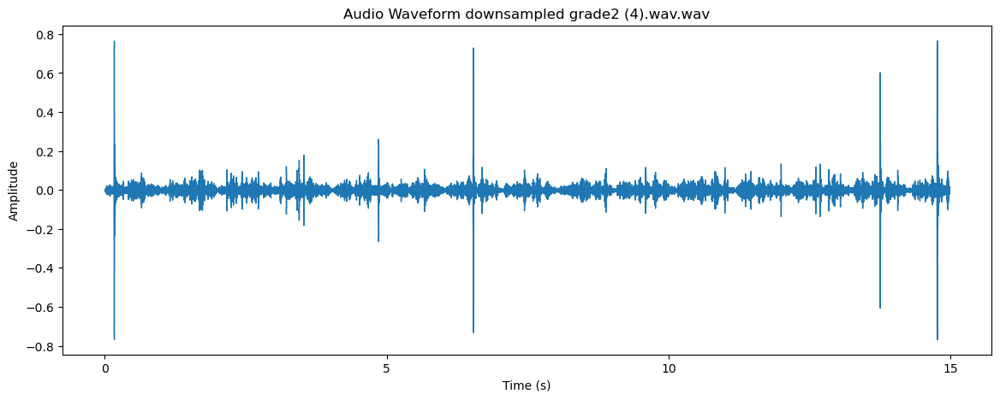

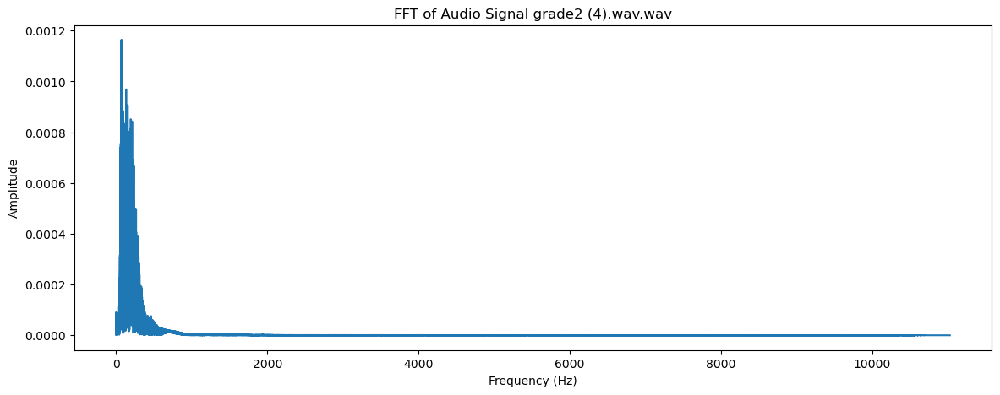

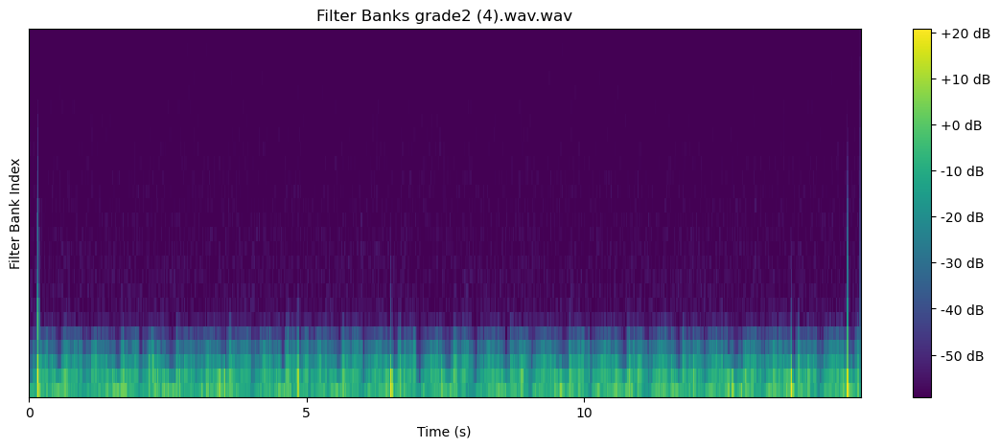

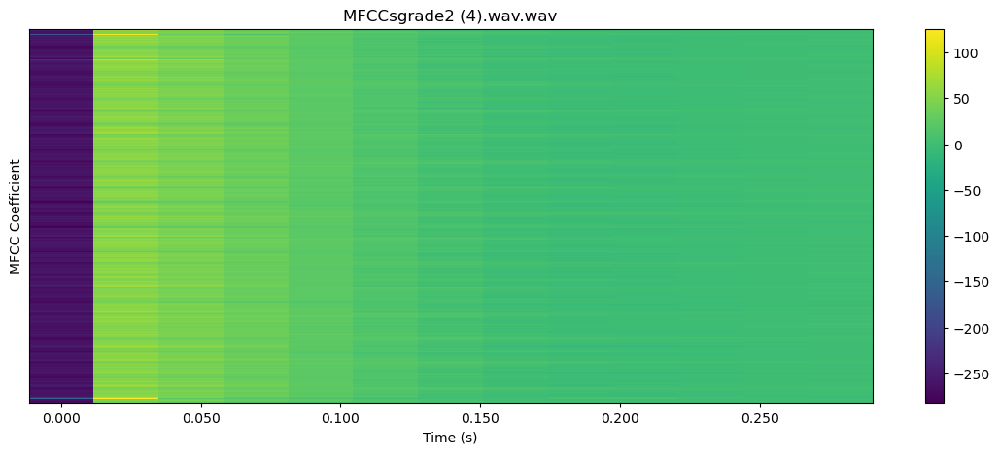


 50%|████▉     | 70/141 [01:52<01:48,  1.52s/it]

22050


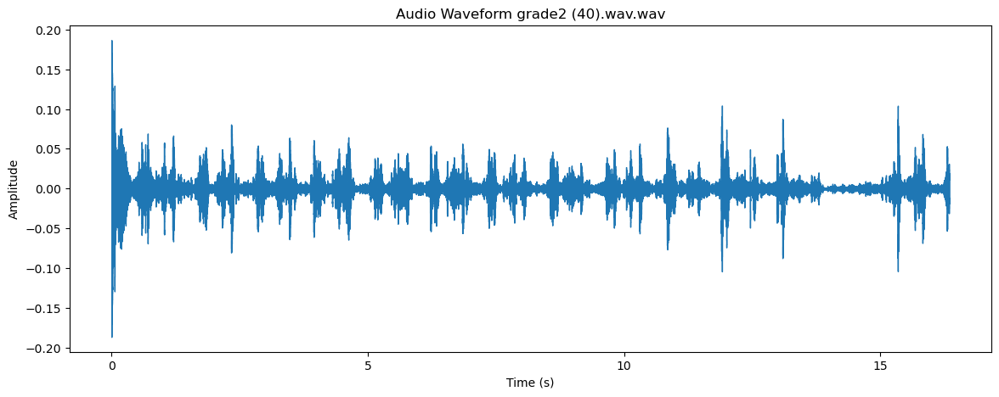

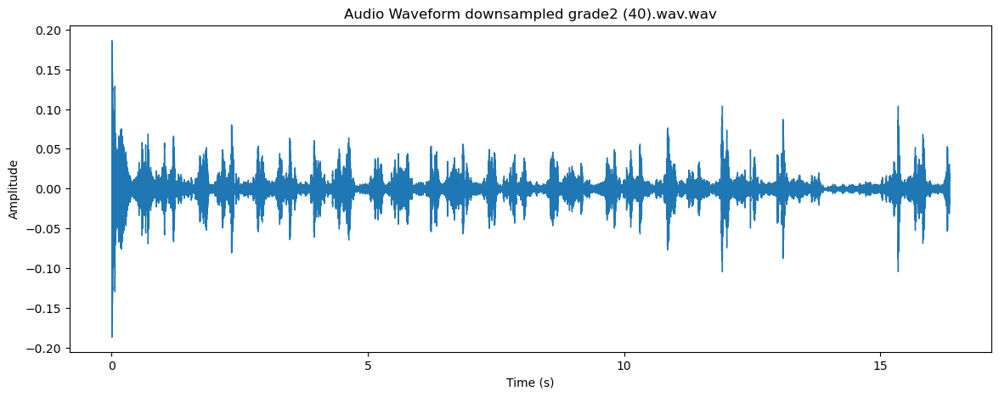

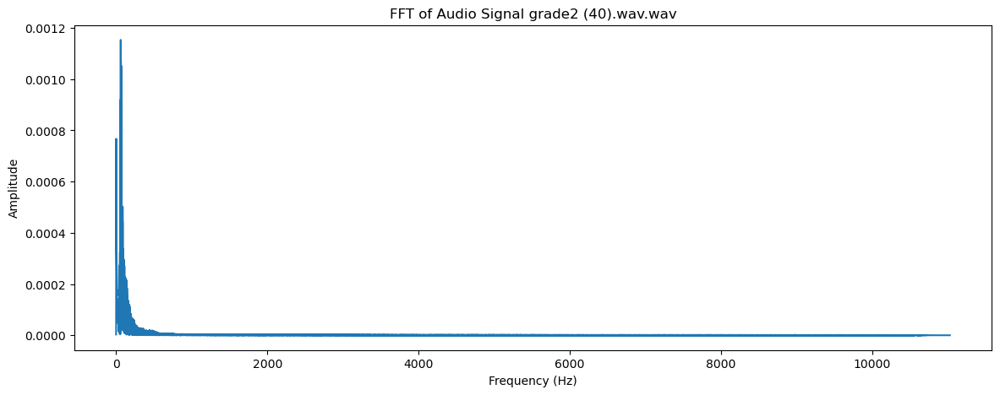

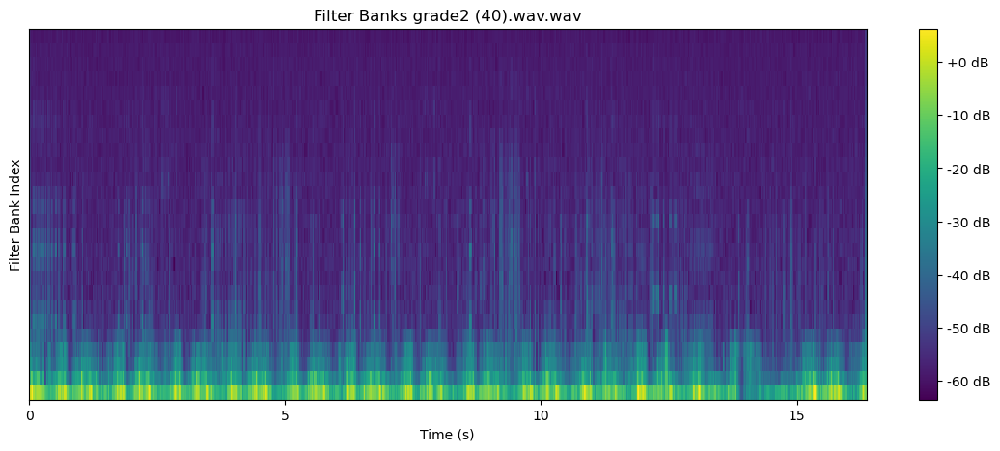

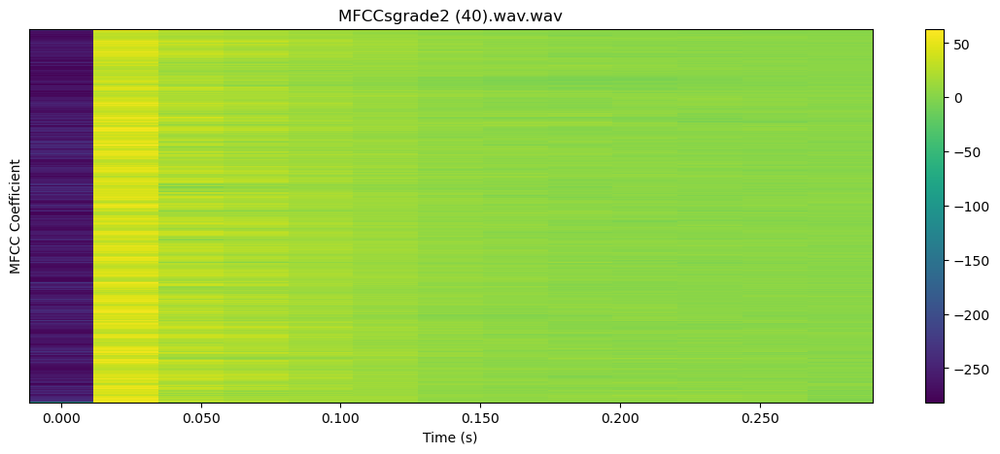


 50%|█████     | 71/141 [01:53<01:43,  1.48s/it]

22050


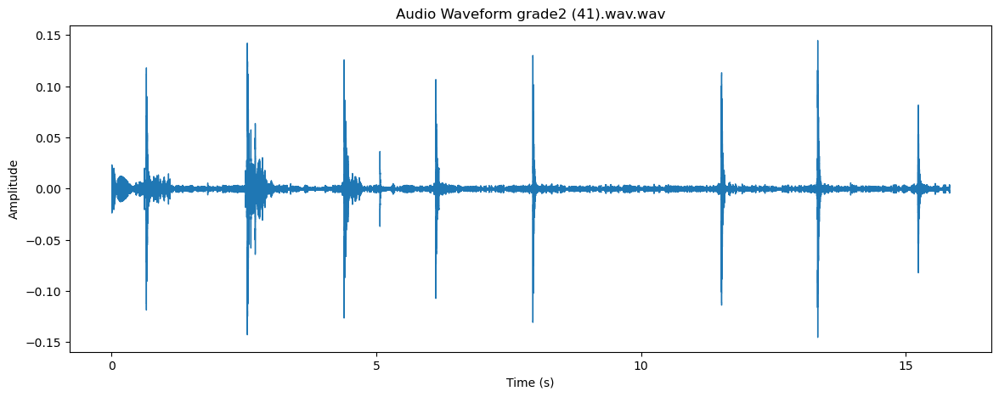

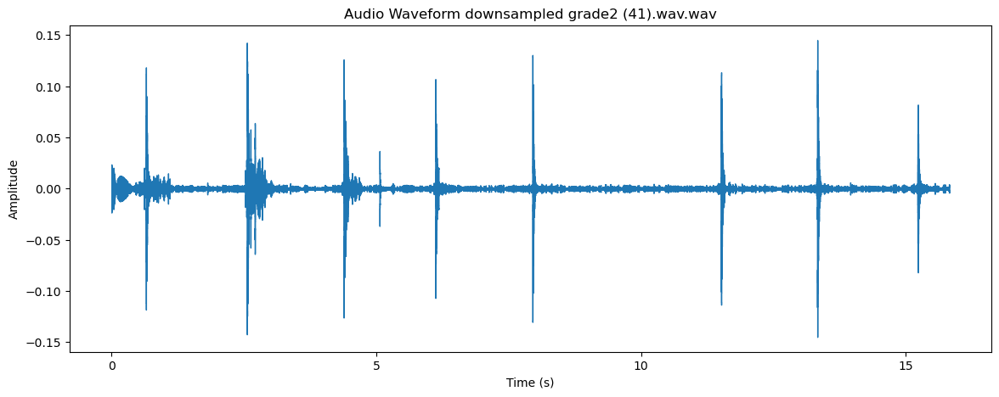

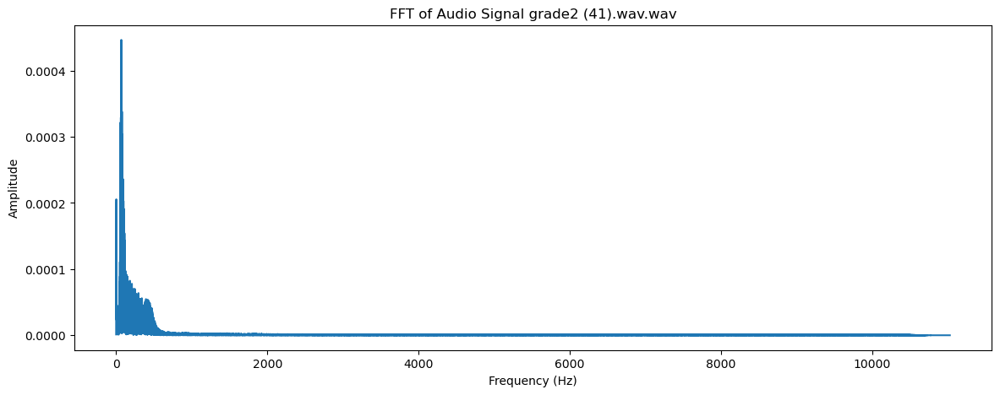

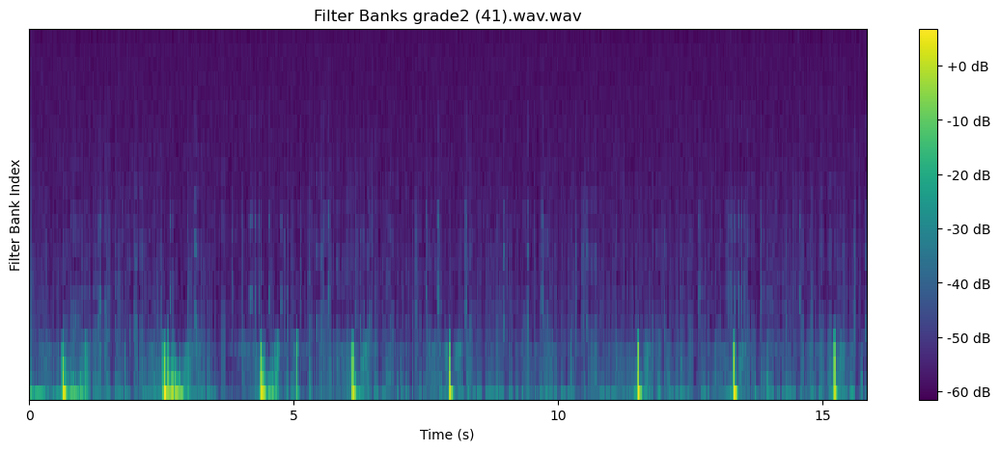

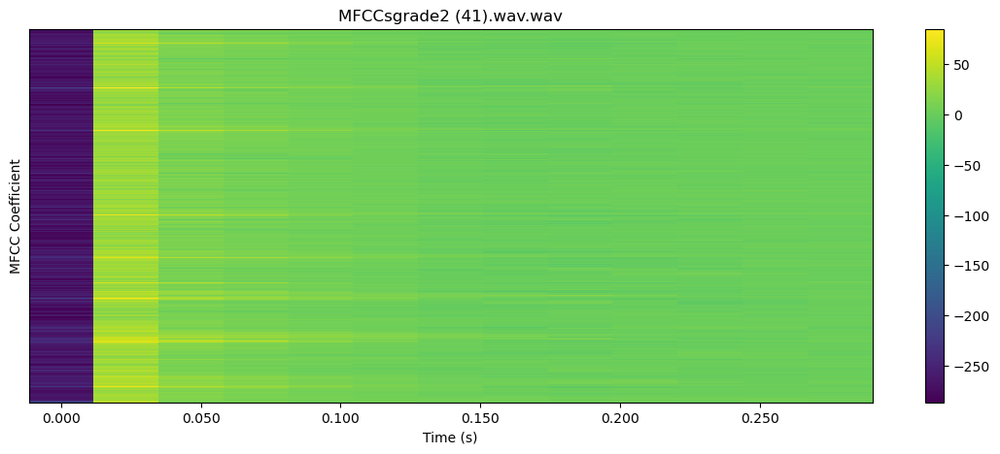


 51%|█████     | 72/141 [01:55<01:40,  1.45s/it]

22050


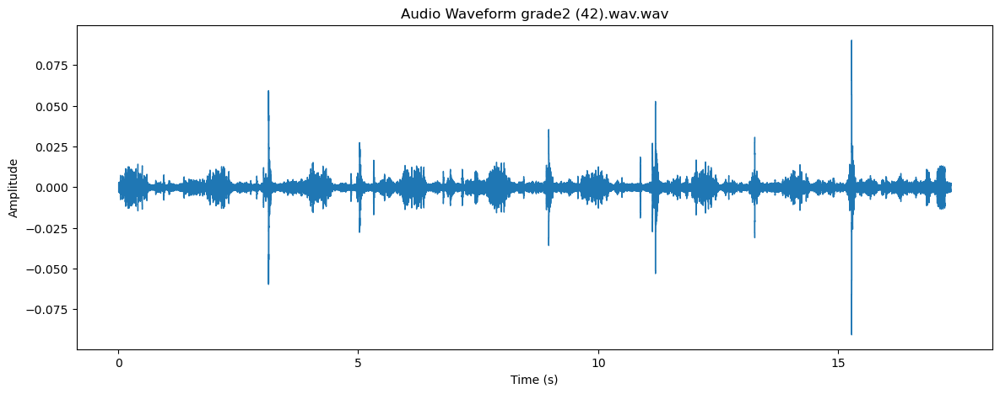

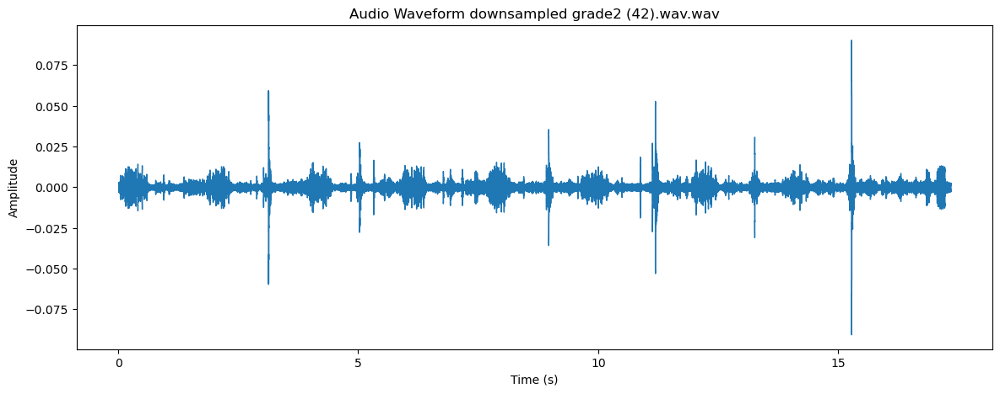

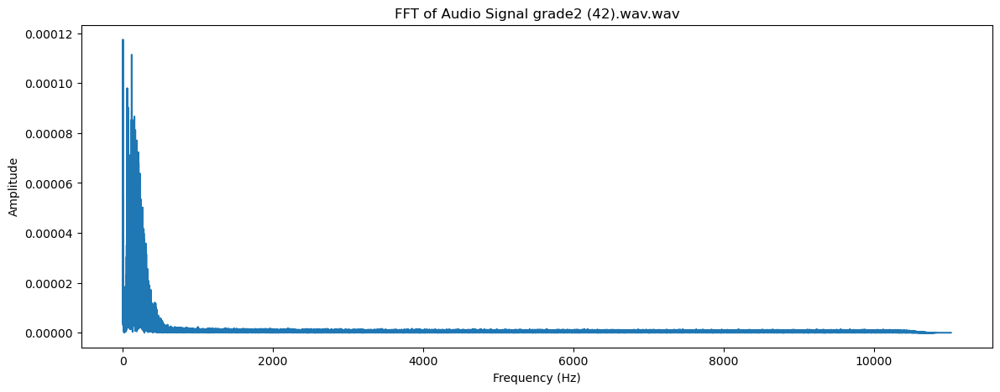

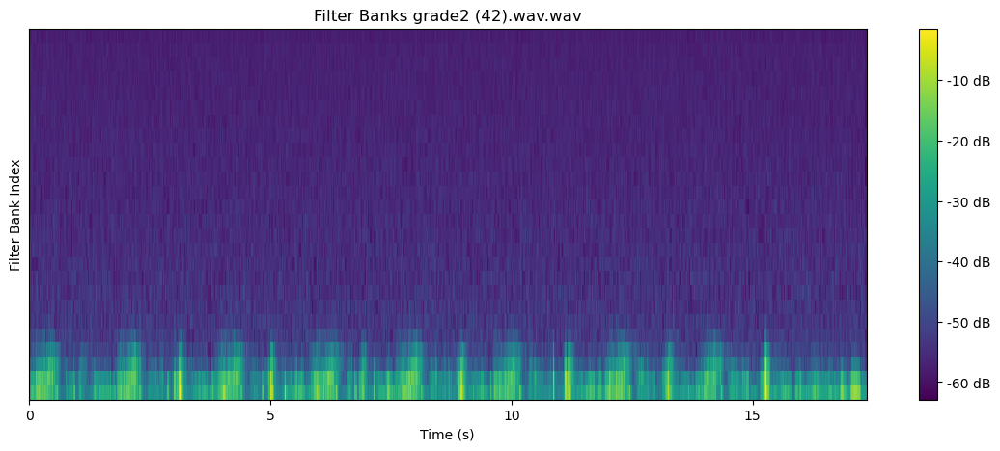

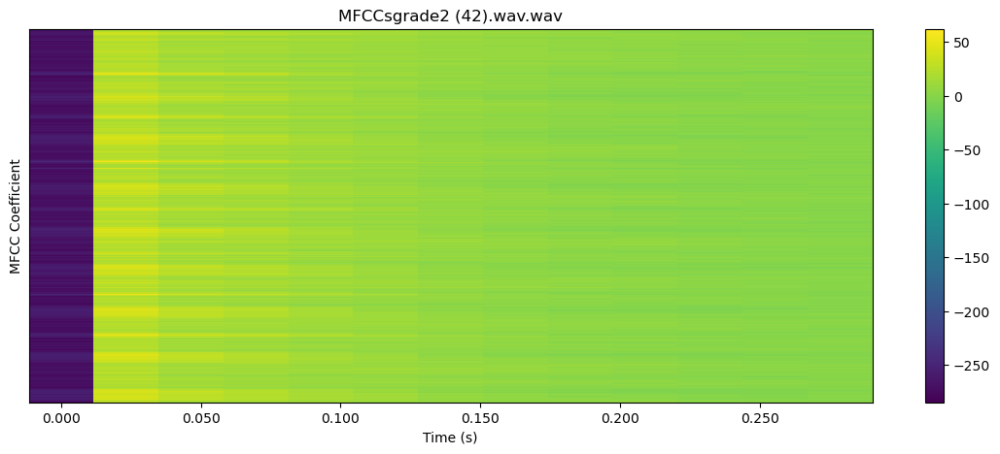


 52%|█████▏    | 73/141 [01:56<01:39,  1.47s/it]

22050


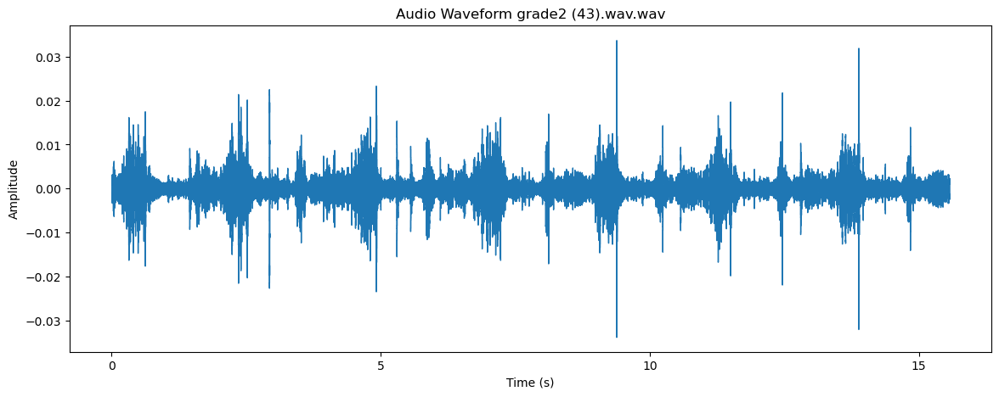

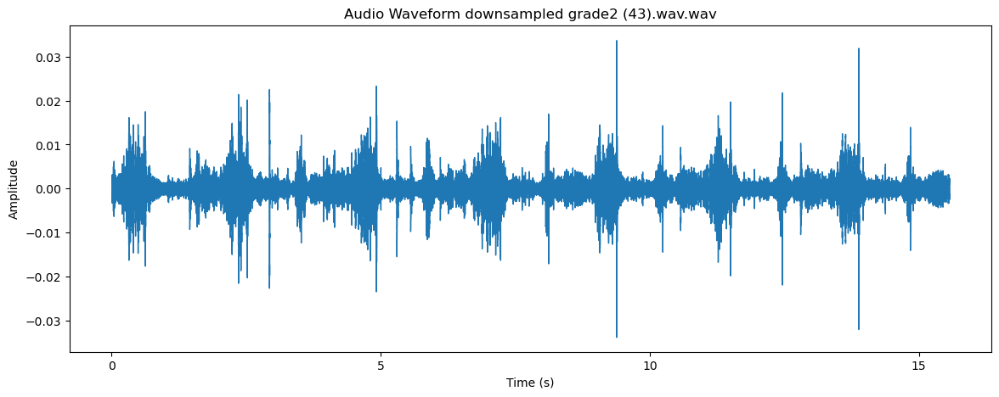

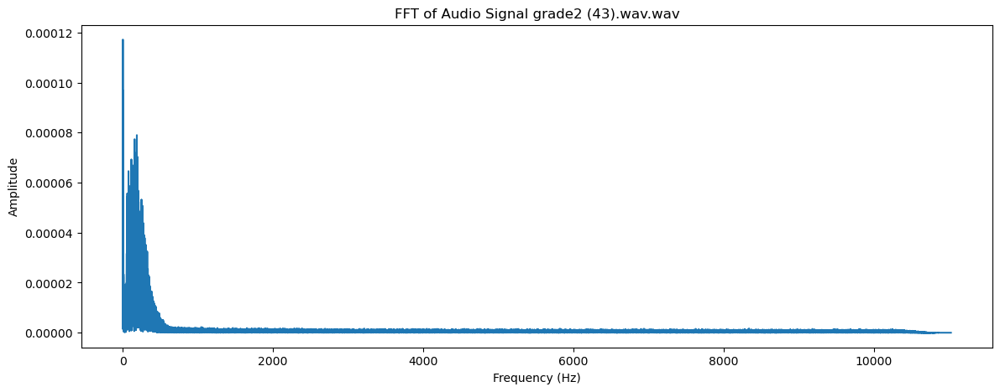

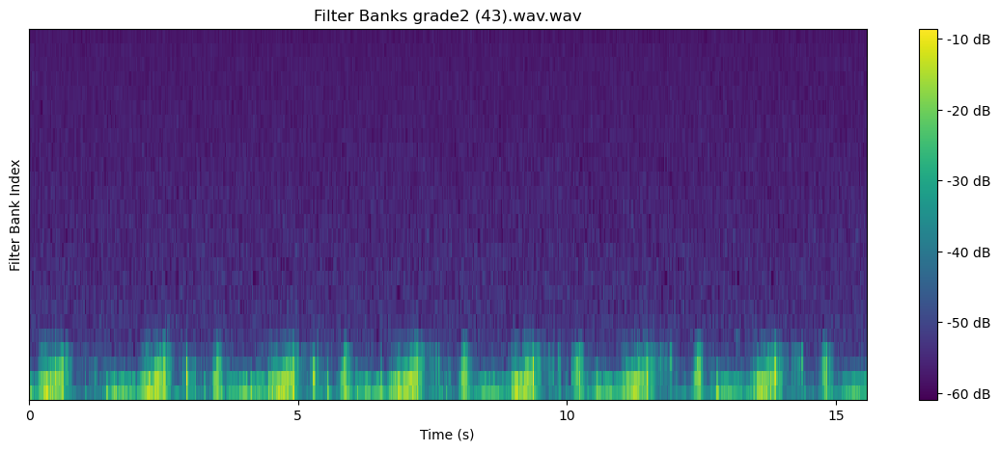

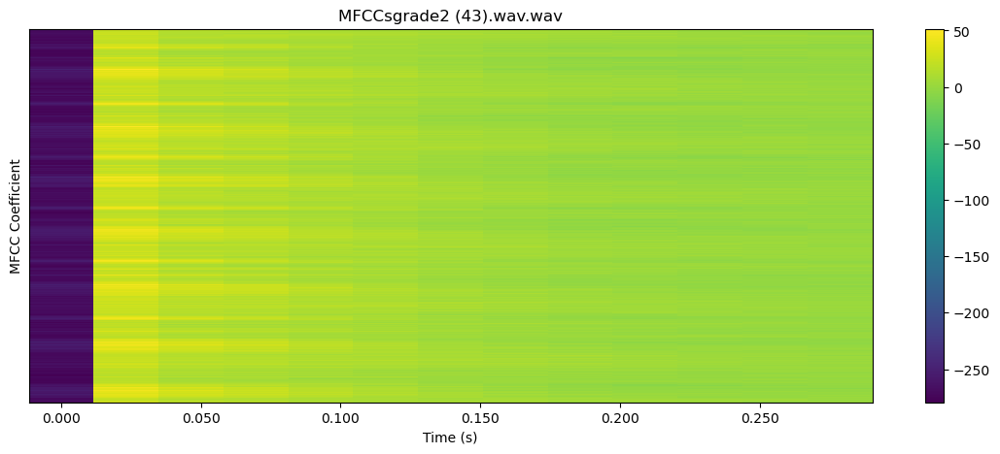


 52%|█████▏    | 74/141 [01:58<01:37,  1.46s/it]

22050


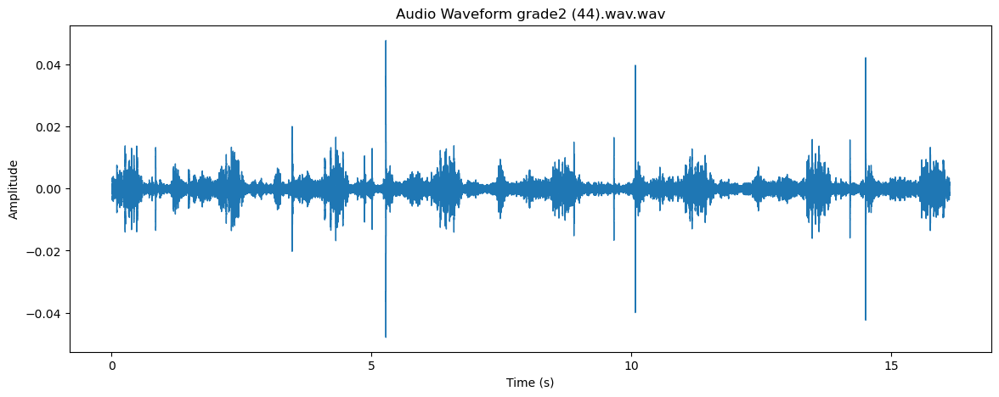

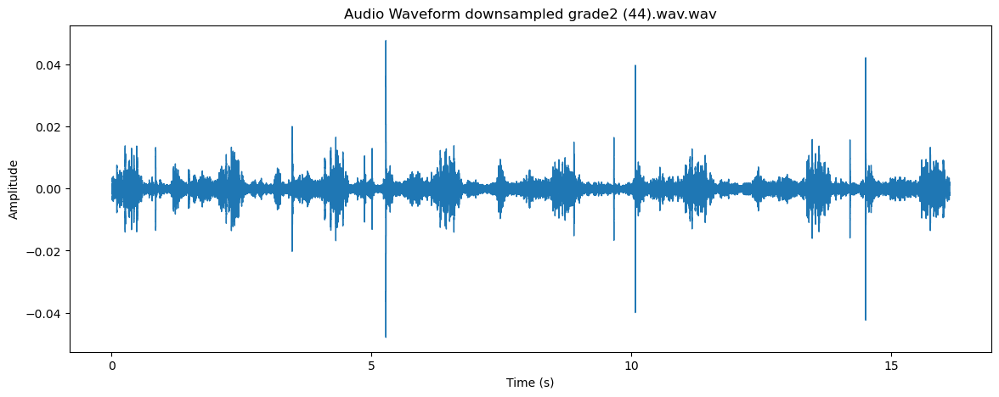

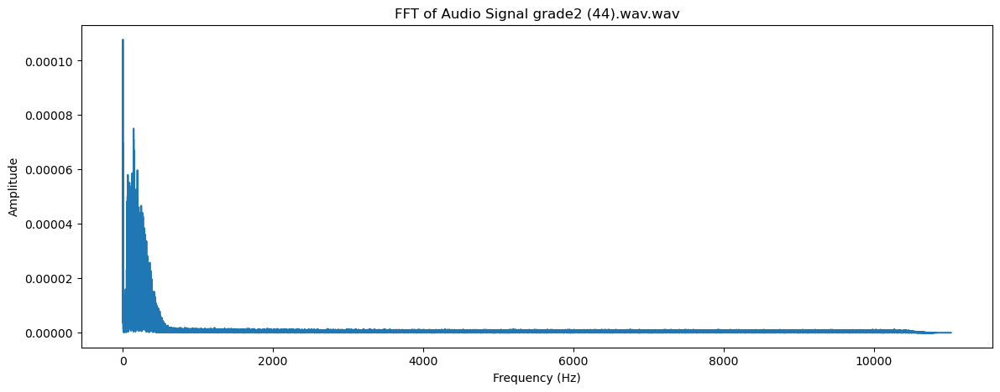

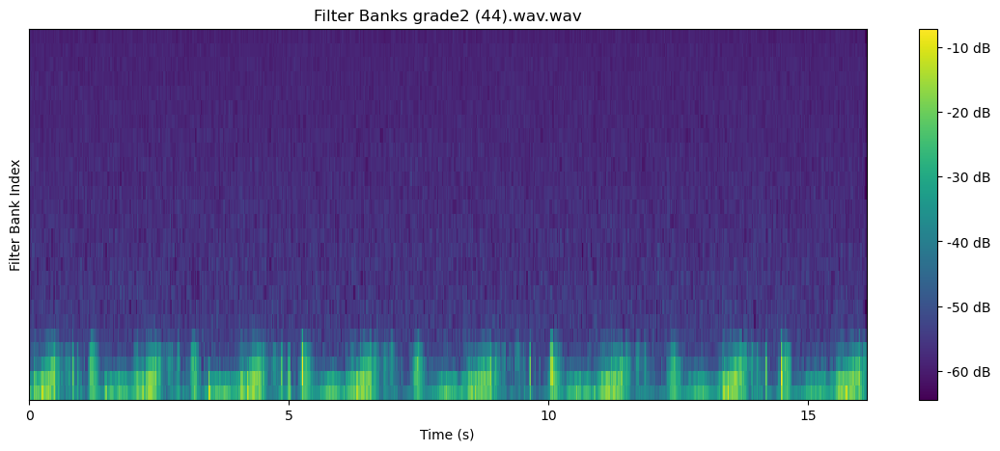

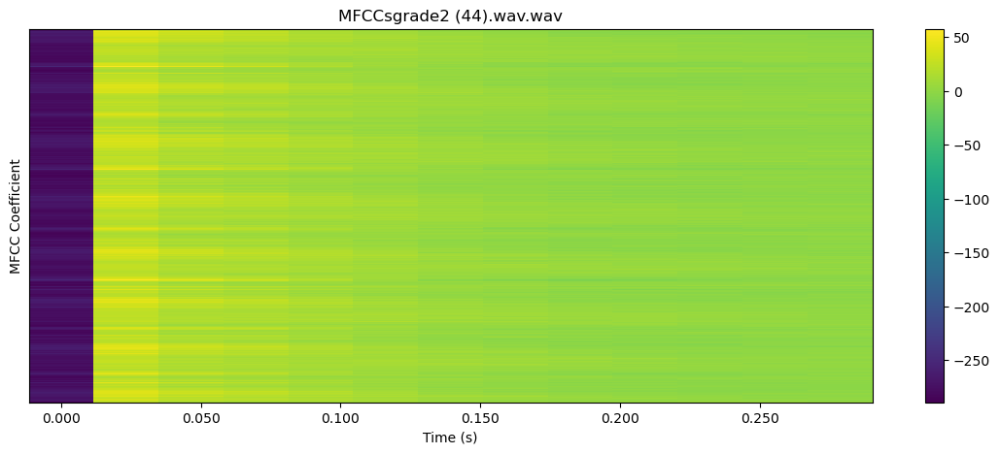


 53%|█████▎    | 75/141 [01:59<01:34,  1.44s/it]

22050


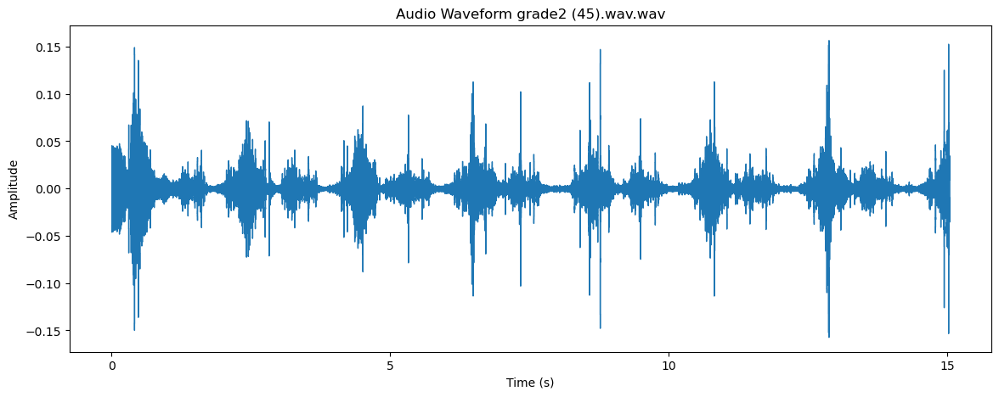

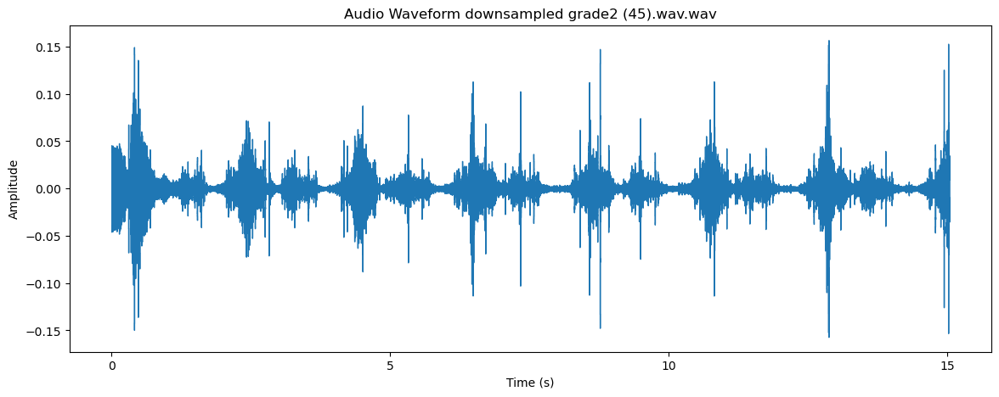

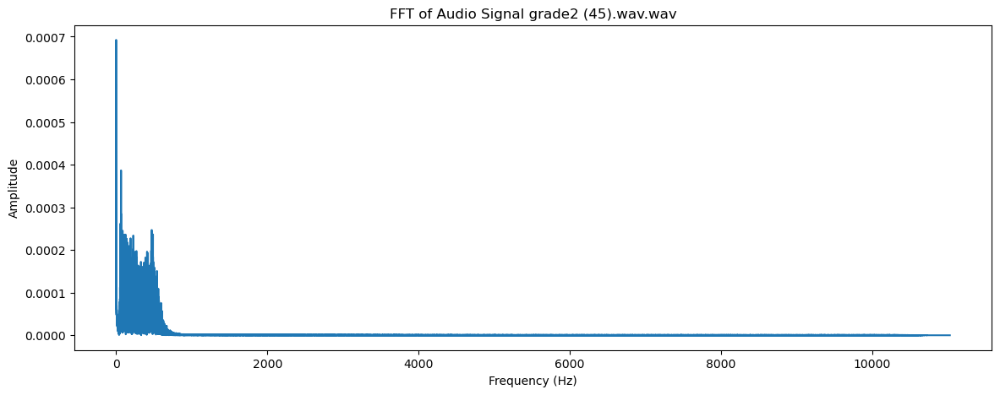

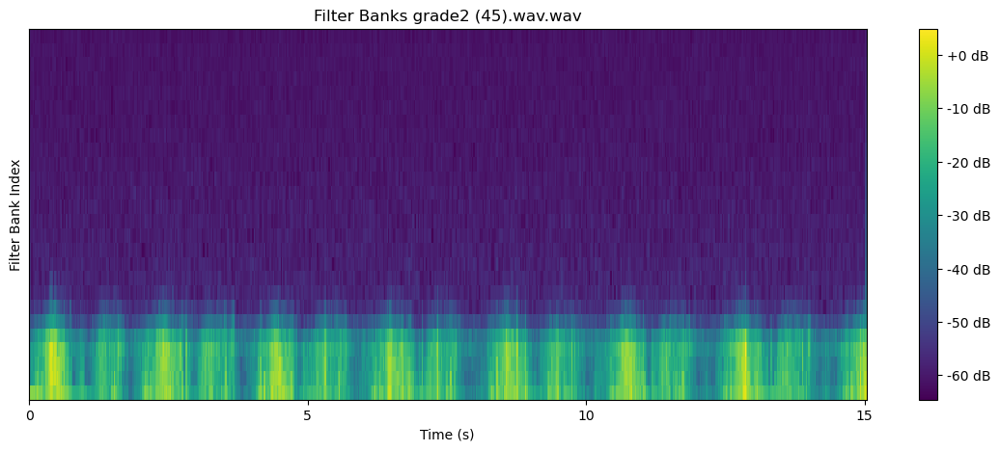

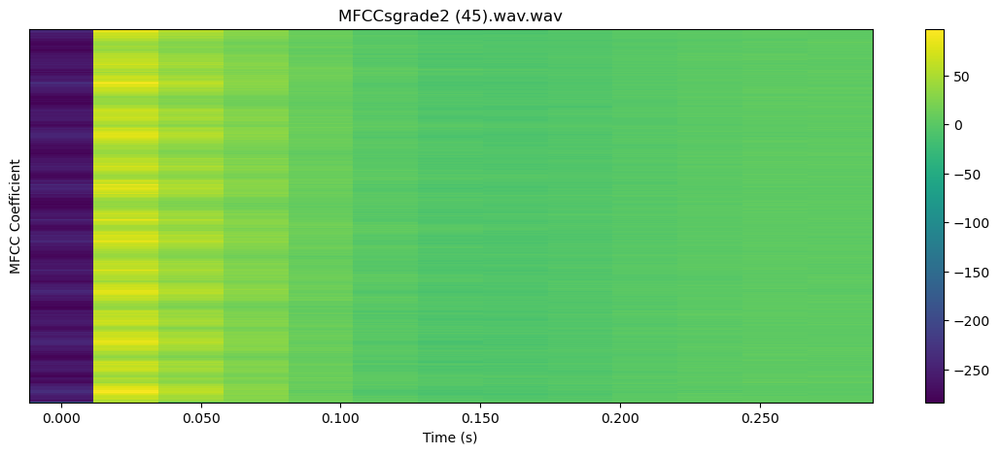


 54%|█████▍    | 76/141 [02:01<01:37,  1.50s/it]

22050


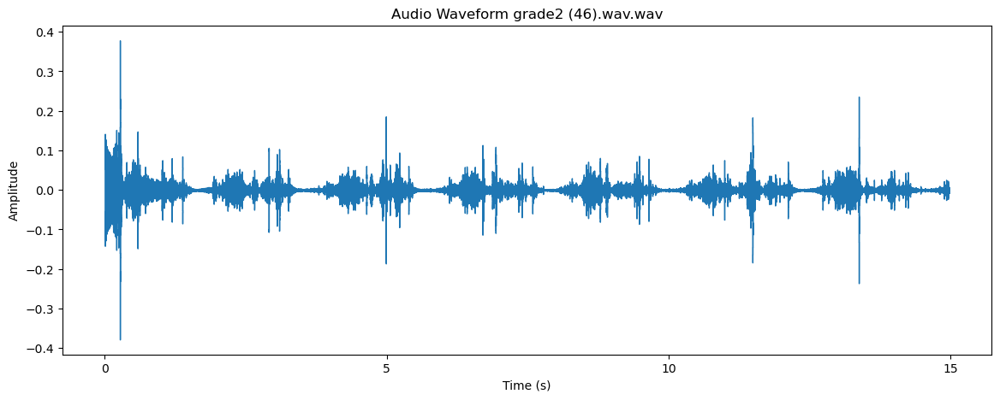

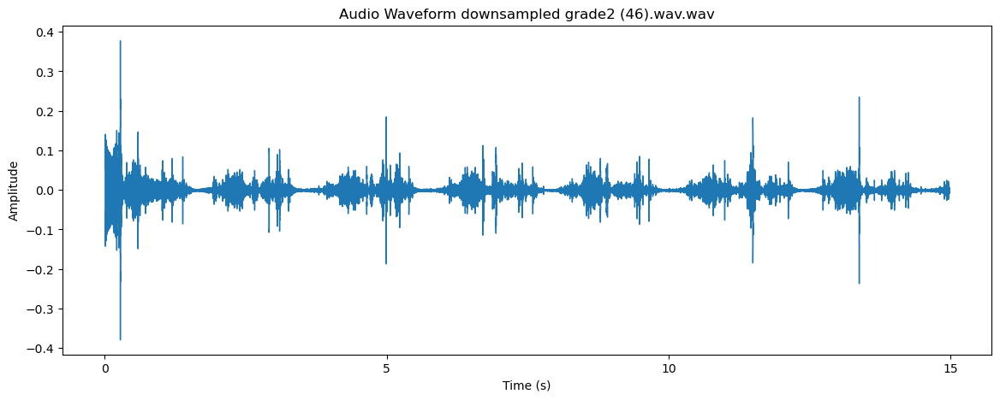

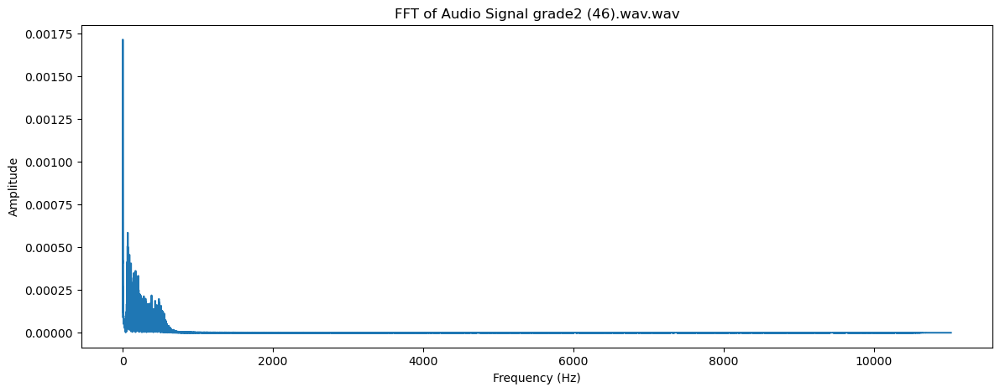

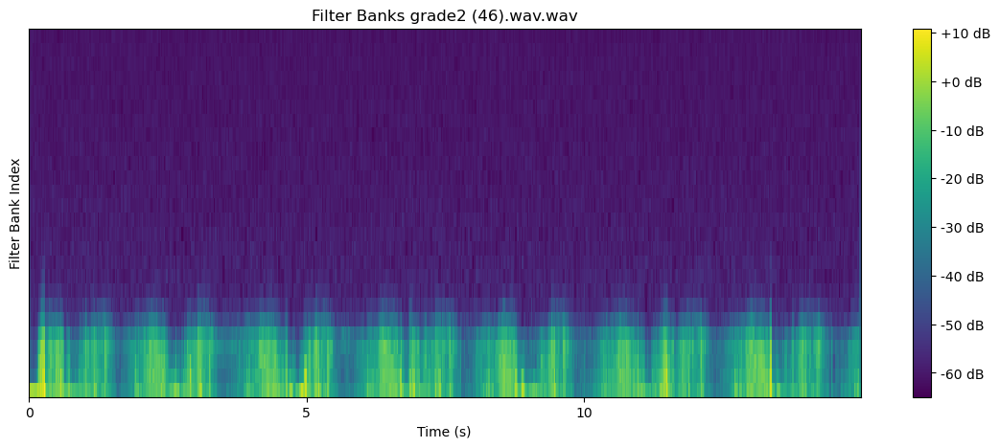

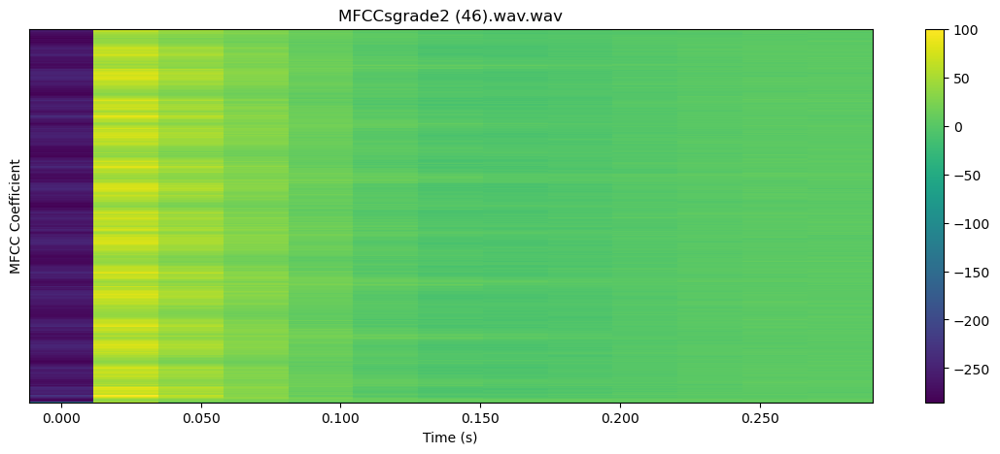


 55%|█████▍    | 77/141 [02:03<01:50,  1.72s/it]

22050


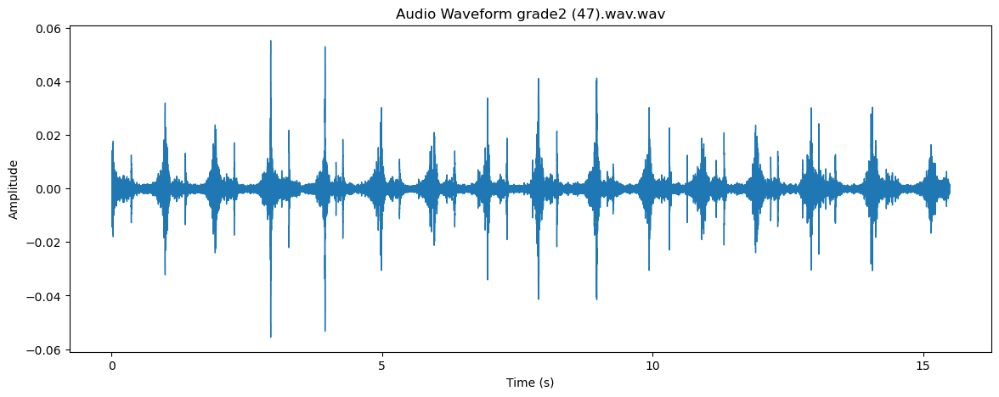

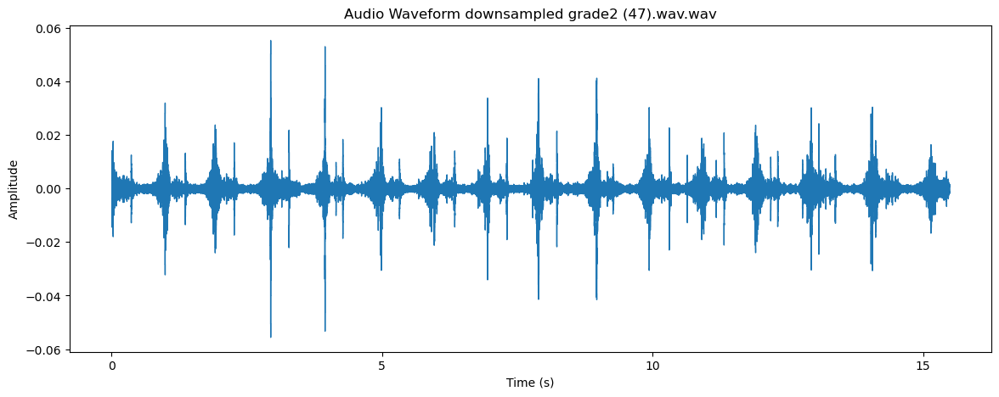

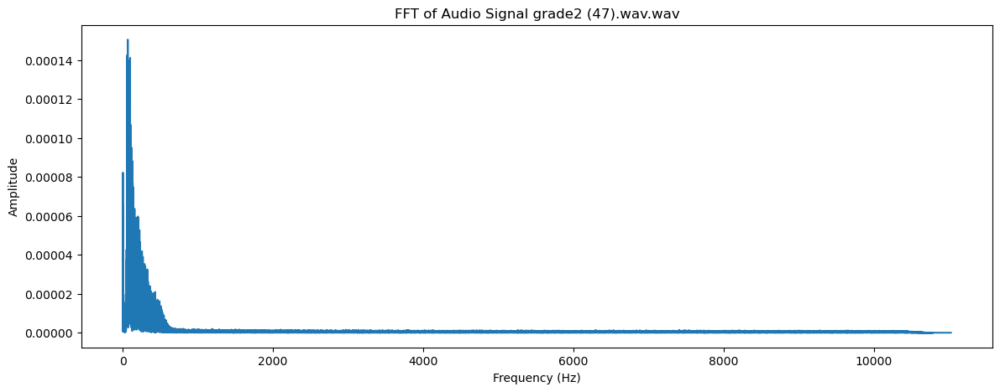

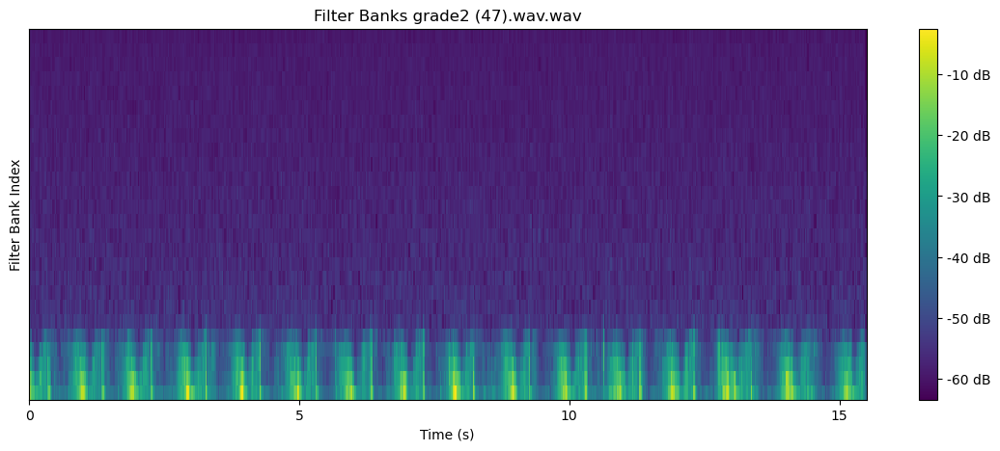

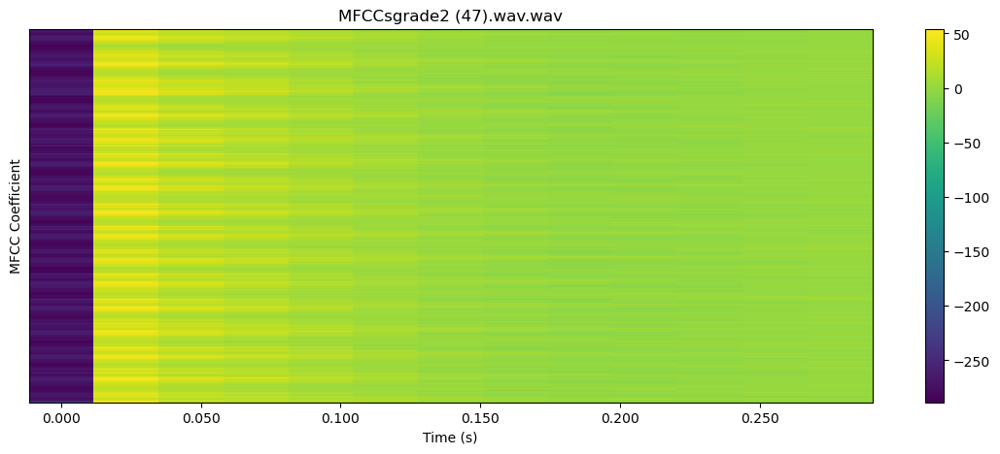


 55%|█████▌    | 78/141 [02:05<02:03,  1.96s/it]

22050


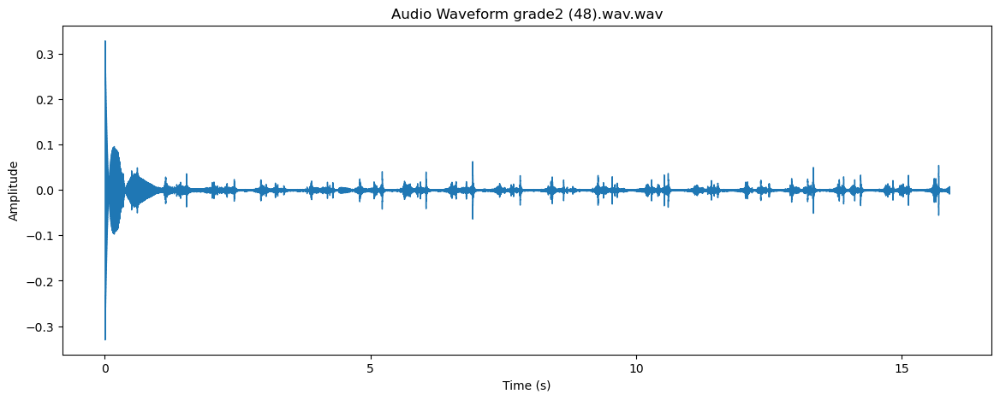

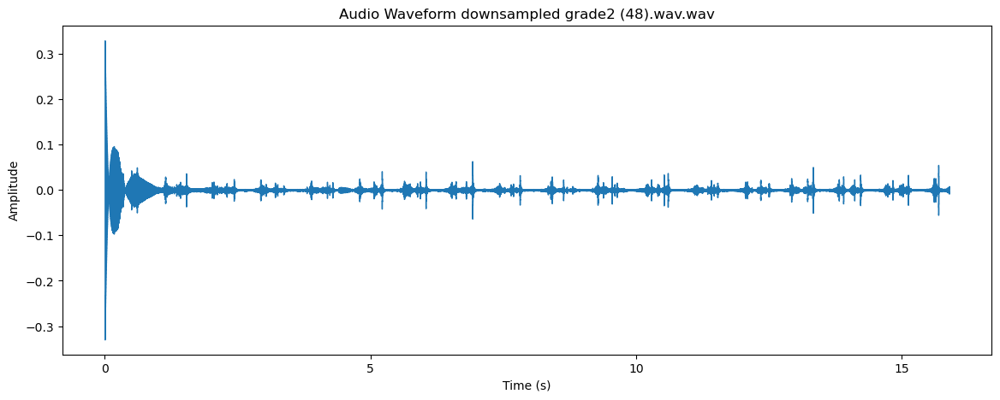

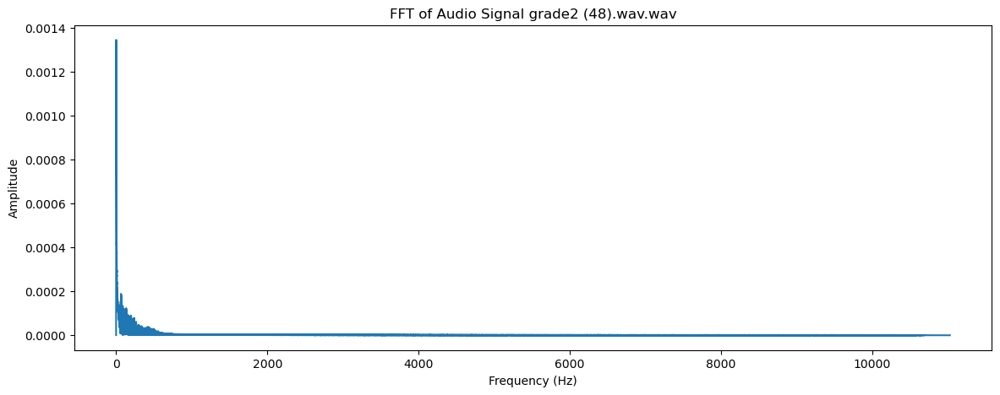

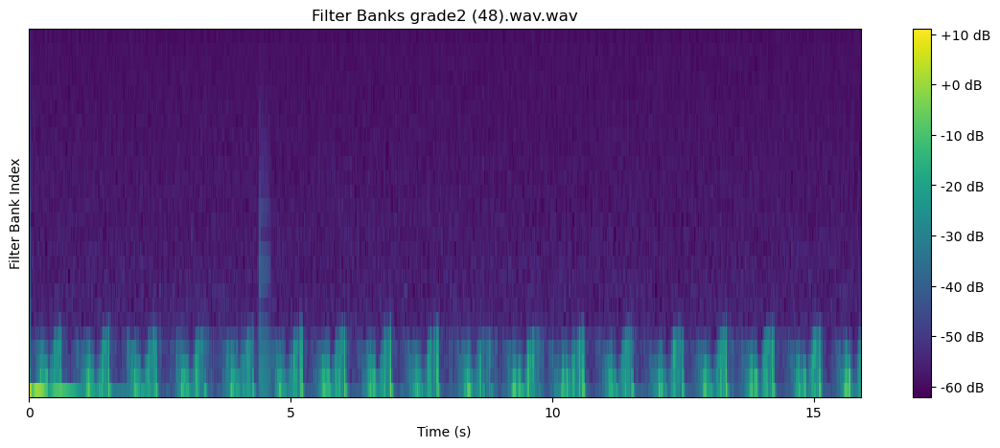

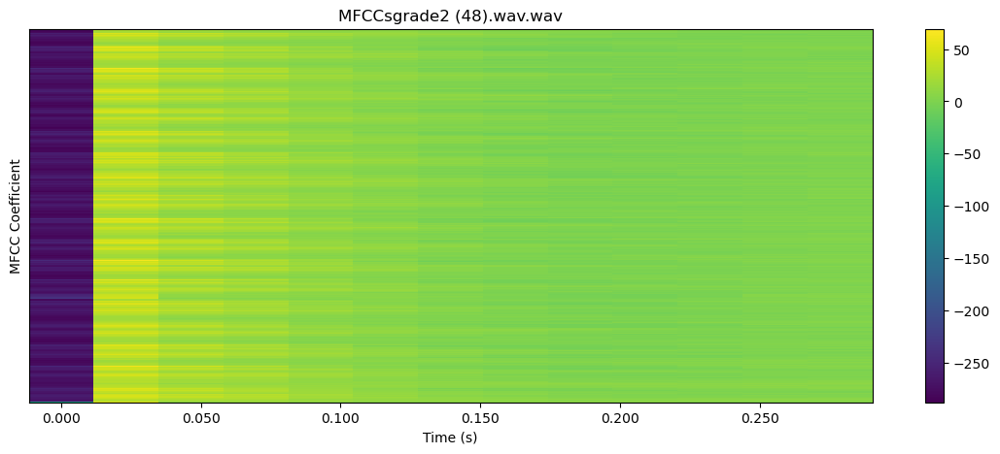


 56%|█████▌    | 79/141 [02:07<01:51,  1.80s/it]

22050


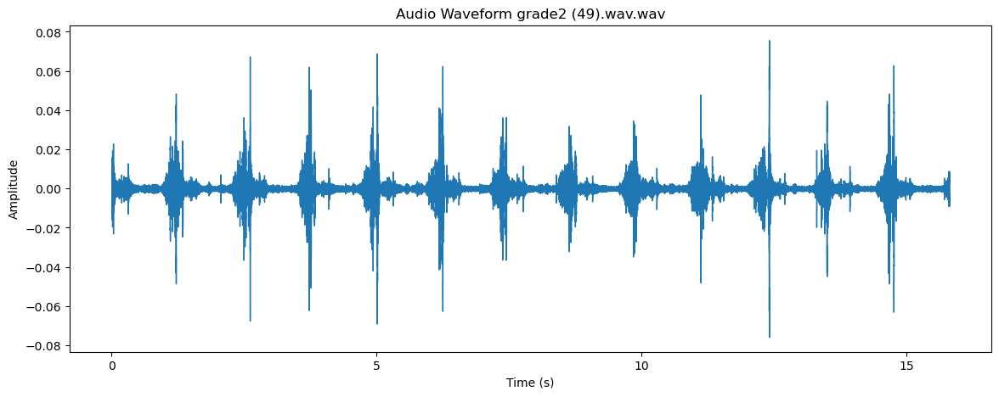

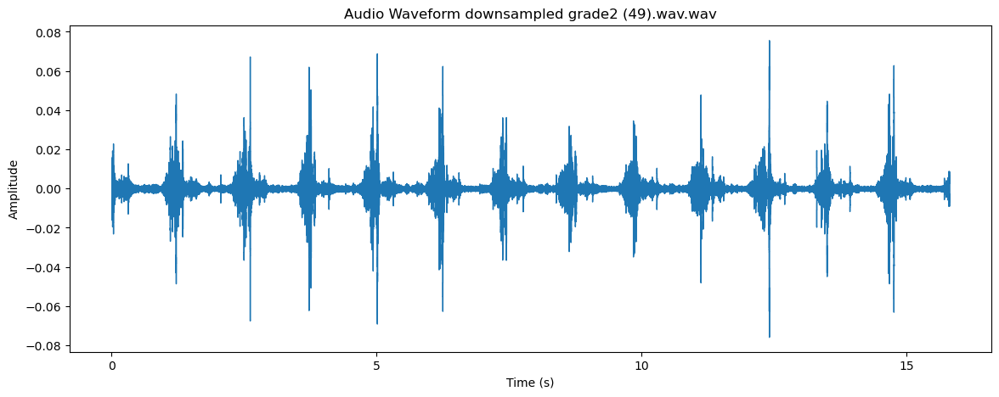

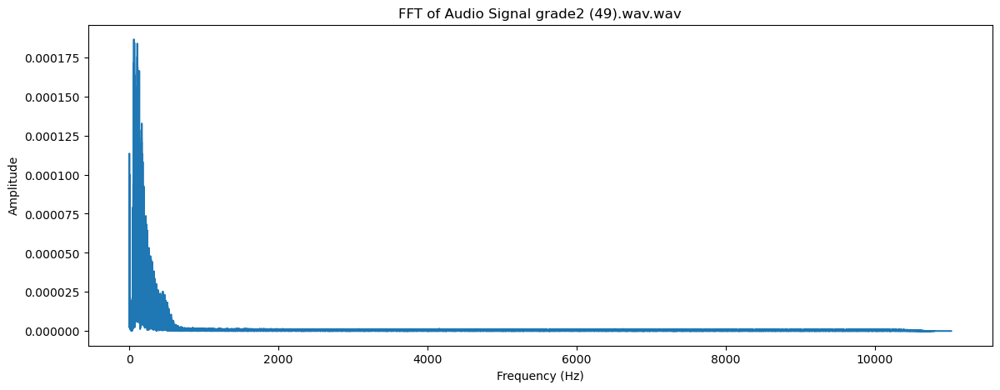

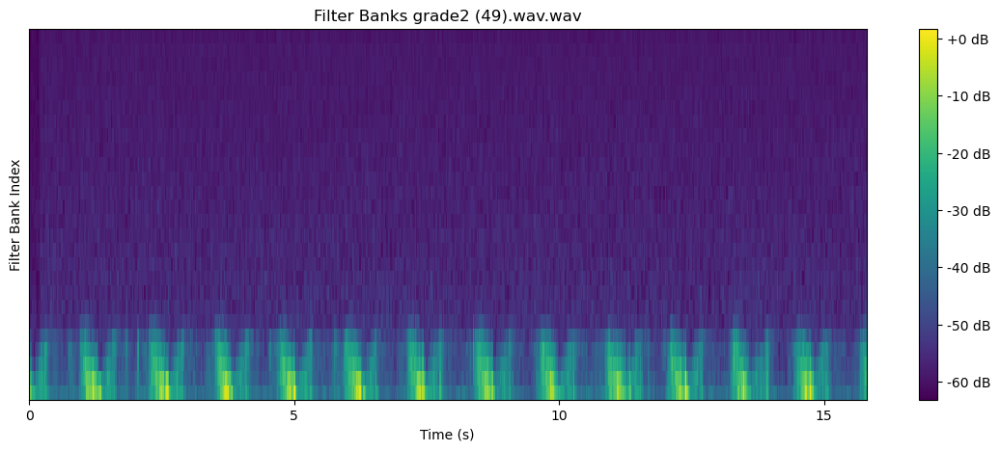

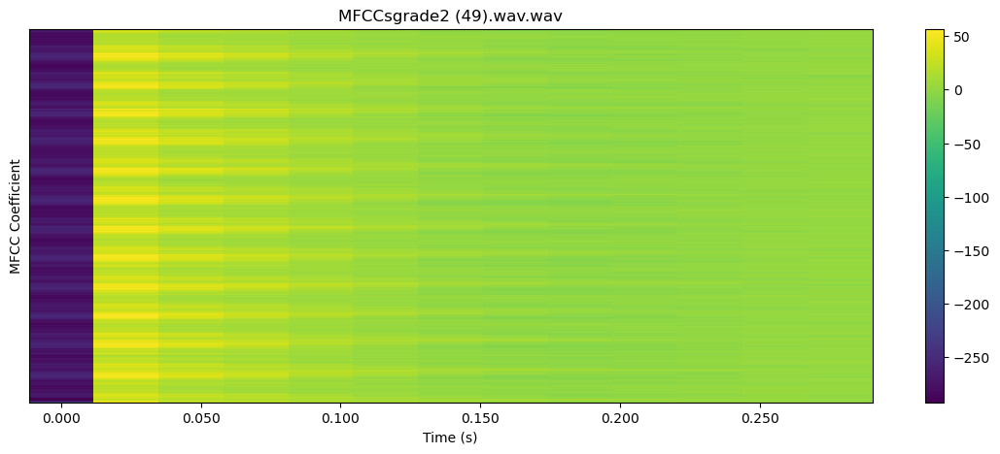


 57%|█████▋    | 80/141 [02:08<01:43,  1.70s/it]

22050


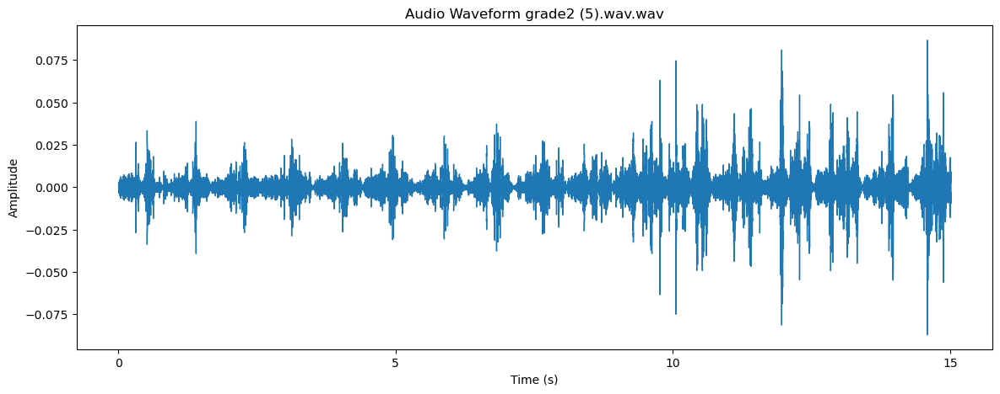

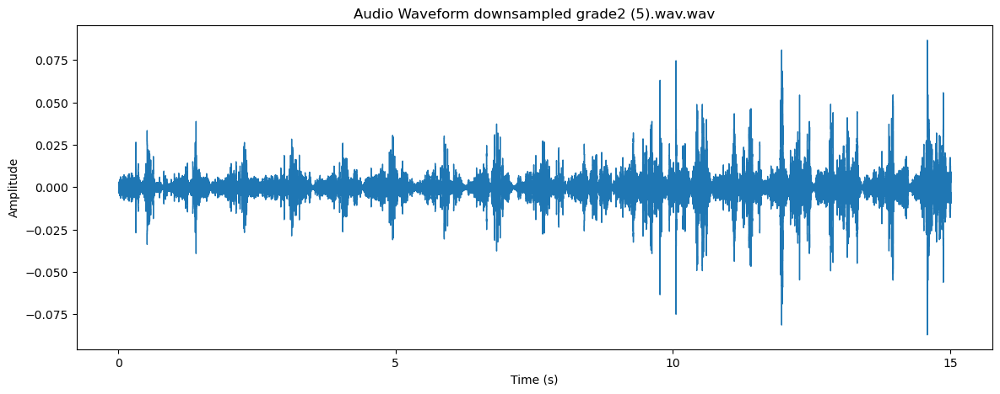

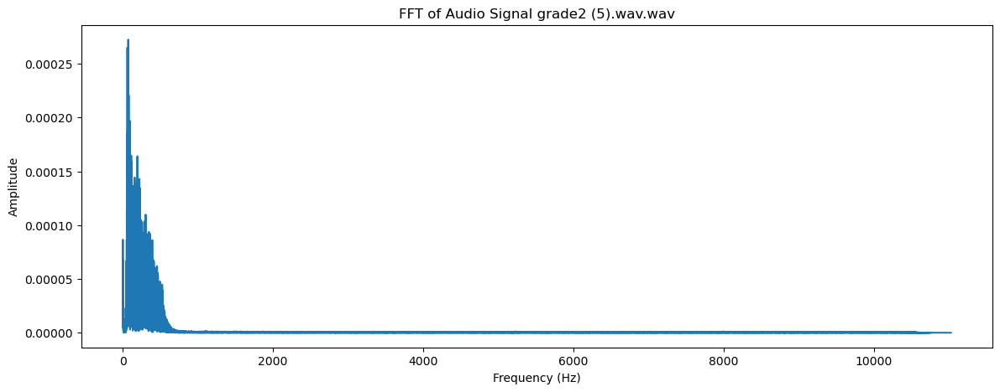

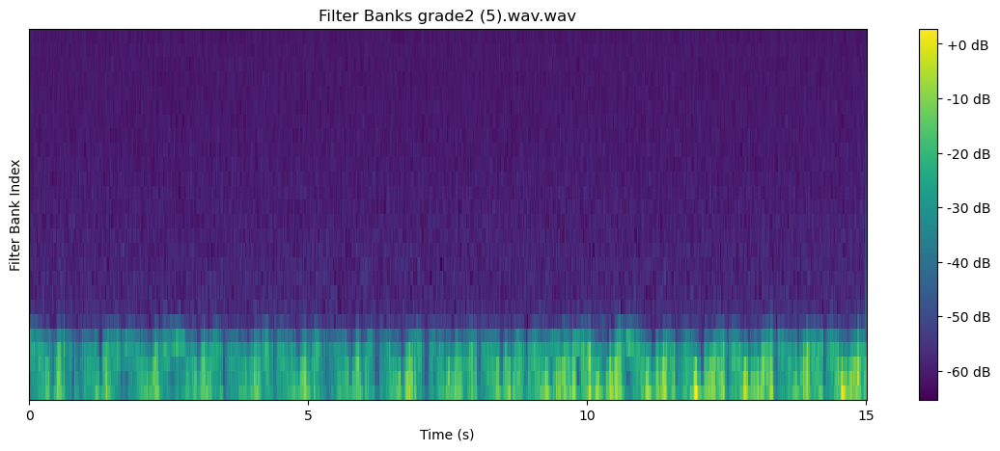

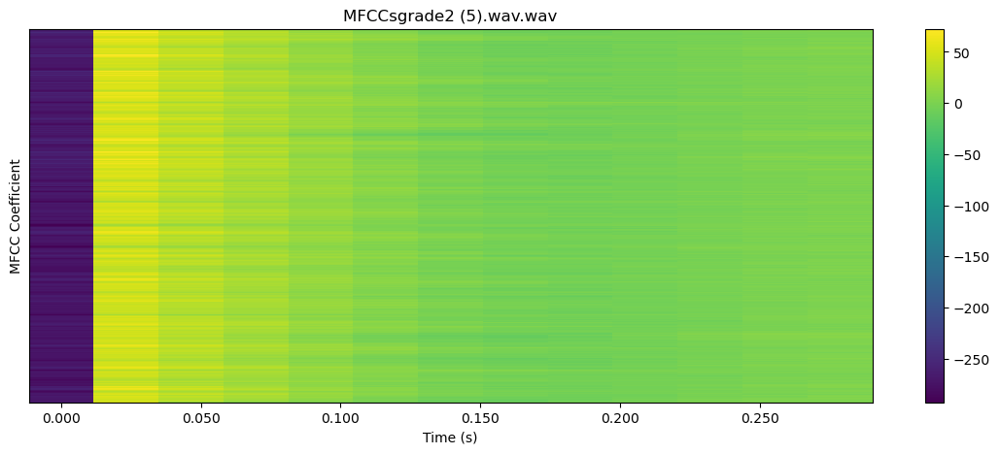


 57%|█████▋    | 81/141 [02:10<01:37,  1.62s/it]

22050


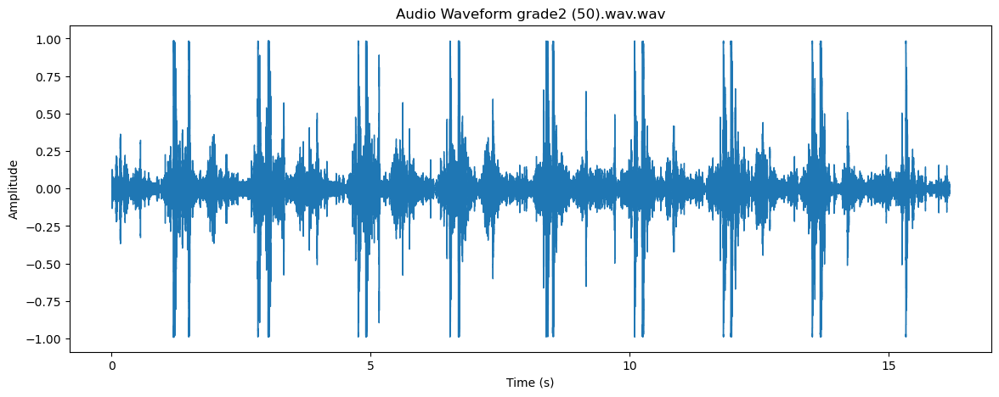

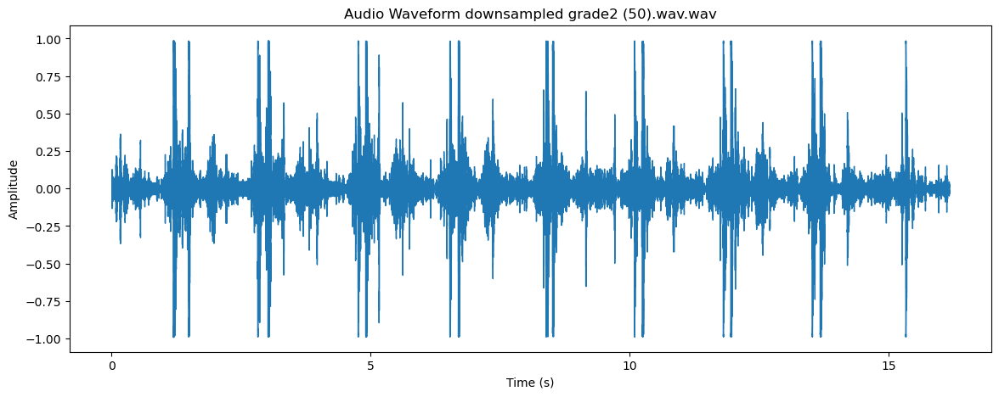

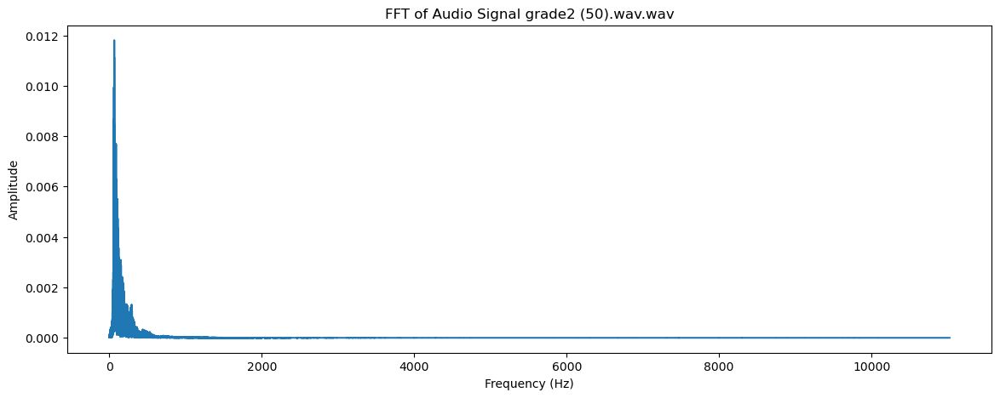

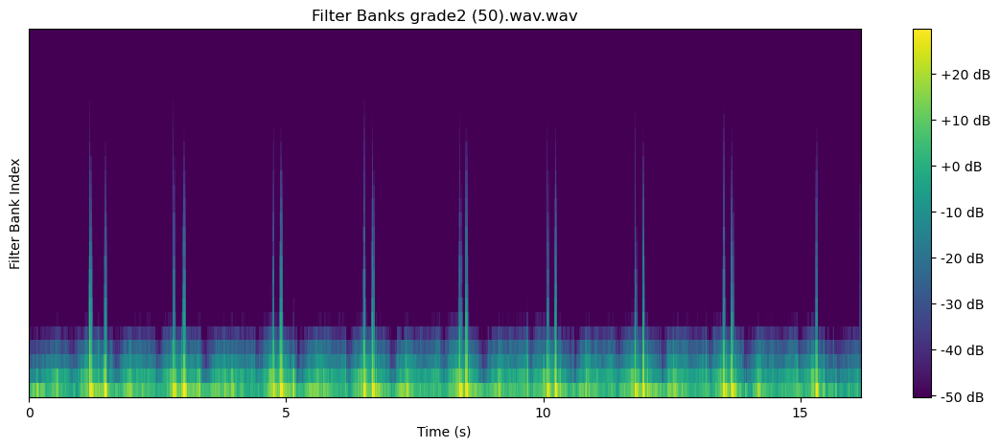

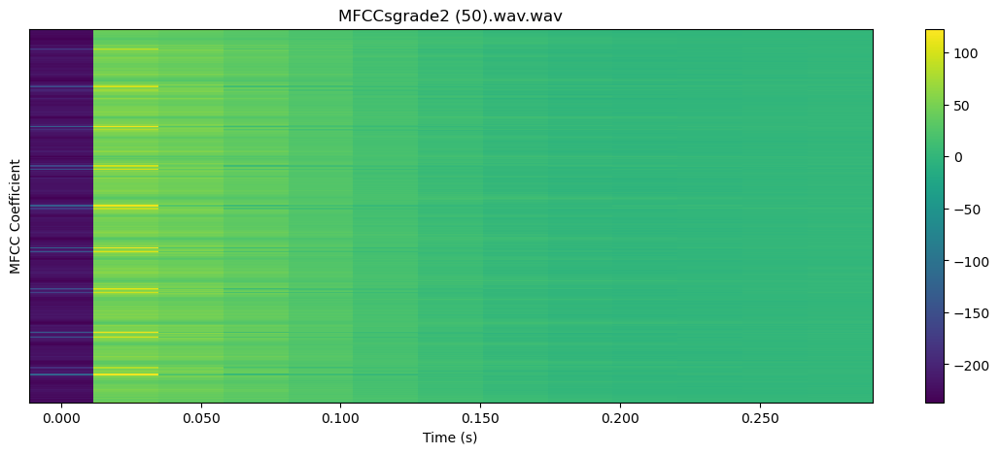


 58%|█████▊    | 82/141 [02:11<01:33,  1.59s/it]

22050


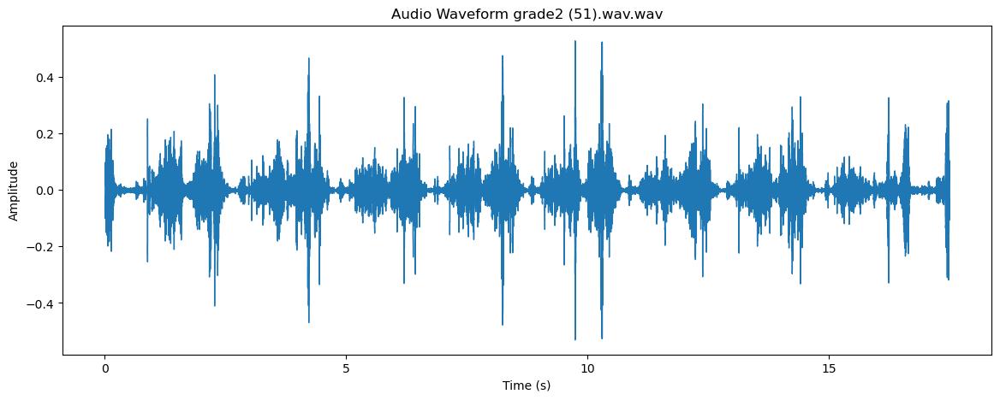

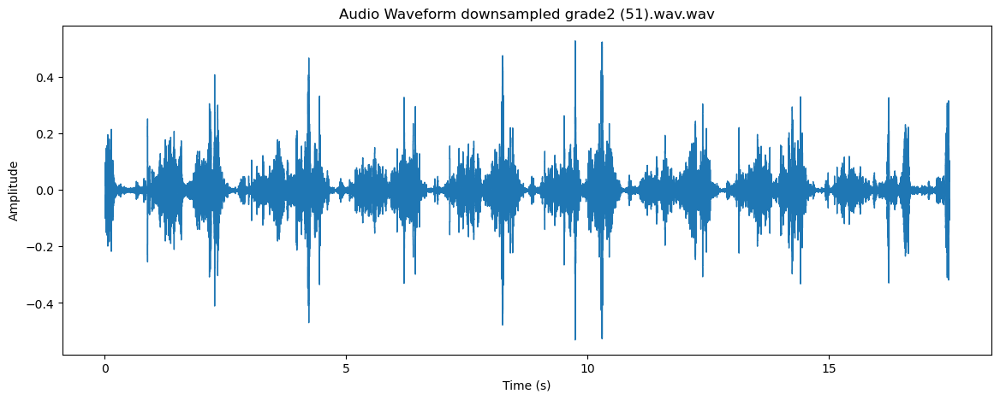

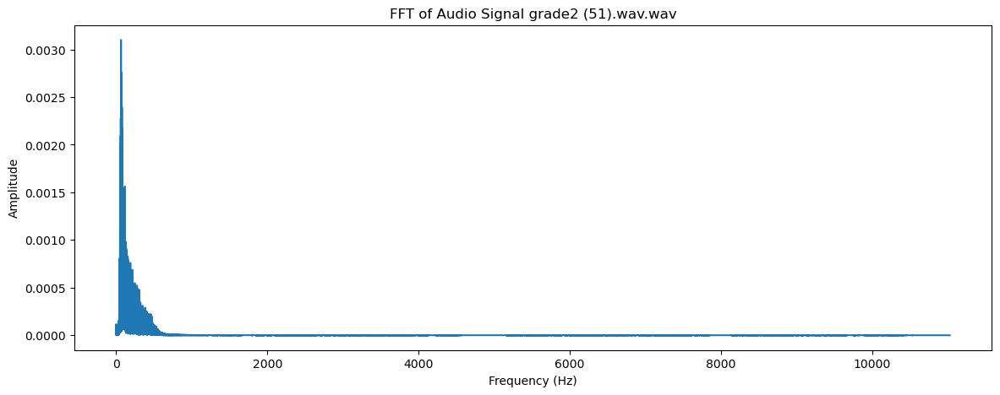

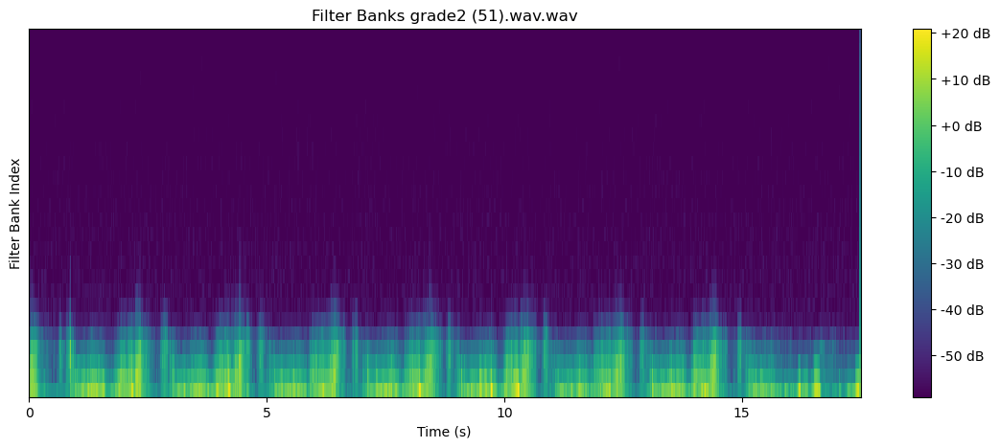

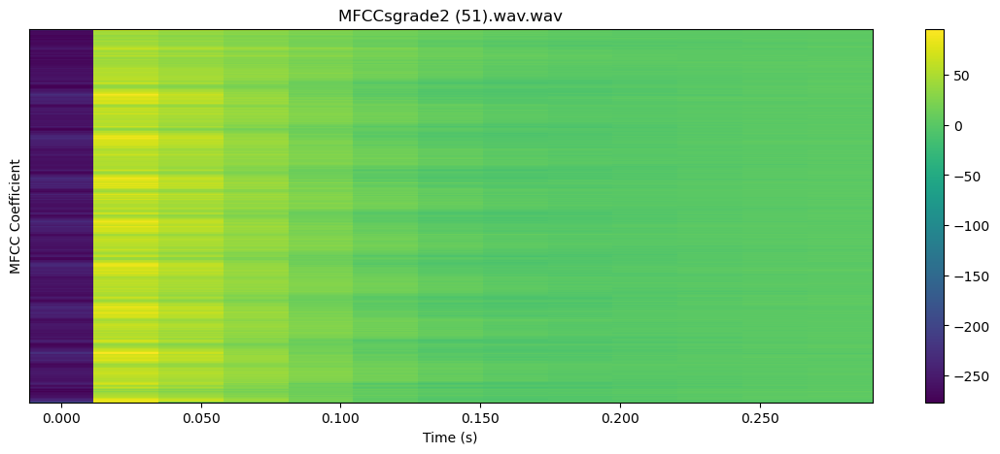


 59%|█████▉    | 83/141 [02:13<01:37,  1.68s/it]

22050


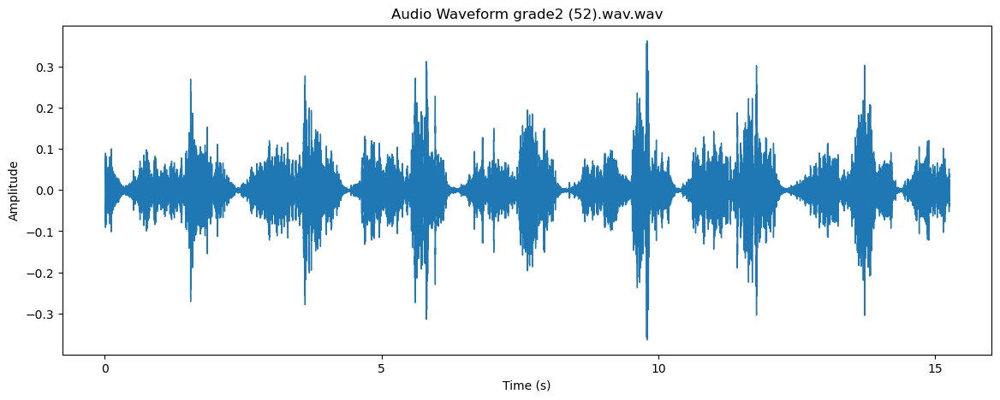

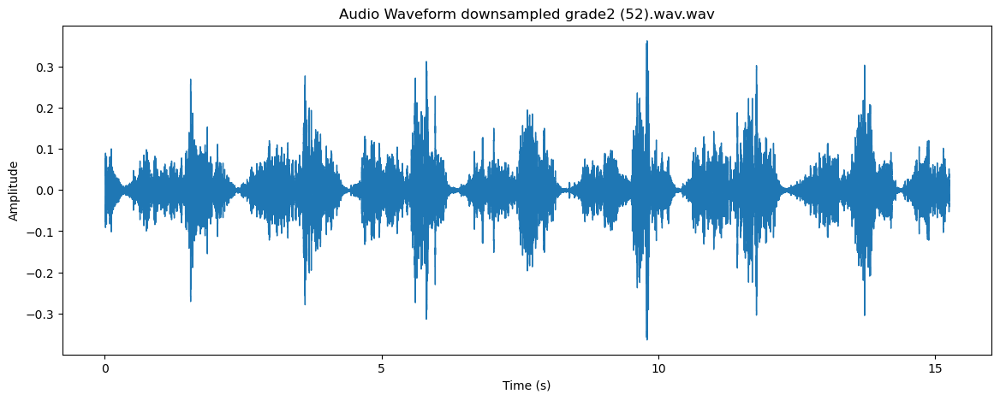

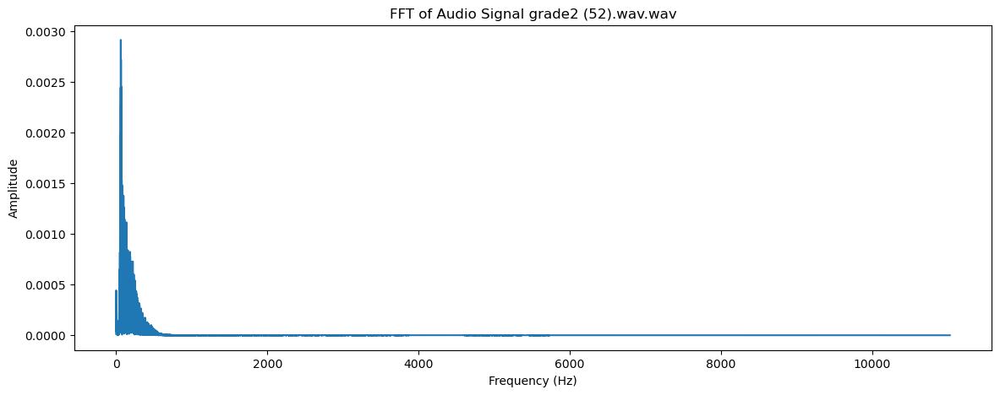

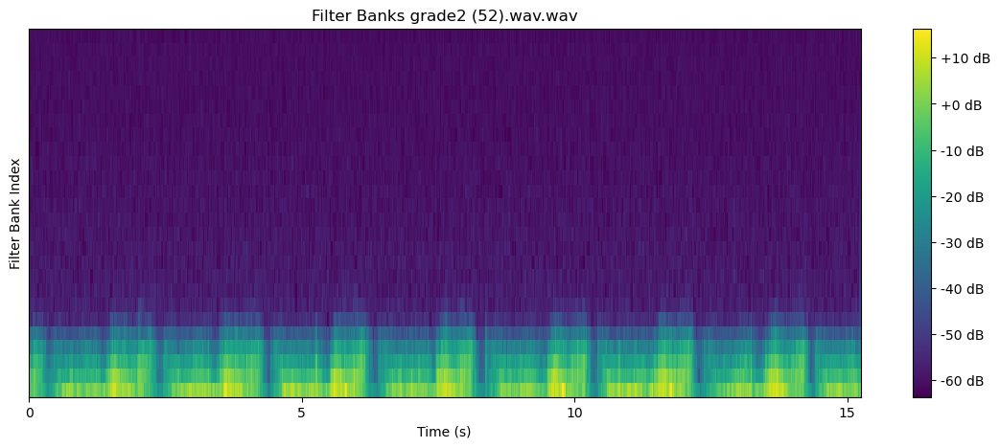

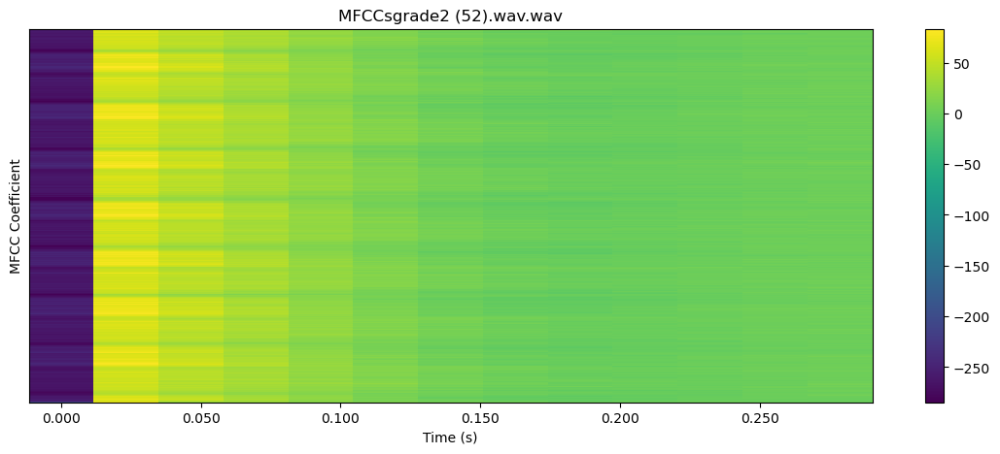


 60%|█████▉    | 84/141 [02:15<01:32,  1.63s/it]

22050


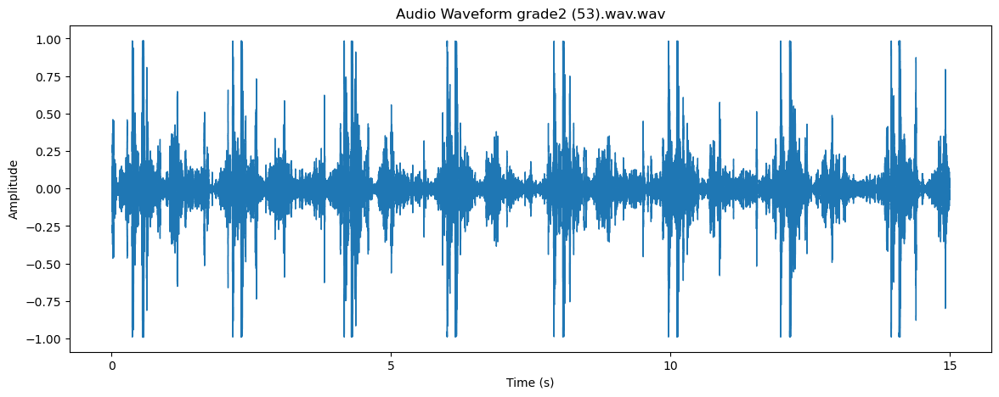

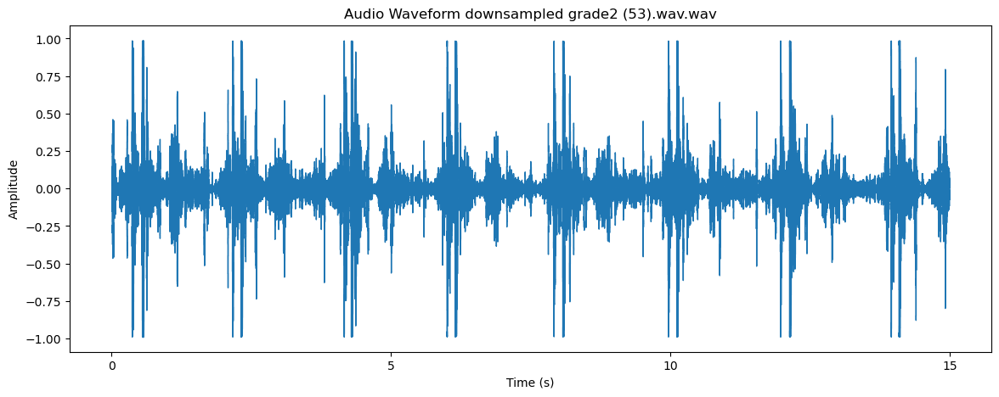

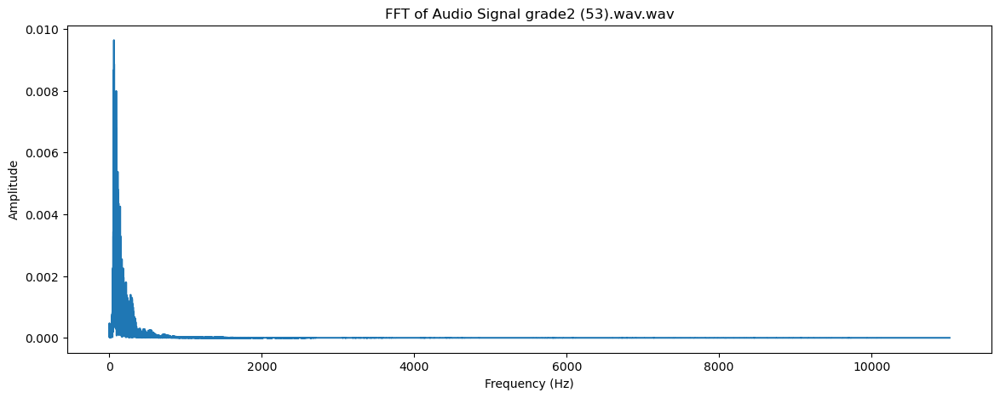

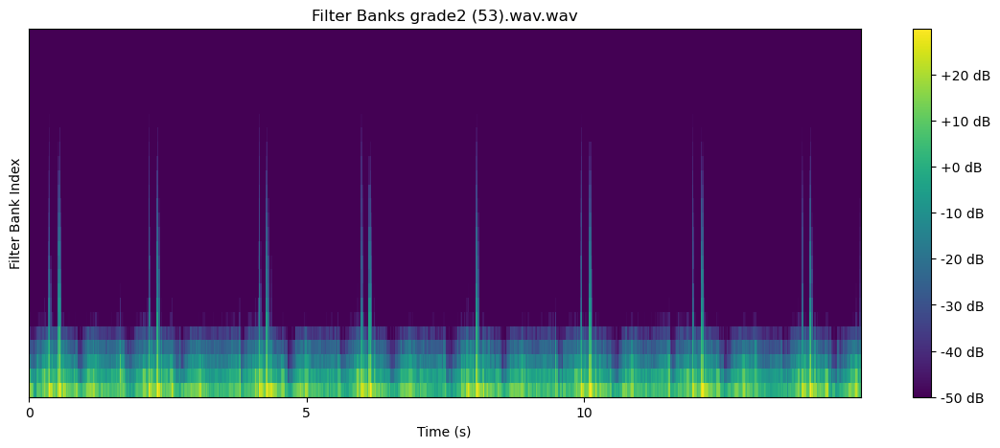

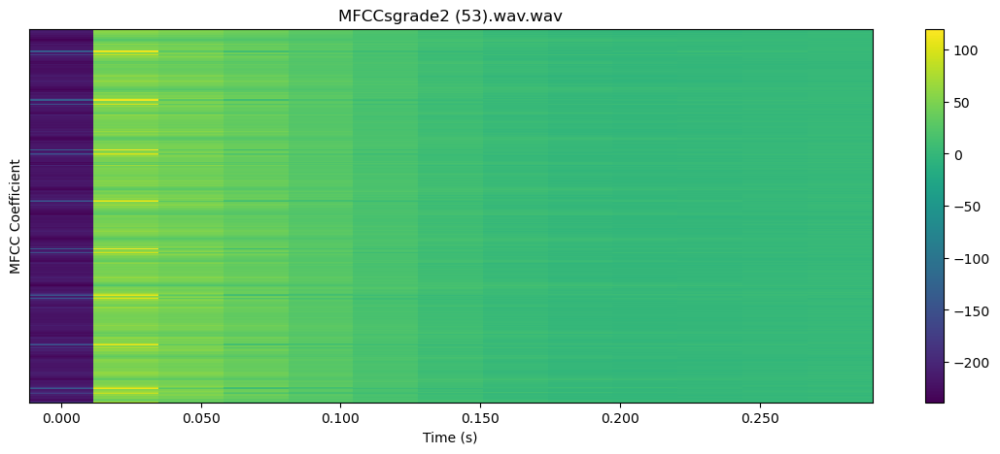


 60%|██████    | 85/141 [02:16<01:31,  1.64s/it]

22050


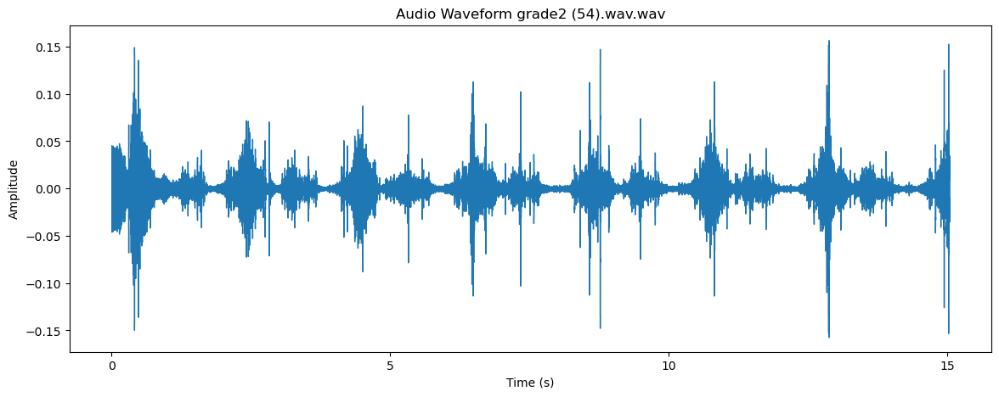

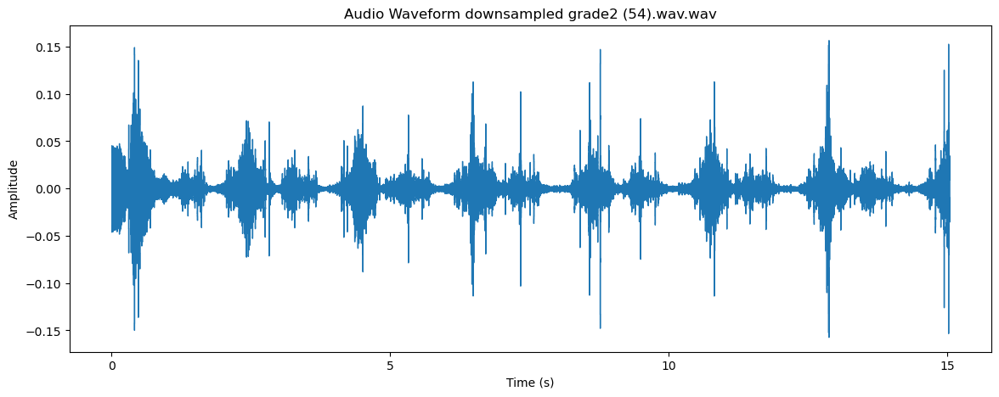

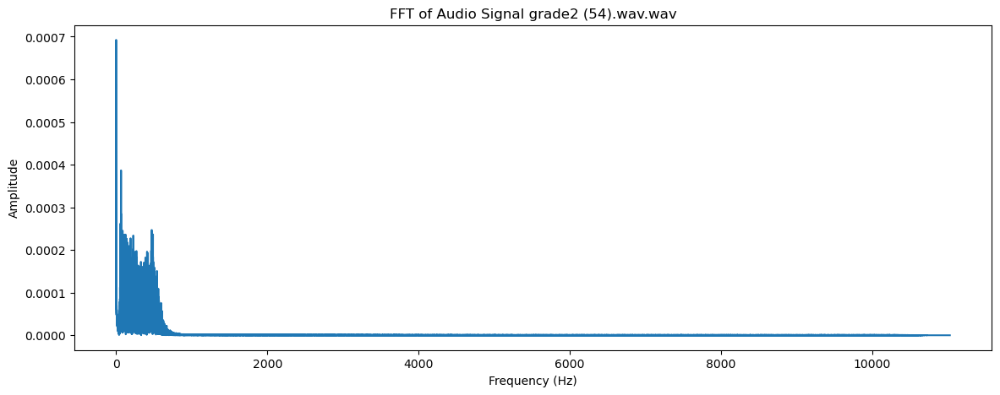

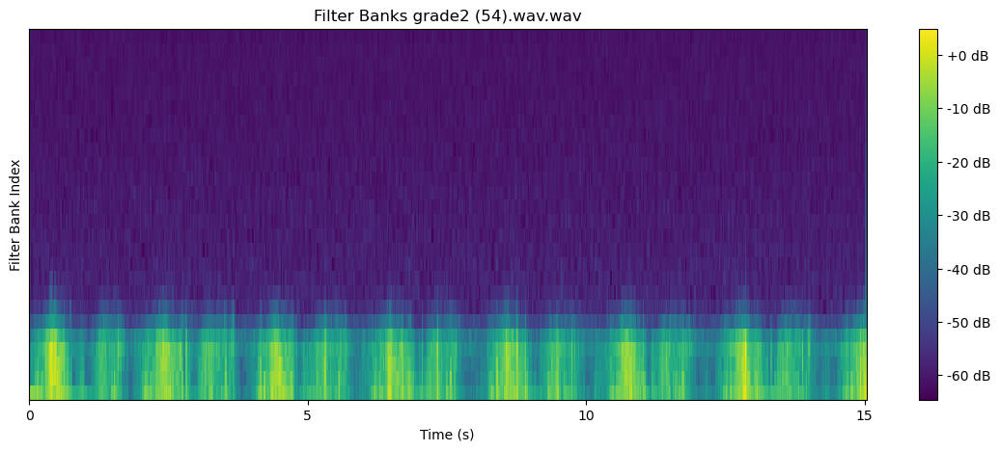

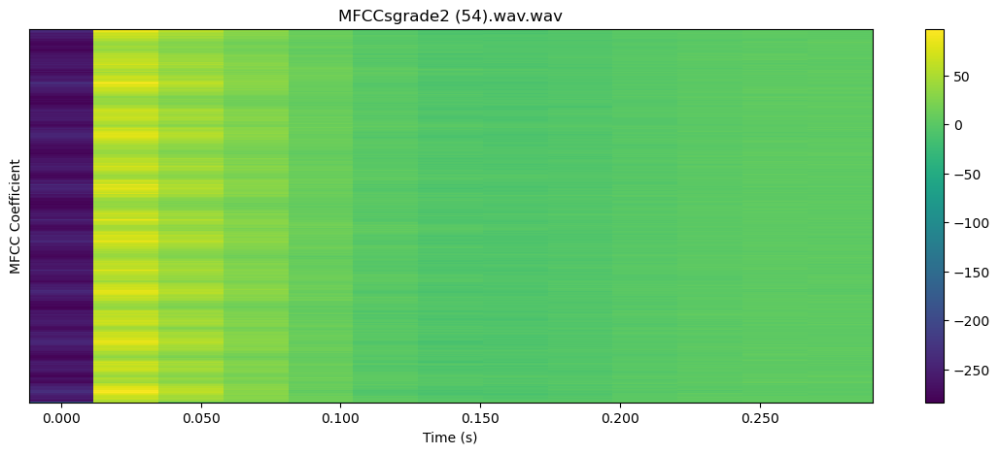


 61%|██████    | 86/141 [02:18<01:33,  1.70s/it]

22050


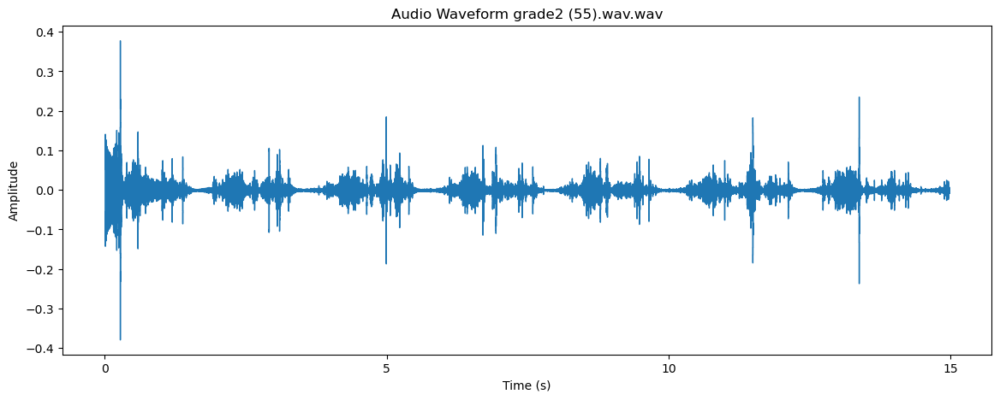

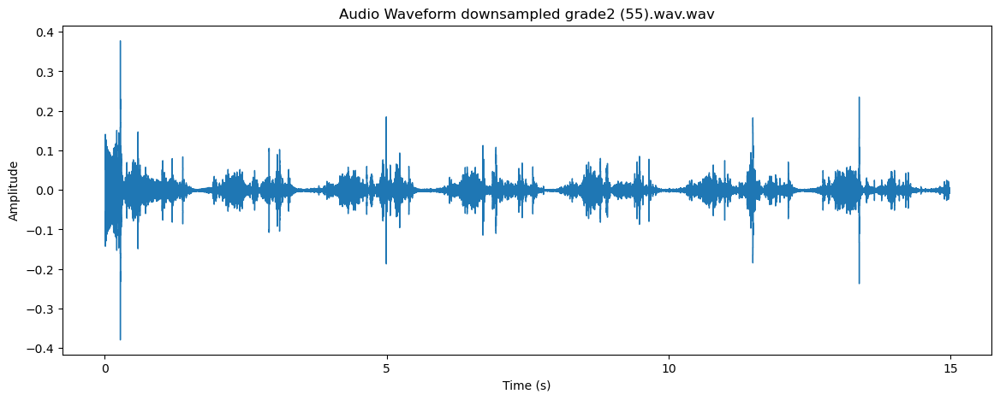

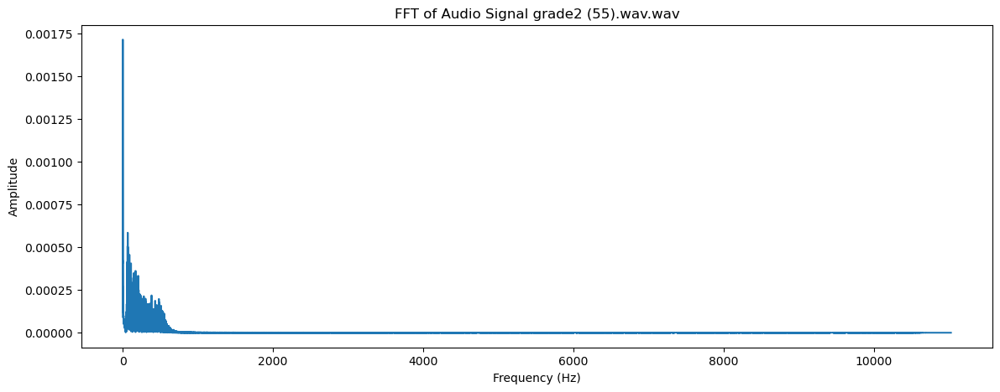

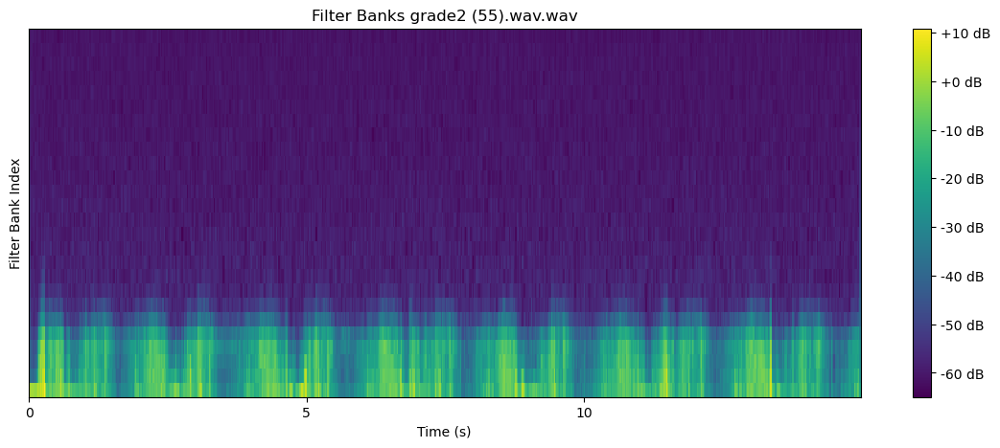

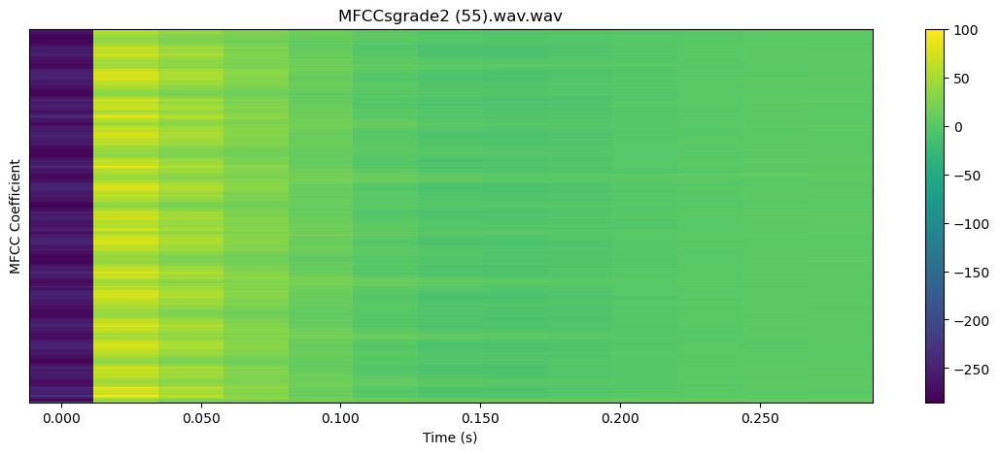


 62%|██████▏   | 87/141 [02:20<01:33,  1.74s/it]

22050


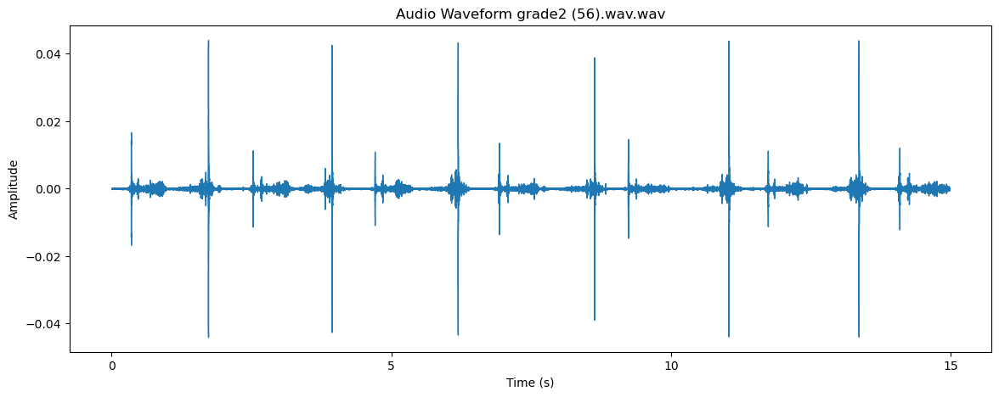

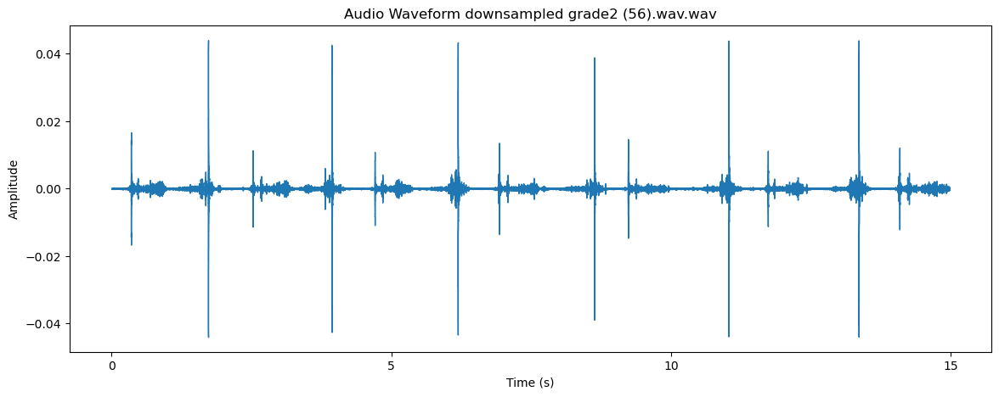

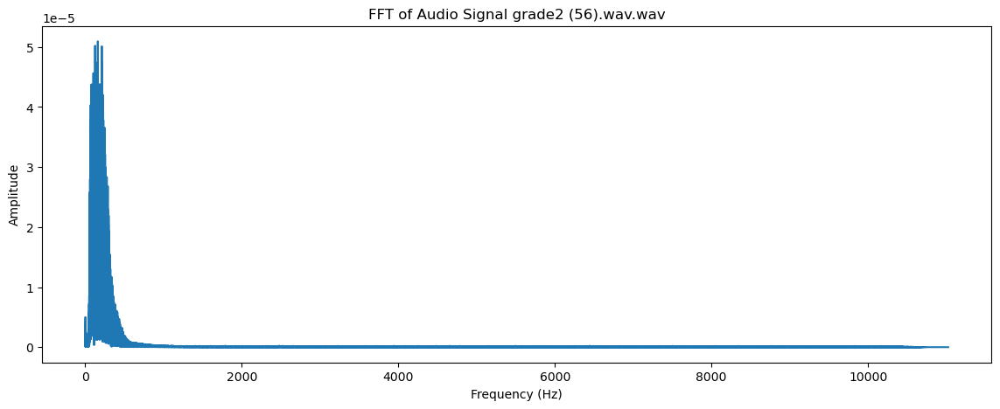

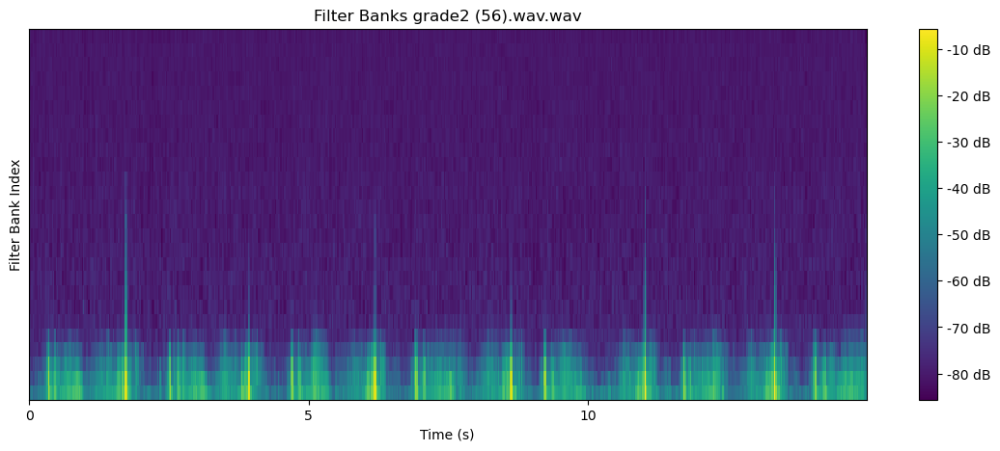

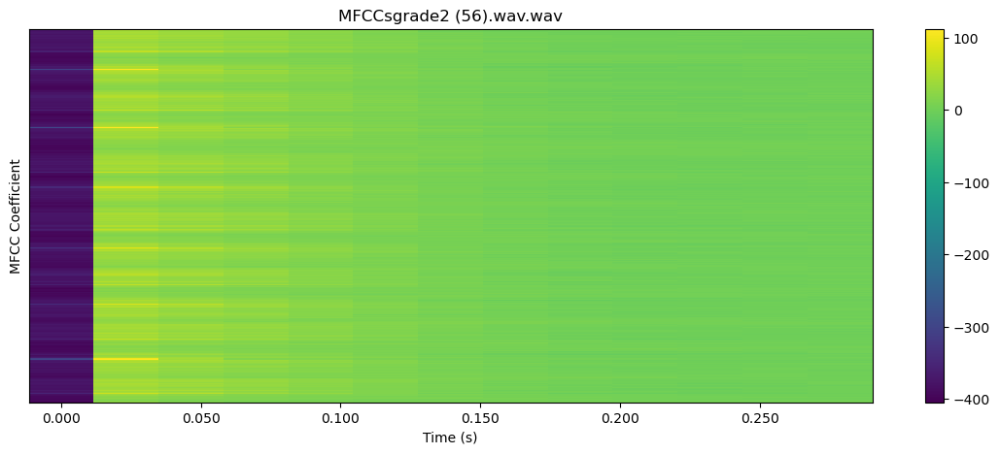


 62%|██████▏   | 88/141 [02:21<01:26,  1.63s/it]

22050


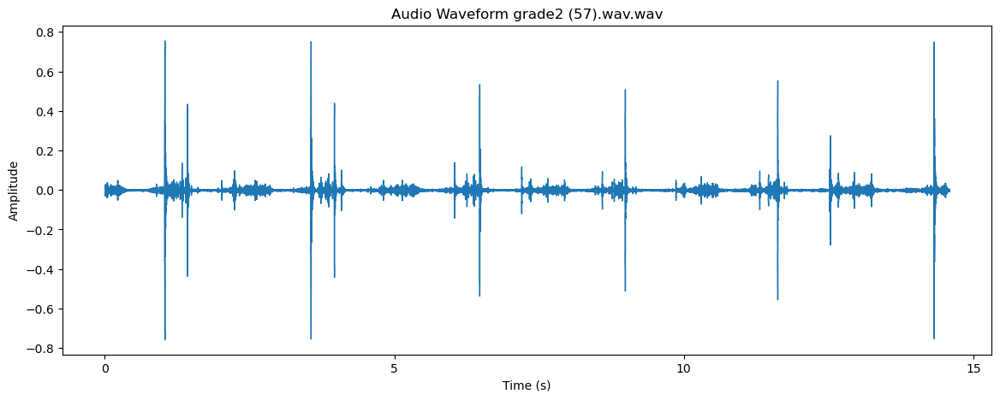

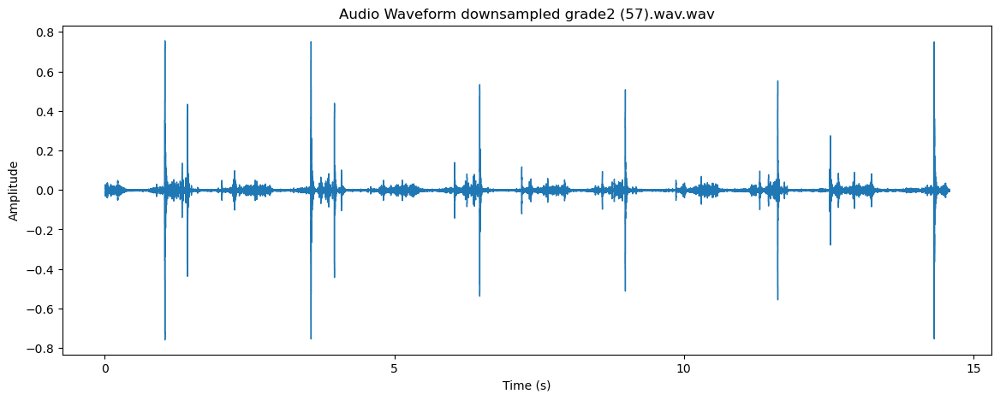

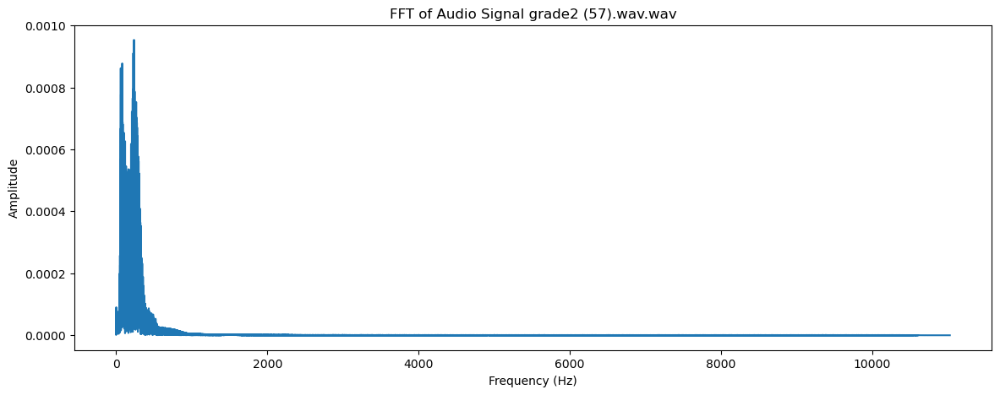

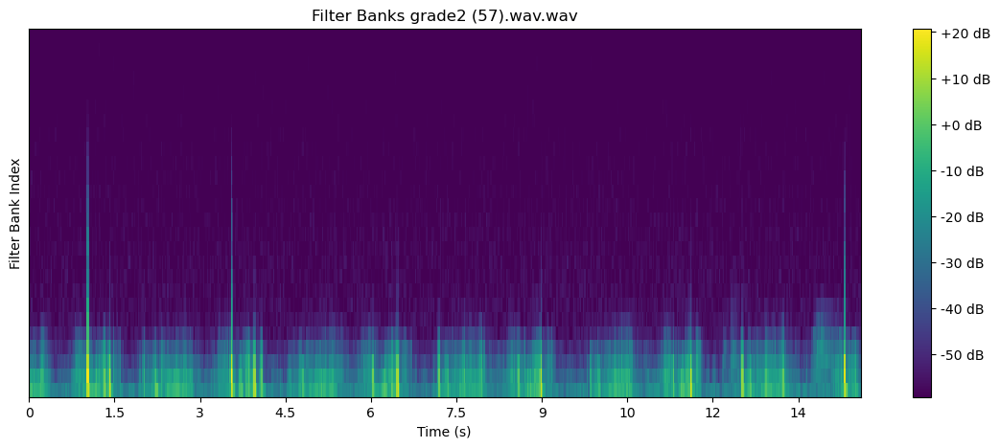

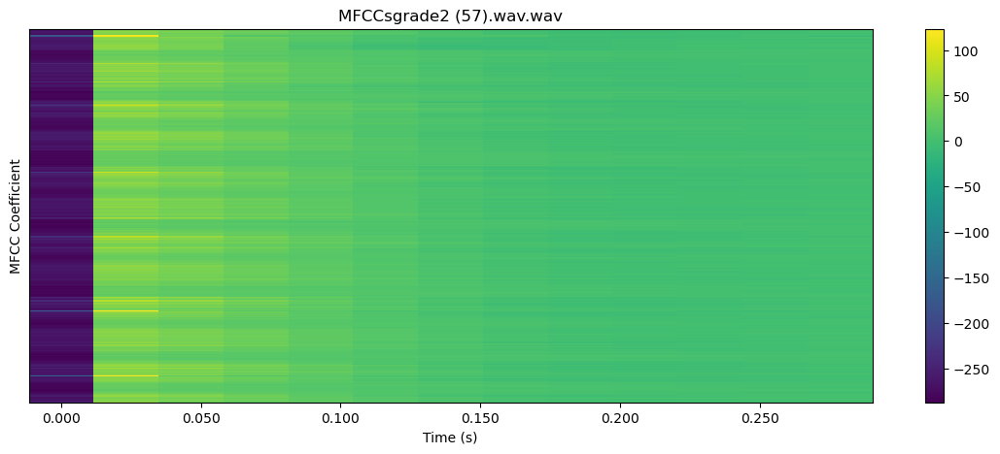


 63%|██████▎   | 89/141 [02:23<01:21,  1.56s/it]

22050


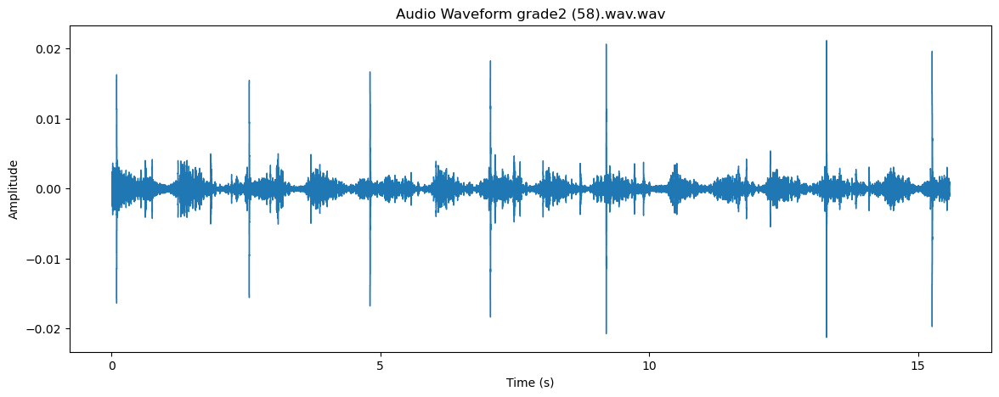

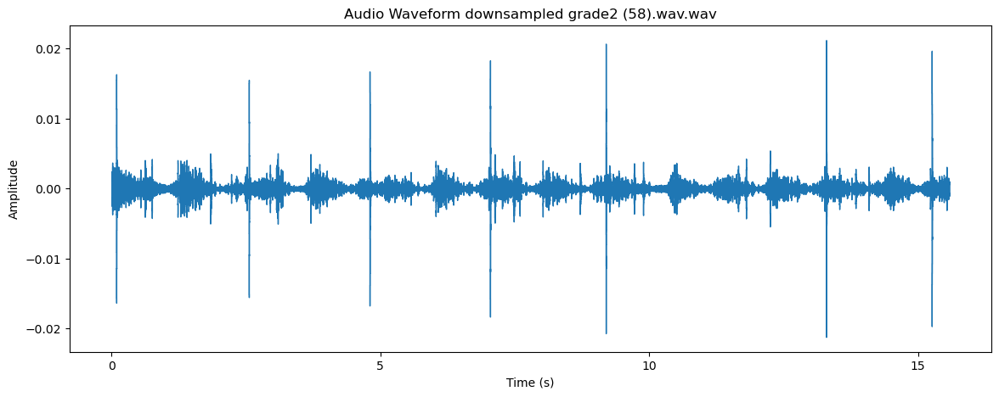

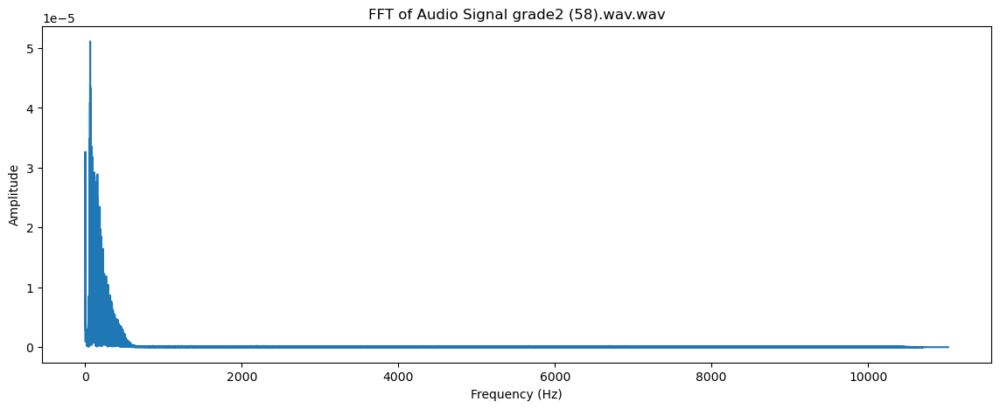

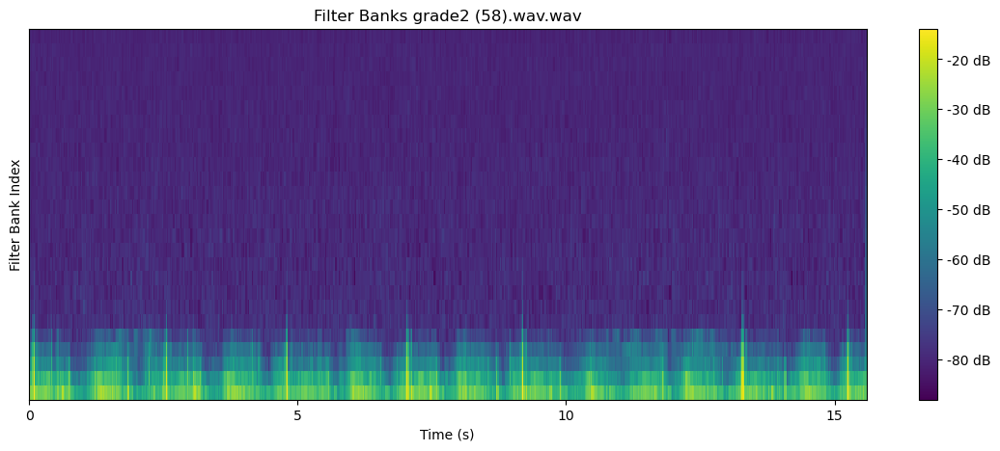

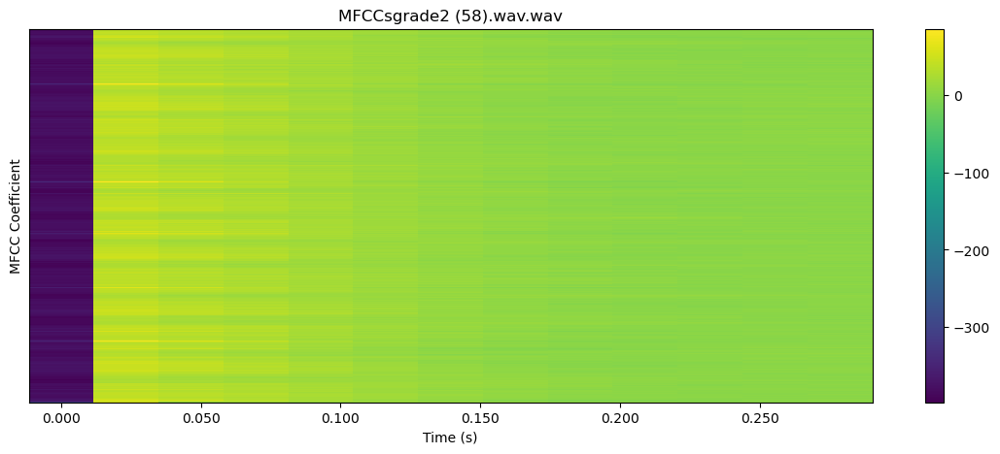


 64%|██████▍   | 90/141 [02:24<01:17,  1.51s/it]

22050


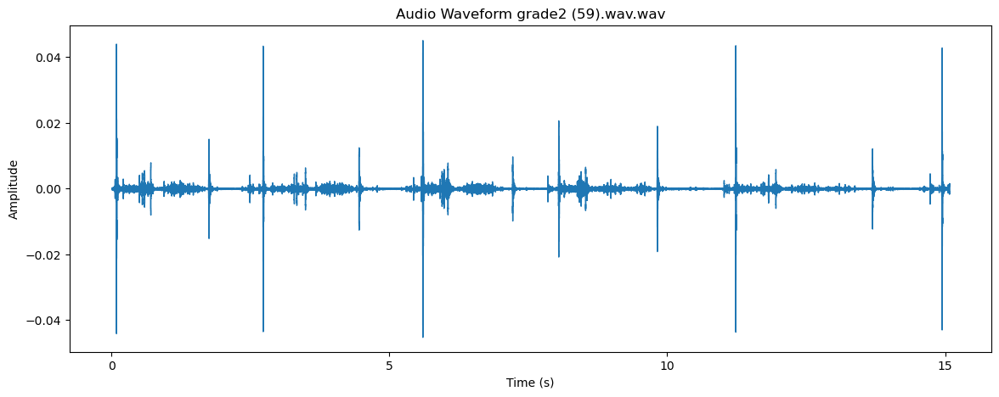

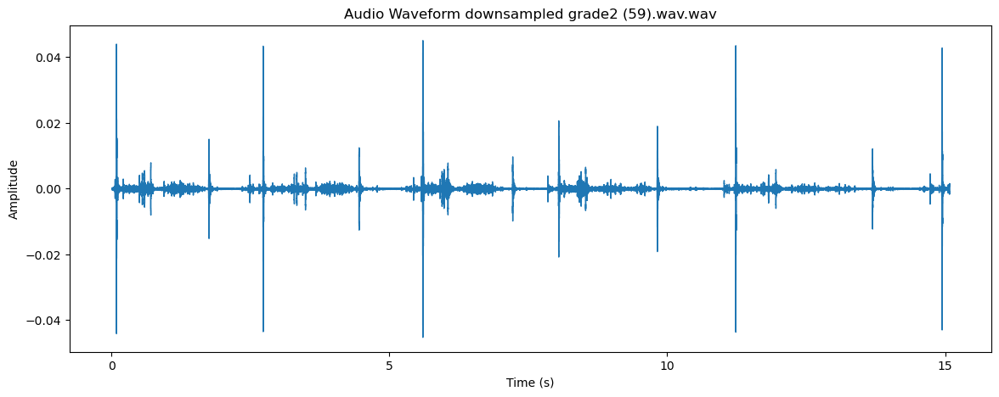

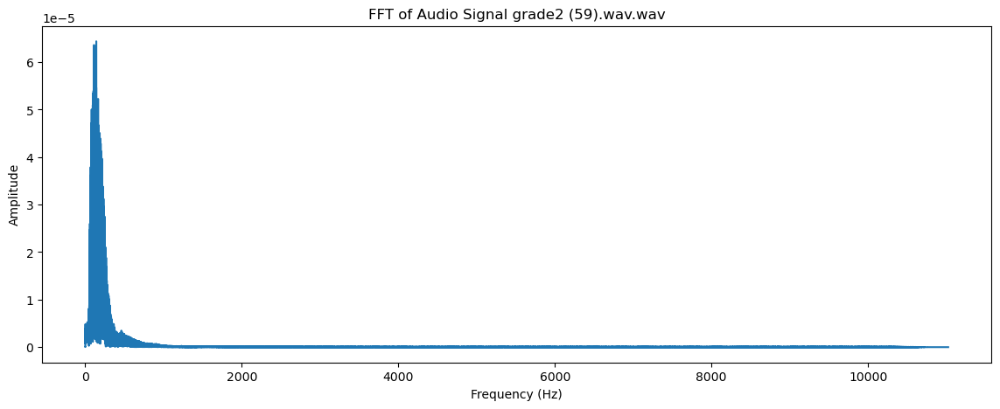

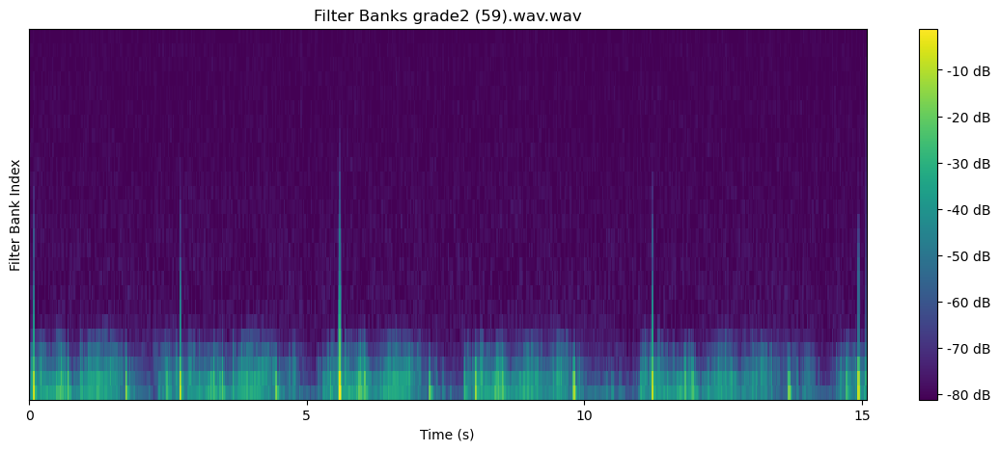

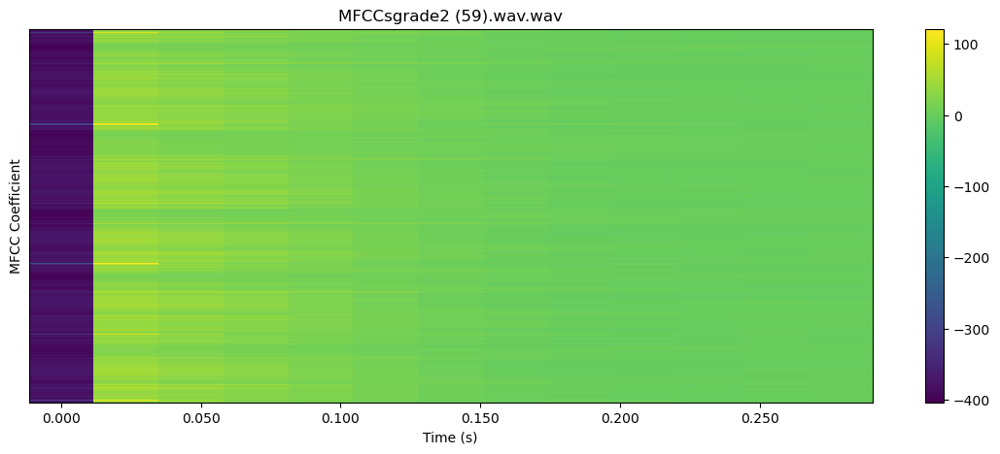


 65%|██████▍   | 91/141 [02:26<01:12,  1.46s/it]

22050


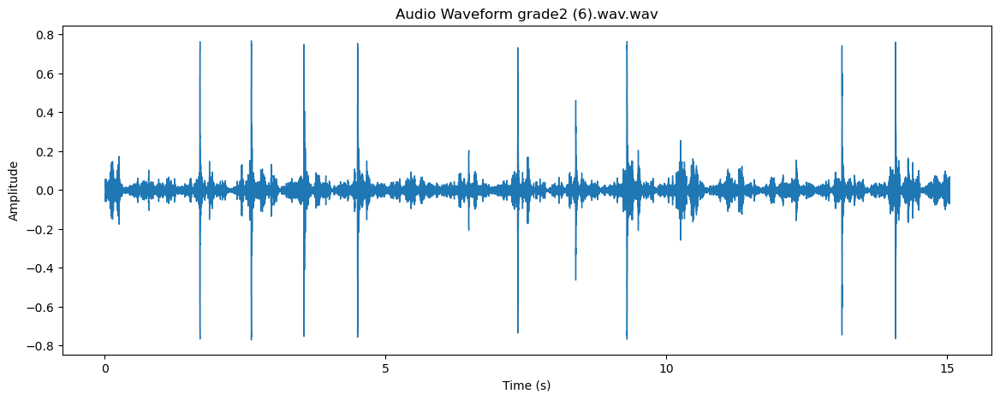

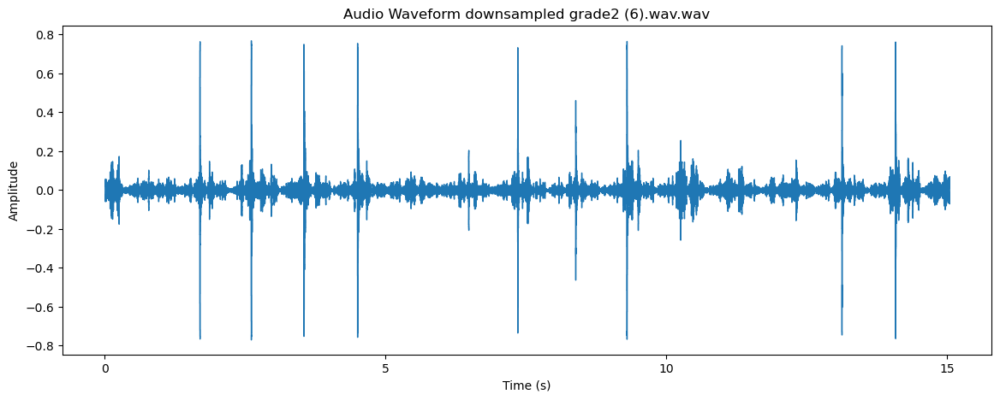

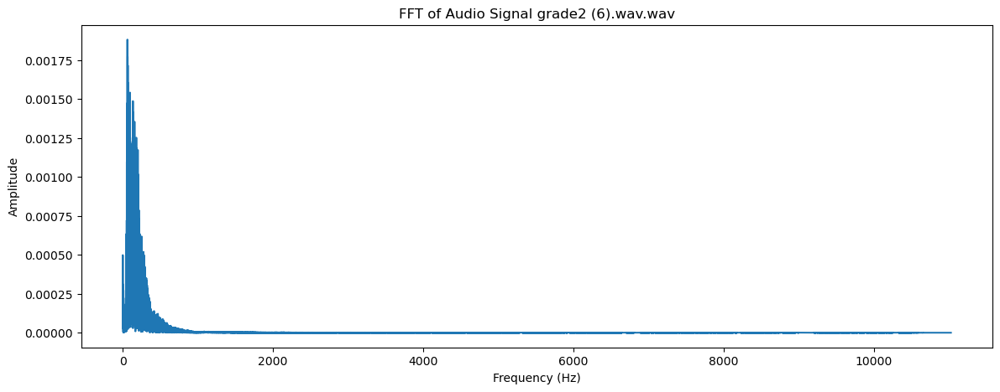

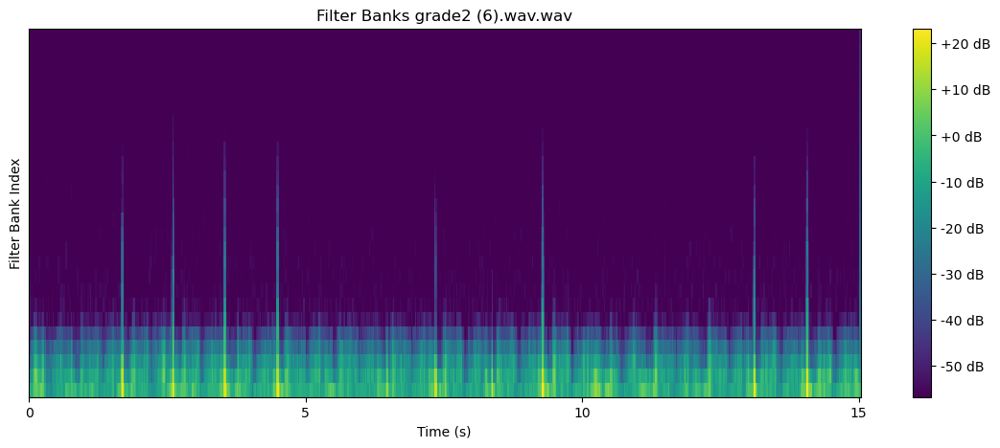

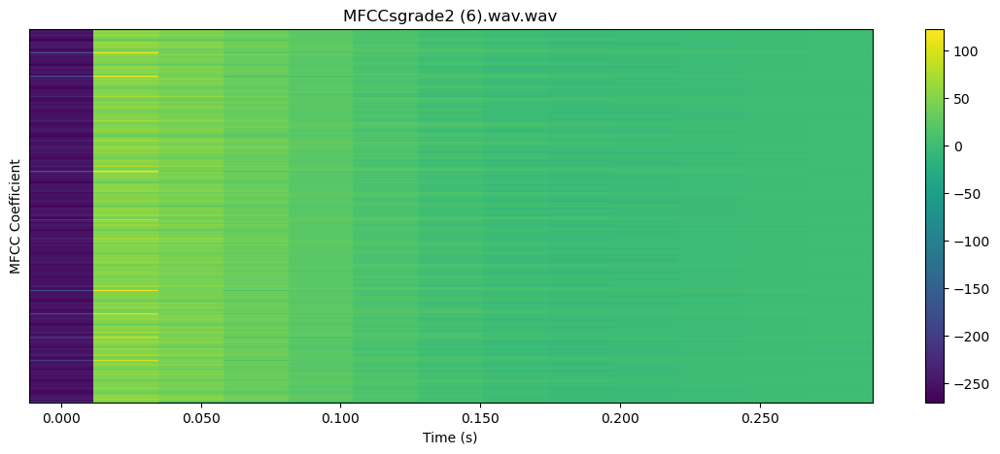


 65%|██████▌   | 92/141 [02:27<01:09,  1.42s/it]

22050


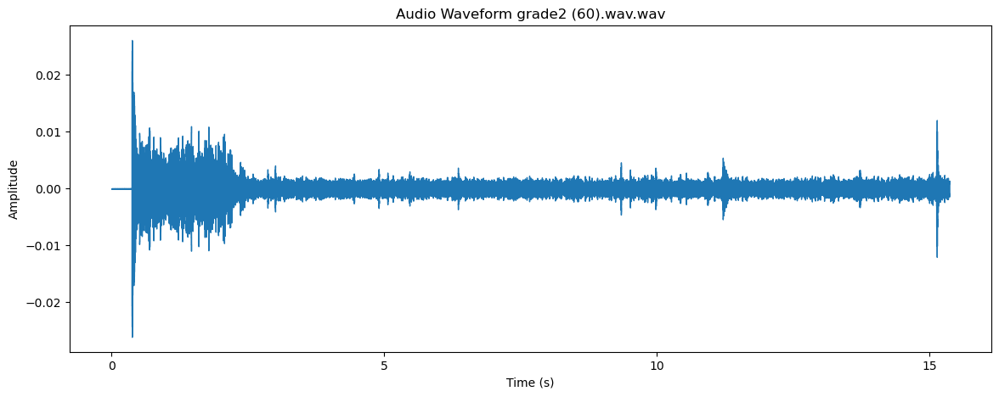

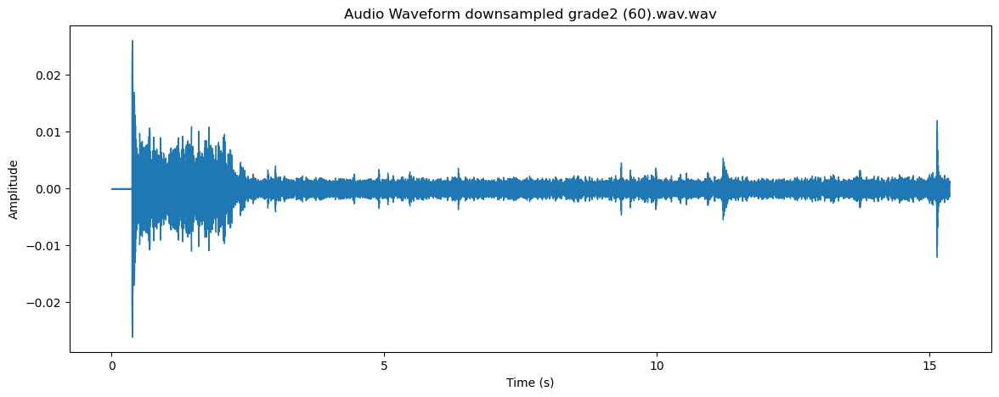

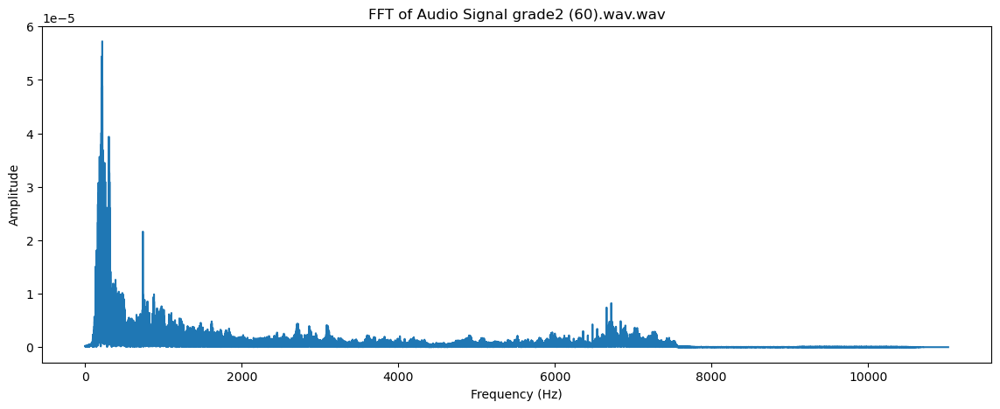

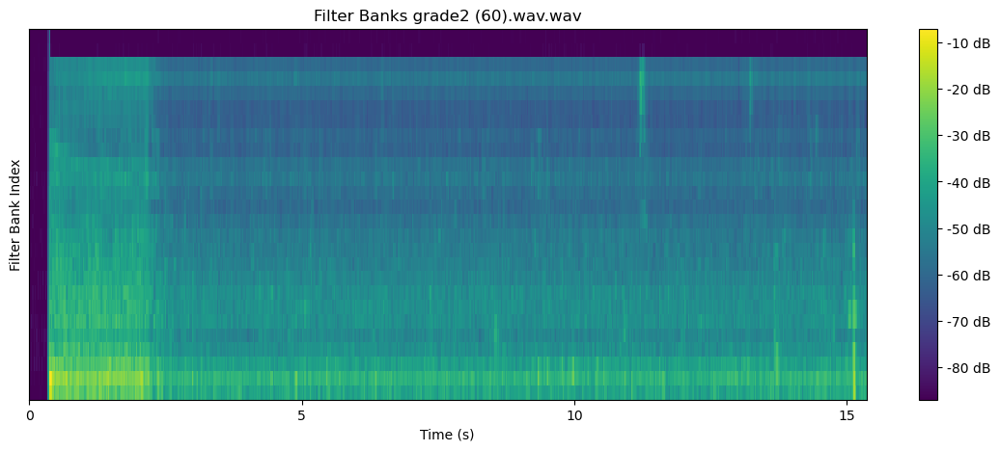

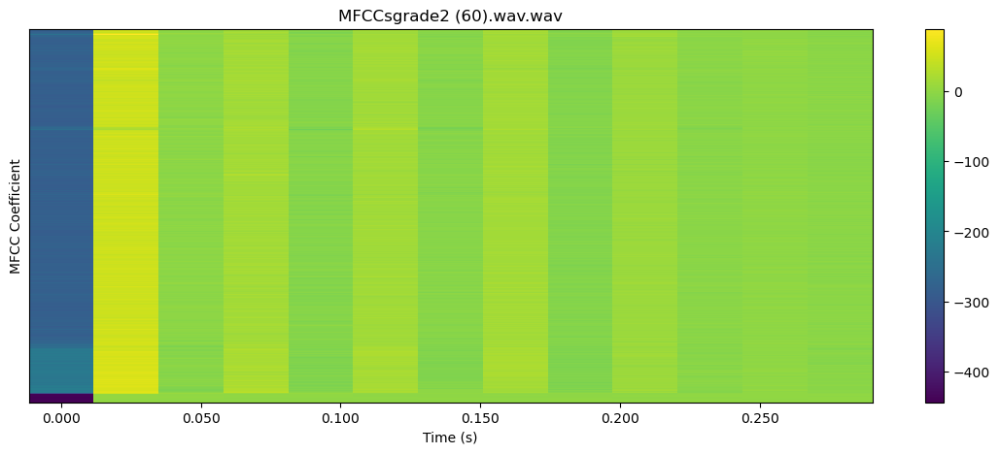


 66%|██████▌   | 93/141 [02:28<01:07,  1.41s/it]

22050


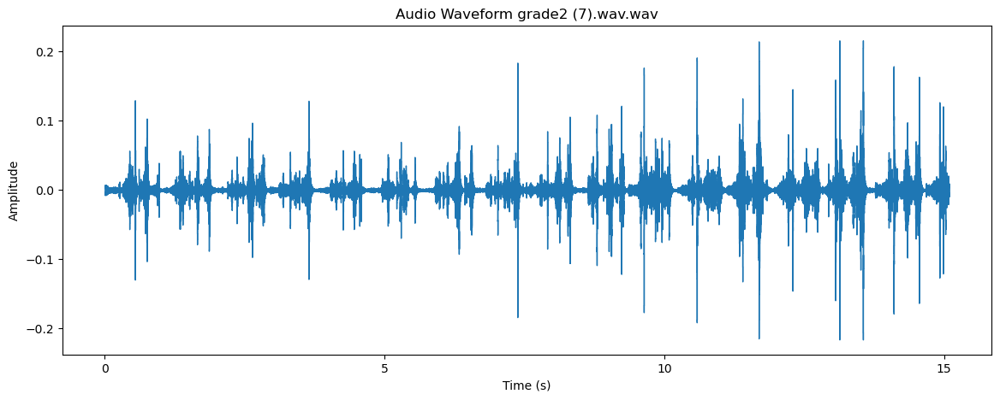

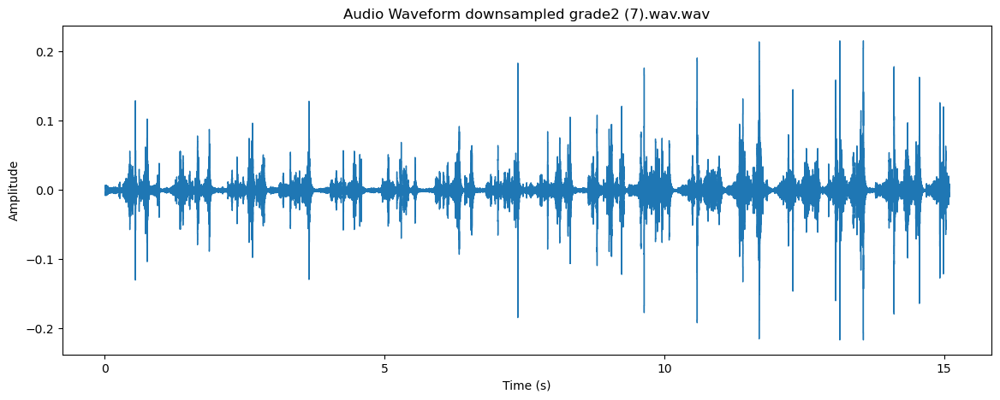

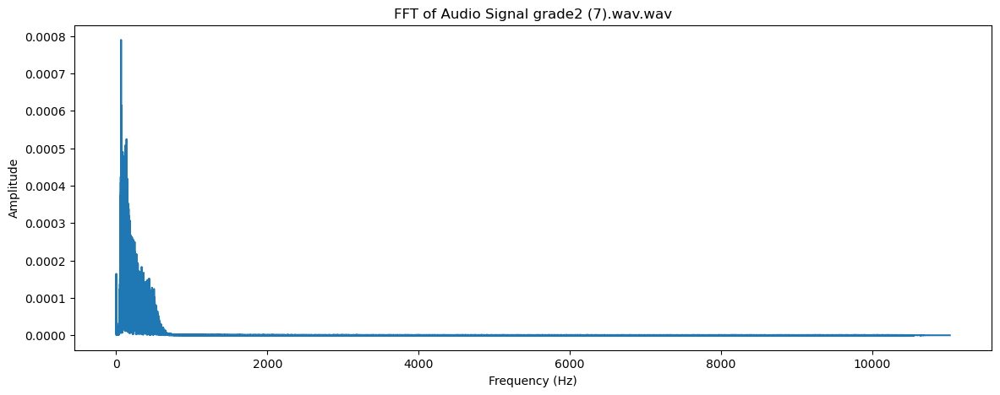

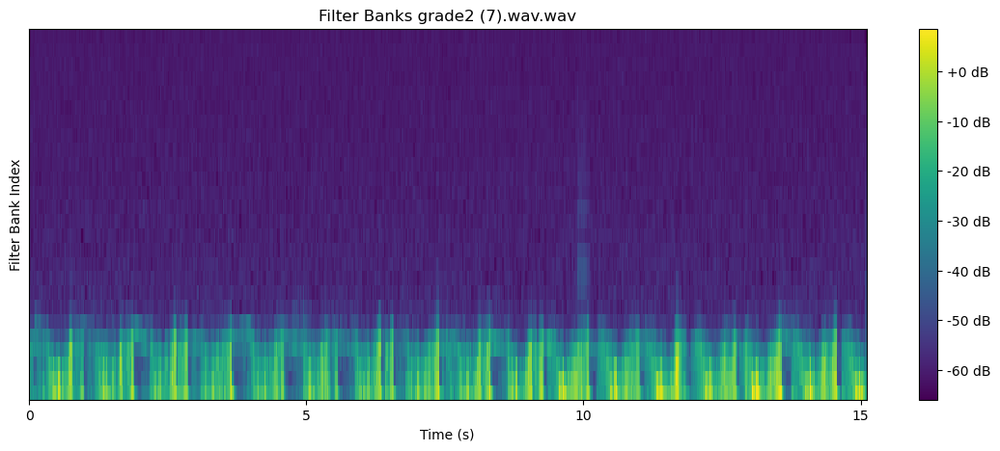

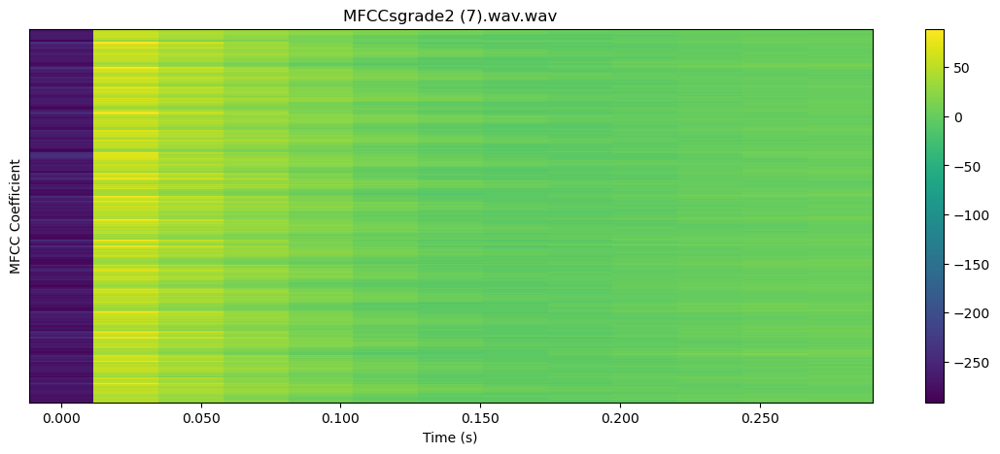


 67%|██████▋   | 94/141 [02:30<01:06,  1.41s/it]

22050


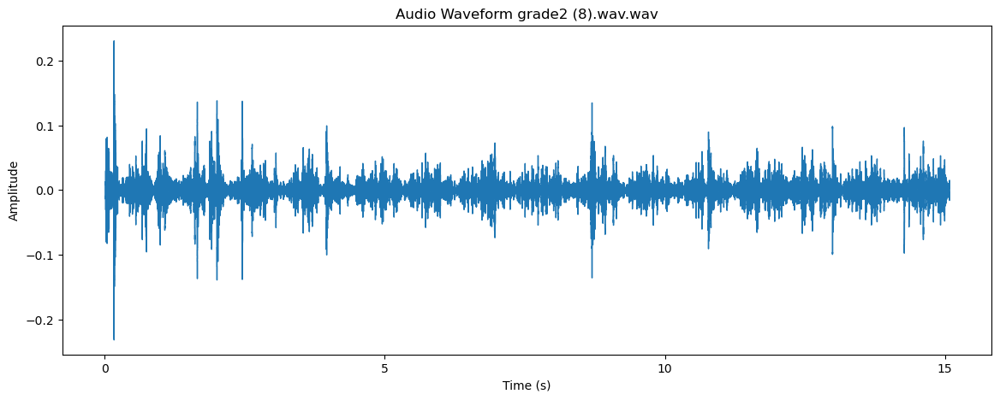

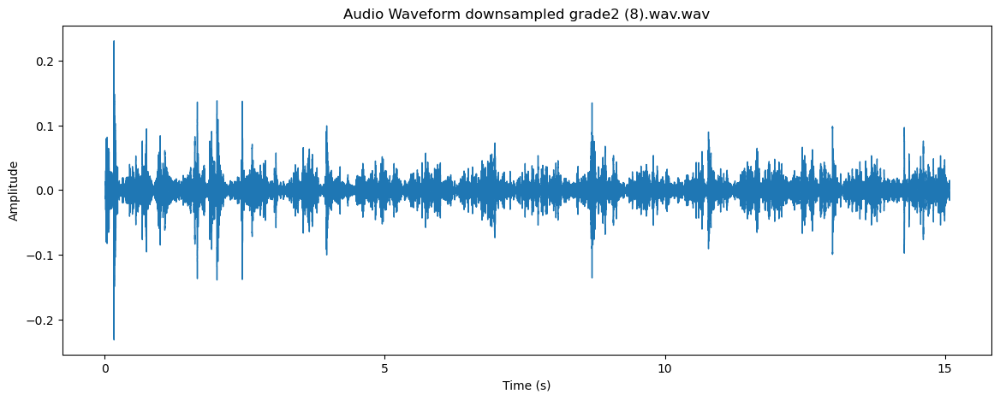

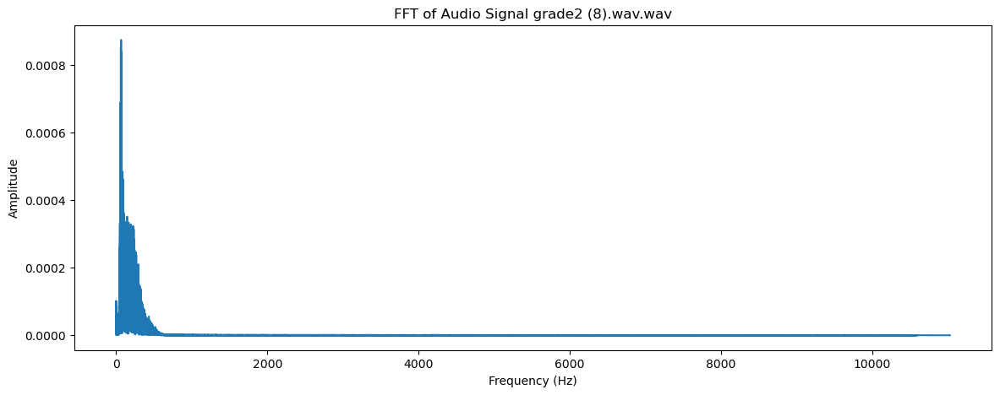

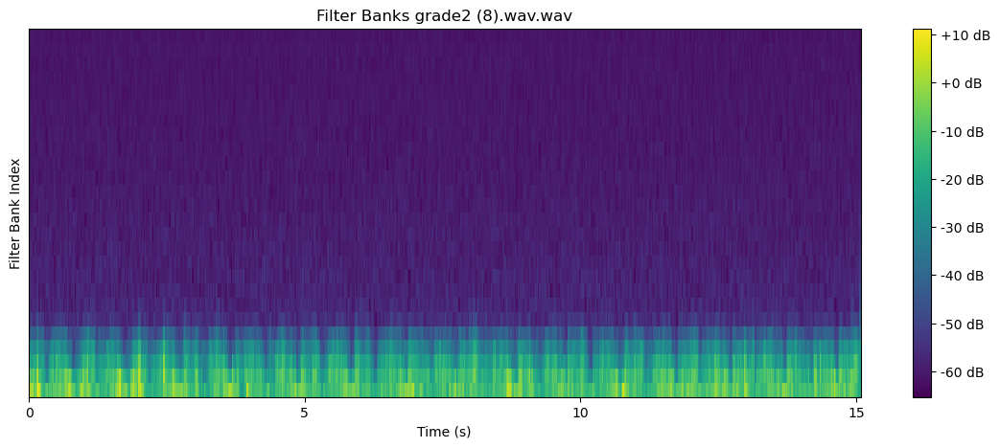

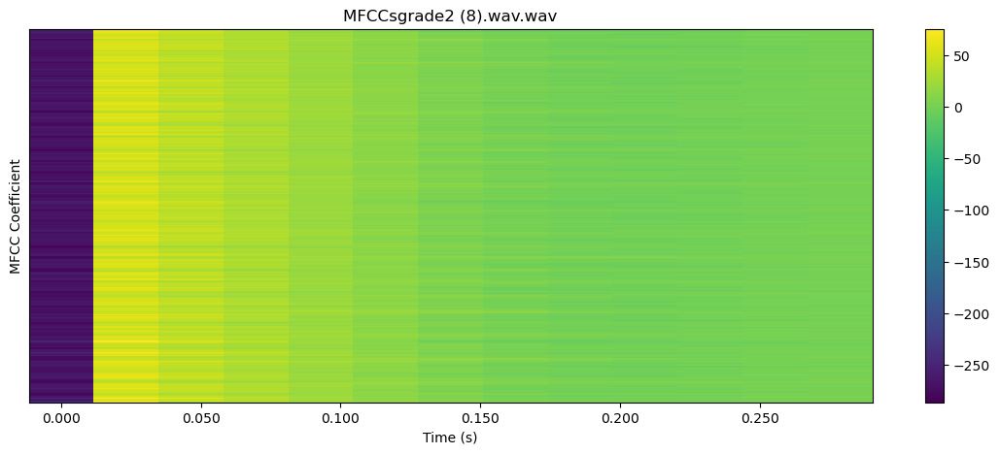


 67%|██████▋   | 95/141 [02:31<01:04,  1.41s/it]

22050


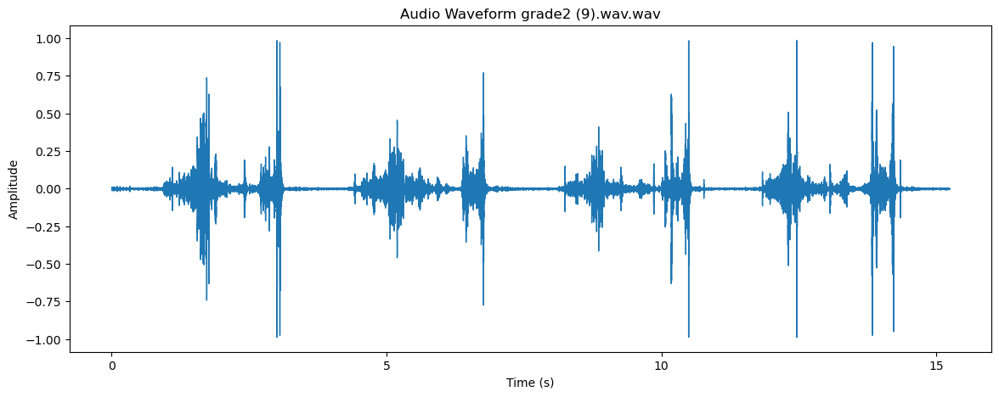

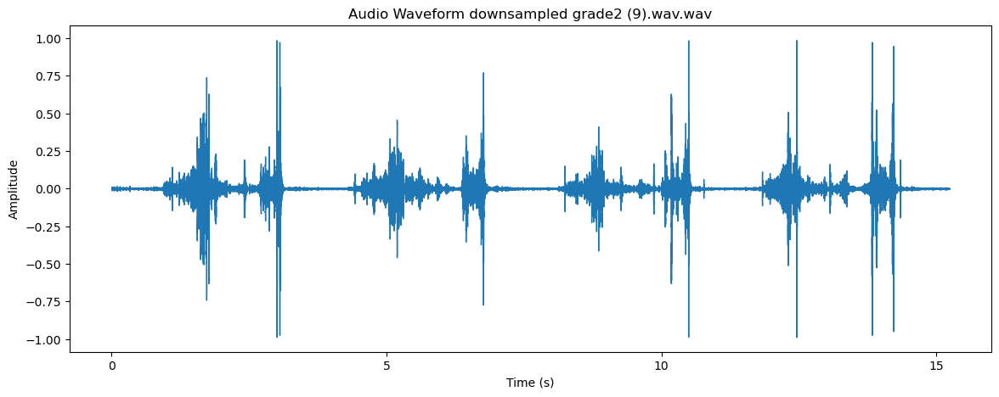

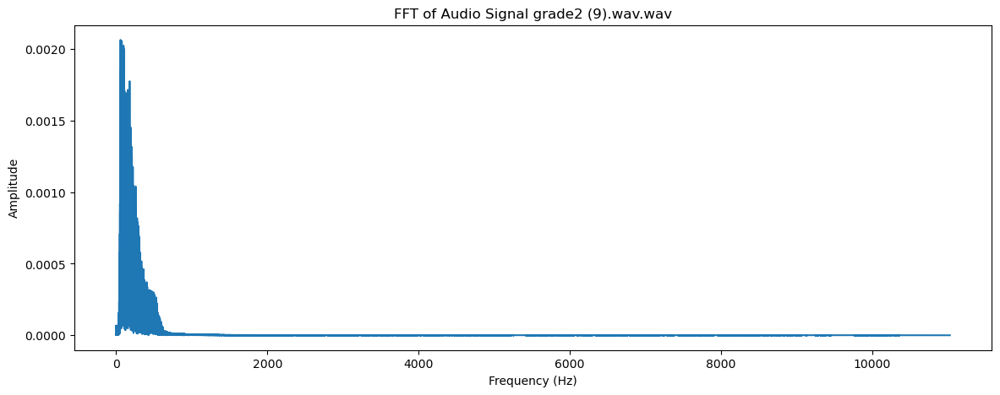

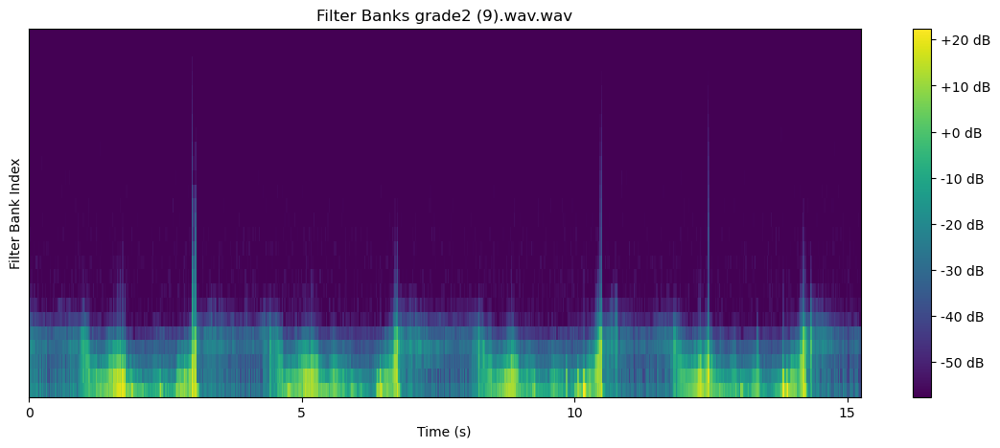

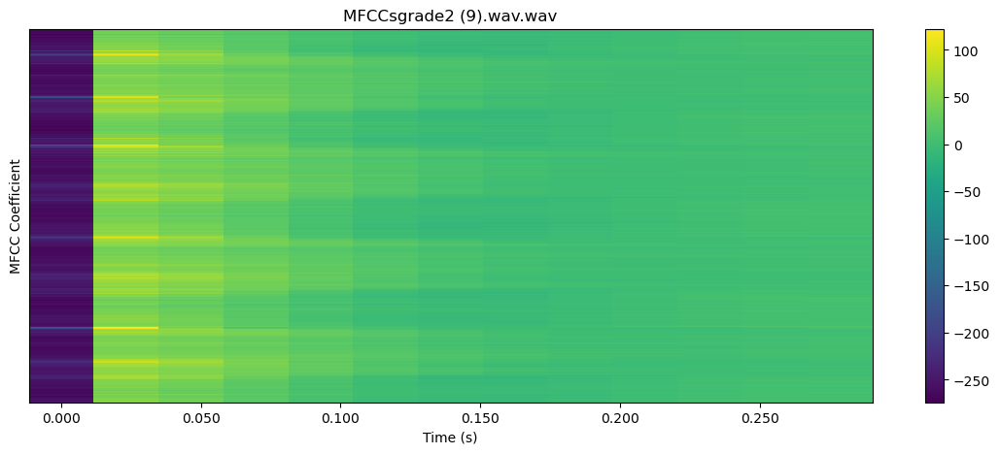


 68%|██████▊   | 96/141 [02:33<01:06,  1.47s/it]

22050


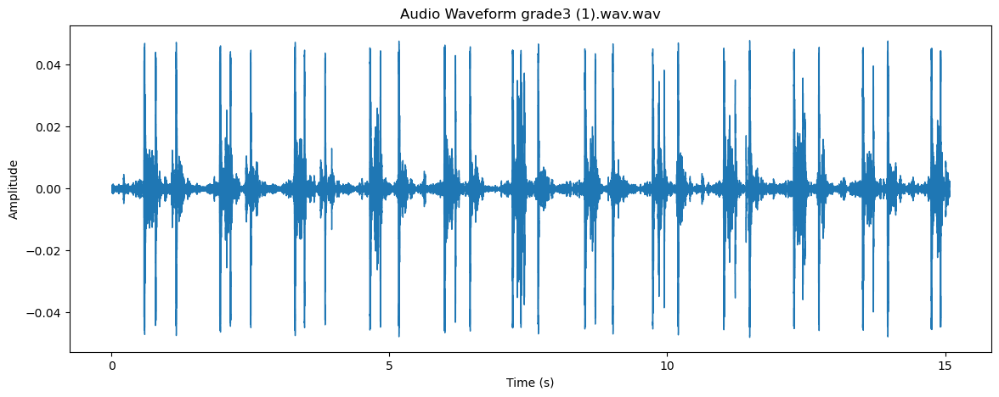

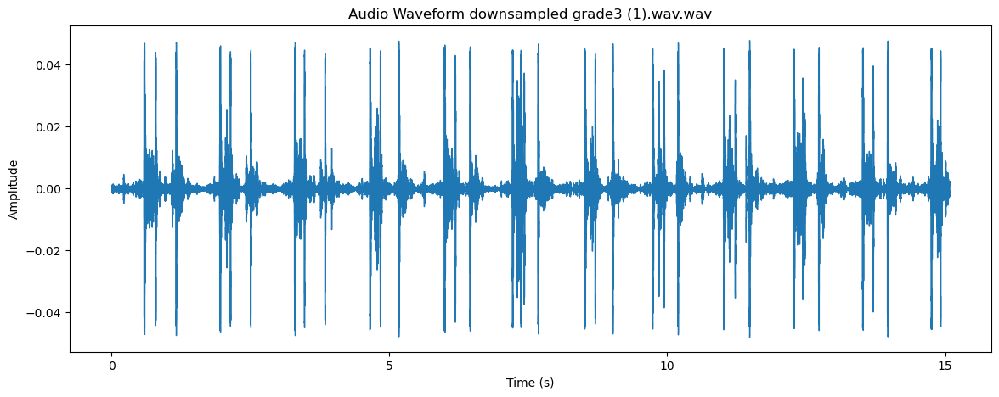

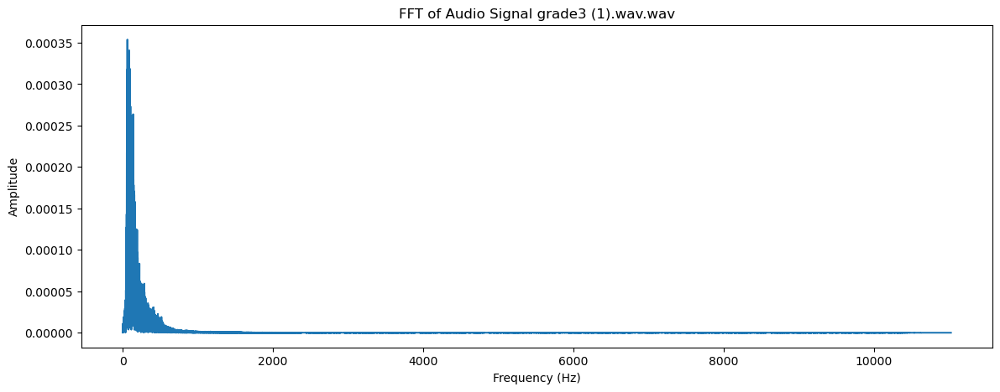

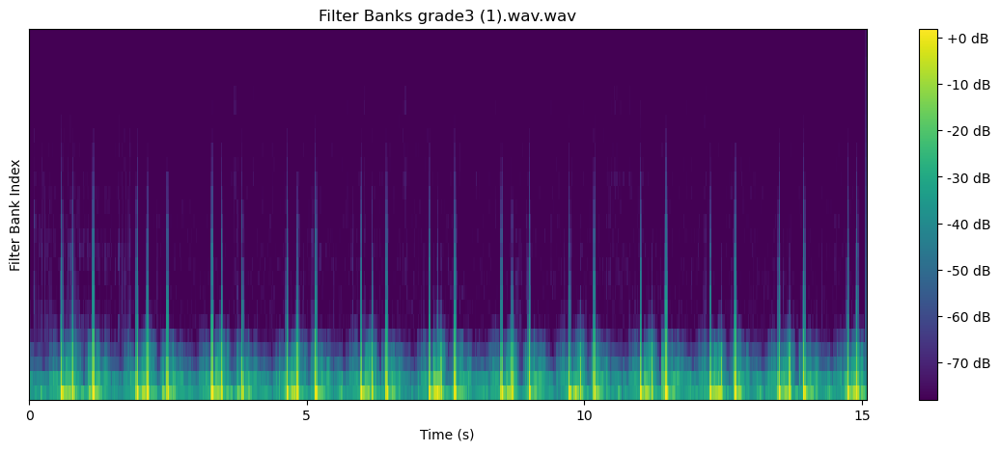

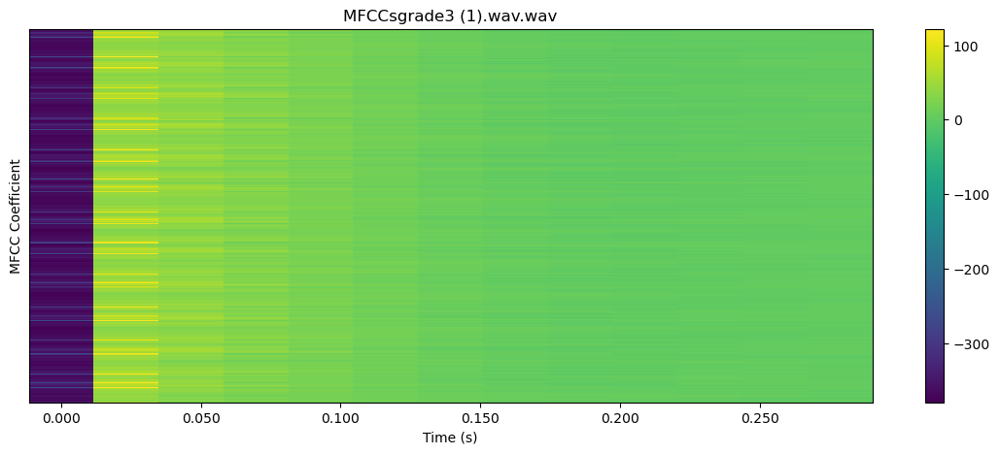


 69%|██████▉   | 97/141 [02:35<01:10,  1.61s/it]

22050


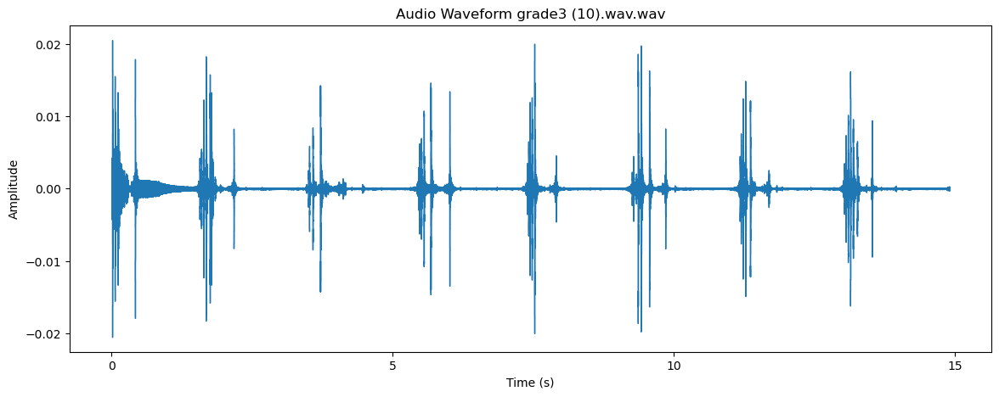

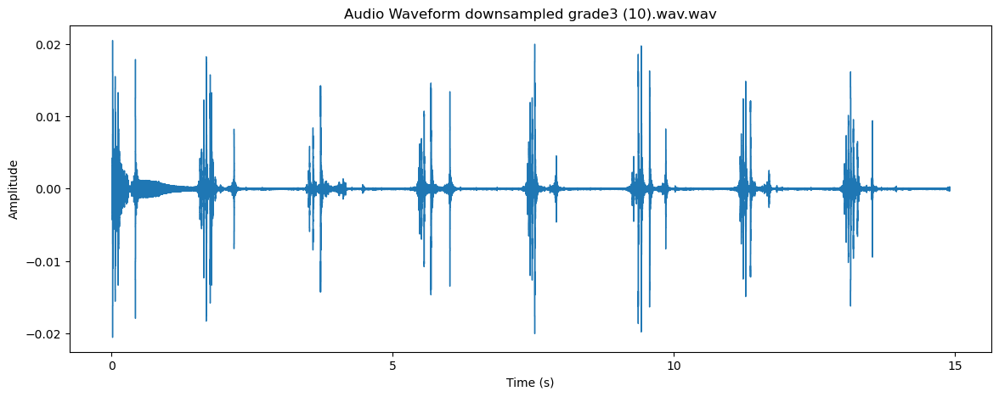

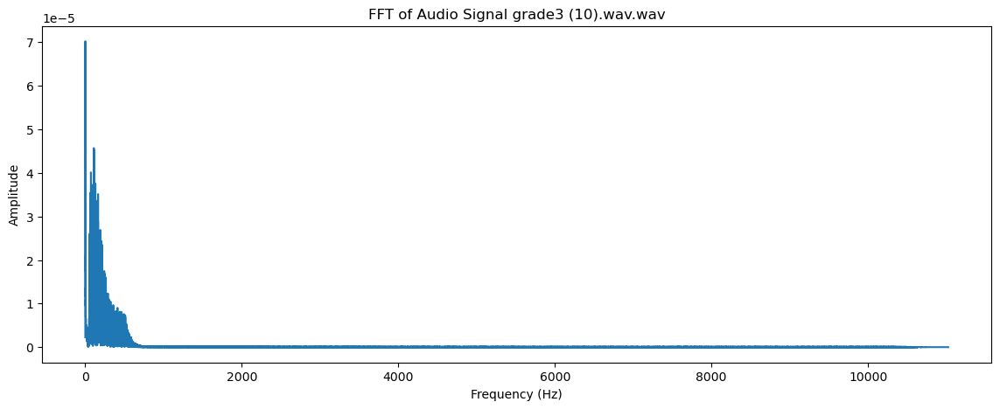

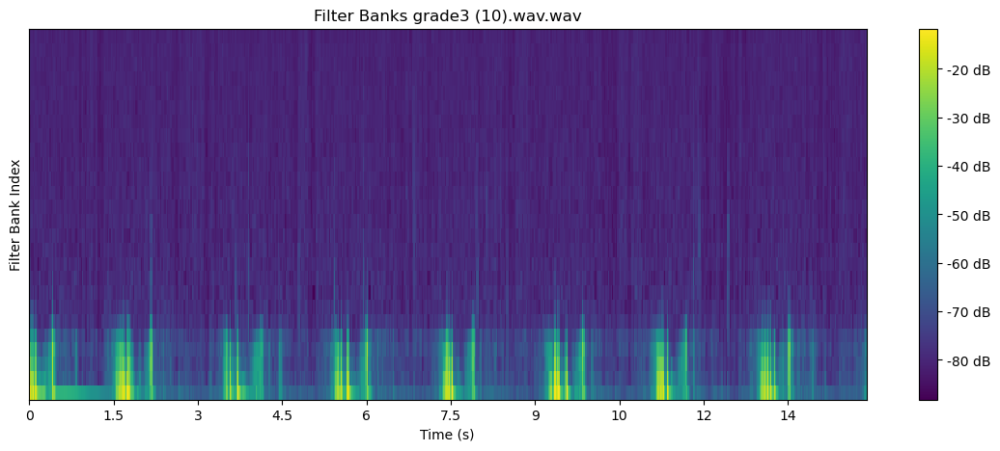

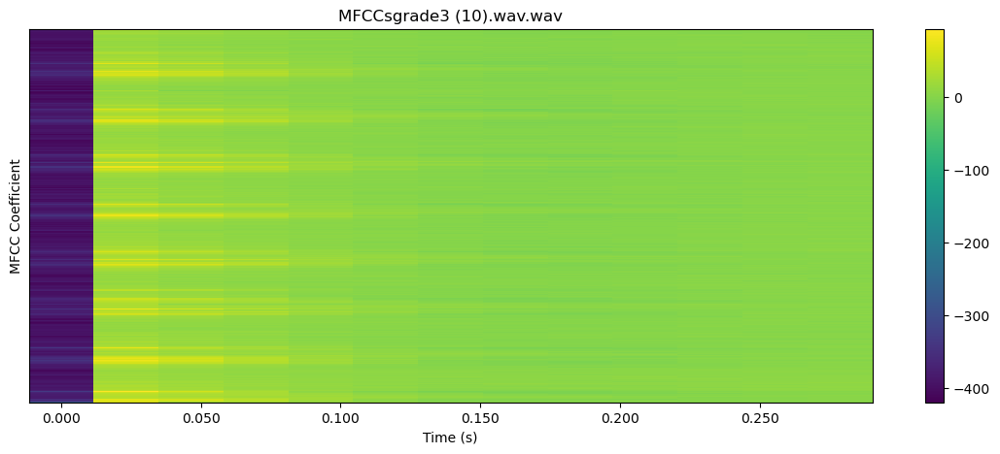


 70%|██████▉   | 98/141 [02:36<01:09,  1.62s/it]

22050


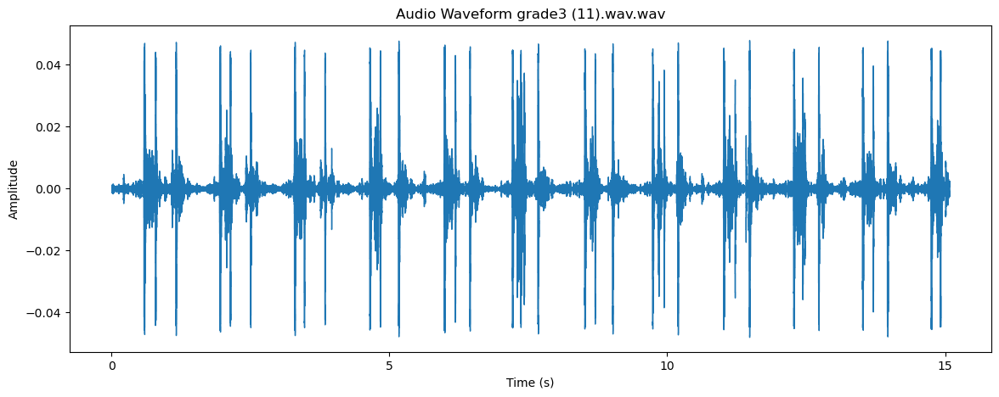

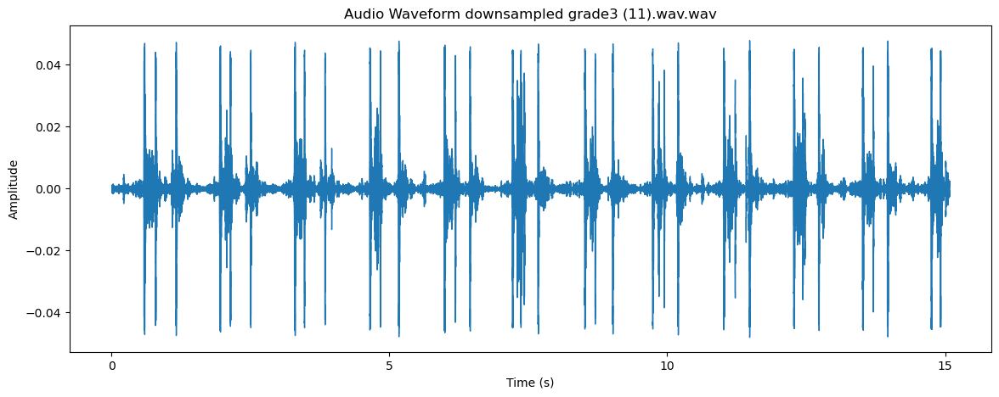

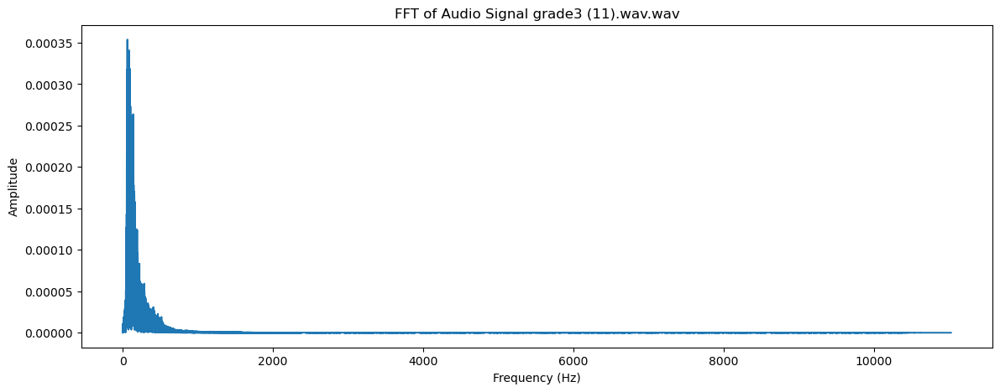

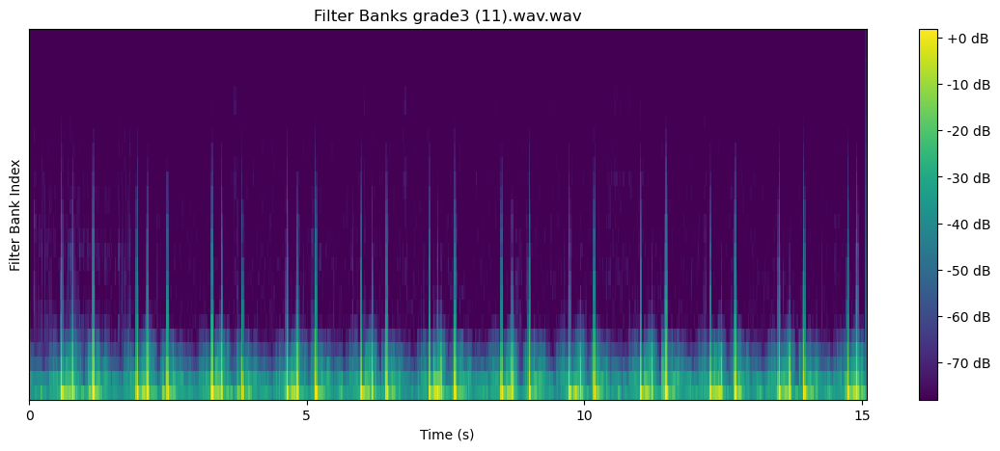

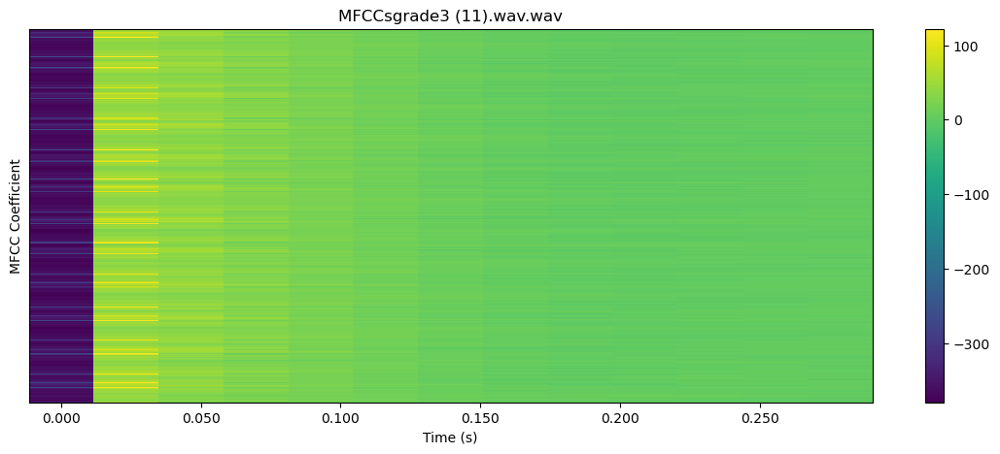


 70%|███████   | 99/141 [02:38<01:05,  1.56s/it]

22050


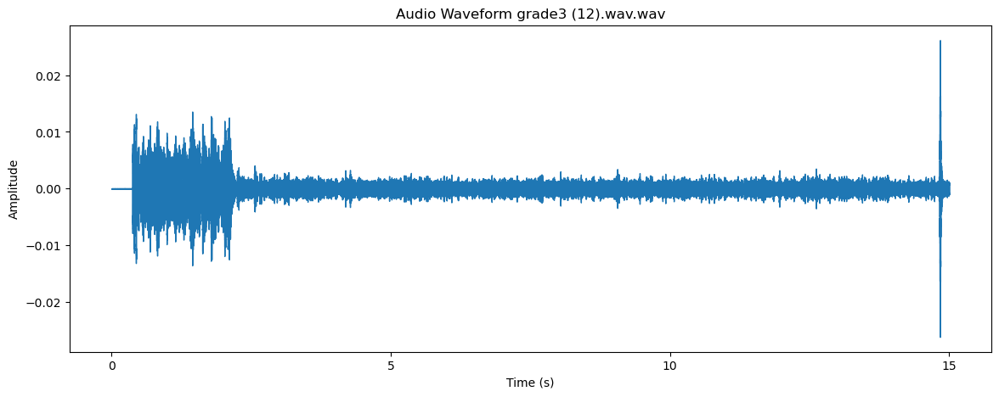

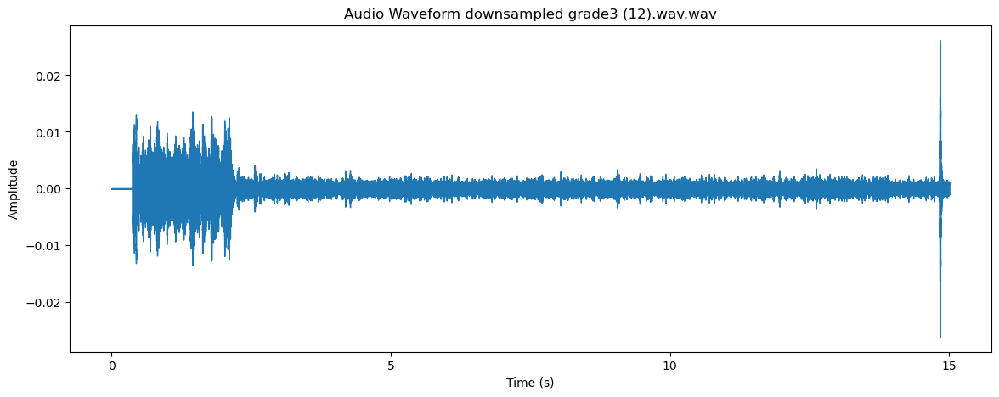

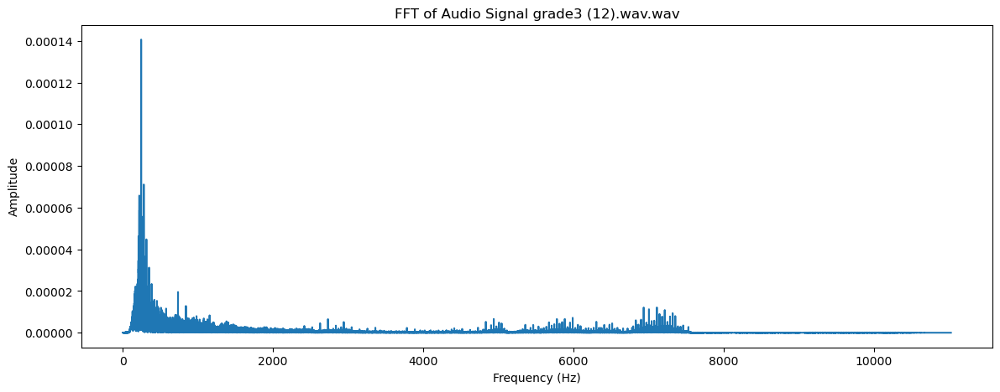

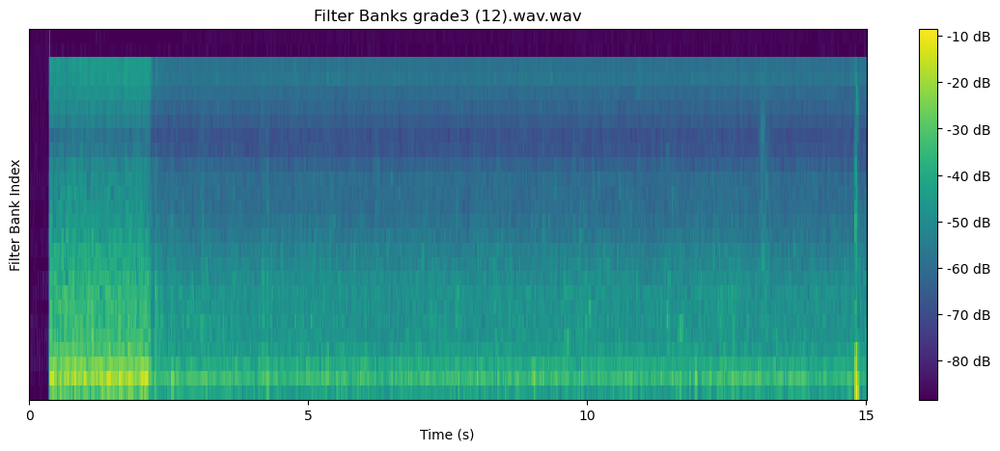

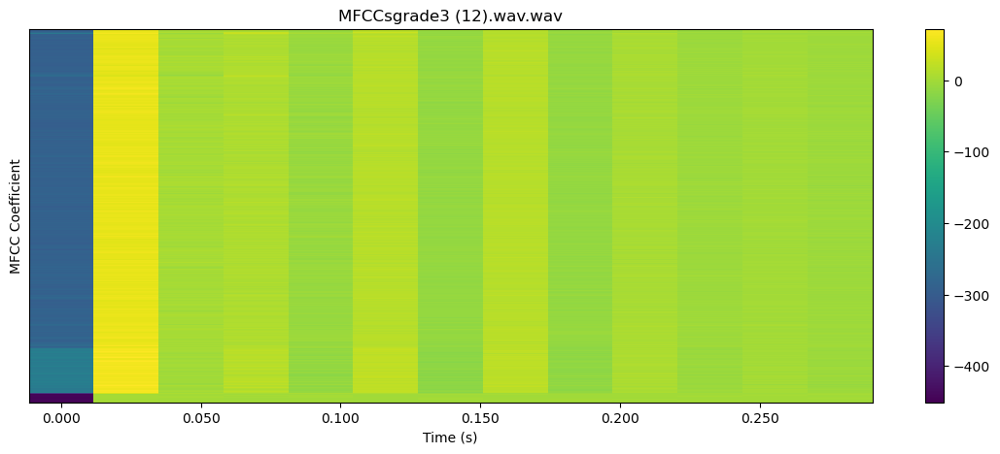


 71%|███████   | 100/141 [02:39<01:01,  1.50s/it]

22050


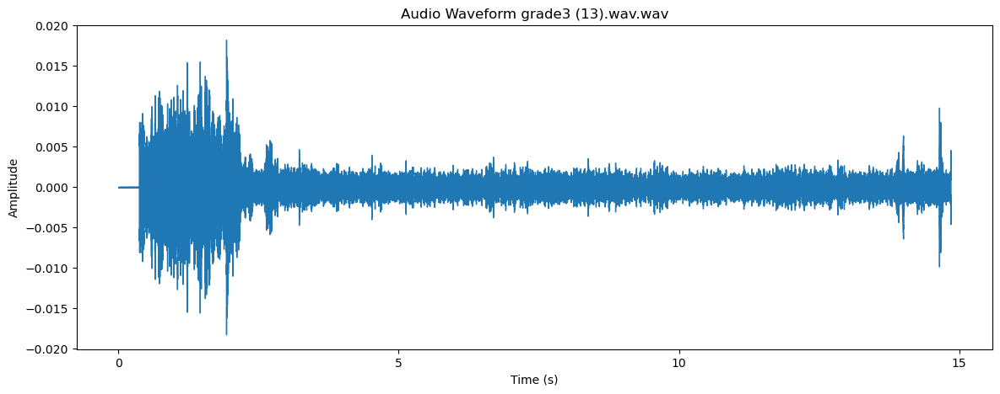

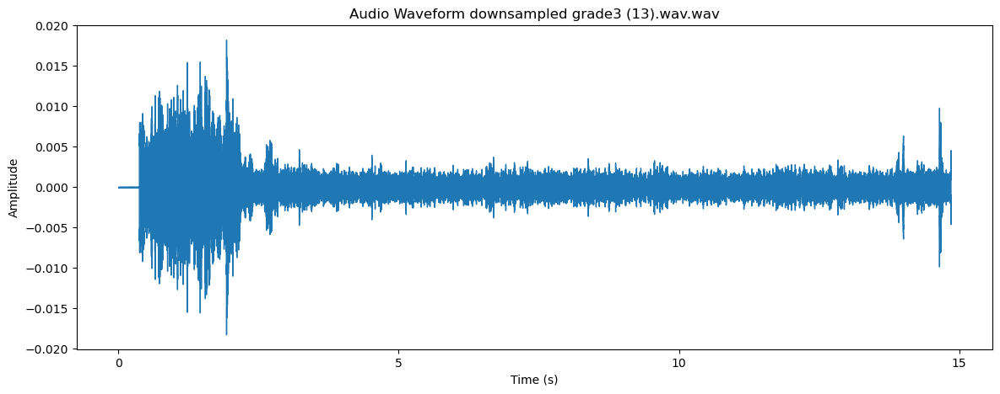

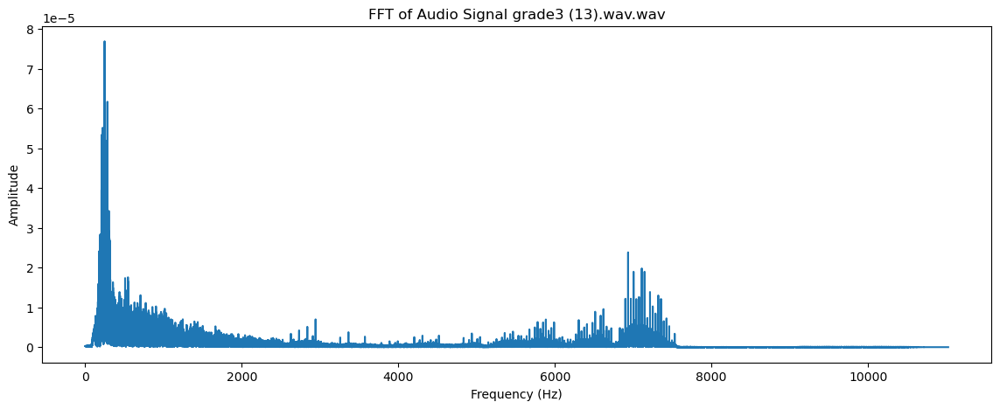

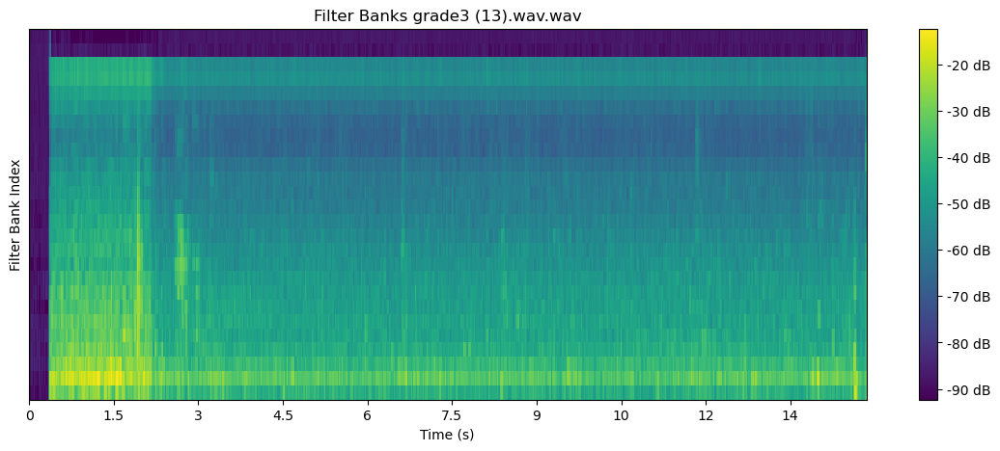

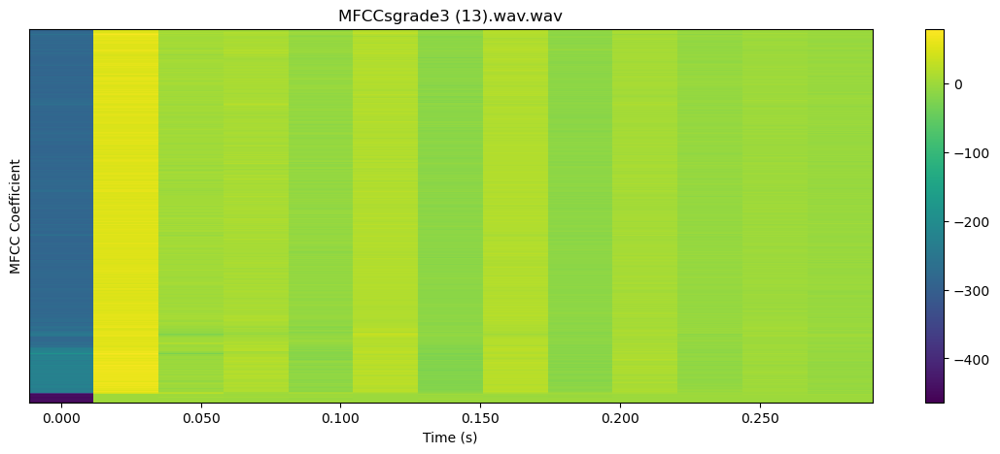


 72%|███████▏  | 101/141 [02:41<00:59,  1.50s/it]

22050


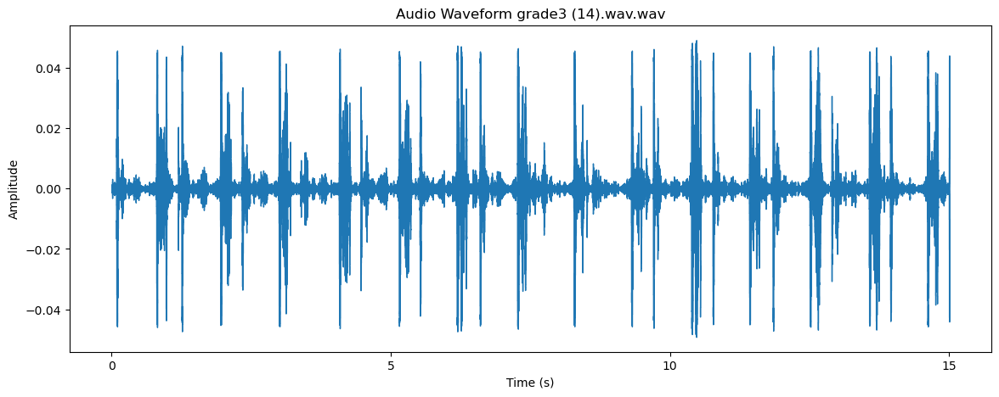

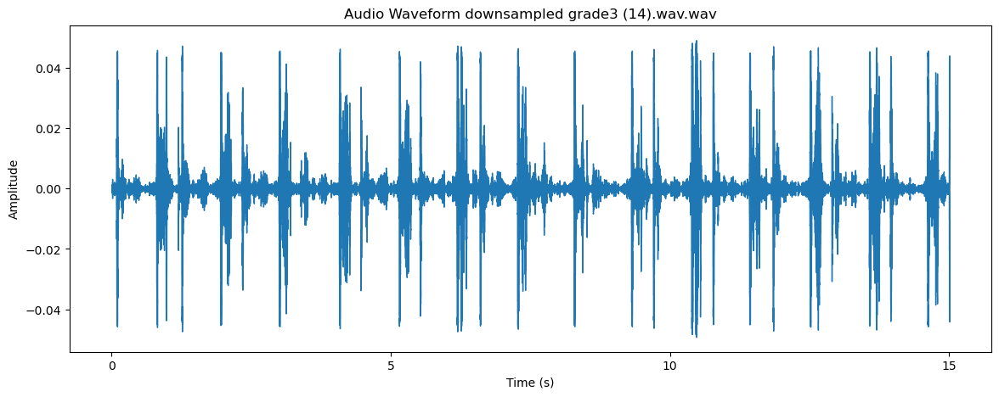

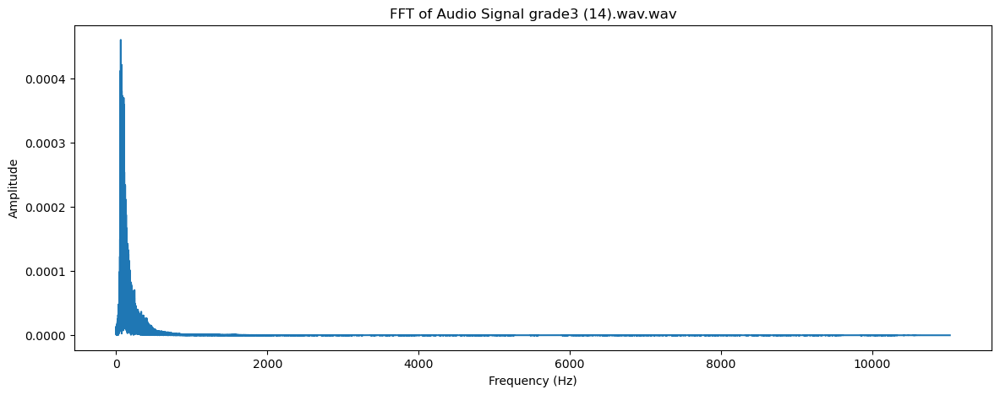

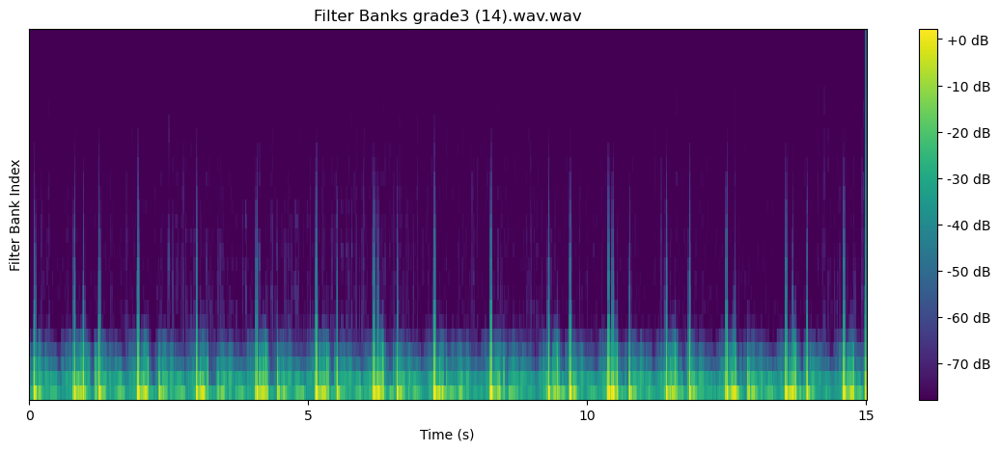

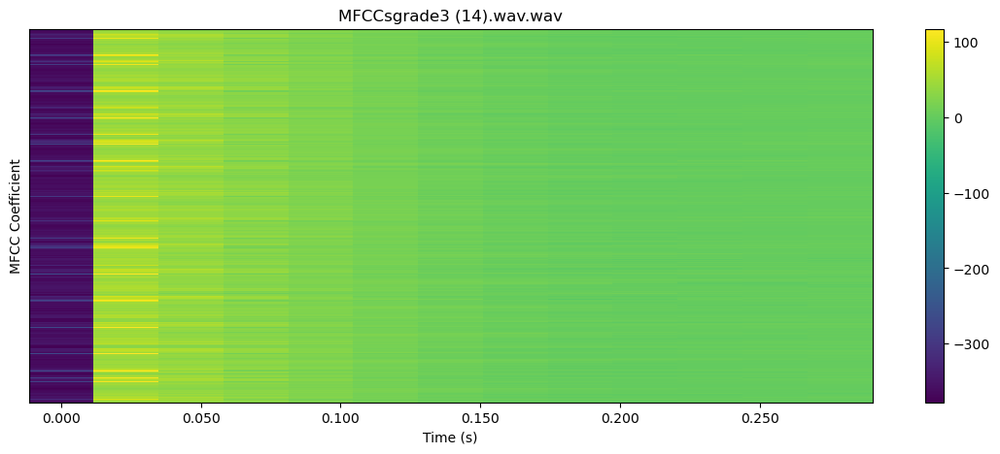


 72%|███████▏  | 102/141 [02:42<00:57,  1.47s/it]

22050


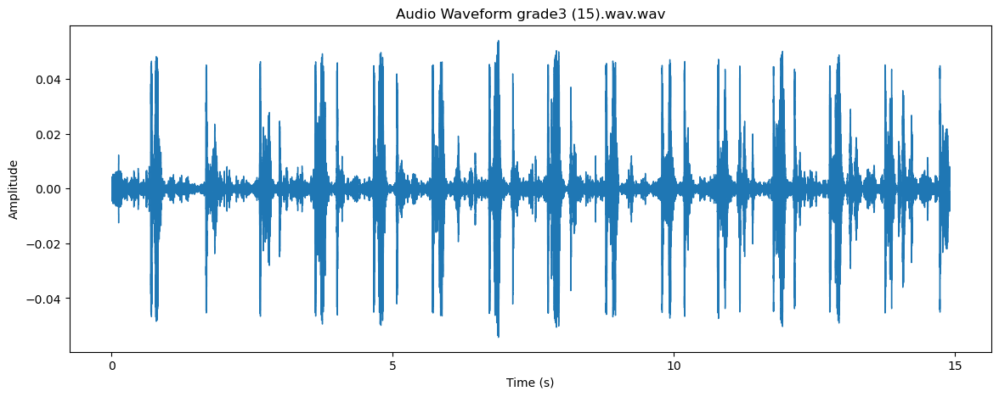

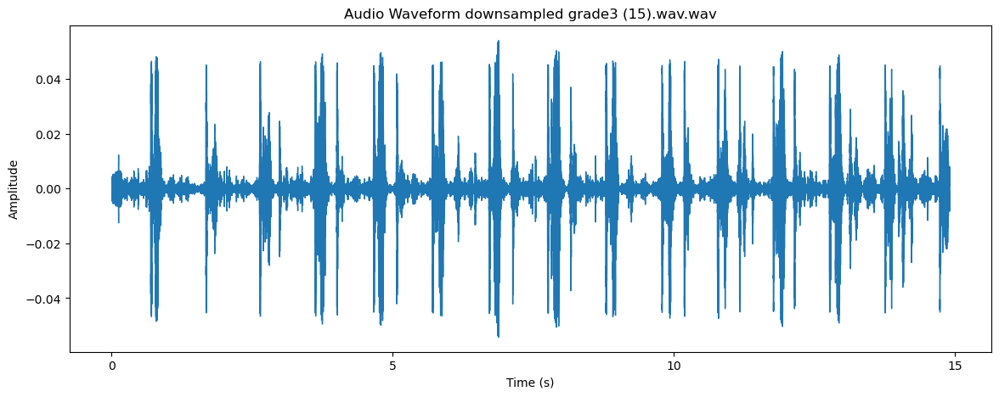

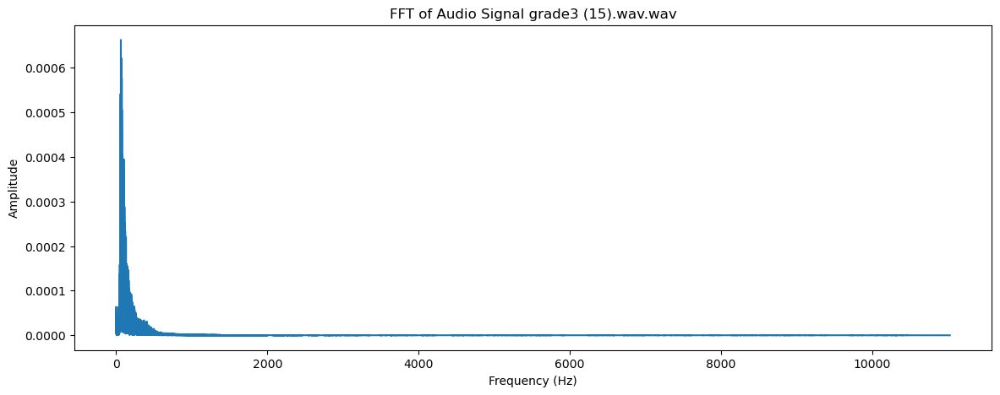

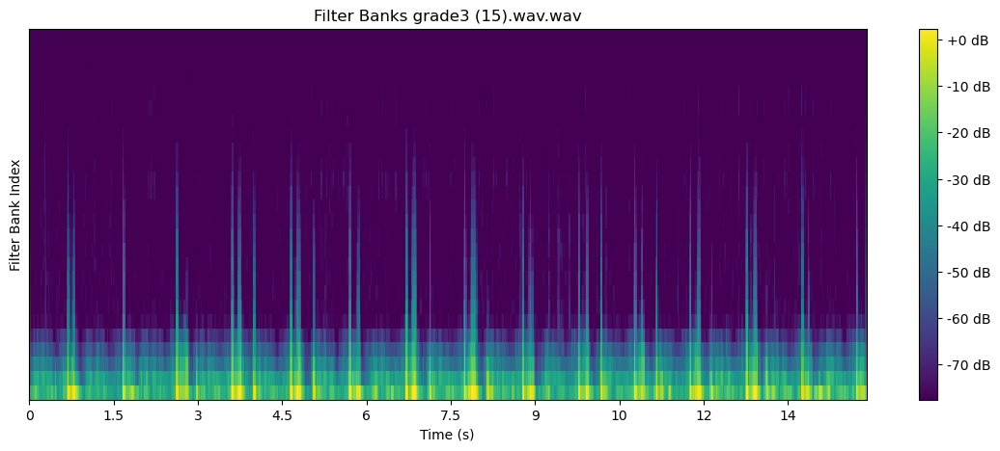

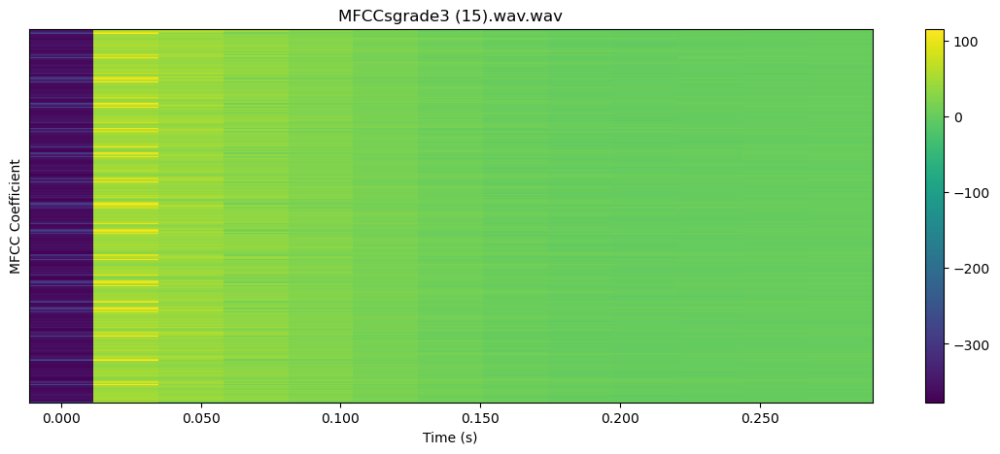


 73%|███████▎  | 103/141 [02:43<00:55,  1.45s/it]

22050


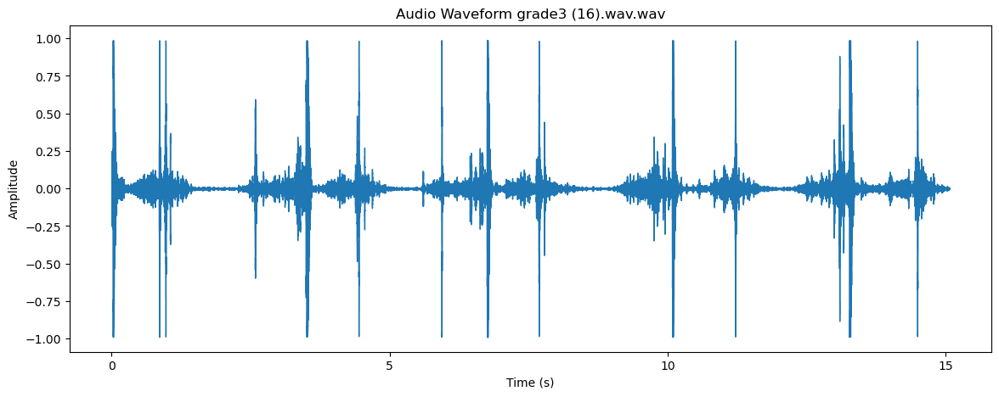

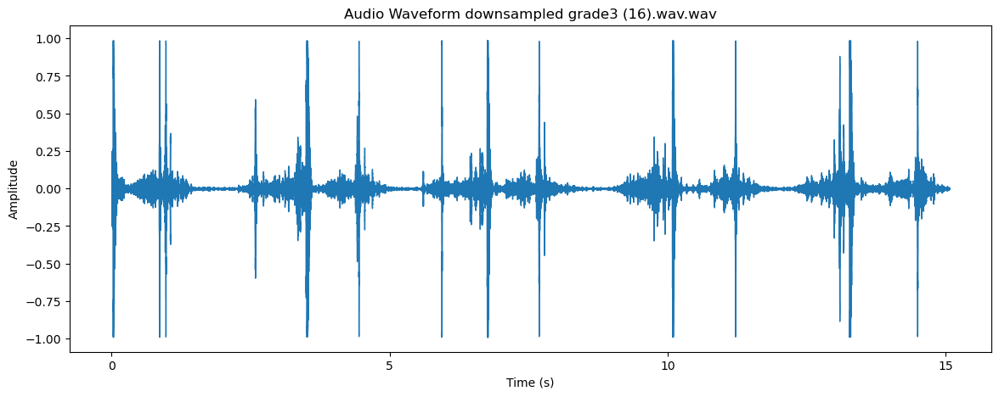

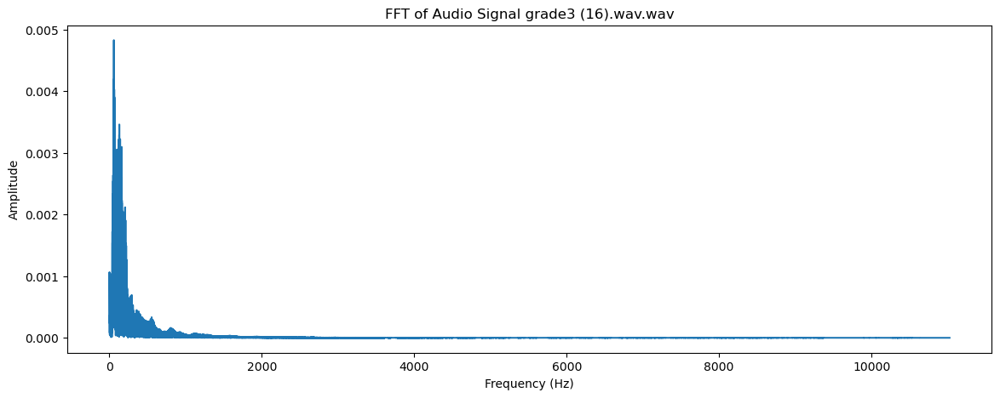

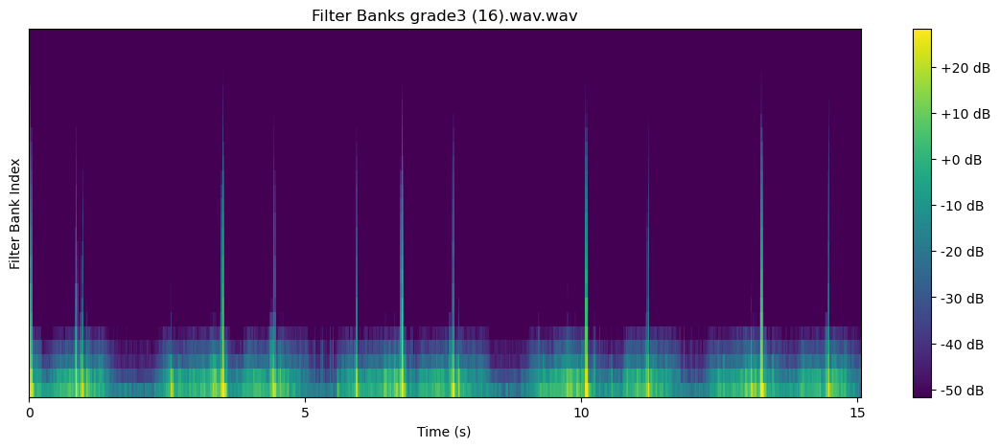

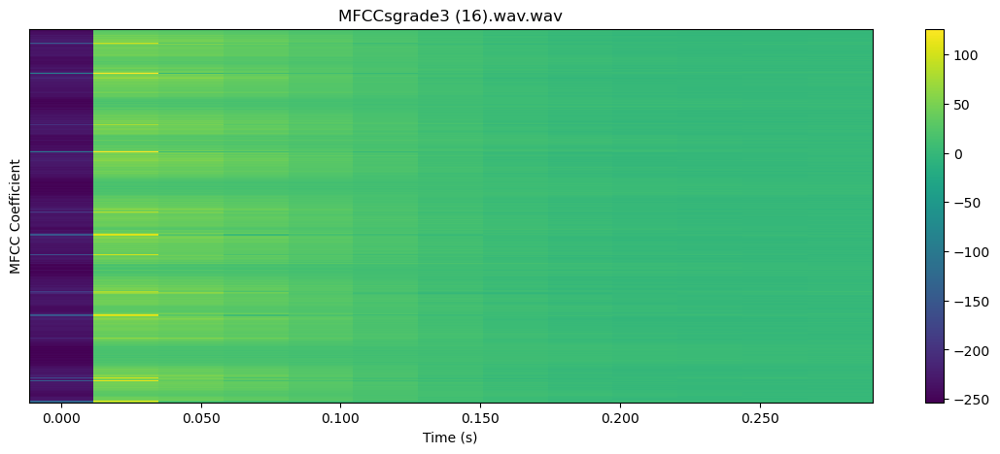


 74%|███████▍  | 104/141 [02:45<00:52,  1.43s/it]

22050


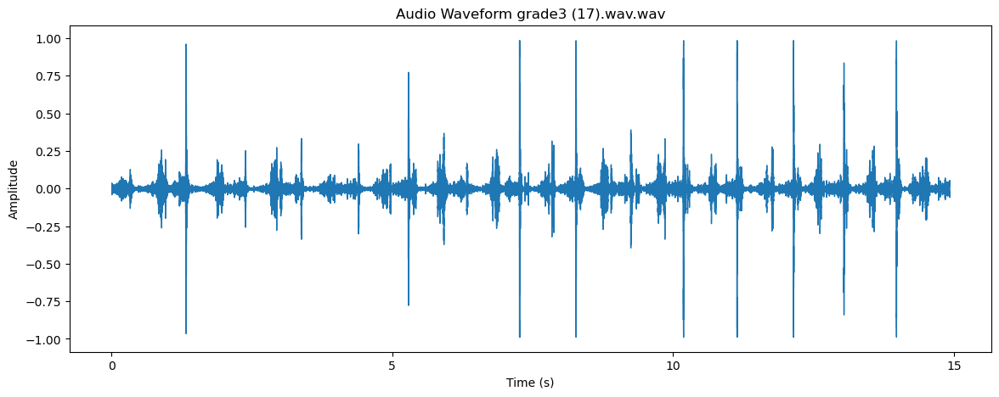

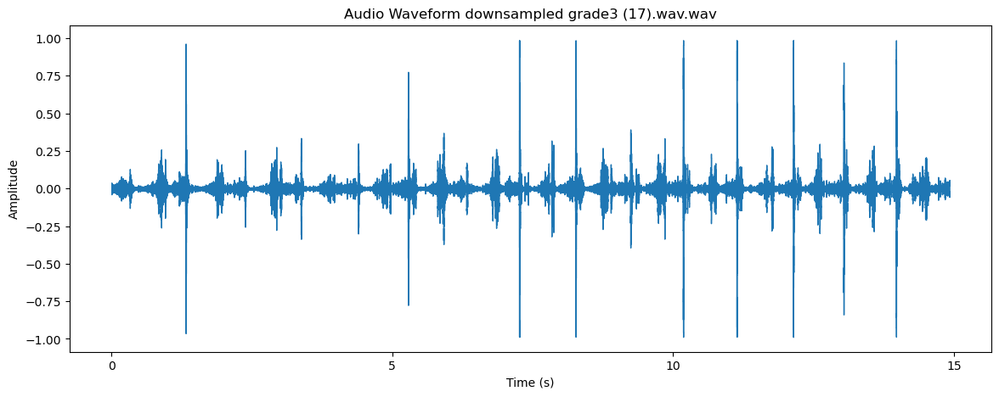

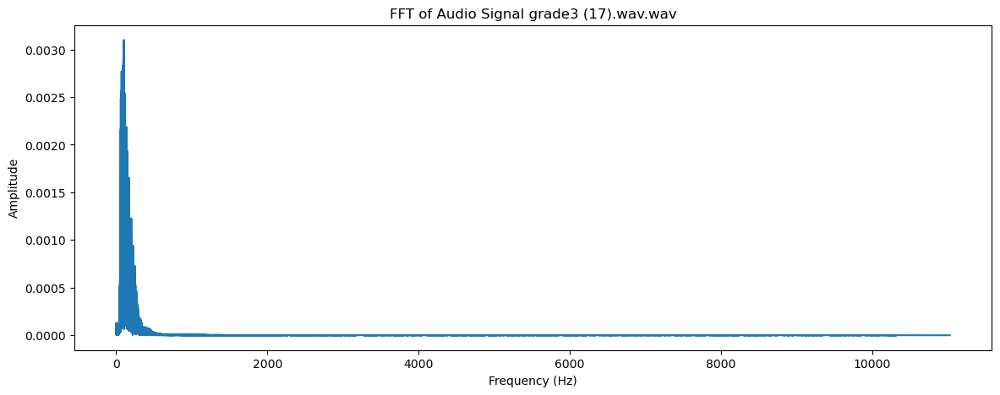

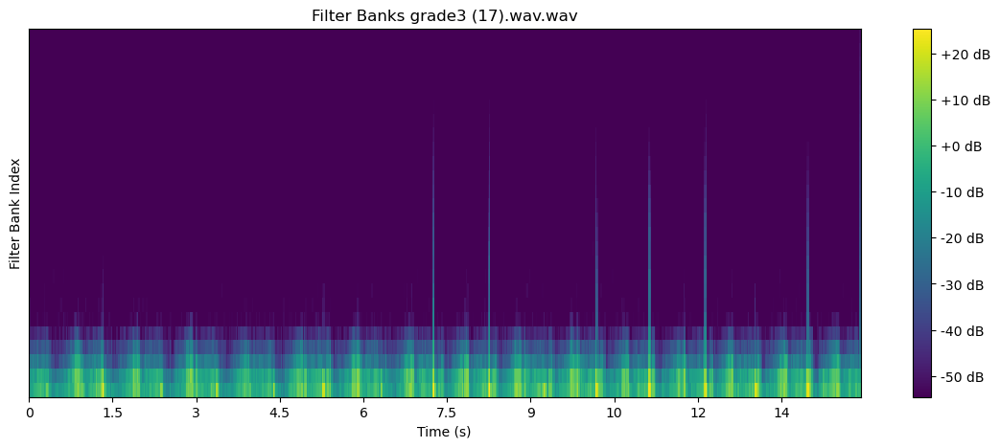

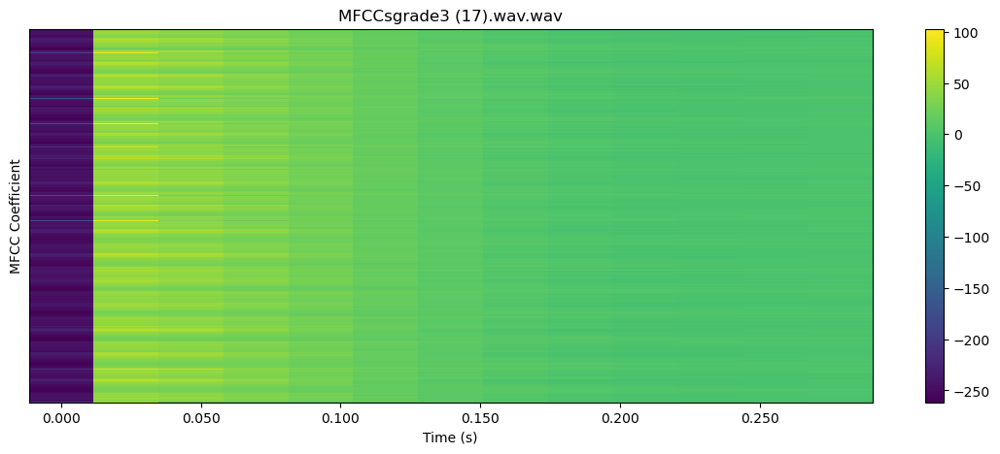


 74%|███████▍  | 105/141 [02:47<00:56,  1.58s/it]

22050


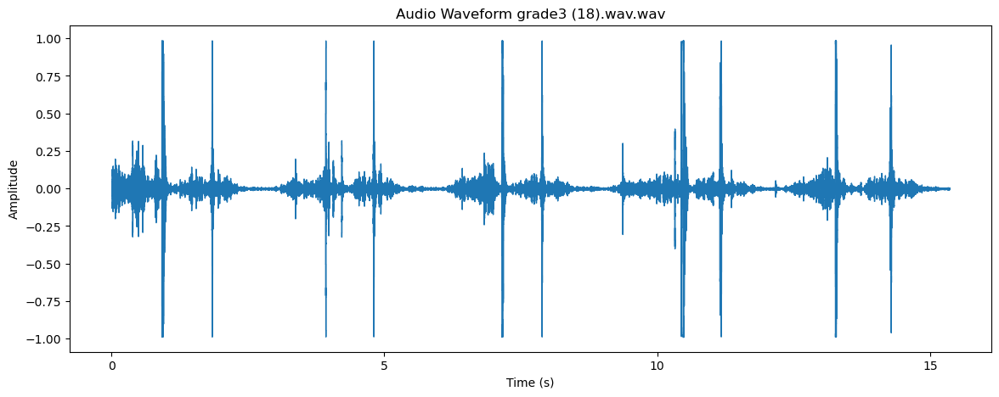

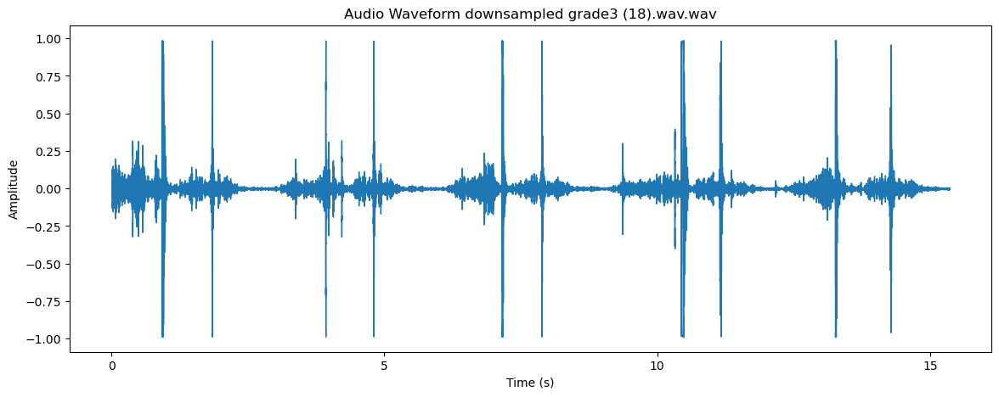

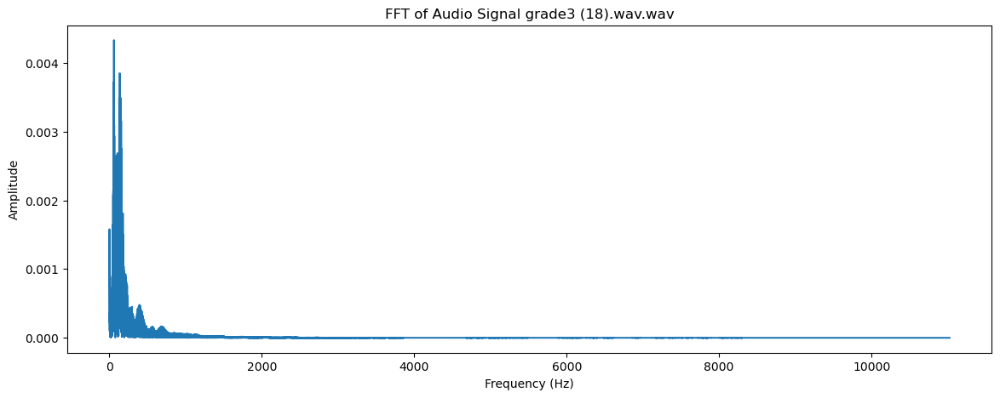

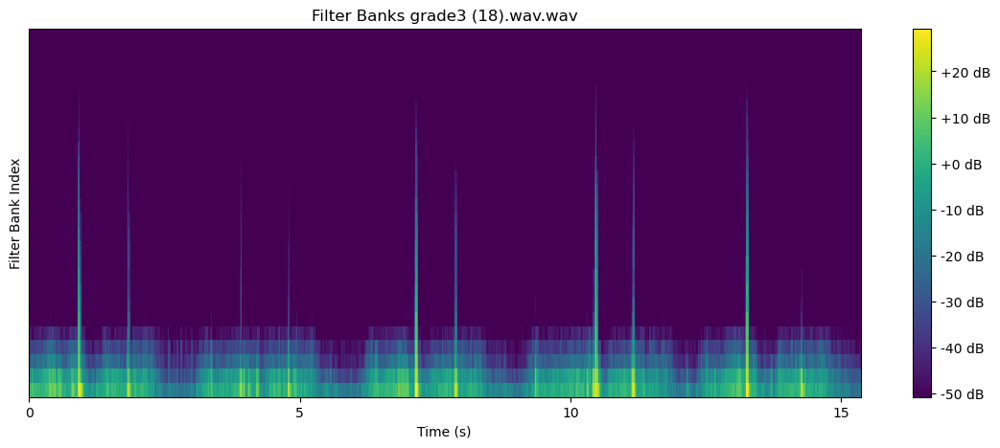

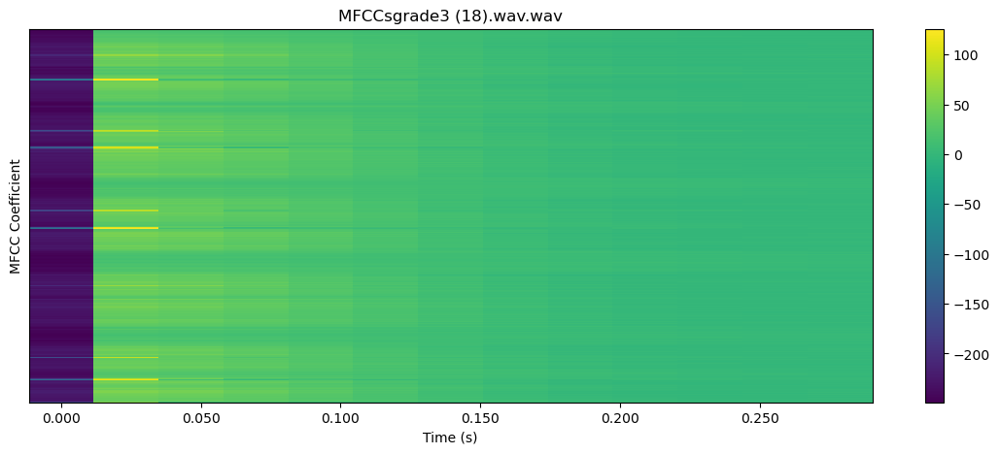


 75%|███████▌  | 106/141 [02:48<00:54,  1.55s/it]

22050


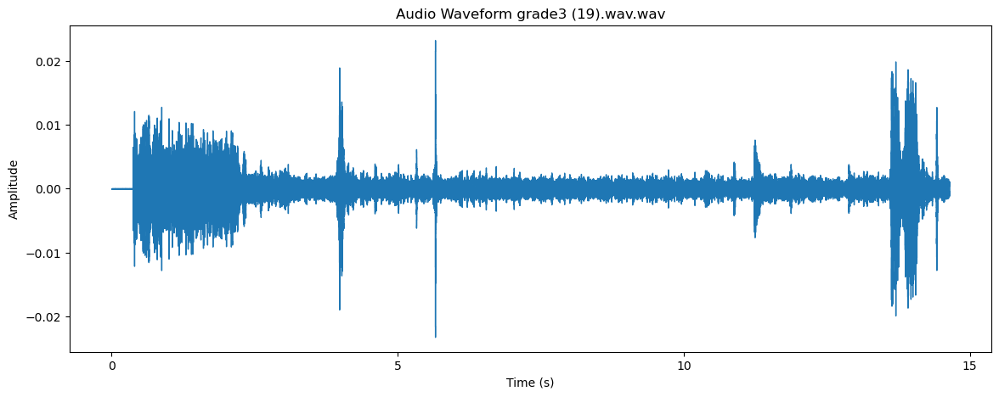

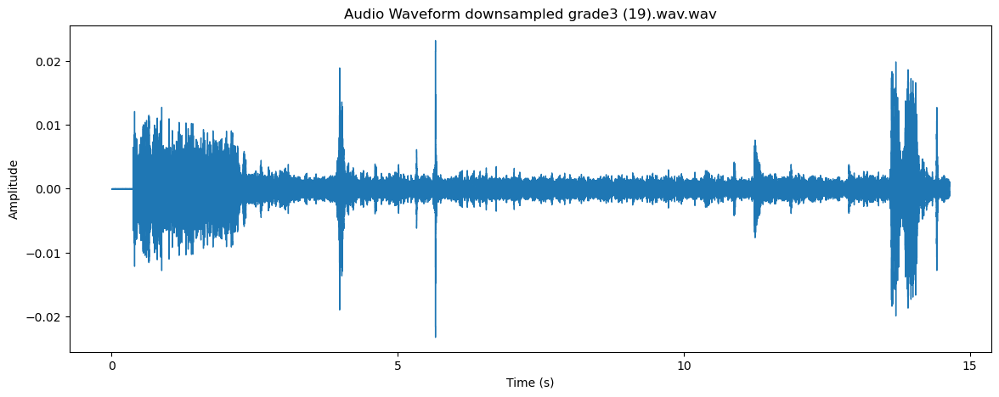

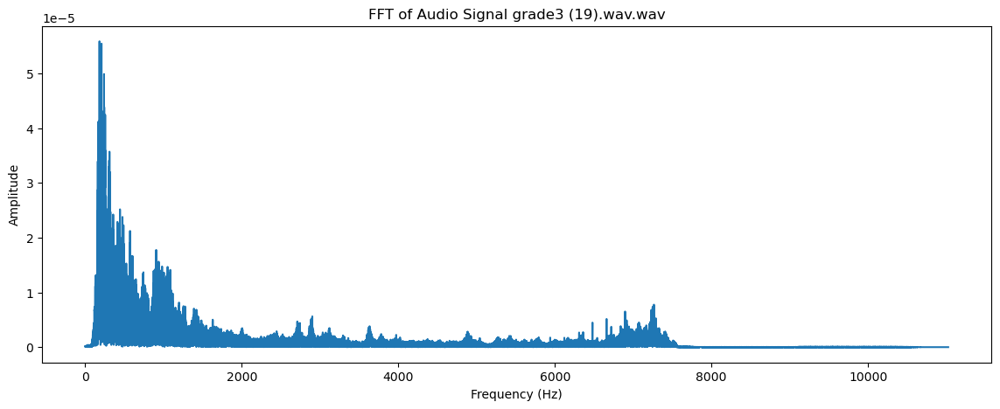

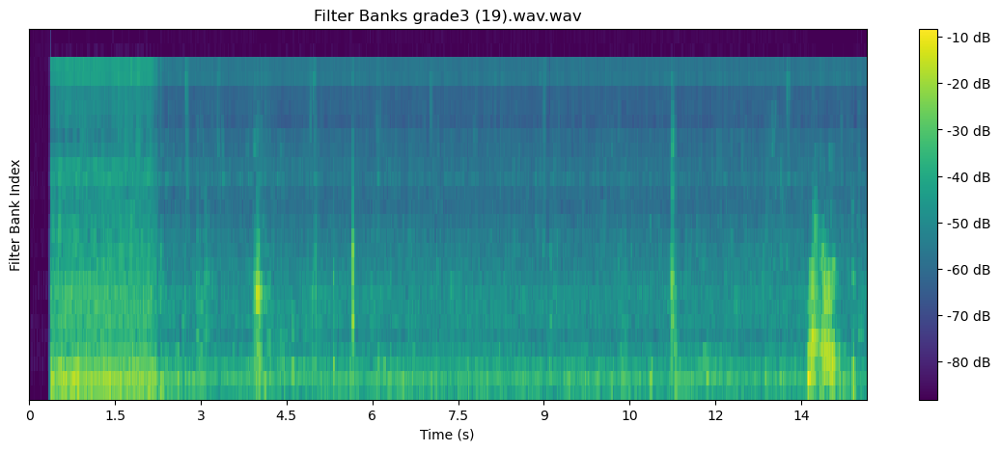

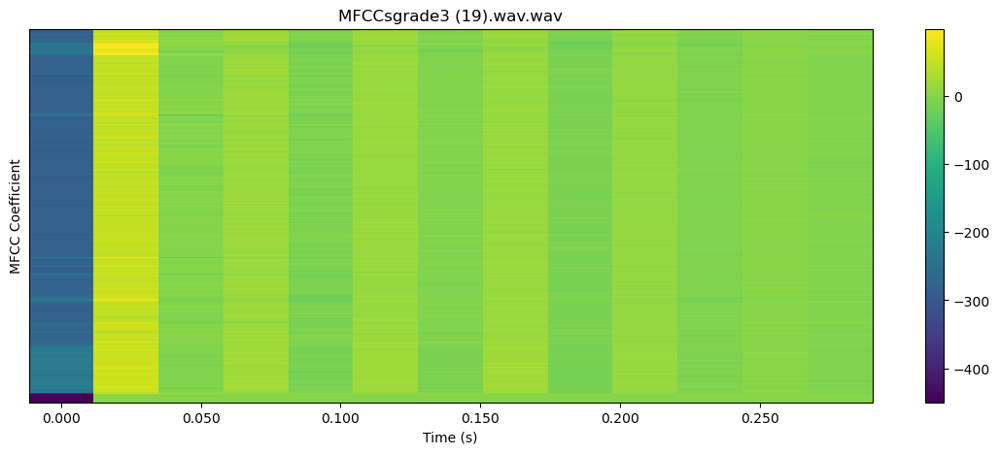


 76%|███████▌  | 107/141 [02:50<00:56,  1.66s/it]

22050


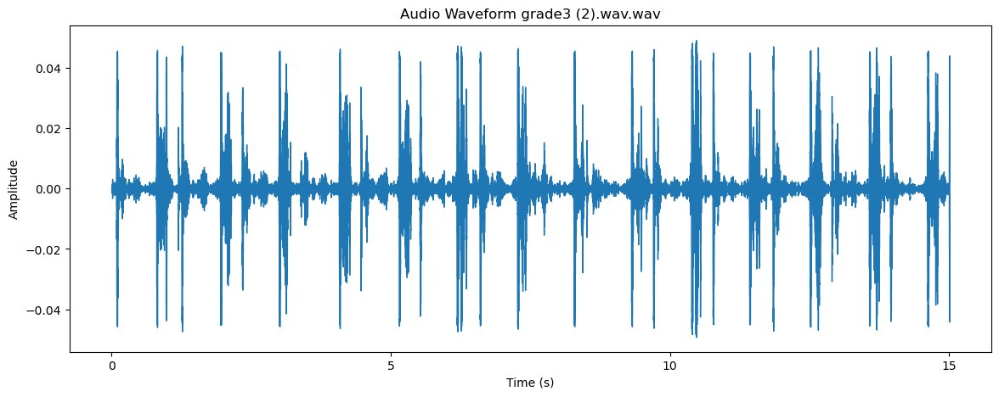

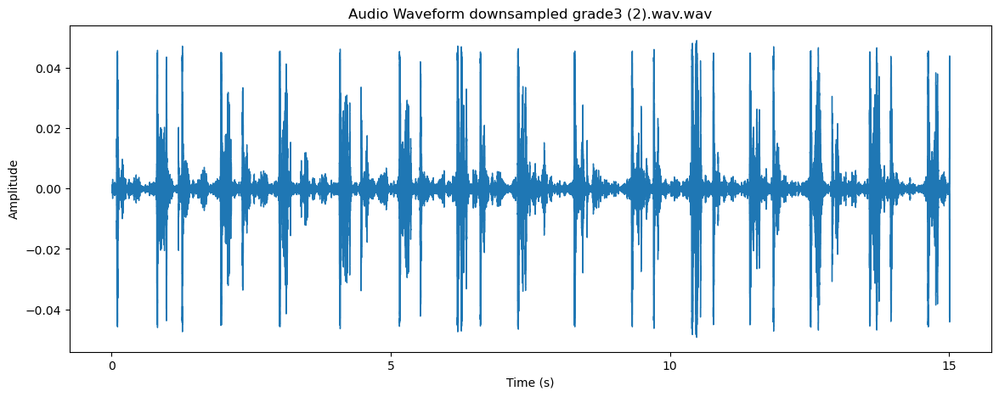

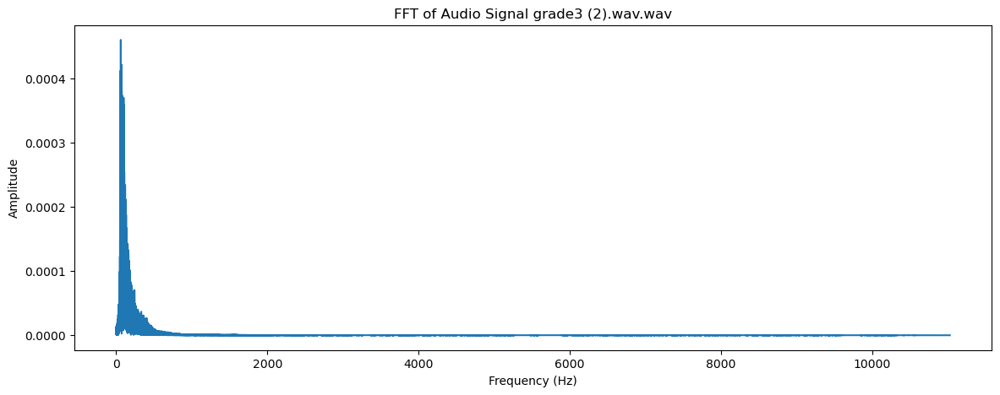

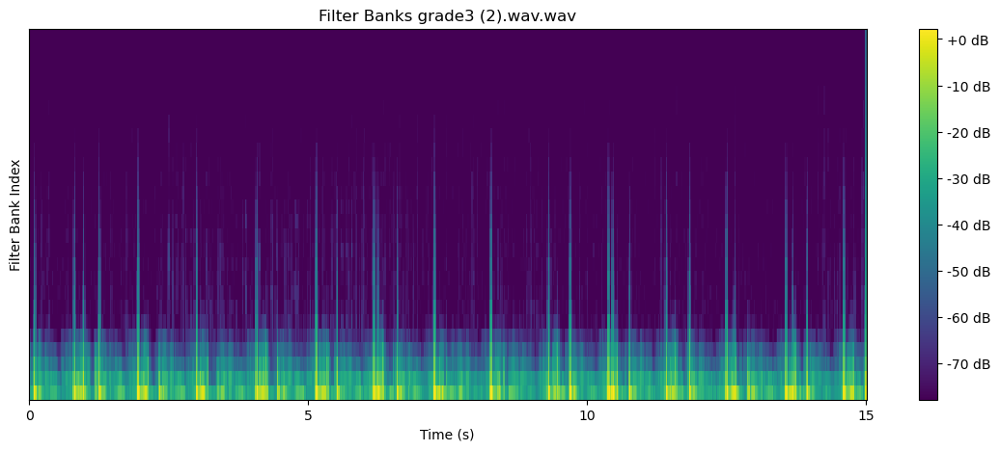

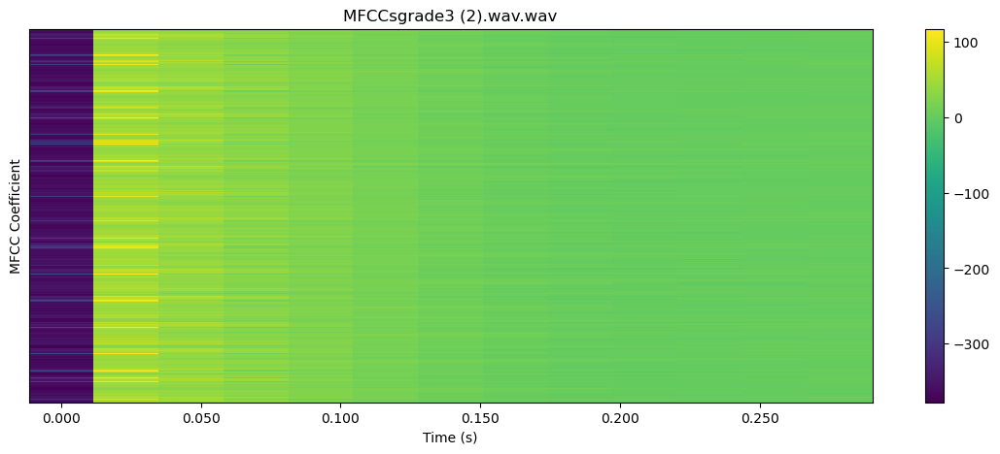


 77%|███████▋  | 108/141 [02:52<00:56,  1.72s/it]

22050


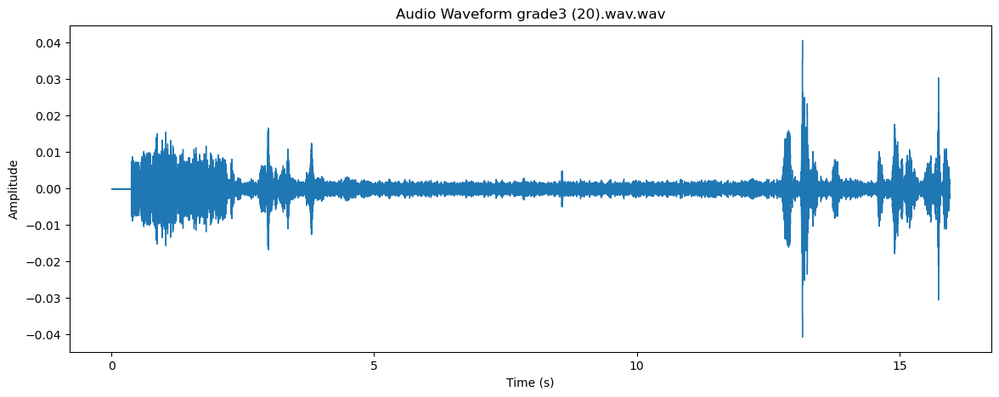

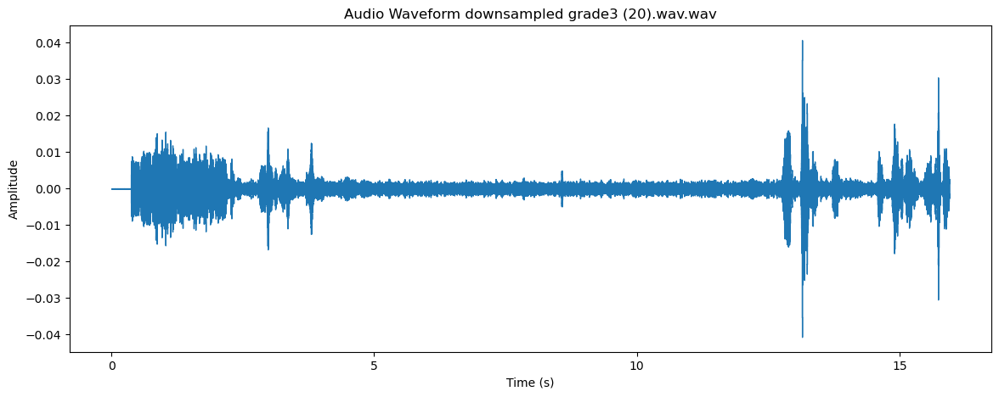

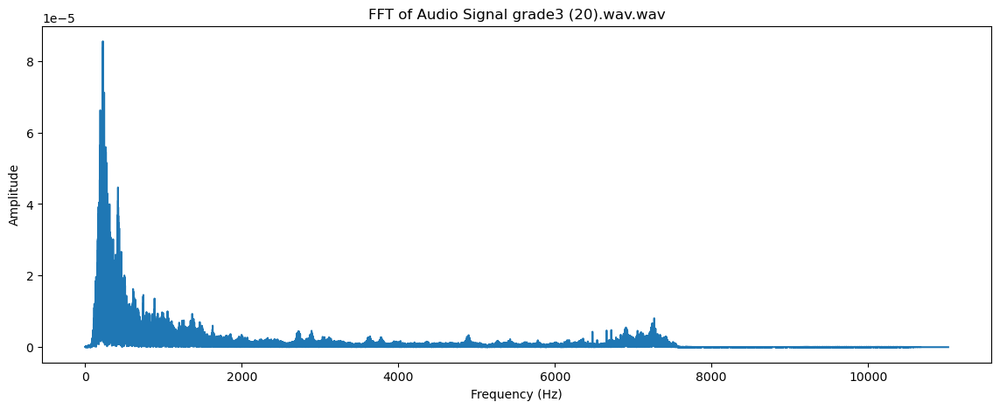

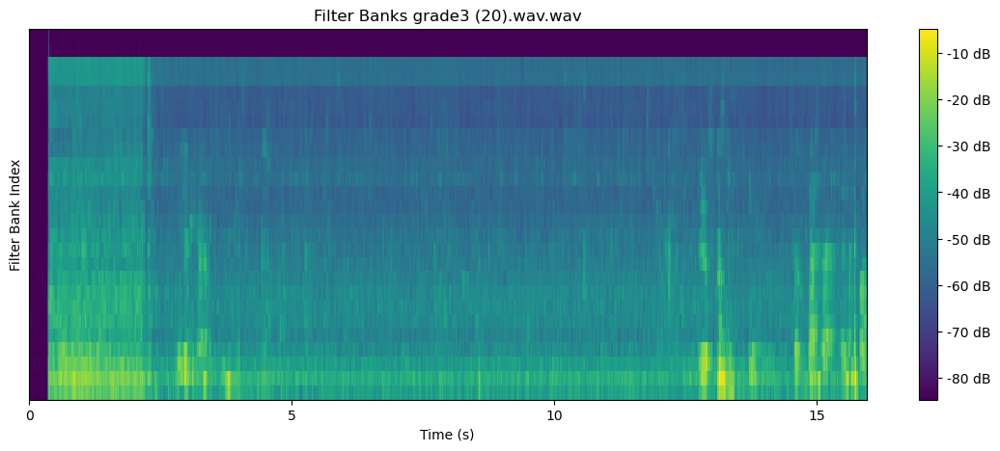

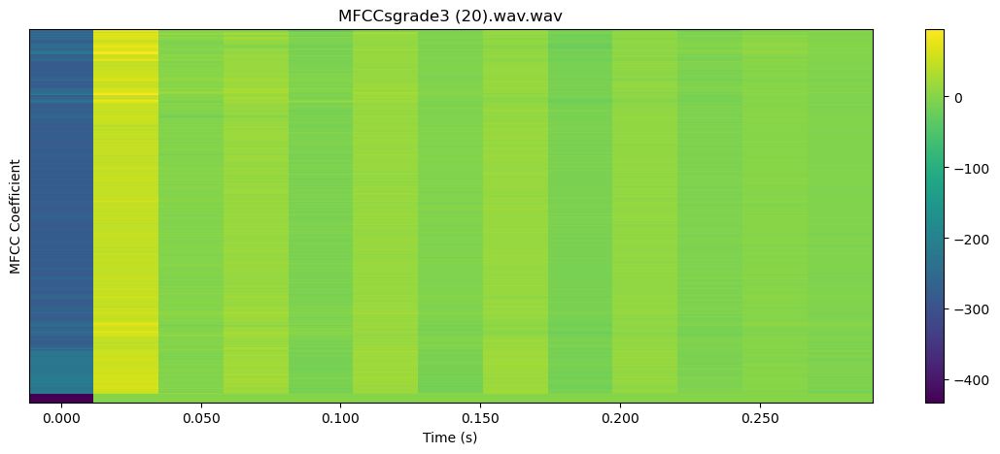


 77%|███████▋  | 109/141 [02:53<00:52,  1.64s/it]

22050


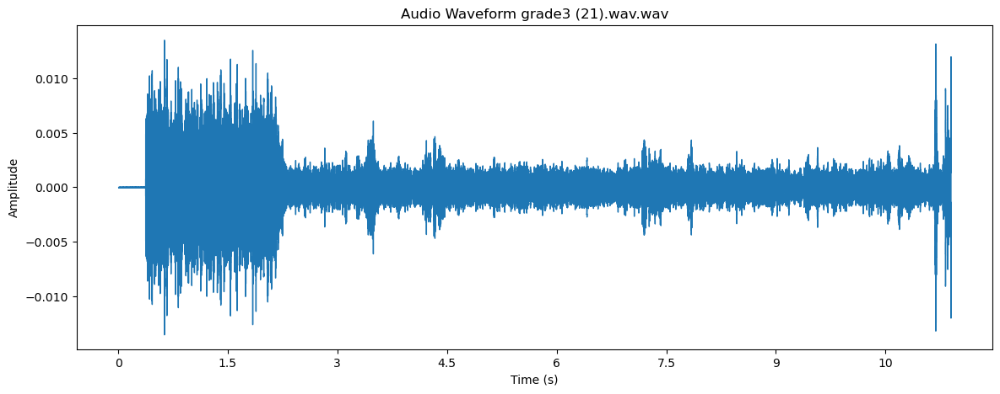

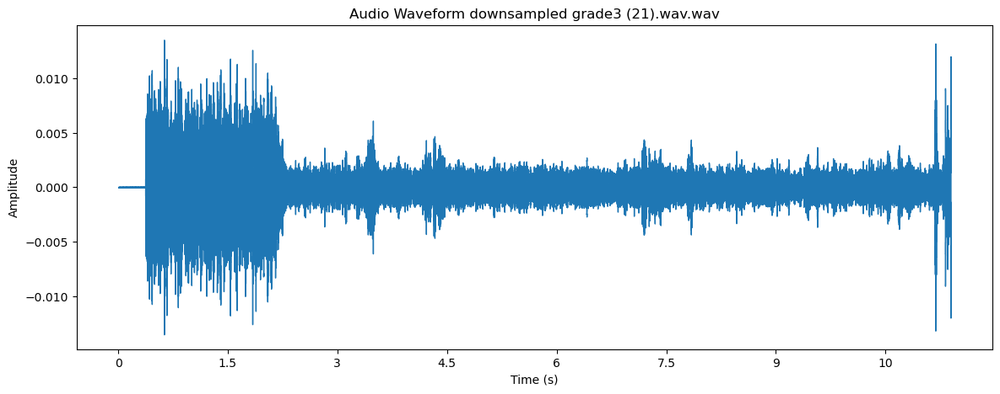

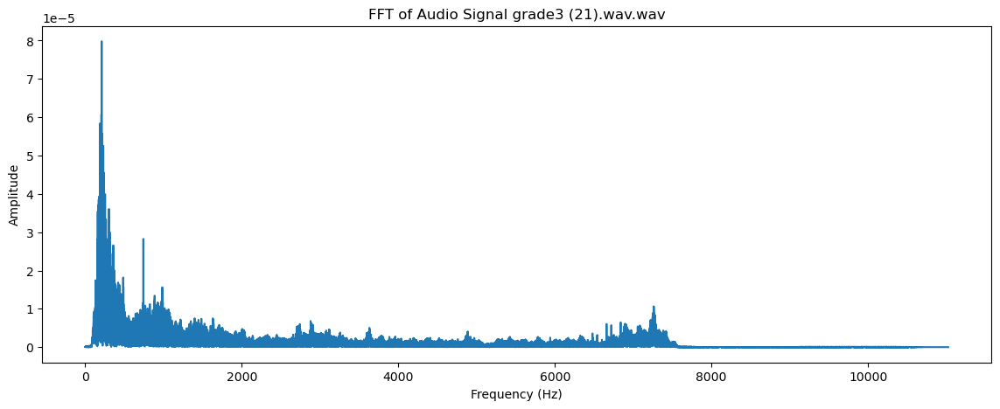

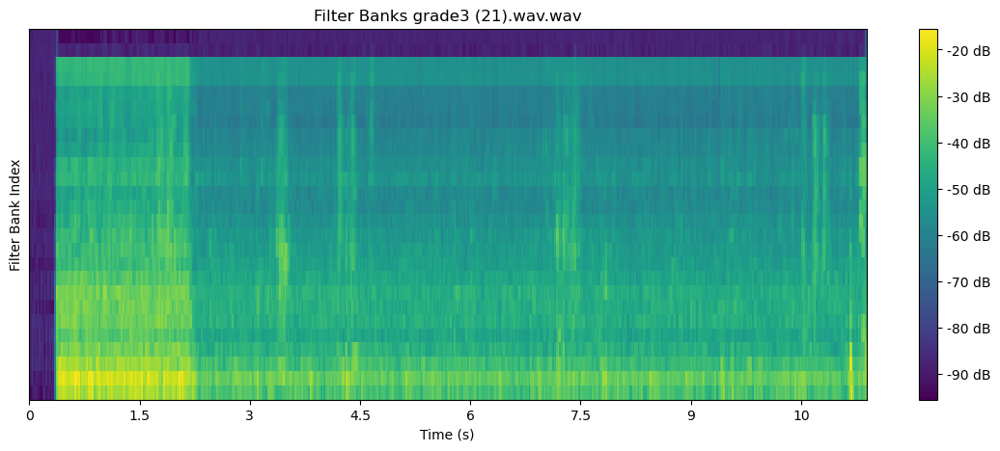

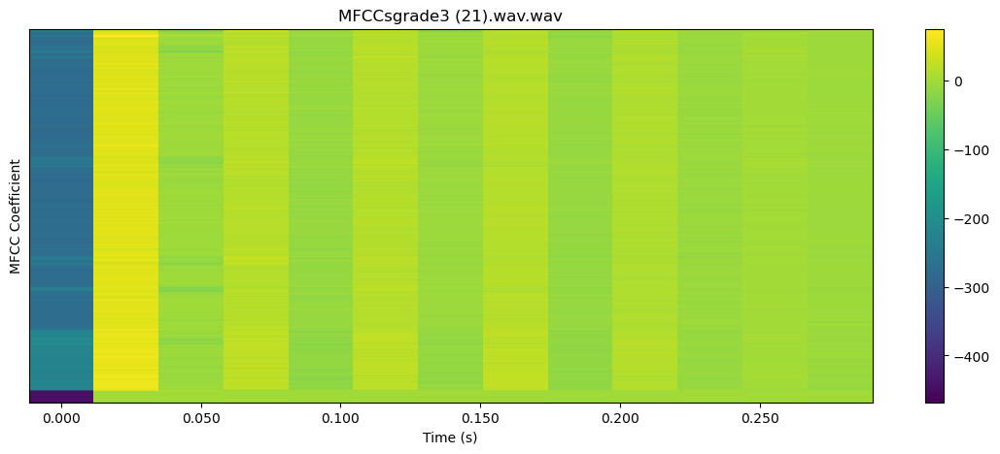


 78%|███████▊  | 110/141 [02:55<00:48,  1.57s/it]

22050


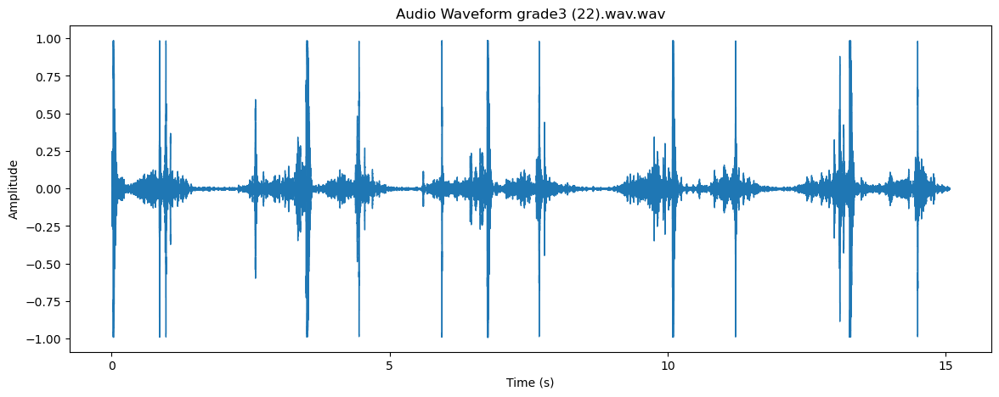

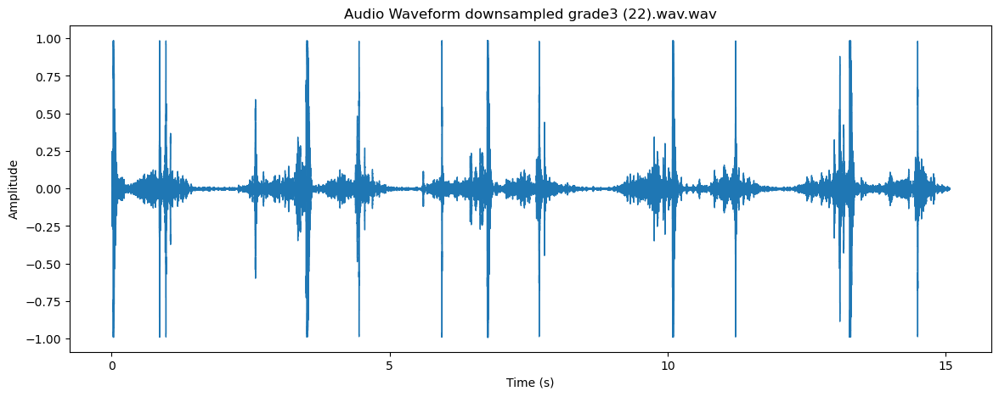

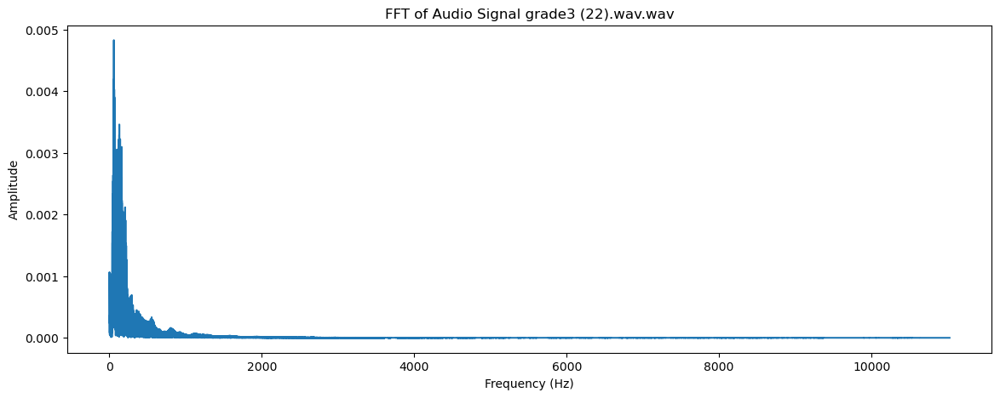

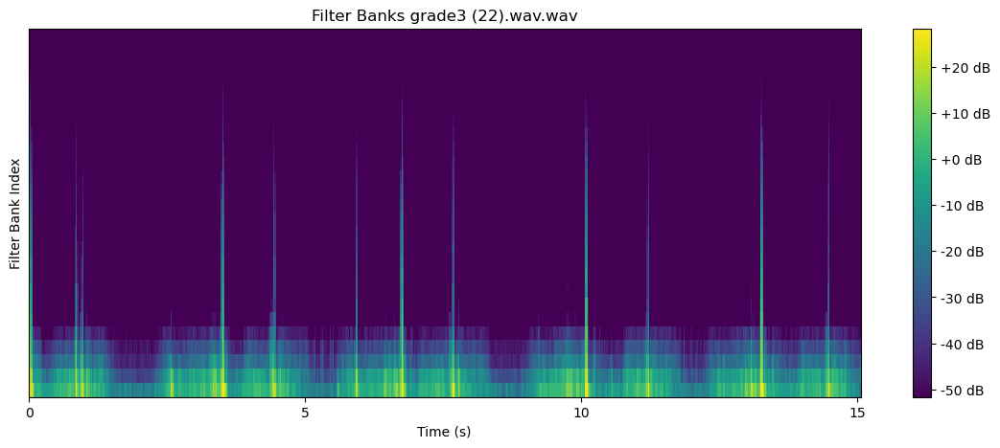

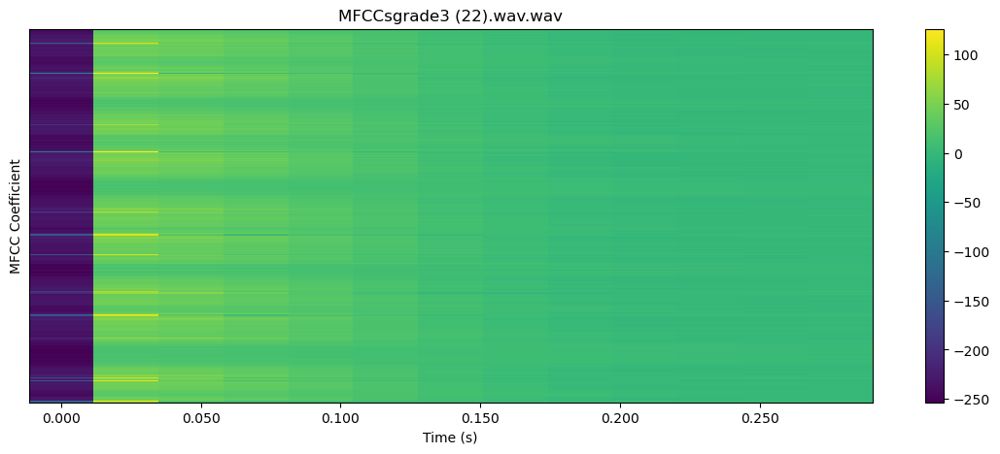


 79%|███████▊  | 111/141 [02:56<00:45,  1.51s/it]

22050


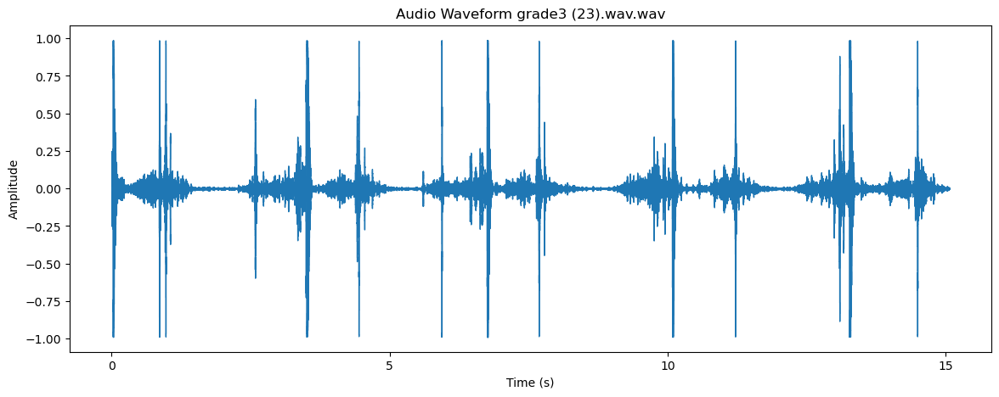

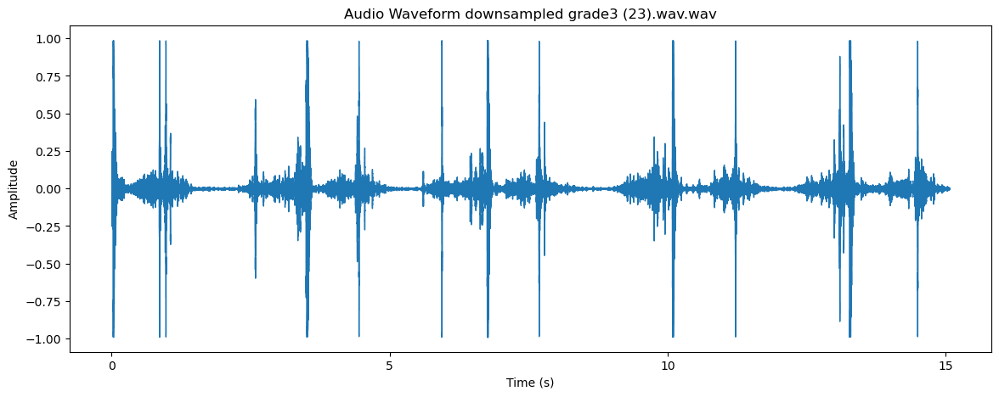

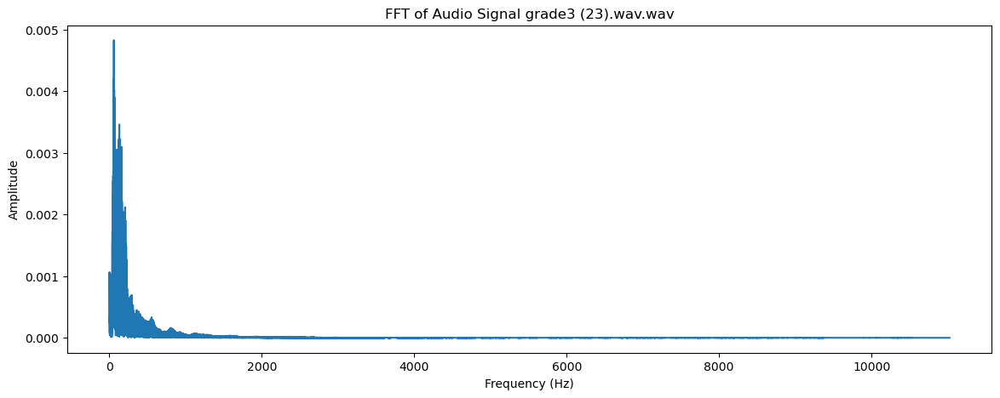

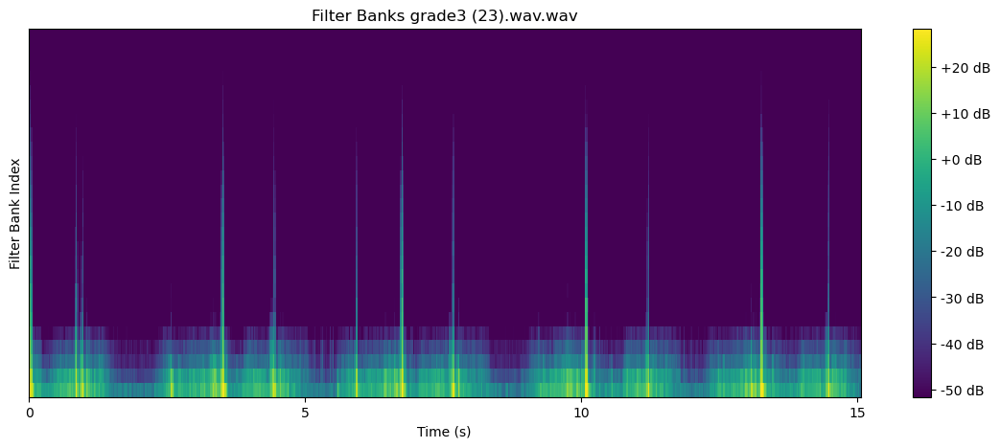

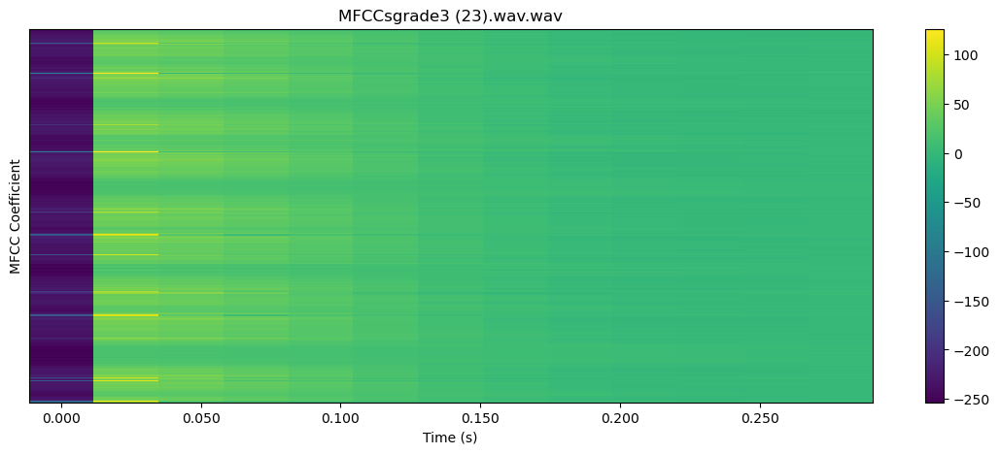


 79%|███████▉  | 112/141 [02:58<00:42,  1.48s/it]

22050


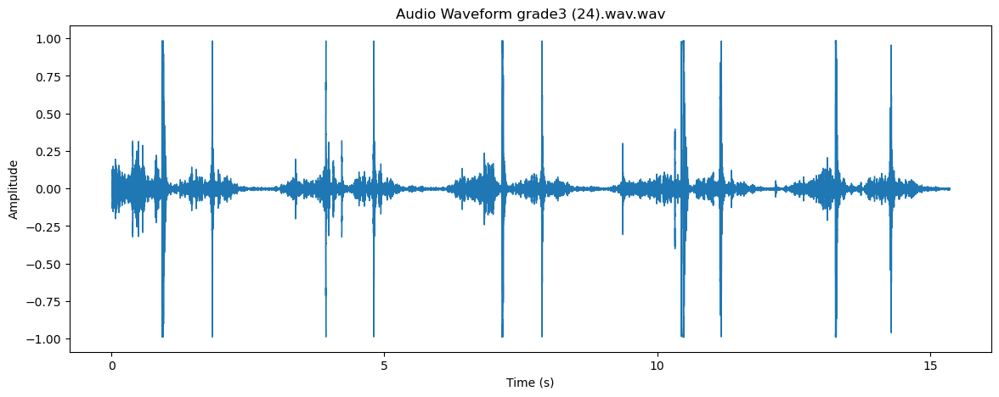

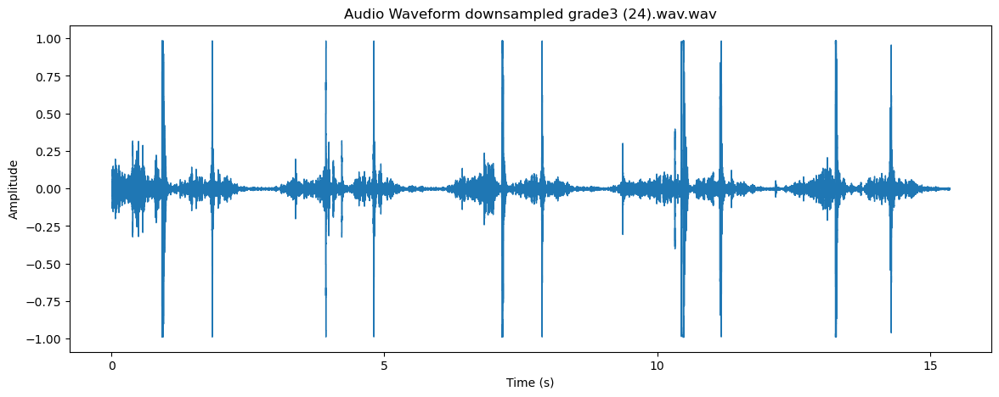

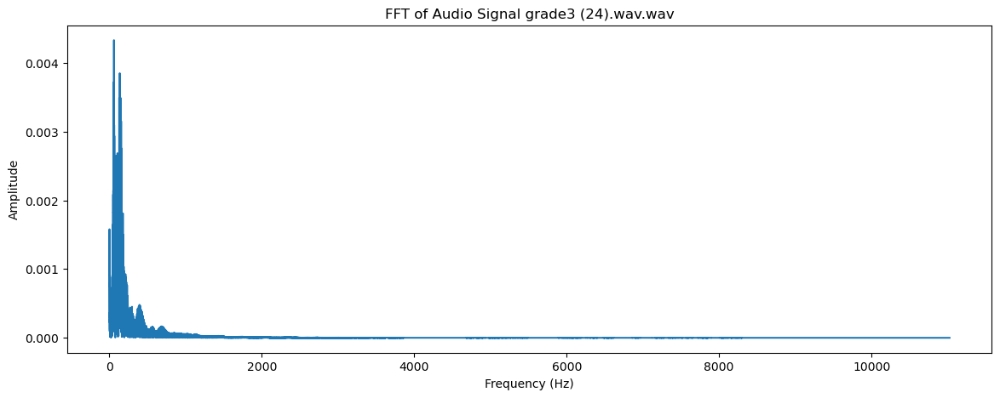

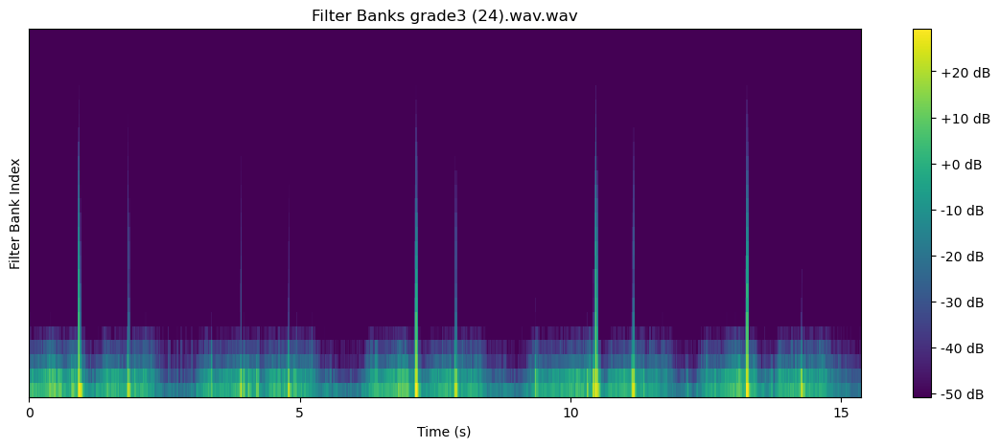

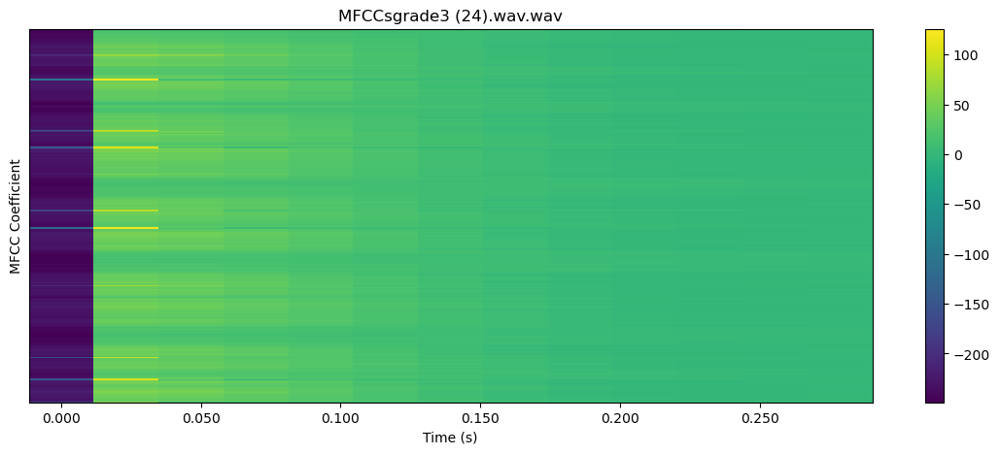


 80%|████████  | 113/141 [02:59<00:40,  1.46s/it]

22050


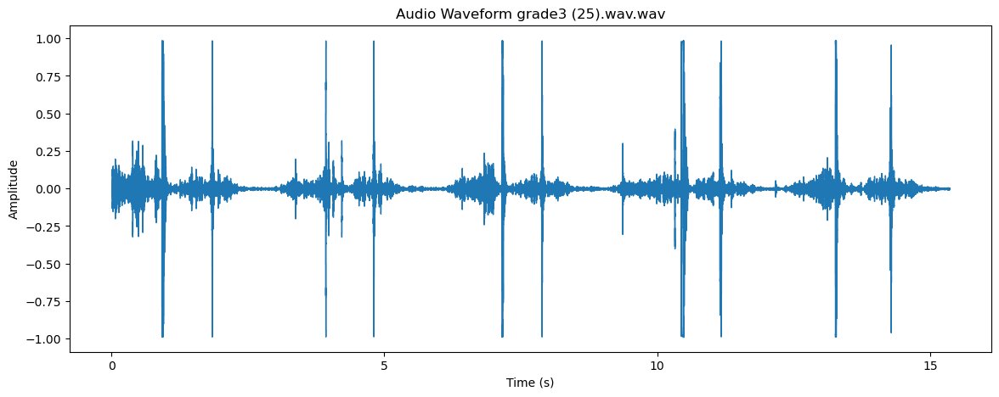

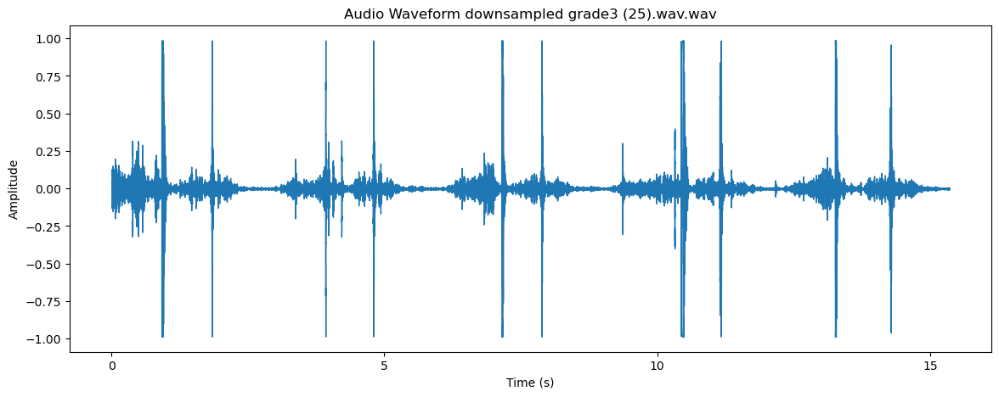

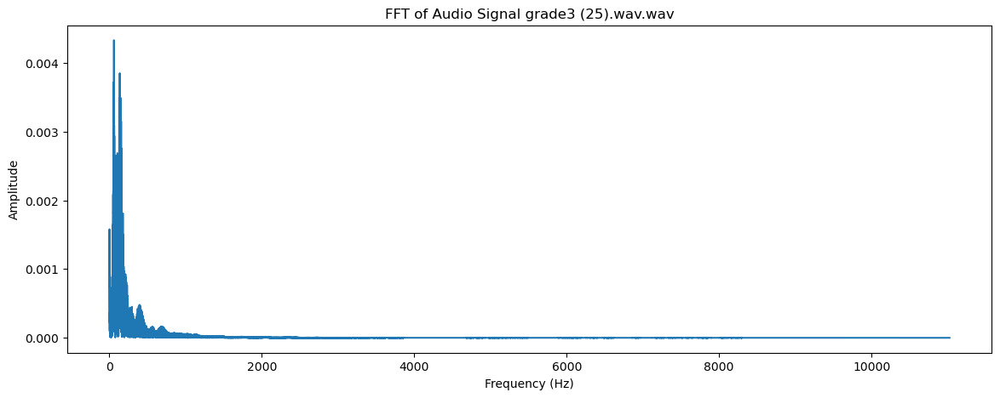

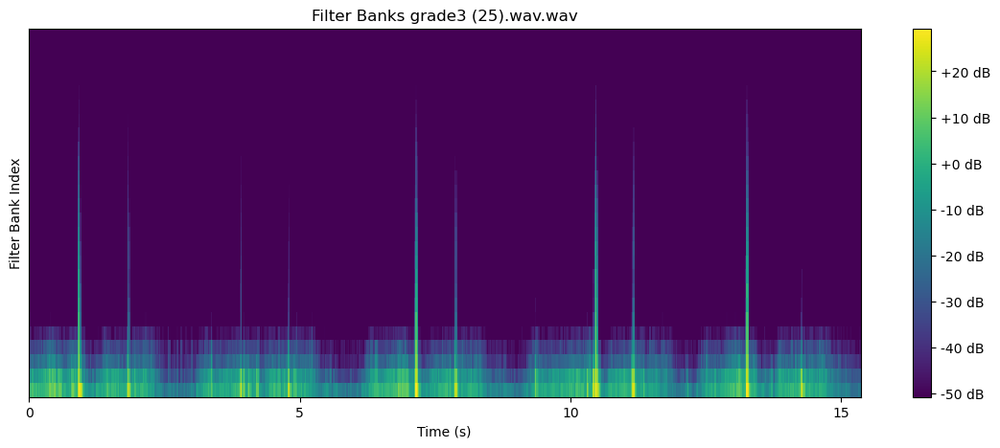

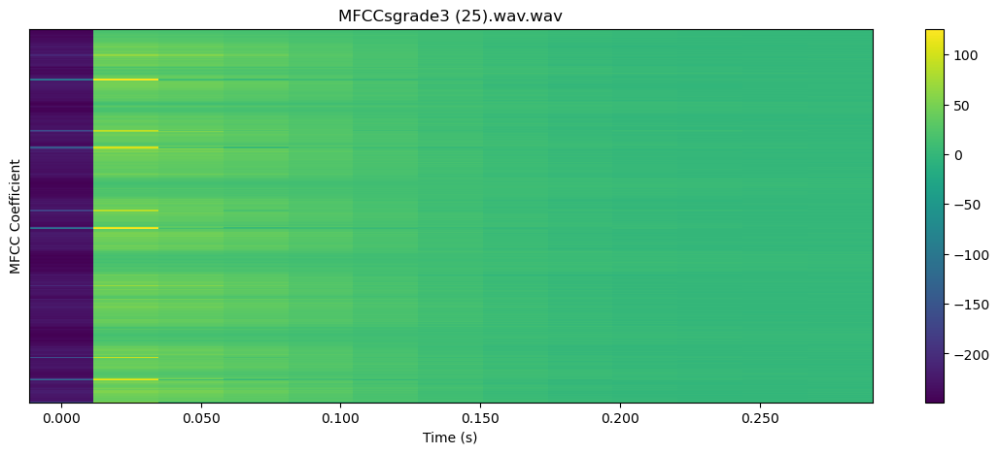


 81%|████████  | 114/141 [03:00<00:39,  1.45s/it]

22050


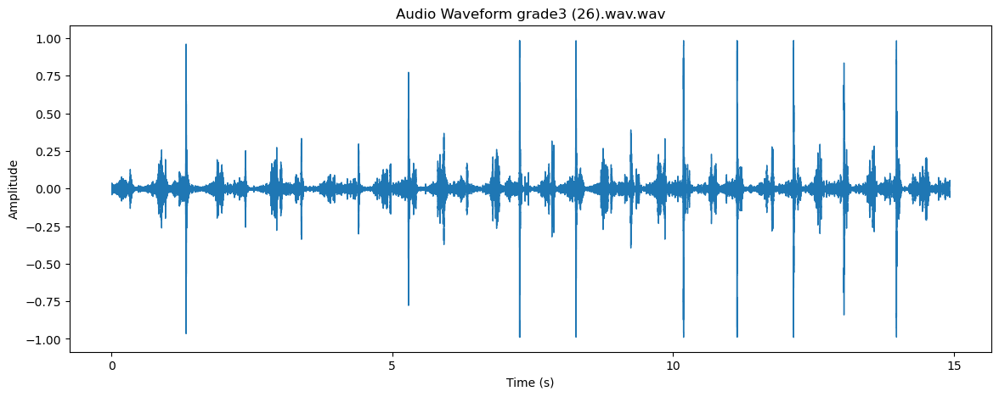

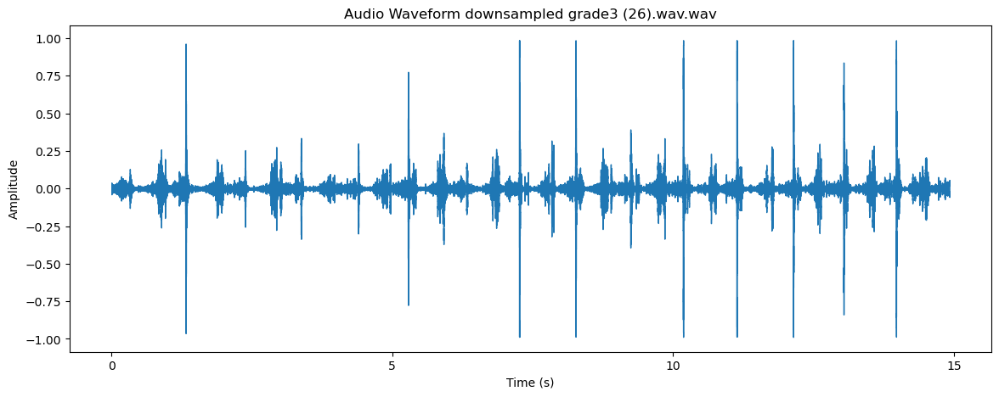

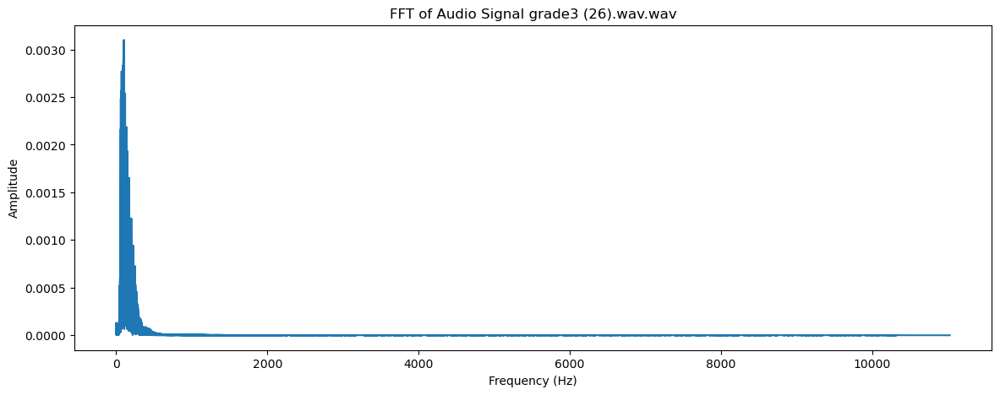

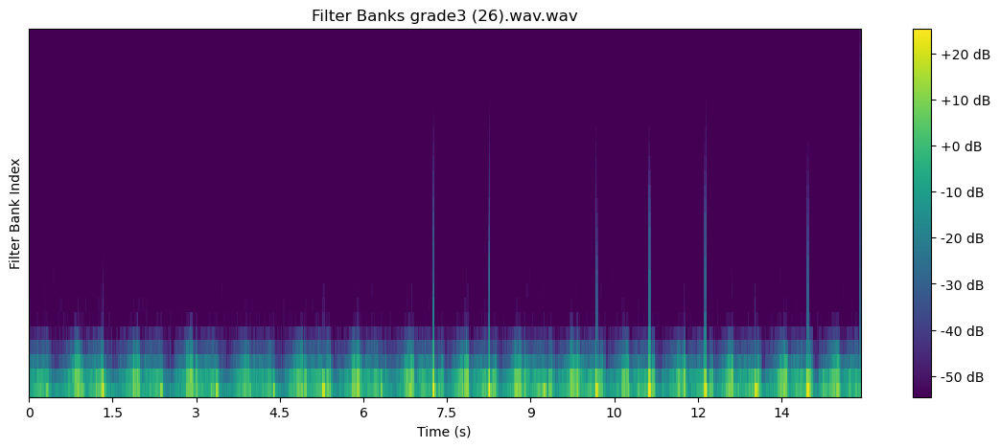

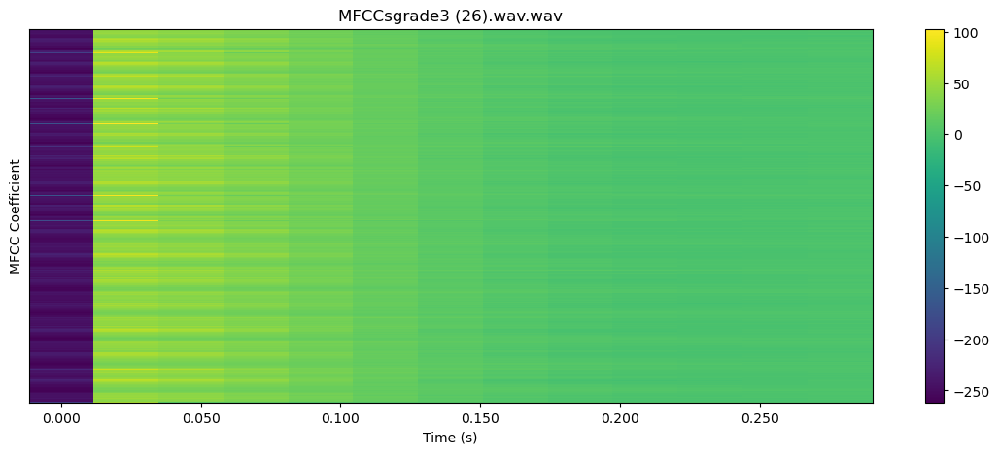


 82%|████████▏ | 115/141 [03:02<00:37,  1.44s/it]

22050


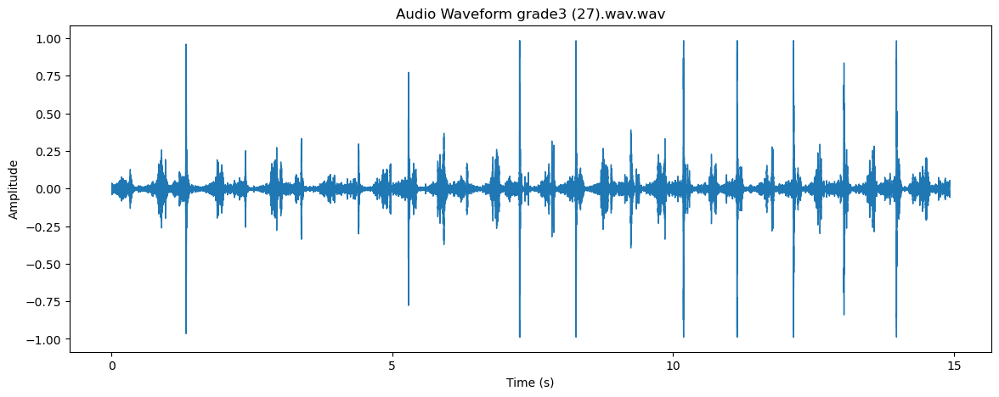

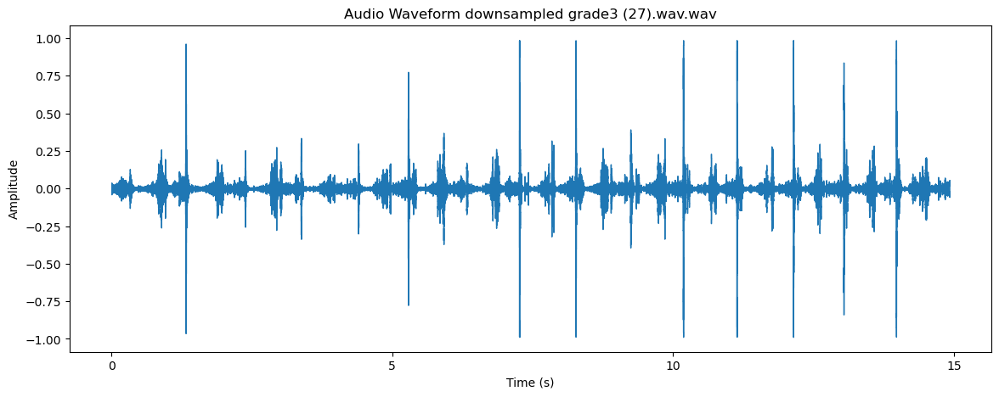

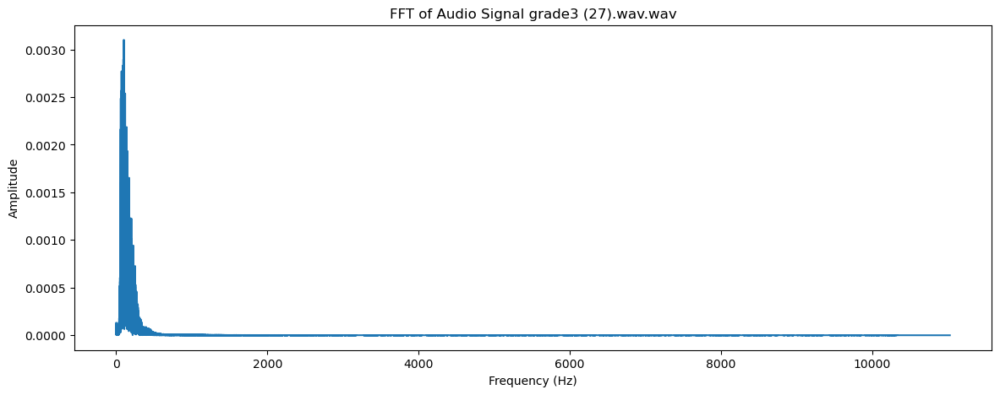

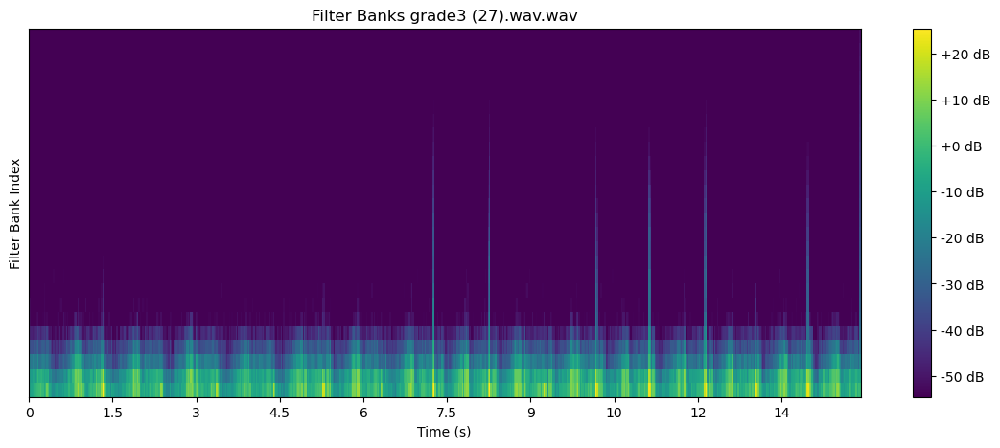

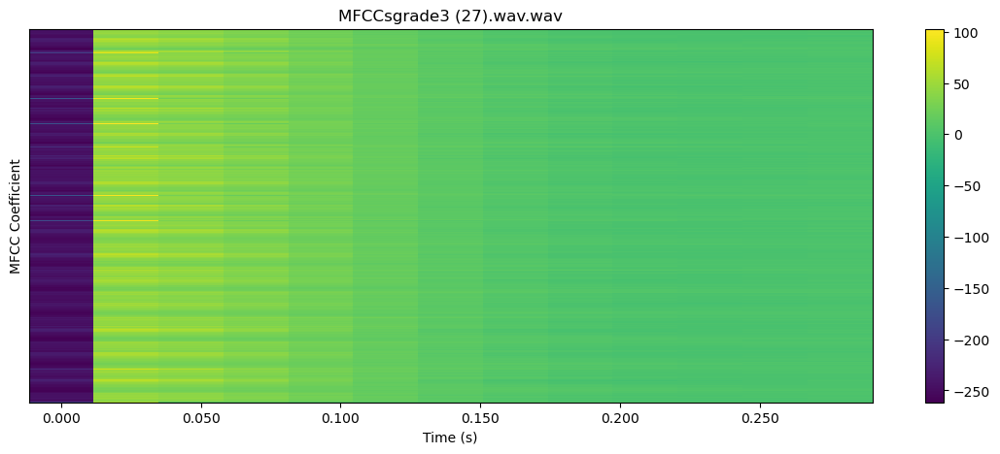


 82%|████████▏ | 116/141 [03:03<00:35,  1.44s/it]

22050


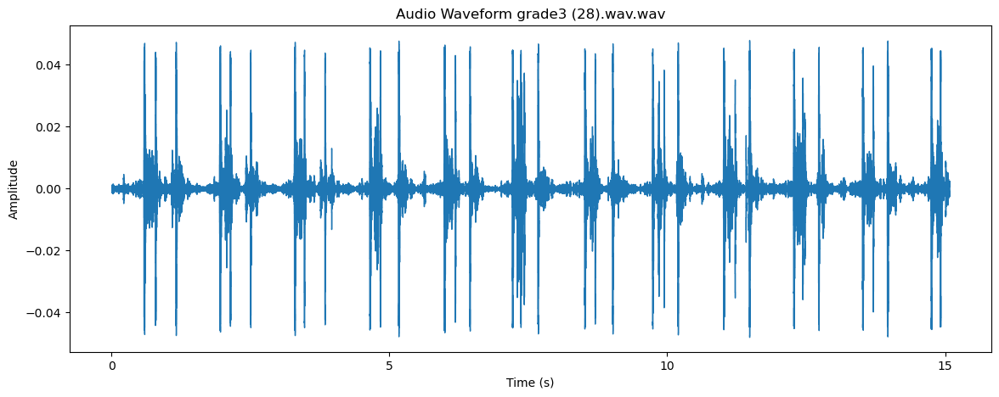

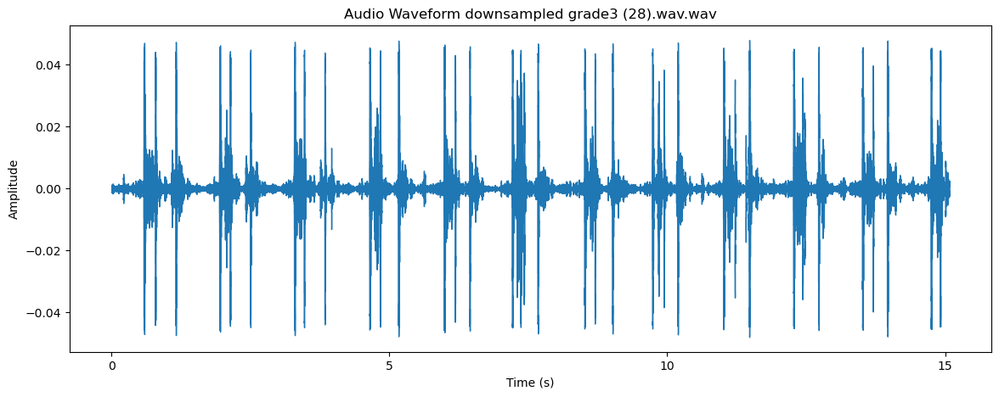

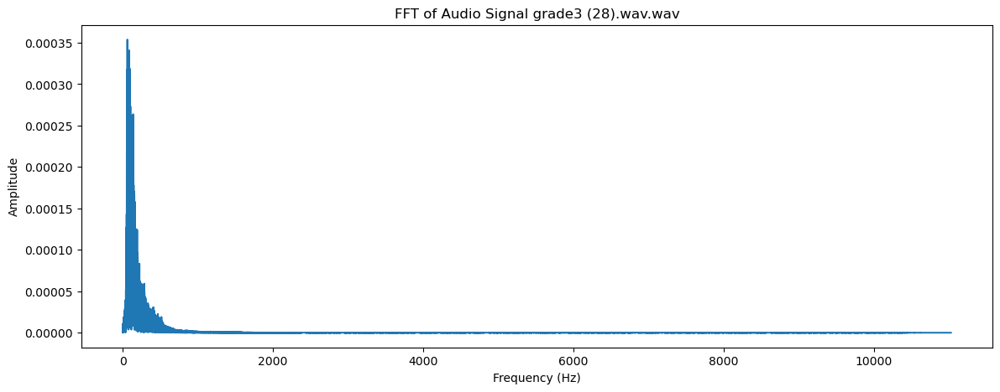

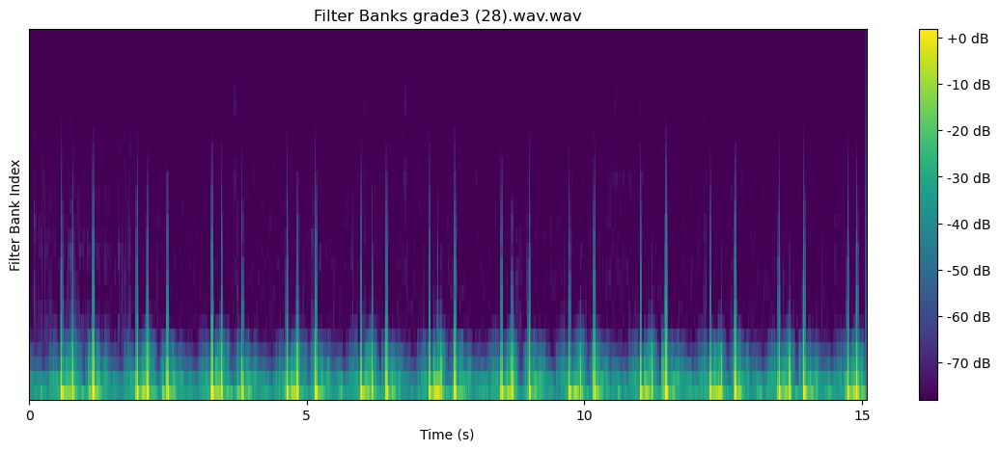

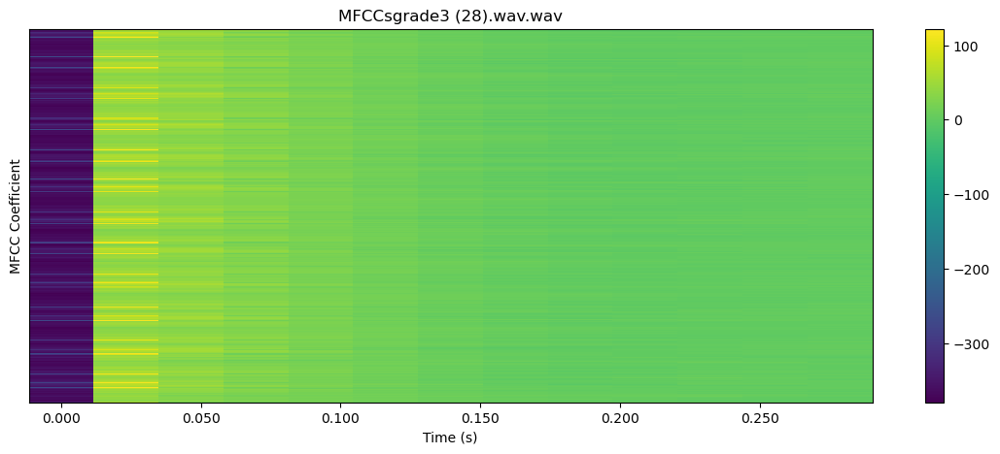


 83%|████████▎ | 117/141 [03:05<00:36,  1.51s/it]

22050


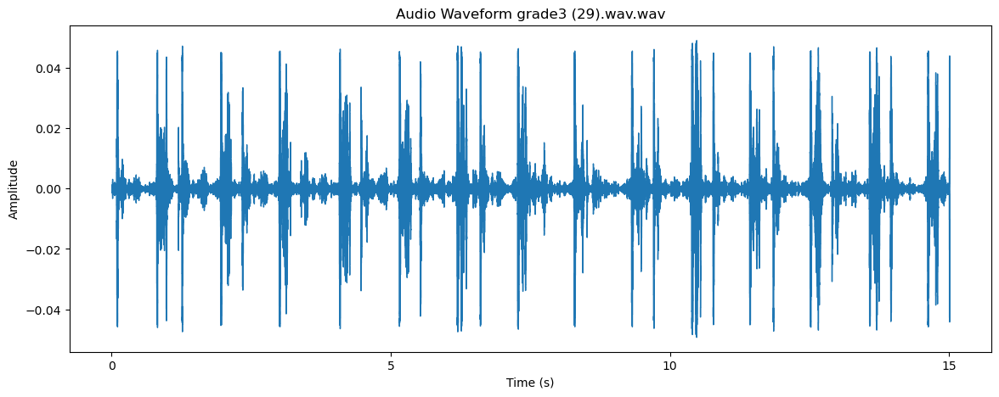

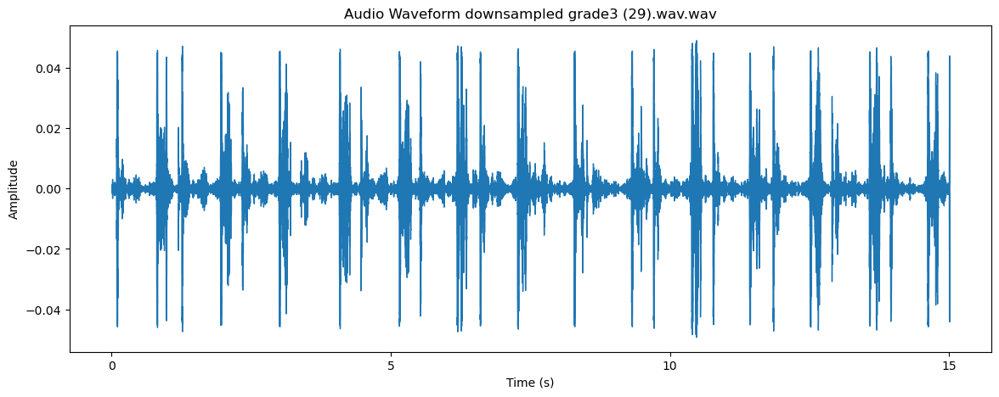

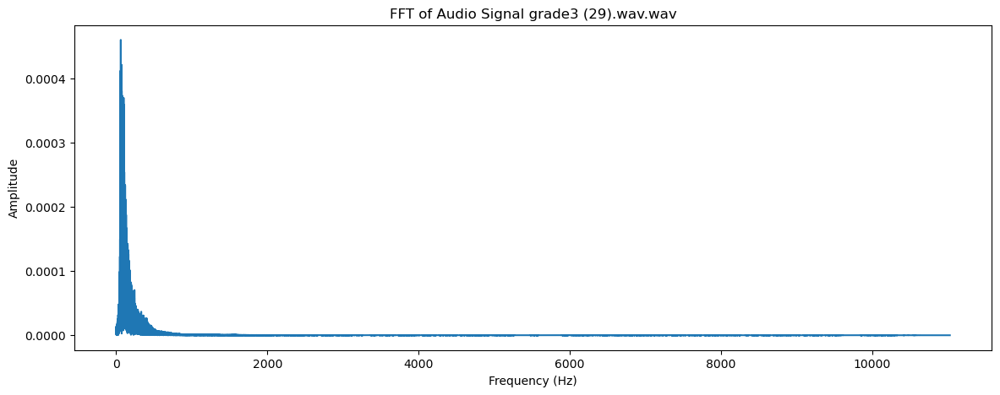

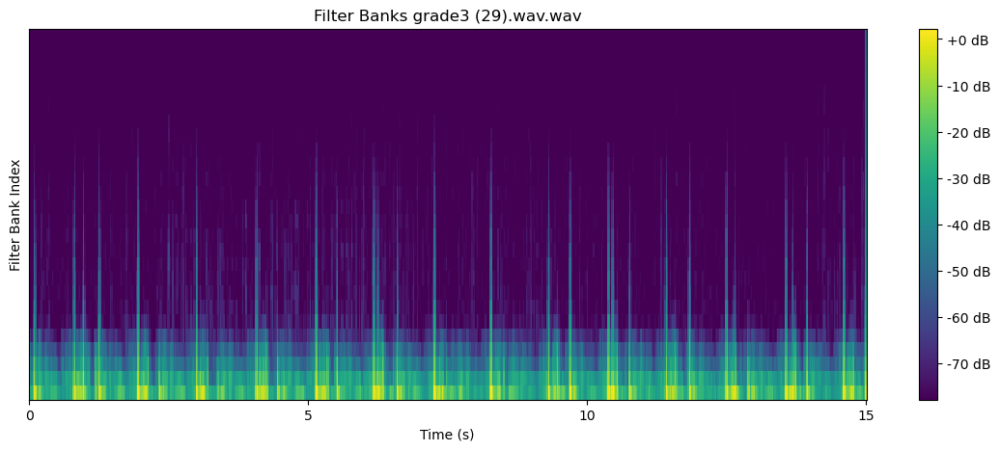

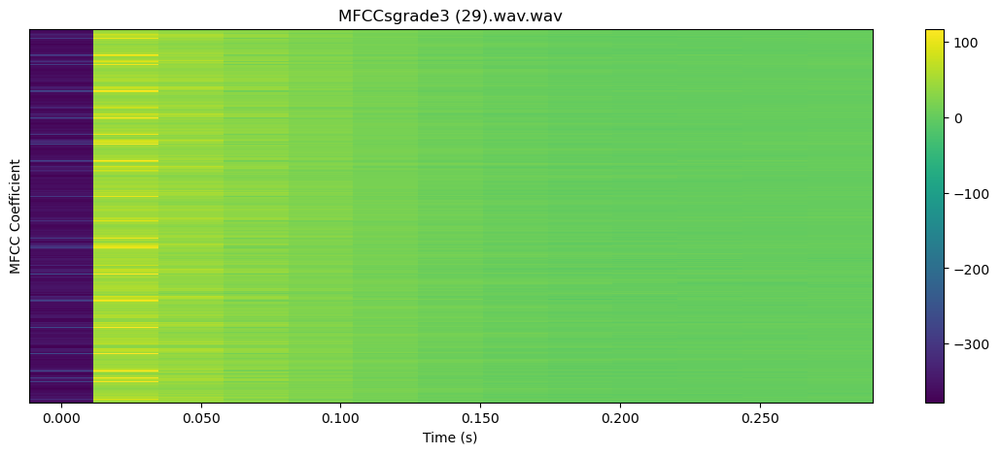


 84%|████████▎ | 118/141 [03:07<00:38,  1.65s/it]

22050


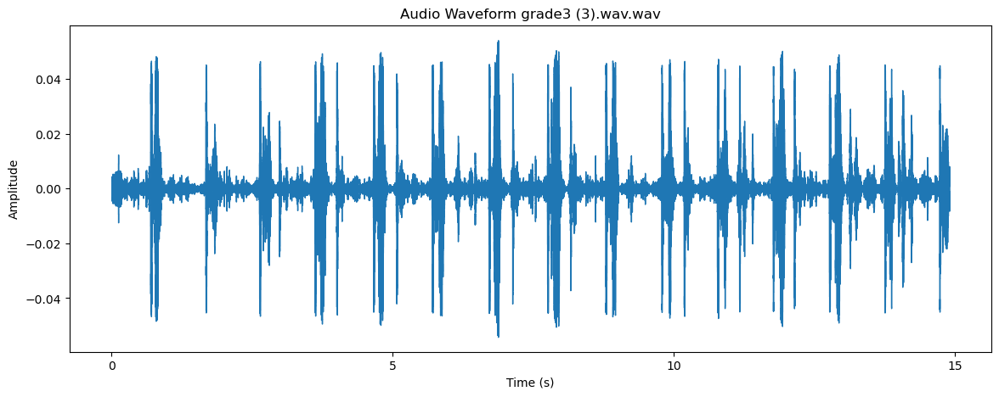

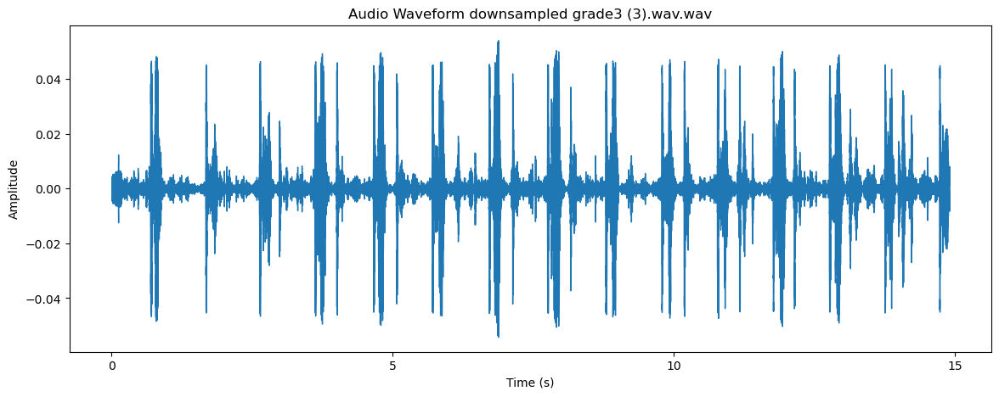

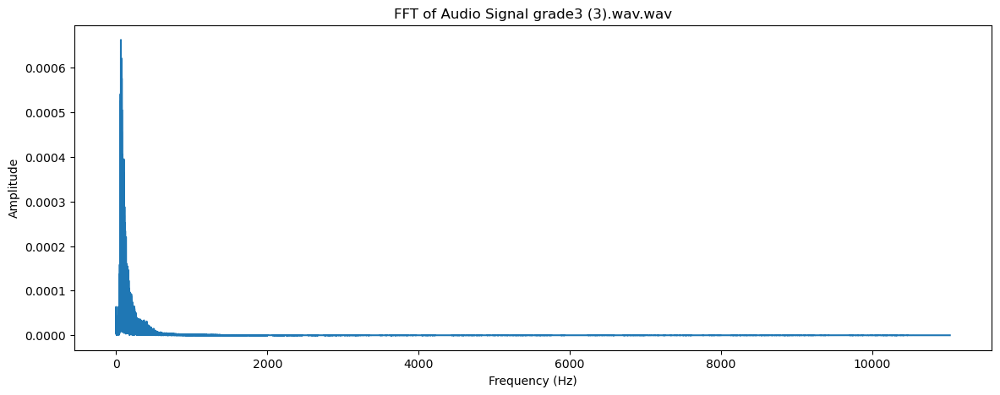

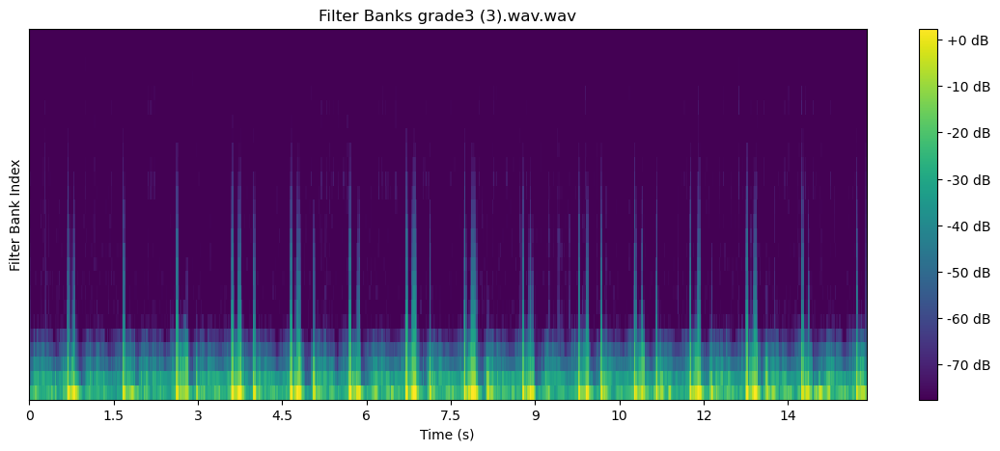

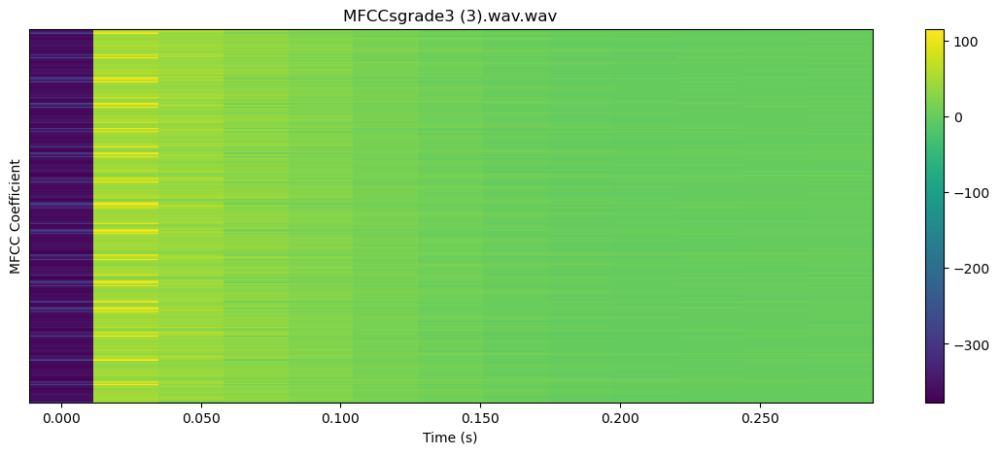


 84%|████████▍ | 119/141 [03:09<00:36,  1.67s/it]

22050


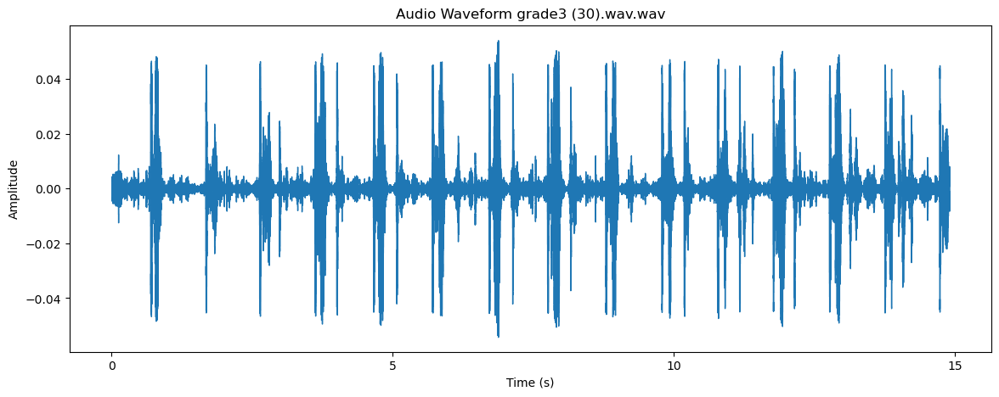

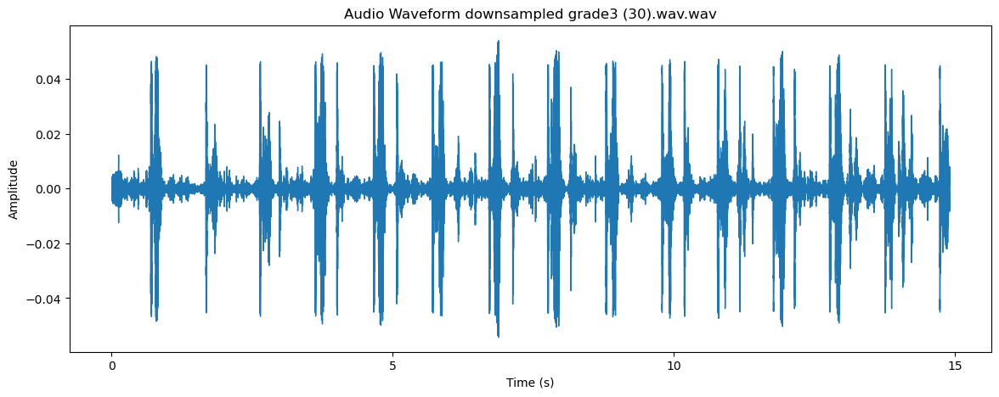

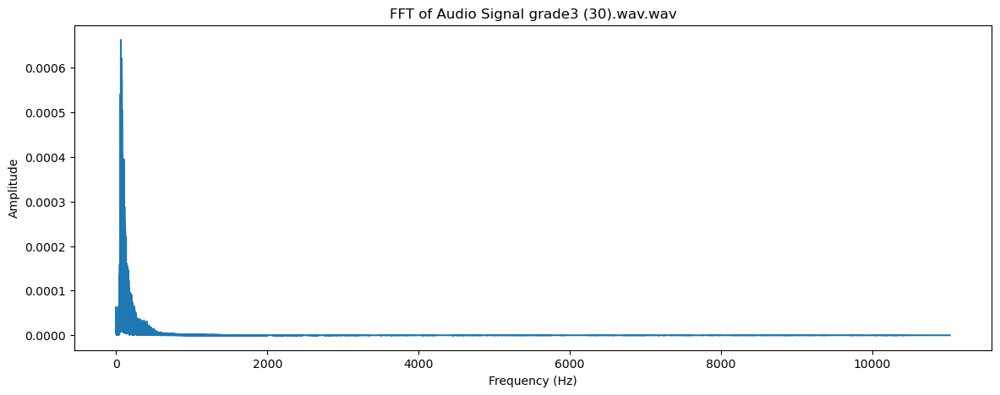

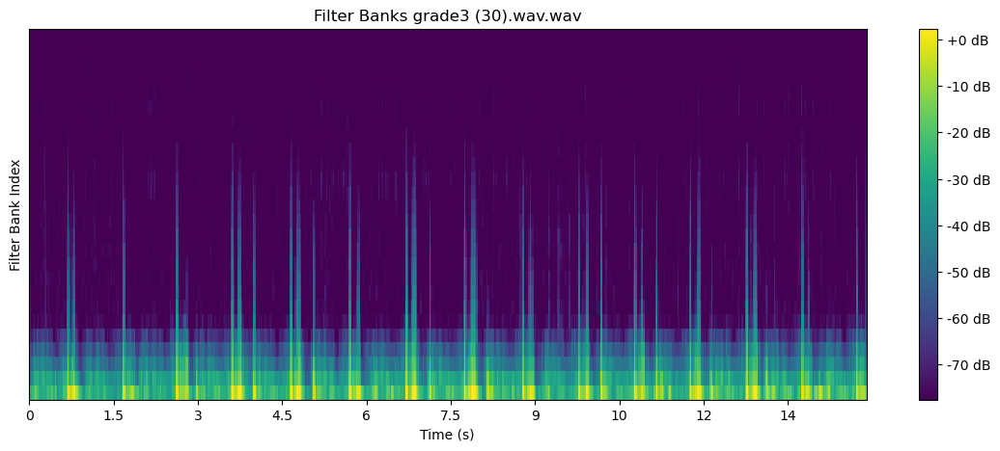

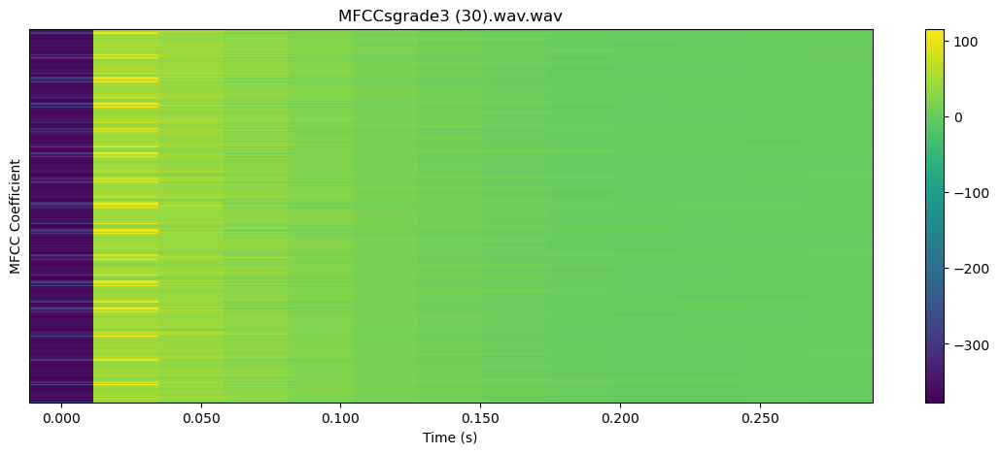


 85%|████████▌ | 120/141 [03:10<00:33,  1.60s/it]

22050


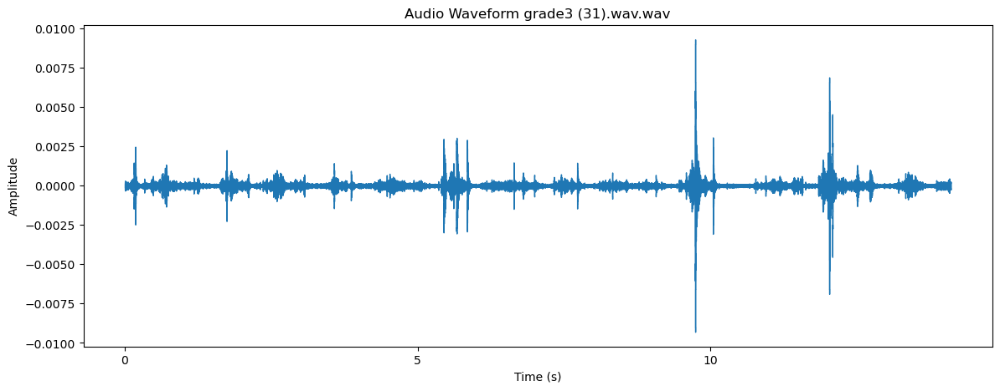

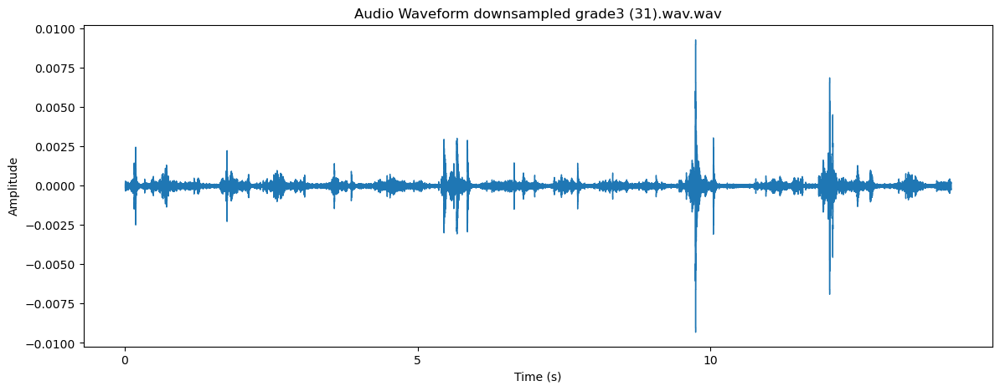

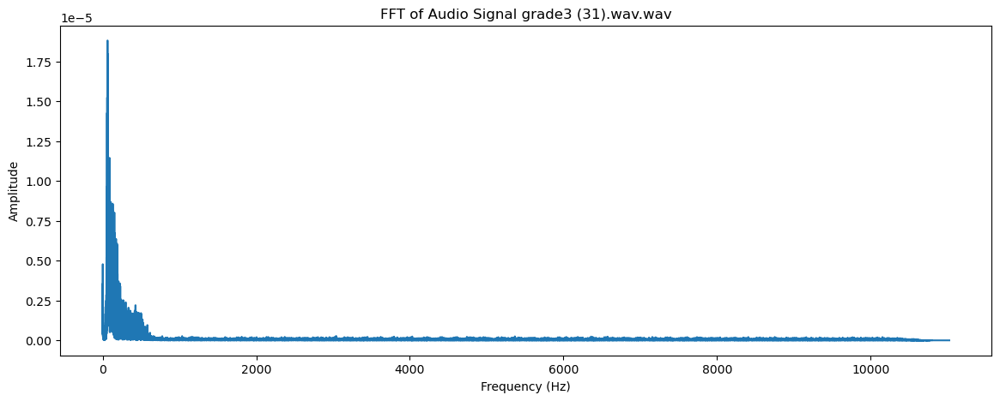

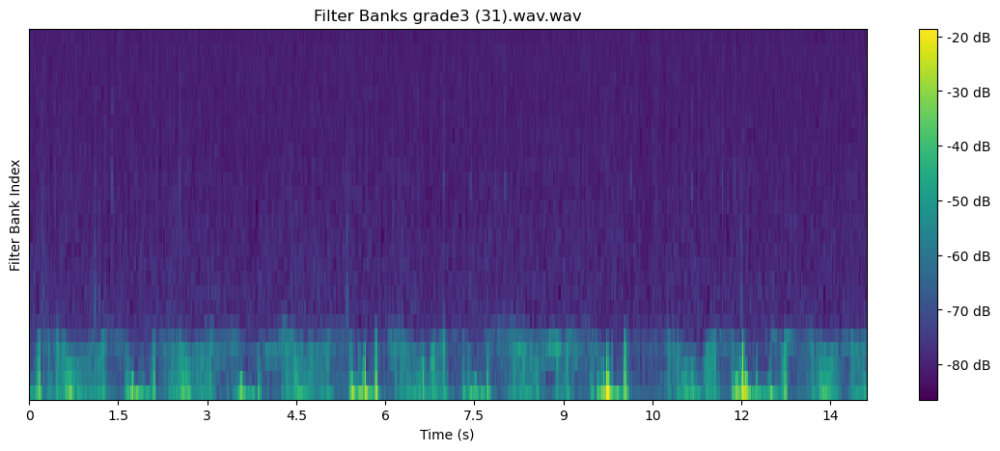

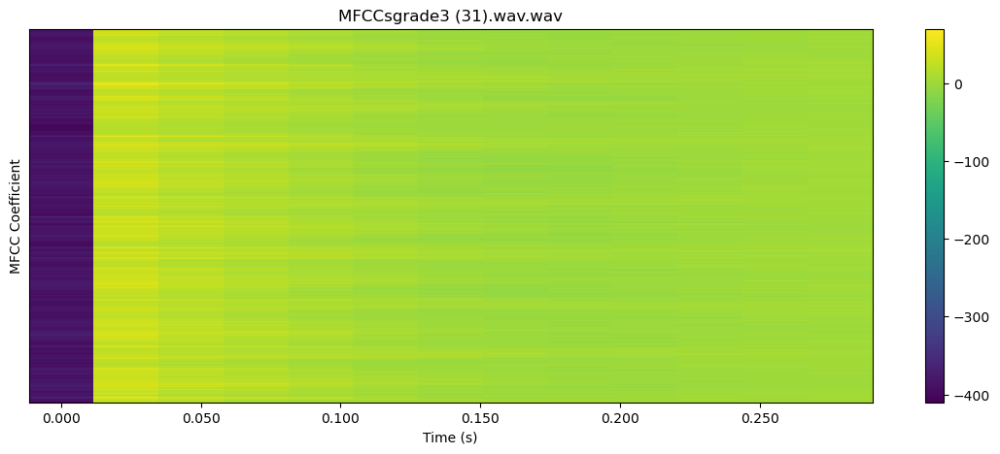


 86%|████████▌ | 121/141 [03:11<00:30,  1.52s/it]

22050


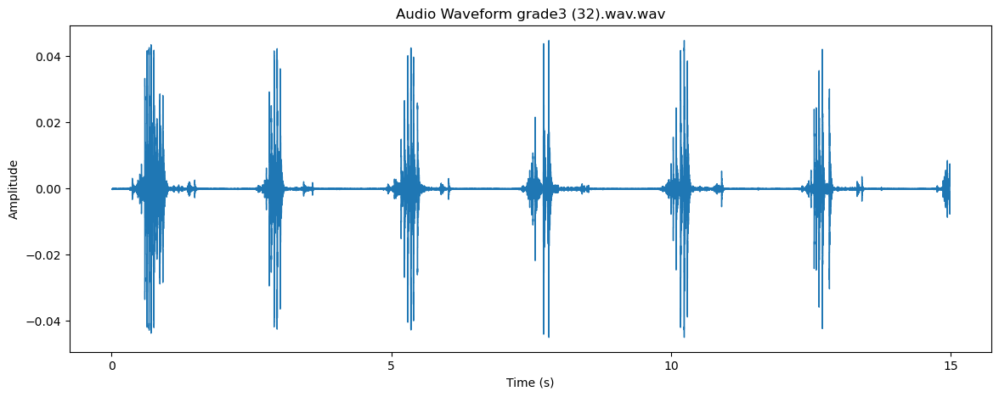

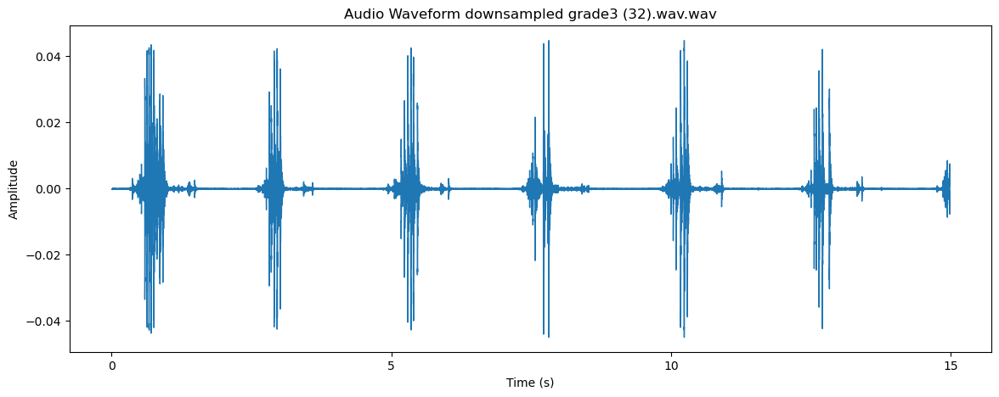

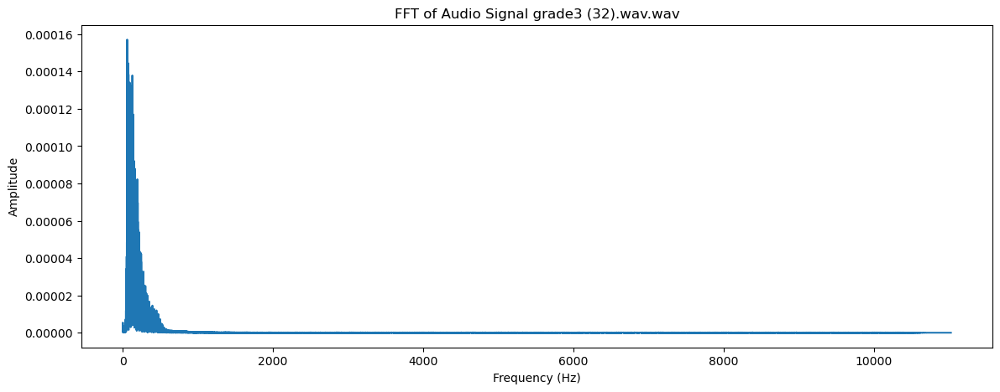

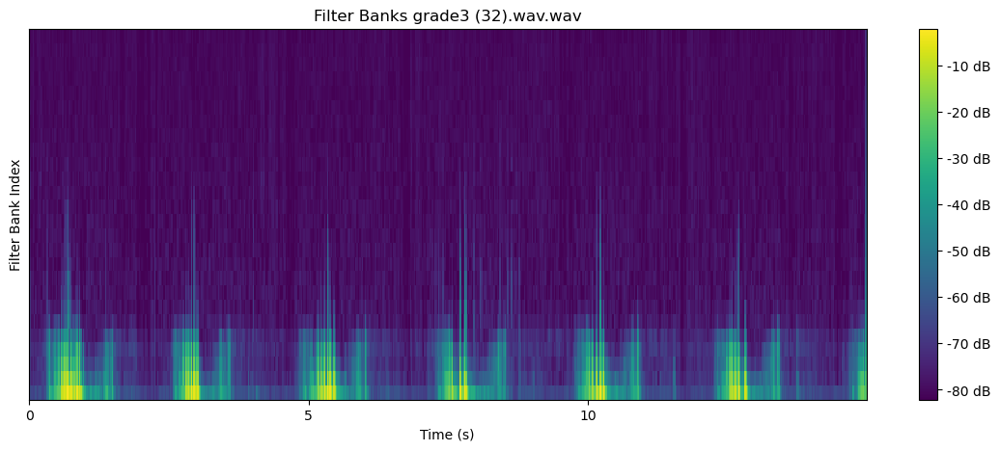

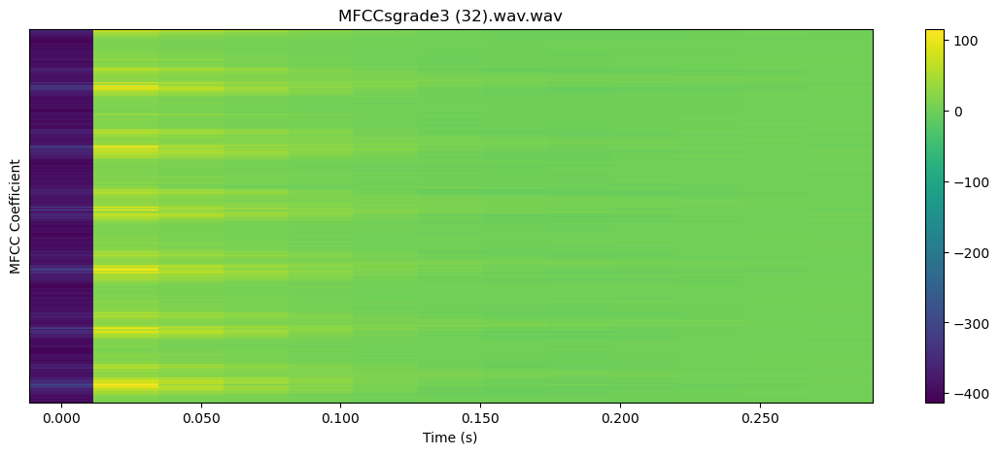


 87%|████████▋ | 122/141 [03:13<00:27,  1.47s/it]

22050


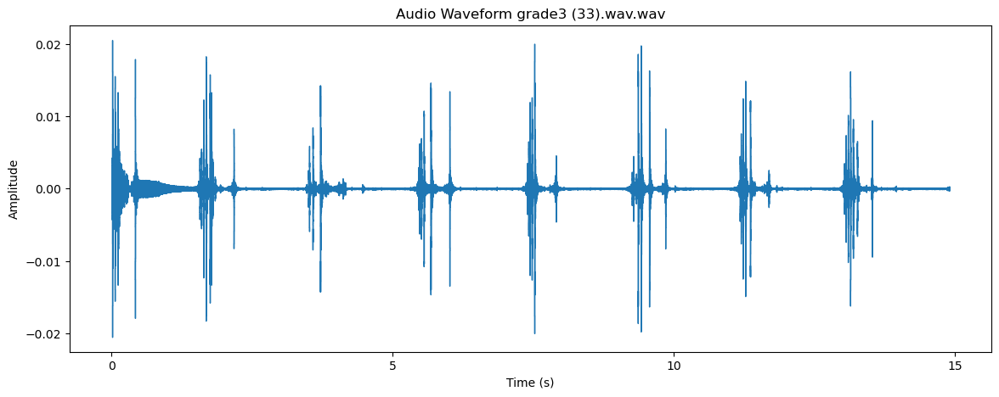

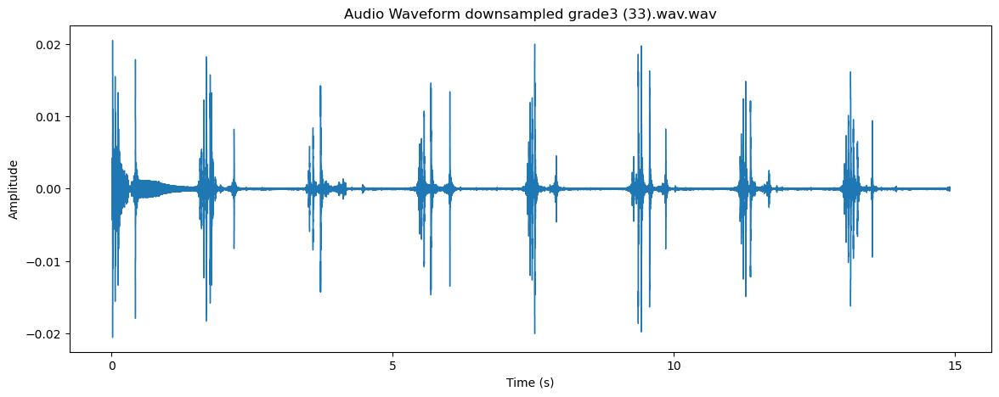

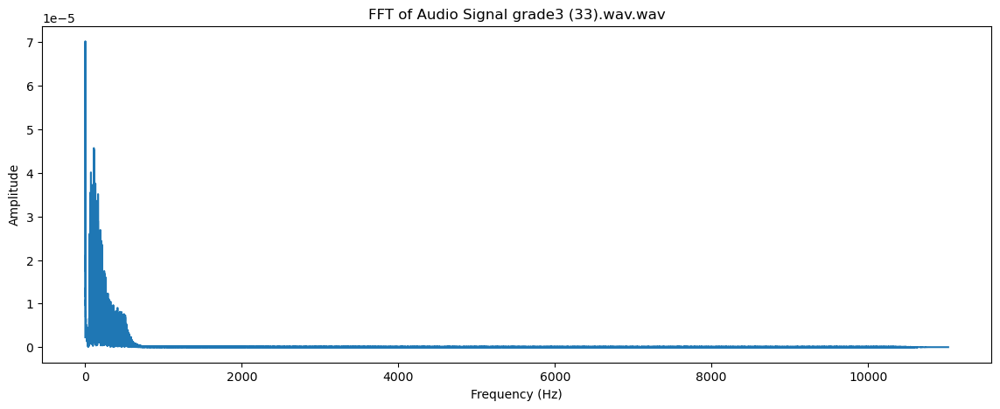

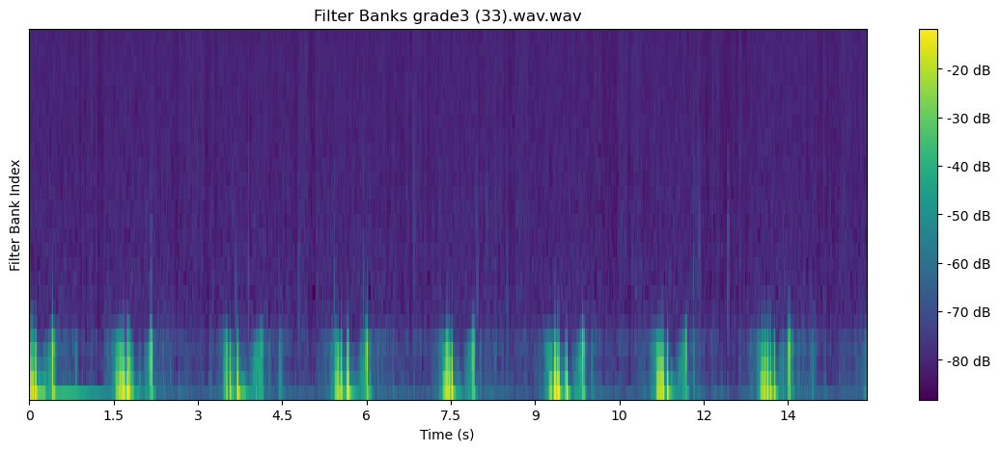

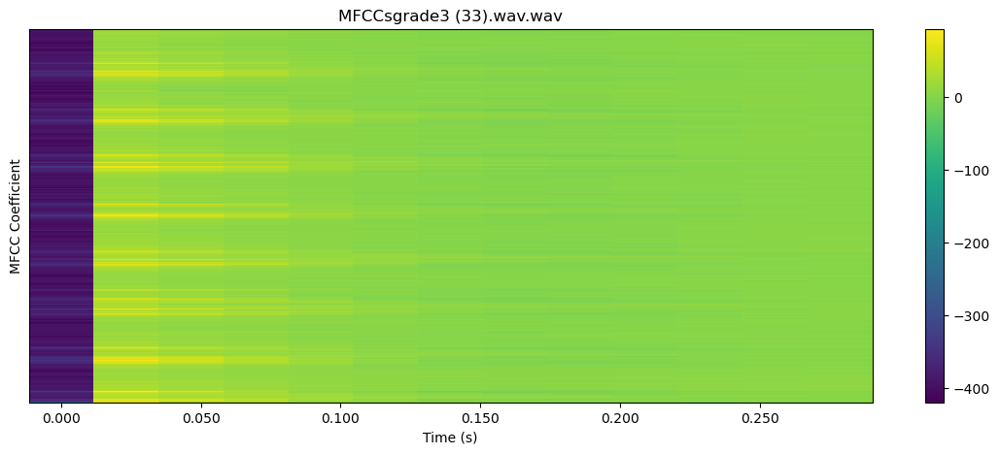


 87%|████████▋ | 123/141 [03:14<00:26,  1.44s/it]

22050


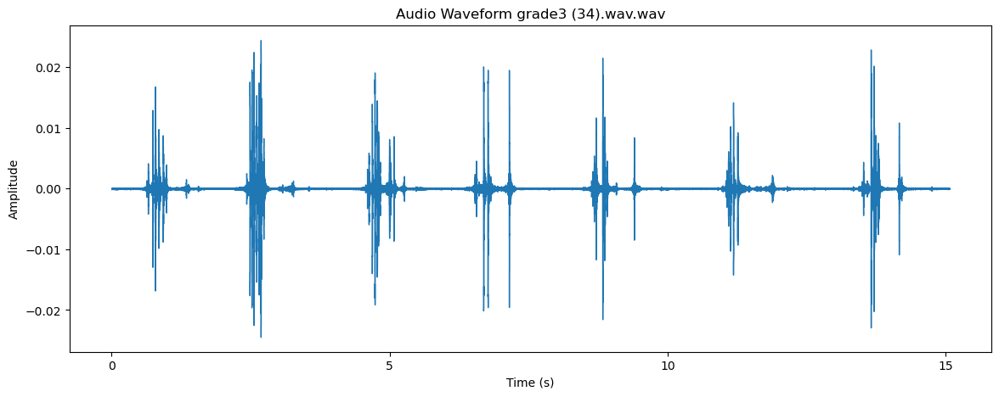

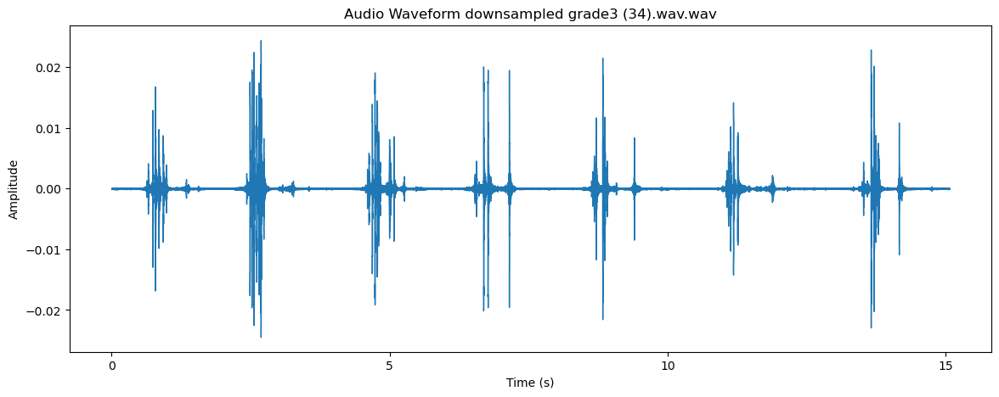

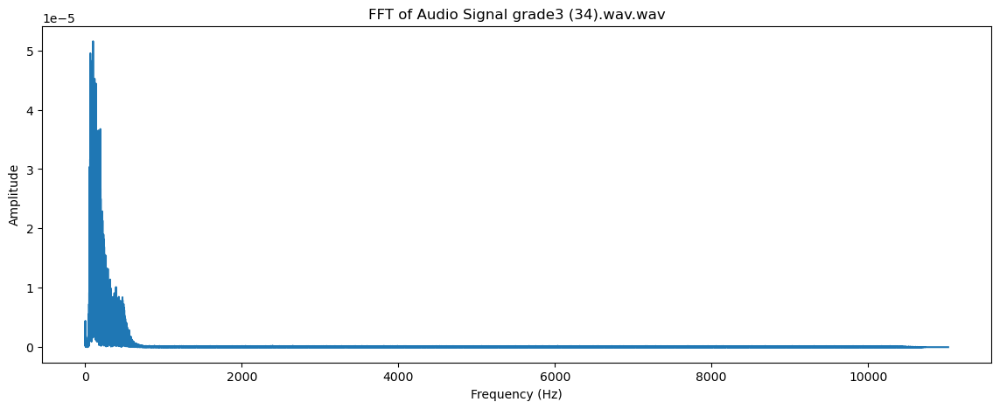

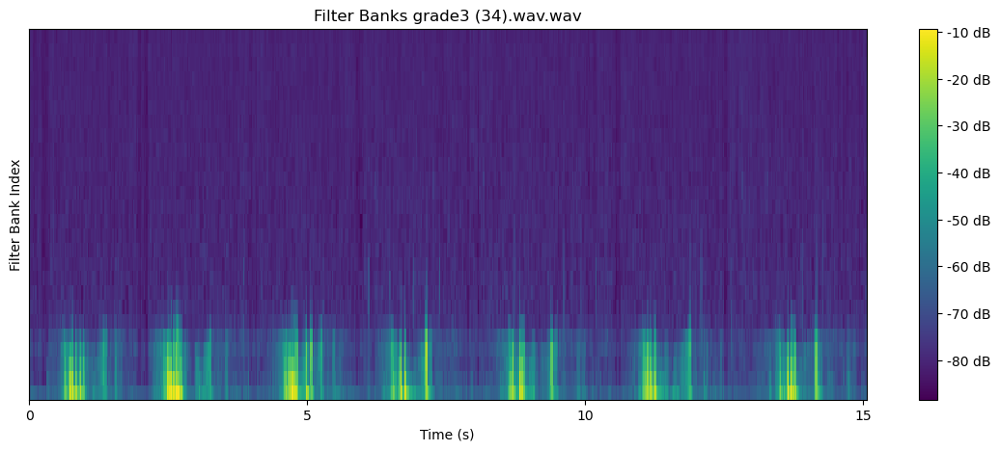

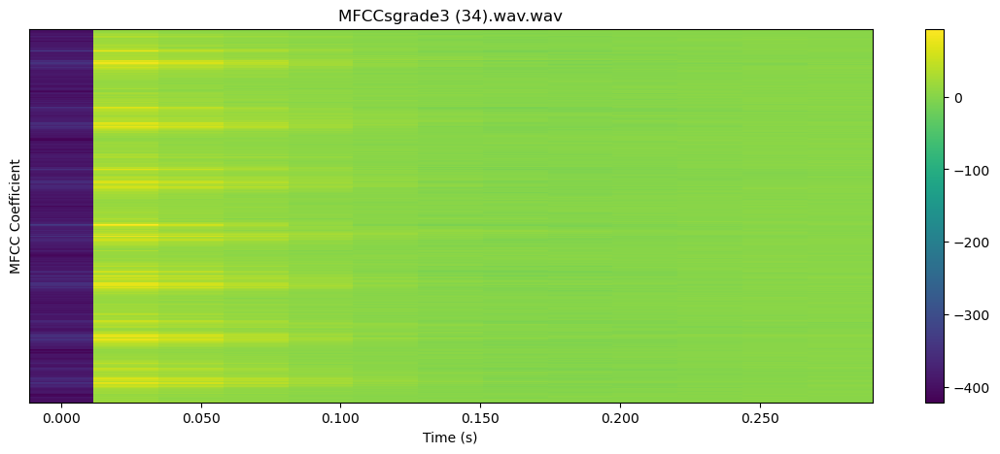


 88%|████████▊ | 124/141 [03:15<00:23,  1.40s/it]

22050


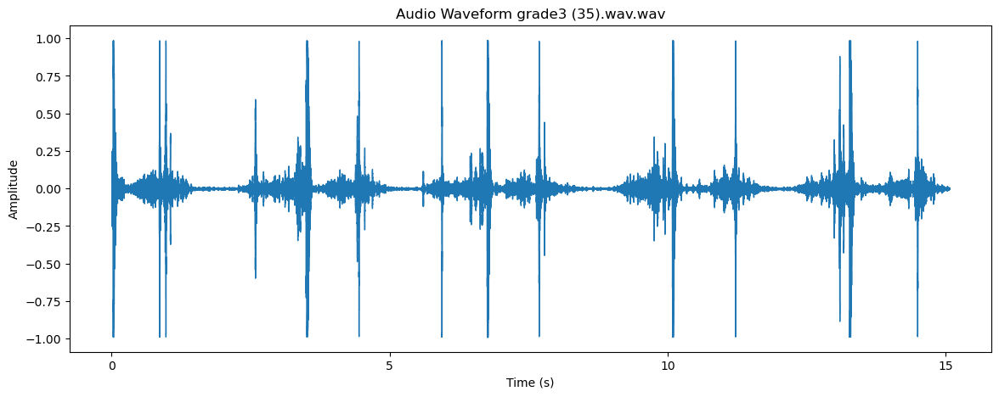

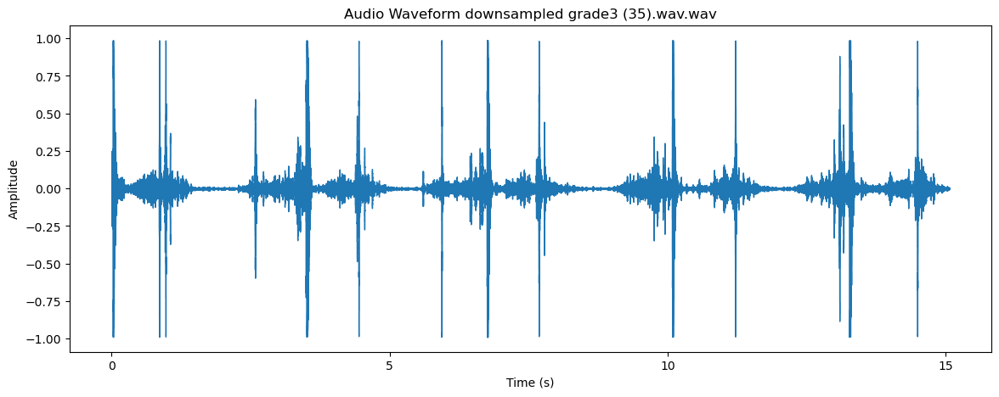

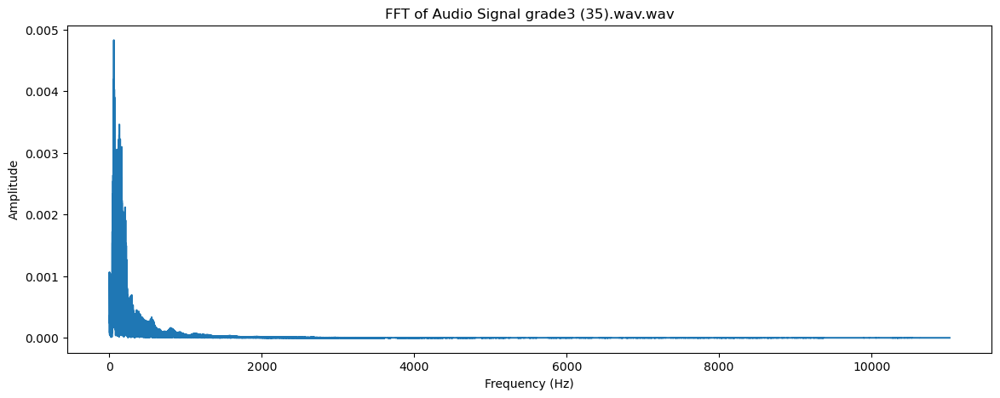

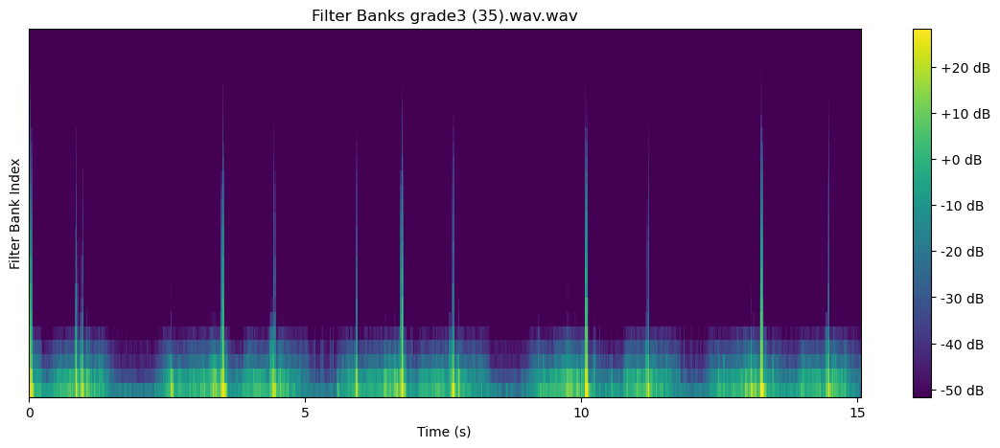

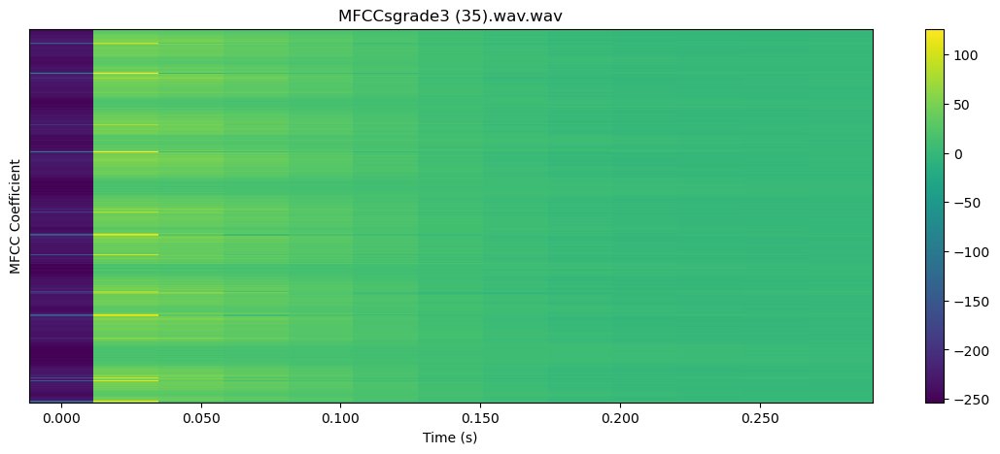


 89%|████████▊ | 125/141 [03:17<00:22,  1.40s/it]

22050


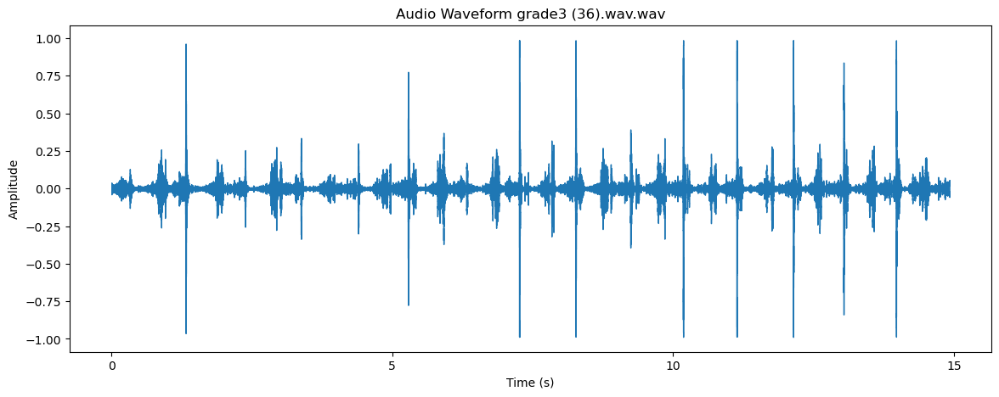

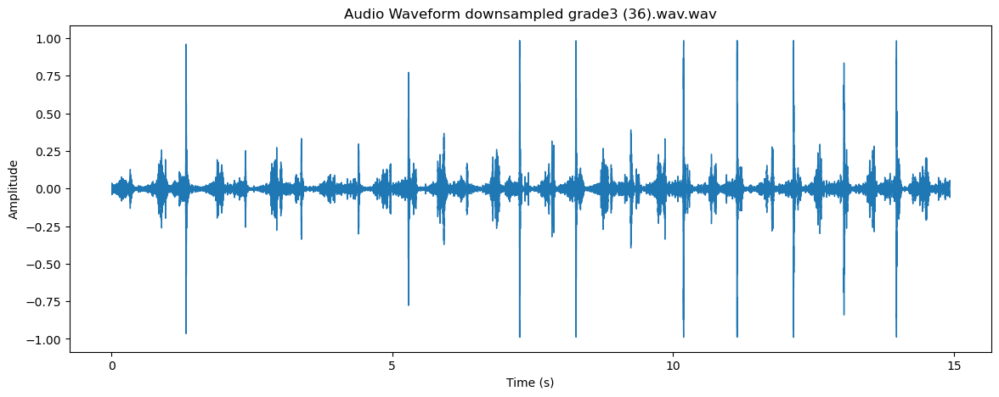

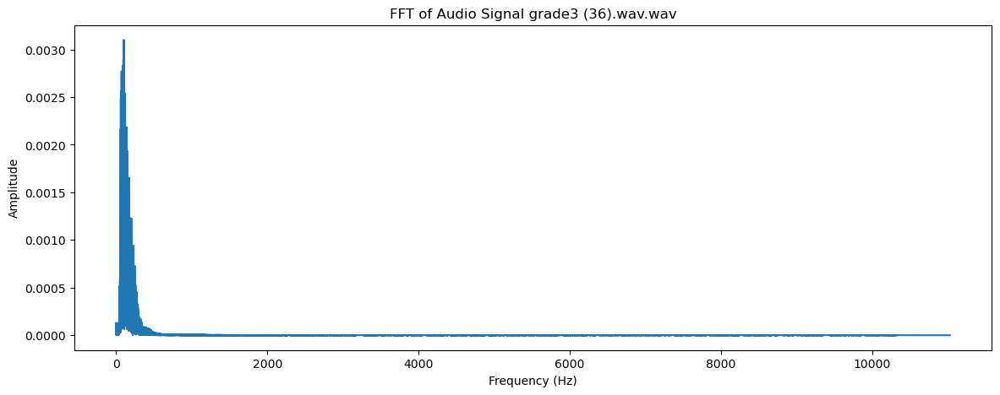

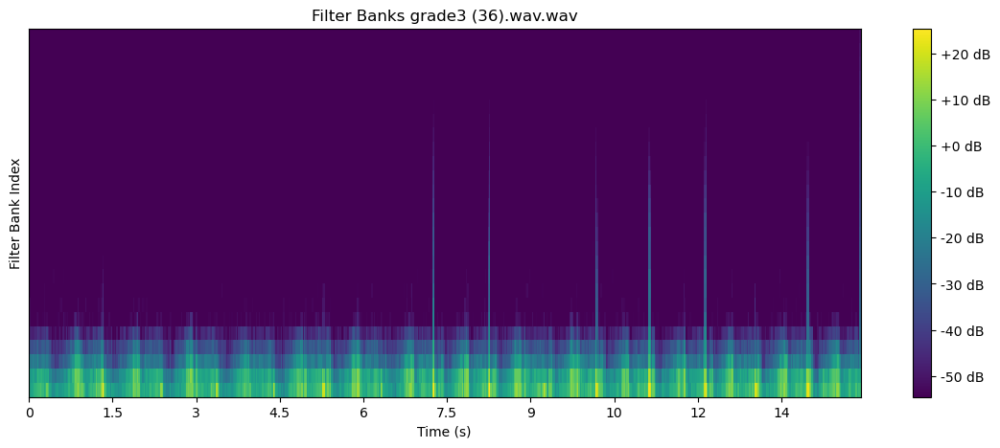

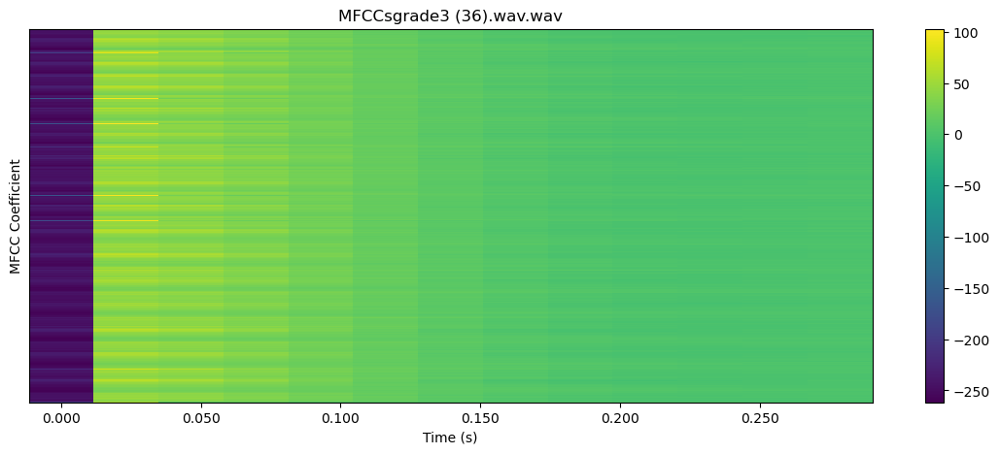


 89%|████████▉ | 126/141 [03:19<00:23,  1.56s/it]

22050


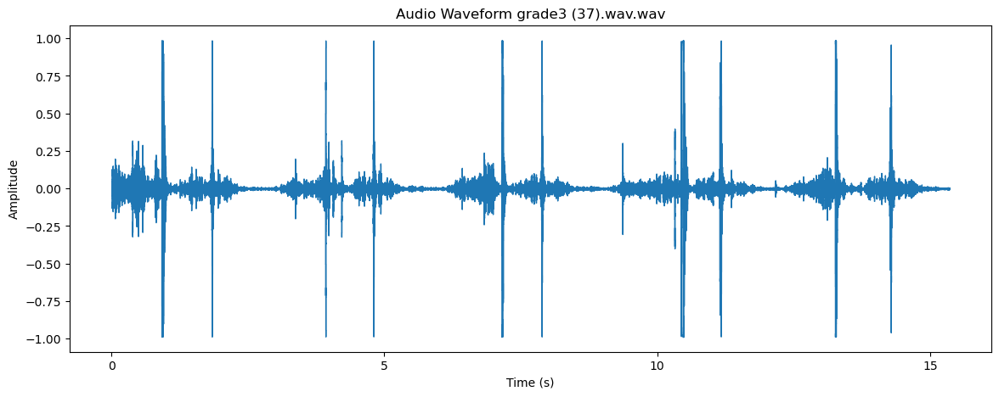

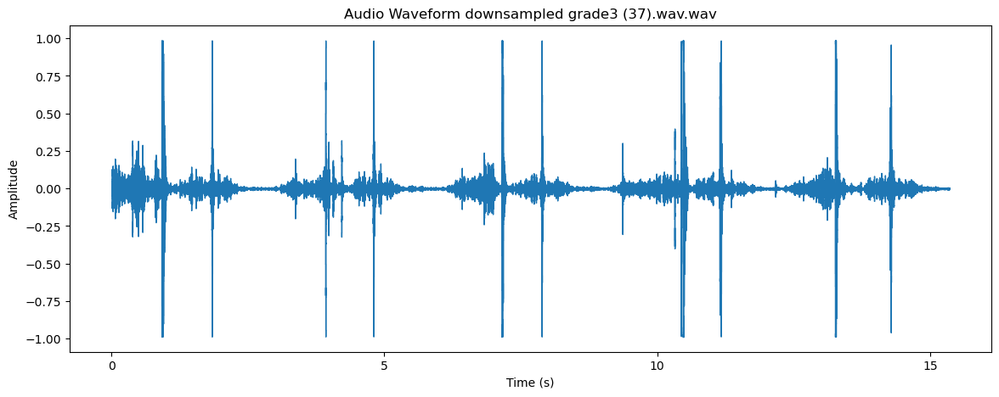

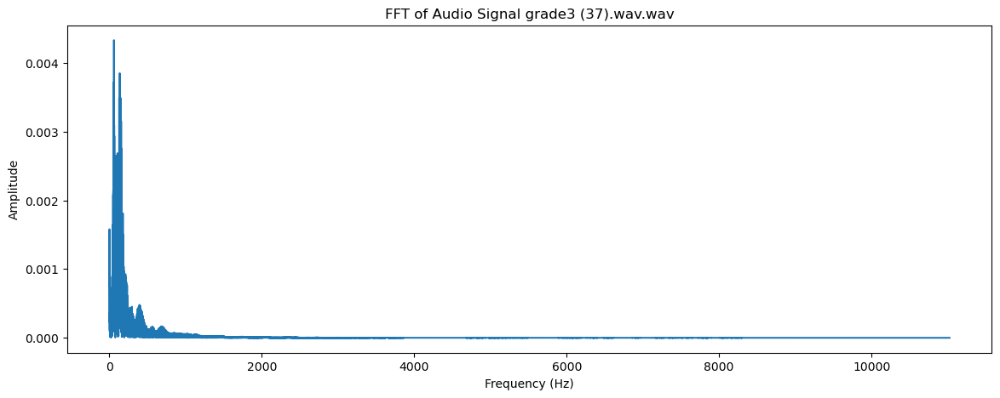

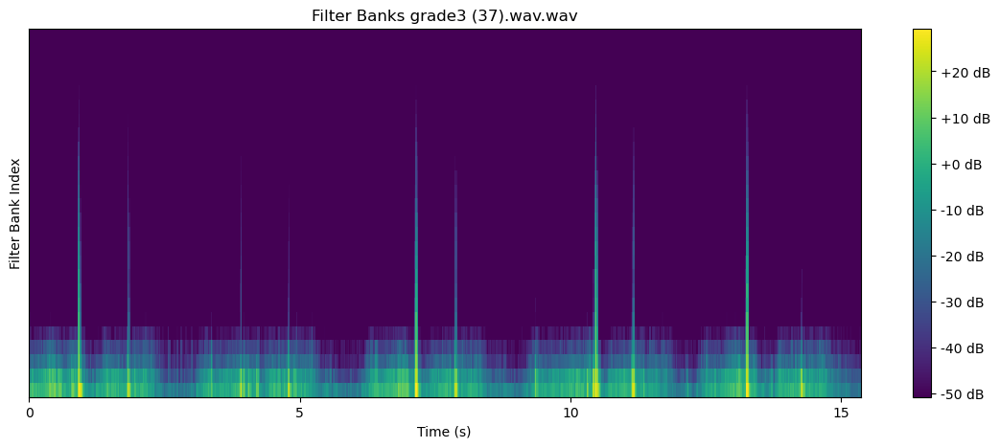

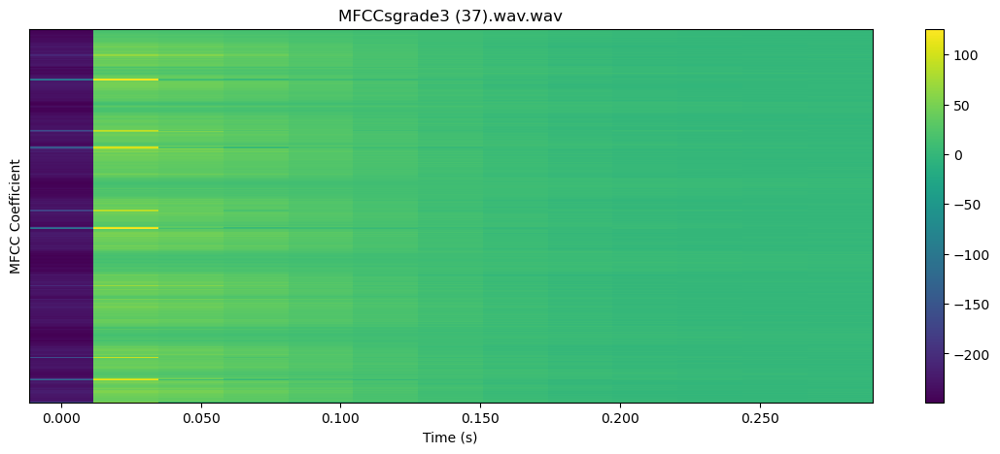


 90%|█████████ | 127/141 [03:20<00:21,  1.56s/it]

22050


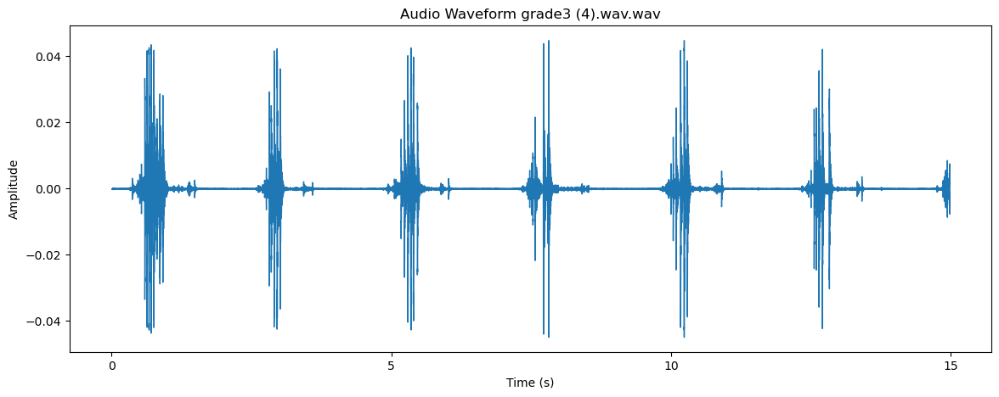

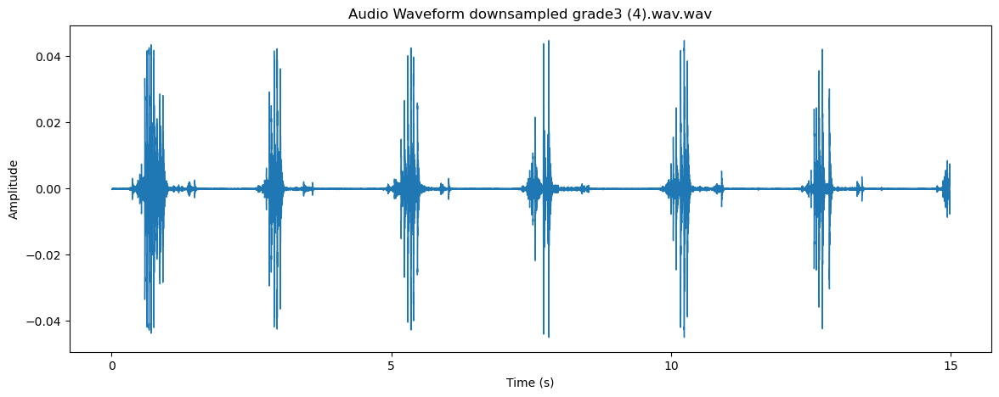

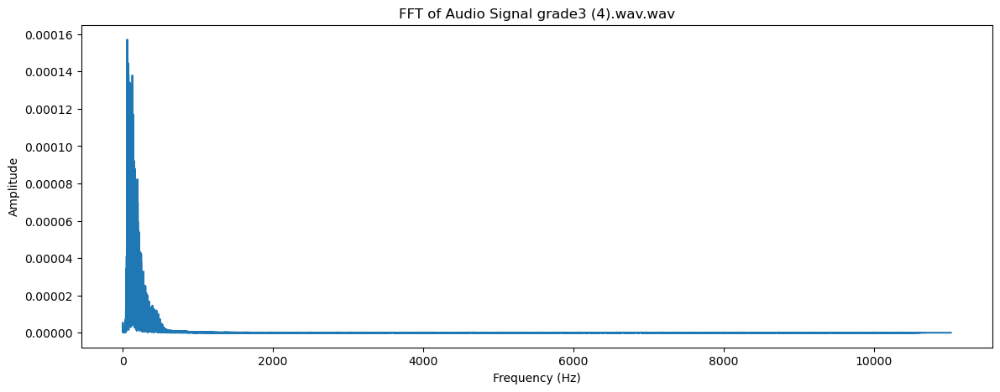

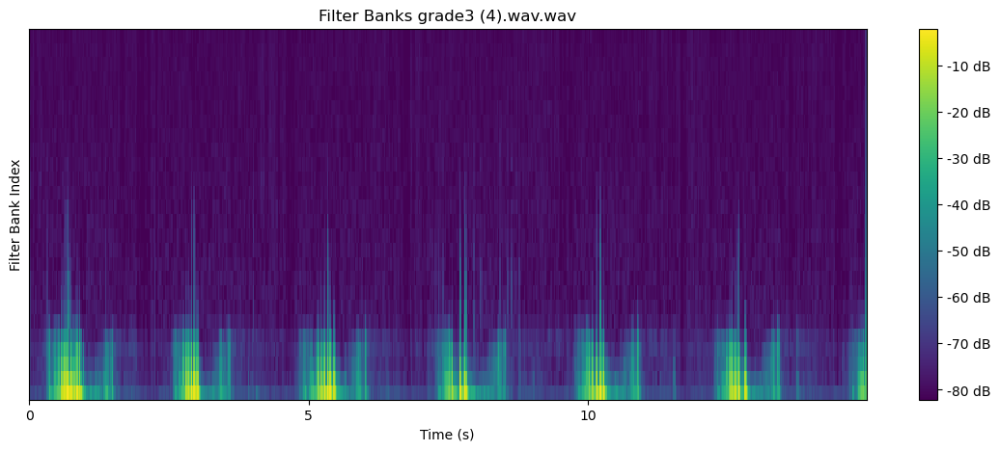

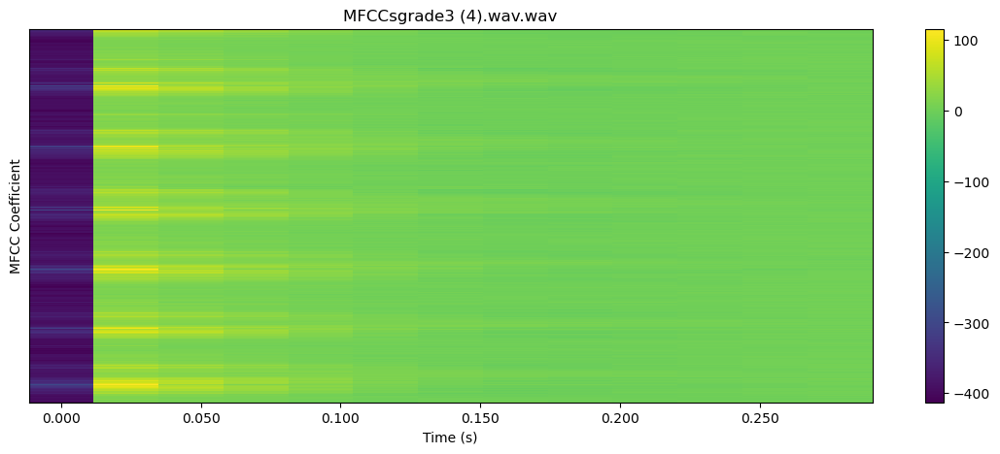


 91%|█████████ | 128/141 [03:22<00:21,  1.65s/it]

22050


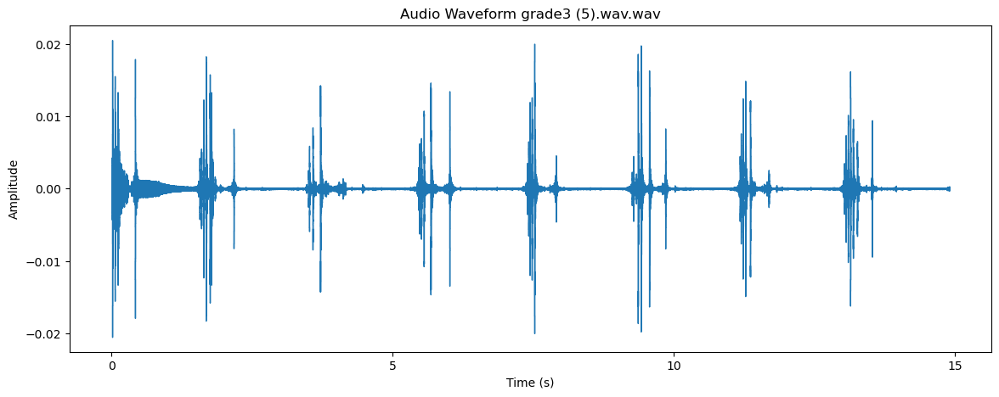

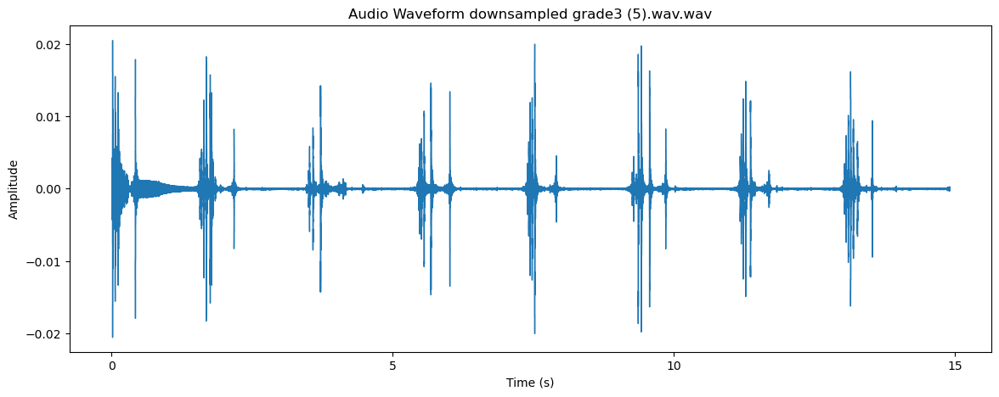

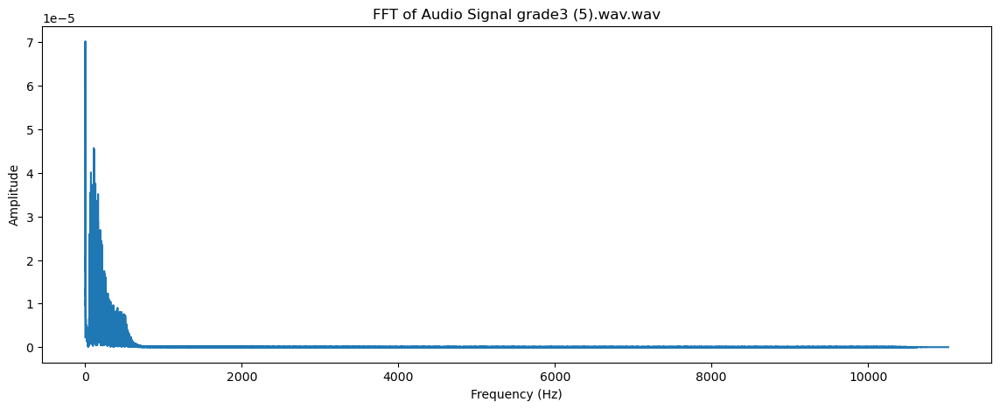

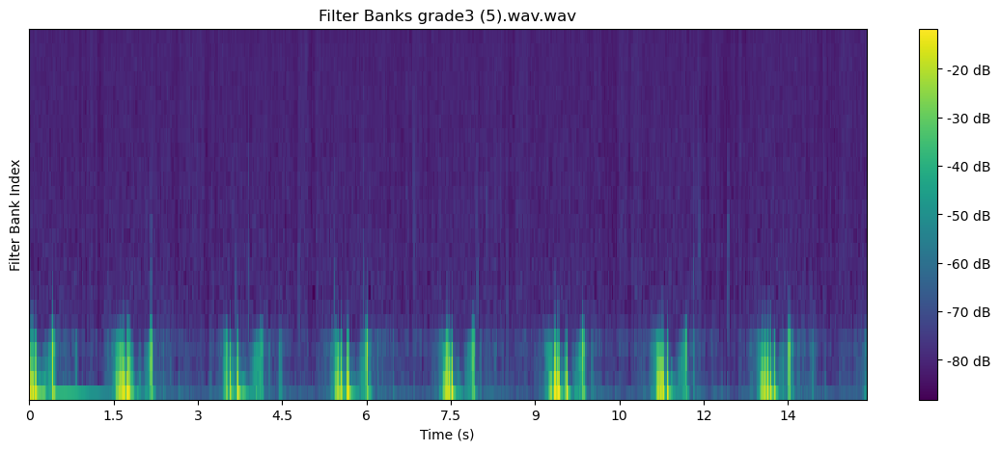

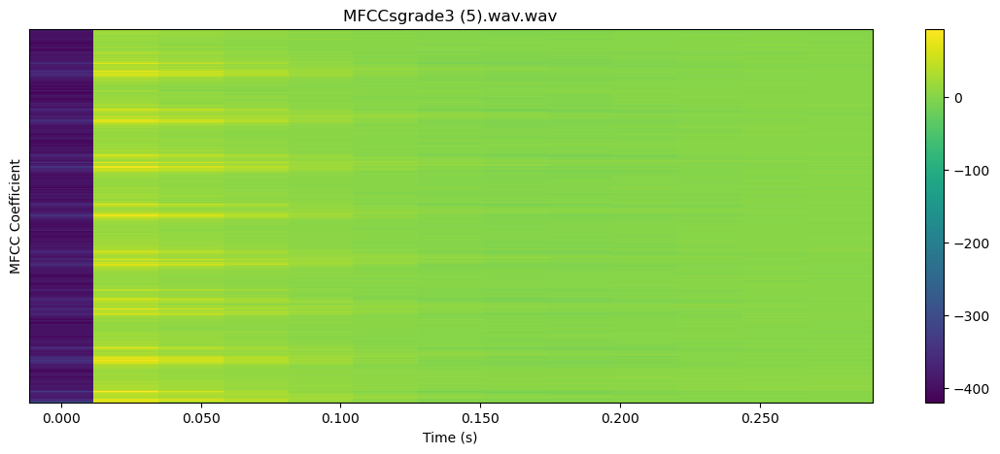


 91%|█████████▏| 129/141 [03:24<00:20,  1.70s/it]

22050


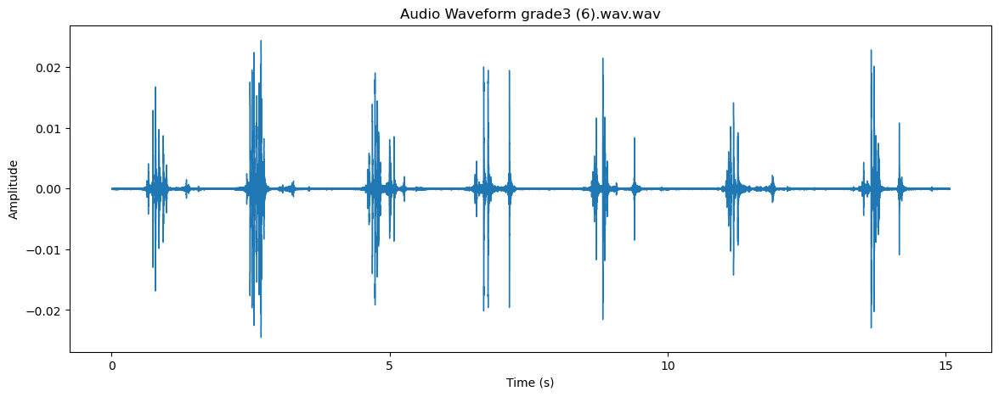

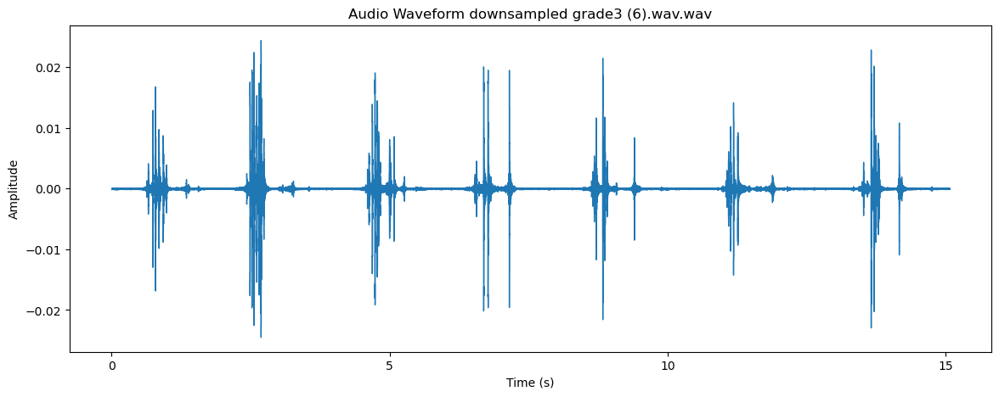

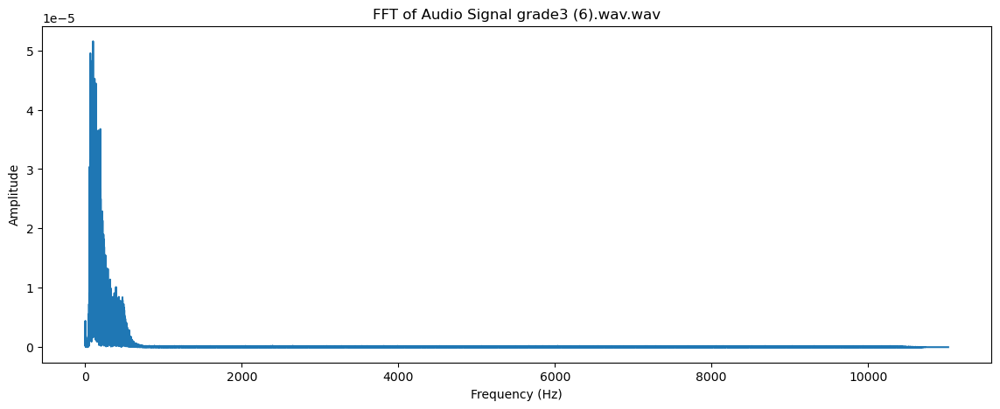

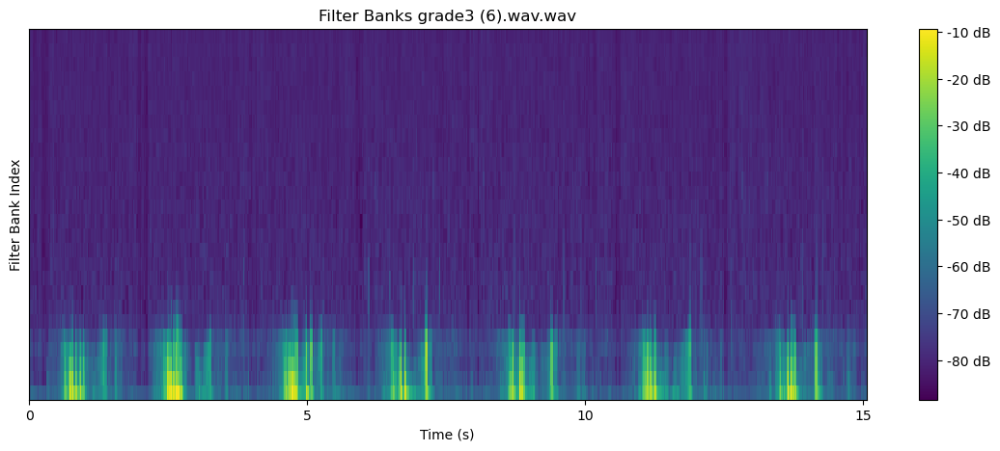

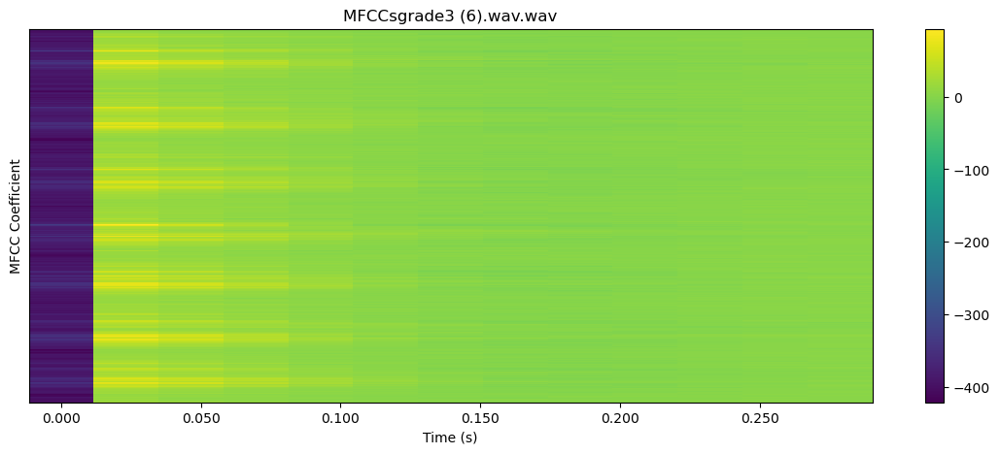


 92%|█████████▏| 130/141 [03:25<00:17,  1.58s/it]

22050


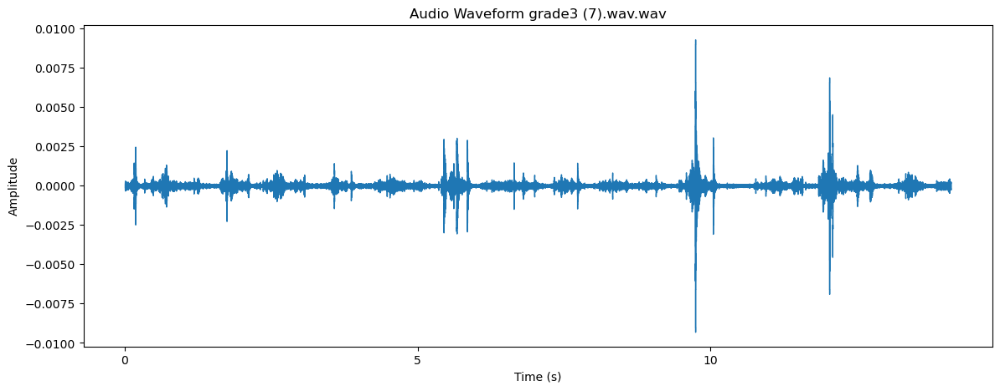

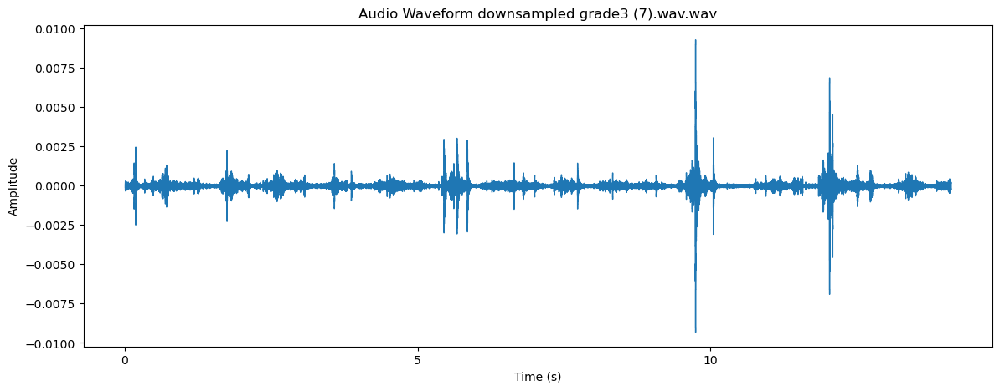

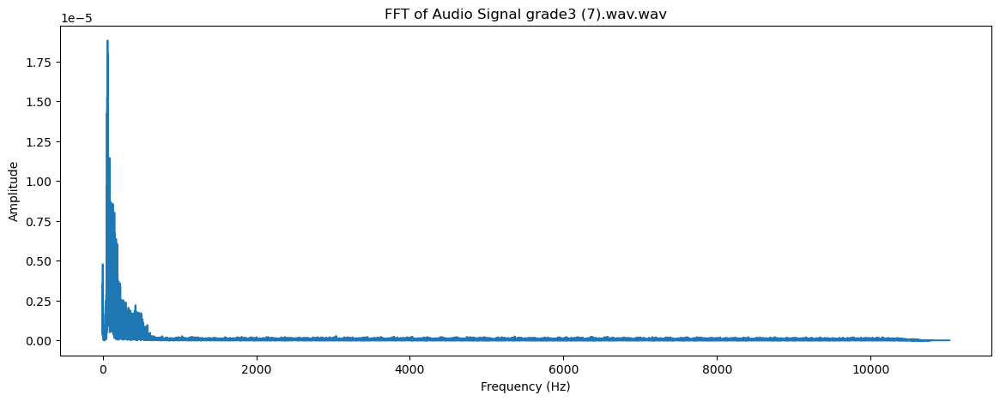

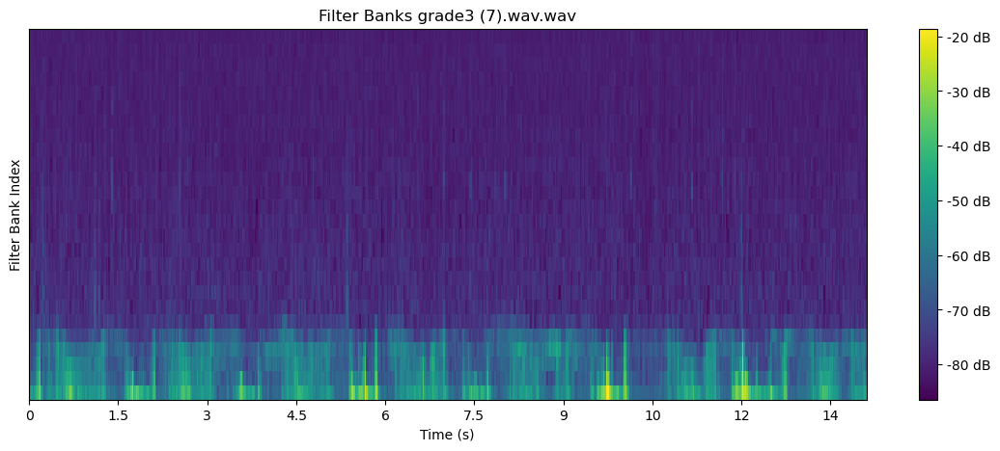

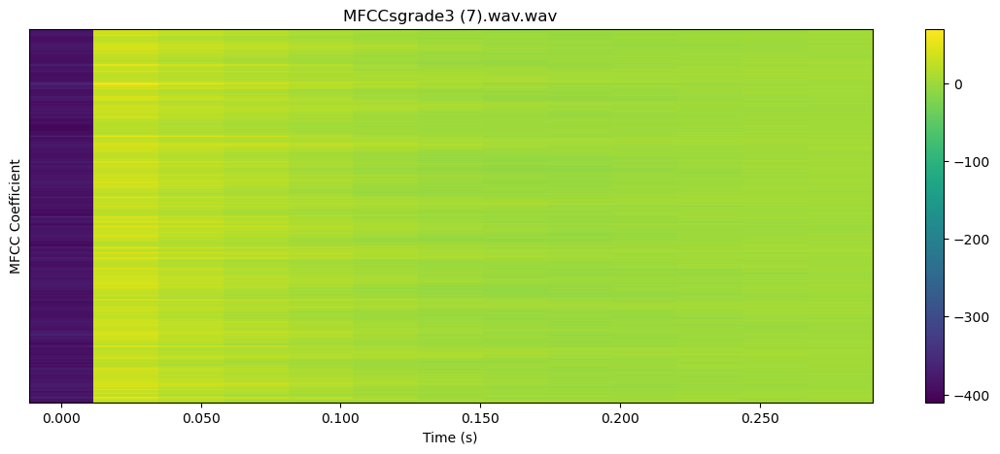


 93%|█████████▎| 131/141 [03:27<00:15,  1.51s/it]

22050


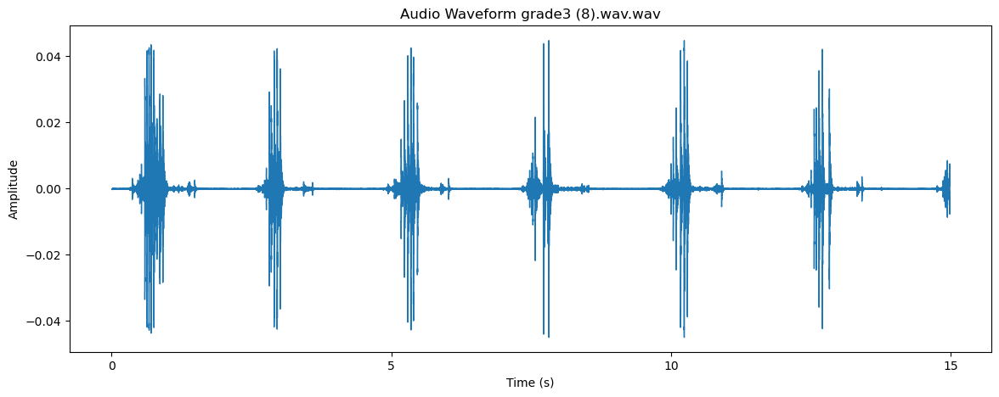

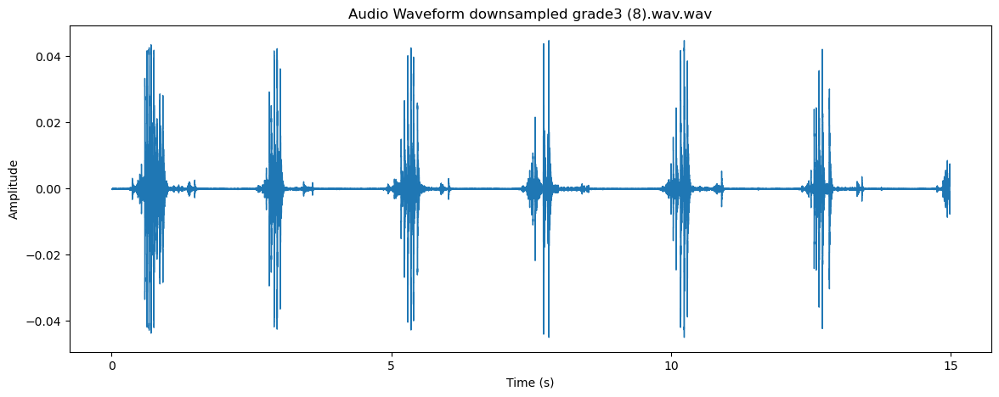

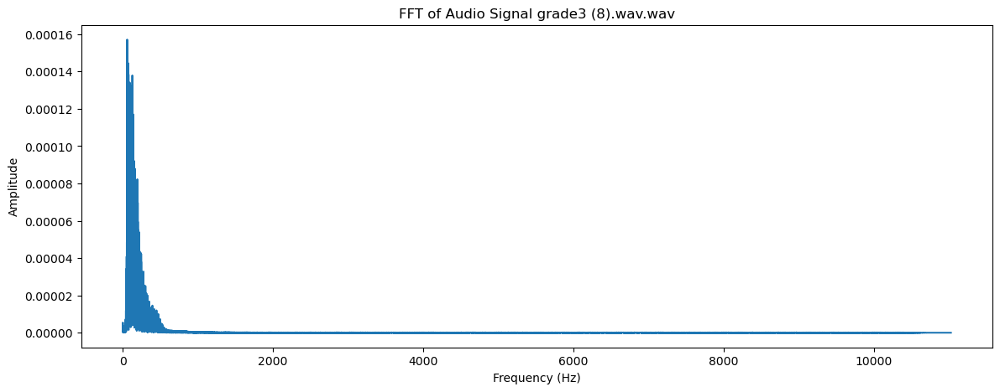

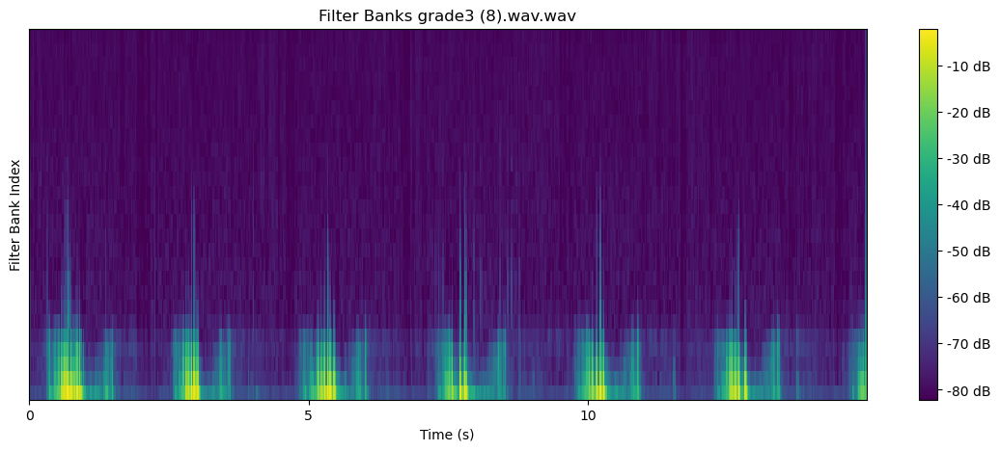

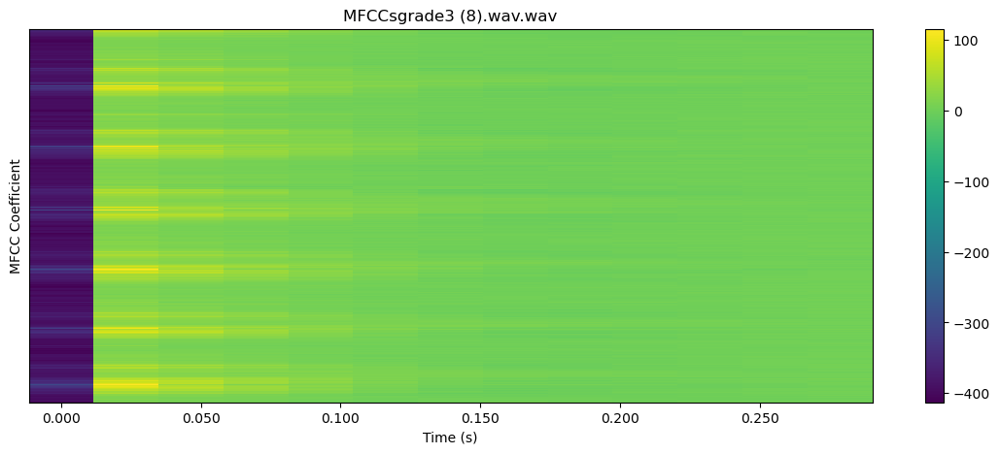


 94%|█████████▎| 132/141 [03:28<00:13,  1.47s/it]

22050


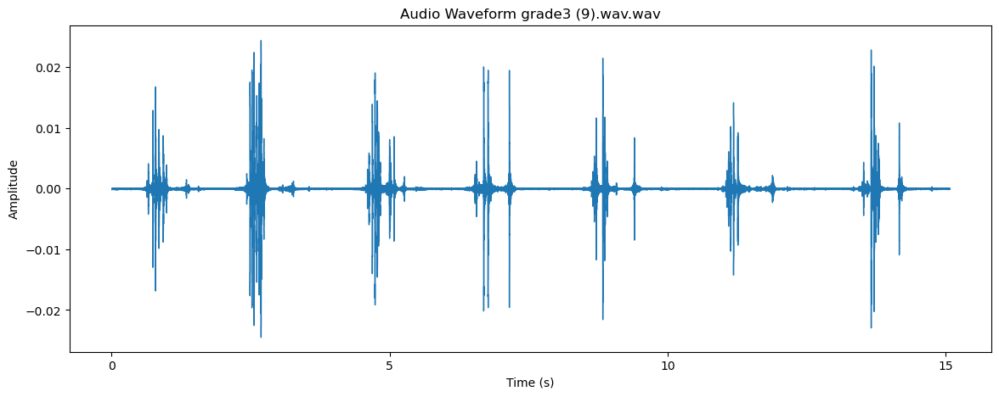

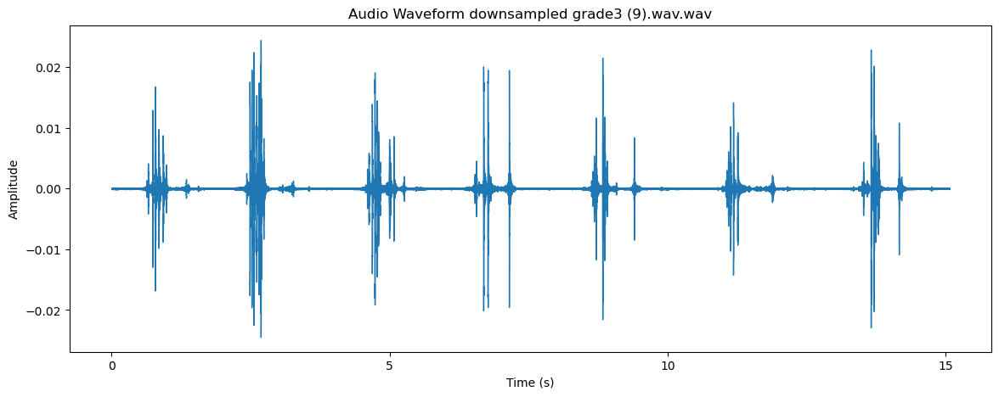

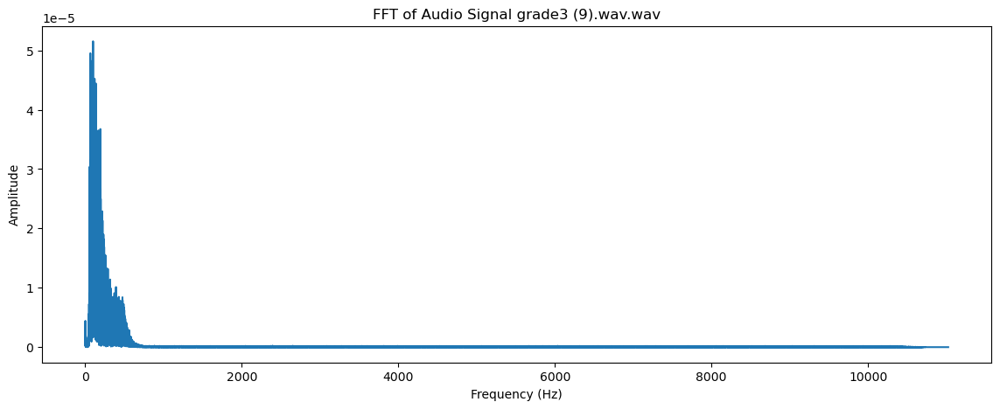

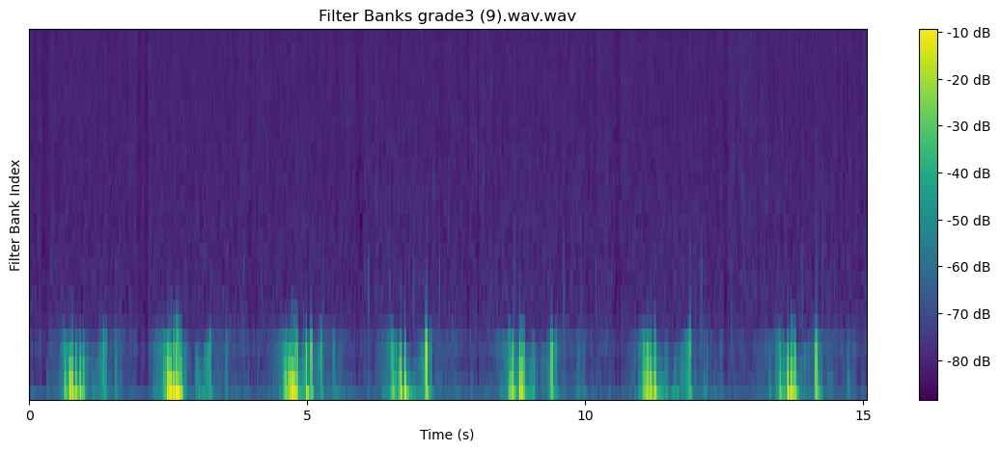

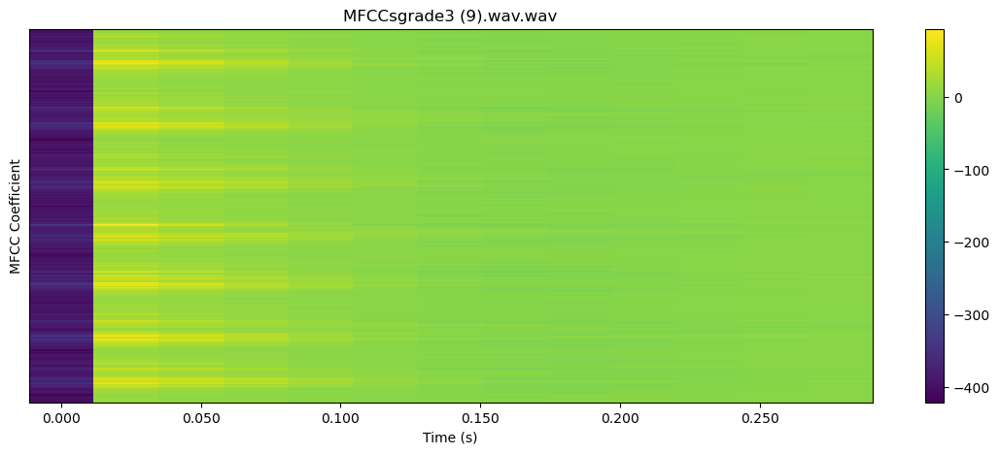


 94%|█████████▍| 133/141 [03:29<00:11,  1.42s/it]

22050


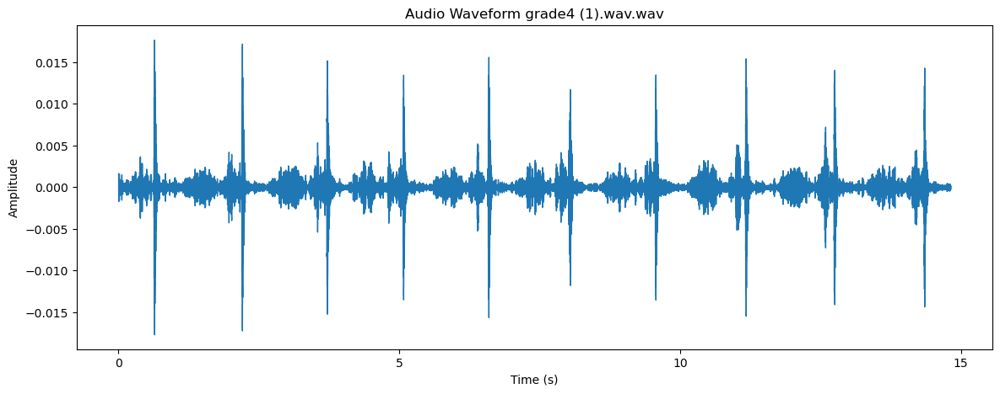

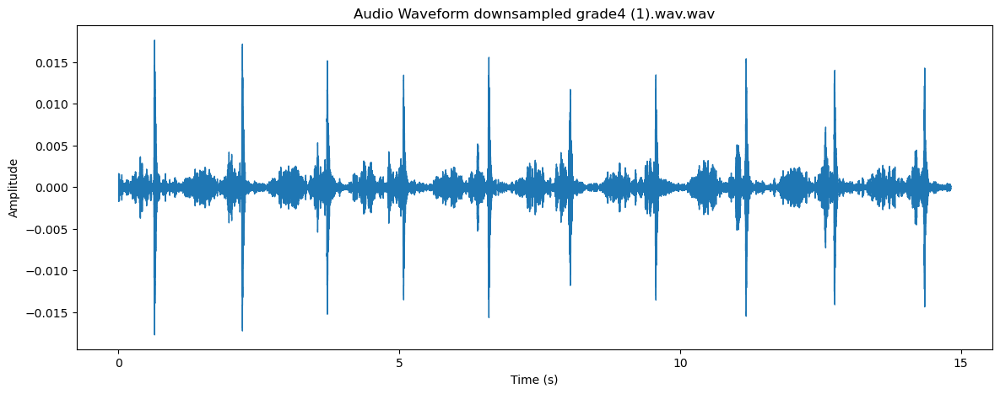

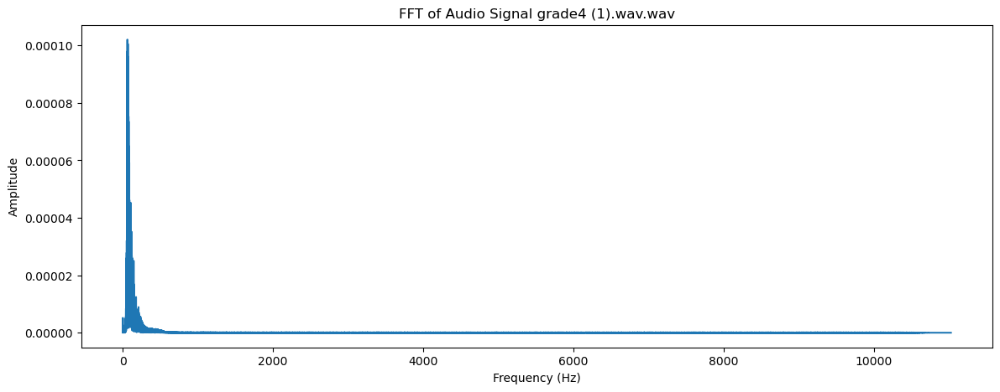

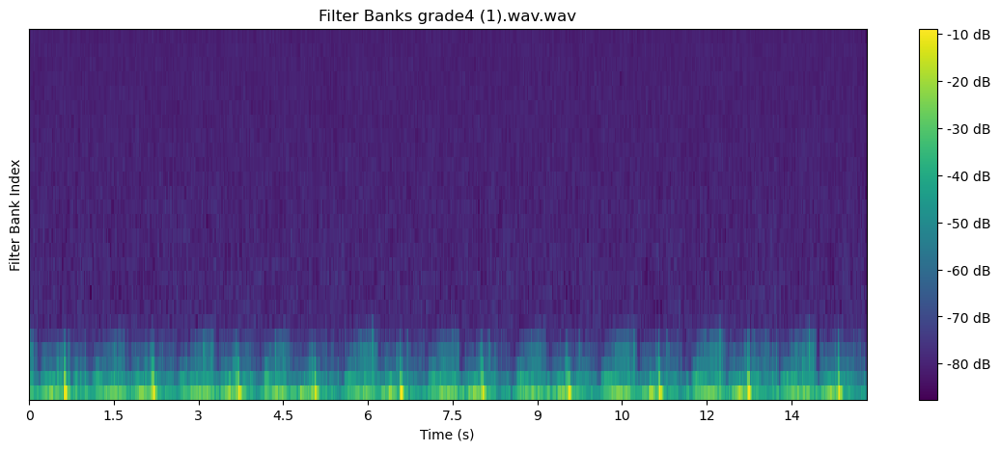

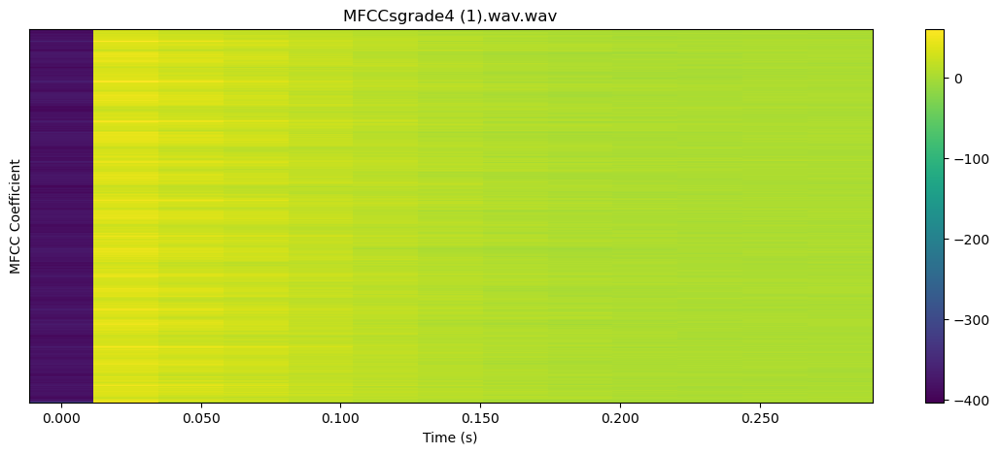


 95%|█████████▌| 134/141 [03:31<00:09,  1.43s/it]

22050


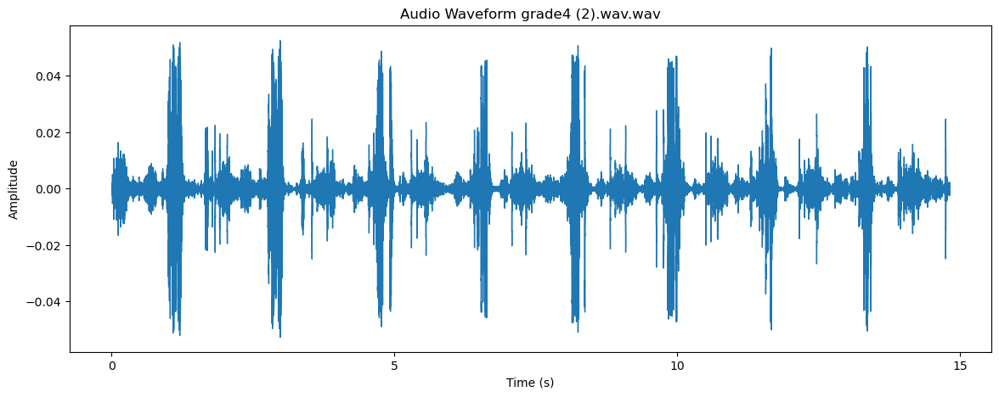

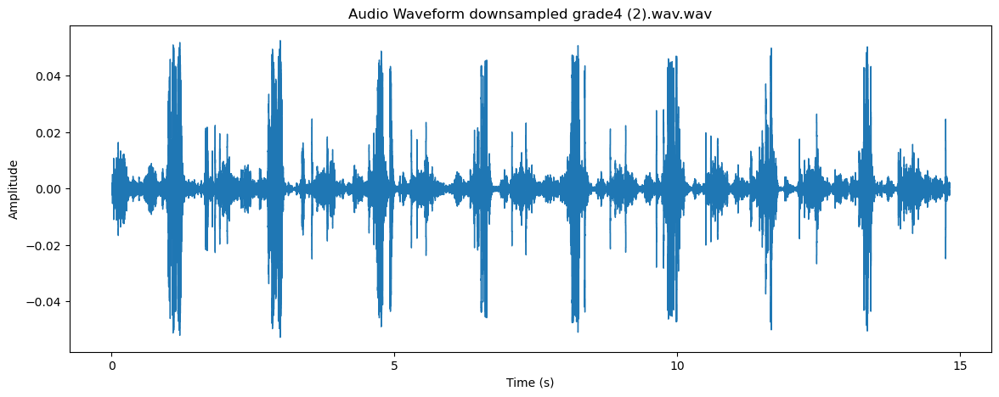

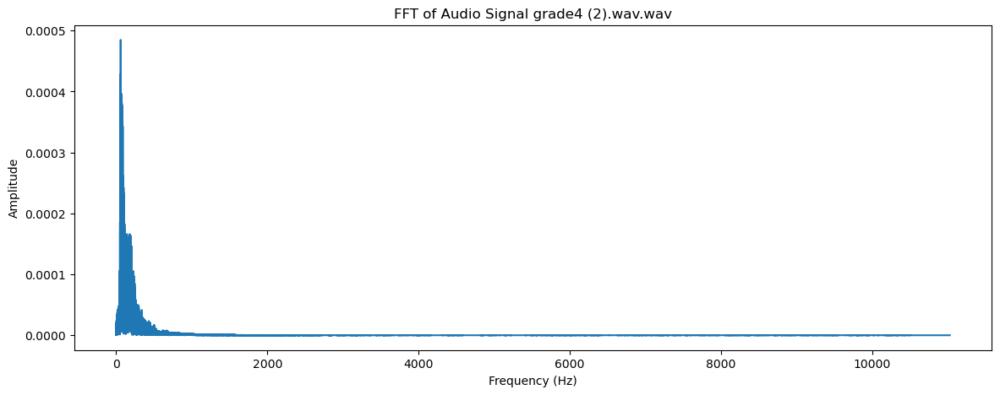

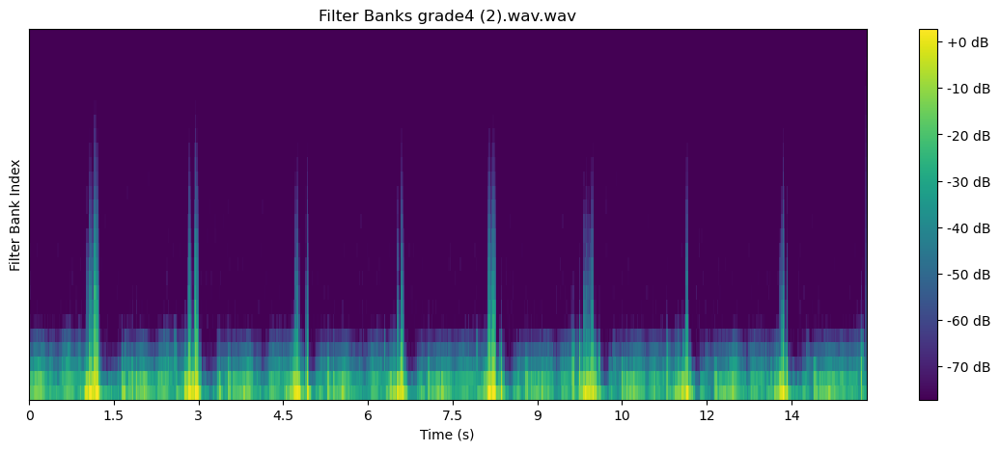

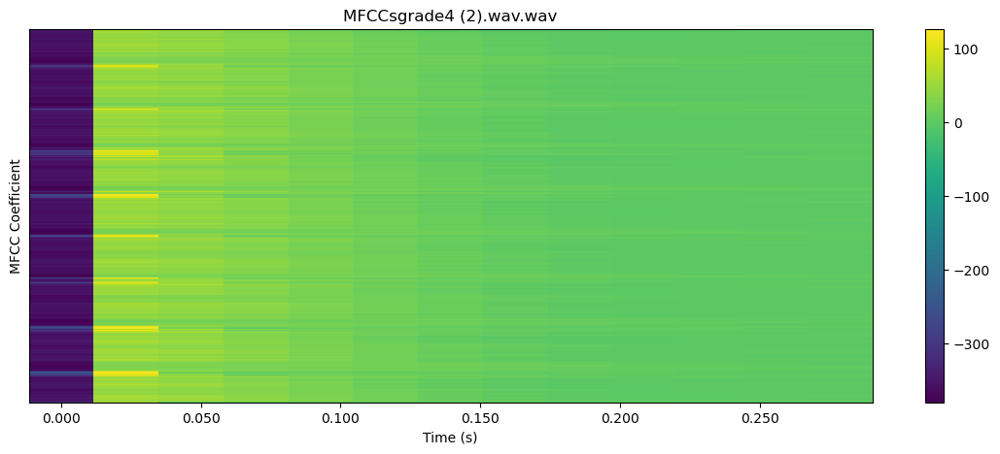


 96%|█████████▌| 135/141 [03:32<00:08,  1.43s/it]

22050


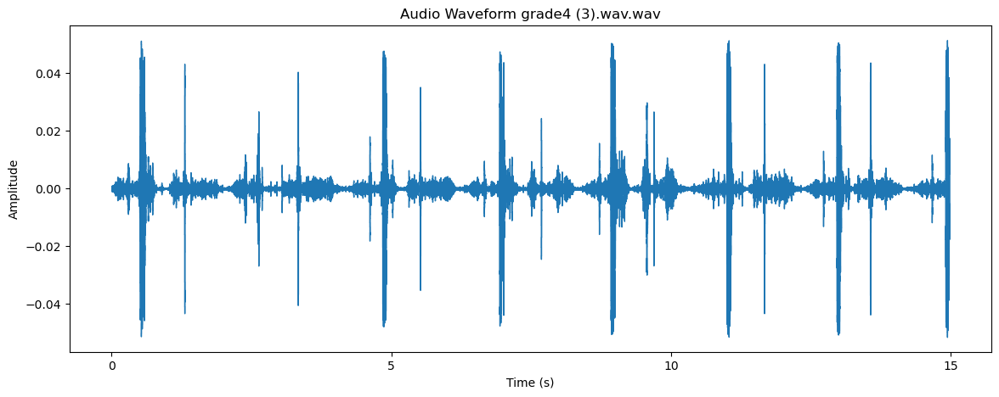

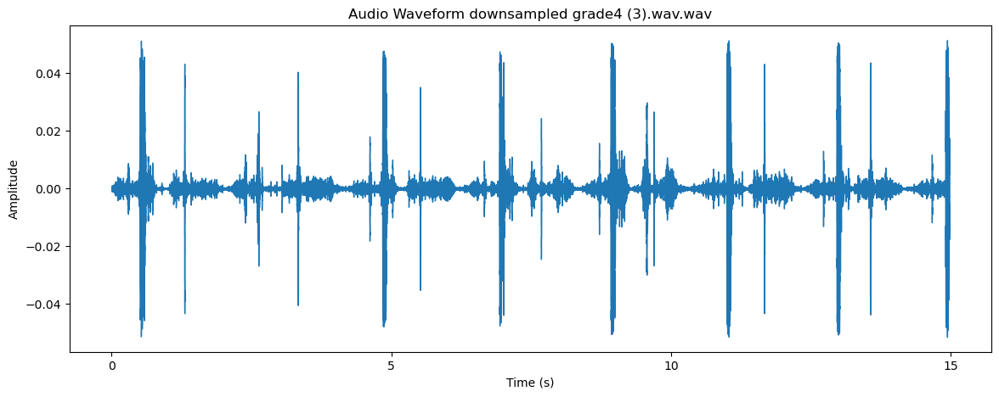

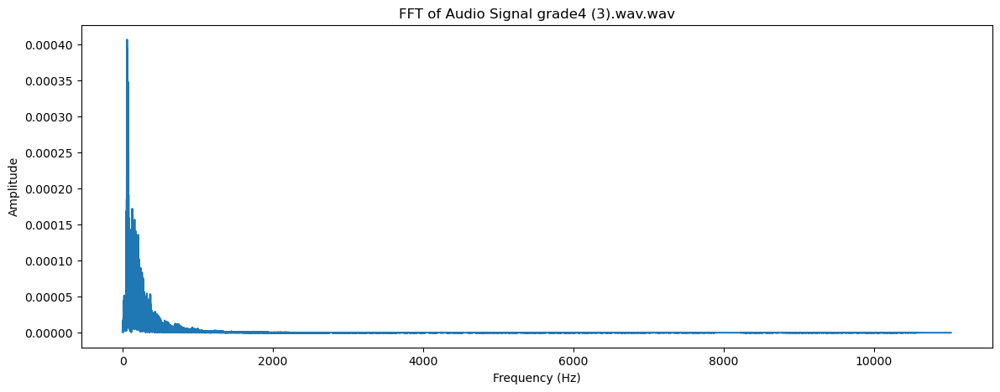

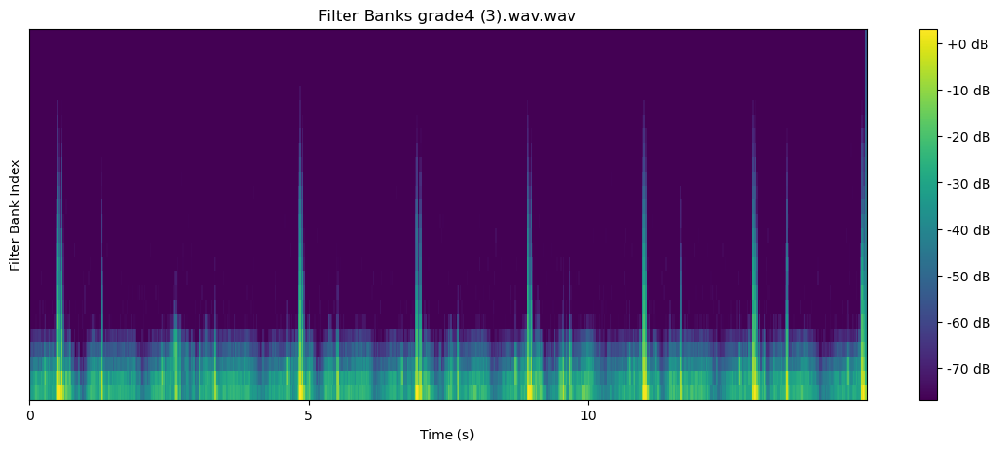

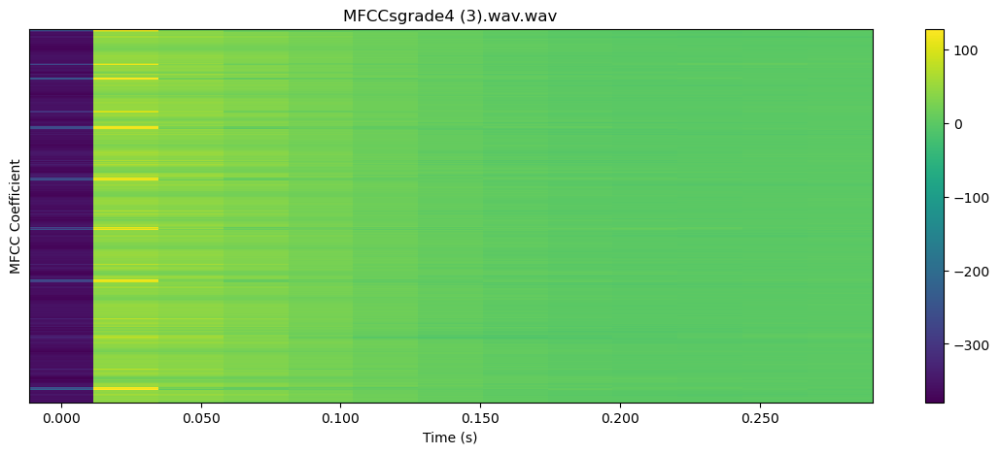


 96%|█████████▋| 136/141 [03:34<00:07,  1.43s/it]

22050


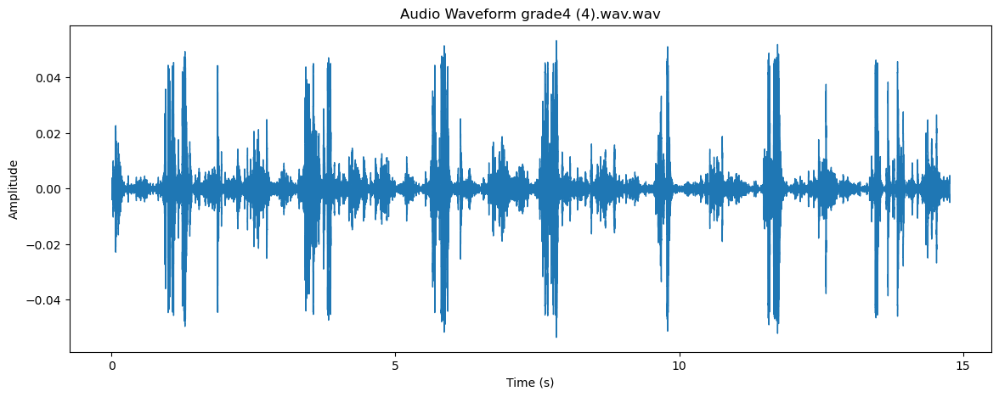

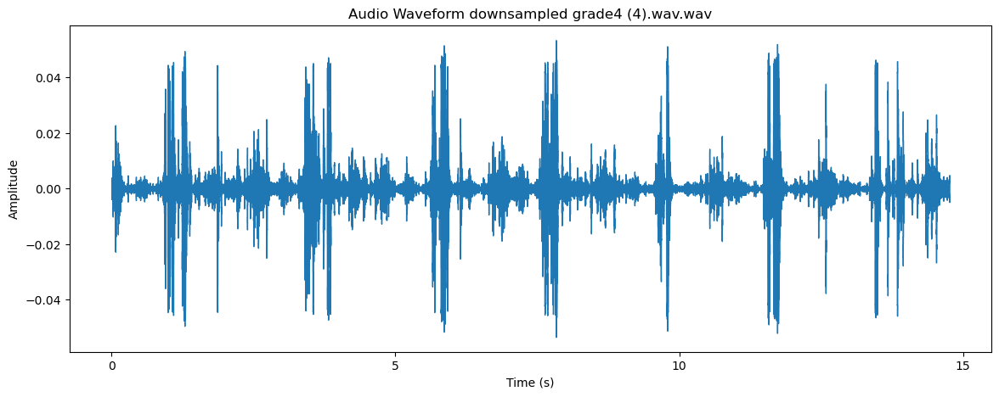

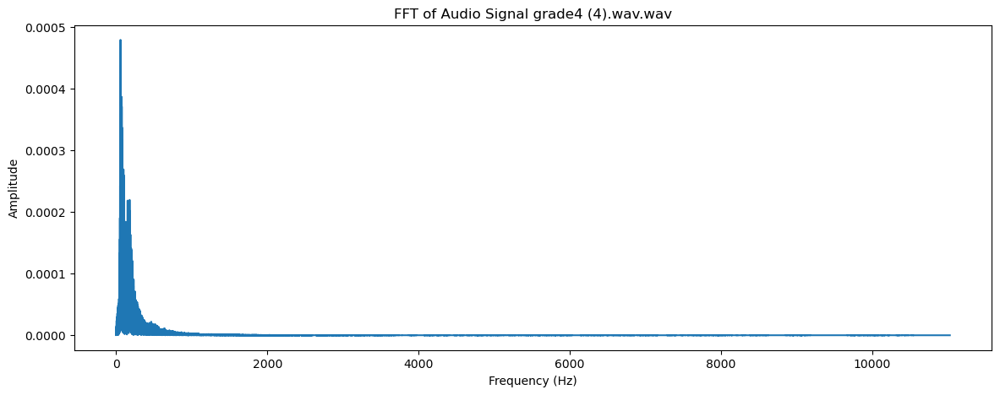

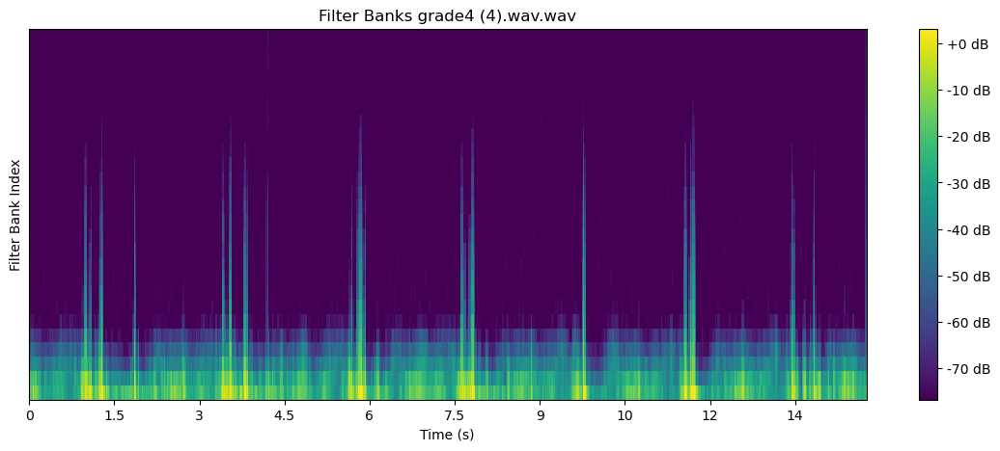

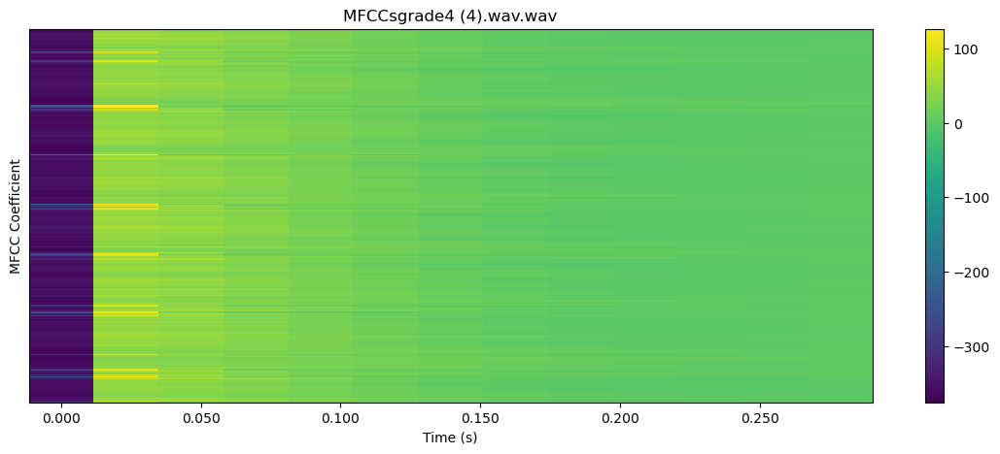


 97%|█████████▋| 137/141 [03:35<00:05,  1.43s/it]

22050


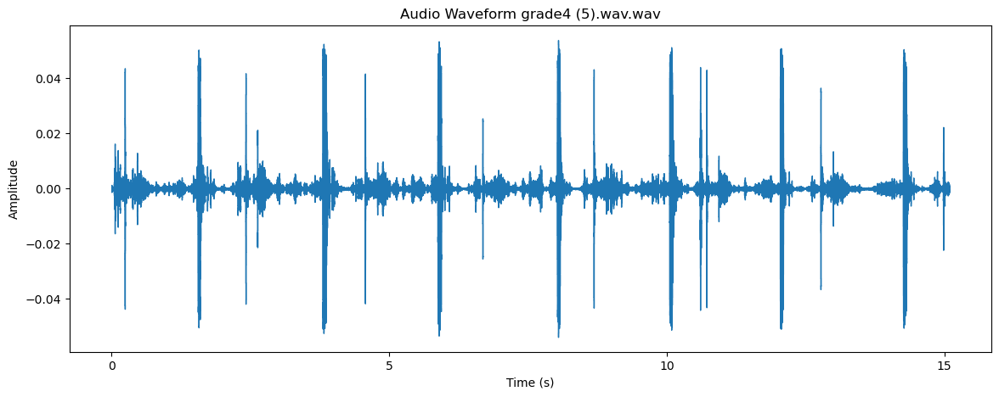

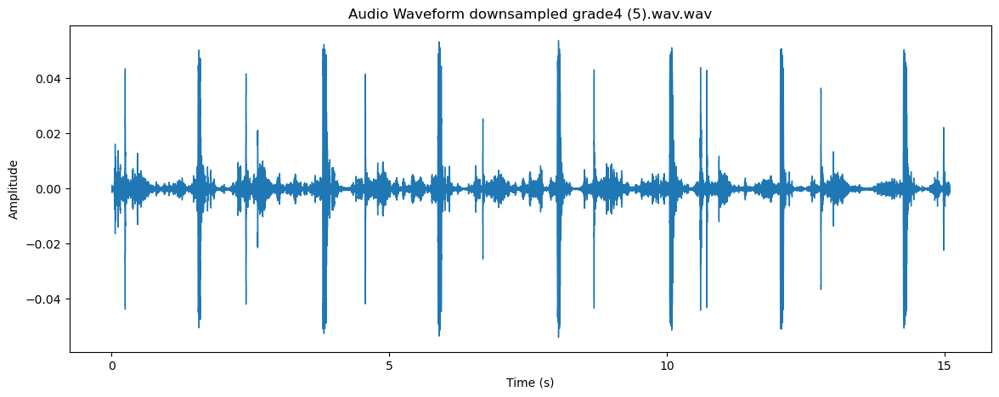

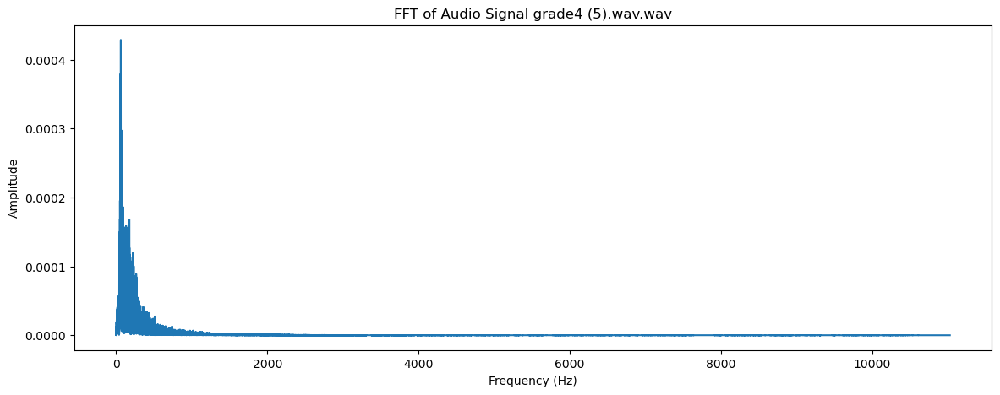

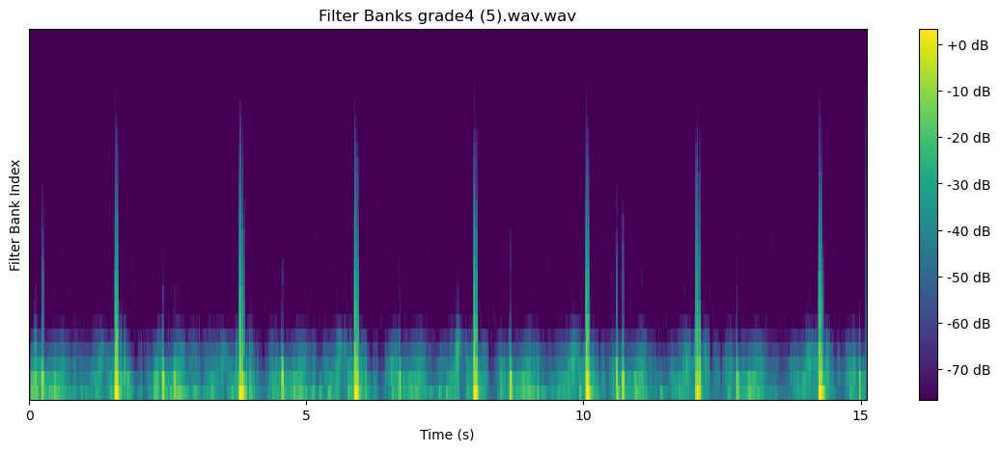

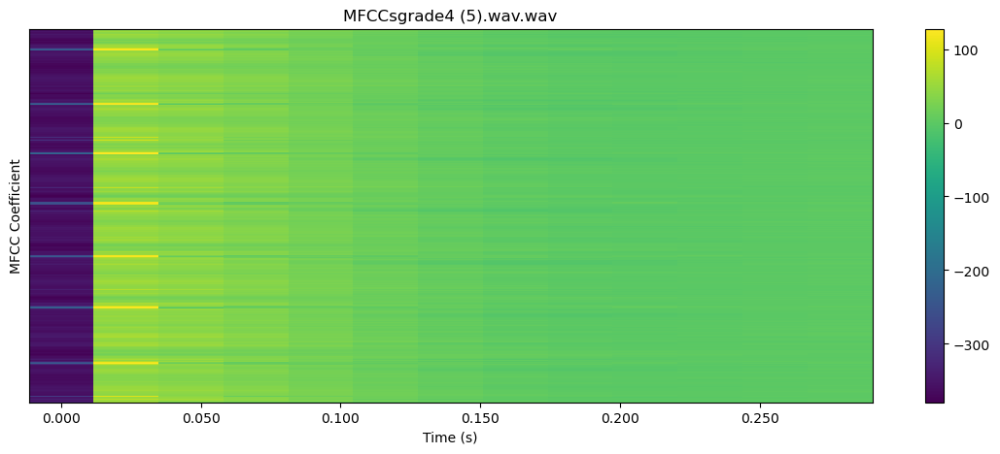


 98%|█████████▊| 138/141 [03:37<00:04,  1.46s/it]

22050


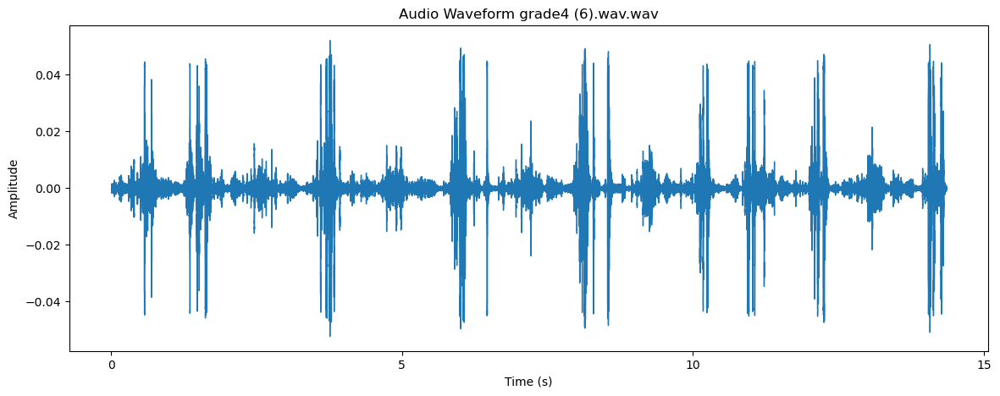

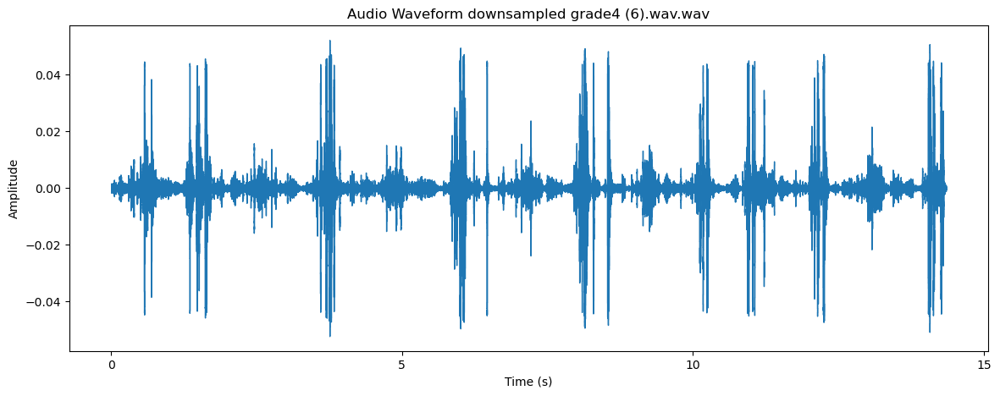

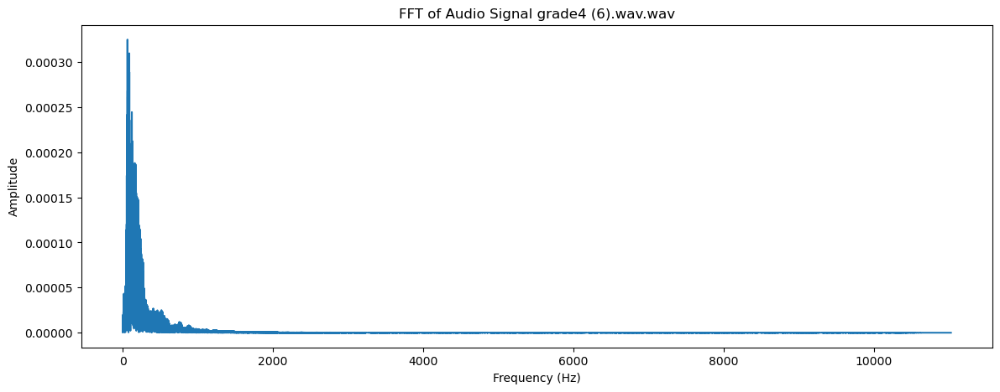

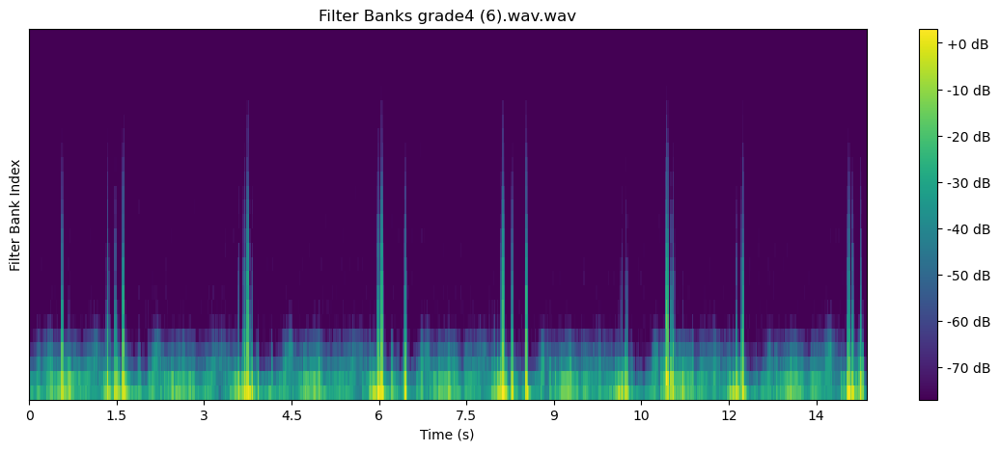

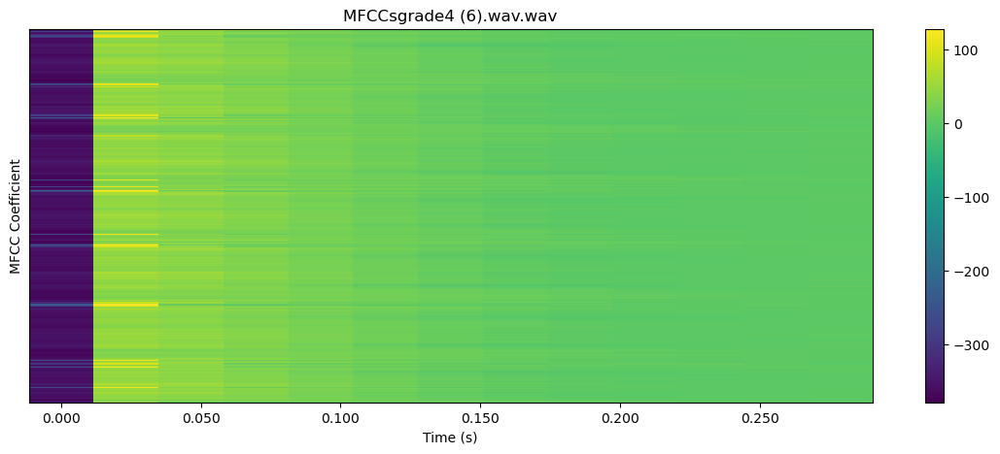


 99%|█████████▊| 139/141 [03:39<00:03,  1.59s/it]

22050


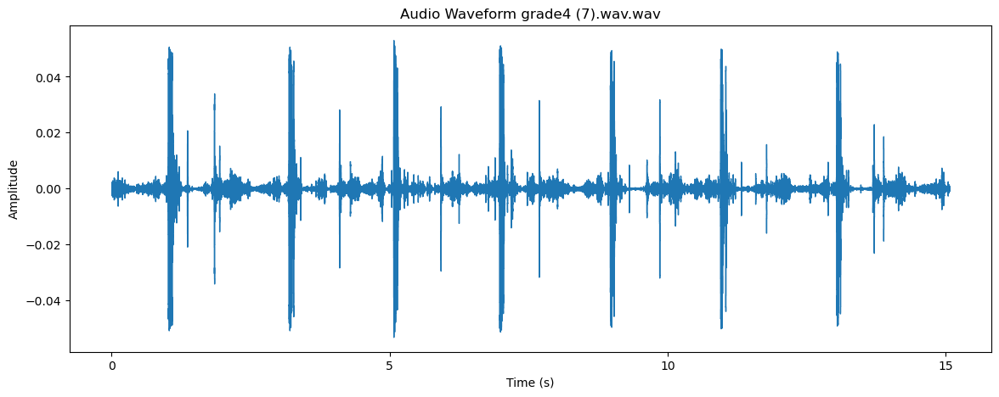

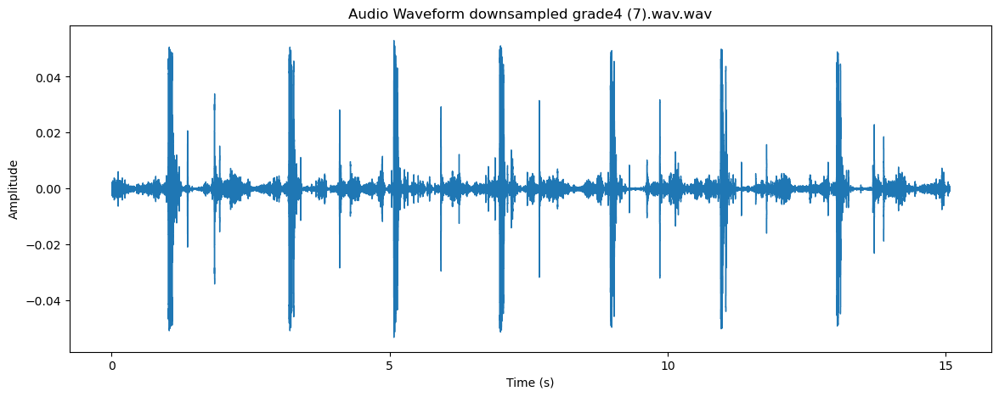

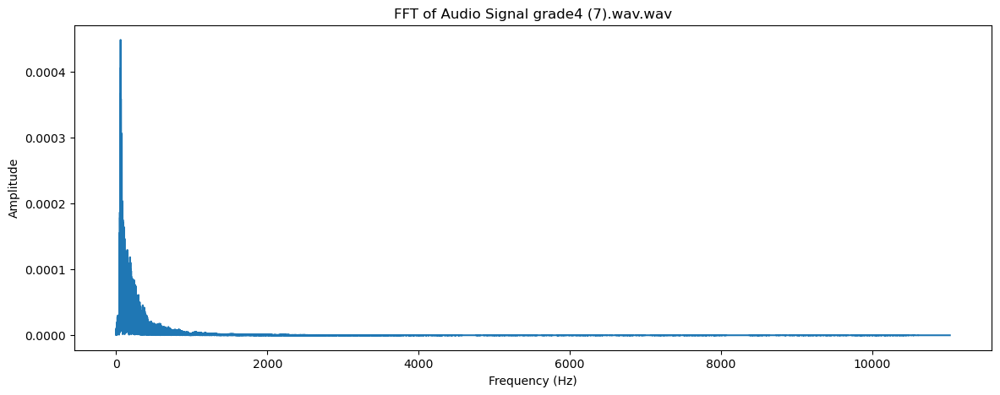

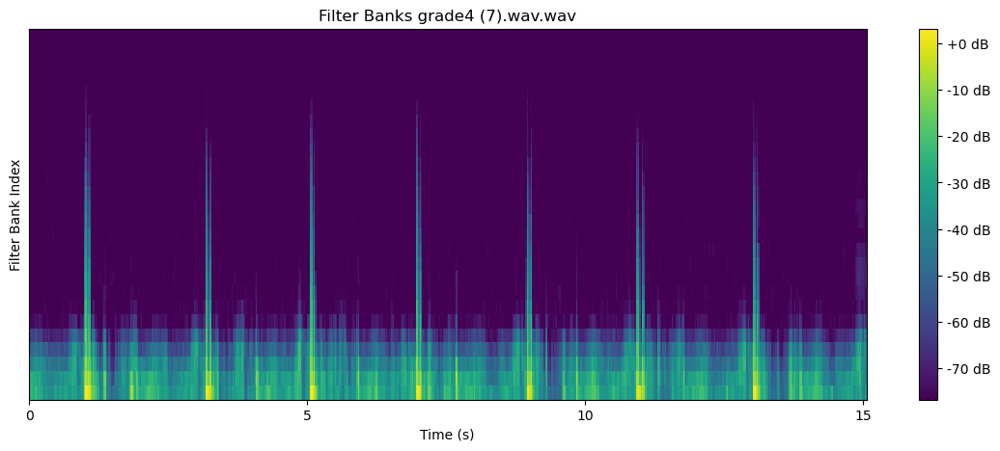

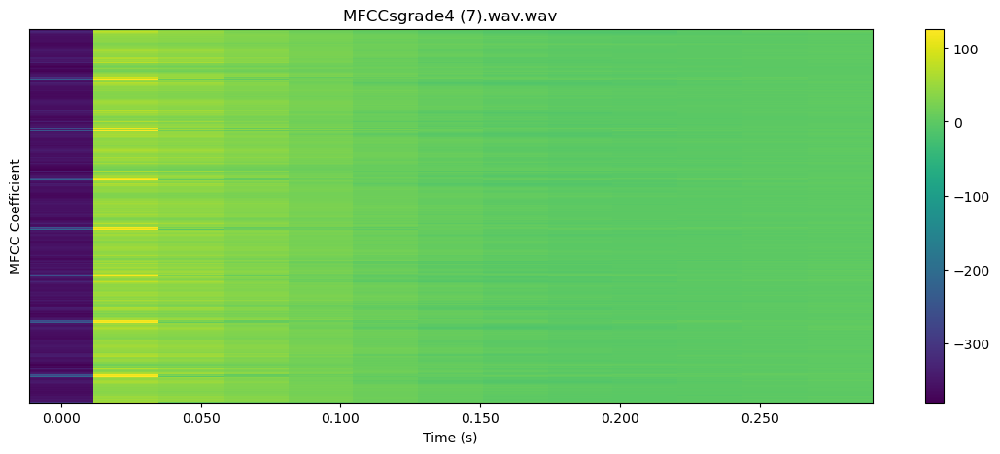


 99%|█████████▉| 140/141 [03:40<00:01,  1.61s/it]

22050


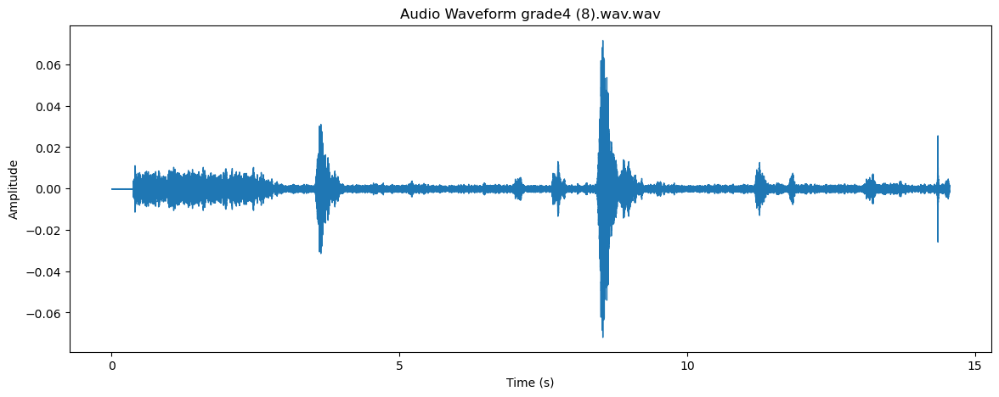

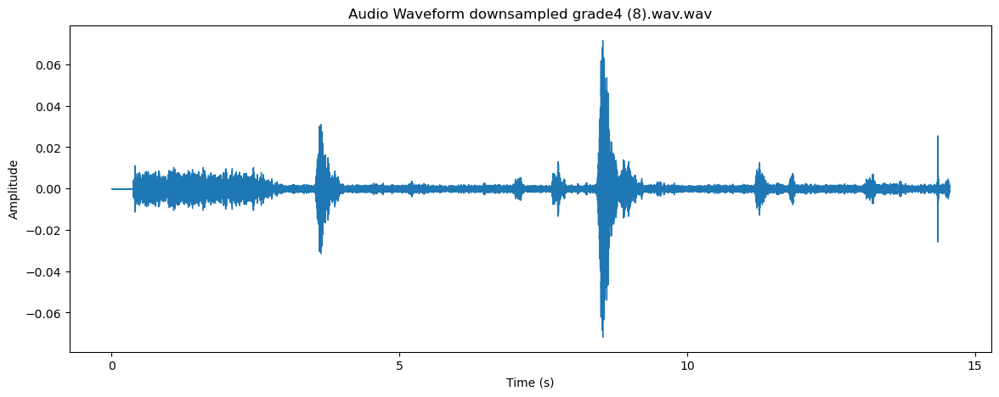

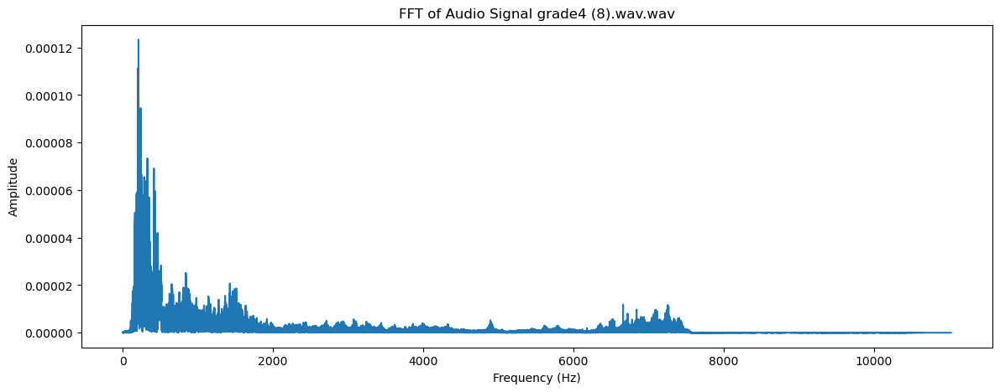

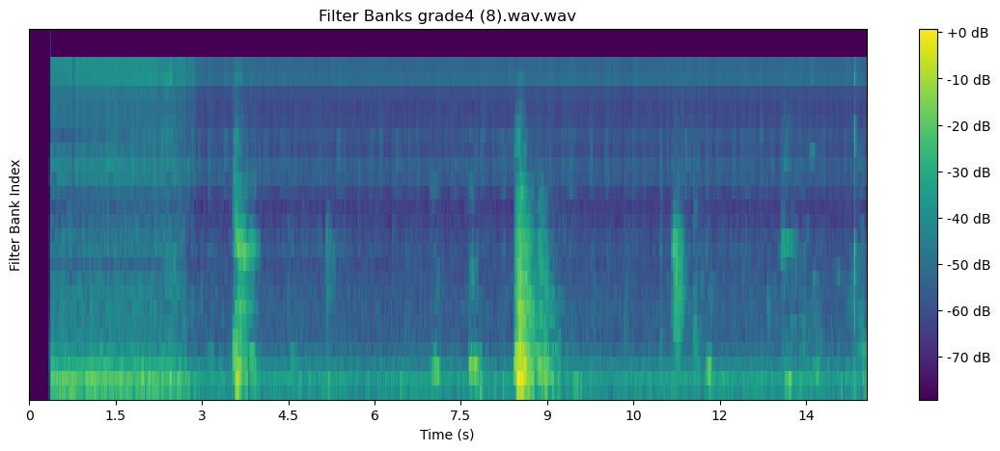

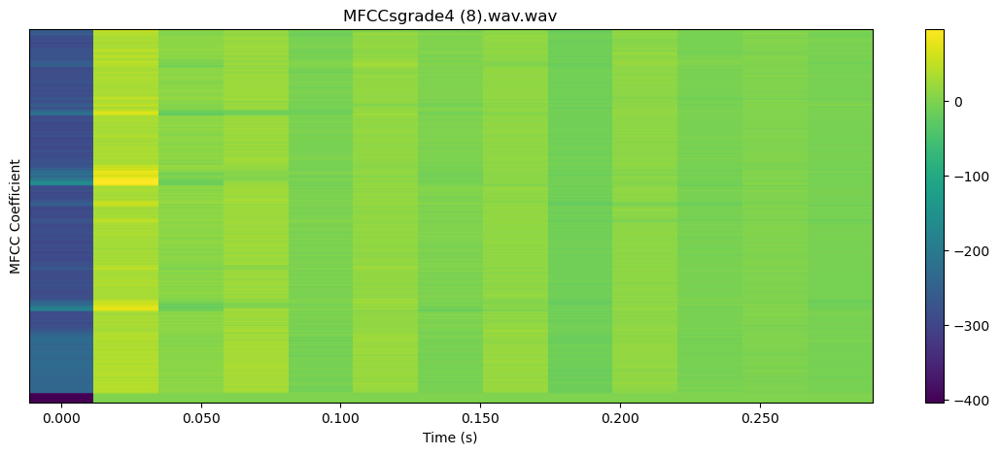

100%|██████████| 141/141 [03:42<00:00,  1.58s/it]


In [23]:
#plot all the files in wavfile
directory_path = 'wavfiles'

for file in tqdm(os.listdir(directory_path)):
    audio, sr = librosa.load('wavfiles/'+file, sr=22050)
    target_sr=22050
    librosa.resample(audio, orig_sr=sr, target_sr=target_sr)
    print(sr)

    def calc_fft(y , rate):
        n = len(y)

        freq = np.fft.rfftfreq( n , d = 1/rate )## calculates the frequencies corresponding to each bin in a Real-valued Fast Fourier Transform (RFFT).
        Y = abs(np.fft.rfft(y)/n)  ##magnitude (of a complex number) , /n is done to scale/normalise the length
        return (Y , freq)
    Y , freq = calc_fft(audio , sr)

    # Calculate filter banks
    filter_banks = librosa.feature.melspectrogram(y=audio, sr=sr, n_fft=1200, hop_length=512, n_mels=26)

    # Convert filter banks to log scale
    log_filter_banks = librosa.power_to_db(filter_banks)

    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_fft=1200, hop_length=512, n_mfcc=13, n_mels=26)

    # Transpose for better visualization
    mfccs = mfccs.T
    plt.figure(figsize=(14, 5))
    librosa.display.waveshow(audio, sr=sr)
    plt.title('Audio Waveform '+file+'.wav')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.show()
    plt.figure(figsize=(14, 5))
    librosa.display.waveshow(audio, sr=sr)
    plt.title('Audio Waveform downsampled '+file+'.wav')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.show()

    plt.figure(figsize=(14, 5))
    plt.plot(freq, Y)
    plt.title('FFT of Audio Signal '+file+'.wav')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Amplitude')
    plt.show()


    plt.figure(figsize=(14, 5))
    librosa.display.specshow(log_filter_banks, sr=sr, hop_length=512, x_axis='time', cmap='viridis')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Filter Banks '+file+'.wav')
    plt.xlabel('Time (s)')
    plt.ylabel('Filter Bank Index')
    plt.show()


    # Plot MFCCs
    plt.figure(figsize=(14, 5))
    librosa.display.specshow(mfccs, sr=sr, hop_length=512, x_axis='time', cmap='viridis')
    plt.colorbar()
    plt.title('MFCCs'+file+'.wav')
    plt.xlabel('Time (s)')
    plt.ylabel('MFCC Coefficient')
    plt.show()
